In [29]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [30]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [31]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[6451, 9939, 8010, 5100, 9656, 7509, 9934, 2520, 3972, 2431, 2068, 3363, 4178, 7115, 444, 786, 6914, 2734, 2465, 3586]
log initialized
Average similarity between family members is 0.9642439155256755 at temperature -1
Average similarity between family and home is 0.9998487411001892 at temperature -1
Average similarity between students and their classroom is 0.7689116067327126 at temperature -1
Average classroom occupancy is 4.619047619047619 and number classrooms is 63
Average similarity between workers is 0.9675147623089649 at temperature -1
Average office occupancy is 3.486772486772487 and number offices is 189
Average friend similarity for adults: 0.8452001182147016 for kids: 0.7129073409362059
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.6355547092117294
avg restaurant similarity 0.6267471917237503
avg restaurant similarity 0.6548359799840171
avg restaurant similarity 0.6305528602646181
avg restaurant similarity 0.6730381201048067
avg restaurant similarity 0.5537277213037515
avg restaurant similarity 0.6323591438825302
avg restaurant similarity 0.5798471511397206
avg restaurant similarity 0.6556940595780453
avg restaurant similarity 0.6400992043840082
avg restaurant similarity 0.6336311980775798
avg restaurant similarity 0.6168227637198025
avg restaurant similarity 0.628419083334105
avg restaurant similarity 0.6643171233026035
avg restaurant similarity 0.6073213389429716
avg restaurant similarity 0.5735414370290671
avg restaurant similarity 0.6401365314091855
avg restaurant similarity 0.6137740635433765
avg restaurant similarity 0.6654329912611132
avg restaurant similarity 0.6257762443544144
avg restaurant similarity 0.6270254528494308
avg restaurant similarity 0.639060211590711
avg restaura

avg restaurant similarity 0.6375752377312276
avg restaurant similarity 0.6361878361899654
avg restaurant similarity 0.6483051112759117
avg restaurant similarity 0.6135344781228173
avg restaurant similarity 0.6556165330753708
avg restaurant similarity 0.6350299194496685
avg restaurant similarity 0.6432493833289623
avg restaurant similarity 0.656565710371025
avg restaurant similarity 0.6440546208857719
avg restaurant similarity 0.650701253845442
avg restaurant similarity 0.5844762988701008
avg restaurant similarity 0.6342602857543898
avg restaurant similarity 0.6763611934420326
avg restaurant similarity 0.6173532493655315
avg restaurant similarity 0.6366876553686251
avg restaurant similarity 0.6015382539481031
avg restaurant similarity 0.6549263971684671
avg restaurant similarity 0.5960576328802151
avg restaurant similarity 0.6191643646306073
avg restaurant similarity 0.6695584444864089
avg restaurant similarity 0.650187998683743
avg restaurant similarity 0.6205331957336938
avg restauran

avg restaurant similarity 0.6617038511900978
avg restaurant similarity 0.6485518763676124
avg restaurant similarity 0.6856735919224326
avg restaurant similarity 0.6560087392163914
avg restaurant similarity 0.6899462756621747
avg restaurant similarity 0.6492671035144584
avg restaurant similarity 0.6413787586093217
avg restaurant similarity 0.6692735084638863
avg restaurant similarity 0.6688094818361433
avg restaurant similarity 0.6854299415227255
avg restaurant similarity 0.6845659040518565
avg restaurant similarity 0.6618250549015409
avg restaurant similarity 0.6502013644954807
avg restaurant similarity 0.6735181746419064
avg restaurant similarity 0.6507088319289805
avg restaurant similarity 0.68296065267099
avg restaurant similarity 0.6600626582062123
avg restaurant similarity 0.6422999986854538
avg restaurant similarity 0.6730462843962782
avg restaurant similarity 0.6349044055887777
avg restaurant similarity 0.6316629693430647
avg restaurant similarity 0.637987195004494
avg restauran

avg restaurant similarity 0.5919758280171767
avg restaurant similarity 0.6433713068355165
avg restaurant similarity 0.6574507224601451
avg restaurant similarity 0.6627491822839365
avg restaurant similarity 0.6461583252359787
avg restaurant similarity 0.6189268124599472
avg restaurant similarity 0.615158399202311
avg restaurant similarity 0.7096482671256614
avg restaurant similarity 0.5982630968623555
avg restaurant similarity 0.6205600184896978
avg restaurant similarity 0.6769796500245251
avg restaurant similarity 0.6307033085509098
avg restaurant similarity 0.7100120172920089
avg restaurant similarity 0.6449194239732453
avg restaurant similarity 0.6416811473968832
avg restaurant similarity 0.6544860396990672
avg restaurant similarity 0.6325699050982674
avg restaurant similarity 0.6093321163094829
avg restaurant similarity 0.6658262932557645
avg restaurant similarity 0.7021417270188904
avg restaurant similarity 0.6735421392330697
avg restaurant similarity 0.650768466629388
avg restaura

avg restaurant similarity 0.6678711642690233
avg restaurant similarity 0.664655133248426
avg restaurant similarity 0.6092603515490359
avg restaurant similarity 0.662465994535127
avg restaurant similarity 0.6623065551900117
avg restaurant similarity 0.6636954162858233
avg restaurant similarity 0.704780903948946
avg restaurant similarity 0.6345585793518032
avg restaurant similarity 0.6623405082858965
avg restaurant similarity 0.6754712285560853
avg restaurant similarity 0.6521743817253037
avg restaurant similarity 0.6444329218312334
avg restaurant similarity 0.6460002233949891
avg restaurant similarity 0.6561826316569395
avg restaurant similarity 0.641577774919362
avg restaurant similarity 0.6464291030008606
avg restaurant similarity 0.6360518344275573
avg restaurant similarity 0.7197723209075874
avg restaurant similarity 0.6563147680756569
avg restaurant similarity 0.6205145675623667
avg restaurant similarity 0.6563536089041515
avg restaurant similarity 0.6317656436931208
avg restaurant

avg restaurant similarity 0.6830621208474219
avg restaurant similarity 0.6795305532670574
avg restaurant similarity 0.6607714001172117
avg restaurant similarity 0.6574859863146866
avg restaurant similarity 0.6590809393052401
avg restaurant similarity 0.677551073232435
avg restaurant similarity 0.6573638377942088
avg restaurant similarity 0.6664142586651286
avg restaurant similarity 0.6713943509888118
avg restaurant similarity 0.6763405032002882
avg restaurant similarity 0.6516037886181822
avg restaurant similarity 0.6466162665207207
avg restaurant similarity 0.6881638128320743
avg restaurant similarity 0.6409946500040177
avg restaurant similarity 0.6372485712854815
avg restaurant similarity 0.6902218357349637
avg restaurant similarity 0.6160405250304487
avg restaurant similarity 0.6428244672372864
avg restaurant similarity 0.6754274714262697
avg restaurant similarity 0.6953402301021485
avg restaurant similarity 0.6274173543683083
avg restaurant similarity 0.6869566141977326
avg restaur

avg restaurant similarity 0.6801950283784571
avg restaurant similarity 0.6455537417203379
avg restaurant similarity 0.7152943216074912
avg restaurant similarity 0.7141022850209954
avg restaurant similarity 0.7278453975098126
avg restaurant similarity 0.6940094346077702
avg restaurant similarity 0.677293628110722
avg restaurant similarity 0.7331057297444231
avg restaurant similarity 0.7350241666837428
avg restaurant similarity 0.7037029594851761
avg restaurant similarity 0.6753685800865509
avg restaurant similarity 0.6925390064202605
avg restaurant similarity 0.7072840091593408
avg restaurant similarity 0.7248169454293641
avg restaurant similarity 0.705533350976997
avg restaurant similarity 0.7454814544822096
avg restaurant similarity 0.738105818963318
avg restaurant similarity 0.7352805156174141
avg restaurant similarity 0.6956118806034536
avg restaurant similarity 0.6784109070239024
avg restaurant similarity 0.6695934545106909
avg restaurant similarity 0.6765118154427333
avg restauran

avg restaurant similarity 0.7097147599754727
avg restaurant similarity 0.6975188733182528
avg restaurant similarity 0.6561647564509736
avg restaurant similarity 0.6345764977096304
avg restaurant similarity 0.7337098213040737
avg restaurant similarity 0.6966071533393675
avg restaurant similarity 0.7119643379089354
avg restaurant similarity 0.6483093081068313
avg restaurant similarity 0.7244787125875183
avg restaurant similarity 0.7026117233395184
avg restaurant similarity 0.7006801694320746
avg restaurant similarity 0.714399284751042
avg restaurant similarity 0.6979021912855988
avg restaurant similarity 0.7514510339520077
avg restaurant similarity 0.7607603839067497
avg restaurant similarity 0.8088016457775123
avg restaurant similarity 0.6792232457679892
avg restaurant similarity 0.6775114295284115
avg restaurant similarity 0.6846574523767404
avg restaurant similarity 0.7043477073413725
avg restaurant similarity 0.6840075845309282
avg restaurant similarity 0.7447335908323196
avg restaur

avg restaurant similarity 0.6820375869220946
avg restaurant similarity 0.6641213252379611
avg restaurant similarity 0.6753456067140863
avg restaurant similarity 0.6917038592135076
avg restaurant similarity 0.6923426278053763
avg restaurant similarity 0.6926535213737252
avg restaurant similarity 0.6556893553859064
avg restaurant similarity 0.644663897499681
avg restaurant similarity 0.6598164567121378
avg restaurant similarity 0.632688645815199
avg restaurant similarity 0.6854061719898782
avg restaurant similarity 0.6634212208249358
avg restaurant similarity 0.654878960006563
avg restaurant similarity 0.658817770269997
avg restaurant similarity 0.6943474094473331
avg restaurant similarity 0.6078569362743393
avg restaurant similarity 0.7026440287573098
avg restaurant similarity 0.6387592364902526
avg restaurant similarity 0.6697317688089176
avg restaurant similarity 0.6863690725918894
avg restaurant similarity 0.710693276140343
avg restaurant similarity 0.6439671368184082
avg restaurant 

avg restaurant similarity 0.702101771596643
avg restaurant similarity 0.7042279984172541
avg restaurant similarity 0.6372856357947961
avg restaurant similarity 0.6110107832657472
avg restaurant similarity 0.6406296037915037
avg restaurant similarity 0.6513102689280286
avg restaurant similarity 0.5925792934837771
avg restaurant similarity 0.5813831148058122
avg restaurant similarity 0.7053603604073263
avg restaurant similarity 0.6080578200261189
avg restaurant similarity 0.6231743620500173
avg restaurant similarity 0.6467091118667891
avg restaurant similarity 0.679162005060589
avg restaurant similarity 0.6261263195895745
avg restaurant similarity 0.6139408712844657
avg restaurant similarity 0.5968221500145504
avg restaurant similarity 0.6462000997985228
avg restaurant similarity 0.6558506850867056
avg restaurant similarity 0.6789915805930751
avg restaurant similarity 0.7197001479487805
avg restaurant similarity 0.669422217306248
avg restaurant similarity 0.6935352436299449
avg restauran

avg restaurant similarity 0.71150981929052
avg restaurant similarity 0.7001708543947355
avg restaurant similarity 0.6795480108035612
avg restaurant similarity 0.6306155191117421
avg restaurant similarity 0.7105502978521061
avg restaurant similarity 0.7065634400292901
avg restaurant similarity 0.6950005448870845
avg restaurant similarity 0.6730889848624018
avg restaurant similarity 0.6645883134444086
avg restaurant similarity 0.6272991596541119
avg restaurant similarity 0.6498340951661037
avg restaurant similarity 0.6455275219052836
avg restaurant similarity 0.6810782478495034
avg restaurant similarity 0.6512929501092467
avg restaurant similarity 0.6119786252310336
avg restaurant similarity 0.6909670986801127
avg restaurant similarity 0.6842110643149173
avg restaurant similarity 0.6849976492749688
avg restaurant similarity 0.6973622194626977
avg restaurant similarity 0.6538345866604409
avg restaurant similarity 0.6610987024398214
avg restaurant similarity 0.6667235962885343
avg restaura

avg restaurant similarity 0.694673421719375
avg restaurant similarity 0.655451263233175
avg restaurant similarity 0.6951362348208066
avg restaurant similarity 0.6672984733116929
avg restaurant similarity 0.6918893998214036
avg restaurant similarity 0.6119853063766584
avg restaurant similarity 0.7045760320386443
avg restaurant similarity 0.7059807037877083
avg restaurant similarity 0.6739702085126645
avg restaurant similarity 0.6714858781255915
avg restaurant similarity 0.6868981355435944
avg restaurant similarity 0.6674274152153056
avg restaurant similarity 0.7076183951687631
avg restaurant similarity 0.7613839989944231
avg restaurant similarity 0.6556731288476029
avg restaurant similarity 0.6740762383593983
avg restaurant similarity 0.621756340975925
avg restaurant similarity 0.6751503368105954
avg restaurant similarity 0.6589521544640936
avg restaurant similarity 0.6851303886851108
avg restaurant similarity 0.6728078907754441
avg restaurant similarity 0.6444702602547744
avg restauran

avg restaurant similarity 0.6769350054908695
avg restaurant similarity 0.6572715013702968
avg restaurant similarity 0.643850889173656
avg restaurant similarity 0.6049178116468908
avg restaurant similarity 0.6640814492339655
avg restaurant similarity 0.6257093075549605
avg restaurant similarity 0.6963463842350349
avg restaurant similarity 0.6776396182236175
avg restaurant similarity 0.7037504025653157
avg restaurant similarity 0.7076058320049848
avg restaurant similarity 0.6597715675412323
avg restaurant similarity 0.6561895163117095
avg restaurant similarity 0.6818418309860818
avg restaurant similarity 0.6934383481414964
avg restaurant similarity 0.6472451491962002
avg restaurant similarity 0.688102521205254
avg restaurant similarity 0.6630660389357877
avg restaurant similarity 0.6577590228213469
avg restaurant similarity 0.7043765906099569
avg restaurant similarity 0.6626873968261304
avg restaurant similarity 0.6690107330159873
avg restaurant similarity 0.6577090661093691
avg restaura

avg restaurant similarity 0.6624203834758771
avg restaurant similarity 0.6665551658861015
avg restaurant similarity 0.6640565674797679
avg restaurant similarity 0.592857381612292
avg restaurant similarity 0.6375139034186939
avg restaurant similarity 0.6437278388781058
avg restaurant similarity 0.6534857453396933
avg restaurant similarity 0.6653274490117181
avg restaurant similarity 0.6094819667134845
avg restaurant similarity 0.6189217618578906
avg restaurant similarity 0.7019393442073338
avg restaurant similarity 0.6978746673813506
avg restaurant similarity 0.6247656098699742
avg restaurant similarity 0.6169708606989549
avg restaurant similarity 0.6996305551205634
avg restaurant similarity 0.6266658618368683
avg restaurant similarity 0.6243234023804556
avg restaurant similarity 0.6714565730792151
avg restaurant similarity 0.6661871328021444
avg restaurant similarity 0.6552589249083847
avg restaurant similarity 0.6845374404593464
avg restaurant similarity 0.6802125900874239
avg restaur

avg restaurant similarity 0.5941380841844071
avg restaurant similarity 0.6850685806894866
avg restaurant similarity 0.6735768308040129
avg restaurant similarity 0.6715369641518775
avg restaurant similarity 0.7031440838279339
avg restaurant similarity 0.6666277131287333
avg restaurant similarity 0.6584638980652199
avg restaurant similarity 0.7062796093847122
avg restaurant similarity 0.6950346344883028
avg restaurant similarity 0.7022266801945672
avg restaurant similarity 0.6600410726211745
avg restaurant similarity 0.6127176264372797
avg restaurant similarity 0.7195825387152737
avg restaurant similarity 0.700190174431127
avg restaurant similarity 0.7144418982354035
avg restaurant similarity 0.6338152882148368
avg restaurant similarity 0.7078638529455042
avg restaurant similarity 0.659646375997391
avg restaurant similarity 0.6589860745213502
avg restaurant similarity 0.732841393970584
avg restaurant similarity 0.6260660200504288
avg restaurant similarity 0.672269065154062
avg restaurant

avg restaurant similarity 0.7009861700936664
avg restaurant similarity 0.6817479836858394
avg restaurant similarity 0.7009112044072318
avg restaurant similarity 0.6980858875145461
avg restaurant similarity 0.6813564454012219
avg restaurant similarity 0.7374083654060954
avg restaurant similarity 0.645408155589649
avg restaurant similarity 0.6924514088467709
avg restaurant similarity 0.6844051390289798
avg restaurant similarity 0.6744464404130048
avg restaurant similarity 0.6666732720751246
avg restaurant similarity 0.6971315672661793
avg restaurant similarity 0.6867142404883222
avg restaurant similarity 0.6738747034701805
avg restaurant similarity 0.6611555667436212
avg restaurant similarity 0.6928555109335189
avg restaurant similarity 0.6411011352962372
avg restaurant similarity 0.6719563895523948
avg restaurant similarity 0.6906985396224086
avg restaurant similarity 0.6346422243421219
avg restaurant similarity 0.7104935989187802
avg restaurant similarity 0.642624884326366
avg restaura

avg restaurant similarity 0.6923673570644655
avg restaurant similarity 0.703971249898214
avg restaurant similarity 0.6387255129811935
avg restaurant similarity 0.6791284474932207
avg restaurant similarity 0.6406147411584908
avg restaurant similarity 0.6801922364743845
avg restaurant similarity 0.6257726522140936
avg restaurant similarity 0.6830854270468045
avg restaurant similarity 0.6832964237982401
avg restaurant similarity 0.643596090090813
avg restaurant similarity 0.6359490845656571
avg restaurant similarity 0.6714717162732505
avg restaurant similarity 0.627644280562992
avg restaurant similarity 0.678438374958708
avg restaurant similarity 0.634876632831218
avg restaurant similarity 0.620532546815494
avg restaurant similarity 0.6252376436487027
avg restaurant similarity 0.720923333443172
avg restaurant similarity 0.6711556286949937
avg restaurant similarity 0.7153785301810711
avg restaurant similarity 0.7010117506198869
avg restaurant similarity 0.7049948137220673
avg restaurant si

avg restaurant similarity 0.6745689688504042
avg restaurant similarity 0.6301944389472551
avg restaurant similarity 0.692944801222153
avg restaurant similarity 0.6976105389078759
avg restaurant similarity 0.7303275981619227
avg restaurant similarity 0.6573572361590113
avg restaurant similarity 0.6672005172892206
avg restaurant similarity 0.64172131371262
avg restaurant similarity 0.6519469114482019
avg restaurant similarity 0.6840312816364126
avg restaurant similarity 0.6589370300221032
avg restaurant similarity 0.6839134444998725
avg restaurant similarity 0.6668997411541854
avg restaurant similarity 0.7042648940987988
avg restaurant similarity 0.6632455538604891
avg restaurant similarity 0.6821708099158538
avg restaurant similarity 0.6664847672802244
avg restaurant similarity 0.6822106094024811
avg restaurant similarity 0.6498864254676999
avg restaurant similarity 0.6795538325116435
avg restaurant similarity 0.6875392751003693
avg restaurant similarity 0.652667568543164
avg restaurant

avg restaurant similarity 0.6979062713845039
avg restaurant similarity 0.6881890630826729
avg restaurant similarity 0.7250852377092681
avg restaurant similarity 0.7059133747016936
avg restaurant similarity 0.6688389250584373
avg restaurant similarity 0.6771060179327609
avg restaurant similarity 0.6517169697210627
avg restaurant similarity 0.7133935448421117
avg restaurant similarity 0.6910390198234484
avg restaurant similarity 0.6946974063608675
avg restaurant similarity 0.6407404413735479
avg restaurant similarity 0.6653251325971922
avg restaurant similarity 0.6894956893329479
avg restaurant similarity 0.7134659590491814
avg restaurant similarity 0.7249021859949475
avg restaurant similarity 0.6782294132167621
avg restaurant similarity 0.6736444906757795
avg restaurant similarity 0.6947026397796116
avg restaurant similarity 0.6384001377685806
avg restaurant similarity 0.6522339770755772
avg restaurant similarity 0.6887339374925839
avg restaurant similarity 0.698305104265885
avg restaur

avg restaurant similarity 0.6565553486221729
avg restaurant similarity 0.6727448328005624
avg restaurant similarity 0.683530566521995
avg restaurant similarity 0.6843304594828955
avg restaurant similarity 0.6701764521110763
avg restaurant similarity 0.685134829115181
avg restaurant similarity 0.6977187972874783
avg restaurant similarity 0.713095826775788
avg restaurant similarity 0.6706694049849452
avg restaurant similarity 0.7413456578952787
avg restaurant similarity 0.693417457805338
avg restaurant similarity 0.7005831092756414
avg restaurant similarity 0.6696052052098831
avg restaurant similarity 0.6933508192298816
avg restaurant similarity 0.6981073657238823
avg restaurant similarity 0.6964811115424989
avg restaurant similarity 0.7249276819765086
avg restaurant similarity 0.6821230863582074
avg restaurant similarity 0.7222729721402817
avg restaurant similarity 0.7231797439242164
avg restaurant similarity 0.6964397465556021
avg restaurant similarity 0.7067188797277325
avg restaurant

avg restaurant similarity 0.6949493011238133
avg restaurant similarity 0.6695596032903031
avg restaurant similarity 0.6851935934224144
avg restaurant similarity 0.6292127348505374
avg restaurant similarity 0.6684027571567605
avg restaurant similarity 0.6786051314890169
avg restaurant similarity 0.65743661782939
avg restaurant similarity 0.7237916650641864
avg restaurant similarity 0.6485741839897068
avg restaurant similarity 0.6718611344266621
avg restaurant similarity 0.7054681706529953
avg restaurant similarity 0.6615947356297078
avg restaurant similarity 0.6740104922902102
avg restaurant similarity 0.6692945362878978
avg restaurant similarity 0.685885948678208
avg restaurant similarity 0.5980759621504382
avg restaurant similarity 0.6218868473696965
avg restaurant similarity 0.6305346568980439
avg restaurant similarity 0.6325610215808101
avg restaurant similarity 0.7096798806976057
avg restaurant similarity 0.6714078480284397
avg restaurant similarity 0.6517970008436376
avg restauran

avg restaurant similarity 0.6862307080996738
avg restaurant similarity 0.6377989928718725
avg restaurant similarity 0.6593256912853847
avg restaurant similarity 0.6781068757909147
avg restaurant similarity 0.668505968960316
avg restaurant similarity 0.6960732452488921
avg restaurant similarity 0.6555724116133579
avg restaurant similarity 0.6500932829497832
avg restaurant similarity 0.6554125890214346
avg restaurant similarity 0.6818768357862539
avg restaurant similarity 0.6425964720362557
avg restaurant similarity 0.6842785703304765
avg restaurant similarity 0.6529135526521873
avg restaurant similarity 0.679267200350162
avg restaurant similarity 0.6462623295742757
avg restaurant similarity 0.6522506228357774
avg restaurant similarity 0.7033695881445404
avg restaurant similarity 0.6750397222401975
avg restaurant similarity 0.6616117654554151
avg restaurant similarity 0.6327045705769403
avg restaurant similarity 0.6233800693734171
avg restaurant similarity 0.702143937759987
avg restauran

avg restaurant similarity 0.6848539662624383
avg restaurant similarity 0.6487223010987817
avg restaurant similarity 0.6639023265462095
avg restaurant similarity 0.7069460947903098
avg restaurant similarity 0.6684907517576901
avg restaurant similarity 0.6805024024661044
avg restaurant similarity 0.6984636602007022
avg restaurant similarity 0.6656802460843745
avg restaurant similarity 0.6511181905754734
avg restaurant similarity 0.6887473154608923
avg restaurant similarity 0.6560715993486634
avg restaurant similarity 0.6875963592821573
avg restaurant similarity 0.7035581830244451
avg restaurant similarity 0.6533636790227423
avg restaurant similarity 0.6783021634211708
avg restaurant similarity 0.6629065997563908
avg restaurant similarity 0.6745171207075678
avg restaurant similarity 0.6574521676895594
avg restaurant similarity 0.6399338072887648
avg restaurant similarity 0.6867201708356268
avg restaurant similarity 0.681164519958868
avg restaurant similarity 0.6493568387430391
avg restaur

avg restaurant similarity 0.6726210632542478
avg restaurant similarity 0.6521639985988147
avg restaurant similarity 0.6722439503378196
avg restaurant similarity 0.6337541304705429
avg restaurant similarity 0.7211509622555479
avg restaurant similarity 0.6715582429113169
avg restaurant similarity 0.6866974491800252
avg restaurant similarity 0.6963170434410342
avg restaurant similarity 0.6935551821336127
avg restaurant similarity 0.6910504325208945
avg restaurant similarity 0.6664727870482003
avg restaurant similarity 0.7104010515297787
avg restaurant similarity 0.6789409626141023
avg restaurant similarity 0.6801113298507838
avg restaurant similarity 0.6712437775535319
avg restaurant similarity 0.7151229205441808
avg restaurant similarity 0.6821103777923199
avg restaurant similarity 0.7187195378555948
avg restaurant similarity 0.6979329331984647
avg restaurant similarity 0.6494316427858814
avg restaurant similarity 0.664755710786443
avg restaurant similarity 0.6727178627151865
avg restaur

avg restaurant similarity 0.6838454265864465
avg restaurant similarity 0.7127678333178269
avg restaurant similarity 0.6263630377075213
avg restaurant similarity 0.6635824138113967
avg restaurant similarity 0.6866498766014507
avg restaurant similarity 0.6952943224230119
avg restaurant similarity 0.7172559996362695
avg restaurant similarity 0.6809690590163144
avg restaurant similarity 0.6397099176582363
avg restaurant similarity 0.6706950536128049
avg restaurant similarity 0.7045029852397287
avg restaurant similarity 0.7107313414564708
avg restaurant similarity 0.6273156537533598
avg restaurant similarity 0.7451198226082957
avg restaurant similarity 0.6459499477611237
avg restaurant similarity 0.6349663066403464
avg restaurant similarity 0.6555781862880746
avg restaurant similarity 0.6791176053585827
avg restaurant similarity 0.7106034633957452
avg restaurant similarity 0.7005776280560975
avg restaurant similarity 0.6309567460185763
avg restaurant similarity 0.6879744285756191
avg restau

avg restaurant similarity 0.6820188748032224
avg restaurant similarity 0.6458064711965439
avg restaurant similarity 0.6822735564267739
avg restaurant similarity 0.6991663068149252
avg restaurant similarity 0.6778774096073716
avg restaurant similarity 0.6369083499494864
avg restaurant similarity 0.6734385954583952
avg restaurant similarity 0.6652047051828445
avg restaurant similarity 0.6202088245695467
avg restaurant similarity 0.6619052483150479
avg restaurant similarity 0.6571036443120791
avg restaurant similarity 0.6983418508712211
avg restaurant similarity 0.6800849135549244
avg restaurant similarity 0.6759985696001459
avg restaurant similarity 0.6500699780718587
avg restaurant similarity 0.6729301261730102
avg restaurant similarity 0.6992730414688412
avg restaurant similarity 0.6510186813153798
avg restaurant similarity 0.6395419400921429
avg restaurant similarity 0.715355146115333
avg restaurant similarity 0.6515637731600986
avg restaurant similarity 0.6479163522608752
avg restaur

avg restaurant similarity 0.6060090759182359
avg restaurant similarity 0.6299552544401916
avg restaurant similarity 0.61334528085023
avg restaurant similarity 0.6369304718665562
avg restaurant similarity 0.6267944852644988
avg restaurant similarity 0.675619445592813
avg restaurant similarity 0.6672865291037766
avg restaurant similarity 0.6492030244776932
avg restaurant similarity 0.6666848696719624
avg restaurant similarity 0.6062631949360008
avg restaurant similarity 0.6261354043792167
avg restaurant similarity 0.6664949281562894
avg restaurant similarity 0.6660681581914284
avg restaurant similarity 0.6650554361593336
avg restaurant similarity 0.6266272763645245
avg restaurant similarity 0.6374022338450606
avg restaurant similarity 0.6674348888044341
avg restaurant similarity 0.6430024742611051
avg restaurant similarity 0.6150045937318218
avg restaurant similarity 0.6688901157578003
avg restaurant similarity 0.6191156073806217
avg restaurant similarity 0.6921199815555709
avg restauran

avg restaurant similarity 0.6379711242794982
avg restaurant similarity 0.6014974652599772
avg restaurant similarity 0.6290839546655267
avg restaurant similarity 0.609866671797341
avg restaurant similarity 0.6577914492593385
avg restaurant similarity 0.6464418833002717
avg restaurant similarity 0.6806013642486528
avg restaurant similarity 0.6464411087051234
avg restaurant similarity 0.6385783389449401
avg restaurant similarity 0.5711245863674895
avg restaurant similarity 0.6381042742839961
avg restaurant similarity 0.6448792230047571
avg restaurant similarity 0.6641467107566248
avg restaurant similarity 0.6672280622268004
avg restaurant similarity 0.6681993583445317
avg restaurant similarity 0.66813174749414
avg restaurant similarity 0.6747830780258581
avg restaurant similarity 0.6226712756196086
avg restaurant similarity 0.5991366662370387
avg restaurant similarity 0.6600821155909059
avg restaurant similarity 0.5922498738163741
avg restaurant similarity 0.6372869649357851
avg restauran

avg restaurant similarity 0.6799096705522512
avg restaurant similarity 0.636320992713485
avg restaurant similarity 0.7041416110451989
avg restaurant similarity 0.7207313870086005
avg restaurant similarity 0.7023845858464928
avg restaurant similarity 0.6615826257969352
avg restaurant similarity 0.652103502736769
avg restaurant similarity 0.672958505039793
avg restaurant similarity 0.6326311187708334
avg restaurant similarity 0.6915878641766388
avg restaurant similarity 0.6690331608148524
avg restaurant similarity 0.6484897649237027
avg restaurant similarity 0.6089440829030404
avg restaurant similarity 0.6649026724126169
avg restaurant similarity 0.6881990785346654
avg restaurant similarity 0.6530739946182196
avg restaurant similarity 0.6649817393572565
avg restaurant similarity 0.7735233997399575
avg restaurant similarity 0.6566457423559804
avg restaurant similarity 0.7032239203877627
avg restaurant similarity 0.6561657090678442
avg restaurant similarity 0.7107807325203281
avg restauran

avg restaurant similarity 0.6045824758246999
avg restaurant similarity 0.7017288962533735
avg restaurant similarity 0.6365828027173593
avg restaurant similarity 0.6217049040255658
avg restaurant similarity 0.6800420146350268
avg restaurant similarity 0.6140318258018194
avg restaurant similarity 0.679129812199759
avg restaurant similarity 0.6883201409295023
avg restaurant similarity 0.6090318300415632
avg restaurant similarity 0.6580849827768209
avg restaurant similarity 0.7121017094673856
avg restaurant similarity 0.6716925140060518
avg restaurant similarity 0.6822836910842194
avg restaurant similarity 0.70312102225634
avg restaurant similarity 0.6269622155192595
avg restaurant similarity 0.6151746242956858
avg restaurant similarity 0.700348122416066
avg restaurant similarity 0.6803356700220723
avg restaurant similarity 0.5871146854646825
avg restaurant similarity 0.6846474420957798
avg restaurant similarity 0.6917557423322447
avg restaurant similarity 0.6191342102025149
avg restaurant

avg restaurant similarity 0.6302577249494503
avg restaurant similarity 0.6870975874536192
avg restaurant similarity 0.6529392678329579
avg restaurant similarity 0.6545514065423109
avg restaurant similarity 0.6763461544455491
avg restaurant similarity 0.6473576968538697
avg restaurant similarity 0.7141830000438557
avg restaurant similarity 0.6543508874981535
avg restaurant similarity 0.6623929923861792
avg restaurant similarity 0.6947331435657652
avg restaurant similarity 0.6744667952303297
avg restaurant similarity 0.5841095082105463
avg restaurant similarity 0.7525778798018098
avg restaurant similarity 0.6998159373623598
avg restaurant similarity 0.6916237666776597
avg restaurant similarity 0.6635606568812105
avg restaurant similarity 0.6982066347657255
avg restaurant similarity 0.6624270111173634
avg restaurant similarity 0.6113699154610871
avg restaurant similarity 0.7440769493580329
avg restaurant similarity 0.7018113242385526
avg restaurant similarity 0.6298395459898821
avg restau

avg restaurant similarity 0.7080997779472583
avg restaurant similarity 0.6838509582496062
avg restaurant similarity 0.6444472241980602
avg restaurant similarity 0.6637017679164933
avg restaurant similarity 0.6292625751343334
avg restaurant similarity 0.6908497822376127
avg restaurant similarity 0.6868918321155659
avg restaurant similarity 0.6826547696332903
avg restaurant similarity 0.6927687031396919
avg restaurant similarity 0.6301248717890354
avg restaurant similarity 0.6359972830181057
avg restaurant similarity 0.6524453481527458
avg restaurant similarity 0.661315512045082
avg restaurant similarity 0.7134820178841057
avg restaurant similarity 0.663842628522584
avg restaurant similarity 0.6856420975108022
avg restaurant similarity 0.7052224416745432
avg restaurant similarity 0.6855098072565924
avg restaurant similarity 0.6024944883488116
avg restaurant similarity 0.7055728147734505
avg restaurant similarity 0.7345481276356756
avg restaurant similarity 0.7277970757119124
avg restaura

avg restaurant similarity 0.6188208243445339
avg restaurant similarity 0.620093898221758
avg restaurant similarity 0.6326112043389549
avg restaurant similarity 0.6572827657823467
avg restaurant similarity 0.6394835126855917
avg restaurant similarity 0.6064200346580465
avg restaurant similarity 0.692452057985859
avg restaurant similarity 0.6716579122052733
avg restaurant similarity 0.5996205863237055
avg restaurant similarity 0.6394404230385458
avg restaurant similarity 0.7043341291251594
avg restaurant similarity 0.6050400627872291
avg restaurant similarity 0.6257273613115356
avg restaurant similarity 0.6537122860006847
avg restaurant similarity 0.6344361727184937
avg restaurant similarity 0.6131795905424045
avg restaurant similarity 0.5672564997764326
avg restaurant similarity 0.6244473707396666
avg restaurant similarity 0.6574554479010305
avg restaurant similarity 0.6425802147927849
avg restaurant similarity 0.6220822848473009
avg restaurant similarity 0.6479890707091107
avg restaura

avg restaurant similarity 0.634622028035112
avg restaurant similarity 0.6311999026790425
avg restaurant similarity 0.6625491150989413
avg restaurant similarity 0.6684944884176076
avg restaurant similarity 0.6592190552603205
avg restaurant similarity 0.6753731636399842
avg restaurant similarity 0.6487580209523015
avg restaurant similarity 0.6507892965837191
avg restaurant similarity 0.6132015499110159
avg restaurant similarity 0.6342296928266746
avg restaurant similarity 0.6681013997257904
avg restaurant similarity 0.6512526703472451
avg restaurant similarity 0.6875862342091668
avg restaurant similarity 0.6416966020723966
avg restaurant similarity 0.6320485656779666
avg restaurant similarity 0.6134472983114515
avg restaurant similarity 0.6707135345615004
avg restaurant similarity 0.6759471183198035
avg restaurant similarity 0.6369255022005708
avg restaurant similarity 0.6398974574513366
avg restaurant similarity 0.6427019736905524
avg restaurant similarity 0.6490490217280831
avg restaur

avg restaurant similarity 0.6584271953049077
avg restaurant similarity 0.6564848354445166
avg restaurant similarity 0.6125536423573021
avg restaurant similarity 0.642113326599282
avg restaurant similarity 0.6258129501656808
avg restaurant similarity 0.6718364089922148
avg restaurant similarity 0.6029448188017021
avg restaurant similarity 0.6809228945398025
avg restaurant similarity 0.5768189480260361
avg restaurant similarity 0.6669405647957782
avg restaurant similarity 0.6959362998540202
avg restaurant similarity 0.7167909093408442
avg restaurant similarity 0.604368904363653
avg restaurant similarity 0.6850144545521154
avg restaurant similarity 0.6601233366168083
avg restaurant similarity 0.6674937047334905
avg restaurant similarity 0.6107852445742878
avg restaurant similarity 0.6189554324386997
avg restaurant similarity 0.6450898793462694
avg restaurant similarity 0.6186524558503077
avg restaurant similarity 0.6002749538624526
avg restaurant similarity 0.6332814602972479
avg restaura

avg restaurant similarity 0.6536177440691718
avg restaurant similarity 0.6488111100271984
avg restaurant similarity 0.6368771860475622
avg restaurant similarity 0.6285992360522207
avg restaurant similarity 0.5890955282961556
avg restaurant similarity 0.7099090851281933
avg restaurant similarity 0.6532718744933251
avg restaurant similarity 0.6539372640226613
avg restaurant similarity 0.6994922808716877
avg restaurant similarity 0.610420622095933
avg restaurant similarity 0.669664324359534
avg restaurant similarity 0.6559612656377308
avg restaurant similarity 0.6261236836393613
avg restaurant similarity 0.5743822128503262
avg restaurant similarity 0.6293492801653059
avg restaurant similarity 0.6513917422139767
avg restaurant similarity 0.6583122453558666
avg restaurant similarity 0.6451092141648705
avg restaurant similarity 0.6811635976972682
avg restaurant similarity 0.6266600821295112
avg restaurant similarity 0.6385411729123402
avg restaurant similarity 0.6273440647059717
avg restaura

avg restaurant similarity 0.65785093691953
avg restaurant similarity 0.6289437458617079
avg restaurant similarity 0.5841388929668867
avg restaurant similarity 0.6506547032562395
avg restaurant similarity 0.6209989218606313
avg restaurant similarity 0.6546047221225538
avg restaurant similarity 0.6750943041499249
avg restaurant similarity 0.6051738355806116
avg restaurant similarity 0.6587263764490919
avg restaurant similarity 0.6709982007128064
avg restaurant similarity 0.6742586574252917
avg restaurant similarity 0.6328137418142402
avg restaurant similarity 0.6434593383262488
avg restaurant similarity 0.5987870013045979
avg restaurant similarity 0.668736251316251
avg restaurant similarity 0.6177163504011166
avg restaurant similarity 0.6011390113661261
avg restaurant similarity 0.6283837140665152
avg restaurant similarity 0.6542566469294456
avg restaurant similarity 0.6354981310761643
avg restaurant similarity 0.6646611005413429
avg restaurant similarity 0.6483839023566537
avg restauran

avg restaurant similarity 0.6143772144691506
avg restaurant similarity 0.6300327130208228
avg restaurant similarity 0.5961988312334712
avg restaurant similarity 0.5662123250883704
avg restaurant similarity 0.6037592986414024
avg restaurant similarity 0.5771955153350392
avg restaurant similarity 0.6323114190369783
avg restaurant similarity 0.6057227614141778
avg restaurant similarity 0.6223150466091382
avg restaurant similarity 0.6219487699194534
avg restaurant similarity 0.6291109676514357
avg restaurant similarity 0.5820605671042628
avg restaurant similarity 0.6815704451584622
avg restaurant similarity 0.5713300522348701
avg restaurant similarity 0.6133259027632586
avg restaurant similarity 0.6199905072834337
avg restaurant similarity 0.6287916214664866
avg restaurant similarity 0.6501023017120591
avg restaurant similarity 0.6540661717174361
avg restaurant similarity 0.6098315603554215
avg restaurant similarity 0.5907124045156402
avg restaurant similarity 0.6207679432413722
avg restau

avg restaurant similarity 0.6442830759502362
avg restaurant similarity 0.6865495055013858
avg restaurant similarity 0.6876021935543756
avg restaurant similarity 0.666408335133137
avg restaurant similarity 0.7061034820539303
avg restaurant similarity 0.6821731713332247
avg restaurant similarity 0.6528397614213993
avg restaurant similarity 0.6662650851978226
avg restaurant similarity 0.7204579075103045
avg restaurant similarity 0.6599356648155863
avg restaurant similarity 0.6354647007176186
avg restaurant similarity 0.707845874741549
avg restaurant similarity 0.7318592120797931
avg restaurant similarity 0.6767617478541204
avg restaurant similarity 0.6406588667912957
avg restaurant similarity 0.6883004988179664
avg restaurant similarity 0.6766692414565352
avg restaurant similarity 0.7057231825034501
avg restaurant similarity 0.6515347777258197
avg restaurant similarity 0.6916655234638601
avg restaurant similarity 0.7074269597621702
avg restaurant similarity 0.6746378868203362
avg restaura

avg restaurant similarity 0.6615649498675603
avg restaurant similarity 0.697636584115399
avg restaurant similarity 0.6753760908244328
avg restaurant similarity 0.6922387317858334
avg restaurant similarity 0.7239802588403872
avg restaurant similarity 0.6938405281155413
avg restaurant similarity 0.6803569111937239
avg restaurant similarity 0.6792814392766151
avg restaurant similarity 0.7293774550055805
avg restaurant similarity 0.6996701507425482
avg restaurant similarity 0.684736315035332
avg restaurant similarity 0.7192706971471244
avg restaurant similarity 0.678199028575723
avg restaurant similarity 0.7290409695228134
avg restaurant similarity 0.6269842339930809
avg restaurant similarity 0.6582968885499051
avg restaurant similarity 0.7055674355654618
avg restaurant similarity 0.6827629580026254
avg restaurant similarity 0.6601650225593473
avg restaurant similarity 0.6528383771974317
avg restaurant similarity 0.6757102515599608
avg restaurant similarity 0.6841862413078491
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

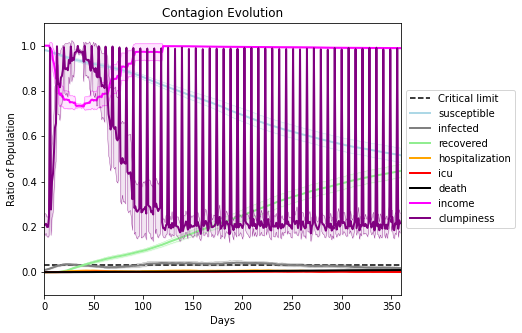

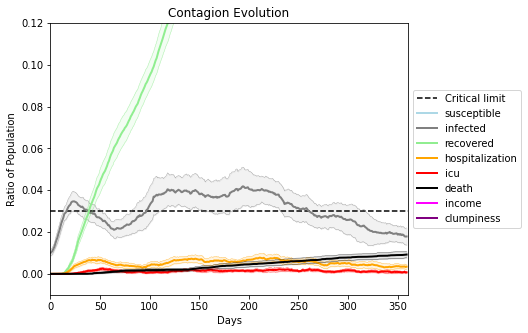

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6657, 6079, 8491, 3732, 5233, 347, 7547, 4667, 6736, 8780, 7444, 6573, 3117, 7895, 8333, 6223, 3992, 3371, 7235, 9305]
Average similarity between family members is 0.9691152469613784 at temperature -0.999
Average similarity between family and home is 0.9998492527725007 at temperature -1
Average similarity between students and their classroom is 0.7184007657805668 at temperature -0.999
Average classroom occupancy is 4.446153846153846 and number classrooms is 65
Average similarity between workers is 0.974113163610026 at temperature -0.999
Average office occupancy is 3.614130434782609 and number offices is 184
Average friend similarity for adults: 0.8605412969451839 for kids: 0.7193127322479722
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6871001517807336
avg restaurant similarity 0.6866666866458645
avg restaurant similarity 0.685869087059208
avg restaurant similarity 0.6603495319841937
avg restaurant similarity 0.7102287471543707
avg restaurant similarity 0.661168613313361
avg restaurant similarity 0.6964938397718679
avg restaurant similarity 0.6091679632694444
avg restaurant similarity 0.6120385527766354
avg restaurant similarity 0.6628915569849387
avg restaurant similarity 0.7028495732769092
avg restaurant similarity 0.6666925698530414
avg restaurant similarity 0.6713379592006705
avg restaurant similarity 0.6506490209347648
avg restaurant similarity 0.6647947211503268
avg restaurant similarity 0.6731061288396798
avg restaurant similarity 0.6925638196983177
avg restaurant similarity 0.6869342411318532
avg restaurant similarity 0.6394963947592587
avg restaurant similarity 0.6845778343643075
avg restaurant similarity 0.631855382562414
avg restaurant similarity 0.6385987534393016
avg restauran

avg restaurant similarity 0.6460939439349611
avg restaurant similarity 0.7086476259371378
avg restaurant similarity 0.6934105474881732
avg restaurant similarity 0.6619717809869718
avg restaurant similarity 0.6574670233766348
avg restaurant similarity 0.6412858969925692
avg restaurant similarity 0.6581266344482998
avg restaurant similarity 0.6515855278432942
avg restaurant similarity 0.6274052147243356
avg restaurant similarity 0.6685702663334109
avg restaurant similarity 0.6459279106014176
avg restaurant similarity 0.6344491155999097
avg restaurant similarity 0.6552772686405501
avg restaurant similarity 0.6013784360360694
avg restaurant similarity 0.667317632333953
avg restaurant similarity 0.6565077749899498
avg restaurant similarity 0.6825145981451605
avg restaurant similarity 0.6624350337814109
avg restaurant similarity 0.6734997468326839
avg restaurant similarity 0.6212685107354562
avg restaurant similarity 0.6438486852729397
avg restaurant similarity 0.6447081861178605
avg restaur

avg restaurant similarity 0.6932381031239482
avg restaurant similarity 0.6713397880338675
avg restaurant similarity 0.6850448671756894
avg restaurant similarity 0.6073812680430256
avg restaurant similarity 0.6741812732612638
avg restaurant similarity 0.7134372833795618
avg restaurant similarity 0.6532494293772093
avg restaurant similarity 0.6601597771412443
avg restaurant similarity 0.6771238176014319
avg restaurant similarity 0.58228510871834
avg restaurant similarity 0.6383776979785946
avg restaurant similarity 0.6637145545286469
avg restaurant similarity 0.6504125443911678
avg restaurant similarity 0.6922618986349586
avg restaurant similarity 0.6568693474154901
avg restaurant similarity 0.6250812703802887
avg restaurant similarity 0.6573905683413772
avg restaurant similarity 0.6500553927355238
avg restaurant similarity 0.6796568468813728
avg restaurant similarity 0.684965187859396
avg restaurant similarity 0.6544872287646354
avg restaurant similarity 0.6568384030703626
avg restauran

avg restaurant similarity 0.6854324621126909
avg restaurant similarity 0.6846776247642515
avg restaurant similarity 0.6681329156115416
avg restaurant similarity 0.7015842285898118
avg restaurant similarity 0.6432811909748192
avg restaurant similarity 0.6673240728363629
avg restaurant similarity 0.6215038892072371
avg restaurant similarity 0.6529267543327865
avg restaurant similarity 0.6392155579244597
avg restaurant similarity 0.735775165483539
avg restaurant similarity 0.6360890901476359
avg restaurant similarity 0.679245095311951
avg restaurant similarity 0.697653388915035
avg restaurant similarity 0.6536146567452701
avg restaurant similarity 0.62338346142422
avg restaurant similarity 0.6875166698151218
avg restaurant similarity 0.625269151590047
avg restaurant similarity 0.6451815060403028
avg restaurant similarity 0.696943615440353
avg restaurant similarity 0.7023850070135619
avg restaurant similarity 0.6167321745668959
avg restaurant similarity 0.6710174669348968
avg restaurant si

avg restaurant similarity 0.6731431384684129
avg restaurant similarity 0.6044613080262493
avg restaurant similarity 0.687649222399785
avg restaurant similarity 0.6688315184667678
avg restaurant similarity 0.6572827637436883
avg restaurant similarity 0.6862992048345188
avg restaurant similarity 0.6689564456833594
avg restaurant similarity 0.6752561447771164
avg restaurant similarity 0.7027465084698787
avg restaurant similarity 0.6256429071644641
avg restaurant similarity 0.6492243714003371
avg restaurant similarity 0.6570311911257429
avg restaurant similarity 0.6092450871028282
avg restaurant similarity 0.6427040295124473
avg restaurant similarity 0.6704980467029809
avg restaurant similarity 0.638347290995133
avg restaurant similarity 0.6133437611009551
avg restaurant similarity 0.6326281976002062
avg restaurant similarity 0.6428376622704017
avg restaurant similarity 0.6401780506450285
avg restaurant similarity 0.6609186795383624
avg restaurant similarity 0.649518246550457
avg restauran

avg restaurant similarity 0.6988493820165053
avg restaurant similarity 0.5675108053340135
avg restaurant similarity 0.6250554919788731
avg restaurant similarity 0.6300725030282929
avg restaurant similarity 0.6495107766902855
avg restaurant similarity 0.6287311442225914
avg restaurant similarity 0.6132334548638855
avg restaurant similarity 0.6378772129330504
avg restaurant similarity 0.6291785990346798
avg restaurant similarity 0.6543407189648229
avg restaurant similarity 0.6364626975247697
avg restaurant similarity 0.6450446985362163
avg restaurant similarity 0.6250695780728592
avg restaurant similarity 0.6188544763704704
avg restaurant similarity 0.6452765683455983
avg restaurant similarity 0.6770983714995784
avg restaurant similarity 0.637584390032292
avg restaurant similarity 0.7065076193238593
avg restaurant similarity 0.6074715277545809
avg restaurant similarity 0.6880914238596456
avg restaurant similarity 0.6541879290147263
avg restaurant similarity 0.705880093691727
avg restaura

avg restaurant similarity 0.6843120526914546
avg restaurant similarity 0.679127894515302
avg restaurant similarity 0.6884399062981563
avg restaurant similarity 0.6661214056943295
avg restaurant similarity 0.6390239970285956
avg restaurant similarity 0.6838633397907411
avg restaurant similarity 0.6611017492614719
avg restaurant similarity 0.6960859432496401
avg restaurant similarity 0.6604531175799202
avg restaurant similarity 0.6432479078698364
avg restaurant similarity 0.6688227863744182
avg restaurant similarity 0.691084581586006
avg restaurant similarity 0.7088234064830893
avg restaurant similarity 0.6597878185180076
avg restaurant similarity 0.6432877979853974
avg restaurant similarity 0.7096680480557006
avg restaurant similarity 0.6280109320697639
avg restaurant similarity 0.6997083546196434
avg restaurant similarity 0.6395467106317047
avg restaurant similarity 0.6625900074001397
avg restaurant similarity 0.628693716349591
avg restaurant similarity 0.6477706503241688
avg restauran

avg restaurant similarity 0.6932017222128182
avg restaurant similarity 0.6376123229205931
avg restaurant similarity 0.6934679764036579
avg restaurant similarity 0.6522105637509003
avg restaurant similarity 0.6674711457402664
avg restaurant similarity 0.6846869900297301
avg restaurant similarity 0.664611538933753
avg restaurant similarity 0.6881310580047532
avg restaurant similarity 0.6569721711703511
avg restaurant similarity 0.6657993046373005
avg restaurant similarity 0.6577639952059756
avg restaurant similarity 0.6697856213916807
avg restaurant similarity 0.6711984175398776
avg restaurant similarity 0.6916531544834
avg restaurant similarity 0.6557615637699731
avg restaurant similarity 0.6841314697556061
avg restaurant similarity 0.6708513793279937
avg restaurant similarity 0.6842210117466276
avg restaurant similarity 0.6995276148093331
avg restaurant similarity 0.7044202585964263
avg restaurant similarity 0.6351253983222975
avg restaurant similarity 0.6666595656569922
avg restaurant

avg restaurant similarity 0.6524957695491976
avg restaurant similarity 0.6751564887819117
avg restaurant similarity 0.7100086295638224
avg restaurant similarity 0.6498098214733345
avg restaurant similarity 0.6581916919897637
avg restaurant similarity 0.6489373428292758
avg restaurant similarity 0.6650958520844799
avg restaurant similarity 0.647870454967657
avg restaurant similarity 0.6836863445709257
avg restaurant similarity 0.643409361652432
avg restaurant similarity 0.6522498080081366
avg restaurant similarity 0.6960333510793438
avg restaurant similarity 0.657321192815623
avg restaurant similarity 0.6537737535835061
avg restaurant similarity 0.6603901297586648
avg restaurant similarity 0.6798278605298519
avg restaurant similarity 0.6961418811259696
avg restaurant similarity 0.6772743811022296
avg restaurant similarity 0.6827160036973645
avg restaurant similarity 0.6447632538946201
avg restaurant similarity 0.6425237298319094
avg restaurant similarity 0.6569847227771971
avg restauran

avg restaurant similarity 0.6323979388373999
avg restaurant similarity 0.710081061843287
avg restaurant similarity 0.6516516978701622
avg restaurant similarity 0.6528693439816725
avg restaurant similarity 0.6901758873754998
avg restaurant similarity 0.6479133933275496
avg restaurant similarity 0.6281107682026387
avg restaurant similarity 0.6715176811718276
avg restaurant similarity 0.7057958236945556
avg restaurant similarity 0.6637590854214171
avg restaurant similarity 0.6961473086040746
avg restaurant similarity 0.6622072964876068
avg restaurant similarity 0.6559791648043846
avg restaurant similarity 0.6993772996222594
avg restaurant similarity 0.6645326208594143
avg restaurant similarity 0.6144883043164363
avg restaurant similarity 0.6163290185727738
avg restaurant similarity 0.6378690708691597
avg restaurant similarity 0.6522684144554912
avg restaurant similarity 0.6337201175919052
avg restaurant similarity 0.6452947633549739
avg restaurant similarity 0.6475096251867147
avg restaur

avg restaurant similarity 0.7250367777940993
avg restaurant similarity 0.652964430139217
avg restaurant similarity 0.706553925907395
avg restaurant similarity 0.6667897270623028
avg restaurant similarity 0.6749679266242755
avg restaurant similarity 0.6791353252132294
avg restaurant similarity 0.6735347926713946
avg restaurant similarity 0.6292654364227457
avg restaurant similarity 0.6563378664246616
avg restaurant similarity 0.6457738108303814
avg restaurant similarity 0.663847928994099
avg restaurant similarity 0.6551728617681193
avg restaurant similarity 0.7171475228126554
avg restaurant similarity 0.6704609856652479
avg restaurant similarity 0.7264787853566492
avg restaurant similarity 0.7222059342083976
avg restaurant similarity 0.7207735889009653
avg restaurant similarity 0.599712413144561
avg restaurant similarity 0.6939860409973448
avg restaurant similarity 0.6707858022032586
avg restaurant similarity 0.6312141884477701
avg restaurant similarity 0.715210889505922
avg restaurant 

avg restaurant similarity 0.7070289800885168
avg restaurant similarity 0.6626724545689204
avg restaurant similarity 0.7038214410894825
avg restaurant similarity 0.6632706670844039
avg restaurant similarity 0.7094367510257829
avg restaurant similarity 0.7000467682931217
avg restaurant similarity 0.5948478131578575
avg restaurant similarity 0.6524969908126808
avg restaurant similarity 0.6822499831520761
avg restaurant similarity 0.7013729490131214
avg restaurant similarity 0.6665389885806954
avg restaurant similarity 0.7144384886013351
avg restaurant similarity 0.7259922045793195
avg restaurant similarity 0.6907943601220309
avg restaurant similarity 0.6987151472110902
avg restaurant similarity 0.738926969106184
avg restaurant similarity 0.6728799616038784
avg restaurant similarity 0.6864286545974454
avg restaurant similarity 0.7200075173794813
avg restaurant similarity 0.6648060105815004
avg restaurant similarity 0.6786251666974841
avg restaurant similarity 0.6612781874418517
avg restaur

avg restaurant similarity 0.6769140306577538
avg restaurant similarity 0.6780611468280785
avg restaurant similarity 0.6755334745844015
avg restaurant similarity 0.7230092666387803
avg restaurant similarity 0.6670229674266258
avg restaurant similarity 0.6957149734827652
avg restaurant similarity 0.6517750097416741
avg restaurant similarity 0.6729985520773529
avg restaurant similarity 0.6708251511309677
avg restaurant similarity 0.6515451665784043
avg restaurant similarity 0.7167551552044342
avg restaurant similarity 0.710878414296419
avg restaurant similarity 0.6565085436657371
avg restaurant similarity 0.7147504833091742
avg restaurant similarity 0.7158750670428288
avg restaurant similarity 0.6295715968309649
avg restaurant similarity 0.6217132277485619
avg restaurant similarity 0.616470504382103
avg restaurant similarity 0.6367934337590548
avg restaurant similarity 0.7141170219335087
avg restaurant similarity 0.6437474965393444
avg restaurant similarity 0.6789892265726467
avg restaura

avg restaurant similarity 0.6536257273404347
avg restaurant similarity 0.6977528262515428
avg restaurant similarity 0.65560484987386
avg restaurant similarity 0.6691379864849681
avg restaurant similarity 0.69744176653791
avg restaurant similarity 0.6307314147974528
avg restaurant similarity 0.6374986926787776
avg restaurant similarity 0.6471443360005668
avg restaurant similarity 0.6897967670124007
avg restaurant similarity 0.6827044547646396
avg restaurant similarity 0.642915694112657
avg restaurant similarity 0.6719992267051925
avg restaurant similarity 0.6377504034209248
avg restaurant similarity 0.6946654651509889
avg restaurant similarity 0.6718829113370475
avg restaurant similarity 0.6711758271622129
avg restaurant similarity 0.6880898078951748
avg restaurant similarity 0.6588062418620142
avg restaurant similarity 0.6682523148964629
avg restaurant similarity 0.6238696402051072
avg restaurant similarity 0.6991108588242629
avg restaurant similarity 0.7231632920447857
avg restaurant 

avg restaurant similarity 0.6708398840320697
avg restaurant similarity 0.6966614957034639
avg restaurant similarity 0.6469057760966684
avg restaurant similarity 0.6086787912900149
avg restaurant similarity 0.6911480387904395
avg restaurant similarity 0.7258239337998931
avg restaurant similarity 0.6440572627624638
avg restaurant similarity 0.624443149243929
avg restaurant similarity 0.6468010860709861
avg restaurant similarity 0.7027114928371733
avg restaurant similarity 0.6455902960755435
avg restaurant similarity 0.6585467223759081
avg restaurant similarity 0.635312649208333
avg restaurant similarity 0.6286974994387213
avg restaurant similarity 0.665340690834485
avg restaurant similarity 0.5908873363525597
avg restaurant similarity 0.6566260854204978
avg restaurant similarity 0.6198782556332697
avg restaurant similarity 0.6001632436525767
avg restaurant similarity 0.6085403503961131
avg restaurant similarity 0.6617069647301583
avg restaurant similarity 0.633842399466804
avg restaurant

avg restaurant similarity 0.6645001981181599
avg restaurant similarity 0.5867210109774008
avg restaurant similarity 0.6510279354883219
avg restaurant similarity 0.6797927440104456
avg restaurant similarity 0.5928255327090141
avg restaurant similarity 0.6764498503179626
avg restaurant similarity 0.6691277219574244
avg restaurant similarity 0.6394694520690137
avg restaurant similarity 0.6543428153588104
avg restaurant similarity 0.691628903812317
avg restaurant similarity 0.6524640167412855
avg restaurant similarity 0.6752738587568419
avg restaurant similarity 0.61024311330298
avg restaurant similarity 0.6293452881472488
avg restaurant similarity 0.6827566940229223
avg restaurant similarity 0.5767773298468221
avg restaurant similarity 0.6191457706573111
avg restaurant similarity 0.641595027512309
avg restaurant similarity 0.6492217697993397
avg restaurant similarity 0.6482721679985065
avg restaurant similarity 0.7015761006641927
avg restaurant similarity 0.6651686207742663
avg restaurant

avg restaurant similarity 0.6948065248358751
avg restaurant similarity 0.65462714098029
avg restaurant similarity 0.6959509997938826
avg restaurant similarity 0.6797247597276523
avg restaurant similarity 0.7004765761694752
avg restaurant similarity 0.7052864168698114
avg restaurant similarity 0.6763734690395565
avg restaurant similarity 0.6877865667802889
avg restaurant similarity 0.6284940976152592
avg restaurant similarity 0.6755986728654204
avg restaurant similarity 0.6639240287399008
avg restaurant similarity 0.7101969516783209
avg restaurant similarity 0.698577279956895
avg restaurant similarity 0.6776941184695794
avg restaurant similarity 0.7450681642800915
avg restaurant similarity 0.633994717311344
avg restaurant similarity 0.648979752682849
avg restaurant similarity 0.5879799838785578
avg restaurant similarity 0.6745025090793497
avg restaurant similarity 0.6984947806172357
avg restaurant similarity 0.6841310868474081
avg restaurant similarity 0.5831440970921379
avg restaurant 

avg restaurant similarity 0.64738814339176
avg restaurant similarity 0.6689824752779426
avg restaurant similarity 0.607189061494811
avg restaurant similarity 0.6342196388731215
avg restaurant similarity 0.6782566921405386
avg restaurant similarity 0.6393164306000066
avg restaurant similarity 0.6832510625336097
avg restaurant similarity 0.6990477760818526
avg restaurant similarity 0.6846184805445432
avg restaurant similarity 0.6367975557108804
avg restaurant similarity 0.7036646793225351
avg restaurant similarity 0.6719028900482061
avg restaurant similarity 0.6800952961207598
avg restaurant similarity 0.7092477039140637
avg restaurant similarity 0.6471808730354588
avg restaurant similarity 0.7112177165741225
avg restaurant similarity 0.6773271659921294
avg restaurant similarity 0.6844710593871093
avg restaurant similarity 0.6902361993820109
avg restaurant similarity 0.6632747806321152
avg restaurant similarity 0.6783448819116897
avg restaurant similarity 0.6378644394392801
avg restauran

avg restaurant similarity 0.6341020831142395
avg restaurant similarity 0.6983675654439612
avg restaurant similarity 0.6650368874796954
avg restaurant similarity 0.6774783439226163
avg restaurant similarity 0.7419286865908268
avg restaurant similarity 0.6527954541891636
avg restaurant similarity 0.691631641205984
avg restaurant similarity 0.7013115233121925
avg restaurant similarity 0.6787323583858671
avg restaurant similarity 0.601232041842631
avg restaurant similarity 0.6688391630326488
avg restaurant similarity 0.6514797932943682
avg restaurant similarity 0.7057884839441356
avg restaurant similarity 0.6781769228353235
avg restaurant similarity 0.6716360573781556
avg restaurant similarity 0.7140684011614145
avg restaurant similarity 0.6825972001622599
avg restaurant similarity 0.6427233767111783
avg restaurant similarity 0.6697506243509751
avg restaurant similarity 0.6898073664371898
avg restaurant similarity 0.6450630895280516
avg restaurant similarity 0.6301648624875085
avg restaura

avg restaurant similarity 0.644684923096992
avg restaurant similarity 0.6335214411517968
avg restaurant similarity 0.6782450281599802
avg restaurant similarity 0.646094806003519
avg restaurant similarity 0.6834537381201543
avg restaurant similarity 0.716249959048894
avg restaurant similarity 0.7009476979882379
avg restaurant similarity 0.6367668778014997
avg restaurant similarity 0.7210865306957144
avg restaurant similarity 0.7181962427586415
avg restaurant similarity 0.7071723369837504
avg restaurant similarity 0.6388136021988492
avg restaurant similarity 0.6995765614614616
avg restaurant similarity 0.6949986738117058
avg restaurant similarity 0.6650477931704711
avg restaurant similarity 0.6141790873105054
avg restaurant similarity 0.6469990867979801
avg restaurant similarity 0.6480056465607632
avg restaurant similarity 0.7062968399093342
avg restaurant similarity 0.7298194527699379
avg restaurant similarity 0.6906333926276105
avg restaurant similarity 0.6931625327432192
avg restauran

avg restaurant similarity 0.6898352098840711
avg restaurant similarity 0.6829395382497409
avg restaurant similarity 0.6536626542475255
avg restaurant similarity 0.6921103140193271
avg restaurant similarity 0.6594069087597315
avg restaurant similarity 0.6456903515592297
avg restaurant similarity 0.5625301367613159
avg restaurant similarity 0.5966473206812585
avg restaurant similarity 0.7000044246181152
avg restaurant similarity 0.6751038168679002
avg restaurant similarity 0.6391192448815158
avg restaurant similarity 0.6550107165444252
avg restaurant similarity 0.642133864599165
avg restaurant similarity 0.6026951142073944
avg restaurant similarity 0.651169081934164
avg restaurant similarity 0.7005429773597788
avg restaurant similarity 0.645501810713657
avg restaurant similarity 0.6283704567881937
avg restaurant similarity 0.6392235731126886
avg restaurant similarity 0.6616831012132902
avg restaurant similarity 0.6850591875966354
avg restaurant similarity 0.6337378635799422
avg restauran

avg restaurant similarity 0.6580208422945324
avg restaurant similarity 0.5988626319917121
avg restaurant similarity 0.650787180580181
avg restaurant similarity 0.6318662458602462
avg restaurant similarity 0.6130829713311694
avg restaurant similarity 0.6616038314987319
avg restaurant similarity 0.5697127078082413
avg restaurant similarity 0.6504365168810378
avg restaurant similarity 0.6286630751487735
avg restaurant similarity 0.6045455135688773
avg restaurant similarity 0.6553455658571403
avg restaurant similarity 0.6885501662200028
avg restaurant similarity 0.6861098591633935
avg restaurant similarity 0.6675242811308412
avg restaurant similarity 0.6580417046877547
avg restaurant similarity 0.6416356510721196
avg restaurant similarity 0.668417842068848
avg restaurant similarity 0.6502961658978209
avg restaurant similarity 0.6392896628623386
avg restaurant similarity 0.6712432986668939
avg restaurant similarity 0.6680760085677392
avg restaurant similarity 0.6402827993965654
avg restaura

avg restaurant similarity 0.6430693776526212
avg restaurant similarity 0.6215038601593272
avg restaurant similarity 0.6229117699600649
avg restaurant similarity 0.7155973749252679
avg restaurant similarity 0.6775641686669535
avg restaurant similarity 0.6555766831654847
avg restaurant similarity 0.6800050600066201
avg restaurant similarity 0.645829217181628
avg restaurant similarity 0.6458319604895102
avg restaurant similarity 0.6397264793888937
avg restaurant similarity 0.6455605823207181
avg restaurant similarity 0.6458669582937019
avg restaurant similarity 0.6623316777508291
avg restaurant similarity 0.6068313063607031
avg restaurant similarity 0.6770547621824397
avg restaurant similarity 0.6830204847500587
avg restaurant similarity 0.6689617553380076
avg restaurant similarity 0.6545998560572976
avg restaurant similarity 0.6518504345605471
avg restaurant similarity 0.6415711948586192
avg restaurant similarity 0.6434710225340176
avg restaurant similarity 0.6477932905190578
avg restaur

avg restaurant similarity 0.6405618858282012
avg restaurant similarity 0.6626641714479482
avg restaurant similarity 0.6605348896501679
avg restaurant similarity 0.6171535534797821
avg restaurant similarity 0.6396260804213411
avg restaurant similarity 0.6485886098425108
avg restaurant similarity 0.6551991153710857
avg restaurant similarity 0.6542067324040747
avg restaurant similarity 0.7007294026263476
avg restaurant similarity 0.6354541335272735
avg restaurant similarity 0.7182904921573813
avg restaurant similarity 0.6639927294814957
avg restaurant similarity 0.6314121904037236
avg restaurant similarity 0.6409232338259845
avg restaurant similarity 0.6449481790109325
avg restaurant similarity 0.6728263942461316
avg restaurant similarity 0.6173354331088515
avg restaurant similarity 0.6620352104846944
avg restaurant similarity 0.6484262299056058
avg restaurant similarity 0.6516849550907811
avg restaurant similarity 0.6215086745520265
avg restaurant similarity 0.6801853452247614
avg restau

avg restaurant similarity 0.7011628687954602
avg restaurant similarity 0.625549332493526
avg restaurant similarity 0.6839881132894625
avg restaurant similarity 0.6308183612762266
avg restaurant similarity 0.571405109227592
avg restaurant similarity 0.6579057170684635
avg restaurant similarity 0.6718429652671536
avg restaurant similarity 0.7075074120164758
avg restaurant similarity 0.6612051381062319
avg restaurant similarity 0.6661187498629605
avg restaurant similarity 0.6608195509688006
avg restaurant similarity 0.6483575748674648
avg restaurant similarity 0.6207990114043161
avg restaurant similarity 0.6042601931963646
avg restaurant similarity 0.650586968549274
avg restaurant similarity 0.6700497367158819
avg restaurant similarity 0.628018778655348
avg restaurant similarity 0.6481882550630305
avg restaurant similarity 0.6098319993134249
avg restaurant similarity 0.6419965162949612
avg restaurant similarity 0.6240451524525036
avg restaurant similarity 0.6501833684514029
avg restaurant

avg restaurant similarity 0.5992269558619645
avg restaurant similarity 0.6364135091082367
avg restaurant similarity 0.6493826741370521
avg restaurant similarity 0.6205588574169669
avg restaurant similarity 0.6278140533894677
avg restaurant similarity 0.6812436925444608
avg restaurant similarity 0.6704852834589629
avg restaurant similarity 0.6788362227450522
avg restaurant similarity 0.6596006203111796
avg restaurant similarity 0.674695090550458
avg restaurant similarity 0.6611302627078866
avg restaurant similarity 0.6451635538991598
avg restaurant similarity 0.6675595932467561
avg restaurant similarity 0.6563992842813515
avg restaurant similarity 0.7174392167379144
avg restaurant similarity 0.6633848285646784
avg restaurant similarity 0.632197911926748
avg restaurant similarity 0.6625168886189977
avg restaurant similarity 0.6516317237986817
avg restaurant similarity 0.6707664914597504
avg restaurant similarity 0.6343389060102521
avg restaurant similarity 0.6571363565359174
avg restaura

avg restaurant similarity 0.6377742769163349
avg restaurant similarity 0.6991875344218674
avg restaurant similarity 0.671251928821758
avg restaurant similarity 0.6935484293888164
avg restaurant similarity 0.6718391970419897
avg restaurant similarity 0.6824482611657366
avg restaurant similarity 0.6503159746630133
avg restaurant similarity 0.7056151219732552
avg restaurant similarity 0.6459682700759805
avg restaurant similarity 0.7310941376367375
avg restaurant similarity 0.5785044247678469
avg restaurant similarity 0.6597869432929322
avg restaurant similarity 0.6019046559701814
avg restaurant similarity 0.6996275678398005
avg restaurant similarity 0.7143889215924721
avg restaurant similarity 0.6209272999271336
avg restaurant similarity 0.6853918370947649
avg restaurant similarity 0.6527530143555662
avg restaurant similarity 0.7119282187311718
avg restaurant similarity 0.7127536554100427
avg restaurant similarity 0.6272037536752957
avg restaurant similarity 0.6191775214580043
avg restaur

avg restaurant similarity 0.6940096752589371
avg restaurant similarity 0.6881657879809762
avg restaurant similarity 0.6321122113567795
avg restaurant similarity 0.6882437658466177
avg restaurant similarity 0.7320922025403871
avg restaurant similarity 0.6890211327681038
avg restaurant similarity 0.6857550900626114
avg restaurant similarity 0.6768990676483938
avg restaurant similarity 0.6406758477876927
avg restaurant similarity 0.6553046225588969
avg restaurant similarity 0.63571797415214
avg restaurant similarity 0.636808349474774
avg restaurant similarity 0.6499244555430012
avg restaurant similarity 0.6796595589150366
avg restaurant similarity 0.6818248492936916
avg restaurant similarity 0.6542119060549005
avg restaurant similarity 0.6273888140748561
avg restaurant similarity 0.6292156695700079
avg restaurant similarity 0.6957430423986787
avg restaurant similarity 0.6692618413013486
avg restaurant similarity 0.6657245128662015
avg restaurant similarity 0.6958030994697706
avg restauran

avg restaurant similarity 0.7148459993798062
avg restaurant similarity 0.6859756431842787
avg restaurant similarity 0.67774738409495
avg restaurant similarity 0.672188523343148
avg restaurant similarity 0.6383861972913663
avg restaurant similarity 0.6445685011586131
avg restaurant similarity 0.6200618914385702
avg restaurant similarity 0.6502464522843321
avg restaurant similarity 0.6265386509608669
avg restaurant similarity 0.6735919177595403
avg restaurant similarity 0.6645947736621761
avg restaurant similarity 0.6764929075657844
avg restaurant similarity 0.6867334186200591
avg restaurant similarity 0.7098567638691305
avg restaurant similarity 0.6987195324030735
avg restaurant similarity 0.7039748188214433
avg restaurant similarity 0.607392513686345
avg restaurant similarity 0.6799564514612794
avg restaurant similarity 0.6688283174208921
avg restaurant similarity 0.6764234975613083
avg restaurant similarity 0.652438955185973
avg restaurant similarity 0.681343512609333
avg restaurant s

avg restaurant similarity 0.683410954580675
avg restaurant similarity 0.73119656034881
avg restaurant similarity 0.6299465596838889
avg restaurant similarity 0.6726715532702882
avg restaurant similarity 0.6436944642611138
avg restaurant similarity 0.685612292629135
avg restaurant similarity 0.6632402606923137
avg restaurant similarity 0.6282356671199942
avg restaurant similarity 0.6338633203259045
avg restaurant similarity 0.6684611438947058
avg restaurant similarity 0.6980351041256102
avg restaurant similarity 0.6636197923603372
avg restaurant similarity 0.6767521399603579
avg restaurant similarity 0.6306604247055823
avg restaurant similarity 0.6550972358455992
avg restaurant similarity 0.6360694952124168
avg restaurant similarity 0.6410477824904098
avg restaurant similarity 0.6491283218416523
avg restaurant similarity 0.6508923947130268
avg restaurant similarity 0.6934256763299955
avg restaurant similarity 0.6219215282215249
avg restaurant similarity 0.6964418355400777
avg restaurant

avg restaurant similarity 0.6290014993110262
avg restaurant similarity 0.6266638350750474
avg restaurant similarity 0.6960755357671631
avg restaurant similarity 0.6456712327005686
avg restaurant similarity 0.5903825131364819
avg restaurant similarity 0.6219750205877653
avg restaurant similarity 0.6441785165436024
avg restaurant similarity 0.6775584069684863
avg restaurant similarity 0.589803440739168
avg restaurant similarity 0.5875963074728792
avg restaurant similarity 0.6347513724907685
avg restaurant similarity 0.6426276333542638
avg restaurant similarity 0.6836913145838412
avg restaurant similarity 0.6810346689916639
avg restaurant similarity 0.6127939774366153
avg restaurant similarity 0.6356098460019975
avg restaurant similarity 0.6429582338140556
avg restaurant similarity 0.5774237566279926
avg restaurant similarity 0.6451900933373063
avg restaurant similarity 0.6640480327913962
avg restaurant similarity 0.6375768308156019
avg restaurant similarity 0.6569409731396285
avg restaur

avg restaurant similarity 0.6386996805423076
avg restaurant similarity 0.6067045571450045
avg restaurant similarity 0.5919078778879888
avg restaurant similarity 0.6414501886975136
avg restaurant similarity 0.639459486839461
avg restaurant similarity 0.6004680667463256
avg restaurant similarity 0.6286263592107318
avg restaurant similarity 0.6470123276199109
avg restaurant similarity 0.6342720625104946
avg restaurant similarity 0.6261259463413863
avg restaurant similarity 0.6666492805962174
avg restaurant similarity 0.6157229214019705
avg restaurant similarity 0.6091619537497256
avg restaurant similarity 0.6397019303999464
avg restaurant similarity 0.6450844586905574
avg restaurant similarity 0.6630187621896451
avg restaurant similarity 0.6712488958229074
avg restaurant similarity 0.6354094533857293
avg restaurant similarity 0.6227474578010092
avg restaurant similarity 0.6463368723183202
avg restaurant similarity 0.5822906352873308
avg restaurant similarity 0.6485806962966457
avg restaur

avg restaurant similarity 0.7278721250593678
avg restaurant similarity 0.6523452775797938
avg restaurant similarity 0.676852548691469
avg restaurant similarity 0.7158160151711697
avg restaurant similarity 0.6800903500255248
avg restaurant similarity 0.6743596454906322
avg restaurant similarity 0.6726389460776144
avg restaurant similarity 0.7100531652286382
avg restaurant similarity 0.6803618071114427
avg restaurant similarity 0.6924812875639529
avg restaurant similarity 0.687332161339758
avg restaurant similarity 0.6646377603645474
avg restaurant similarity 0.6247280932752594
avg restaurant similarity 0.6926650407265735
avg restaurant similarity 0.7136849912937417
avg restaurant similarity 0.6760747022588989
avg restaurant similarity 0.690970380516672
avg restaurant similarity 0.6428304010642041
avg restaurant similarity 0.6810152730398604
avg restaurant similarity 0.6661860009394356
avg restaurant similarity 0.6861431245298314
avg restaurant similarity 0.7104612415079145
avg restauran

avg restaurant similarity 0.7241783071215072
avg restaurant similarity 0.6367228346139208
avg restaurant similarity 0.7357235320177019
avg restaurant similarity 0.7096101644213249
avg restaurant similarity 0.6603910341372536
avg restaurant similarity 0.7090976807574692
avg restaurant similarity 0.7121542630500399
avg restaurant similarity 0.6937344572252454
avg restaurant similarity 0.6774616845498125
avg restaurant similarity 0.671613981332366
avg restaurant similarity 0.699846125203495
avg restaurant similarity 0.6643447422202126
avg restaurant similarity 0.6574188960919759
avg restaurant similarity 0.6458182345381599
avg restaurant similarity 0.7002565821320783
avg restaurant similarity 0.6870264965995595
avg restaurant similarity 0.6377589481941883
avg restaurant similarity 0.679557527696629
avg restaurant similarity 0.680125043762672
avg restaurant similarity 0.6893267254931474
avg restaurant similarity 0.6575491501021457
avg restaurant similarity 0.6640231390845943
avg restaurant

avg restaurant similarity 0.6628522375251584
avg restaurant similarity 0.6576656655212632
avg restaurant similarity 0.6443033564559407
avg restaurant similarity 0.7035225235288408
avg restaurant similarity 0.6580863873660671
avg restaurant similarity 0.700877324439718
avg restaurant similarity 0.673276878419033
avg restaurant similarity 0.6828203059870818
avg restaurant similarity 0.6221019775164481
avg restaurant similarity 0.6318862482620804
avg restaurant similarity 0.6588538908196587
avg restaurant similarity 0.6633575224286379
avg restaurant similarity 0.6326779217590206
avg restaurant similarity 0.6754417946085303
avg restaurant similarity 0.6807650107830377
avg restaurant similarity 0.6855976143843819
avg restaurant similarity 0.6154289628680988
avg restaurant similarity 0.6201290351893097
avg restaurant similarity 0.6378287929728995
avg restaurant similarity 0.660138573673586
avg restaurant similarity 0.6440828273524489
avg restaurant similarity 0.6130092823597849
avg restauran

avg restaurant similarity 0.662761278184897
avg restaurant similarity 0.6511938658686494
avg restaurant similarity 0.6362287304263019
avg restaurant similarity 0.7139518503316954
avg restaurant similarity 0.6737739991511121
avg restaurant similarity 0.6670579301660913
avg restaurant similarity 0.6736158836679256
avg restaurant similarity 0.6945177906965991
avg restaurant similarity 0.7112098428305539
avg restaurant similarity 0.6796567852385655
avg restaurant similarity 0.6873954494682457
avg restaurant similarity 0.6649851806377933
avg restaurant similarity 0.6758432046352767
avg restaurant similarity 0.6693238871206012
avg restaurant similarity 0.6924599158492085
avg restaurant similarity 0.6693643409843058
avg restaurant similarity 0.6434044936551344
avg restaurant similarity 0.7038830465610548
avg restaurant similarity 0.6776506039862059
avg restaurant similarity 0.7122937617227207
avg restaurant similarity 0.6645474784661805
avg restaurant similarity 0.6387858379915228
avg restaur

avg restaurant similarity 0.6953136136947171
avg restaurant similarity 0.6597135887480996
avg restaurant similarity 0.7165911011520989
avg restaurant similarity 0.718074759733188
avg restaurant similarity 0.7407767348223906
avg restaurant similarity 0.6965650178620996
avg restaurant similarity 0.7206600069434014
avg restaurant similarity 0.705142304728664
avg restaurant similarity 0.7131714853465666
avg restaurant similarity 0.7112459856065133
avg restaurant similarity 0.6609296396551765
avg restaurant similarity 0.6984461093758011
avg restaurant similarity 0.7376867354165031
avg restaurant similarity 0.6762239388976911
avg restaurant similarity 0.7373858202989904
avg restaurant similarity 0.6941624324875
avg restaurant similarity 0.68427088274702
avg restaurant similarity 0.6415181682520837
avg restaurant similarity 0.6902185915360632
avg restaurant similarity 0.6635122908205423
avg restaurant similarity 0.7515524198816905
avg restaurant similarity 0.7144308833688098
avg restaurant si

avg restaurant similarity 0.7213953468890139
avg restaurant similarity 0.693050329050862
avg restaurant similarity 0.6992924727467259
avg restaurant similarity 0.6958114371290963
avg restaurant similarity 0.7008097174374278
avg restaurant similarity 0.6684499946868425
avg restaurant similarity 0.6880670936410413
avg restaurant similarity 0.726076001722821
avg restaurant similarity 0.6836780742744046
avg restaurant similarity 0.6194556363451648
avg restaurant similarity 0.6917062813465197
avg restaurant similarity 0.7172194753101853
avg restaurant similarity 0.6804583522783505
avg restaurant similarity 0.7543218276442615
avg restaurant similarity 0.7221352663810287
avg restaurant similarity 0.7034276236989003
avg restaurant similarity 0.6677935183496397
avg restaurant similarity 0.7283666220803456
avg restaurant similarity 0.7114507540378882
avg restaurant similarity 0.6712537708827551
avg restaurant similarity 0.6565788288710211
avg restaurant similarity 0.6237527769976791
avg restaura

avg restaurant similarity 0.6662605469331385
avg restaurant similarity 0.665163755250428
avg restaurant similarity 0.6488872765050014
avg restaurant similarity 0.6724335023778214
avg restaurant similarity 0.6593240454348176
avg restaurant similarity 0.6741687728236297
avg restaurant similarity 0.6793549282133213
avg restaurant similarity 0.6210831817412102
avg restaurant similarity 0.6991960647773525
avg restaurant similarity 0.6439829327489515
avg restaurant similarity 0.6992262972500433
avg restaurant similarity 0.7118427092874611
avg restaurant similarity 0.7186527797704737
avg restaurant similarity 0.6436610023853323
avg restaurant similarity 0.6619821732086184
avg restaurant similarity 0.6721581923934461
avg restaurant similarity 0.6771474898681724
avg restaurant similarity 0.6398662703320472
avg restaurant similarity 0.6546892964533018
avg restaurant similarity 0.6444616677875884
avg restaurant similarity 0.6070210660774756
avg restaurant similarity 0.6224524062988652
avg restaur

avg restaurant similarity 0.6570493651425809
avg restaurant similarity 0.673106915763894
avg restaurant similarity 0.6552350435671755
avg restaurant similarity 0.6643745317445398
avg restaurant similarity 0.6724401569283301
avg restaurant similarity 0.6967206018827157
avg restaurant similarity 0.6644430487369718
avg restaurant similarity 0.625588096262677
avg restaurant similarity 0.6521245067333808
avg restaurant similarity 0.6671913711961351
avg restaurant similarity 0.7019392444320292
avg restaurant similarity 0.6447676546131245
avg restaurant similarity 0.695950754486198
avg restaurant similarity 0.6509031049713287
avg restaurant similarity 0.6133511073450147
avg restaurant similarity 0.677552023626375
avg restaurant similarity 0.7302384011973156
avg restaurant similarity 0.6533877709147373
avg restaurant similarity 0.6652210783080704
avg restaurant similarity 0.6893022545632675
avg restaurant similarity 0.6062383277846863
avg restaurant similarity 0.6349471827239288
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

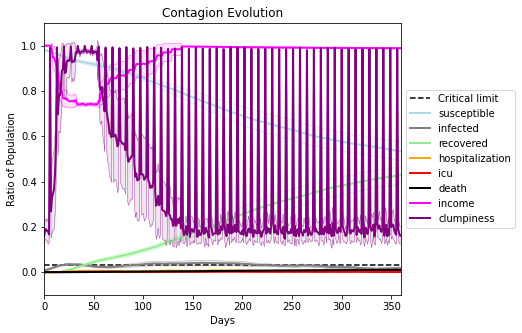

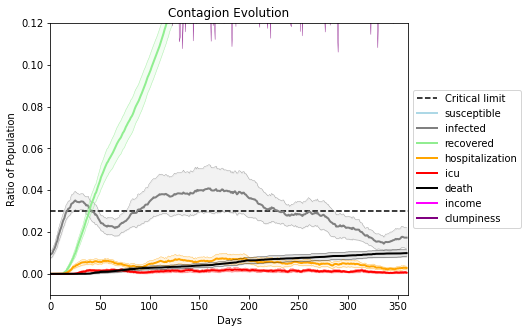

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6957, 505, 704, 7768, 1203, 9595, 2792, 4791, 3068, 5205, 1311, 9791, 1577, 6310, 5940, 8880, 258, 948, 6182, 4843]
Average similarity between family members is 0.9653472230405462 at temperature -0.998
Average similarity between family and home is 0.9998578357750642 at temperature -1
Average similarity between students and their classroom is 0.7135131840293679 at temperature -0.998
Average classroom occupancy is 4.287878787878788 and number classrooms is 66
Average similarity between workers is 0.9486998389253426 at temperature -0.998
Average office occupancy is 3.620879120879121 and number offices is 182
Average friend similarity for adults: 0.860549856317964 for kids: 0.7135546894338225
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.6840429111260281
avg restaurant similarity 0.6177821527868281
avg restaurant similarity 0.63386670404045
avg restaurant similarity 0.6910514201343548
avg restaurant similarity 0.6399807111716809
avg restaurant similarity 0.6457998619767151
avg restaurant similarity 0.7037406103050919
avg restaurant similarity 0.668759775303108
avg restaurant similarity 0.6675175462078324
avg restaurant similarity 0.6543507803045306
avg restaurant similarity 0.67116226193998
avg restaurant similarity 0.6385703409371326
avg restaurant similarity 0.6727545571974526
avg restaurant similarity 0.68801049325885
avg restaurant similarity 0.6904813276979916
avg restaurant similarity 0.6586724863108926
avg restaurant similarity 0.6111162733457242
avg restaurant similarity 0.6980333027650386
avg restaurant similarity 0.6284259523761736
avg restaurant similarity 0.6273884914789712
avg restaurant similarity 0.6500762748525548
avg restaurant similarity 0.6554667170781688
avg restaurant si

avg restaurant similarity 0.6498979309788772
avg restaurant similarity 0.6495325555216541
avg restaurant similarity 0.6380095678880638
avg restaurant similarity 0.6797260142763578
avg restaurant similarity 0.7305051438151544
avg restaurant similarity 0.5980248099705612
avg restaurant similarity 0.6231506501527164
avg restaurant similarity 0.7002903593787132
avg restaurant similarity 0.6306994006900117
avg restaurant similarity 0.618280884365052
avg restaurant similarity 0.6394750919272225
avg restaurant similarity 0.6532305333536118
avg restaurant similarity 0.6703766433285117
avg restaurant similarity 0.7086787512514225
avg restaurant similarity 0.649469312972116
avg restaurant similarity 0.6618001676779299
avg restaurant similarity 0.5983183224245925
avg restaurant similarity 0.6699349010902295
avg restaurant similarity 0.6699570502470293
avg restaurant similarity 0.6030952284043779
avg restaurant similarity 0.6466384654821137
avg restaurant similarity 0.6879669922745829
avg restaura

avg restaurant similarity 0.6391564819859142
avg restaurant similarity 0.6926353444790643
avg restaurant similarity 0.6789840064845792
avg restaurant similarity 0.6783132678876252
avg restaurant similarity 0.6319066398082211
avg restaurant similarity 0.691575366478544
avg restaurant similarity 0.6442336139795107
avg restaurant similarity 0.6989273756680126
avg restaurant similarity 0.6759662498320911
avg restaurant similarity 0.6881687852591251
avg restaurant similarity 0.7065961974826923
avg restaurant similarity 0.6458657533061635
avg restaurant similarity 0.703267396257837
avg restaurant similarity 0.6835889552742129
avg restaurant similarity 0.6538064467582134
avg restaurant similarity 0.6847159047410121
avg restaurant similarity 0.6836957047366286
avg restaurant similarity 0.6881357254464084
avg restaurant similarity 0.6927579429270183
avg restaurant similarity 0.6812799240314088
avg restaurant similarity 0.6715592509866187
avg restaurant similarity 0.7263422978993326
avg restaura

avg restaurant similarity 0.6731372856803897
avg restaurant similarity 0.6678342726155421
avg restaurant similarity 0.6641386542106515
avg restaurant similarity 0.6666784628522688
avg restaurant similarity 0.6881097589565319
avg restaurant similarity 0.6471547569454404
avg restaurant similarity 0.7002979380088491
avg restaurant similarity 0.7358777511541632
avg restaurant similarity 0.6833406568821024
avg restaurant similarity 0.696226603931318
avg restaurant similarity 0.6923197453769306
avg restaurant similarity 0.6445465911234649
avg restaurant similarity 0.6930793540944664
avg restaurant similarity 0.6914391941887726
avg restaurant similarity 0.6587196509848205
avg restaurant similarity 0.6587135999899609
avg restaurant similarity 0.7311696566070746
avg restaurant similarity 0.6910795724019902
avg restaurant similarity 0.6855354859874634
avg restaurant similarity 0.6544959098584139
avg restaurant similarity 0.6966922980292408
avg restaurant similarity 0.7471516797244449
avg restaur

avg restaurant similarity 0.6381409163469094
avg restaurant similarity 0.6559545243925025
avg restaurant similarity 0.7437095705663939
avg restaurant similarity 0.6195796378326102
avg restaurant similarity 0.6698401891075354
avg restaurant similarity 0.6832374641462132
avg restaurant similarity 0.6626615887048399
avg restaurant similarity 0.656023929456661
avg restaurant similarity 0.6849995432449776
avg restaurant similarity 0.587360868779821
avg restaurant similarity 0.648149510263071
avg restaurant similarity 0.6533755824120937
avg restaurant similarity 0.6444300245778123
avg restaurant similarity 0.6450503222036906
avg restaurant similarity 0.67625735134085
avg restaurant similarity 0.6446958782710315
avg restaurant similarity 0.5500044515788876
avg restaurant similarity 0.6358578616055363
avg restaurant similarity 0.7348901252638811
avg restaurant similarity 0.5882959245633841
avg restaurant similarity 0.6537346290974675
avg restaurant similarity 0.6629655734714363
avg restaurant 

avg restaurant similarity 0.6126441798884791
avg restaurant similarity 0.5962148400332997
avg restaurant similarity 0.6447368530632946
avg restaurant similarity 0.6077767124518638
avg restaurant similarity 0.6400831260445881
avg restaurant similarity 0.6501183280929134
avg restaurant similarity 0.6119009399851252
avg restaurant similarity 0.6714264144723041
avg restaurant similarity 0.6532171905090033
avg restaurant similarity 0.5989476193837954
avg restaurant similarity 0.6059157558373355
avg restaurant similarity 0.6065899157297493
avg restaurant similarity 0.7216236010855885
avg restaurant similarity 0.6349097495594916
avg restaurant similarity 0.6800953526610104
avg restaurant similarity 0.7145012469597308
avg restaurant similarity 0.7071715019547208
avg restaurant similarity 0.633973397867904
avg restaurant similarity 0.6620642457721464
avg restaurant similarity 0.6574753477998673
avg restaurant similarity 0.6511437215869746
avg restaurant similarity 0.5730421535282914
avg restaur

avg restaurant similarity 0.6895952631939057
avg restaurant similarity 0.6483413505671646
avg restaurant similarity 0.6608313115908357
avg restaurant similarity 0.6720092226317831
avg restaurant similarity 0.6420554780159219
avg restaurant similarity 0.6673941164836252
avg restaurant similarity 0.6822071575794166
avg restaurant similarity 0.6446327726782592
avg restaurant similarity 0.6404249680940526
avg restaurant similarity 0.7117311237035503
avg restaurant similarity 0.6492068846691287
avg restaurant similarity 0.647818531766123
avg restaurant similarity 0.6582736721477925
avg restaurant similarity 0.6555530639293655
avg restaurant similarity 0.6990898731793539
avg restaurant similarity 0.6693596306291523
avg restaurant similarity 0.6351567977717786
avg restaurant similarity 0.6537115883297339
avg restaurant similarity 0.6246440554636131
avg restaurant similarity 0.6680744113102417
avg restaurant similarity 0.6906133817228537
avg restaurant similarity 0.6505763135317207
avg restaur

avg restaurant similarity 0.6823906193886976
avg restaurant similarity 0.6869929149102143
avg restaurant similarity 0.6592668395629532
avg restaurant similarity 0.6215236023781221
avg restaurant similarity 0.6845795797994532
avg restaurant similarity 0.7448537447455903
avg restaurant similarity 0.6455646177744662
avg restaurant similarity 0.6375970325881927
avg restaurant similarity 0.6873475680301648
avg restaurant similarity 0.6409688489927168
avg restaurant similarity 0.666727368501831
avg restaurant similarity 0.6987805512449211
avg restaurant similarity 0.6582406216193901
avg restaurant similarity 0.644215643464516
avg restaurant similarity 0.7064443799230996
avg restaurant similarity 0.6558370423469743
avg restaurant similarity 0.631492216177014
avg restaurant similarity 0.6496470774793515
avg restaurant similarity 0.6360847510975387
avg restaurant similarity 0.6436923896284539
avg restaurant similarity 0.6424599487907112
avg restaurant similarity 0.6483580167734238
avg restauran

avg restaurant similarity 0.6678957056171045
avg restaurant similarity 0.6600033775544489
avg restaurant similarity 0.6496890178925194
avg restaurant similarity 0.6263170072944807
avg restaurant similarity 0.6048678088722969
avg restaurant similarity 0.6635821285669855
avg restaurant similarity 0.6724070429816296
avg restaurant similarity 0.6524440339267507
avg restaurant similarity 0.6844124379456399
avg restaurant similarity 0.6589802125454717
avg restaurant similarity 0.6549105611436099
avg restaurant similarity 0.6177557473838876
avg restaurant similarity 0.6576699925371803
avg restaurant similarity 0.6316914177510723
avg restaurant similarity 0.6583693401325418
avg restaurant similarity 0.6962508228946801
avg restaurant similarity 0.648690426878722
avg restaurant similarity 0.6528417485105152
avg restaurant similarity 0.6384151006700046
avg restaurant similarity 0.6067946273535821
avg restaurant similarity 0.6693056014483811
avg restaurant similarity 0.6261081462851859
avg restaur

avg restaurant similarity 0.6418115912646863
avg restaurant similarity 0.6556359753474486
avg restaurant similarity 0.6779111294435087
avg restaurant similarity 0.6296461937673826
avg restaurant similarity 0.684208572176538
avg restaurant similarity 0.622511182284934
avg restaurant similarity 0.6852733164035598
avg restaurant similarity 0.6825731440838317
avg restaurant similarity 0.6224851196754603
avg restaurant similarity 0.6530953505063289
avg restaurant similarity 0.6056024937155118
avg restaurant similarity 0.6623882552165855
avg restaurant similarity 0.6873373484152564
avg restaurant similarity 0.6785715104346081
avg restaurant similarity 0.700301468759693
avg restaurant similarity 0.6319206101786492
avg restaurant similarity 0.6283520402702919
avg restaurant similarity 0.63519113785116
avg restaurant similarity 0.6288999995622719
avg restaurant similarity 0.6562847304185244
avg restaurant similarity 0.6815248257790938
avg restaurant similarity 0.6268399019263345
avg restaurant 

avg restaurant similarity 0.6886937883216765
avg restaurant similarity 0.6721263651232077
avg restaurant similarity 0.6610934080232088
avg restaurant similarity 0.6611521477048963
avg restaurant similarity 0.6453166989446739
avg restaurant similarity 0.6174563585399733
avg restaurant similarity 0.6631948075403225
avg restaurant similarity 0.6144865331993985
avg restaurant similarity 0.6533644360971324
avg restaurant similarity 0.5798832276582921
avg restaurant similarity 0.6625724777389844
avg restaurant similarity 0.6628083443833975
avg restaurant similarity 0.6717323643365957
avg restaurant similarity 0.6680780126017826
avg restaurant similarity 0.6075331821491764
avg restaurant similarity 0.652626603839272
avg restaurant similarity 0.6156442043136687
avg restaurant similarity 0.6459403882715161
avg restaurant similarity 0.5989689121175261
avg restaurant similarity 0.6200575134033703
avg restaurant similarity 0.6654348820039377
avg restaurant similarity 0.6551403967494369
avg restaur

avg restaurant similarity 0.6352595421877566
avg restaurant similarity 0.6398640088851555
avg restaurant similarity 0.7024545689377817
avg restaurant similarity 0.6513405354970333
avg restaurant similarity 0.6259869383695783
avg restaurant similarity 0.6562275262945572
avg restaurant similarity 0.6874465231923921
avg restaurant similarity 0.6563912063996474
avg restaurant similarity 0.6460766032829365
avg restaurant similarity 0.6086709930477163
avg restaurant similarity 0.620610058409988
avg restaurant similarity 0.6534522982288837
avg restaurant similarity 0.6840184944812474
avg restaurant similarity 0.6261816562030046
avg restaurant similarity 0.696715367756495
avg restaurant similarity 0.6923262391132671
avg restaurant similarity 0.6941418484326682
avg restaurant similarity 0.6367865951977766
avg restaurant similarity 0.6540918767409364
avg restaurant similarity 0.6543673834850123
avg restaurant similarity 0.6834788504206013
avg restaurant similarity 0.6218396998182217
avg restaura

avg restaurant similarity 0.6518959351170671
avg restaurant similarity 0.6297176693389981
avg restaurant similarity 0.6504220486269403
avg restaurant similarity 0.6387208255617316
avg restaurant similarity 0.6438461144843844
avg restaurant similarity 0.6666333387527035
avg restaurant similarity 0.651880660295588
avg restaurant similarity 0.6777298563446125
avg restaurant similarity 0.6395740520914382
avg restaurant similarity 0.7184858508163071
avg restaurant similarity 0.6641157981795075
avg restaurant similarity 0.6583450249972417
avg restaurant similarity 0.6592644256568443
avg restaurant similarity 0.624514338772766
avg restaurant similarity 0.6453437552172795
avg restaurant similarity 0.6607657760721172
avg restaurant similarity 0.6418116126561231
avg restaurant similarity 0.6377590980699489
avg restaurant similarity 0.6629555184977084
avg restaurant similarity 0.6699157412257043
avg restaurant similarity 0.645014763129509
avg restaurant similarity 0.6732615829069742
avg restauran

avg restaurant similarity 0.6337227141378126
avg restaurant similarity 0.672789868645912
avg restaurant similarity 0.6670331358027332
avg restaurant similarity 0.6630571794118204
avg restaurant similarity 0.6661585512177673
avg restaurant similarity 0.6365173740797584
avg restaurant similarity 0.6559877454493427
avg restaurant similarity 0.632374467918274
avg restaurant similarity 0.6624296484451394
avg restaurant similarity 0.6552820510110428
avg restaurant similarity 0.6604838004357519
avg restaurant similarity 0.6534913654776379
avg restaurant similarity 0.6271915609219438
avg restaurant similarity 0.6480450168311566
avg restaurant similarity 0.6148493577068833
avg restaurant similarity 0.6528766971483596
avg restaurant similarity 0.6398338496528374
avg restaurant similarity 0.642668731484273
avg restaurant similarity 0.6412766007929732
avg restaurant similarity 0.732056079372815
avg restaurant similarity 0.6606098517646384
avg restaurant similarity 0.6279671946546093
avg restaurant

avg restaurant similarity 0.6760046794253923
avg restaurant similarity 0.6598855117591752
avg restaurant similarity 0.7002471477005733
avg restaurant similarity 0.6470540813116205
avg restaurant similarity 0.6910851238178033
avg restaurant similarity 0.6412352189680764
avg restaurant similarity 0.649345213752294
avg restaurant similarity 0.6512797079292654
avg restaurant similarity 0.6883500041074665
avg restaurant similarity 0.6893274531079839
avg restaurant similarity 0.7177676652677435
avg restaurant similarity 0.6596750697065629
avg restaurant similarity 0.6686820193702296
avg restaurant similarity 0.6642186552082104
avg restaurant similarity 0.6373261077439151
avg restaurant similarity 0.6922030063268261
avg restaurant similarity 0.716238942060922
avg restaurant similarity 0.6702074215297316
avg restaurant similarity 0.6514330846304311
avg restaurant similarity 0.6659610942034733
avg restaurant similarity 0.6299120443310031
avg restaurant similarity 0.6758916810291398
avg restaura

avg restaurant similarity 0.6761360788852361
avg restaurant similarity 0.6933364998390656
avg restaurant similarity 0.6936570408582823
avg restaurant similarity 0.6482101617658923
avg restaurant similarity 0.6785424840976927
avg restaurant similarity 0.6532944920416481
avg restaurant similarity 0.6865142897340248
avg restaurant similarity 0.656639049855832
avg restaurant similarity 0.6597680541114798
avg restaurant similarity 0.6973935757499968
avg restaurant similarity 0.6322062742639797
avg restaurant similarity 0.6975766370930906
avg restaurant similarity 0.6414809384981828
avg restaurant similarity 0.6188641640652547
avg restaurant similarity 0.71253805317344
avg restaurant similarity 0.6910374734630286
avg restaurant similarity 0.656724940261788
avg restaurant similarity 0.6177148304925315
avg restaurant similarity 0.6846767288475941
avg restaurant similarity 0.6638880898322569
avg restaurant similarity 0.6602922791999114
avg restaurant similarity 0.6972242525518835
avg restaurant

avg restaurant similarity 0.6869024600715309
avg restaurant similarity 0.6708599555200682
avg restaurant similarity 0.6505918342938106
avg restaurant similarity 0.735489438167802
avg restaurant similarity 0.6633463860756263
avg restaurant similarity 0.6654990662839404
avg restaurant similarity 0.6694085668942115
avg restaurant similarity 0.6763785609108371
avg restaurant similarity 0.6585670367910452
avg restaurant similarity 0.6898022811517783
avg restaurant similarity 0.7237713575268816
avg restaurant similarity 0.6529328177033893
avg restaurant similarity 0.6793518844405273
avg restaurant similarity 0.6873783298725263
avg restaurant similarity 0.6676579003423454
avg restaurant similarity 0.6542755276035692
avg restaurant similarity 0.6982110232747922
avg restaurant similarity 0.6438859323292371
avg restaurant similarity 0.6503774539934334
avg restaurant similarity 0.6945678779925637
avg restaurant similarity 0.6691231052930214
avg restaurant similarity 0.6653629679795201
avg restaur

avg restaurant similarity 0.7089940688405127
avg restaurant similarity 0.7102410957041162
avg restaurant similarity 0.685293339333066
avg restaurant similarity 0.671746901234042
avg restaurant similarity 0.681154969566567
avg restaurant similarity 0.6493292293595723
avg restaurant similarity 0.646214932630668
avg restaurant similarity 0.6970565057613073
avg restaurant similarity 0.7065344534045401
avg restaurant similarity 0.6664873591048612
avg restaurant similarity 0.6229543097619903
avg restaurant similarity 0.6811495565782983
avg restaurant similarity 0.7051288676923392
avg restaurant similarity 0.6972575589694887
avg restaurant similarity 0.652488347571298
avg restaurant similarity 0.7013787482136982
avg restaurant similarity 0.7219265534574334
avg restaurant similarity 0.6684880623093183
avg restaurant similarity 0.654544954988437
avg restaurant similarity 0.6746319364341967
avg restaurant similarity 0.6425625154415231
avg restaurant similarity 0.6741135418495666
avg restaurant s

avg restaurant similarity 0.7203477032970016
avg restaurant similarity 0.7349937843956881
avg restaurant similarity 0.6816265500135031
avg restaurant similarity 0.7393746869133772
avg restaurant similarity 0.7429249119702789
avg restaurant similarity 0.7070440026605083
avg restaurant similarity 0.7099169450026472
avg restaurant similarity 0.7289955693242004
avg restaurant similarity 0.7210126467460658
avg restaurant similarity 0.7046551870270746
avg restaurant similarity 0.7355820003993668
avg restaurant similarity 0.6858393106683845
avg restaurant similarity 0.7541871134007756
avg restaurant similarity 0.7611293126285745
avg restaurant similarity 0.6934739791762521
avg restaurant similarity 0.7993183860221335
avg restaurant similarity 0.734050132300427
avg restaurant similarity 0.7397049435058233
avg restaurant similarity 0.685223578301056
avg restaurant similarity 0.7228026268498006
avg restaurant similarity 0.7231269512581167
avg restaurant similarity 0.7245106745162883
avg restaura

avg restaurant similarity 0.6712229008313407
avg restaurant similarity 0.6651178903325917
avg restaurant similarity 0.684140023718038
avg restaurant similarity 0.7377418851451404
avg restaurant similarity 0.6964598468934504
avg restaurant similarity 0.6979006226349085
avg restaurant similarity 0.7241462513164303
avg restaurant similarity 0.7340721052379484
avg restaurant similarity 0.7040738783816275
avg restaurant similarity 0.6921394462599377
avg restaurant similarity 0.7176598014492114
avg restaurant similarity 0.7355750216089909
avg restaurant similarity 0.6982787262343279
avg restaurant similarity 0.7364237650555603
avg restaurant similarity 0.7145650370569245
avg restaurant similarity 0.7119061553180133
avg restaurant similarity 0.7815299753032031
avg restaurant similarity 0.6600431283423022
avg restaurant similarity 0.733249104843655
avg restaurant similarity 0.7322468434693659
avg restaurant similarity 0.6859705584154133
avg restaurant similarity 0.7291209686551658
avg restaura

avg restaurant similarity 0.6608806475125046
avg restaurant similarity 0.6193314893085521
avg restaurant similarity 0.637177407654791
avg restaurant similarity 0.6435095856985174
avg restaurant similarity 0.5895014606322959
avg restaurant similarity 0.6088259575565693
avg restaurant similarity 0.6684746501420151
avg restaurant similarity 0.6562575860405006
avg restaurant similarity 0.6520521969568024
avg restaurant similarity 0.6874733141572006
avg restaurant similarity 0.664946874680867
avg restaurant similarity 0.6332669362519507
avg restaurant similarity 0.6247011790080262
avg restaurant similarity 0.6211521270410665
avg restaurant similarity 0.7074523451719862
avg restaurant similarity 0.6658989089070042
avg restaurant similarity 0.6529251647572882
avg restaurant similarity 0.6546521509858999
avg restaurant similarity 0.6767444034073316
avg restaurant similarity 0.6400023568891204
avg restaurant similarity 0.6267361109718912
avg restaurant similarity 0.6533176659375866
avg restaura

avg restaurant similarity 0.6321431346346549
avg restaurant similarity 0.5495917492428147
avg restaurant similarity 0.5592315684200071
avg restaurant similarity 0.5553228533998403
avg restaurant similarity 0.6506850620218814
avg restaurant similarity 0.6377550306830906
avg restaurant similarity 0.6563715408003169
avg restaurant similarity 0.6077781348122756
avg restaurant similarity 0.6369258900525442
avg restaurant similarity 0.6593487286423074
avg restaurant similarity 0.6470158012061716
avg restaurant similarity 0.6638221000270714
avg restaurant similarity 0.5931495719628498
avg restaurant similarity 0.6497339193532148
avg restaurant similarity 0.6350288296195774
avg restaurant similarity 0.6593154596266684
avg restaurant similarity 0.6332818811796236
avg restaurant similarity 0.602124012427189
avg restaurant similarity 0.6723130043757524
avg restaurant similarity 0.5925633280841334
avg restaurant similarity 0.617399428414303
avg restaurant similarity 0.6390758953173069
avg restaura

avg restaurant similarity 0.6751725538446134
avg restaurant similarity 0.6381038577019867
avg restaurant similarity 0.6323549040201879
avg restaurant similarity 0.6101504311184935
avg restaurant similarity 0.6095403534228017
avg restaurant similarity 0.6185326645948194
avg restaurant similarity 0.6047075062771771
avg restaurant similarity 0.6419680793610871
avg restaurant similarity 0.6864378496383553
avg restaurant similarity 0.5512081504854064
avg restaurant similarity 0.5917614173367419
avg restaurant similarity 0.5980078110606687
avg restaurant similarity 0.6655404173034302
avg restaurant similarity 0.6502980679959762
avg restaurant similarity 0.6187826968710434
avg restaurant similarity 0.6128549939076752
avg restaurant similarity 0.7383955703237826
avg restaurant similarity 0.6050053825465723
avg restaurant similarity 0.6233703346998365
avg restaurant similarity 0.6643132926824361
avg restaurant similarity 0.613343267647061
avg restaurant similarity 0.6872258028915644
avg restaur

avg restaurant similarity 0.6249956132932142
avg restaurant similarity 0.5532517276711061
avg restaurant similarity 0.6184012126737058
avg restaurant similarity 0.67846649446749
avg restaurant similarity 0.6387366183526026
avg restaurant similarity 0.5959933776208823
avg restaurant similarity 0.6237454823148653
avg restaurant similarity 0.6698286016513227
avg restaurant similarity 0.66249149629357
avg restaurant similarity 0.6650411910263824
avg restaurant similarity 0.6009645322909273
avg restaurant similarity 0.5969784504953806
avg restaurant similarity 0.6293048540299091
avg restaurant similarity 0.6971410296164974
avg restaurant similarity 0.6562734797927188
avg restaurant similarity 0.5856163735587555
avg restaurant similarity 0.5686943765559648
avg restaurant similarity 0.6520021476394278
avg restaurant similarity 0.6355389152861007
avg restaurant similarity 0.6452217842230686
avg restaurant similarity 0.6215170626155199
avg restaurant similarity 0.5829854624853944
avg restaurant

avg restaurant similarity 0.6739966293593908
avg restaurant similarity 0.6959914021528629
avg restaurant similarity 0.7112491710503238
avg restaurant similarity 0.6709965897565321
avg restaurant similarity 0.6661328753577551
avg restaurant similarity 0.6932950481669762
avg restaurant similarity 0.6929689577636594
avg restaurant similarity 0.7133354211967787
avg restaurant similarity 0.6897974402128854
avg restaurant similarity 0.6355948183454553
avg restaurant similarity 0.638288070473934
avg restaurant similarity 0.6789103063435334
avg restaurant similarity 0.6657722017227045
avg restaurant similarity 0.6503652080171154
avg restaurant similarity 0.6419623674686151
avg restaurant similarity 0.7073488539410066
avg restaurant similarity 0.6891375505243934
avg restaurant similarity 0.6902095516852286
avg restaurant similarity 0.6993231592715557
avg restaurant similarity 0.7416482443540094
avg restaurant similarity 0.6479051135309508
avg restaurant similarity 0.6671812951089164
avg restaur

avg restaurant similarity 0.6624451791257318
avg restaurant similarity 0.6807130245792661
avg restaurant similarity 0.6252108852737541
avg restaurant similarity 0.7013029512408199
avg restaurant similarity 0.6419233322448338
avg restaurant similarity 0.6922546703816531
avg restaurant similarity 0.6783264010213711
avg restaurant similarity 0.6762569067233448
avg restaurant similarity 0.6858868188165391
avg restaurant similarity 0.7095839766025266
avg restaurant similarity 0.6564295527070846
avg restaurant similarity 0.6586630455295931
avg restaurant similarity 0.6347316461943547
avg restaurant similarity 0.6691926174382437
avg restaurant similarity 0.6849834381399686
avg restaurant similarity 0.7281852867001104
avg restaurant similarity 0.6960479104601325
avg restaurant similarity 0.6663643361877797
avg restaurant similarity 0.6645290688946256
avg restaurant similarity 0.6306411639156053
avg restaurant similarity 0.6310518725796661
avg restaurant similarity 0.6952363161955758
avg restau

avg restaurant similarity 0.6174910367847297
avg restaurant similarity 0.6908544413862836
avg restaurant similarity 0.6245343681455469
avg restaurant similarity 0.6760213390758167
avg restaurant similarity 0.673245361431735
avg restaurant similarity 0.6855658197395416
avg restaurant similarity 0.5601506536602656
avg restaurant similarity 0.7096023075739887
avg restaurant similarity 0.6484339642962214
avg restaurant similarity 0.6557360719844233
avg restaurant similarity 0.6803722350786119
avg restaurant similarity 0.590225201177477
avg restaurant similarity 0.6330819778240242
avg restaurant similarity 0.6345985383460324
avg restaurant similarity 0.6477869296388098
avg restaurant similarity 0.6872707007364567
avg restaurant similarity 0.6214759767513794
avg restaurant similarity 0.6100170828356395
avg restaurant similarity 0.5845654581126887
avg restaurant similarity 0.6611063126680713
avg restaurant similarity 0.6456122304870919
avg restaurant similarity 0.6255713312394385
avg restaura

avg restaurant similarity 0.6557204938969668
avg restaurant similarity 0.641973775480338
avg restaurant similarity 0.6281714098997927
avg restaurant similarity 0.6374373010198432
avg restaurant similarity 0.6257474084951984
avg restaurant similarity 0.6253791218592105
avg restaurant similarity 0.715102001884345
avg restaurant similarity 0.63705907392589
avg restaurant similarity 0.6639275952457377
avg restaurant similarity 0.6333587288813785
avg restaurant similarity 0.6515944594750642
avg restaurant similarity 0.6638543963728697
avg restaurant similarity 0.6220177010097485
avg restaurant similarity 0.6052471357960096
avg restaurant similarity 0.6178901214398282
avg restaurant similarity 0.6755388079338044
avg restaurant similarity 0.6556570030044417
avg restaurant similarity 0.6107853313763659
avg restaurant similarity 0.6368375624695193
avg restaurant similarity 0.6391744146399281
avg restaurant similarity 0.6738076134544666
avg restaurant similarity 0.6766864627667712
avg restaurant

avg restaurant similarity 0.6502233192144357
avg restaurant similarity 0.6905514174490534
avg restaurant similarity 0.7022404990747203
avg restaurant similarity 0.688802185374751
avg restaurant similarity 0.6817314021671192
avg restaurant similarity 0.6675513541474619
avg restaurant similarity 0.6111261620287075
avg restaurant similarity 0.6141643273628085
avg restaurant similarity 0.647958471738743
avg restaurant similarity 0.6908096107743155
avg restaurant similarity 0.6353573382067846
avg restaurant similarity 0.7082389199668303
avg restaurant similarity 0.6508007201339505
avg restaurant similarity 0.6462150274402553
avg restaurant similarity 0.658226079125629
avg restaurant similarity 0.6486362520137853
avg restaurant similarity 0.6148894648099824
avg restaurant similarity 0.5971615198414676
avg restaurant similarity 0.6206939085073083
avg restaurant similarity 0.5951002314196426
avg restaurant similarity 0.728211331973848
avg restaurant similarity 0.6989663853475689
avg restaurant

avg restaurant similarity 0.6488640432539181
avg restaurant similarity 0.6064784479024845
avg restaurant similarity 0.6326065807899138
avg restaurant similarity 0.6306810666225814
avg restaurant similarity 0.6578704454946958
avg restaurant similarity 0.6888724789895084
avg restaurant similarity 0.6792796558148774
avg restaurant similarity 0.6693006465762421
avg restaurant similarity 0.642551549309864
avg restaurant similarity 0.6491707276737987
avg restaurant similarity 0.6553869078929947
avg restaurant similarity 0.6625275335004345
avg restaurant similarity 0.6109097225873724
avg restaurant similarity 0.6329904545025995
avg restaurant similarity 0.67760795977677
avg restaurant similarity 0.6302026882756117
avg restaurant similarity 0.6497718301525585
avg restaurant similarity 0.6412331920266588
avg restaurant similarity 0.7005021346542407
avg restaurant similarity 0.6054880208358316
avg restaurant similarity 0.624013215937352
avg restaurant similarity 0.6868196862114846
avg restaurant

avg restaurant similarity 0.5959169509872835
avg restaurant similarity 0.6773476286358239
avg restaurant similarity 0.6755378726587111
avg restaurant similarity 0.6007012539282262
avg restaurant similarity 0.6018875134959029
avg restaurant similarity 0.6184607752038666
avg restaurant similarity 0.6247938266397722
avg restaurant similarity 0.6524074466220388
avg restaurant similarity 0.6384729316628658
avg restaurant similarity 0.6244619100323145
avg restaurant similarity 0.6150722991764113
avg restaurant similarity 0.5680626010562394
avg restaurant similarity 0.6712886652293121
avg restaurant similarity 0.5759240047324523
avg restaurant similarity 0.6221852913455408
avg restaurant similarity 0.6284572139755106
avg restaurant similarity 0.6340518444620996
avg restaurant similarity 0.6453881801446251
avg restaurant similarity 0.6299867986610447
avg restaurant similarity 0.582982676063508
avg restaurant similarity 0.5636257887525762
avg restaurant similarity 0.6026629678666021
avg restaur

avg restaurant similarity 0.6189383813944277
avg restaurant similarity 0.5924201687476897
avg restaurant similarity 0.6509882387498447
avg restaurant similarity 0.6118376297945322
avg restaurant similarity 0.6472671440535663
avg restaurant similarity 0.6089127158698711
avg restaurant similarity 0.6055295166597463
avg restaurant similarity 0.6127059821407512
avg restaurant similarity 0.5763202666014433
avg restaurant similarity 0.6169548221230065
avg restaurant similarity 0.5947738696670498
avg restaurant similarity 0.6330420311887721
avg restaurant similarity 0.6710712517890369
avg restaurant similarity 0.5823336788223824
avg restaurant similarity 0.5740713859810741
avg restaurant similarity 0.6500165653246482
avg restaurant similarity 0.5636639779475775
avg restaurant similarity 0.6187684089500993
avg restaurant similarity 0.6223317719841238
avg restaurant similarity 0.6743067346980554
avg restaurant similarity 0.6024148375099035
avg restaurant similarity 0.6418018269793682
avg restau

avg restaurant similarity 0.6941991384076761
avg restaurant similarity 0.628488686390708
avg restaurant similarity 0.661647056810512
avg restaurant similarity 0.6628763633633823
avg restaurant similarity 0.7037097053370296
avg restaurant similarity 0.704223197856283
avg restaurant similarity 0.680400375656276
avg restaurant similarity 0.6659399794177204
avg restaurant similarity 0.6592790376206141
avg restaurant similarity 0.6751226338987252
avg restaurant similarity 0.6736491061843779
avg restaurant similarity 0.6671228672229972
avg restaurant similarity 0.6393616803726259
avg restaurant similarity 0.6657498362295763
avg restaurant similarity 0.6754336745371015
avg restaurant similarity 0.6566769611952615
avg restaurant similarity 0.714510784990753
avg restaurant similarity 0.7024622868310947
avg restaurant similarity 0.6895845050982697
avg restaurant similarity 0.7006989561122522
avg restaurant similarity 0.7034723950503501
avg restaurant similarity 0.6646482679909733
avg restaurant 

avg restaurant similarity 0.6586738996812425
avg restaurant similarity 0.6822779980222708
avg restaurant similarity 0.6795504963799365
avg restaurant similarity 0.6819537433742054
avg restaurant similarity 0.6833624430544778
avg restaurant similarity 0.637215339459576
avg restaurant similarity 0.6857654141439762
avg restaurant similarity 0.7080563722332789
avg restaurant similarity 0.7177499012230759
avg restaurant similarity 0.6939825747702211
avg restaurant similarity 0.6219788432294218
avg restaurant similarity 0.6641789429399
avg restaurant similarity 0.7075366433964867
avg restaurant similarity 0.7082415118350234
avg restaurant similarity 0.6604636195948925
avg restaurant similarity 0.6641688743563273
avg restaurant similarity 0.6782144516571449
avg restaurant similarity 0.6984745156037084
avg restaurant similarity 0.7041306929002128
avg restaurant similarity 0.6961885342869464
avg restaurant similarity 0.697485404158669
avg restaurant similarity 0.6565945519196575
avg restaurant 

avg restaurant similarity 0.6608464877552529
avg restaurant similarity 0.6804413446218095
avg restaurant similarity 0.646620513095957
avg restaurant similarity 0.6666818092475278
avg restaurant similarity 0.6693465851228045
avg restaurant similarity 0.6480216045125801
avg restaurant similarity 0.6337733806800394
avg restaurant similarity 0.5829261643485032
avg restaurant similarity 0.6680811404581545
avg restaurant similarity 0.6265447412542682
avg restaurant similarity 0.6612105353004702
avg restaurant similarity 0.6703643690220578
avg restaurant similarity 0.6400742402131302
avg restaurant similarity 0.6887739482668769
avg restaurant similarity 0.6143532899232214
avg restaurant similarity 0.6455273377993161
avg restaurant similarity 0.6760783034088801
avg restaurant similarity 0.6885137313507704
avg restaurant similarity 0.6789704875788721
avg restaurant similarity 0.6446106548245553
avg restaurant similarity 0.6314891500111964
avg restaurant similarity 0.6405006313668692
avg restaur

avg restaurant similarity 0.6761860073210681
avg restaurant similarity 0.6664480582603944
avg restaurant similarity 0.6713931902006817
avg restaurant similarity 0.642205110770001
avg restaurant similarity 0.632099027240741
avg restaurant similarity 0.6899303486553284
avg restaurant similarity 0.6304348390126492
avg restaurant similarity 0.6620249787259874
avg restaurant similarity 0.6179397296790378
avg restaurant similarity 0.6452294048334671
avg restaurant similarity 0.6783901555074122
avg restaurant similarity 0.5947709135065395
avg restaurant similarity 0.6701913826060468
avg restaurant similarity 0.6825932831880182
avg restaurant similarity 0.6606063546284683
avg restaurant similarity 0.6721120687206221
avg restaurant similarity 0.6292061895661689
avg restaurant similarity 0.6736573217324486
avg restaurant similarity 0.6817669431648089
avg restaurant similarity 0.6880753638875506
avg restaurant similarity 0.6173680462679421
avg restaurant similarity 0.706675398853221
avg restauran

avg restaurant similarity 0.6632513748361005
avg restaurant similarity 0.6457146522590574
avg restaurant similarity 0.663667051505974
avg restaurant similarity 0.6297155853413631
avg restaurant similarity 0.6443530190160917
avg restaurant similarity 0.627097159998231
avg restaurant similarity 0.6191575689462515
avg restaurant similarity 0.6633468870979693
avg restaurant similarity 0.6767044404205257
avg restaurant similarity 0.6776524882337747
avg restaurant similarity 0.6477638059284152
avg restaurant similarity 0.6270622584092737
avg restaurant similarity 0.6439654571107698
avg restaurant similarity 0.5705736573101323
avg restaurant similarity 0.6664995408223633
avg restaurant similarity 0.6929433255935312
avg restaurant similarity 0.6319011321442818
avg restaurant similarity 0.6061471719885191
avg restaurant similarity 0.6308713790912094
avg restaurant similarity 0.6479815056100723
avg restaurant similarity 0.6311467698831635
avg restaurant similarity 0.6381005280499523
avg restaura

avg restaurant similarity 0.6252638617747514
avg restaurant similarity 0.6402061928264967
avg restaurant similarity 0.6242659965422797
avg restaurant similarity 0.6056412694827754
avg restaurant similarity 0.6651155919249195
avg restaurant similarity 0.662562624746168
avg restaurant similarity 0.6797062097966202
avg restaurant similarity 0.6534587805061837
avg restaurant similarity 0.6532176225714157
avg restaurant similarity 0.6502422774762641
avg restaurant similarity 0.6014057974488936
avg restaurant similarity 0.6875715172968643
avg restaurant similarity 0.6610179560704537
avg restaurant similarity 0.6437804725444357
avg restaurant similarity 0.6792897720368563
avg restaurant similarity 0.6737601746658716
avg restaurant similarity 0.677725513454944
avg restaurant similarity 0.628334547259251
avg restaurant similarity 0.6208658022322341
avg restaurant similarity 0.6631838493305146
avg restaurant similarity 0.6361008695450047
avg restaurant similarity 0.6704841737444442
avg restauran

avg restaurant similarity 0.6173175096753022
avg restaurant similarity 0.6015126575344564
avg restaurant similarity 0.6301403824666751
avg restaurant similarity 0.5381126151238047
avg restaurant similarity 0.6196244782885103
avg restaurant similarity 0.6115717420772809
avg restaurant similarity 0.5643359337613785
avg restaurant similarity 0.6186233257074668
avg restaurant similarity 0.5886490775776451
avg restaurant similarity 0.5963703088566048
avg restaurant similarity 0.6515708934413876
avg restaurant similarity 0.656776670598878
avg restaurant similarity 0.6302159544289906
avg restaurant similarity 0.6662809289809309
avg restaurant similarity 0.5867383343367609
avg restaurant similarity 0.6425477406090954
avg restaurant similarity 0.6475210756548571
avg restaurant similarity 0.6817085034385759
avg restaurant similarity 0.6562398772398031
avg restaurant similarity 0.6497795886053865
avg restaurant similarity 0.6436203020372018
avg restaurant similarity 0.6119490990736568
avg restaur

avg restaurant similarity 0.6015800199313248
avg restaurant similarity 0.6094275625956226
avg restaurant similarity 0.6457670300858536
avg restaurant similarity 0.6770226783923382
avg restaurant similarity 0.6898530145332229
avg restaurant similarity 0.6659660127923702
avg restaurant similarity 0.6188511810980164
avg restaurant similarity 0.613560790622058
avg restaurant similarity 0.6033117627078314
avg restaurant similarity 0.6237873617969525
avg restaurant similarity 0.6016035532683361
avg restaurant similarity 0.6665695268256898
avg restaurant similarity 0.6362690035860107
avg restaurant similarity 0.6632693571962787
avg restaurant similarity 0.6070271517254979
avg restaurant similarity 0.6515830277174598
avg restaurant similarity 0.6498193426655428
avg restaurant similarity 0.6285118945190108
avg restaurant similarity 0.6081250865454123
avg restaurant similarity 0.6224822439570076
avg restaurant similarity 0.6571937535782352
avg restaurant similarity 0.6458099322896415
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

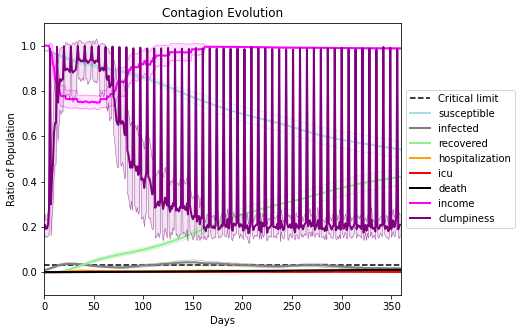

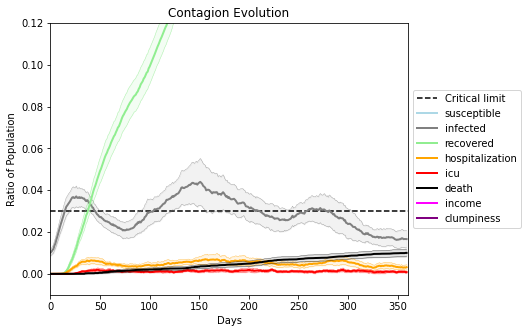

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6495, 6198, 9574, 4555, 4190, 3531, 2207, 9866, 6493, 8298, 4140, 6839, 416, 3523, 3118, 2129, 6378, 4662, 1455, 911]
Average similarity between family members is 0.9561068161472297 at temperature -0.9975
Average similarity between family and home is 0.9998651240182257 at temperature -1
Average similarity between students and their classroom is 0.6945300984605228 at temperature -0.9975
Average classroom occupancy is 4.070422535211268 and number classrooms is 71
Average similarity between workers is 0.9449439828103259 at temperature -0.9975
Average office occupancy is 3.3989637305699483 and number offices is 193
Average friend similarity for adults: 0.8580863783836986 for kids: 0.7084390563445845
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.6603119510663766
avg restaurant similarity 0.664343085374222
avg restaurant similarity 0.5985254457197373
avg restaurant similarity 0.6656951967839195
avg restaurant similarity 0.6607320933226051
avg restaurant similarity 0.6373544081354228
avg restaurant similarity 0.6694397809786153
avg restaurant similarity 0.5772521454787803
avg restaurant similarity 0.6042422286249616
avg restaurant similarity 0.669702509762156
avg restaurant similarity 0.662172275838423
avg restaurant similarity 0.64809030121181
avg restaurant similarity 0.6309724615245732
avg restaurant similarity 0.5702849240945346
avg restaurant similarity 0.6441419670035005
avg restaurant similarity 0.6126395501053614
avg restaurant similarity 0.6377487357690326
avg restaurant similarity 0.5886720216941601
avg restaurant similarity 0.6321999941166984
avg restaurant similarity 0.6332489586321225
avg restaurant similarity 0.6267485341739804
avg restaurant similarity 0.6384069586130442
avg restaurant 

avg restaurant similarity 0.6498321420374608
avg restaurant similarity 0.6414371098084787
avg restaurant similarity 0.6335486132559024
avg restaurant similarity 0.6146807694783611
avg restaurant similarity 0.623433700561629
avg restaurant similarity 0.6197181991469264
avg restaurant similarity 0.6032305025214355
avg restaurant similarity 0.705336725426189
avg restaurant similarity 0.6220276517904503
avg restaurant similarity 0.6107953413455669
avg restaurant similarity 0.6315635739336662
avg restaurant similarity 0.6293755247492975
avg restaurant similarity 0.5698831178583186
avg restaurant similarity 0.6178483476404466
avg restaurant similarity 0.6377687110846393
avg restaurant similarity 0.6255835440235715
avg restaurant similarity 0.574284284080359
avg restaurant similarity 0.6312991034046643
avg restaurant similarity 0.6294287812168347
avg restaurant similarity 0.6427929643009959
avg restaurant similarity 0.6507217573107015
avg restaurant similarity 0.6494775114231004
avg restauran

avg restaurant similarity 0.656157780869514
avg restaurant similarity 0.637188974099247
avg restaurant similarity 0.6248571810191956
avg restaurant similarity 0.6262833425746828
avg restaurant similarity 0.6562883481324375
avg restaurant similarity 0.594450770773945
avg restaurant similarity 0.6015398537935732
avg restaurant similarity 0.6222463146100341
avg restaurant similarity 0.6448553479095077
avg restaurant similarity 0.5960041631099626
avg restaurant similarity 0.6039068826665884
avg restaurant similarity 0.6372013843555397
avg restaurant similarity 0.6894444563365449
avg restaurant similarity 0.6046621529557008
avg restaurant similarity 0.5785973948454256
avg restaurant similarity 0.6638665981730673
avg restaurant similarity 0.6077758602127018
avg restaurant similarity 0.6258260355714981
avg restaurant similarity 0.6499289481855943
avg restaurant similarity 0.6259254948776602
avg restaurant similarity 0.6116283832125508
avg restaurant similarity 0.6221376969926969
avg restauran

avg restaurant similarity 0.5893510278425177
avg restaurant similarity 0.5924064518503492
avg restaurant similarity 0.6404795934392818
avg restaurant similarity 0.6061634385298205
avg restaurant similarity 0.6136125594178378
avg restaurant similarity 0.5808619103610347
avg restaurant similarity 0.6111277261085424
avg restaurant similarity 0.6738681992873968
avg restaurant similarity 0.619852102068782
avg restaurant similarity 0.5961994167013612
avg restaurant similarity 0.6300836266309415
avg restaurant similarity 0.6208133540141899
avg restaurant similarity 0.6308737667780653
avg restaurant similarity 0.638979917857081
avg restaurant similarity 0.5849056042768385
avg restaurant similarity 0.6103993352092628
avg restaurant similarity 0.5876150203186878
avg restaurant similarity 0.6420505990065389
avg restaurant similarity 0.6113339503197435
avg restaurant similarity 0.5975001522168533
avg restaurant similarity 0.6197350704367087
avg restaurant similarity 0.6329330517893899
avg restaura

avg restaurant similarity 0.6401864564715438
avg restaurant similarity 0.624408549834353
avg restaurant similarity 0.6368999883797574
avg restaurant similarity 0.6447855145340892
avg restaurant similarity 0.6282375787568871
avg restaurant similarity 0.6291615015660081
avg restaurant similarity 0.6863090966296442
avg restaurant similarity 0.6206048230050835
avg restaurant similarity 0.6443106583417052
avg restaurant similarity 0.6530479373135031
avg restaurant similarity 0.6610822486663972
avg restaurant similarity 0.6378253364776787
avg restaurant similarity 0.6590671076857153
avg restaurant similarity 0.6847000086675383
avg restaurant similarity 0.6567030430462126
avg restaurant similarity 0.6759562042978997
avg restaurant similarity 0.6368495512601775
avg restaurant similarity 0.6257185956337419
avg restaurant similarity 0.7037973985978693
avg restaurant similarity 0.668939353003713
avg restaurant similarity 0.6800858343836937
avg restaurant similarity 0.6346728458442973
avg restaura

avg restaurant similarity 0.6303052036032751
avg restaurant similarity 0.6332721269341473
avg restaurant similarity 0.6394839676230941
avg restaurant similarity 0.6661469605345183
avg restaurant similarity 0.6003427160155247
avg restaurant similarity 0.6235227527668344
avg restaurant similarity 0.6532493093266245
avg restaurant similarity 0.6353367136539269
avg restaurant similarity 0.640603658894702
avg restaurant similarity 0.6624145385889278
avg restaurant similarity 0.6194244081563783
avg restaurant similarity 0.6853948952683434
avg restaurant similarity 0.6050785369442909
avg restaurant similarity 0.6203560837590947
avg restaurant similarity 0.6266527848859087
avg restaurant similarity 0.6709073277771097
avg restaurant similarity 0.6755550885893908
avg restaurant similarity 0.623298724701827
avg restaurant similarity 0.6604810525655291
avg restaurant similarity 0.6427144725455252
avg restaurant similarity 0.6372304409606155
avg restaurant similarity 0.6102145326214028
avg restaura

avg restaurant similarity 0.599406698524393
avg restaurant similarity 0.6108951779343108
avg restaurant similarity 0.5996595764344497
avg restaurant similarity 0.6840180134911981
avg restaurant similarity 0.652125320169662
avg restaurant similarity 0.6396822210636963
avg restaurant similarity 0.6461929604418701
avg restaurant similarity 0.6029998668833817
avg restaurant similarity 0.6203785794484072
avg restaurant similarity 0.5894221174679153
avg restaurant similarity 0.5686310021121133
avg restaurant similarity 0.63713380427103
avg restaurant similarity 0.5817802323200187
avg restaurant similarity 0.6628055451447988
avg restaurant similarity 0.6295357244854419
avg restaurant similarity 0.6613463210301419
avg restaurant similarity 0.6614449276721387
avg restaurant similarity 0.6179066105618098
avg restaurant similarity 0.6447316519779832
avg restaurant similarity 0.600071234775406
avg restaurant similarity 0.6396519619784741
avg restaurant similarity 0.6194964692908682
avg restaurant 

avg restaurant similarity 0.6299865525068273
avg restaurant similarity 0.5865633645246479
avg restaurant similarity 0.6405838697352696
avg restaurant similarity 0.6114197081536166
avg restaurant similarity 0.5872675620956054
avg restaurant similarity 0.586504886766235
avg restaurant similarity 0.6250447722058059
avg restaurant similarity 0.6001314160015238
avg restaurant similarity 0.5989023705666172
avg restaurant similarity 0.6326358446466813
avg restaurant similarity 0.6586083010474896
avg restaurant similarity 0.6354632905513481
avg restaurant similarity 0.5662749506673277
avg restaurant similarity 0.6251255709364504
avg restaurant similarity 0.6149878345789761
avg restaurant similarity 0.6321291106597451
avg restaurant similarity 0.6538569810138373
avg restaurant similarity 0.6196757860549418
avg restaurant similarity 0.6554173246040622
avg restaurant similarity 0.602269871026923
avg restaurant similarity 0.6817846164247506
avg restaurant similarity 0.6635288712699572
avg restaura

avg restaurant similarity 0.6214796259202744
avg restaurant similarity 0.6152305737258189
avg restaurant similarity 0.6277253750129121
avg restaurant similarity 0.632301899519407
avg restaurant similarity 0.6564844596034299
avg restaurant similarity 0.6007411992038512
avg restaurant similarity 0.6728350803709641
avg restaurant similarity 0.6364523325091118
avg restaurant similarity 0.6508013887026878
avg restaurant similarity 0.6138098354853477
avg restaurant similarity 0.6207797292634346
avg restaurant similarity 0.6623022273957111
avg restaurant similarity 0.6249675804139543
avg restaurant similarity 0.6133074972928377
avg restaurant similarity 0.659712084305086
avg restaurant similarity 0.5894992952646831
avg restaurant similarity 0.6742723429976877
avg restaurant similarity 0.625841951037412
avg restaurant similarity 0.6326628544789105
avg restaurant similarity 0.6518632731430818
avg restaurant similarity 0.634263737154016
avg restaurant similarity 0.6117804060344751
avg restaurant

avg restaurant similarity 0.6210535612580493
avg restaurant similarity 0.6697213083339262
avg restaurant similarity 0.6212621862245454
avg restaurant similarity 0.628865434118533
avg restaurant similarity 0.6660657767722737
avg restaurant similarity 0.605134182191564
avg restaurant similarity 0.6421578915757367
avg restaurant similarity 0.6344104550880304
avg restaurant similarity 0.6085093199366106
avg restaurant similarity 0.6448829881517771
avg restaurant similarity 0.5989485273477189
avg restaurant similarity 0.6230683218900344
avg restaurant similarity 0.6179711704983311
avg restaurant similarity 0.6002862040520984
avg restaurant similarity 0.6558550683339849
avg restaurant similarity 0.6200902368943583
avg restaurant similarity 0.627274906089988
avg restaurant similarity 0.688128420001704
avg restaurant similarity 0.5818145433530847
avg restaurant similarity 0.6901155938561646
avg restaurant similarity 0.6454655601920948
avg restaurant similarity 0.6657868436958516
avg restaurant

avg restaurant similarity 0.6533886850390669
avg restaurant similarity 0.6164599709914355
avg restaurant similarity 0.5982032356195142
avg restaurant similarity 0.6251977964295716
avg restaurant similarity 0.6465528693454378
avg restaurant similarity 0.616589212330872
avg restaurant similarity 0.6031810282582988
avg restaurant similarity 0.6083208807689973
avg restaurant similarity 0.6042875342796773
avg restaurant similarity 0.6110927374793798
avg restaurant similarity 0.5869549681873171
avg restaurant similarity 0.6275135932255195
avg restaurant similarity 0.6307583811256648
avg restaurant similarity 0.6115582359938216
avg restaurant similarity 0.5960969786873126
avg restaurant similarity 0.609563622846386
avg restaurant similarity 0.5725810464289952
avg restaurant similarity 0.6304173371881824
avg restaurant similarity 0.619948591978425
avg restaurant similarity 0.6320857920064382
avg restaurant similarity 0.6517014511878935
avg restaurant similarity 0.5782914501632187
avg restauran

avg restaurant similarity 0.5401054671978517
avg restaurant similarity 0.6296909561874605
avg restaurant similarity 0.6343336957551142
avg restaurant similarity 0.6111839200497902
avg restaurant similarity 0.6417532378372657
avg restaurant similarity 0.5884410651103306
avg restaurant similarity 0.6010779181957091
avg restaurant similarity 0.6187491981127633
avg restaurant similarity 0.6334764212981828
avg restaurant similarity 0.6255373116934232
avg restaurant similarity 0.6333270489480513
avg restaurant similarity 0.600544701753075
avg restaurant similarity 0.6174332450292561
avg restaurant similarity 0.5891023706242748
avg restaurant similarity 0.6492178058780094
avg restaurant similarity 0.6266615367333088
avg restaurant similarity 0.5967082817048195
avg restaurant similarity 0.6169068276113615
avg restaurant similarity 0.6444499721791642
avg restaurant similarity 0.5480012529738277
avg restaurant similarity 0.5753405790649041
avg restaurant similarity 0.6541995608350079
avg restaur

avg restaurant similarity 0.6708914282894252
avg restaurant similarity 0.6029137637901393
avg restaurant similarity 0.6002824628292537
avg restaurant similarity 0.6144592867770196
avg restaurant similarity 0.6026669529924957
avg restaurant similarity 0.5796972803276658
avg restaurant similarity 0.6331859754588004
avg restaurant similarity 0.6045613008737994
avg restaurant similarity 0.6365346258814006
avg restaurant similarity 0.6473329574775142
avg restaurant similarity 0.6132403358408337
avg restaurant similarity 0.6090135697330404
avg restaurant similarity 0.6073157305285748
avg restaurant similarity 0.6101610604454059
avg restaurant similarity 0.649002193259518
avg restaurant similarity 0.5513345210367327
avg restaurant similarity 0.6332649898377868
avg restaurant similarity 0.5996806432417371
avg restaurant similarity 0.6447288019337999
avg restaurant similarity 0.6347640579685013
avg restaurant similarity 0.6204310539098598
avg restaurant similarity 0.599674549004301
avg restaura

avg restaurant similarity 0.5453524494626083
avg restaurant similarity 0.6401441306736425
avg restaurant similarity 0.5991755514939628
avg restaurant similarity 0.5745397067521353
avg restaurant similarity 0.5668437570398085
avg restaurant similarity 0.5639816613309265
avg restaurant similarity 0.6292503005245287
avg restaurant similarity 0.6296996305292881
avg restaurant similarity 0.6082948269019702
avg restaurant similarity 0.5987765790640128
avg restaurant similarity 0.5780611768692973
avg restaurant similarity 0.6196415095097673
avg restaurant similarity 0.5572115518545416
avg restaurant similarity 0.5898675488768801
avg restaurant similarity 0.6120572566522139
avg restaurant similarity 0.5999962469908658
avg restaurant similarity 0.5747734284822181
avg restaurant similarity 0.6096973067583261
avg restaurant similarity 0.6078350335477941
avg restaurant similarity 0.5923962332237553
avg restaurant similarity 0.5787960606776723
avg restaurant similarity 0.6408448278777631
avg restau

avg restaurant similarity 0.6293676106536215
avg restaurant similarity 0.6477061666346872
avg restaurant similarity 0.634094312125134
avg restaurant similarity 0.6194864305617879
avg restaurant similarity 0.6375396902739998
avg restaurant similarity 0.6857618341244242
avg restaurant similarity 0.6221483693179458
avg restaurant similarity 0.644947197525952
avg restaurant similarity 0.6440392861463966
avg restaurant similarity 0.7223340407655827
avg restaurant similarity 0.5645150593240805
avg restaurant similarity 0.6326365029440134
avg restaurant similarity 0.665597128034352
avg restaurant similarity 0.6073470570670003
avg restaurant similarity 0.6252591831629617
avg restaurant similarity 0.7039348982074702
avg restaurant similarity 0.6086207977194948
avg restaurant similarity 0.6524865866128519
avg restaurant similarity 0.6143630804185652
avg restaurant similarity 0.5828807405541024
avg restaurant similarity 0.6305611404105372
avg restaurant similarity 0.6382345110565888
avg restauran

avg restaurant similarity 0.6941645656574063
avg restaurant similarity 0.6840450191209908
avg restaurant similarity 0.6306725635286211
avg restaurant similarity 0.6188387539503563
avg restaurant similarity 0.6852276503436685
avg restaurant similarity 0.6107550714220351
avg restaurant similarity 0.6280864449820915
avg restaurant similarity 0.6711822688910277
avg restaurant similarity 0.6212829300682084
avg restaurant similarity 0.60342988391617
avg restaurant similarity 0.5979599215155039
avg restaurant similarity 0.6470611237260439
avg restaurant similarity 0.6696167402143585
avg restaurant similarity 0.6421546642362332
avg restaurant similarity 0.6627213911902199
avg restaurant similarity 0.654234464070699
avg restaurant similarity 0.6390802607110581
avg restaurant similarity 0.6670308260367136
avg restaurant similarity 0.6160690260232219
avg restaurant similarity 0.6365622913076685
avg restaurant similarity 0.6272837142835734
avg restaurant similarity 0.6264163797716414
avg restauran

avg restaurant similarity 0.63701866941339
avg restaurant similarity 0.6599043926300273
avg restaurant similarity 0.6396751919080017
avg restaurant similarity 0.700491725771765
avg restaurant similarity 0.6491229801653299
avg restaurant similarity 0.6449187632004711
avg restaurant similarity 0.6648448735273139
avg restaurant similarity 0.7160435872498837
avg restaurant similarity 0.6712240072579356
avg restaurant similarity 0.6225387606010025
avg restaurant similarity 0.6546772348059594
avg restaurant similarity 0.6067412180840283
avg restaurant similarity 0.6127310527663332
avg restaurant similarity 0.6019879848441356
avg restaurant similarity 0.6303258743751283
avg restaurant similarity 0.6359378769304039
avg restaurant similarity 0.6815845239295757
avg restaurant similarity 0.6542748220133612
avg restaurant similarity 0.6226966449455705
avg restaurant similarity 0.6936576069089323
avg restaurant similarity 0.6685085807847635
avg restaurant similarity 0.6575026287829085
avg restauran

avg restaurant similarity 0.6669518048630453
avg restaurant similarity 0.5995120304596941
avg restaurant similarity 0.6670728878752492
avg restaurant similarity 0.5972943999356968
avg restaurant similarity 0.6274059337007327
avg restaurant similarity 0.6572002822081536
avg restaurant similarity 0.6118525577399819
avg restaurant similarity 0.6602770219224575
avg restaurant similarity 0.6703269899596357
avg restaurant similarity 0.6160049446806604
avg restaurant similarity 0.6510925687760923
avg restaurant similarity 0.6140448291632413
avg restaurant similarity 0.6334766418416675
avg restaurant similarity 0.616152623864309
avg restaurant similarity 0.6626238586311445
avg restaurant similarity 0.6505157723391198
avg restaurant similarity 0.6187233080357016
avg restaurant similarity 0.6323682627813872
avg restaurant similarity 0.6440896968732776
avg restaurant similarity 0.6370276933739537
avg restaurant similarity 0.6841602536307614
avg restaurant similarity 0.6771611274456198
avg restaur

avg restaurant similarity 0.6303030992171019
avg restaurant similarity 0.544895505424815
avg restaurant similarity 0.5553933844986074
avg restaurant similarity 0.693911352972893
avg restaurant similarity 0.5799294691191457
avg restaurant similarity 0.6406311477499536
avg restaurant similarity 0.6437617209920471
avg restaurant similarity 0.5904690777094215
avg restaurant similarity 0.6468332480433441
avg restaurant similarity 0.5422613042784687
avg restaurant similarity 0.6831566893218038
avg restaurant similarity 0.6153726998845456
avg restaurant similarity 0.5826110434639167
avg restaurant similarity 0.5474308804996981
avg restaurant similarity 0.6076471294568697
avg restaurant similarity 0.6012163408451834
avg restaurant similarity 0.5419991034552982
avg restaurant similarity 0.5938900660319814
avg restaurant similarity 0.6285448402206579
avg restaurant similarity 0.6032673443124968
avg restaurant similarity 0.5972517538933836
avg restaurant similarity 0.569293280075452
avg restauran

avg restaurant similarity 0.5406843563257929
avg restaurant similarity 0.5217398867099619
avg restaurant similarity 0.6423075083348635
avg restaurant similarity 0.6219109693342891
avg restaurant similarity 0.6435983397941749
avg restaurant similarity 0.6580767746326166
avg restaurant similarity 0.6326520554017832
avg restaurant similarity 0.5506925056958253
avg restaurant similarity 0.5260052634006702
avg restaurant similarity 0.5820564615154004
avg restaurant similarity 0.6441594680953151
avg restaurant similarity 0.5954272296099764
avg restaurant similarity 0.5324139953056445
avg restaurant similarity 0.6006683212240036
avg restaurant similarity 0.6658266475124484
avg restaurant similarity 0.6504972068576348
avg restaurant similarity 0.5848221628065094
avg restaurant similarity 0.612260930934343
avg restaurant similarity 0.5736213784981794
avg restaurant similarity 0.6338664772149647
avg restaurant similarity 0.6766136740383004
avg restaurant similarity 0.5825896729656035
avg restaur

avg restaurant similarity 0.6306066131194377
avg restaurant similarity 0.6509490571827179
avg restaurant similarity 0.5923463201979108
avg restaurant similarity 0.6021530395182263
avg restaurant similarity 0.7042028792548819
avg restaurant similarity 0.6096247836057346
avg restaurant similarity 0.6521171548099755
avg restaurant similarity 0.5878553388694054
avg restaurant similarity 0.6003373220621013
avg restaurant similarity 0.5994237439127417
avg restaurant similarity 0.5962762128214257
avg restaurant similarity 0.6582712894594368
avg restaurant similarity 0.5759921387914413
avg restaurant similarity 0.6311236827858522
avg restaurant similarity 0.6428341636634781
avg restaurant similarity 0.5884798650598679
avg restaurant similarity 0.6111520199625847
avg restaurant similarity 0.6181305349874379
avg restaurant similarity 0.6321407421559039
avg restaurant similarity 0.6070928619098287
avg restaurant similarity 0.5672636122121245
avg restaurant similarity 0.5750865563733744
avg restau

avg restaurant similarity 0.5744992652354066
avg restaurant similarity 0.6027768928986661
avg restaurant similarity 0.6171637917633938
avg restaurant similarity 0.568184325155229
avg restaurant similarity 0.6238408985332039
avg restaurant similarity 0.5715208119940498
avg restaurant similarity 0.6426856522814137
avg restaurant similarity 0.628871729764421
avg restaurant similarity 0.6516726352213252
avg restaurant similarity 0.6430382376698072
avg restaurant similarity 0.5825100790529487
avg restaurant similarity 0.5516582359165093
avg restaurant similarity 0.5740045628677839
avg restaurant similarity 0.6023878846081273
avg restaurant similarity 0.5121508525967602
avg restaurant similarity 0.555894535291184
avg restaurant similarity 0.5484255617871007
avg restaurant similarity 0.5764727477811598
avg restaurant similarity 0.6365134291498722
avg restaurant similarity 0.5991926241312886
avg restaurant similarity 0.5631001486323813
avg restaurant similarity 0.5698800865789622
avg restauran

avg restaurant similarity 0.5761476213108329
avg restaurant similarity 0.6056480031594572
avg restaurant similarity 0.606715839778861
avg restaurant similarity 0.5752426598445944
avg restaurant similarity 0.6291483603111429
avg restaurant similarity 0.6238867207851853
avg restaurant similarity 0.6245103763604855
avg restaurant similarity 0.6174031233558095
avg restaurant similarity 0.6821497924949587
avg restaurant similarity 0.6118792138886173
avg restaurant similarity 0.5671088401622635
avg restaurant similarity 0.5706610788962742
avg restaurant similarity 0.5920194244142158
avg restaurant similarity 0.5528142677807146
avg restaurant similarity 0.6100191946418847
avg restaurant similarity 0.5698171314970435
avg restaurant similarity 0.5095849319691477
avg restaurant similarity 0.6451082793493578
avg restaurant similarity 0.6138738214727233
avg restaurant similarity 0.5807617359497482
avg restaurant similarity 0.6326220411934701
avg restaurant similarity 0.6226839321203452
avg restaur

avg restaurant similarity 0.5953482419149722
avg restaurant similarity 0.5871594045991432
avg restaurant similarity 0.6209285857334633
avg restaurant similarity 0.5908353262718483
avg restaurant similarity 0.5919919501170652
avg restaurant similarity 0.6489802866404089
avg restaurant similarity 0.5533704227407525
avg restaurant similarity 0.6122030361458853
avg restaurant similarity 0.6525073819689022
avg restaurant similarity 0.6467681857911021
avg restaurant similarity 0.6887424927997792
avg restaurant similarity 0.6421605958909091
avg restaurant similarity 0.6471214963909896
avg restaurant similarity 0.5727667101231582
avg restaurant similarity 0.6177872720191223
avg restaurant similarity 0.6477443693023194
avg restaurant similarity 0.5981370703815382
avg restaurant similarity 0.574567528535543
avg restaurant similarity 0.5843375024830625
avg restaurant similarity 0.5940419538046695
avg restaurant similarity 0.6130428271061038
avg restaurant similarity 0.6341633147731613
avg restaur

avg restaurant similarity 0.6054012694558802
avg restaurant similarity 0.6495322088353053
avg restaurant similarity 0.6409968052636773
avg restaurant similarity 0.6104874799163532
avg restaurant similarity 0.5598815092906009
avg restaurant similarity 0.6364682424352014
avg restaurant similarity 0.5834866660362683
avg restaurant similarity 0.6266621470813236
avg restaurant similarity 0.6689188403774826
avg restaurant similarity 0.5792285719026126
avg restaurant similarity 0.6078689516554228
avg restaurant similarity 0.6155231196620254
avg restaurant similarity 0.5951940634165966
avg restaurant similarity 0.6005796509079526
avg restaurant similarity 0.6275241679906131
avg restaurant similarity 0.5604861098343689
avg restaurant similarity 0.6158420911063778
avg restaurant similarity 0.5715823248440557
avg restaurant similarity 0.636700375166172
avg restaurant similarity 0.5625852494704502
avg restaurant similarity 0.6656895469696448
avg restaurant similarity 0.5826374449222593
avg restaur

avg restaurant similarity 0.6286341273022786
avg restaurant similarity 0.5986195716338302
avg restaurant similarity 0.6306009161019841
avg restaurant similarity 0.6358603481184887
avg restaurant similarity 0.5862916350612215
avg restaurant similarity 0.6167552334260018
avg restaurant similarity 0.6454851108611952
avg restaurant similarity 0.5892781864305355
avg restaurant similarity 0.5950227830947826
avg restaurant similarity 0.615622836002852
avg restaurant similarity 0.5599793556034779
avg restaurant similarity 0.6037542905183196
avg restaurant similarity 0.6596824492360562
avg restaurant similarity 0.6226985106406376
avg restaurant similarity 0.63429793264566
avg restaurant similarity 0.675120356104106
avg restaurant similarity 0.6222786947000664
avg restaurant similarity 0.6580819759370236
avg restaurant similarity 0.527155106828442
avg restaurant similarity 0.6592310106175152
avg restaurant similarity 0.5856144274348352
avg restaurant similarity 0.6031383554475297
avg restaurant 

avg restaurant similarity 0.6509275158659095
avg restaurant similarity 0.7165797810764901
avg restaurant similarity 0.6538343786110944
avg restaurant similarity 0.652153392343476
avg restaurant similarity 0.6609375583248773
avg restaurant similarity 0.661873287365878
avg restaurant similarity 0.6629609694892117
avg restaurant similarity 0.7079605129827533
avg restaurant similarity 0.6816835905546125
avg restaurant similarity 0.6644273376134398
avg restaurant similarity 0.6388075893463601
avg restaurant similarity 0.6960957831170151
avg restaurant similarity 0.6316401963206051
avg restaurant similarity 0.7053802759925286
avg restaurant similarity 0.6709061602830126
avg restaurant similarity 0.6594478636334759
avg restaurant similarity 0.625348626496945
avg restaurant similarity 0.6504367670013971
avg restaurant similarity 0.6308009538932827
avg restaurant similarity 0.6590108229028182
avg restaurant similarity 0.6407015203121924
avg restaurant similarity 0.6818547655701548
avg restauran

avg restaurant similarity 0.6933337367208661
avg restaurant similarity 0.6713097684799108
avg restaurant similarity 0.7054401764195192
avg restaurant similarity 0.6390289322383768
avg restaurant similarity 0.6370863194773293
avg restaurant similarity 0.6306015957056402
avg restaurant similarity 0.6791509695238785
avg restaurant similarity 0.6573285316627793
avg restaurant similarity 0.655007534312758
avg restaurant similarity 0.6781991262001156
avg restaurant similarity 0.6715156289428338
avg restaurant similarity 0.6250232659870139
avg restaurant similarity 0.6049449019804235
avg restaurant similarity 0.6514781681252527
avg restaurant similarity 0.6608146875243766
avg restaurant similarity 0.6661239764904776
avg restaurant similarity 0.6797367094350559
avg restaurant similarity 0.6334762240091972
avg restaurant similarity 0.6651282301022096
avg restaurant similarity 0.6731248701276541
avg restaurant similarity 0.6805838267752184
avg restaurant similarity 0.677236782180897
avg restaura

avg restaurant similarity 0.6577577938321081
avg restaurant similarity 0.6008555241754062
avg restaurant similarity 0.6255945294180664
avg restaurant similarity 0.6397645650640613
avg restaurant similarity 0.7048603490378232
avg restaurant similarity 0.6310281346095126
avg restaurant similarity 0.6358537544995906
avg restaurant similarity 0.6862589986193518
avg restaurant similarity 0.5904355289812302
avg restaurant similarity 0.5949895564784212
avg restaurant similarity 0.5903341618320971
avg restaurant similarity 0.6011141186004236
avg restaurant similarity 0.6252268584537535
avg restaurant similarity 0.6723241857970891
avg restaurant similarity 0.6081224338527359
avg restaurant similarity 0.6578072308896346
avg restaurant similarity 0.5998388034498985
avg restaurant similarity 0.6703238419030564
avg restaurant similarity 0.6638320719248312
avg restaurant similarity 0.6275951080375838
avg restaurant similarity 0.5967031700040787
avg restaurant similarity 0.6094304675827461
avg restau

avg restaurant similarity 0.5875780424263648
avg restaurant similarity 0.6323801210606647
avg restaurant similarity 0.7562144543746928
avg restaurant similarity 0.5634129018799213
avg restaurant similarity 0.6221938091143506
avg restaurant similarity 0.6672313181326615
avg restaurant similarity 0.6667207704027266
avg restaurant similarity 0.6266414216513508
avg restaurant similarity 0.635982936257272
avg restaurant similarity 0.6257518895836408
avg restaurant similarity 0.6164905835146125
avg restaurant similarity 0.5593941252377459
avg restaurant similarity 0.663598401063891
avg restaurant similarity 0.664688454464226
avg restaurant similarity 0.6185123028891388
avg restaurant similarity 0.647441565718643
avg restaurant similarity 0.6609475768499816
avg restaurant similarity 0.6214492333179058
avg restaurant similarity 0.64784093747558
avg restaurant similarity 0.63651462659905
avg restaurant similarity 0.572451360424779
avg restaurant similarity 0.6207865018132253
avg restaurant simi

avg restaurant similarity 0.6543578542093328
avg restaurant similarity 0.5915117971496813
avg restaurant similarity 0.7283577476931411
avg restaurant similarity 0.625663102526102
avg restaurant similarity 0.5792765142456887
avg restaurant similarity 0.6350710620263744
avg restaurant similarity 0.6663772978786753
avg restaurant similarity 0.6783004254332256
avg restaurant similarity 0.6300763684503973
avg restaurant similarity 0.6398469017498561
avg restaurant similarity 0.6379239610567347
avg restaurant similarity 0.6399317031996729
avg restaurant similarity 0.6252145674232532
avg restaurant similarity 0.6250705991191148
avg restaurant similarity 0.5984960022837703
avg restaurant similarity 0.6061337384978449
avg restaurant similarity 0.6019583912908982
avg restaurant similarity 0.6286419705133625
avg restaurant similarity 0.6060477774722007
avg restaurant similarity 0.6529164249719296
avg restaurant similarity 0.6176216751460669
avg restaurant similarity 0.5958099871227577
avg restaur

avg restaurant similarity 0.6126583263916501
avg restaurant similarity 0.6155786504615064
avg restaurant similarity 0.5896813979495553
avg restaurant similarity 0.6339054398640758
avg restaurant similarity 0.5686968719202752
avg restaurant similarity 0.6400181717836289
avg restaurant similarity 0.6195916953215725
avg restaurant similarity 0.5994439199046148
avg restaurant similarity 0.6822245234578059
avg restaurant similarity 0.6617823564985049
avg restaurant similarity 0.6302320453604114
avg restaurant similarity 0.6888606650553861
avg restaurant similarity 0.5798161515960158
avg restaurant similarity 0.646048596575504
avg restaurant similarity 0.7156668194861624
avg restaurant similarity 0.6217773270636043
avg restaurant similarity 0.5870943211610692
avg restaurant similarity 0.6234199663558966
avg restaurant similarity 0.6166770795024642
avg restaurant similarity 0.6828255069354251
avg restaurant similarity 0.6389335479078293
avg restaurant similarity 0.6038298398205177
avg restaur

avg restaurant similarity 0.5641559902462733
avg restaurant similarity 0.6241526191464433
avg restaurant similarity 0.5909359408735534
avg restaurant similarity 0.5983964561834187
avg restaurant similarity 0.5940946427926211
avg restaurant similarity 0.5496460661335694
avg restaurant similarity 0.5865375934899805
avg restaurant similarity 0.624151869645736
avg restaurant similarity 0.5880942940458131
avg restaurant similarity 0.5967930578105805
avg restaurant similarity 0.5647608544204453
avg restaurant similarity 0.5547314578188872
avg restaurant similarity 0.571347999513979
avg restaurant similarity 0.5741904629111844
avg restaurant similarity 0.6102812260761791
avg restaurant similarity 0.5926551969748075
avg restaurant similarity 0.5767608434902045
avg restaurant similarity 0.5432757752935691
avg restaurant similarity 0.5803322072734975
avg restaurant similarity 0.5973381382083296
avg restaurant similarity 0.5720245309770123
avg restaurant similarity 0.6133905685761483
avg restaura

avg restaurant similarity 0.6102483229031197
avg restaurant similarity 0.5464204088581563
avg restaurant similarity 0.5678307902402426
avg restaurant similarity 0.5739532296649995
avg restaurant similarity 0.5668855258815898
avg restaurant similarity 0.5677142034041095
avg restaurant similarity 0.5356407750866132
avg restaurant similarity 0.5565562999407393
avg restaurant similarity 0.5630756791155236
avg restaurant similarity 0.567003823952035
avg restaurant similarity 0.6090788800588536
avg restaurant similarity 0.5339611516215064
avg restaurant similarity 0.5885116933114025
avg restaurant similarity 0.5449093024254867
avg restaurant similarity 0.5564062937071619
avg restaurant similarity 0.5595184637821444
avg restaurant similarity 0.5866157527095901
avg restaurant similarity 0.5739612893655839
avg restaurant similarity 0.5774656755696227
avg restaurant similarity 0.6099101665544232
avg restaurant similarity 0.5611906430354379
avg restaurant similarity 0.5691090483957157
avg restaur

avg restaurant similarity 0.6863310601038412
avg restaurant similarity 0.6751741248610695
avg restaurant similarity 0.6338381723821168
avg restaurant similarity 0.6356525420578122
avg restaurant similarity 0.6777507392697186
avg restaurant similarity 0.7122906110970842
avg restaurant similarity 0.6596329954828707
avg restaurant similarity 0.6818395306658334
avg restaurant similarity 0.6698764306597794
avg restaurant similarity 0.6804212571648547
avg restaurant similarity 0.661309615006576
avg restaurant similarity 0.6869011511784029
avg restaurant similarity 0.6731182745998147
avg restaurant similarity 0.6505741360074989
avg restaurant similarity 0.5966232094572234
avg restaurant similarity 0.6817256317118626
avg restaurant similarity 0.6677977630829129
avg restaurant similarity 0.6555614532113585
avg restaurant similarity 0.6368556932101768
avg restaurant similarity 0.6763339475294853
avg restaurant similarity 0.6665400348723055
avg restaurant similarity 0.709163743737895
avg restaura

avg restaurant similarity 0.6237940902246739
avg restaurant similarity 0.6381317063373875
avg restaurant similarity 0.6201186708598817
avg restaurant similarity 0.6757363284384958
avg restaurant similarity 0.6471638942462004
avg restaurant similarity 0.6433144895214421
avg restaurant similarity 0.6721265614038826
avg restaurant similarity 0.6609841627814468
avg restaurant similarity 0.6934984683192307
avg restaurant similarity 0.6057317312554898
avg restaurant similarity 0.6698014953987955
avg restaurant similarity 0.617659630267001
avg restaurant similarity 0.6039459065576617
avg restaurant similarity 0.6751603318306019
avg restaurant similarity 0.6221323984626324
avg restaurant similarity 0.6730342715582798
avg restaurant similarity 0.6785615463463764
avg restaurant similarity 0.6081442751774158
avg restaurant similarity 0.7182204501982443
avg restaurant similarity 0.6445639290101158
avg restaurant similarity 0.6213757655645502
avg restaurant similarity 0.6153435432782471
avg restaur

avg restaurant similarity 0.6490174271131013
avg restaurant similarity 0.6209403127967309
avg restaurant similarity 0.6673959505433622
avg restaurant similarity 0.6252708796004803
avg restaurant similarity 0.6134722631472279
avg restaurant similarity 0.610151761672205
avg restaurant similarity 0.6021032768824766
avg restaurant similarity 0.6297266732419248
avg restaurant similarity 0.6449771862318645
avg restaurant similarity 0.6616761439793528
avg restaurant similarity 0.5832842650016734
avg restaurant similarity 0.6299645117063611
avg restaurant similarity 0.6113303901784832
avg restaurant similarity 0.6601472738614131
avg restaurant similarity 0.6075815990478954
avg restaurant similarity 0.6166673596466256
avg restaurant similarity 0.6421170468597224
avg restaurant similarity 0.6004119417354934
avg restaurant similarity 0.6064304680554056
avg restaurant similarity 0.5871365347075956
avg restaurant similarity 0.6451823623624474
avg restaurant similarity 0.6677259509684069
avg restaur

avg restaurant similarity 0.620515066718155
avg restaurant similarity 0.6160134596439293
avg restaurant similarity 0.648443353263781
avg restaurant similarity 0.6671892761165537
avg restaurant similarity 0.6158368240007475
avg restaurant similarity 0.5988601828481902
avg restaurant similarity 0.6508804194441954
avg restaurant similarity 0.6883726527417607
avg restaurant similarity 0.6363413576839675
avg restaurant similarity 0.6720321953056921
avg restaurant similarity 0.5961458541003037
avg restaurant similarity 0.6514940366852582
avg restaurant similarity 0.6295640782101092
avg restaurant similarity 0.6447464515323674
avg restaurant similarity 0.6386069524447836
avg restaurant similarity 0.6783535927281793
avg restaurant similarity 0.6106850230956317
avg restaurant similarity 0.5859680549875713
avg restaurant similarity 0.6054189911028254
avg restaurant similarity 0.6480983356691444
avg restaurant similarity 0.6819767587628269
avg restaurant similarity 0.6128236273931947
avg restaura

avg restaurant similarity 0.6040617211423638
avg restaurant similarity 0.626957752846771
avg restaurant similarity 0.6170752075708681
avg restaurant similarity 0.6380620292763246
avg restaurant similarity 0.6568190502922814
avg restaurant similarity 0.6565903039126577
avg restaurant similarity 0.6567903170641259
avg restaurant similarity 0.6173971306439833
avg restaurant similarity 0.6376895295621337
avg restaurant similarity 0.6315643313101644
avg restaurant similarity 0.597430874730209
avg restaurant similarity 0.6128382398107532
avg restaurant similarity 0.6085761794116821
avg restaurant similarity 0.6414853092429617
avg restaurant similarity 0.6650262660288851
avg restaurant similarity 0.62595230684159
avg restaurant similarity 0.6436671554153511
avg restaurant similarity 0.6048081554688888
avg restaurant similarity 0.5937992836380417
avg restaurant similarity 0.5950400005356844
avg restaurant similarity 0.6327751637708621
avg restaurant similarity 0.5928492129264253
avg restaurant

avg restaurant similarity 0.6384969480055587
avg restaurant similarity 0.6032712508038403
avg restaurant similarity 0.6591442185120764
avg restaurant similarity 0.6138150672453722
avg restaurant similarity 0.6801064106094136
avg restaurant similarity 0.6300548948246649
avg restaurant similarity 0.6442790816014615
avg restaurant similarity 0.6102320987423511
avg restaurant similarity 0.6082169121319244
avg restaurant similarity 0.6905603811176506
avg restaurant similarity 0.5972807114639952
avg restaurant similarity 0.6326785536513356
avg restaurant similarity 0.6286427288762255
avg restaurant similarity 0.6093506893882769
avg restaurant similarity 0.6275670066996637
avg restaurant similarity 0.651066322833409
avg restaurant similarity 0.6347472420866404
avg restaurant similarity 0.6225185027501158
avg restaurant similarity 0.6326098032076432
avg restaurant similarity 0.633834555902607
avg restaurant similarity 0.6041778892858535
avg restaurant similarity 0.634722146002953
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

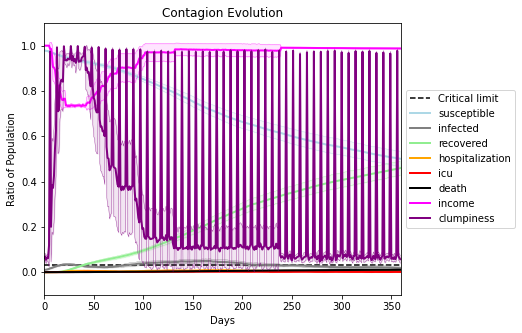

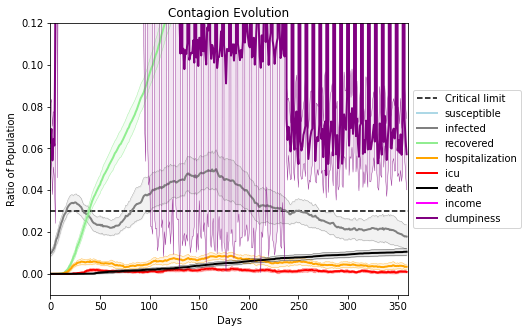

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4635, 2251, 4418, 1160, 3871, 4365, 5005, 1808, 4685, 1014, 7193, 8075, 2289, 894, 2273, 3667, 2139, 3938, 540, 9033]
Average similarity between family members is 0.9530167034007572 at temperature -0.997
Average similarity between family and home is 0.9998562470675824 at temperature -1
Average similarity between students and their classroom is 0.635055078933886 at temperature -0.997
Average classroom occupancy is 4.630769230769231 and number classrooms is 65
Average similarity between workers is 0.9200491334848021 at temperature -0.997
Average office occupancy is 3.418848167539267 and number offices is 191
Average friend similarity for adults: 0.8522373322478695 for kids: 0.7034281432635701
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6001390940954596
avg restaurant similarity 0.6254593334254868
avg restaurant similarity 0.6635618857595673
avg restaurant similarity 0.664319323674708
avg restaurant similarity 0.6254612237123507
avg restaurant similarity 0.6522728059458198
avg restaurant similarity 0.6667519627284264
avg restaurant similarity 0.6425374155904859
avg restaurant similarity 0.6552301945213608
avg restaurant similarity 0.6950339680992995
avg restaurant similarity 0.612624091883461
avg restaurant similarity 0.5849328517906434
avg restaurant similarity 0.6501074256052408
avg restaurant similarity 0.6423427462708124
avg restaurant similarity 0.636217542471764
avg restaurant similarity 0.6017192179450748
avg restaurant similarity 0.6354761171927613
avg restaurant similarity 0.6454136808739838
avg restaurant similarity 0.6284904672288459
avg restaurant similarity 0.6354731249727893
avg restaurant similarity 0.6312224817242846
avg restaurant similarity 0.5833616671751647
avg restauran

avg restaurant similarity 0.6615843351752453
avg restaurant similarity 0.6468467275112681
avg restaurant similarity 0.6610480978574991
avg restaurant similarity 0.604398185105707
avg restaurant similarity 0.6302707498961496
avg restaurant similarity 0.6453046143082494
avg restaurant similarity 0.6356057168189043
avg restaurant similarity 0.6488216763416277
avg restaurant similarity 0.5964212499384937
avg restaurant similarity 0.6245550696571093
avg restaurant similarity 0.6356429393764753
avg restaurant similarity 0.6507687904649021
avg restaurant similarity 0.6412988612962762
avg restaurant similarity 0.6378264550391217
avg restaurant similarity 0.6280798708855787
avg restaurant similarity 0.6106765802607219
avg restaurant similarity 0.6579907429374294
avg restaurant similarity 0.6260569676015089
avg restaurant similarity 0.6463708911478606
avg restaurant similarity 0.6243975436474433
avg restaurant similarity 0.6249585153840466
avg restaurant similarity 0.6104406253267936
avg restaur

avg restaurant similarity 0.5884741433722374
avg restaurant similarity 0.6267633951323479
avg restaurant similarity 0.5990513173785895
avg restaurant similarity 0.5699208004820917
avg restaurant similarity 0.6285505970641564
avg restaurant similarity 0.6127883238771543
avg restaurant similarity 0.6083313170709312
avg restaurant similarity 0.5829316652140436
avg restaurant similarity 0.5551915800802137
avg restaurant similarity 0.5522906416551139
avg restaurant similarity 0.5903941764656164
avg restaurant similarity 0.5787811571866537
avg restaurant similarity 0.6396951881104775
avg restaurant similarity 0.5528792818203563
avg restaurant similarity 0.6331895234693168
avg restaurant similarity 0.6068294578598487
avg restaurant similarity 0.6033610368089941
avg restaurant similarity 0.5708925313196521
avg restaurant similarity 0.6232039672679405
avg restaurant similarity 0.5929607384412445
avg restaurant similarity 0.5265362368574905
avg restaurant similarity 0.5997421927374211
avg restau

avg restaurant similarity 0.5878095303206006
avg restaurant similarity 0.658169015792432
avg restaurant similarity 0.6386286385753145
avg restaurant similarity 0.6558179281400301
avg restaurant similarity 0.5899339609788952
avg restaurant similarity 0.6375669277247134
avg restaurant similarity 0.5722464076777232
avg restaurant similarity 0.6386011208278779
avg restaurant similarity 0.5585535105990553
avg restaurant similarity 0.5799013795225818
avg restaurant similarity 0.6353742151296145
avg restaurant similarity 0.584818314873347
avg restaurant similarity 0.6007963067369219
avg restaurant similarity 0.6370372292680809
avg restaurant similarity 0.5907330682285228
avg restaurant similarity 0.6025031771034993
avg restaurant similarity 0.609964158922027
avg restaurant similarity 0.5802860724675252
avg restaurant similarity 0.6339632858645398
avg restaurant similarity 0.5802060820796283
avg restaurant similarity 0.6634956109337666
avg restaurant similarity 0.6192717868797748
avg restauran

avg restaurant similarity 0.6886272453219621
avg restaurant similarity 0.5925386068278595
avg restaurant similarity 0.6632645623525253
avg restaurant similarity 0.6665512694799131
avg restaurant similarity 0.681570276351545
avg restaurant similarity 0.6884840427763459
avg restaurant similarity 0.6121877889922778
avg restaurant similarity 0.623074464188917
avg restaurant similarity 0.6517439163515707
avg restaurant similarity 0.6393366656569478
avg restaurant similarity 0.6596982129511494
avg restaurant similarity 0.6487174951145572
avg restaurant similarity 0.6380752375383583
avg restaurant similarity 0.6752892642620812
avg restaurant similarity 0.620087542129405
avg restaurant similarity 0.6835372946928362
avg restaurant similarity 0.6232300454098215
avg restaurant similarity 0.6504955707037992
avg restaurant similarity 0.718447372424952
avg restaurant similarity 0.6716110523999508
avg restaurant similarity 0.6528204335789581
avg restaurant similarity 0.5782363220016103
avg restaurant

avg restaurant similarity 0.6528389506656421
avg restaurant similarity 0.6607268384624556
avg restaurant similarity 0.6738361589764075
avg restaurant similarity 0.6447486783451799
avg restaurant similarity 0.6434823668187217
avg restaurant similarity 0.6336671888975998
avg restaurant similarity 0.6238918700595703
avg restaurant similarity 0.6520651286138187
avg restaurant similarity 0.6187172054307984
avg restaurant similarity 0.5995368255378174
avg restaurant similarity 0.642853077367845
avg restaurant similarity 0.6085616877627484
avg restaurant similarity 0.62776594637433
avg restaurant similarity 0.6885397614560114
avg restaurant similarity 0.617073215939313
avg restaurant similarity 0.6389423853779218
avg restaurant similarity 0.6263126787833267
avg restaurant similarity 0.6852684558384106
avg restaurant similarity 0.7133482109457684
avg restaurant similarity 0.6523359405451783
avg restaurant similarity 0.6147001069120711
avg restaurant similarity 0.6625033338727508
avg restaurant

avg restaurant similarity 0.5969411028621109
avg restaurant similarity 0.5994182717825725
avg restaurant similarity 0.5729847946245141
avg restaurant similarity 0.629372105238236
avg restaurant similarity 0.5962138124473484
avg restaurant similarity 0.6768257730563062
avg restaurant similarity 0.6524040384879302
avg restaurant similarity 0.6822173718930366
avg restaurant similarity 0.6228726186859699
avg restaurant similarity 0.6574224106868172
avg restaurant similarity 0.5976217029783435
avg restaurant similarity 0.5859609907746892
avg restaurant similarity 0.659883698152721
avg restaurant similarity 0.631635945564748
avg restaurant similarity 0.5893952337262622
avg restaurant similarity 0.6371478230056544
avg restaurant similarity 0.6456204351201194
avg restaurant similarity 0.6280346649090486
avg restaurant similarity 0.6262111755245767
avg restaurant similarity 0.6677844069416794
avg restaurant similarity 0.598373874830796
avg restaurant similarity 0.5935091667401083
avg restaurant

avg restaurant similarity 0.6277675048800735
avg restaurant similarity 0.6219602545224693
avg restaurant similarity 0.6394762232615709
avg restaurant similarity 0.6478809424303712
avg restaurant similarity 0.6276847754234207
avg restaurant similarity 0.5859670881859395
avg restaurant similarity 0.6261337737431075
avg restaurant similarity 0.6991653109245914
avg restaurant similarity 0.6072196665506414
avg restaurant similarity 0.6234714947266069
avg restaurant similarity 0.630891224823928
avg restaurant similarity 0.6095798161060916
avg restaurant similarity 0.6720856826398967
avg restaurant similarity 0.6664150875973194
avg restaurant similarity 0.599065199031307
avg restaurant similarity 0.6421668061235078
avg restaurant similarity 0.5733665822497361
avg restaurant similarity 0.621964107962993
avg restaurant similarity 0.5893189904093399
avg restaurant similarity 0.6439812457520052
avg restaurant similarity 0.6550164007799254
avg restaurant similarity 0.6423718645199173
avg restauran

avg restaurant similarity 0.5834173316950414
avg restaurant similarity 0.6410245374110822
avg restaurant similarity 0.6114919054819472
avg restaurant similarity 0.5652071807530001
avg restaurant similarity 0.6251359533026563
avg restaurant similarity 0.5622871165068596
avg restaurant similarity 0.5667022132691097
avg restaurant similarity 0.6323354314486783
avg restaurant similarity 0.64781548520851
avg restaurant similarity 0.6112749831403692
avg restaurant similarity 0.6201698418859249
avg restaurant similarity 0.6435744625886923
avg restaurant similarity 0.6371897312646373
avg restaurant similarity 0.6146591615942828
avg restaurant similarity 0.6291475987383466
avg restaurant similarity 0.6659988775379421
avg restaurant similarity 0.6348286702273204
avg restaurant similarity 0.6401824094878873
avg restaurant similarity 0.6325317431786661
avg restaurant similarity 0.6217913688993978
avg restaurant similarity 0.6007342952244511
avg restaurant similarity 0.6305957440392779
avg restaura

avg restaurant similarity 0.5885920961098883
avg restaurant similarity 0.6359880459442526
avg restaurant similarity 0.6263601320578548
avg restaurant similarity 0.6417954146552775
avg restaurant similarity 0.5853123395329752
avg restaurant similarity 0.5744584563839454
avg restaurant similarity 0.5966140499643788
avg restaurant similarity 0.6271350332798601
avg restaurant similarity 0.6180467311088622
avg restaurant similarity 0.6127105457966096
avg restaurant similarity 0.5473002251888403
avg restaurant similarity 0.6190119731084144
avg restaurant similarity 0.6021098223272345
avg restaurant similarity 0.6223861607300961
avg restaurant similarity 0.6267011083900049
avg restaurant similarity 0.5934469015569748
avg restaurant similarity 0.6302538489255185
avg restaurant similarity 0.5490003435202476
avg restaurant similarity 0.6203659472304903
avg restaurant similarity 0.5729790724623565
avg restaurant similarity 0.5616629177048816
avg restaurant similarity 0.6176273762505324
avg restau

avg restaurant similarity 0.5762157871821655
avg restaurant similarity 0.6203343462724957
avg restaurant similarity 0.6197575866971093
avg restaurant similarity 0.5761061660546779
avg restaurant similarity 0.5769699968325717
avg restaurant similarity 0.6230483917588883
avg restaurant similarity 0.5915285392576907
avg restaurant similarity 0.5770048292778545
avg restaurant similarity 0.6259207235853098
avg restaurant similarity 0.5790179352031054
avg restaurant similarity 0.6499887509426915
avg restaurant similarity 0.6277668819482866
avg restaurant similarity 0.5977847518649614
avg restaurant similarity 0.6185906674294028
avg restaurant similarity 0.6042996302656661
avg restaurant similarity 0.6262043890044591
avg restaurant similarity 0.581376612823937
avg restaurant similarity 0.6105069966844048
avg restaurant similarity 0.5733411363489724
avg restaurant similarity 0.5846094481284508
avg restaurant similarity 0.5822748623540576
avg restaurant similarity 0.5840356796112323
avg restaur

avg restaurant similarity 0.6286828256639436
avg restaurant similarity 0.5382575449992609
avg restaurant similarity 0.6048306107555556
avg restaurant similarity 0.5875122735023972
avg restaurant similarity 0.5907869889841
avg restaurant similarity 0.6357257089589572
avg restaurant similarity 0.5999095680079636
avg restaurant similarity 0.6011346821961455
avg restaurant similarity 0.6195047574183306
avg restaurant similarity 0.6716256386172392
avg restaurant similarity 0.6267721938626277
avg restaurant similarity 0.5877906685194062
avg restaurant similarity 0.6253401108746975
avg restaurant similarity 0.6339364206369336
avg restaurant similarity 0.5979932471115079
avg restaurant similarity 0.6195432623521161
avg restaurant similarity 0.6349609236291578
avg restaurant similarity 0.5619640789988131
avg restaurant similarity 0.6051223711094801
avg restaurant similarity 0.6329283306977798
avg restaurant similarity 0.5964755076735362
avg restaurant similarity 0.6022244889797448
avg restauran

avg restaurant similarity 0.6807477656676898
avg restaurant similarity 0.6608952915780338
avg restaurant similarity 0.6468914737391654
avg restaurant similarity 0.618404988204294
avg restaurant similarity 0.6259683661942717
avg restaurant similarity 0.606704532108618
avg restaurant similarity 0.6109668457221883
avg restaurant similarity 0.646490442829144
avg restaurant similarity 0.6357484969156533
avg restaurant similarity 0.6112088248132663
avg restaurant similarity 0.5943799830783915
avg restaurant similarity 0.6534921906121319
avg restaurant similarity 0.6594171350665746
avg restaurant similarity 0.5751477908968102
avg restaurant similarity 0.6221949540738434
avg restaurant similarity 0.643532686257966
avg restaurant similarity 0.5772897507134233
avg restaurant similarity 0.6277231090410815
avg restaurant similarity 0.6170661923595463
avg restaurant similarity 0.6360693276584338
avg restaurant similarity 0.6698423072068317
avg restaurant similarity 0.6502344426767844
avg restaurant

avg restaurant similarity 0.5841582381951134
avg restaurant similarity 0.5700644040465169
avg restaurant similarity 0.6245371006053105
avg restaurant similarity 0.6218582133098529
avg restaurant similarity 0.6763645699334174
avg restaurant similarity 0.5868205462818243
avg restaurant similarity 0.6237980378365457
avg restaurant similarity 0.6543398407417642
avg restaurant similarity 0.6357461705875633
avg restaurant similarity 0.6090675028490238
avg restaurant similarity 0.5940800824317897
avg restaurant similarity 0.6154390445899229
avg restaurant similarity 0.5949284922549791
avg restaurant similarity 0.5684379718043531
avg restaurant similarity 0.5998254556526937
avg restaurant similarity 0.6134810065376263
avg restaurant similarity 0.5813274965723868
avg restaurant similarity 0.6142358144486495
avg restaurant similarity 0.6062553648814517
avg restaurant similarity 0.6169743203805705
avg restaurant similarity 0.6552319182173989
avg restaurant similarity 0.6487323200485481
avg restau

avg restaurant similarity 0.5984226590358761
avg restaurant similarity 0.6180488455528026
avg restaurant similarity 0.6178465804374946
avg restaurant similarity 0.6217558391068196
avg restaurant similarity 0.632353518845377
avg restaurant similarity 0.6329358005474168
avg restaurant similarity 0.641490728324842
avg restaurant similarity 0.6160992275598504
avg restaurant similarity 0.5974712593582541
avg restaurant similarity 0.6157467466495736
avg restaurant similarity 0.6010733724747314
avg restaurant similarity 0.599097285850662
avg restaurant similarity 0.564154535066798
avg restaurant similarity 0.5638608892242319
avg restaurant similarity 0.6326520404863685
avg restaurant similarity 0.5835589936462223
avg restaurant similarity 0.6296748798464605
avg restaurant similarity 0.6234764151431139
avg restaurant similarity 0.6348564065214498
avg restaurant similarity 0.6492161666515343
avg restaurant similarity 0.6304760354873207
avg restaurant similarity 0.6353653852594852
avg restaurant

avg restaurant similarity 0.6422604823536925
avg restaurant similarity 0.6516617290188265
avg restaurant similarity 0.6072699304345932
avg restaurant similarity 0.6235150431436095
avg restaurant similarity 0.5831146675999629
avg restaurant similarity 0.6021249981742816
avg restaurant similarity 0.6420679515937362
avg restaurant similarity 0.6115257707001852
avg restaurant similarity 0.6299998528567949
avg restaurant similarity 0.6126469091981613
avg restaurant similarity 0.6218124109541842
avg restaurant similarity 0.6226682961160399
avg restaurant similarity 0.617150586513474
avg restaurant similarity 0.5915978177796082
avg restaurant similarity 0.6122895622375927
avg restaurant similarity 0.6407432761414403
avg restaurant similarity 0.6008006930727833
avg restaurant similarity 0.6281207987849782
avg restaurant similarity 0.6471291069532533
avg restaurant similarity 0.6087106671296393
avg restaurant similarity 0.60638555630895
avg restaurant similarity 0.6204081519596467
avg restauran

avg restaurant similarity 0.5868905278954136
avg restaurant similarity 0.6317700850121516
avg restaurant similarity 0.6154134759804507
avg restaurant similarity 0.5994014543776015
avg restaurant similarity 0.6329369750152938
avg restaurant similarity 0.6636127148847383
avg restaurant similarity 0.6131482365837052
avg restaurant similarity 0.5849895325444736
avg restaurant similarity 0.6579593085057036
avg restaurant similarity 0.6273564594454457
avg restaurant similarity 0.6261451731232739
avg restaurant similarity 0.6666842115216971
avg restaurant similarity 0.6176173744955645
avg restaurant similarity 0.6158391454431333
avg restaurant similarity 0.6546988816997367
avg restaurant similarity 0.6386241225013967
avg restaurant similarity 0.6296984598457056
avg restaurant similarity 0.7106172408652555
avg restaurant similarity 0.6467412732526487
avg restaurant similarity 0.6071298206929919
avg restaurant similarity 0.6146102667130491
avg restaurant similarity 0.5853830333216421
avg restau

avg restaurant similarity 0.6440103453182815
avg restaurant similarity 0.6317514769996961
avg restaurant similarity 0.5935121347702409
avg restaurant similarity 0.6507906937505777
avg restaurant similarity 0.6091693644449221
avg restaurant similarity 0.6317173207218103
avg restaurant similarity 0.5652293053600225
avg restaurant similarity 0.6394799989290898
avg restaurant similarity 0.6226986257068047
avg restaurant similarity 0.6351655736727725
avg restaurant similarity 0.6767861811085303
avg restaurant similarity 0.6515993080723295
avg restaurant similarity 0.579475721695804
avg restaurant similarity 0.5987823420257976
avg restaurant similarity 0.6477225712528759
avg restaurant similarity 0.6240479708660801
avg restaurant similarity 0.6117086118792908
avg restaurant similarity 0.6122422286393407
avg restaurant similarity 0.6073069273331212
avg restaurant similarity 0.6528325109737204
avg restaurant similarity 0.6043280686632423
avg restaurant similarity 0.6417069774038506
avg restaur

avg restaurant similarity 0.668109859701991
avg restaurant similarity 0.6224064421363307
avg restaurant similarity 0.6679713912934986
avg restaurant similarity 0.6088287366261509
avg restaurant similarity 0.6342841595961106
avg restaurant similarity 0.6369261129918887
avg restaurant similarity 0.6055856903806169
avg restaurant similarity 0.6373968210060896
avg restaurant similarity 0.6542913571123002
avg restaurant similarity 0.6371007337355884
avg restaurant similarity 0.6125146777063779
avg restaurant similarity 0.6391191165573245
avg restaurant similarity 0.6315332047666142
avg restaurant similarity 0.6752777468926284
avg restaurant similarity 0.6324815555226881
avg restaurant similarity 0.644909343529576
avg restaurant similarity 0.650668687872459
avg restaurant similarity 0.6369797858050897
avg restaurant similarity 0.6209779215136861
avg restaurant similarity 0.6519058826027532
avg restaurant similarity 0.6383139524769076
avg restaurant similarity 0.6861568052516749
avg restauran

avg restaurant similarity 0.6768491832704887
avg restaurant similarity 0.6173373825817386
avg restaurant similarity 0.6265364246421435
avg restaurant similarity 0.6433845345445145
avg restaurant similarity 0.6351746831241568
avg restaurant similarity 0.6325868641600982
avg restaurant similarity 0.6335650354620257
avg restaurant similarity 0.6566456187746946
avg restaurant similarity 0.6224590590839468
avg restaurant similarity 0.6717730027772367
avg restaurant similarity 0.592492472480135
avg restaurant similarity 0.62831914778077
avg restaurant similarity 0.5732338284862658
avg restaurant similarity 0.6346523198966437
avg restaurant similarity 0.6332967049097957
avg restaurant similarity 0.6042040685495307
avg restaurant similarity 0.6187007053085465
avg restaurant similarity 0.6179806764369818
avg restaurant similarity 0.6451353914158089
avg restaurant similarity 0.620549514044328
avg restaurant similarity 0.6165638397062505
avg restaurant similarity 0.6347513946049979
avg restaurant

avg restaurant similarity 0.6201484451947553
avg restaurant similarity 0.6796625045402118
avg restaurant similarity 0.5837313039876599
avg restaurant similarity 0.6366685293490867
avg restaurant similarity 0.6143593368915483
avg restaurant similarity 0.6426224420190239
avg restaurant similarity 0.673704271764987
avg restaurant similarity 0.66061040580551
avg restaurant similarity 0.705928455914161
avg restaurant similarity 0.6537580767251728
avg restaurant similarity 0.6526814494626927
avg restaurant similarity 0.5833724098675384
avg restaurant similarity 0.6373040653924542
avg restaurant similarity 0.7004632411736292
avg restaurant similarity 0.6074509572992096
avg restaurant similarity 0.708026054644171
avg restaurant similarity 0.6041043320513232
avg restaurant similarity 0.6276878359709311
avg restaurant similarity 0.6309141021363239
avg restaurant similarity 0.6698294147017693
avg restaurant similarity 0.6454004201499234
avg restaurant similarity 0.666180733676574
avg restaurant s

avg restaurant similarity 0.6507743508227745
avg restaurant similarity 0.6347981104359955
avg restaurant similarity 0.6923020363956427
avg restaurant similarity 0.5893809981129495
avg restaurant similarity 0.6762184394411414
avg restaurant similarity 0.6209426913904483
avg restaurant similarity 0.648136225149007
avg restaurant similarity 0.6682536072703875
avg restaurant similarity 0.5810887200332239
avg restaurant similarity 0.615081849513022
avg restaurant similarity 0.6488823162358598
avg restaurant similarity 0.6477302607207344
avg restaurant similarity 0.652084598266905
avg restaurant similarity 0.6409066040260871
avg restaurant similarity 0.6264304626448319
avg restaurant similarity 0.6618749514993085
avg restaurant similarity 0.6130008192986025
avg restaurant similarity 0.6781039467212746
avg restaurant similarity 0.6246785845136706
avg restaurant similarity 0.6915214130521643
avg restaurant similarity 0.6259315796899213
avg restaurant similarity 0.5761687337720554
avg restauran

avg restaurant similarity 0.6440690046670379
avg restaurant similarity 0.5804580503648153
avg restaurant similarity 0.6224816145887697
avg restaurant similarity 0.592260732000252
avg restaurant similarity 0.6040623747092373
avg restaurant similarity 0.6241542197938127
avg restaurant similarity 0.5573931618884609
avg restaurant similarity 0.6032551131025242
avg restaurant similarity 0.6589775371859697
avg restaurant similarity 0.6079421864249099
avg restaurant similarity 0.6048127010844098
avg restaurant similarity 0.6288606163026497
avg restaurant similarity 0.633207921280704
avg restaurant similarity 0.5856467640817509
avg restaurant similarity 0.5976528556907434
avg restaurant similarity 0.6024098209565564
avg restaurant similarity 0.6478062975793258
avg restaurant similarity 0.6726564500188064
avg restaurant similarity 0.622496526900353
avg restaurant similarity 0.5927802074730885
avg restaurant similarity 0.6464817971457878
avg restaurant similarity 0.6111573250646711
avg restauran

avg restaurant similarity 0.5871259890038567
avg restaurant similarity 0.6000867371810378
avg restaurant similarity 0.5992596962989079
avg restaurant similarity 0.6315828956816063
avg restaurant similarity 0.5685548541594337
avg restaurant similarity 0.6541765253525824
avg restaurant similarity 0.677963381451252
avg restaurant similarity 0.6243761532159647
avg restaurant similarity 0.6366247917185127
avg restaurant similarity 0.6432345378411588
avg restaurant similarity 0.6294551985583645
avg restaurant similarity 0.6105554094663589
avg restaurant similarity 0.5838735183383741
avg restaurant similarity 0.6501642599982943
avg restaurant similarity 0.6066486970233055
avg restaurant similarity 0.579167617897877
avg restaurant similarity 0.5945643848236585
avg restaurant similarity 0.5952783257115838
avg restaurant similarity 0.5951858404099396
avg restaurant similarity 0.5995942924910802
avg restaurant similarity 0.6006782333699633
avg restaurant similarity 0.6268177734038636
avg restaura

avg restaurant similarity 0.5804411313188752
avg restaurant similarity 0.677410330128988
avg restaurant similarity 0.6921431091714775
avg restaurant similarity 0.6357604350216309
avg restaurant similarity 0.6501433323022657
avg restaurant similarity 0.6722083596550221
avg restaurant similarity 0.64977215195626
avg restaurant similarity 0.6302330736851622
avg restaurant similarity 0.6225644271520769
avg restaurant similarity 0.623826015782431
avg restaurant similarity 0.6320953463114524
avg restaurant similarity 0.6428372570616878
avg restaurant similarity 0.6646045335473575
avg restaurant similarity 0.6093439972438195
avg restaurant similarity 0.6238891260038463
avg restaurant similarity 0.6335052202878753
avg restaurant similarity 0.6552283441075961
avg restaurant similarity 0.6680916201697517
avg restaurant similarity 0.6373636237366981
avg restaurant similarity 0.6394745631934908
avg restaurant similarity 0.643052049396381
avg restaurant similarity 0.6213945589565776
avg restaurant 

avg restaurant similarity 0.639486838333759
avg restaurant similarity 0.662529720197129
avg restaurant similarity 0.6933756547420231
avg restaurant similarity 0.6553888203708959
avg restaurant similarity 0.6088184029487255
avg restaurant similarity 0.6544791786295111
avg restaurant similarity 0.6467069043214166
avg restaurant similarity 0.592172507551891
avg restaurant similarity 0.6269797434295251
avg restaurant similarity 0.6363923675342346
avg restaurant similarity 0.6705324490583836
avg restaurant similarity 0.6108078008983051
avg restaurant similarity 0.6458747327890884
avg restaurant similarity 0.618566369326318
avg restaurant similarity 0.666421808390596
avg restaurant similarity 0.6753891882541605
avg restaurant similarity 0.6198834764115249
avg restaurant similarity 0.6492088767941231
avg restaurant similarity 0.5713602756211483
avg restaurant similarity 0.6546189344223501
avg restaurant similarity 0.611703315090125
avg restaurant similarity 0.5824303590792428
avg restaurant s

avg restaurant similarity 0.5733546879413465
avg restaurant similarity 0.5877018965133856
avg restaurant similarity 0.596030859801183
avg restaurant similarity 0.5543440711146708
avg restaurant similarity 0.6233112685202138
avg restaurant similarity 0.6648747347455211
avg restaurant similarity 0.6417759120485599
avg restaurant similarity 0.5686933265943321
avg restaurant similarity 0.5828506606283381
avg restaurant similarity 0.587861745894982
avg restaurant similarity 0.5991277656025342
avg restaurant similarity 0.6068143169614836
avg restaurant similarity 0.6295307972822926
avg restaurant similarity 0.6078693891729681
avg restaurant similarity 0.618288149954699
avg restaurant similarity 0.6342279596591471
avg restaurant similarity 0.6377662739795995
avg restaurant similarity 0.633543823895354
avg restaurant similarity 0.5968173643382921
avg restaurant similarity 0.6191523504178482
avg restaurant similarity 0.5912781609219432
avg restaurant similarity 0.6134559937021657
avg restaurant

avg restaurant similarity 0.6294443474771064
avg restaurant similarity 0.5508465856719673
avg restaurant similarity 0.6570858999773924
avg restaurant similarity 0.5812131345195104
avg restaurant similarity 0.6175456243928205
avg restaurant similarity 0.5668982008586161
avg restaurant similarity 0.6099973349874962
avg restaurant similarity 0.5390230779434488
avg restaurant similarity 0.6632537870334471
avg restaurant similarity 0.6115991157136162
avg restaurant similarity 0.5877785413611206
avg restaurant similarity 0.5918006082422008
avg restaurant similarity 0.6167102250994271
avg restaurant similarity 0.5776090297418037
avg restaurant similarity 0.6253326830917734
avg restaurant similarity 0.640978104283961
avg restaurant similarity 0.6053321274320825
avg restaurant similarity 0.6194252830739794
avg restaurant similarity 0.6150097645212061
avg restaurant similarity 0.5941467139563169
avg restaurant similarity 0.6206633483854276
avg restaurant similarity 0.5808306218428528
avg restaur

avg restaurant similarity 0.6141848589553798
avg restaurant similarity 0.6741061341114793
avg restaurant similarity 0.5938111166103771
avg restaurant similarity 0.6130741800723041
avg restaurant similarity 0.6148844647482778
avg restaurant similarity 0.6830659179781441
avg restaurant similarity 0.6520902113009515
avg restaurant similarity 0.6325700965330764
avg restaurant similarity 0.5636610453703376
avg restaurant similarity 0.6363286836000658
avg restaurant similarity 0.6130869260416755
avg restaurant similarity 0.6201332652465245
avg restaurant similarity 0.6625607586162361
avg restaurant similarity 0.6098478098908304
avg restaurant similarity 0.6048509564355931
avg restaurant similarity 0.6748828294188242
avg restaurant similarity 0.6271224554112752
avg restaurant similarity 0.6012277325113533
avg restaurant similarity 0.6133860627572333
avg restaurant similarity 0.6478761695913181
avg restaurant similarity 0.5915352524511672
avg restaurant similarity 0.5654847266654635
avg restau

avg restaurant similarity 0.6001984386336747
avg restaurant similarity 0.6758767184416852
avg restaurant similarity 0.6626219362742531
avg restaurant similarity 0.6420406658138973
avg restaurant similarity 0.610135200044404
avg restaurant similarity 0.5925131367032739
avg restaurant similarity 0.6070583795683063
avg restaurant similarity 0.6462018493206139
avg restaurant similarity 0.6031624753101539
avg restaurant similarity 0.6878435818603467
avg restaurant similarity 0.6654627666120227
avg restaurant similarity 0.6126240808394436
avg restaurant similarity 0.6572081403706055
avg restaurant similarity 0.6218536620624593
avg restaurant similarity 0.6109340861026131
avg restaurant similarity 0.6788563931718367
avg restaurant similarity 0.610419222098784
avg restaurant similarity 0.6198813189951826
avg restaurant similarity 0.6328502149827734
avg restaurant similarity 0.6091989869757279
avg restaurant similarity 0.6238323036715787
avg restaurant similarity 0.6232010521909015
avg restaura

avg restaurant similarity 0.5725356614712975
avg restaurant similarity 0.4595269534737909
avg restaurant similarity 0.6711515124448988
avg restaurant similarity 0.5960958024000899
avg restaurant similarity 0.5992147406973914
avg restaurant similarity 0.7655216887116126
avg restaurant similarity 0.7266653748944929
avg restaurant similarity 0.6421527110842162
avg restaurant similarity 0.6056423348249442
avg restaurant similarity 0.6277866192447339
avg restaurant similarity 0.5262543714907045
avg restaurant similarity 0.520717203825349
avg restaurant similarity 0.5964270048578054
avg restaurant similarity 0.6485004638878087
avg restaurant similarity 0.6275228429420754
avg restaurant similarity 0.5964137565667157
avg restaurant similarity 0.6290923478202175
avg restaurant similarity 0.5744351964317415
avg restaurant similarity 0.5656604672481516
avg restaurant similarity 0.6213241750412835
avg restaurant similarity 0.5226648502557529
avg restaurant similarity 0.6325027686524751
avg restaur

avg restaurant similarity 0.5576848544697341
avg restaurant similarity 0.6072568647377328
avg restaurant similarity 0.5300209666310648
avg restaurant similarity 0.6587274195132132
avg restaurant similarity 0.581788852200375
avg restaurant similarity 0.5910376310631814
avg restaurant similarity 0.582996358407786
avg restaurant similarity 0.6295876490496143
avg restaurant similarity 0.7244023008387785
avg restaurant similarity 0.5644397484576136
avg restaurant similarity 0.5865125270743237
avg restaurant similarity 0.6438237916570765
avg restaurant similarity 0.6117384660234334
avg restaurant similarity 0.6166486946217595
avg restaurant similarity 0.613359710070308
avg restaurant similarity 0.5594572587071432
avg restaurant similarity 0.5326039529273274
avg restaurant similarity 0.6143839310802764
avg restaurant similarity 0.5430531921480773
avg restaurant similarity 0.6074881814972753
avg restaurant similarity 0.4938526305331706
avg restaurant similarity 0.6132337500846222
avg restauran

avg restaurant similarity 0.6403220312909185
avg restaurant similarity 0.5930358474770421
avg restaurant similarity 0.6204258757231972
avg restaurant similarity 0.6616764834508182
avg restaurant similarity 0.6114279935800846
avg restaurant similarity 0.6258567998643473
avg restaurant similarity 0.582182821921186
avg restaurant similarity 0.6186169199603062
avg restaurant similarity 0.603818635511325
avg restaurant similarity 0.5686037209297957
avg restaurant similarity 0.6010128490549672
avg restaurant similarity 0.6184370631729351
avg restaurant similarity 0.6693487380271166
avg restaurant similarity 0.6104109551886775
avg restaurant similarity 0.5834424350529464
avg restaurant similarity 0.6214912379874256
avg restaurant similarity 0.593750895822668
avg restaurant similarity 0.5988972648678266
avg restaurant similarity 0.6044341499681115
avg restaurant similarity 0.6316547674620638
avg restaurant similarity 0.5706465989249482
avg restaurant similarity 0.6242888473074207
avg restauran

avg restaurant similarity 0.6085659804327757
avg restaurant similarity 0.6151185522703433
avg restaurant similarity 0.5972780657844251
avg restaurant similarity 0.6137089071194652
avg restaurant similarity 0.5905755835719863
avg restaurant similarity 0.6222945201602612
avg restaurant similarity 0.6703205787724571
avg restaurant similarity 0.6311359359134845
avg restaurant similarity 0.6005450506101602
avg restaurant similarity 0.63618996349017
avg restaurant similarity 0.6272868813563769
avg restaurant similarity 0.6914951954447842
avg restaurant similarity 0.5687060096857378
avg restaurant similarity 0.6271221837272206
avg restaurant similarity 0.6120863696889141
avg restaurant similarity 0.6101940128547946
avg restaurant similarity 0.6045993640866616
avg restaurant similarity 0.616981240020571
avg restaurant similarity 0.6057810863578154
avg restaurant similarity 0.5837657457407825
avg restaurant similarity 0.6290270573233269
avg restaurant similarity 0.636374462252613
avg restaurant

avg restaurant similarity 0.5964965221058641
avg restaurant similarity 0.6033437713179919
avg restaurant similarity 0.6045709175450803
avg restaurant similarity 0.6820642406616839
avg restaurant similarity 0.6269842369996058
avg restaurant similarity 0.6335789244976334
avg restaurant similarity 0.6045307013746906
avg restaurant similarity 0.6910109601898001
avg restaurant similarity 0.5959688947153408
avg restaurant similarity 0.6240215784824149
avg restaurant similarity 0.6725926747268984
avg restaurant similarity 0.5979056529012643
avg restaurant similarity 0.6459357684694194
avg restaurant similarity 0.6359854322681364
avg restaurant similarity 0.6056581487189423
avg restaurant similarity 0.62572206576681
avg restaurant similarity 0.6191171180854216
avg restaurant similarity 0.6317252155246116
avg restaurant similarity 0.6407483491322061
avg restaurant similarity 0.6416409008384464
avg restaurant similarity 0.577210995441641
avg restaurant similarity 0.6062059755164676
avg restauran

avg restaurant similarity 0.6378963601365287
avg restaurant similarity 0.6689132481091762
avg restaurant similarity 0.6322664655553123
avg restaurant similarity 0.6459024936028778
avg restaurant similarity 0.6317483978428634
avg restaurant similarity 0.627388961704121
avg restaurant similarity 0.6742083620557385
avg restaurant similarity 0.6248977728661039
avg restaurant similarity 0.632986492879074
avg restaurant similarity 0.5975295674738113
avg restaurant similarity 0.6046384632380155
avg restaurant similarity 0.5863786783645604
avg restaurant similarity 0.6300783625999807
avg restaurant similarity 0.5783501228646529
avg restaurant similarity 0.6188352795225694
avg restaurant similarity 0.5997015735732515
avg restaurant similarity 0.5808721738187187
avg restaurant similarity 0.6074246482750069
avg restaurant similarity 0.6270553179944244
avg restaurant similarity 0.607041601238918
avg restaurant similarity 0.6600382293536893
avg restaurant similarity 0.6406039363837492
avg restauran

avg restaurant similarity 0.6462446957735221
avg restaurant similarity 0.5973783083063399
avg restaurant similarity 0.5852658642544467
avg restaurant similarity 0.5756142843414401
avg restaurant similarity 0.6044866456573308
avg restaurant similarity 0.6154944000551038
avg restaurant similarity 0.5998214137815325
avg restaurant similarity 0.6526183408032679
avg restaurant similarity 0.6698468587452538
avg restaurant similarity 0.5496940057736482
avg restaurant similarity 0.5962699740815217
avg restaurant similarity 0.6528054738043476
avg restaurant similarity 0.579378341238991
avg restaurant similarity 0.6246814978080582
avg restaurant similarity 0.6419056072768858
avg restaurant similarity 0.6392719084571827
avg restaurant similarity 0.5671395292562788
avg restaurant similarity 0.6322869073615428
avg restaurant similarity 0.6600902455935254
avg restaurant similarity 0.6154731183980366
avg restaurant similarity 0.5982188429550573
avg restaurant similarity 0.5521172234458119
avg restaur

avg restaurant similarity 0.6289667521149682
avg restaurant similarity 0.5946590026009169
avg restaurant similarity 0.6026948433489403
avg restaurant similarity 0.5998956453535185
avg restaurant similarity 0.6479486380215427
avg restaurant similarity 0.5870294655304447
avg restaurant similarity 0.5785732471307431
avg restaurant similarity 0.6291556451319862
avg restaurant similarity 0.6478069979021337
avg restaurant similarity 0.5784701010170586
avg restaurant similarity 0.5914016102457107
avg restaurant similarity 0.6351868046392374
avg restaurant similarity 0.5935740380529732
avg restaurant similarity 0.616973723435756
avg restaurant similarity 0.6727853402611509
avg restaurant similarity 0.5764348218199058
avg restaurant similarity 0.6353390560009864
avg restaurant similarity 0.5942529870398271
avg restaurant similarity 0.65172521456139
avg restaurant similarity 0.6094129104410448
avg restaurant similarity 0.6306684108267142
avg restaurant similarity 0.551114578479917
avg restaurant

avg restaurant similarity 0.623203044179063
avg restaurant similarity 0.6166652351733672
avg restaurant similarity 0.6559233057117135
avg restaurant similarity 0.5667552660309533
avg restaurant similarity 0.5773429125826963
avg restaurant similarity 0.5806902499000725
avg restaurant similarity 0.6504757956641193
avg restaurant similarity 0.625010092322721
avg restaurant similarity 0.6828715576419663
avg restaurant similarity 0.6073029047588896
avg restaurant similarity 0.5973881400413967
avg restaurant similarity 0.5926586093345622
avg restaurant similarity 0.6134702497515939
avg restaurant similarity 0.5874270182715314
avg restaurant similarity 0.5886588743256409
avg restaurant similarity 0.5997380276624412
avg restaurant similarity 0.6310253690664347
avg restaurant similarity 0.663701646180574
avg restaurant similarity 0.5882242679065292
avg restaurant similarity 0.6182269876677711
avg restaurant similarity 0.6079587927989079
avg restaurant similarity 0.6298518278450177
avg restauran

avg restaurant similarity 0.6522592426579334
avg restaurant similarity 0.584416233415948
avg restaurant similarity 0.6431656808802607
avg restaurant similarity 0.640120191483426
avg restaurant similarity 0.6369520787427886
avg restaurant similarity 0.6388855510791348
avg restaurant similarity 0.6374776225450293
avg restaurant similarity 0.6251879934260467
avg restaurant similarity 0.6523880991876948
avg restaurant similarity 0.6590991236769048
avg restaurant similarity 0.582615257349623
avg restaurant similarity 0.6645620934166643
avg restaurant similarity 0.5929788305808233
avg restaurant similarity 0.6503930084328216
avg restaurant similarity 0.5974624045831809
avg restaurant similarity 0.6671204179964527
avg restaurant similarity 0.6087249575788308
avg restaurant similarity 0.6862039366789164
avg restaurant similarity 0.5404760772479599
avg restaurant similarity 0.641984164030977
avg restaurant similarity 0.6500607437664249
avg restaurant similarity 0.6213284648390518
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

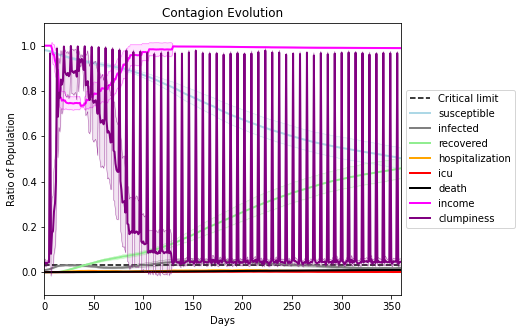

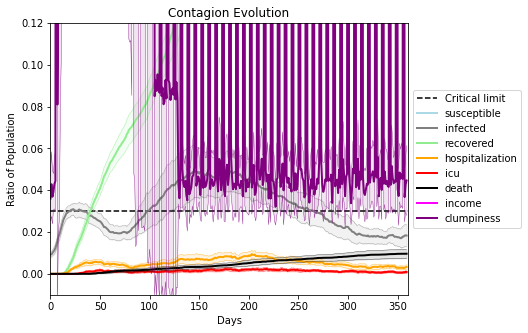

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6009, 8737, 6320, 173, 8191, 85, 4965, 2703, 523, 3027, 2847, 2078, 9235, 538, 496, 5625, 4819, 9382, 9881, 4813]
Average similarity between family members is 0.9540056122185094 at temperature -0.996
Average similarity between family and home is 0.9998531959011104 at temperature -1
Average similarity between students and their classroom is 0.6388312327635775 at temperature -0.996
Average classroom occupancy is 4.358208955223881 and number classrooms is 67
Average similarity between workers is 0.9413642561495659 at temperature -0.996
Average office occupancy is 3.4583333333333335 and number offices is 192
Average friend similarity for adults: 0.8644198430289649 for kids: 0.7105931294744905
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.6252120011012953
avg restaurant similarity 0.6323344073443443
avg restaurant similarity 0.6152375455578409
avg restaurant similarity 0.6136058097493711
avg restaurant similarity 0.5253748625523507
avg restaurant similarity 0.5909627058702841
avg restaurant similarity 0.5955517250950413
avg restaurant similarity 0.6424241733086372
avg restaurant similarity 0.6328821683031041
avg restaurant similarity 0.6425051970653516
avg restaurant similarity 0.6012629524229682
avg restaurant similarity 0.6023433791674594
avg restaurant similarity 0.5991509233847528
avg restaurant similarity 0.6113008991517865
avg restaurant similarity 0.6131043255344465
avg restaurant similarity 0.6227563701531668
avg restaurant similarity 0.612761233697034
avg restaurant similarity 0.5960733018830142
avg restaurant similarity 0.6897290845596942
avg restaurant similarity 0.591506267352693
avg restaurant similarity 0.6131811106028856
avg restaurant similarity 0.6198479559677741
avg restaura

avg restaurant similarity 0.6266084918852247
avg restaurant similarity 0.6582932080262548
avg restaurant similarity 0.5798387403768355
avg restaurant similarity 0.619682910737418
avg restaurant similarity 0.6495027703069898
avg restaurant similarity 0.6479336859888666
avg restaurant similarity 0.6450166812258589
avg restaurant similarity 0.6451296631400845
avg restaurant similarity 0.6358504708599616
avg restaurant similarity 0.6512145728188197
avg restaurant similarity 0.5970406831870345
avg restaurant similarity 0.6435556352697849
avg restaurant similarity 0.5923240055181079
avg restaurant similarity 0.5893314517602571
avg restaurant similarity 0.5853758608312467
avg restaurant similarity 0.5997034274693593
avg restaurant similarity 0.632589027342107
avg restaurant similarity 0.5741925611384612
avg restaurant similarity 0.6314192646184195
avg restaurant similarity 0.6204976368116069
avg restaurant similarity 0.5921163361811697
avg restaurant similarity 0.5876998747181691
avg restaura

avg restaurant similarity 0.6279795492591036
avg restaurant similarity 0.5924716267747218
avg restaurant similarity 0.6437998903669508
avg restaurant similarity 0.5838355374042129
avg restaurant similarity 0.687028503604296
avg restaurant similarity 0.5919012628615042
avg restaurant similarity 0.5896568320262576
avg restaurant similarity 0.650257147621878
avg restaurant similarity 0.634592071140924
avg restaurant similarity 0.6467488582623739
avg restaurant similarity 0.6364444903220728
avg restaurant similarity 0.5866893729076315
avg restaurant similarity 0.5523123690044223
avg restaurant similarity 0.5732607852712979
avg restaurant similarity 0.6035085128268804
avg restaurant similarity 0.6464860512958871
avg restaurant similarity 0.6073960360011716
avg restaurant similarity 0.6201720181104154
avg restaurant similarity 0.6565051185318814
avg restaurant similarity 0.6194708843406747
avg restaurant similarity 0.5984876385457725
avg restaurant similarity 0.6217590767817813
avg restauran

avg restaurant similarity 0.6048212429226806
avg restaurant similarity 0.6051814092617336
avg restaurant similarity 0.6273989699519592
avg restaurant similarity 0.638705171642747
avg restaurant similarity 0.6429256907700097
avg restaurant similarity 0.6259382183675551
avg restaurant similarity 0.6191006948870135
avg restaurant similarity 0.6161423658342159
avg restaurant similarity 0.5794492650805053
avg restaurant similarity 0.6068036318130845
avg restaurant similarity 0.6160426363635502
avg restaurant similarity 0.6468736224547361
avg restaurant similarity 0.6341265619373547
avg restaurant similarity 0.6437950590660914
avg restaurant similarity 0.6290742711525985
avg restaurant similarity 0.5868252559580598
avg restaurant similarity 0.636938077746611
avg restaurant similarity 0.6826358030957826
avg restaurant similarity 0.6351808058731919
avg restaurant similarity 0.6245440746052602
avg restaurant similarity 0.5318827405637371
avg restaurant similarity 0.6259734395543739
avg restaura

avg restaurant similarity 0.634048832134086
avg restaurant similarity 0.5985572687445749
avg restaurant similarity 0.5740100625928959
avg restaurant similarity 0.6393651929121191
avg restaurant similarity 0.6265505905268647
avg restaurant similarity 0.5887168716651262
avg restaurant similarity 0.5392520259930124
avg restaurant similarity 0.6365377304904684
avg restaurant similarity 0.6515305759351059
avg restaurant similarity 0.5939877203818862
avg restaurant similarity 0.5936891892174794
avg restaurant similarity 0.6628485379081966
avg restaurant similarity 0.5734848811738174
avg restaurant similarity 0.5990739220989321
avg restaurant similarity 0.6082233139461694
avg restaurant similarity 0.5911227523172029
avg restaurant similarity 0.6170211901397259
avg restaurant similarity 0.6529257985981148
avg restaurant similarity 0.6583164089714727
avg restaurant similarity 0.6044251475235088
avg restaurant similarity 0.655256839125102
avg restaurant similarity 0.5973938707433768
avg restaura

avg restaurant similarity 0.6597782916002183
avg restaurant similarity 0.649003084460561
avg restaurant similarity 0.6726772781006087
avg restaurant similarity 0.6045591803998364
avg restaurant similarity 0.6130388861793112
avg restaurant similarity 0.5921705234233487
avg restaurant similarity 0.5940156448749824
avg restaurant similarity 0.5871982419900036
avg restaurant similarity 0.6692946389235428
avg restaurant similarity 0.5976051051777942
avg restaurant similarity 0.6628045986105155
avg restaurant similarity 0.6382154227077874
avg restaurant similarity 0.5497272761845008
avg restaurant similarity 0.5958128038372261
avg restaurant similarity 0.607597056889108
avg restaurant similarity 0.6405171143102071
avg restaurant similarity 0.6519834994248791
avg restaurant similarity 0.6307771216660144
avg restaurant similarity 0.6456736636263831
avg restaurant similarity 0.641608326192351
avg restaurant similarity 0.6520349174745323
avg restaurant similarity 0.6431628435776274
avg restauran

avg restaurant similarity 0.5672637066618307
avg restaurant similarity 0.6223042366178143
avg restaurant similarity 0.575406005155416
avg restaurant similarity 0.6401771205645287
avg restaurant similarity 0.5911252936278928
avg restaurant similarity 0.5962430901647325
avg restaurant similarity 0.5555541206217941
avg restaurant similarity 0.5982284910048303
avg restaurant similarity 0.5788919075612333
avg restaurant similarity 0.5716551144444105
avg restaurant similarity 0.554433975609122
avg restaurant similarity 0.5828555693648179
avg restaurant similarity 0.5789004269683699
avg restaurant similarity 0.5869030256702
avg restaurant similarity 0.6320074132049825
avg restaurant similarity 0.6499830330252552
avg restaurant similarity 0.6506108225099356
avg restaurant similarity 0.6104833435956308
avg restaurant similarity 0.5321885482939154
avg restaurant similarity 0.572966055521257
avg restaurant similarity 0.6212859081778593
avg restaurant similarity 0.5705568900866467
avg restaurant s

avg restaurant similarity 0.5929976044036466
avg restaurant similarity 0.6024026019199893
avg restaurant similarity 0.5680928803360523
avg restaurant similarity 0.6076969516701896
avg restaurant similarity 0.602884367171129
avg restaurant similarity 0.5817841977968122
avg restaurant similarity 0.6351608566740087
avg restaurant similarity 0.5458214684893186
avg restaurant similarity 0.5531981897593972
avg restaurant similarity 0.6761578482161035
avg restaurant similarity 0.5571519662146923
avg restaurant similarity 0.5797816076148612
avg restaurant similarity 0.6008554849191704
avg restaurant similarity 0.5960265211329328
avg restaurant similarity 0.6100939953971889
avg restaurant similarity 0.6194726319704842
avg restaurant similarity 0.5511795469120016
avg restaurant similarity 0.6057249334311935
avg restaurant similarity 0.5805943774108906
avg restaurant similarity 0.5935700716042562
avg restaurant similarity 0.5741655595165309
avg restaurant similarity 0.5353875973335985
avg restaur

avg restaurant similarity 0.6776487107702718
avg restaurant similarity 0.6573256907603291
avg restaurant similarity 0.6640203884580477
avg restaurant similarity 0.6538486240956128
avg restaurant similarity 0.6327497072500562
avg restaurant similarity 0.6357457392866068
avg restaurant similarity 0.6958002950010824
avg restaurant similarity 0.6780376815687847
avg restaurant similarity 0.6950113592489738
avg restaurant similarity 0.6720232240526909
avg restaurant similarity 0.6928006270838072
avg restaurant similarity 0.6358378020393687
avg restaurant similarity 0.6570931859839941
avg restaurant similarity 0.6302021088724353
avg restaurant similarity 0.6807358342483657
avg restaurant similarity 0.6844394165168745
avg restaurant similarity 0.7013028716518971
avg restaurant similarity 0.6640147384865601
avg restaurant similarity 0.6354267983699036
avg restaurant similarity 0.6171536223315225
avg restaurant similarity 0.6672753045925672
avg restaurant similarity 0.6707581718724749
avg restau

avg restaurant similarity 0.6770173303800411
avg restaurant similarity 0.6677974566947524
avg restaurant similarity 0.6548495665249179
avg restaurant similarity 0.6870230503071872
avg restaurant similarity 0.6713019140119302
avg restaurant similarity 0.6822623312597934
avg restaurant similarity 0.6853825904475322
avg restaurant similarity 0.624353164870823
avg restaurant similarity 0.6398186988204875
avg restaurant similarity 0.665238566246253
avg restaurant similarity 0.6887844799079307
avg restaurant similarity 0.6295666446162077
avg restaurant similarity 0.6408813717302128
avg restaurant similarity 0.693004034563191
avg restaurant similarity 0.639464392537585
avg restaurant similarity 0.6505968747772292
avg restaurant similarity 0.6616774498461634
avg restaurant similarity 0.6598652590432271
avg restaurant similarity 0.6293393947020395
avg restaurant similarity 0.696674267235551
avg restaurant similarity 0.6005319449172175
avg restaurant similarity 0.7130361470697757
avg restaurant 

avg restaurant similarity 0.6137947796209259
avg restaurant similarity 0.6798927121491309
avg restaurant similarity 0.6087139916429559
avg restaurant similarity 0.6293923058474722
avg restaurant similarity 0.6637807007756994
avg restaurant similarity 0.6609018871281489
avg restaurant similarity 0.6428914189302045
avg restaurant similarity 0.6138671723746274
avg restaurant similarity 0.6152884715277329
avg restaurant similarity 0.5830468720198175
avg restaurant similarity 0.621133388444365
avg restaurant similarity 0.6279175129960066
avg restaurant similarity 0.6573135643465542
avg restaurant similarity 0.6227608897389525
avg restaurant similarity 0.6357244599234454
avg restaurant similarity 0.6766800100262091
avg restaurant similarity 0.5960121631658846
avg restaurant similarity 0.626772353319164
avg restaurant similarity 0.6019585810992087
avg restaurant similarity 0.6695385741102717
avg restaurant similarity 0.6428984535251603
avg restaurant similarity 0.6395235470967666
avg restaura

avg restaurant similarity 0.639324078000799
avg restaurant similarity 0.6645157036537264
avg restaurant similarity 0.6443076920697122
avg restaurant similarity 0.6137153295079973
avg restaurant similarity 0.6290799380940522
avg restaurant similarity 0.6029411202117917
avg restaurant similarity 0.6251931163364502
avg restaurant similarity 0.6790650856406489
avg restaurant similarity 0.6296358726896306
avg restaurant similarity 0.6552449686471633
avg restaurant similarity 0.6063868023900925
avg restaurant similarity 0.6634627569236525
avg restaurant similarity 0.65917705007967
avg restaurant similarity 0.6405119792199601
avg restaurant similarity 0.6014229061790493
avg restaurant similarity 0.6312957129970392
avg restaurant similarity 0.6806829531759029
avg restaurant similarity 0.6149011316194758
avg restaurant similarity 0.6277148417516759
avg restaurant similarity 0.6066460302722486
avg restaurant similarity 0.6412131241897968
avg restaurant similarity 0.6097320499085139
avg restauran

avg restaurant similarity 0.6239672682854209
avg restaurant similarity 0.6137881915870205
avg restaurant similarity 0.6075326530917797
avg restaurant similarity 0.6089406477991424
avg restaurant similarity 0.6067579947808042
avg restaurant similarity 0.611967780463992
avg restaurant similarity 0.6509332135861079
avg restaurant similarity 0.6331180980986212
avg restaurant similarity 0.6625502462236471
avg restaurant similarity 0.6620879164630927
avg restaurant similarity 0.5924134843133969
avg restaurant similarity 0.6358300411303565
avg restaurant similarity 0.6613406869899636
avg restaurant similarity 0.5950868636580596
avg restaurant similarity 0.5844909434832103
avg restaurant similarity 0.5877804187415565
avg restaurant similarity 0.6087375057862151
avg restaurant similarity 0.578796924265638
avg restaurant similarity 0.6298490826326785
avg restaurant similarity 0.6266388625205044
avg restaurant similarity 0.6803329285368771
avg restaurant similarity 0.6066948710164237
avg restaura

avg restaurant similarity 0.5996722404047075
avg restaurant similarity 0.594680701924251
avg restaurant similarity 0.6361649733470512
avg restaurant similarity 0.6396068279498281
avg restaurant similarity 0.6211138778716834
avg restaurant similarity 0.6751914693135388
avg restaurant similarity 0.6341870982349632
avg restaurant similarity 0.6874049381411355
avg restaurant similarity 0.5694546824468011
avg restaurant similarity 0.649355697750641
avg restaurant similarity 0.6687928836345326
avg restaurant similarity 0.6621014882127838
avg restaurant similarity 0.6468487588610237
avg restaurant similarity 0.702127120431162
avg restaurant similarity 0.604715027768127
avg restaurant similarity 0.6802253026105239
avg restaurant similarity 0.6532529707966829
avg restaurant similarity 0.6238564737977216
avg restaurant similarity 0.6268150585564637
avg restaurant similarity 0.6413977168433415
avg restaurant similarity 0.6060700659638558
avg restaurant similarity 0.6545023517078621
avg restaurant

avg restaurant similarity 0.6031288878001247
avg restaurant similarity 0.6358641745859851
avg restaurant similarity 0.6885722874872656
avg restaurant similarity 0.6065560533511076
avg restaurant similarity 0.6861329855754443
avg restaurant similarity 0.6574495161558523
avg restaurant similarity 0.6447126030398304
avg restaurant similarity 0.6160256064159189
avg restaurant similarity 0.6259038507729395
avg restaurant similarity 0.6104569521322992
avg restaurant similarity 0.5473938149954157
avg restaurant similarity 0.5918641038950315
avg restaurant similarity 0.6463732697074015
avg restaurant similarity 0.6121484763270156
avg restaurant similarity 0.5934792383333577
avg restaurant similarity 0.6165290937835591
avg restaurant similarity 0.5930717511982648
avg restaurant similarity 0.6053831021014799
avg restaurant similarity 0.6399749406141496
avg restaurant similarity 0.6448195039423472
avg restaurant similarity 0.5859449334958724
avg restaurant similarity 0.6361985270883699
avg restau

avg restaurant similarity 0.638541169866183
avg restaurant similarity 0.5673729846306979
avg restaurant similarity 0.6305331440383849
avg restaurant similarity 0.6066655602890878
avg restaurant similarity 0.5935335736254785
avg restaurant similarity 0.5724313814908519
avg restaurant similarity 0.642909594726613
avg restaurant similarity 0.6456170519840918
avg restaurant similarity 0.6445958972118876
avg restaurant similarity 0.6060169486766674
avg restaurant similarity 0.5641220480506806
avg restaurant similarity 0.6330699836840857
avg restaurant similarity 0.660768802661209
avg restaurant similarity 0.5791113822486653
avg restaurant similarity 0.5917304572823622
avg restaurant similarity 0.6620899105723849
avg restaurant similarity 0.6190703926510447
avg restaurant similarity 0.6183907820108278
avg restaurant similarity 0.6291263930312575
avg restaurant similarity 0.5628790986202897
avg restaurant similarity 0.6496874972813113
avg restaurant similarity 0.6223147208857353
avg restauran

avg restaurant similarity 0.6218256678921587
avg restaurant similarity 0.5974661187330506
avg restaurant similarity 0.6187692293637991
avg restaurant similarity 0.5921611389787587
avg restaurant similarity 0.5823293323836395
avg restaurant similarity 0.657032746302022
avg restaurant similarity 0.5992954643746139
avg restaurant similarity 0.6051371682430001
avg restaurant similarity 0.6404898368822315
avg restaurant similarity 0.6562373313902661
avg restaurant similarity 0.6484195739431861
avg restaurant similarity 0.6363464364980672
avg restaurant similarity 0.5900785656398851
avg restaurant similarity 0.5948289354000474
avg restaurant similarity 0.5885118782990003
avg restaurant similarity 0.6425756240337553
avg restaurant similarity 0.6426267407097986
avg restaurant similarity 0.6553957494329414
avg restaurant similarity 0.6480997339336907
avg restaurant similarity 0.6036854113039937
avg restaurant similarity 0.6288680720519009
avg restaurant similarity 0.5728178421379139
avg restaur

avg restaurant similarity 0.623985175121845
avg restaurant similarity 0.6127040391561913
avg restaurant similarity 0.6174478254686813
avg restaurant similarity 0.6136897143746463
avg restaurant similarity 0.6491779009434835
avg restaurant similarity 0.5967216049195375
avg restaurant similarity 0.6023828796561663
avg restaurant similarity 0.6378891742580844
avg restaurant similarity 0.6017335519522826
avg restaurant similarity 0.5995901046426404
avg restaurant similarity 0.67303915249752
avg restaurant similarity 0.6188125488807747
avg restaurant similarity 0.566806911058666
avg restaurant similarity 0.6485650447131807
avg restaurant similarity 0.64847349484823
avg restaurant similarity 0.5930911831407512
avg restaurant similarity 0.6552154540565642
avg restaurant similarity 0.6201630449817862
avg restaurant similarity 0.6187210977005871
avg restaurant similarity 0.598761782829319
avg restaurant similarity 0.6307089911022351
avg restaurant similarity 0.6671581005555723
avg restaurant si

avg restaurant similarity 0.6735255327709995
avg restaurant similarity 0.6274801964794379
avg restaurant similarity 0.6029685481582981
avg restaurant similarity 0.581823734572347
avg restaurant similarity 0.6466704475134757
avg restaurant similarity 0.6318528118110975
avg restaurant similarity 0.608815149476628
avg restaurant similarity 0.6755911002469837
avg restaurant similarity 0.5747937881267923
avg restaurant similarity 0.6968031832539725
avg restaurant similarity 0.6596305961755269
avg restaurant similarity 0.5829324961750982
avg restaurant similarity 0.6248925882375448
avg restaurant similarity 0.6546450845322666
avg restaurant similarity 0.6387071322863745
avg restaurant similarity 0.5867725241058076
avg restaurant similarity 0.6006878557298068
avg restaurant similarity 0.5982753708194082
avg restaurant similarity 0.6155549107642992
avg restaurant similarity 0.5422192980925116
avg restaurant similarity 0.663703220309027
avg restaurant similarity 0.6465426384929837
avg restauran

avg restaurant similarity 0.6793255108757706
avg restaurant similarity 0.5760048591995784
avg restaurant similarity 0.6211417825452473
avg restaurant similarity 0.6038626315249259
avg restaurant similarity 0.5887535419596258
avg restaurant similarity 0.5938398747214798
avg restaurant similarity 0.6151842699730998
avg restaurant similarity 0.5762179683543727
avg restaurant similarity 0.6030661881018576
avg restaurant similarity 0.6552128732527689
avg restaurant similarity 0.6097159696825644
avg restaurant similarity 0.6157101504521122
avg restaurant similarity 0.6054144412419209
avg restaurant similarity 0.6140197350702408
avg restaurant similarity 0.6015637477133077
avg restaurant similarity 0.631668681461214
avg restaurant similarity 0.56797209811065
avg restaurant similarity 0.6218012206109446
avg restaurant similarity 0.6574957845573421
avg restaurant similarity 0.6038010471035797
avg restaurant similarity 0.607973641871504
avg restaurant similarity 0.6215079989074069
avg restaurant

avg restaurant similarity 0.5851277510968673
avg restaurant similarity 0.6089236691564893
avg restaurant similarity 0.6302523808425693
avg restaurant similarity 0.585139820236634
avg restaurant similarity 0.5954341104854505
avg restaurant similarity 0.62125106352761
avg restaurant similarity 0.6100179014899193
avg restaurant similarity 0.5590526647515814
avg restaurant similarity 0.6277903494625497
avg restaurant similarity 0.5864183136938287
avg restaurant similarity 0.6084826798695309
avg restaurant similarity 0.5685141737914421
avg restaurant similarity 0.5812006746651733
avg restaurant similarity 0.579389120321837
avg restaurant similarity 0.5977456645528909
avg restaurant similarity 0.6147628785387708
avg restaurant similarity 0.5977687898494545
avg restaurant similarity 0.6203003961223453
avg restaurant similarity 0.607618852356054
avg restaurant similarity 0.568087626126668
avg restaurant similarity 0.5869104394707315
avg restaurant similarity 0.6037788694543862
avg restaurant s

avg restaurant similarity 0.5983081121539879
avg restaurant similarity 0.588621381860378
avg restaurant similarity 0.5906033357367237
avg restaurant similarity 0.5872359320065194
avg restaurant similarity 0.6228454780269669
avg restaurant similarity 0.6073974278298598
avg restaurant similarity 0.5718634569730966
avg restaurant similarity 0.5972814961598012
avg restaurant similarity 0.5774002996441218
avg restaurant similarity 0.6007038755603875
avg restaurant similarity 0.627794466950412
avg restaurant similarity 0.6035392357685173
avg restaurant similarity 0.5890138747257282
avg restaurant similarity 0.5595408190093323
avg restaurant similarity 0.5770246649324171
avg restaurant similarity 0.5429672477449236
avg restaurant similarity 0.5916553315704036
avg restaurant similarity 0.6316237596271359
avg restaurant similarity 0.5832415394592027
avg restaurant similarity 0.612790084662156
avg restaurant similarity 0.5988693609002926
avg restaurant similarity 0.6366510480732904
avg restauran

avg restaurant similarity 0.6278622314319615
avg restaurant similarity 0.6160923955572114
avg restaurant similarity 0.6586615836041021
avg restaurant similarity 0.6379115799219337
avg restaurant similarity 0.6341679474743559
avg restaurant similarity 0.6120134762609631
avg restaurant similarity 0.6264110999763286
avg restaurant similarity 0.6909811844200794
avg restaurant similarity 0.6085051524238828
avg restaurant similarity 0.6550141393211837
avg restaurant similarity 0.673314495750274
avg restaurant similarity 0.6606063494904918
avg restaurant similarity 0.6302291179188653
avg restaurant similarity 0.694739765143854
avg restaurant similarity 0.6466834031702189
avg restaurant similarity 0.6935686519169251
avg restaurant similarity 0.5963446908566272
avg restaurant similarity 0.6633198994041064
avg restaurant similarity 0.7096242123376852
avg restaurant similarity 0.6470013362875559
avg restaurant similarity 0.6486482769939939
avg restaurant similarity 0.5961121091125237
avg restaura

avg restaurant similarity 0.6542215524193379
avg restaurant similarity 0.6480032796821286
avg restaurant similarity 0.6608374855957356
avg restaurant similarity 0.720471149100385
avg restaurant similarity 0.6653811758931913
avg restaurant similarity 0.6415191011421001
avg restaurant similarity 0.6661113356115468
avg restaurant similarity 0.6239262472516429
avg restaurant similarity 0.6562062076150231
avg restaurant similarity 0.6400970095497122
avg restaurant similarity 0.6557357136339451
avg restaurant similarity 0.6771772470307234
avg restaurant similarity 0.6921933400784996
avg restaurant similarity 0.620073160067674
avg restaurant similarity 0.6513086288111183
avg restaurant similarity 0.6860822984504558
avg restaurant similarity 0.6335711026564466
avg restaurant similarity 0.6103920382928191
avg restaurant similarity 0.6465388557894458
avg restaurant similarity 0.6684535760777695
avg restaurant similarity 0.5905607247803882
avg restaurant similarity 0.6508832992999644
avg restaura

avg restaurant similarity 0.6115157424754838
avg restaurant similarity 0.5984216920141551
avg restaurant similarity 0.6166483608179213
avg restaurant similarity 0.6144422237066105
avg restaurant similarity 0.5950025331488535
avg restaurant similarity 0.6288538372846172
avg restaurant similarity 0.6209172377844243
avg restaurant similarity 0.6340171093071719
avg restaurant similarity 0.6128533547741047
avg restaurant similarity 0.6026700439471453
avg restaurant similarity 0.633485418377082
avg restaurant similarity 0.611445010142332
avg restaurant similarity 0.6283555529069892
avg restaurant similarity 0.6114213312030766
avg restaurant similarity 0.6130654459648534
avg restaurant similarity 0.5923099838641714
avg restaurant similarity 0.6165049389180227
avg restaurant similarity 0.6245776647395764
avg restaurant similarity 0.6290540324767976
avg restaurant similarity 0.611124246292643
avg restaurant similarity 0.5805972789061609
avg restaurant similarity 0.6160266965536154
avg restauran

avg restaurant similarity 0.5818785902685684
avg restaurant similarity 0.5975854229987687
avg restaurant similarity 0.6276354631903095
avg restaurant similarity 0.6195773976253935
avg restaurant similarity 0.6469645657630436
avg restaurant similarity 0.5646997738423977
avg restaurant similarity 0.6130323009438198
avg restaurant similarity 0.6212551684419015
avg restaurant similarity 0.6140171421918708
avg restaurant similarity 0.6517286951228389
avg restaurant similarity 0.6014253335747196
avg restaurant similarity 0.6265862884368093
avg restaurant similarity 0.628970868493929
avg restaurant similarity 0.5991464346799592
avg restaurant similarity 0.6355638298030329
avg restaurant similarity 0.6575589540592627
avg restaurant similarity 0.6259322243814215
avg restaurant similarity 0.6297721374908668
avg restaurant similarity 0.6162777296364921
avg restaurant similarity 0.6780582478778028
avg restaurant similarity 0.6660803047794563
avg restaurant similarity 0.6075328953690046
avg restaur

avg restaurant similarity 0.6634050378414849
avg restaurant similarity 0.6460242647343918
avg restaurant similarity 0.651988059022489
avg restaurant similarity 0.6065092375836475
avg restaurant similarity 0.6492338515814278
avg restaurant similarity 0.5923802099975101
avg restaurant similarity 0.6665854260299164
avg restaurant similarity 0.600143636511979
avg restaurant similarity 0.654255433411845
avg restaurant similarity 0.6320642686420823
avg restaurant similarity 0.6533175445662449
avg restaurant similarity 0.6399161743074001
avg restaurant similarity 0.6429321916995349
avg restaurant similarity 0.6645569499902593
avg restaurant similarity 0.6590088585047089
avg restaurant similarity 0.6547899304263106
avg restaurant similarity 0.6830713307708494
avg restaurant similarity 0.6381069340207957
avg restaurant similarity 0.6465368333744613
avg restaurant similarity 0.6426745008507443
avg restaurant similarity 0.6257253455095625
avg restaurant similarity 0.661732372086267
avg restaurant

avg restaurant similarity 0.6641826669210039
avg restaurant similarity 0.6353760012587314
avg restaurant similarity 0.6548338151127182
avg restaurant similarity 0.6420572903941248
avg restaurant similarity 0.625071733106472
avg restaurant similarity 0.6042062337491324
avg restaurant similarity 0.6690518767896237
avg restaurant similarity 0.6530419073822686
avg restaurant similarity 0.6598437257633999
avg restaurant similarity 0.6189757103564598
avg restaurant similarity 0.6289732448533335
avg restaurant similarity 0.6363782407827548
avg restaurant similarity 0.675702980573638
avg restaurant similarity 0.6454537126225333
avg restaurant similarity 0.6407220199165344
avg restaurant similarity 0.657146188184895
avg restaurant similarity 0.7111749946707974
avg restaurant similarity 0.6017729820994256
avg restaurant similarity 0.6612573563276639
avg restaurant similarity 0.6366659589849747
avg restaurant similarity 0.6299453687208105
avg restaurant similarity 0.5886677664442749
avg restauran

avg restaurant similarity 0.6808142624424476
avg restaurant similarity 0.6225610857679558
avg restaurant similarity 0.6050831221752713
avg restaurant similarity 0.592462676143004
avg restaurant similarity 0.6276201047115552
avg restaurant similarity 0.6104252629857765
avg restaurant similarity 0.6011945562755501
avg restaurant similarity 0.6187812262495098
avg restaurant similarity 0.5990510104178675
avg restaurant similarity 0.6037372581253824
avg restaurant similarity 0.5574047687477492
avg restaurant similarity 0.5992928115010064
avg restaurant similarity 0.6219725353346982
avg restaurant similarity 0.5879004484036511
avg restaurant similarity 0.6371145764487116
avg restaurant similarity 0.6350861821224821
avg restaurant similarity 0.6368425140714712
avg restaurant similarity 0.6347758937485593
avg restaurant similarity 0.5864961756578217
avg restaurant similarity 0.669772293258757
avg restaurant similarity 0.5818629439474541
avg restaurant similarity 0.6085748480184517
avg restaura

avg restaurant similarity 0.5994689083439616
avg restaurant similarity 0.5679671432413559
avg restaurant similarity 0.5598454313349148
avg restaurant similarity 0.6022674379716053
avg restaurant similarity 0.6510081971389481
avg restaurant similarity 0.6176480461993517
avg restaurant similarity 0.5869633743477323
avg restaurant similarity 0.60552457756583
avg restaurant similarity 0.6091606941043158
avg restaurant similarity 0.5810247349118364
avg restaurant similarity 0.5925306729176696
avg restaurant similarity 0.6237646049089355
avg restaurant similarity 0.6318250679541562
avg restaurant similarity 0.6545571199235964
avg restaurant similarity 0.5934135304643332
avg restaurant similarity 0.6113469361956498
avg restaurant similarity 0.6555115107103286
avg restaurant similarity 0.5776443021883679
avg restaurant similarity 0.5802524980850979
avg restaurant similarity 0.5804109691450079
avg restaurant similarity 0.6833475201040085
avg restaurant similarity 0.6018302711869322
avg restaura

avg restaurant similarity 0.6457613311532718
avg restaurant similarity 0.6259906895539147
avg restaurant similarity 0.5714588686754013
avg restaurant similarity 0.6066135671509502
avg restaurant similarity 0.6043409895358599
avg restaurant similarity 0.627399875869673
avg restaurant similarity 0.6195184504304547
avg restaurant similarity 0.6591288576426619
avg restaurant similarity 0.6575172909772714
avg restaurant similarity 0.6693492840367866
avg restaurant similarity 0.6282798142599586
avg restaurant similarity 0.6412029906096276
avg restaurant similarity 0.5925676530358504
avg restaurant similarity 0.5993619788741918
avg restaurant similarity 0.6828512116790683
avg restaurant similarity 0.5316789182335998
avg restaurant similarity 0.606776178745414
avg restaurant similarity 0.6755429232709803
avg restaurant similarity 0.6265268193703951
avg restaurant similarity 0.6104581504632999
avg restaurant similarity 0.6642779595840194
avg restaurant similarity 0.6887049200644664
avg restaura

avg restaurant similarity 0.6283131821412907
avg restaurant similarity 0.6203577141518815
avg restaurant similarity 0.6369020591379532
avg restaurant similarity 0.5900281620530319
avg restaurant similarity 0.6133403540687682
avg restaurant similarity 0.6544871181455357
avg restaurant similarity 0.655850502512783
avg restaurant similarity 0.5768330312476085
avg restaurant similarity 0.6145849708798882
avg restaurant similarity 0.5820541775330137
avg restaurant similarity 0.6113386529575179
avg restaurant similarity 0.6485397540099279
avg restaurant similarity 0.6077544112966212
avg restaurant similarity 0.6380002682761963
avg restaurant similarity 0.6072859347711935
avg restaurant similarity 0.6471567776642054
avg restaurant similarity 0.6702338314437076
avg restaurant similarity 0.6555481554546547
avg restaurant similarity 0.697382191570335
avg restaurant similarity 0.6246957174818876
avg restaurant similarity 0.7089059759043519
avg restaurant similarity 0.6024233057385315
avg restaura

avg restaurant similarity 0.5992234048889695
avg restaurant similarity 0.5974176928200529
avg restaurant similarity 0.6220323194058347
avg restaurant similarity 0.58470700068858
avg restaurant similarity 0.612501471756383
avg restaurant similarity 0.5701502849476103
avg restaurant similarity 0.5819323286784405
avg restaurant similarity 0.660303143469421
avg restaurant similarity 0.5558831987597619
avg restaurant similarity 0.6550308547687242
avg restaurant similarity 0.631280642676462
avg restaurant similarity 0.6008081781322369
avg restaurant similarity 0.5882349425607197
avg restaurant similarity 0.618221607068161
avg restaurant similarity 0.6514626206042993
avg restaurant similarity 0.6099509085940225
avg restaurant similarity 0.5702323325627823
avg restaurant similarity 0.616171181215459
avg restaurant similarity 0.5403808890850421
avg restaurant similarity 0.581528737024896
avg restaurant similarity 0.5470689232738861
avg restaurant similarity 0.6237406884845441
avg restaurant sim

avg restaurant similarity 0.5795749260966152
avg restaurant similarity 0.5798667154392064
avg restaurant similarity 0.5663191201544648
avg restaurant similarity 0.5392388931675386
avg restaurant similarity 0.5393774573374938
avg restaurant similarity 0.6385495002603491
avg restaurant similarity 0.5913120810526445
avg restaurant similarity 0.5678646198231523
avg restaurant similarity 0.5920042056740488
avg restaurant similarity 0.5657469458553037
avg restaurant similarity 0.5859630473014172
avg restaurant similarity 0.5963922735107398
avg restaurant similarity 0.5700469794777653
avg restaurant similarity 0.5810678558024786
avg restaurant similarity 0.5673724801647715
avg restaurant similarity 0.5533200274713133
avg restaurant similarity 0.6336380951616183
avg restaurant similarity 0.5291616006231212
avg restaurant similarity 0.608645745313663
avg restaurant similarity 0.5637712921341214
avg restaurant similarity 0.6105612866569996
avg restaurant similarity 0.58451352465405
avg restauran

avg restaurant similarity 0.6339490908932391
avg restaurant similarity 0.6432970863582587
avg restaurant similarity 0.5529679452500029
avg restaurant similarity 0.615595269395106
avg restaurant similarity 0.6018732746550765
avg restaurant similarity 0.6010278584370687
avg restaurant similarity 0.6175321518080968
avg restaurant similarity 0.6121443799020799
avg restaurant similarity 0.558235602284633
avg restaurant similarity 0.5755350912433614
avg restaurant similarity 0.5365287041218282
avg restaurant similarity 0.6088068534823895
avg restaurant similarity 0.6510933565717058
avg restaurant similarity 0.5842263433189107
avg restaurant similarity 0.6114959699966109
avg restaurant similarity 0.626539140686213
avg restaurant similarity 0.5760077888169536
avg restaurant similarity 0.6252244617794517
avg restaurant similarity 0.6346332397143069
avg restaurant similarity 0.6086102307860437
avg restaurant similarity 0.5859141029513972
avg restaurant similarity 0.5780649108817957
avg restauran

avg restaurant similarity 0.5739300016897351
avg restaurant similarity 0.6442455178528662
avg restaurant similarity 0.6006637380950917
avg restaurant similarity 0.6297272658878202
avg restaurant similarity 0.6427351190690681
avg restaurant similarity 0.6196099839676885
avg restaurant similarity 0.5819827320280492
avg restaurant similarity 0.583497346431308
avg restaurant similarity 0.6100488593591801
avg restaurant similarity 0.6539870314482633
avg restaurant similarity 0.6052709262804022
avg restaurant similarity 0.5730332823505271
avg restaurant similarity 0.5336055589395194
avg restaurant similarity 0.6456164384464674
avg restaurant similarity 0.5672781473329828
avg restaurant similarity 0.5815440852776541
avg restaurant similarity 0.5683097889970126
avg restaurant similarity 0.624575191317636
avg restaurant similarity 0.5896432225890537
avg restaurant similarity 0.6418869862922133
avg restaurant similarity 0.6483427702480963
avg restaurant similarity 0.6052271216416752
avg restaura

avg restaurant similarity 0.6660342882710243
avg restaurant similarity 0.5839270529492339
avg restaurant similarity 0.6829940610571659
avg restaurant similarity 0.5796474271072969
avg restaurant similarity 0.6251869812945348
avg restaurant similarity 0.5386114280607547
avg restaurant similarity 0.635899169774743
avg restaurant similarity 0.5988543947474171
avg restaurant similarity 0.5730175235764313
avg restaurant similarity 0.6431509741184755
avg restaurant similarity 0.596789074340667
avg restaurant similarity 0.6410911406434877
avg restaurant similarity 0.6278462035220367
avg restaurant similarity 0.5711878997403068
avg restaurant similarity 0.5711071820243474
avg restaurant similarity 0.6666628419932262
avg restaurant similarity 0.6796369964638947
avg restaurant similarity 0.6292317375332693
avg restaurant similarity 0.687135821810071
avg restaurant similarity 0.5732438720299275
avg restaurant similarity 0.6537213611621191
avg restaurant similarity 0.5627976366344157
avg restauran

avg restaurant similarity 0.5432839329394032
avg restaurant similarity 0.5788870555152262
avg restaurant similarity 0.639950722647115
avg restaurant similarity 0.5818733012255488
avg restaurant similarity 0.6149981514119407
avg restaurant similarity 0.6514005425815953
avg restaurant similarity 0.6217712388262854
avg restaurant similarity 0.6029610999981921
avg restaurant similarity 0.6348704219857527
avg restaurant similarity 0.6572235991452299
avg restaurant similarity 0.5680619690158841
avg restaurant similarity 0.6508720816457917
avg restaurant similarity 0.641225944227145
avg restaurant similarity 0.6177856497564603
avg restaurant similarity 0.6388309441313293
avg restaurant similarity 0.6456638097667098
avg restaurant similarity 0.6443906310580292
avg restaurant similarity 0.6323918685894145
avg restaurant similarity 0.6050179086185684
avg restaurant similarity 0.5819304207195121
avg restaurant similarity 0.6089537696122347
avg restaurant similarity 0.6353233715031729
avg restaura

avg restaurant similarity 0.5686703873726551
avg restaurant similarity 0.6077860954175346
avg restaurant similarity 0.6055594114733617
avg restaurant similarity 0.6168371044978906
avg restaurant similarity 0.6268534714977347
avg restaurant similarity 0.6219136053428498
avg restaurant similarity 0.6208845371799762
avg restaurant similarity 0.57345008952681
avg restaurant similarity 0.6011528144470402
avg restaurant similarity 0.6250696805243823
avg restaurant similarity 0.6344160532633398
avg restaurant similarity 0.6032945208461392
avg restaurant similarity 0.5936360984155835
avg restaurant similarity 0.635991145858802
avg restaurant similarity 0.6003266853752014
avg restaurant similarity 0.6200537796013712
avg restaurant similarity 0.6244692833988071
avg restaurant similarity 0.6021445136711844
avg restaurant similarity 0.6159174963991517
avg restaurant similarity 0.6249071291331342
avg restaurant similarity 0.6827248690160935
avg restaurant similarity 0.6206997946660949
avg restauran

avg restaurant similarity 0.5853922028950472
avg restaurant similarity 0.6381110597654931
avg restaurant similarity 0.6344713177130125
avg restaurant similarity 0.5953767305364926
avg restaurant similarity 0.6210635695228213
avg restaurant similarity 0.6191663694641146
avg restaurant similarity 0.5768827980248096
avg restaurant similarity 0.5810751097875906
avg restaurant similarity 0.5671466031823719
avg restaurant similarity 0.614891373232974
avg restaurant similarity 0.55944796833585
avg restaurant similarity 0.6296387888784996
avg restaurant similarity 0.6178810102599094
avg restaurant similarity 0.624534851442371
avg restaurant similarity 0.6259655559622285
avg restaurant similarity 0.6128064900513712
avg restaurant similarity 0.6227343492708125
avg restaurant similarity 0.5638105481843156
avg restaurant similarity 0.5778871772779429
avg restaurant similarity 0.6054270142194452
avg restaurant similarity 0.5559806632509822
avg restaurant similarity 0.6155239227379464
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

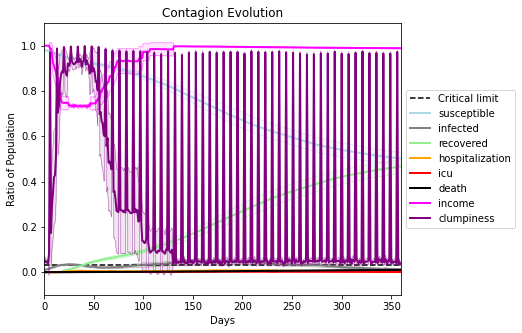

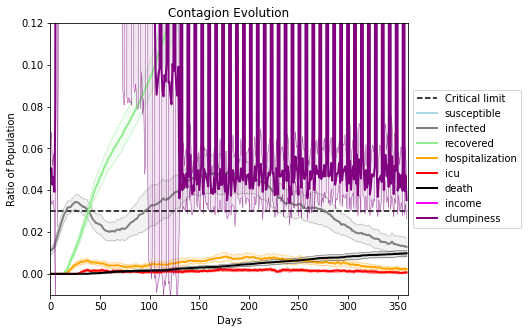

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5212, 3714, 5915, 2682, 9053, 5195, 5249, 4502, 9398, 6398, 6407, 6464, 8034, 7589, 532, 6726, 7528, 4899, 1277, 7280]
Average similarity between family members is 0.9454845088712026 at temperature -0.995
Average similarity between family and home is 0.9998561459031471 at temperature -1
Average similarity between students and their classroom is 0.6258866345242614 at temperature -0.995
Average classroom occupancy is 4.393939393939394 and number classrooms is 66
Average similarity between workers is 0.8933472782464841 at temperature -0.995
Average office occupancy is 3.350253807106599 and number offices is 197
Average friend similarity for adults: 0.8476085280910396 for kids: 0.683669482953896
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5750800855840498
avg restaurant similarity 0.550407007829875
avg restaurant similarity 0.628443219643766
avg restaurant similarity 0.6136886029112014
avg restaurant similarity 0.5821695087107114
avg restaurant similarity 0.6096982331624297
avg restaurant similarity 0.5705726210679343
avg restaurant similarity 0.5854689780534206
avg restaurant similarity 0.6085561686922981
avg restaurant similarity 0.5622991959690105
avg restaurant similarity 0.5988788518699615
avg restaurant similarity 0.5816056484970583
avg restaurant similarity 0.5677100492069324
avg restaurant similarity 0.6037055487487736
avg restaurant similarity 0.5384422527144755
avg restaurant similarity 0.6034279502260843
avg restaurant similarity 0.616430034031276
avg restaurant similarity 0.6089362835316308
avg restaurant similarity 0.6195691864334177
avg restaurant similarity 0.6427020114345645
avg restaurant similarity 0.5998945130051818
avg restaurant similarity 0.5932296647145391
avg restauran

avg restaurant similarity 0.5936644087921605
avg restaurant similarity 0.5824720876364282
avg restaurant similarity 0.6293213434656498
avg restaurant similarity 0.5780751957725989
avg restaurant similarity 0.5585051724887186
avg restaurant similarity 0.6066554303969126
avg restaurant similarity 0.5518359402157731
avg restaurant similarity 0.6351358180058454
avg restaurant similarity 0.5767339286554811
avg restaurant similarity 0.5929963109001831
avg restaurant similarity 0.5864108079847415
avg restaurant similarity 0.5743593564506176
avg restaurant similarity 0.5586399622337201
avg restaurant similarity 0.5595523947654293
avg restaurant similarity 0.557878272045832
avg restaurant similarity 0.6021784388984267
avg restaurant similarity 0.6182803111881483
avg restaurant similarity 0.5283976923013007
avg restaurant similarity 0.5557403116951923
avg restaurant similarity 0.602865912759956
avg restaurant similarity 0.60059389911651
avg restaurant similarity 0.5773967911598029
avg restaurant

avg restaurant similarity 0.5510718932670206
avg restaurant similarity 0.5526721003694697
avg restaurant similarity 0.6082860157958895
avg restaurant similarity 0.5872454452812467
avg restaurant similarity 0.5355618935610552
avg restaurant similarity 0.5482375365368546
avg restaurant similarity 0.5705806517319583
avg restaurant similarity 0.5388660622587781
avg restaurant similarity 0.5328721032115291
avg restaurant similarity 0.545495292707392
avg restaurant similarity 0.5357524406496647
avg restaurant similarity 0.5566464648892456
avg restaurant similarity 0.5963622238776501
avg restaurant similarity 0.5651753451231502
avg restaurant similarity 0.5666812026096236
avg restaurant similarity 0.6110908859309597
avg restaurant similarity 0.5628991600504687
avg restaurant similarity 0.5403625415801009
avg restaurant similarity 0.566214689269384
avg restaurant similarity 0.5521349581647926
avg restaurant similarity 0.5462954730413294
avg restaurant similarity 0.6058997816491166
avg restaura

avg restaurant similarity 0.6192081952195898
avg restaurant similarity 0.577127517240041
avg restaurant similarity 0.5600826932940399
avg restaurant similarity 0.609964998951364
avg restaurant similarity 0.5584791491666844
avg restaurant similarity 0.5720599299573016
avg restaurant similarity 0.5811033204216901
avg restaurant similarity 0.5785714666543829
avg restaurant similarity 0.5813408251984991
avg restaurant similarity 0.5839113014991868
avg restaurant similarity 0.5340723946596933
avg restaurant similarity 0.5792302350258475
avg restaurant similarity 0.5425548496411035
avg restaurant similarity 0.5807923980289648
avg restaurant similarity 0.555137027290105
avg restaurant similarity 0.5708314002275864
avg restaurant similarity 0.5865346686870774
avg restaurant similarity 0.5679595922806351
avg restaurant similarity 0.5912266879651994
avg restaurant similarity 0.5746097127608442
avg restaurant similarity 0.5810297720404586
avg restaurant similarity 0.5825220566603923
avg restauran

avg restaurant similarity 0.6367892603198023
avg restaurant similarity 0.6385034972774162
avg restaurant similarity 0.5961569431251834
avg restaurant similarity 0.6102411722713116
avg restaurant similarity 0.622445919044306
avg restaurant similarity 0.5556607448277788
avg restaurant similarity 0.6288565944185835
avg restaurant similarity 0.5950568871851072
avg restaurant similarity 0.6162341743964155
avg restaurant similarity 0.5919889247413781
avg restaurant similarity 0.5926452159510696
avg restaurant similarity 0.5349422764419139
avg restaurant similarity 0.6135067344507001
avg restaurant similarity 0.6066046686460139
avg restaurant similarity 0.5565138601563546
avg restaurant similarity 0.6127379230573294
avg restaurant similarity 0.5736345656363674
avg restaurant similarity 0.6934282474502685
avg restaurant similarity 0.5920661749050941
avg restaurant similarity 0.6129310615028616
avg restaurant similarity 0.6521104068621533
avg restaurant similarity 0.5839462810057945
avg restaur

avg restaurant similarity 0.5830917936131897
avg restaurant similarity 0.604652404275256
avg restaurant similarity 0.5948718069659614
avg restaurant similarity 0.6285517155960112
avg restaurant similarity 0.5939697193690626
avg restaurant similarity 0.6229386654436044
avg restaurant similarity 0.6182706781904959
avg restaurant similarity 0.5524613535671807
avg restaurant similarity 0.6192166516951272
avg restaurant similarity 0.5852744124645445
avg restaurant similarity 0.5872873817563637
avg restaurant similarity 0.5556512973987501
avg restaurant similarity 0.6236810995161023
avg restaurant similarity 0.5866294033641393
avg restaurant similarity 0.5640882354057893
avg restaurant similarity 0.6034868178718417
avg restaurant similarity 0.5969731476895157
avg restaurant similarity 0.5531559739573821
avg restaurant similarity 0.5595132652713297
avg restaurant similarity 0.5920887550122454
avg restaurant similarity 0.5913197722377279
avg restaurant similarity 0.5168295880609906
avg restaur

avg restaurant similarity 0.5726911782729442
avg restaurant similarity 0.612535512581376
avg restaurant similarity 0.5547316413276573
avg restaurant similarity 0.6238133260057892
avg restaurant similarity 0.5747643932618591
avg restaurant similarity 0.5970265984312126
avg restaurant similarity 0.6157643489024461
avg restaurant similarity 0.6056242469521199
avg restaurant similarity 0.5619133872628361
avg restaurant similarity 0.6385382211630126
avg restaurant similarity 0.5889491154710117
avg restaurant similarity 0.6764371466009713
avg restaurant similarity 0.6532937765140785
avg restaurant similarity 0.6022718199254742
avg restaurant similarity 0.6298380882476469
avg restaurant similarity 0.6050960489454428
avg restaurant similarity 0.5960337842629954
avg restaurant similarity 0.5892653633129749
avg restaurant similarity 0.5725551652391202
avg restaurant similarity 0.5801029467681563
avg restaurant similarity 0.5962681727251913
avg restaurant similarity 0.6217148559273586
avg restaur

avg restaurant similarity 0.6357511953026094
avg restaurant similarity 0.6278958319485541
avg restaurant similarity 0.604538497923124
avg restaurant similarity 0.5993439689693978
avg restaurant similarity 0.649282755629516
avg restaurant similarity 0.6052021378286871
avg restaurant similarity 0.5762781201338153
avg restaurant similarity 0.5598629565312457
avg restaurant similarity 0.6175188469710647
avg restaurant similarity 0.5953294079950422
avg restaurant similarity 0.6203323581754635
avg restaurant similarity 0.5993241422782426
avg restaurant similarity 0.6979035015557192
avg restaurant similarity 0.55616400634735
avg restaurant similarity 0.6186744260343969
avg restaurant similarity 0.5635059532943343
avg restaurant similarity 0.6068372992423238
avg restaurant similarity 0.6391730037103036
avg restaurant similarity 0.6377472477428989
avg restaurant similarity 0.6203528351836535
avg restaurant similarity 0.5513072633481507
avg restaurant similarity 0.6483391466085289
avg restaurant

avg restaurant similarity 0.5263885974395167
avg restaurant similarity 0.5493346638728452
avg restaurant similarity 0.5383221504565883
avg restaurant similarity 0.5948326097092859
avg restaurant similarity 0.6006206284002202
avg restaurant similarity 0.6472076774812081
avg restaurant similarity 0.5650993909994442
avg restaurant similarity 0.5566117381853198
avg restaurant similarity 0.6263549570467941
avg restaurant similarity 0.552286082495007
avg restaurant similarity 0.6107753790278964
avg restaurant similarity 0.5739226336047656
avg restaurant similarity 0.5359603827738357
avg restaurant similarity 0.5498535837053733
avg restaurant similarity 0.6433968460112288
avg restaurant similarity 0.5680394576339242
avg restaurant similarity 0.6461685695096872
avg restaurant similarity 0.6218846084595052
avg restaurant similarity 0.5069958017286452
avg restaurant similarity 0.5823241959099545
avg restaurant similarity 0.6157878089772473
avg restaurant similarity 0.5605026179479583
avg restaur

avg restaurant similarity 0.6020478729822909
avg restaurant similarity 0.5711418730556814
avg restaurant similarity 0.5899725833268542
avg restaurant similarity 0.5980510787935928
avg restaurant similarity 0.5743498947772987
avg restaurant similarity 0.5715069481604659
avg restaurant similarity 0.6095062127670868
avg restaurant similarity 0.5531599159156381
avg restaurant similarity 0.5720105558368358
avg restaurant similarity 0.5697127890772505
avg restaurant similarity 0.5701223408743554
avg restaurant similarity 0.6038378824633078
avg restaurant similarity 0.5862726270587134
avg restaurant similarity 0.5772589252159085
avg restaurant similarity 0.5738886682517682
avg restaurant similarity 0.5693143540523553
avg restaurant similarity 0.5448822046087135
avg restaurant similarity 0.5089446359387669
avg restaurant similarity 0.533999299939837
avg restaurant similarity 0.525005118762528
avg restaurant similarity 0.545348881217756
avg restaurant similarity 0.5636291903891117
avg restauran

avg restaurant similarity 0.5841771041946989
avg restaurant similarity 0.5480680914275978
avg restaurant similarity 0.5677997138736439
avg restaurant similarity 0.630113010619098
avg restaurant similarity 0.6256154108683384
avg restaurant similarity 0.6249990318251322
avg restaurant similarity 0.5063376570877642
avg restaurant similarity 0.5665007605369009
avg restaurant similarity 0.4599175460456245
avg restaurant similarity 0.5744348959753794
avg restaurant similarity 0.5747494144301827
avg restaurant similarity 0.528385229920676
avg restaurant similarity 0.5442752329577161
avg restaurant similarity 0.5686391702834459
avg restaurant similarity 0.5769485476086975
avg restaurant similarity 0.5752084117677423
avg restaurant similarity 0.5656104098723934
avg restaurant similarity 0.5031508692793831
avg restaurant similarity 0.5586366395487105
avg restaurant similarity 0.5336082736014401
avg restaurant similarity 0.5559359239523881
avg restaurant similarity 0.5071237711591383
avg restaura

avg restaurant similarity 0.5655211725641843
avg restaurant similarity 0.6060465810342578
avg restaurant similarity 0.5816827318581387
avg restaurant similarity 0.6035909590116845
avg restaurant similarity 0.6236888054777979
avg restaurant similarity 0.5960110994076764
avg restaurant similarity 0.6331973354866539
avg restaurant similarity 0.6052121323732687
avg restaurant similarity 0.6100108746358716
avg restaurant similarity 0.587912932473022
avg restaurant similarity 0.6206060424542329
avg restaurant similarity 0.5045621455141361
avg restaurant similarity 0.5788934462054038
avg restaurant similarity 0.5900051648864109
avg restaurant similarity 0.5825713456761281
avg restaurant similarity 0.6077221610175519
avg restaurant similarity 0.583947837263642
avg restaurant similarity 0.5811636104971628
avg restaurant similarity 0.5367690716129688
avg restaurant similarity 0.6330995081906913
avg restaurant similarity 0.5289517251544573
avg restaurant similarity 0.5169518541384256
avg restaura

avg restaurant similarity 0.5868295212405531
avg restaurant similarity 0.6001035719152764
avg restaurant similarity 0.621362971322289
avg restaurant similarity 0.5832545584388985
avg restaurant similarity 0.5492434660482771
avg restaurant similarity 0.6059756088196925
avg restaurant similarity 0.5932276603470343
avg restaurant similarity 0.5741091801537579
avg restaurant similarity 0.5878982278500385
avg restaurant similarity 0.5999943000179935
avg restaurant similarity 0.5663382787413512
avg restaurant similarity 0.6021211728635945
avg restaurant similarity 0.5721386981287144
avg restaurant similarity 0.57404286260204
avg restaurant similarity 0.617474357236645
avg restaurant similarity 0.5818090150176768
avg restaurant similarity 0.5988109203492468
avg restaurant similarity 0.5802149102485655
avg restaurant similarity 0.618982114006767
avg restaurant similarity 0.63820464220468
avg restaurant similarity 0.5948086416923213
avg restaurant similarity 0.5857340888043142
avg restaurant si

avg restaurant similarity 0.648610757329589
avg restaurant similarity 0.5959608764905012
avg restaurant similarity 0.6199430723163538
avg restaurant similarity 0.5976335225908079
avg restaurant similarity 0.5836176363873983
avg restaurant similarity 0.6217636870618434
avg restaurant similarity 0.5644796040705129
avg restaurant similarity 0.5776508148246358
avg restaurant similarity 0.634813836790814
avg restaurant similarity 0.6076531101169695
avg restaurant similarity 0.6069114284552363
avg restaurant similarity 0.6134743583121158
avg restaurant similarity 0.619546529159388
avg restaurant similarity 0.6372314675313601
avg restaurant similarity 0.6111817300994492
avg restaurant similarity 0.6035653063515601
avg restaurant similarity 0.6547791575525649
avg restaurant similarity 0.5659784589827036
avg restaurant similarity 0.6001357886497695
avg restaurant similarity 0.5412911373450097
avg restaurant similarity 0.6117203385824865
avg restaurant similarity 0.6195979285361423
avg restauran

avg restaurant similarity 0.559984695628003
avg restaurant similarity 0.5862687583318155
avg restaurant similarity 0.5610370386454852
avg restaurant similarity 0.638366944629276
avg restaurant similarity 0.5439040099118044
avg restaurant similarity 0.542027821817163
avg restaurant similarity 0.6120888787113516
avg restaurant similarity 0.6317945864389467
avg restaurant similarity 0.5746114380185438
avg restaurant similarity 0.5918181056313717
avg restaurant similarity 0.5434561555759414
avg restaurant similarity 0.5641986277440794
avg restaurant similarity 0.6115120213221766
avg restaurant similarity 0.5925591133301564
avg restaurant similarity 0.5828077074991079
avg restaurant similarity 0.5525581525371989
avg restaurant similarity 0.563667275876515
avg restaurant similarity 0.5739463461898264
avg restaurant similarity 0.5801093173397545
avg restaurant similarity 0.6435566646901058
avg restaurant similarity 0.5335000197853863
avg restaurant similarity 0.582285760171451
avg restaurant 

avg restaurant similarity 0.5598330296759313
avg restaurant similarity 0.5466880492479292
avg restaurant similarity 0.5591461979912747
avg restaurant similarity 0.5521324124239357
avg restaurant similarity 0.5533881705516458
avg restaurant similarity 0.5261183645470283
avg restaurant similarity 0.541880582176762
avg restaurant similarity 0.557336282472774
avg restaurant similarity 0.5494439744540318
avg restaurant similarity 0.5640419769663337
avg restaurant similarity 0.5776637192570734
avg restaurant similarity 0.5485133752467393
avg restaurant similarity 0.5768850355120527
avg restaurant similarity 0.5797654059237519
avg restaurant similarity 0.5280587008932853
avg restaurant similarity 0.5813171415381349
avg restaurant similarity 0.5620759233623012
avg restaurant similarity 0.567758390268071
avg restaurant similarity 0.545721054254345
avg restaurant similarity 0.5994809683322004
avg restaurant similarity 0.5408504188105473
avg restaurant similarity 0.5614930197946005
avg restaurant

avg restaurant similarity 0.6289332943181657
avg restaurant similarity 0.5825492642479138
avg restaurant similarity 0.5804590961346762
avg restaurant similarity 0.6146354044174696
avg restaurant similarity 0.5245345582053466
avg restaurant similarity 0.5869825499559865
avg restaurant similarity 0.5759734924869884
avg restaurant similarity 0.5543705797759487
avg restaurant similarity 0.6146703929282141
avg restaurant similarity 0.6516001341885354
avg restaurant similarity 0.5547982667849034
avg restaurant similarity 0.5231646476418375
avg restaurant similarity 0.5348440224287244
avg restaurant similarity 0.5128136203572544
avg restaurant similarity 0.6379511725564461
avg restaurant similarity 0.6275810570282804
avg restaurant similarity 0.55303613134648
avg restaurant similarity 0.6622802890196977
avg restaurant similarity 0.5215995959277162
avg restaurant similarity 0.568127310513871
avg restaurant similarity 0.5242501626531838
avg restaurant similarity 0.5468794842981386
avg restauran

avg restaurant similarity 0.5758332506908953
avg restaurant similarity 0.6020618986350722
avg restaurant similarity 0.5829590251211426
avg restaurant similarity 0.5412818556718657
avg restaurant similarity 0.6105178298676381
avg restaurant similarity 0.643340319600636
avg restaurant similarity 0.4998801509754193
avg restaurant similarity 0.5981093035850228
avg restaurant similarity 0.629868853955619
avg restaurant similarity 0.543643703456024
avg restaurant similarity 0.5580307251914051
avg restaurant similarity 0.5416677683875852
avg restaurant similarity 0.5687889230850167
avg restaurant similarity 0.5871642513523763
avg restaurant similarity 0.5725661696567512
avg restaurant similarity 0.5582988307344655
avg restaurant similarity 0.5590769385513713
avg restaurant similarity 0.4826536328023548
avg restaurant similarity 0.5645585230554973
avg restaurant similarity 0.5353330477922476
avg restaurant similarity 0.5232474923271649
avg restaurant similarity 0.5747670434424097
avg restauran

avg restaurant similarity 0.5974751548756609
avg restaurant similarity 0.6301970806687389
avg restaurant similarity 0.6488849691561955
avg restaurant similarity 0.6292966196733343
avg restaurant similarity 0.6196055974502839
avg restaurant similarity 0.6478632603664894
avg restaurant similarity 0.6187276567203507
avg restaurant similarity 0.6541940709661799
avg restaurant similarity 0.654141787989363
avg restaurant similarity 0.5606684899201869
avg restaurant similarity 0.580759212501541
avg restaurant similarity 0.6167116549095941
avg restaurant similarity 0.5911662316991617
avg restaurant similarity 0.6246110807798988
avg restaurant similarity 0.6118772310834031
avg restaurant similarity 0.5838582679733584
avg restaurant similarity 0.6324352407606575
avg restaurant similarity 0.5994839067517108
avg restaurant similarity 0.6795699988902996
avg restaurant similarity 0.620036674473618
avg restaurant similarity 0.6230754582668688
avg restaurant similarity 0.7370790232286962
avg restauran

avg restaurant similarity 0.5830367844821978
avg restaurant similarity 0.5554485671278785
avg restaurant similarity 0.6740540758126511
avg restaurant similarity 0.5505650120678947
avg restaurant similarity 0.6936016603410554
avg restaurant similarity 0.6223026249096624
avg restaurant similarity 0.6152865900040131
avg restaurant similarity 0.6428592140695697
avg restaurant similarity 0.582510788441155
avg restaurant similarity 0.6495003026078859
avg restaurant similarity 0.6419781177901166
avg restaurant similarity 0.6246286966504727
avg restaurant similarity 0.6479851830582074
avg restaurant similarity 0.6388846292694161
avg restaurant similarity 0.6285012168879366
avg restaurant similarity 0.6185179770720834
avg restaurant similarity 0.6931315569525858
avg restaurant similarity 0.6421442916266994
avg restaurant similarity 0.6616462291814862
avg restaurant similarity 0.5908337471912919
avg restaurant similarity 0.6000903497500543
avg restaurant similarity 0.6708502637540454
avg restaur

avg restaurant similarity 0.5456921003405915
avg restaurant similarity 0.6455983329788529
avg restaurant similarity 0.5465743837427959
avg restaurant similarity 0.6029410409645338
avg restaurant similarity 0.5540363672151257
avg restaurant similarity 0.5461939488474372
avg restaurant similarity 0.6118126848335854
avg restaurant similarity 0.547516460276217
avg restaurant similarity 0.5676107066356433
avg restaurant similarity 0.5521795391361105
avg restaurant similarity 0.576407877514375
avg restaurant similarity 0.5636515087775122
avg restaurant similarity 0.5806896339421431
avg restaurant similarity 0.5615141237329679
avg restaurant similarity 0.5900336024164733
avg restaurant similarity 0.5880920467815719
avg restaurant similarity 0.6094903321450099
avg restaurant similarity 0.5773802937745491
avg restaurant similarity 0.5346774324982221
avg restaurant similarity 0.5616461794792045
avg restaurant similarity 0.5391925417265636
avg restaurant similarity 0.5275568222770365
avg restaura

avg restaurant similarity 0.549505093231225
avg restaurant similarity 0.5099008410068147
avg restaurant similarity 0.515542006387898
avg restaurant similarity 0.5984140595663682
avg restaurant similarity 0.6183250293186064
avg restaurant similarity 0.5916869606278181
avg restaurant similarity 0.5621876218794029
avg restaurant similarity 0.5788153776255852
avg restaurant similarity 0.5641434987713068
avg restaurant similarity 0.5842616043508407
avg restaurant similarity 0.5575118108174376
avg restaurant similarity 0.6022696045046866
avg restaurant similarity 0.49040656285024825
avg restaurant similarity 0.48988182463733093
avg restaurant similarity 0.5526868262648658
avg restaurant similarity 0.5299924588080243
avg restaurant similarity 0.5715162103191939
avg restaurant similarity 0.5743584581080673
avg restaurant similarity 0.5835384951997554
avg restaurant similarity 0.6297153754654559
avg restaurant similarity 0.5621005679955741
avg restaurant similarity 0.5802788618069549
avg restau

avg restaurant similarity 0.542159027996727
avg restaurant similarity 0.5343511066339836
avg restaurant similarity 0.5399468255181882
avg restaurant similarity 0.5763243806276422
avg restaurant similarity 0.5546724943542517
avg restaurant similarity 0.5402630996685169
avg restaurant similarity 0.5909116557764265
avg restaurant similarity 0.5862373962726587
avg restaurant similarity 0.5434727984460656
avg restaurant similarity 0.5684758856742912
avg restaurant similarity 0.5094229654528829
avg restaurant similarity 0.5536478549412074
avg restaurant similarity 0.5258331869943418
avg restaurant similarity 0.5656865535944029
avg restaurant similarity 0.5267669171530713
avg restaurant similarity 0.5789869085783316
avg restaurant similarity 0.5507107374943342
avg restaurant similarity 0.5158390104572719
avg restaurant similarity 0.5019440486900735
avg restaurant similarity 0.5639113238168015
avg restaurant similarity 0.5640291889761611
avg restaurant similarity 0.5189616039629404
avg restaur

avg restaurant similarity 0.5270196502761332
avg restaurant similarity 0.5602390153705472
avg restaurant similarity 0.5161489067819843
avg restaurant similarity 0.5133478818648382
avg restaurant similarity 0.5394346926141933
avg restaurant similarity 0.5039448608272544
avg restaurant similarity 0.556591417411381
avg restaurant similarity 0.5579696362439861
avg restaurant similarity 0.5051478908041573
avg restaurant similarity 0.5154418859368712
avg restaurant similarity 0.5534467233019176
avg restaurant similarity 0.5491386313188155
avg restaurant similarity 0.5579668625555748
avg restaurant similarity 0.557986165075091
avg restaurant similarity 0.46914116888682617
avg restaurant similarity 0.5583929574612552
avg restaurant similarity 0.49539776078819964
avg restaurant similarity 0.5087670004153279
avg restaurant similarity 0.5075250679956493
avg restaurant similarity 0.548637715157712
avg restaurant similarity 0.5141620890383222
avg restaurant similarity 0.5353228754099101
avg restaur

avg restaurant similarity 0.6121275187599293
avg restaurant similarity 0.6090847917081557
avg restaurant similarity 0.6424605909782976
avg restaurant similarity 0.5383957185273769
avg restaurant similarity 0.5809585055564709
avg restaurant similarity 0.6030145801080387
avg restaurant similarity 0.6181482304838742
avg restaurant similarity 0.620530833933103
avg restaurant similarity 0.5779550113647182
avg restaurant similarity 0.5863959942076349
avg restaurant similarity 0.6265998904724801
avg restaurant similarity 0.5737573293475796
avg restaurant similarity 0.5790629710449293
avg restaurant similarity 0.5586880729044615
avg restaurant similarity 0.5813355329353658
avg restaurant similarity 0.5793408284059548
avg restaurant similarity 0.5637158073395024
avg restaurant similarity 0.5744177637560459
avg restaurant similarity 0.6470554452618579
avg restaurant similarity 0.6258601298117145
avg restaurant similarity 0.6049926211274921
avg restaurant similarity 0.5675899410042995
avg restaur

avg restaurant similarity 0.6206863871050521
avg restaurant similarity 0.5495753872276401
avg restaurant similarity 0.6057830967509663
avg restaurant similarity 0.5609113942940992
avg restaurant similarity 0.5450027368080734
avg restaurant similarity 0.6360382884697712
avg restaurant similarity 0.5876753446399305
avg restaurant similarity 0.5697714943486326
avg restaurant similarity 0.616101059958835
avg restaurant similarity 0.6069717765119766
avg restaurant similarity 0.5544202543554524
avg restaurant similarity 0.5533647066888958
avg restaurant similarity 0.6239185929476234
avg restaurant similarity 0.5601613605097067
avg restaurant similarity 0.6037312021408855
avg restaurant similarity 0.622843096201627
avg restaurant similarity 0.6164882591230524
avg restaurant similarity 0.6163431876451297
avg restaurant similarity 0.57760242762356
avg restaurant similarity 0.6393340605832258
avg restaurant similarity 0.5837143467516817
avg restaurant similarity 0.6213667057783842
avg restaurant

avg restaurant similarity 0.5452986890829246
avg restaurant similarity 0.5919148740006143
avg restaurant similarity 0.5950143432536477
avg restaurant similarity 0.5764286260147855
avg restaurant similarity 0.5900469598717528
avg restaurant similarity 0.5947134659113074
avg restaurant similarity 0.5796696547257697
avg restaurant similarity 0.5802162261327026
avg restaurant similarity 0.5868601150804
avg restaurant similarity 0.6047033860081683
avg restaurant similarity 0.580465875627965
avg restaurant similarity 0.5488236091221617
avg restaurant similarity 0.5885674261031272
avg restaurant similarity 0.5985747772742367
avg restaurant similarity 0.5616918264130362
avg restaurant similarity 0.5818435670078016
avg restaurant similarity 0.6147716431096211
avg restaurant similarity 0.5872010653082977
avg restaurant similarity 0.5780253505409808
avg restaurant similarity 0.6233317206559267
avg restaurant similarity 0.5898948818612324
avg restaurant similarity 0.606990752375857
avg restaurant 

avg restaurant similarity 0.5480621726312969
avg restaurant similarity 0.5803367127066698
avg restaurant similarity 0.5946888095246795
avg restaurant similarity 0.5825545139416345
avg restaurant similarity 0.5583489765159413
avg restaurant similarity 0.6032192871908474
avg restaurant similarity 0.5650190073863004
avg restaurant similarity 0.5918094675092529
avg restaurant similarity 0.5862087407268674
avg restaurant similarity 0.5926070633127369
avg restaurant similarity 0.5960214396295842
avg restaurant similarity 0.5532301793231932
avg restaurant similarity 0.5891243241975546
avg restaurant similarity 0.5917216576037901
avg restaurant similarity 0.5731820275551653
avg restaurant similarity 0.5598064731828589
avg restaurant similarity 0.5983890327607146
avg restaurant similarity 0.5639134706743835
avg restaurant similarity 0.6085746742528142
avg restaurant similarity 0.567845006430481
avg restaurant similarity 0.5761729043173653
avg restaurant similarity 0.574247329617112
avg restaura

avg restaurant similarity 0.5848930983679039
avg restaurant similarity 0.5405154974344515
avg restaurant similarity 0.4906157260607487
avg restaurant similarity 0.6195851642943091
avg restaurant similarity 0.5521469998049976
avg restaurant similarity 0.4772432890425817
avg restaurant similarity 0.49492695606155374
avg restaurant similarity 0.4958486362124427
avg restaurant similarity 0.4723659097644371
avg restaurant similarity 0.5497902313939483
avg restaurant similarity 0.5611583460041456
avg restaurant similarity 0.6296867324689929
avg restaurant similarity 0.5678930228766681
avg restaurant similarity 0.5356039627441342
avg restaurant similarity 0.5375838741950227
avg restaurant similarity 0.5138200008462483
avg restaurant similarity 0.5433763912098879
avg restaurant similarity 0.6014126573526091
avg restaurant similarity 0.5686232006013096
avg restaurant similarity 0.5443799625839163
avg restaurant similarity 0.5041053446602464
avg restaurant similarity 0.5219526673796109
avg resta

avg restaurant similarity 0.5277688620175756
avg restaurant similarity 0.5602277154969794
avg restaurant similarity 0.5107040258532323
avg restaurant similarity 0.4705625270183649
avg restaurant similarity 0.5323707308059397
avg restaurant similarity 0.5455735220322283
avg restaurant similarity 0.5382113376246936
avg restaurant similarity 0.5220909438489284
avg restaurant similarity 0.5464630131738484
avg restaurant similarity 0.5362758112725825
avg restaurant similarity 0.5809399588873115
avg restaurant similarity 0.5465816198862097
avg restaurant similarity 0.5518726605017572
avg restaurant similarity 0.5563813212190735
avg restaurant similarity 0.5762263876747695
avg restaurant similarity 0.48931124580978996
avg restaurant similarity 0.5815762370515193
avg restaurant similarity 0.5337049887370681
avg restaurant similarity 0.5838579050808411
avg restaurant similarity 0.5877253496563527
avg restaurant similarity 0.5205537548304034
avg restaurant similarity 0.5888406897475108
avg resta

avg restaurant similarity 0.5156797701069505
avg restaurant similarity 0.5153392987593266
avg restaurant similarity 0.5771903007795149
avg restaurant similarity 0.5592491864740108
avg restaurant similarity 0.5608195022093752
avg restaurant similarity 0.5400964988566356
avg restaurant similarity 0.5902609516739092
avg restaurant similarity 0.5627439153196324
avg restaurant similarity 0.5504016090481471
avg restaurant similarity 0.5878219653875407
avg restaurant similarity 0.583074919534776
avg restaurant similarity 0.54223608950535
avg restaurant similarity 0.5797850393607791
avg restaurant similarity 0.5910951824777619
avg restaurant similarity 0.6233936585188122
avg restaurant similarity 0.5408186650316618
avg restaurant similarity 0.5688411087839557
avg restaurant similarity 0.5772992030382502
avg restaurant similarity 0.5604794032605832
avg restaurant similarity 0.585973674700557
avg restaurant similarity 0.5915122744795808
avg restaurant similarity 0.5606069113415078
avg restaurant

avg restaurant similarity 0.5366874561190972
avg restaurant similarity 0.535638106076262
avg restaurant similarity 0.5178413676989695
avg restaurant similarity 0.5948791692147882
avg restaurant similarity 0.5333513166347669
avg restaurant similarity 0.5341548027043234
avg restaurant similarity 0.5330459611961763
avg restaurant similarity 0.5795889204542691
avg restaurant similarity 0.5516264074606075
avg restaurant similarity 0.5651901019393578
avg restaurant similarity 0.587737490737073
avg restaurant similarity 0.5011822607727999
avg restaurant similarity 0.5478092877086196
avg restaurant similarity 0.6045933001119187
avg restaurant similarity 0.523822872931239
avg restaurant similarity 0.5507801355410941
avg restaurant similarity 0.5623761468981894
avg restaurant similarity 0.5418900642324357
avg restaurant similarity 0.5499600669747292
avg restaurant similarity 0.6047288086505527
avg restaurant similarity 0.5556209706078833
avg restaurant similarity 0.552762726208931
avg restaurant

avg restaurant similarity 0.5752861080603431
avg restaurant similarity 0.6204139258099304
avg restaurant similarity 0.6025605379930085
avg restaurant similarity 0.5888916161415727
avg restaurant similarity 0.5687892322115299
avg restaurant similarity 0.5799724546870981
avg restaurant similarity 0.553518150648027
avg restaurant similarity 0.5440422411726654
avg restaurant similarity 0.5370263473837193
avg restaurant similarity 0.586245635270454
avg restaurant similarity 0.5738712023980387
avg restaurant similarity 0.5187167087751162
avg restaurant similarity 0.5831247742234608
avg restaurant similarity 0.5581158400018927
avg restaurant similarity 0.5289600725237293
avg restaurant similarity 0.5482549938713117
avg restaurant similarity 0.5430169651950587
avg restaurant similarity 0.5833406503074376
avg restaurant similarity 0.5770511961560141
avg restaurant similarity 0.5678104247192854
avg restaurant similarity 0.5882018206787722
avg restaurant similarity 0.5262301112089526
avg restaura

avg restaurant similarity 0.5518345952804966
avg restaurant similarity 0.5507573423683021
avg restaurant similarity 0.5779359534395198
avg restaurant similarity 0.5582267327187733
avg restaurant similarity 0.5758757188705654
avg restaurant similarity 0.6013367186817333
avg restaurant similarity 0.5374555060802215
avg restaurant similarity 0.5795832941318961
avg restaurant similarity 0.539107593077373
avg restaurant similarity 0.6362109776445598
avg restaurant similarity 0.543843134927539
avg restaurant similarity 0.5661582155642724
avg restaurant similarity 0.5568971615288164
avg restaurant similarity 0.5977215891178145
avg restaurant similarity 0.5864890499771298
avg restaurant similarity 0.5287979789398521
avg restaurant similarity 0.5578935860923255
avg restaurant similarity 0.5594098949423802
avg restaurant similarity 0.5226197681722968
avg restaurant similarity 0.5690151716470397
avg restaurant similarity 0.5554131458025288
avg restaurant similarity 0.5492705500227173
avg restaura

avg restaurant similarity 0.5845542081794968
avg restaurant similarity 0.6610039199082975
avg restaurant similarity 0.6532753488615255
avg restaurant similarity 0.6002327214462102
avg restaurant similarity 0.5637108760863528
avg restaurant similarity 0.564177476221047
avg restaurant similarity 0.6531509558906516
avg restaurant similarity 0.5871159391251444
avg restaurant similarity 0.653815658848616
avg restaurant similarity 0.5921634510256408
avg restaurant similarity 0.5685021454847267
avg restaurant similarity 0.5728254013795415
avg restaurant similarity 0.5504122604786225
avg restaurant similarity 0.6479765473472584
avg restaurant similarity 0.5289985797674212
avg restaurant similarity 0.6070157913840737
avg restaurant similarity 0.6153299326175498
avg restaurant similarity 0.6040223193537877
avg restaurant similarity 0.534766354523102
avg restaurant similarity 0.5705312126014896
avg restaurant similarity 0.5888228440859568
avg restaurant similarity 0.5839972291126956
avg restauran

avg restaurant similarity 0.6190804783068371
avg restaurant similarity 0.5979372008487571
avg restaurant similarity 0.5962906416003124
avg restaurant similarity 0.564059176962829
avg restaurant similarity 0.6279510849775506
avg restaurant similarity 0.6339102072080008
avg restaurant similarity 0.5928407901568603
avg restaurant similarity 0.6051912519722208
avg restaurant similarity 0.613654677566131
avg restaurant similarity 0.646531315609747
avg restaurant similarity 0.6541670284651836
avg restaurant similarity 0.5390053722241579
avg restaurant similarity 0.598523190850441
avg restaurant similarity 0.5941000659382808
avg restaurant similarity 0.602201458237359
avg restaurant similarity 0.5743283978369158
avg restaurant similarity 0.597308257089729
avg restaurant similarity 0.5626296760078529
avg restaurant similarity 0.6052743766646662
avg restaurant similarity 0.5927058422333735
avg restaurant similarity 0.5811655888586391
avg restaurant similarity 0.6360352803381323
avg restaurant s

avg restaurant similarity 0.5940973377388421
avg restaurant similarity 0.6452020366443296
avg restaurant similarity 0.5987918094960132
avg restaurant similarity 0.585946031245597
avg restaurant similarity 0.5489995835289945
avg restaurant similarity 0.5652012784283845
avg restaurant similarity 0.6028307811025103
avg restaurant similarity 0.6335418583905732
avg restaurant similarity 0.6418657780060615
avg restaurant similarity 0.5104763139360387
avg restaurant similarity 0.5396017048156093
avg restaurant similarity 0.6265144794374308
avg restaurant similarity 0.5669176914876548
avg restaurant similarity 0.585061304245252
avg restaurant similarity 0.6081237620638138
avg restaurant similarity 0.6189095894507286
avg restaurant similarity 0.5631376235570007
avg restaurant similarity 0.5447847832945222
avg restaurant similarity 0.5626416444409504
avg restaurant similarity 0.5460722448089481
avg restaurant similarity 0.604191303984623
avg restaurant similarity 0.591902106161202
avg restaurant

avg restaurant similarity 0.564061183358863
avg restaurant similarity 0.5921351368121905
avg restaurant similarity 0.6208027155916938
avg restaurant similarity 0.5722784054360577
avg restaurant similarity 0.5236148848774432
avg restaurant similarity 0.5947911804594251
avg restaurant similarity 0.5711797951488908
avg restaurant similarity 0.5457665115178916
avg restaurant similarity 0.5477469632806716
avg restaurant similarity 0.5624648905466619
avg restaurant similarity 0.5791040005837816
avg restaurant similarity 0.5641239885294269
avg restaurant similarity 0.564369298829421
avg restaurant similarity 0.6119302101747919
avg restaurant similarity 0.5155270545156603
avg restaurant similarity 0.5712738233060659
avg restaurant similarity 0.6349688003204889
avg restaurant similarity 0.5720378546334057
avg restaurant similarity 0.5150920727623612
avg restaurant similarity 0.5878492443802372
avg restaurant similarity 0.5755028833424473
avg restaurant similarity 0.5801673775015783
avg restaura

avg restaurant similarity 0.5584647709281956
avg restaurant similarity 0.6033010872763771
avg restaurant similarity 0.6115692717154378
avg restaurant similarity 0.5466968808829777
avg restaurant similarity 0.6164384085471677
avg restaurant similarity 0.5507455602252734
avg restaurant similarity 0.6168315213385934
avg restaurant similarity 0.5661707689189854
avg restaurant similarity 0.5621849778734098
avg restaurant similarity 0.5493259852784445
avg restaurant similarity 0.5752714766879843
avg restaurant similarity 0.537950253600021
avg restaurant similarity 0.5703666280250598
avg restaurant similarity 0.5594299170473847
avg restaurant similarity 0.5581397066435515
avg restaurant similarity 0.5834540905914998
avg restaurant similarity 0.6213618189821957
avg restaurant similarity 0.5869857004510889
avg restaurant similarity 0.5845449712461777
avg restaurant similarity 0.6016052010304794
avg restaurant similarity 0.586067475497579
avg restaurant similarity 0.5585569275325174
avg restaura

avg restaurant similarity 0.581227232044611
avg restaurant similarity 0.5882749114136457
avg restaurant similarity 0.5759209562280312
avg restaurant similarity 0.6430097440313337
avg restaurant similarity 0.6344003265845548
avg restaurant similarity 0.6134667540271812
avg restaurant similarity 0.575003429001656
avg restaurant similarity 0.5701303479231589
avg restaurant similarity 0.5731410795330432
avg restaurant similarity 0.6012060215936686
avg restaurant similarity 0.5043626703889826
avg restaurant similarity 0.5761726071848613
avg restaurant similarity 0.6347409456573613
avg restaurant similarity 0.5804219172785481
avg restaurant similarity 0.6106060569193218
avg restaurant similarity 0.6120319862056192
avg restaurant similarity 0.5393229459140457
avg restaurant similarity 0.6156976303095232
avg restaurant similarity 0.593004273877213
avg restaurant similarity 0.4985793327321569
avg restaurant similarity 0.5792074524033353
avg restaurant similarity 0.5925732952714629
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

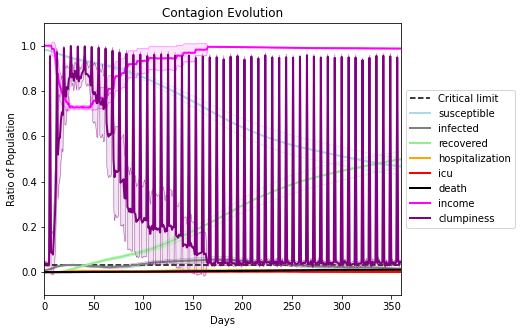

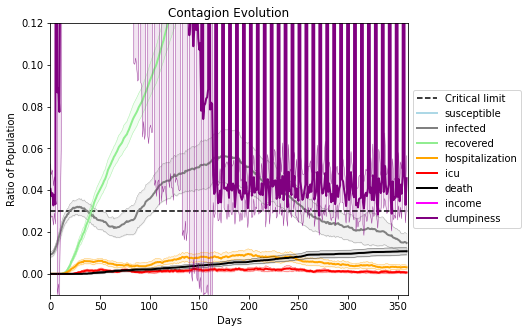

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4394, 7044, 3093, 167, 9847, 1824, 9806, 9725, 40, 4772, 7808, 3268, 2278, 3791, 1579, 2438, 1478, 7995, 2823, 441]
Average similarity between family members is 0.9436683440980382 at temperature -0.994
Average similarity between family and home is 0.9998513480316329 at temperature -1
Average similarity between students and their classroom is 0.5885412481226738 at temperature -0.994
Average classroom occupancy is 3.8529411764705883 and number classrooms is 68
Average similarity between workers is 0.8832208801654126 at temperature -0.994
Average office occupancy is 3.446700507614213 and number offices is 197
Average friend similarity for adults: 0.853994235929602 for kids: 0.6653514946293271
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5547498139368413
avg restaurant similarity 0.5293409972821381
avg restaurant similarity 0.6135147410307753
avg restaurant similarity 0.612745471017576
avg restaurant similarity 0.5419540968946837
avg restaurant similarity 0.5405589794056641
avg restaurant similarity 0.511789689580779
avg restaurant similarity 0.5000880187862955
avg restaurant similarity 0.5269390690792073
avg restaurant similarity 0.5287993966110599
avg restaurant similarity 0.5244988567709984
avg restaurant similarity 0.5213068227848189
avg restaurant similarity 0.5936609774576352
avg restaurant similarity 0.5721305889716247
avg restaurant similarity 0.5614404184535459
avg restaurant similarity 0.6084321047346697
avg restaurant similarity 0.555238468433863
avg restaurant similarity 0.5648933519155811
avg restaurant similarity 0.6143734783314411
avg restaurant similarity 0.574077340088807
avg restaurant similarity 0.5365350877925531
avg restaurant similarity 0.6023283875959864
avg restaurant

avg restaurant similarity 0.5538726748465951
avg restaurant similarity 0.5836630733188694
avg restaurant similarity 0.5912630751686035
avg restaurant similarity 0.5757768065319079
avg restaurant similarity 0.5055661182967777
avg restaurant similarity 0.5371848453476479
avg restaurant similarity 0.6531696865755244
avg restaurant similarity 0.5074181937081637
avg restaurant similarity 0.6486166062179248
avg restaurant similarity 0.480061706097293
avg restaurant similarity 0.5614312478751754
avg restaurant similarity 0.5838428152625331
avg restaurant similarity 0.5647985522406627
avg restaurant similarity 0.5183961252686904
avg restaurant similarity 0.55210430091703
avg restaurant similarity 0.5442950725896333
avg restaurant similarity 0.5675826291969417
avg restaurant similarity 0.584688382644018
avg restaurant similarity 0.5418515811541538
avg restaurant similarity 0.5048837148309754
avg restaurant similarity 0.6011727812912421
avg restaurant similarity 0.5997724119290826
avg restaurant

avg restaurant similarity 0.6025343450425229
avg restaurant similarity 0.6148491842122761
avg restaurant similarity 0.6548943938874449
avg restaurant similarity 0.590395556112862
avg restaurant similarity 0.5954653725105751
avg restaurant similarity 0.604120707890136
avg restaurant similarity 0.6015978083752558
avg restaurant similarity 0.5927301417183871
avg restaurant similarity 0.571423997445045
avg restaurant similarity 0.6445248972127613
avg restaurant similarity 0.5898382403941775
avg restaurant similarity 0.5899791960642614
avg restaurant similarity 0.599061741415403
avg restaurant similarity 0.5951112005159707
avg restaurant similarity 0.5643169777829324
avg restaurant similarity 0.6310494838020421
avg restaurant similarity 0.6066755115613691
avg restaurant similarity 0.6186229828836216
avg restaurant similarity 0.52822681864451
avg restaurant similarity 0.621086191567317
avg restaurant similarity 0.580654855371589
avg restaurant similarity 0.5748745392379858
avg restaurant sim

avg restaurant similarity 0.6098077092895271
avg restaurant similarity 0.5724600492653861
avg restaurant similarity 0.6026470253980795
avg restaurant similarity 0.6114621018285383
avg restaurant similarity 0.6273326250567086
avg restaurant similarity 0.6259895118474726
avg restaurant similarity 0.635496649625226
avg restaurant similarity 0.6225952044100963
avg restaurant similarity 0.6253147606454401
avg restaurant similarity 0.5985792751295664
avg restaurant similarity 0.6083525706184572
avg restaurant similarity 0.6353637181582195
avg restaurant similarity 0.5820100970085449
avg restaurant similarity 0.6055719511909581
avg restaurant similarity 0.5738898391186843
avg restaurant similarity 0.5706323913441812
avg restaurant similarity 0.5383015677604247
avg restaurant similarity 0.6206065086902076
avg restaurant similarity 0.6698791574503051
avg restaurant similarity 0.5681832290560972
avg restaurant similarity 0.5725033706955162
avg restaurant similarity 0.5845632572115591
avg restaur

avg restaurant similarity 0.5987563299243315
avg restaurant similarity 0.5518722578664726
avg restaurant similarity 0.529972341771111
avg restaurant similarity 0.5663449817356169
avg restaurant similarity 0.6028264091438391
avg restaurant similarity 0.6256043651563502
avg restaurant similarity 0.5300531164128015
avg restaurant similarity 0.5629914371817284
avg restaurant similarity 0.6110771315513092
avg restaurant similarity 0.5742351812374471
avg restaurant similarity 0.5695038649307145
avg restaurant similarity 0.5356755566021568
avg restaurant similarity 0.568899333291511
avg restaurant similarity 0.5938735601055778
avg restaurant similarity 0.5902803305464178
avg restaurant similarity 0.5254487568601425
avg restaurant similarity 0.5632704120482422
avg restaurant similarity 0.5470203103900494
avg restaurant similarity 0.6246141509405231
avg restaurant similarity 0.5745300821849441
avg restaurant similarity 0.61211951673928
avg restaurant similarity 0.5873814393394753
avg restaurant

avg restaurant similarity 0.5826836722513852
avg restaurant similarity 0.5676635100636701
avg restaurant similarity 0.5976202860729892
avg restaurant similarity 0.559915501249672
avg restaurant similarity 0.555052130655096
avg restaurant similarity 0.5709382974535409
avg restaurant similarity 0.544832216637855
avg restaurant similarity 0.5711817564649375
avg restaurant similarity 0.5737253177970969
avg restaurant similarity 0.6378236991796347
avg restaurant similarity 0.5282917872973987
avg restaurant similarity 0.5513762805835748
avg restaurant similarity 0.5765573526507557
avg restaurant similarity 0.6038705121017897
avg restaurant similarity 0.539838448247471
avg restaurant similarity 0.656607614009212
avg restaurant similarity 0.5364761467920913
avg restaurant similarity 0.5604081040745919
avg restaurant similarity 0.5406679886824607
avg restaurant similarity 0.625872012337208
avg restaurant similarity 0.5958092472277908
avg restaurant similarity 0.5513834484208576
avg restaurant s

avg restaurant similarity 0.6158608919443482
avg restaurant similarity 0.5919141172772981
avg restaurant similarity 0.6125600632900793
avg restaurant similarity 0.5983893500429113
avg restaurant similarity 0.6140638673184659
avg restaurant similarity 0.6084403878610996
avg restaurant similarity 0.6056074861096343
avg restaurant similarity 0.6417598441728609
avg restaurant similarity 0.5830491378748844
avg restaurant similarity 0.6507610815005221
avg restaurant similarity 0.6129636842563685
avg restaurant similarity 0.5910494266220434
avg restaurant similarity 0.6465701270946275
avg restaurant similarity 0.5218906002132497
avg restaurant similarity 0.6433829552948686
avg restaurant similarity 0.6455457082039998
avg restaurant similarity 0.6168853532438988
avg restaurant similarity 0.5887210018851224
avg restaurant similarity 0.6093555812143306
avg restaurant similarity 0.6231398558969251
avg restaurant similarity 0.5561045762414947
avg restaurant similarity 0.6293484430479308
avg restau

avg restaurant similarity 0.551158515906599
avg restaurant similarity 0.595546648014683
avg restaurant similarity 0.62637832409455
avg restaurant similarity 0.577715444004889
avg restaurant similarity 0.5946608299129984
avg restaurant similarity 0.6062784330672517
avg restaurant similarity 0.5797672067092274
avg restaurant similarity 0.5664628554421582
avg restaurant similarity 0.6333702570442821
avg restaurant similarity 0.6118466059302093
avg restaurant similarity 0.5500167721862077
avg restaurant similarity 0.5621836484135861
avg restaurant similarity 0.5635387415306319
avg restaurant similarity 0.6443624410939293
avg restaurant similarity 0.5928358624407508
avg restaurant similarity 0.5411104783451576
avg restaurant similarity 0.6004883323920095
avg restaurant similarity 0.6407177101344845
avg restaurant similarity 0.6306427610076462
avg restaurant similarity 0.6668567018644143
avg restaurant similarity 0.6599944362294767
avg restaurant similarity 0.640349079229399
avg restaurant s

avg restaurant similarity 0.5818859999379165
avg restaurant similarity 0.5725283944320709
avg restaurant similarity 0.6255110767022414
avg restaurant similarity 0.6201598811312613
avg restaurant similarity 0.5757283746329865
avg restaurant similarity 0.5735689727774852
avg restaurant similarity 0.553303430888139
avg restaurant similarity 0.5891301548699223
avg restaurant similarity 0.5817949532817307
avg restaurant similarity 0.5993545568400865
avg restaurant similarity 0.5923140073992514
avg restaurant similarity 0.5957858084723534
avg restaurant similarity 0.5715627380674388
avg restaurant similarity 0.574899503070676
avg restaurant similarity 0.6261209115425608
avg restaurant similarity 0.5501223862629137
avg restaurant similarity 0.5732126615755323
avg restaurant similarity 0.6158251709979017
avg restaurant similarity 0.6038100166082578
avg restaurant similarity 0.5750436566502305
avg restaurant similarity 0.5380161049275278
avg restaurant similarity 0.5914475779515984
avg restaura

avg restaurant similarity 0.5663348975152624
avg restaurant similarity 0.6065140639402565
avg restaurant similarity 0.5855353789508699
avg restaurant similarity 0.557612469660736
avg restaurant similarity 0.6078166278460585
avg restaurant similarity 0.5320537634292563
avg restaurant similarity 0.6020535353458195
avg restaurant similarity 0.5956996179673377
avg restaurant similarity 0.6177222828470298
avg restaurant similarity 0.5432591990303611
avg restaurant similarity 0.5340279641872131
avg restaurant similarity 0.5627445760338747
avg restaurant similarity 0.5045123816216457
avg restaurant similarity 0.6009620538858131
avg restaurant similarity 0.5746964684694646
avg restaurant similarity 0.5955634475909645
avg restaurant similarity 0.5971272855919709
avg restaurant similarity 0.5310868275388151
avg restaurant similarity 0.5475690721593061
avg restaurant similarity 0.6118367978106571
avg restaurant similarity 0.5664998466033145
avg restaurant similarity 0.57281661793673
avg restauran

avg restaurant similarity 0.5805094710649384
avg restaurant similarity 0.5332917785427306
avg restaurant similarity 0.5458191090992834
avg restaurant similarity 0.5636965277982519
avg restaurant similarity 0.5366543866039815
avg restaurant similarity 0.6095719322114066
avg restaurant similarity 0.5726622810546111
avg restaurant similarity 0.557555016279558
avg restaurant similarity 0.6300802837359948
avg restaurant similarity 0.5735892137751094
avg restaurant similarity 0.5677627842597104
avg restaurant similarity 0.5505943203498866
avg restaurant similarity 0.5417675683806116
avg restaurant similarity 0.5760421028107955
avg restaurant similarity 0.6113149157071605
avg restaurant similarity 0.5651919769253535
avg restaurant similarity 0.5998619305595715
avg restaurant similarity 0.567173884102407
avg restaurant similarity 0.6181309906454888
avg restaurant similarity 0.5561557763345044
avg restaurant similarity 0.5578160766199186
avg restaurant similarity 0.5847253110210968
avg restaura

avg restaurant similarity 0.597949429589116
avg restaurant similarity 0.5935042328830656
avg restaurant similarity 0.6024814093596546
avg restaurant similarity 0.5981538565129856
avg restaurant similarity 0.5847939974914979
avg restaurant similarity 0.5873671143940759
avg restaurant similarity 0.5960716753266758
avg restaurant similarity 0.6054872636510119
avg restaurant similarity 0.5853645489219395
avg restaurant similarity 0.6055087574805862
avg restaurant similarity 0.5682089586109056
avg restaurant similarity 0.596974271019556
avg restaurant similarity 0.5179222848805507
avg restaurant similarity 0.555646940736418
avg restaurant similarity 0.5303085275814529
avg restaurant similarity 0.58006916799348
avg restaurant similarity 0.5443219608705173
avg restaurant similarity 0.5422927326236291
avg restaurant similarity 0.5874089104519608
avg restaurant similarity 0.584159784810506
avg restaurant similarity 0.5910315893860629
avg restaurant similarity 0.5728101783895725
avg restaurant s

avg restaurant similarity 0.5391057074020211
avg restaurant similarity 0.547181912059368
avg restaurant similarity 0.5846588358391668
avg restaurant similarity 0.585212822618409
avg restaurant similarity 0.5821816592583178
avg restaurant similarity 0.6384709658686171
avg restaurant similarity 0.5719857131894682
avg restaurant similarity 0.5726789712782068
avg restaurant similarity 0.5779861227756297
avg restaurant similarity 0.6197320415566521
avg restaurant similarity 0.6238720324961903
avg restaurant similarity 0.5830552304520239
avg restaurant similarity 0.5619328538352094
avg restaurant similarity 0.5963975163902764
avg restaurant similarity 0.5166096402791699
avg restaurant similarity 0.601547349766761
avg restaurant similarity 0.5961607167385126
avg restaurant similarity 0.5911785753193374
avg restaurant similarity 0.5507573032389586
avg restaurant similarity 0.6239157627712729
avg restaurant similarity 0.6143065641801135
avg restaurant similarity 0.610429155965142
avg restaurant

avg restaurant similarity 0.6389762308039331
avg restaurant similarity 0.55419220387709
avg restaurant similarity 0.5790584589092023
avg restaurant similarity 0.6048219254857531
avg restaurant similarity 0.5686260908333476
avg restaurant similarity 0.6324658497641709
avg restaurant similarity 0.6246271816908316
avg restaurant similarity 0.5950410300986461
avg restaurant similarity 0.6462034540658821
avg restaurant similarity 0.5927482908122584
avg restaurant similarity 0.5743162255197
avg restaurant similarity 0.606817956281743
avg restaurant similarity 0.6121255425027202
avg restaurant similarity 0.5704410453763414
avg restaurant similarity 0.5708234588815014
avg restaurant similarity 0.5909847545359517
avg restaurant similarity 0.5886265909251269
avg restaurant similarity 0.6201333964096285
avg restaurant similarity 0.6138080548037933
avg restaurant similarity 0.6088015516163086
avg restaurant similarity 0.6371879154512662
avg restaurant similarity 0.6098017677757612
avg restaurant s

avg restaurant similarity 0.49636391666259055
avg restaurant similarity 0.5932090728191383
avg restaurant similarity 0.5333937214653373
avg restaurant similarity 0.5420950601382204
avg restaurant similarity 0.5152695198853189
avg restaurant similarity 0.5471654397571423
avg restaurant similarity 0.5665649338815886
avg restaurant similarity 0.45197554010288654
avg restaurant similarity 0.5223696229246473
avg restaurant similarity 0.5117187337405956
avg restaurant similarity 0.5586526657947678
avg restaurant similarity 0.5629450857224744
avg restaurant similarity 0.5431275589944436
avg restaurant similarity 0.5470638746361843
avg restaurant similarity 0.5636583746725579
avg restaurant similarity 0.5670875323415211
avg restaurant similarity 0.5626941011147132
avg restaurant similarity 0.5391590148927354
avg restaurant similarity 0.580335537373781
avg restaurant similarity 0.5096994252073811
avg restaurant similarity 0.5969147510128731
avg restaurant similarity 0.455274506147808
avg restau

avg restaurant similarity 0.5535489557582425
avg restaurant similarity 0.5553903611530185
avg restaurant similarity 0.47590786011596264
avg restaurant similarity 0.5090024211091659
avg restaurant similarity 0.5893974517178913
avg restaurant similarity 0.5613365928407493
avg restaurant similarity 0.5356511903497465
avg restaurant similarity 0.5702771420859356
avg restaurant similarity 0.4994423469432151
avg restaurant similarity 0.5370370554097215
avg restaurant similarity 0.4934661416438014
avg restaurant similarity 0.5608774639590955
avg restaurant similarity 0.5193682972228241
avg restaurant similarity 0.49303295697275346
avg restaurant similarity 0.5578200656179046
avg restaurant similarity 0.5127630681391349
avg restaurant similarity 0.524307107851851
avg restaurant similarity 0.5169179678717029
avg restaurant similarity 0.5267316592898638
avg restaurant similarity 0.6085402073595251
avg restaurant similarity 0.49946608571598705
avg restaurant similarity 0.5761331841574251
avg rest

avg restaurant similarity 0.6018174326951975
avg restaurant similarity 0.5461798229993923
avg restaurant similarity 0.5715795738091343
avg restaurant similarity 0.5909987059399968
avg restaurant similarity 0.5483950121823432
avg restaurant similarity 0.6543486559801595
avg restaurant similarity 0.600345239456528
avg restaurant similarity 0.5715275173275777
avg restaurant similarity 0.6454942740347847
avg restaurant similarity 0.5909271053534204
avg restaurant similarity 0.5467503601950409
avg restaurant similarity 0.5721188371205417
avg restaurant similarity 0.6071462526291141
avg restaurant similarity 0.644819245410758
avg restaurant similarity 0.6254992890817976
avg restaurant similarity 0.5525233754610296
avg restaurant similarity 0.5799660960311139
avg restaurant similarity 0.5694183431305749
avg restaurant similarity 0.5879343371143887
avg restaurant similarity 0.6463754505228361
avg restaurant similarity 0.598003163026878
avg restaurant similarity 0.5567506657482353
avg restauran

avg restaurant similarity 0.5881763227700628
avg restaurant similarity 0.6173846990219641
avg restaurant similarity 0.566834146650755
avg restaurant similarity 0.6049790867253109
avg restaurant similarity 0.5643051074972902
avg restaurant similarity 0.5753254425153226
avg restaurant similarity 0.5460195772346654
avg restaurant similarity 0.6243403555767392
avg restaurant similarity 0.587471763191577
avg restaurant similarity 0.5154404368567619
avg restaurant similarity 0.5547902638930376
avg restaurant similarity 0.5176126678039303
avg restaurant similarity 0.56689213382782
avg restaurant similarity 0.5852373738162855
avg restaurant similarity 0.5834434561313352
avg restaurant similarity 0.613800207118494
avg restaurant similarity 0.5233456655618872
avg restaurant similarity 0.5938929619858709
avg restaurant similarity 0.6289386776776272
avg restaurant similarity 0.5659917524516445
avg restaurant similarity 0.5763326349975493
avg restaurant similarity 0.5805452194022392
avg restaurant 

avg restaurant similarity 0.5811737584754672
avg restaurant similarity 0.580498605513782
avg restaurant similarity 0.6210999352262079
avg restaurant similarity 0.587750834041235
avg restaurant similarity 0.5728938839643839
avg restaurant similarity 0.5312899878890279
avg restaurant similarity 0.557451977858837
avg restaurant similarity 0.5952582934572188
avg restaurant similarity 0.6156424984164112
avg restaurant similarity 0.6024157142631807
avg restaurant similarity 0.5362893696507018
avg restaurant similarity 0.548976650361904
avg restaurant similarity 0.55337863707212
avg restaurant similarity 0.5956059450952234
avg restaurant similarity 0.6004447192229525
avg restaurant similarity 0.5630082380042046
avg restaurant similarity 0.5357385547033601
avg restaurant similarity 0.5957925041191178
avg restaurant similarity 0.5227267678907507
avg restaurant similarity 0.5242406705404615
avg restaurant similarity 0.554210560737293
avg restaurant similarity 0.5672587181651713
avg restaurant si

avg restaurant similarity 0.5608912478657625
avg restaurant similarity 0.509943393773752
avg restaurant similarity 0.578069254271847
avg restaurant similarity 0.5574403751571786
avg restaurant similarity 0.5732215951541818
avg restaurant similarity 0.5450264915038954
avg restaurant similarity 0.5843912471428038
avg restaurant similarity 0.5571297286007862
avg restaurant similarity 0.5871985677518929
avg restaurant similarity 0.5846358178133574
avg restaurant similarity 0.5627506857410408
avg restaurant similarity 0.559942284706164
avg restaurant similarity 0.5611242331026179
avg restaurant similarity 0.6014830396240126
avg restaurant similarity 0.5686704292790015
avg restaurant similarity 0.6117238448282243
avg restaurant similarity 0.5411410256205824
avg restaurant similarity 0.5707972186363212
avg restaurant similarity 0.6103152627171323
avg restaurant similarity 0.6232780864656714
avg restaurant similarity 0.569320970370674
avg restaurant similarity 0.5438884047494399
avg restaurant

avg restaurant similarity 0.561801860963744
avg restaurant similarity 0.5561679051859264
avg restaurant similarity 0.5873053088377734
avg restaurant similarity 0.5459680217288653
avg restaurant similarity 0.5466209351320876
avg restaurant similarity 0.5243534099373092
avg restaurant similarity 0.5647399180974103
avg restaurant similarity 0.5727396564325787
avg restaurant similarity 0.5548798601240512
avg restaurant similarity 0.5649101822038105
avg restaurant similarity 0.5255117240037054
avg restaurant similarity 0.6255303983538032
avg restaurant similarity 0.5300049215276128
avg restaurant similarity 0.5304408093505022
avg restaurant similarity 0.5547822000859111
avg restaurant similarity 0.535244681537849
avg restaurant similarity 0.5112607556864095
avg restaurant similarity 0.5341153858260133
avg restaurant similarity 0.5343047962834139
avg restaurant similarity 0.5574391474090269
avg restaurant similarity 0.5747178067662656
avg restaurant similarity 0.6008056178109392
avg restaura

avg restaurant similarity 0.5404001759185788
avg restaurant similarity 0.5504458370757369
avg restaurant similarity 0.5980663912403038
avg restaurant similarity 0.5807445304010885
avg restaurant similarity 0.6310697428847072
avg restaurant similarity 0.583946437301576
avg restaurant similarity 0.6002458655587533
avg restaurant similarity 0.5454945701564188
avg restaurant similarity 0.5531797740809663
avg restaurant similarity 0.5349938832461939
avg restaurant similarity 0.5256566296279958
avg restaurant similarity 0.5815285609535237
avg restaurant similarity 0.5301304958053531
avg restaurant similarity 0.49952448609352523
avg restaurant similarity 0.5910352185911935
avg restaurant similarity 0.5342337890620805
avg restaurant similarity 0.5671379804834005
avg restaurant similarity 0.557155053504988
avg restaurant similarity 0.5774957022373484
avg restaurant similarity 0.5929199736950114
avg restaurant similarity 0.5995474027722403
avg restaurant similarity 0.5450003881745797
avg restaur

avg restaurant similarity 0.6166075167820548
avg restaurant similarity 0.565174355850561
avg restaurant similarity 0.5090018759553697
avg restaurant similarity 0.5504394449404191
avg restaurant similarity 0.545735525755928
avg restaurant similarity 0.5043791132638433
avg restaurant similarity 0.5966341749763
avg restaurant similarity 0.5159555550654681
avg restaurant similarity 0.5659223655344743
avg restaurant similarity 0.5416791082097279
avg restaurant similarity 0.5528724490851982
avg restaurant similarity 0.5337513043333276
avg restaurant similarity 0.5245079095249002
avg restaurant similarity 0.5407034148897009
avg restaurant similarity 0.5561530762516811
avg restaurant similarity 0.5371982339865045
avg restaurant similarity 0.5364767315650754
avg restaurant similarity 0.5167229326005022
avg restaurant similarity 0.6168590992317652
avg restaurant similarity 0.5367083101772168
avg restaurant similarity 0.5552811914633623
avg restaurant similarity 0.5365634287746992
avg restaurant 

avg restaurant similarity 0.519065518621124
avg restaurant similarity 0.5579971115144592
avg restaurant similarity 0.5026807720416294
avg restaurant similarity 0.5871036517371452
avg restaurant similarity 0.5790034775608236
avg restaurant similarity 0.5265376402371623
avg restaurant similarity 0.5334321748206966
avg restaurant similarity 0.5242458583725261
avg restaurant similarity 0.5605542618952484
avg restaurant similarity 0.5670662194012718
avg restaurant similarity 0.5078617146328231
avg restaurant similarity 0.5147686613320663
avg restaurant similarity 0.4780964594839017
avg restaurant similarity 0.5988095532022218
avg restaurant similarity 0.590865825325359
avg restaurant similarity 0.5667492502422807
avg restaurant similarity 0.5875084618735025
avg restaurant similarity 0.5323846399733604
avg restaurant similarity 0.556725834084822
avg restaurant similarity 0.5193282257278322
avg restaurant similarity 0.5809806130858339
avg restaurant similarity 0.5066693440176265
avg restauran

avg restaurant similarity 0.582083580010595
avg restaurant similarity 0.5828624566779134
avg restaurant similarity 0.5801684152642878
avg restaurant similarity 0.6147765868928554
avg restaurant similarity 0.5332906796436524
avg restaurant similarity 0.5411978866741296
avg restaurant similarity 0.600077351958399
avg restaurant similarity 0.5329142734074103
avg restaurant similarity 0.5073095926709308
avg restaurant similarity 0.5800621133074219
avg restaurant similarity 0.5427232484851203
avg restaurant similarity 0.5740271906651913
avg restaurant similarity 0.5821810451968892
avg restaurant similarity 0.6167849673392035
avg restaurant similarity 0.5067098312715654
avg restaurant similarity 0.5485607631532718
avg restaurant similarity 0.534689715352656
avg restaurant similarity 0.5226742511325676
avg restaurant similarity 0.562460361750114
avg restaurant similarity 0.5035649264139791
avg restaurant similarity 0.6083861282584203
avg restaurant similarity 0.5579793380939083
avg restaurant

avg restaurant similarity 0.6129133296392545
avg restaurant similarity 0.6197641442089483
avg restaurant similarity 0.6326174098279699
avg restaurant similarity 0.5972651389527257
avg restaurant similarity 0.6310678729760788
avg restaurant similarity 0.5865403118806077
avg restaurant similarity 0.5713285442956346
avg restaurant similarity 0.6157643733782024
avg restaurant similarity 0.5343609300152254
avg restaurant similarity 0.5164285064915831
avg restaurant similarity 0.5809997029466932
avg restaurant similarity 0.5700140485109237
avg restaurant similarity 0.5736800482936797
avg restaurant similarity 0.6184715997956234
avg restaurant similarity 0.6316418244991433
avg restaurant similarity 0.5738466181157346
avg restaurant similarity 0.5201492643935232
avg restaurant similarity 0.5298230706888138
avg restaurant similarity 0.5312526647878971
avg restaurant similarity 0.5428614990629237
avg restaurant similarity 0.5276354165335037
avg restaurant similarity 0.5694607527327482
avg restau

avg restaurant similarity 0.5581526815391458
avg restaurant similarity 0.5379707560125937
avg restaurant similarity 0.5411924069243245
avg restaurant similarity 0.4981593473926897
avg restaurant similarity 0.5210025432946727
avg restaurant similarity 0.5728751038947343
avg restaurant similarity 0.5439888629220364
avg restaurant similarity 0.5120425026611419
avg restaurant similarity 0.5573752001945638
avg restaurant similarity 0.5768124896641236
avg restaurant similarity 0.5234596189626444
avg restaurant similarity 0.5970182484843624
avg restaurant similarity 0.5661965927909596
avg restaurant similarity 0.554494489501703
avg restaurant similarity 0.5359639601629994
avg restaurant similarity 0.5608219046223184
avg restaurant similarity 0.555668786178129
avg restaurant similarity 0.5693848149253115
avg restaurant similarity 0.5702663947318143
avg restaurant similarity 0.5323650930864722
avg restaurant similarity 0.5112402799272759
avg restaurant similarity 0.5879575785264249
avg restaura

avg restaurant similarity 0.5695860926300393
avg restaurant similarity 0.5625106524207127
avg restaurant similarity 0.5385085609145399
avg restaurant similarity 0.5701636631824913
avg restaurant similarity 0.5692472581773799
avg restaurant similarity 0.5244020274634463
avg restaurant similarity 0.5757363229614982
avg restaurant similarity 0.5534864140147231
avg restaurant similarity 0.5571404285254061
avg restaurant similarity 0.5650528790320685
avg restaurant similarity 0.5208768380866952
avg restaurant similarity 0.488103270426195
avg restaurant similarity 0.5786030541303686
avg restaurant similarity 0.5875418248152006
avg restaurant similarity 0.5226754416018082
avg restaurant similarity 0.5096601741536658
avg restaurant similarity 0.5933867010363721
avg restaurant similarity 0.570074255336138
avg restaurant similarity 0.5375395045229808
avg restaurant similarity 0.5255418952605816
avg restaurant similarity 0.49354531180240807
avg restaurant similarity 0.5950046004313847
avg restaur

avg restaurant similarity 0.5194105508561785
avg restaurant similarity 0.5044162927019926
avg restaurant similarity 0.6391362087566176
avg restaurant similarity 0.5449934407198459
avg restaurant similarity 0.565412571906751
avg restaurant similarity 0.5428283621789608
avg restaurant similarity 0.550566735894758
avg restaurant similarity 0.5799272691025475
avg restaurant similarity 0.642142854997022
avg restaurant similarity 0.5681108158602135
avg restaurant similarity 0.5670203741676603
avg restaurant similarity 0.5582519537002139
avg restaurant similarity 0.5571489821070801
avg restaurant similarity 0.5521723718750172
avg restaurant similarity 0.5411973433755043
avg restaurant similarity 0.5725054307222014
avg restaurant similarity 0.5896009034485493
avg restaurant similarity 0.582408335923665
avg restaurant similarity 0.5505742750727783
avg restaurant similarity 0.5714247912026846
avg restaurant similarity 0.615089895685059
avg restaurant similarity 0.5450543429406549
avg restaurant 

avg restaurant similarity 0.5503246962668854
avg restaurant similarity 0.5557410293715712
avg restaurant similarity 0.5442513555547448
avg restaurant similarity 0.6215880678504748
avg restaurant similarity 0.5812646781899078
avg restaurant similarity 0.5642419835105917
avg restaurant similarity 0.6199339453177831
avg restaurant similarity 0.5859166708377309
avg restaurant similarity 0.6289498752923338
avg restaurant similarity 0.5739128380252061
avg restaurant similarity 0.538713531146231
avg restaurant similarity 0.5269364337641168
avg restaurant similarity 0.5716919078435365
avg restaurant similarity 0.5606587857783627
avg restaurant similarity 0.5628372794240251
avg restaurant similarity 0.5829923896781696
avg restaurant similarity 0.5816862523623703
avg restaurant similarity 0.5414532582930919
avg restaurant similarity 0.5735150094399136
avg restaurant similarity 0.5173393185584525
avg restaurant similarity 0.5609207204508497
avg restaurant similarity 0.5891541634171417
avg restaur

avg restaurant similarity 0.578184423753888
avg restaurant similarity 0.546979298505155
avg restaurant similarity 0.5945423454989276
avg restaurant similarity 0.6043310840822124
avg restaurant similarity 0.6055486412260725
avg restaurant similarity 0.539365311957251
avg restaurant similarity 0.5625251991499286
avg restaurant similarity 0.5796667144681282
avg restaurant similarity 0.5373620470034545
avg restaurant similarity 0.606636681471352
avg restaurant similarity 0.5547229070730396
avg restaurant similarity 0.5613927710038724
avg restaurant similarity 0.5626242456121805
avg restaurant similarity 0.5965452927763575
avg restaurant similarity 0.5684249834730027
avg restaurant similarity 0.5357630806244823
avg restaurant similarity 0.5483332237369662
avg restaurant similarity 0.5665183356969363
avg restaurant similarity 0.5899593887156453
avg restaurant similarity 0.596538162610577
avg restaurant similarity 0.562203603164343
avg restaurant similarity 0.55899553486687
avg restaurant sim

avg restaurant similarity 0.5533872685737129
avg restaurant similarity 0.5856164741842443
avg restaurant similarity 0.5912903617491099
avg restaurant similarity 0.6043111764267979
avg restaurant similarity 0.5341203422346841
avg restaurant similarity 0.595785101245135
avg restaurant similarity 0.5815123412813411
avg restaurant similarity 0.5227391065067488
avg restaurant similarity 0.5857207969042715
avg restaurant similarity 0.5910906751403255
avg restaurant similarity 0.5543395809465681
avg restaurant similarity 0.5475556222419701
avg restaurant similarity 0.5422826394245496
avg restaurant similarity 0.5521811871203507
avg restaurant similarity 0.578700511770557
avg restaurant similarity 0.5822398042774444
avg restaurant similarity 0.5622074046817631
avg restaurant similarity 0.5803550269725319
avg restaurant similarity 0.5613050154928773
avg restaurant similarity 0.5581198765512299
avg restaurant similarity 0.5340503136812563
avg restaurant similarity 0.5489839476519304
avg restaura

avg restaurant similarity 0.5241553154747057
avg restaurant similarity 0.5450238911619407
avg restaurant similarity 0.522610991642168
avg restaurant similarity 0.5738399901491456
avg restaurant similarity 0.5712603668057611
avg restaurant similarity 0.551100701473683
avg restaurant similarity 0.5557757416047435
avg restaurant similarity 0.5435366698969074
avg restaurant similarity 0.5295230666811275
avg restaurant similarity 0.5573090446933134
avg restaurant similarity 0.5606256068435246
avg restaurant similarity 0.5791742742828659
avg restaurant similarity 0.5708879994391778
avg restaurant similarity 0.5492796793831879
avg restaurant similarity 0.5294141969036451
avg restaurant similarity 0.5486097282360856
avg restaurant similarity 0.5633691018694259
avg restaurant similarity 0.5580310719425794
avg restaurant similarity 0.5598165693781808
avg restaurant similarity 0.5918039257954734
avg restaurant similarity 0.6183866161148636
avg restaurant similarity 0.6082876866264444
avg restaura

avg restaurant similarity 0.5685040673602452
avg restaurant similarity 0.5800569305661684
avg restaurant similarity 0.5717334183458731
avg restaurant similarity 0.5466839451956808
avg restaurant similarity 0.5706418605160606
avg restaurant similarity 0.5601373715613538
avg restaurant similarity 0.551203717764065
avg restaurant similarity 0.5543095603619524
avg restaurant similarity 0.5303187840073404
avg restaurant similarity 0.5507757459551584
avg restaurant similarity 0.5527778250939851
avg restaurant similarity 0.554067752180319
avg restaurant similarity 0.5417633837641235
avg restaurant similarity 0.5527363886296125
avg restaurant similarity 0.5321131977136798
avg restaurant similarity 0.5421479120112251
avg restaurant similarity 0.5563105572474898
avg restaurant similarity 0.5823935123100207
avg restaurant similarity 0.5721206528277859
avg restaurant similarity 0.5447999022874634
avg restaurant similarity 0.6146857524609173
avg restaurant similarity 0.5426839917919185
avg restaura

avg restaurant similarity 0.5552669335115387
avg restaurant similarity 0.619219651554562
avg restaurant similarity 0.5704960788129897
avg restaurant similarity 0.5813223133043199
avg restaurant similarity 0.5454231664316154
avg restaurant similarity 0.5490492616126915
avg restaurant similarity 0.5994270365554185
avg restaurant similarity 0.5261568849602741
avg restaurant similarity 0.5989016057129376
avg restaurant similarity 0.57116067062402
avg restaurant similarity 0.5969090311941694
avg restaurant similarity 0.5371019981747895
avg restaurant similarity 0.5255272043672875
avg restaurant similarity 0.5496757909834437
avg restaurant similarity 0.5574478283350978
avg restaurant similarity 0.5554204748127417
avg restaurant similarity 0.5480794485156264
avg restaurant similarity 0.6015895064379575
avg restaurant similarity 0.5505546790826509
avg restaurant similarity 0.5566285195806605
avg restaurant similarity 0.5346536196126345
avg restaurant similarity 0.5638532130575211
avg restauran

avg restaurant similarity 0.5732128640017096
avg restaurant similarity 0.5990367761712725
avg restaurant similarity 0.5293505889037058
avg restaurant similarity 0.5855744568669558
avg restaurant similarity 0.5942866386573855
avg restaurant similarity 0.551956601993825
avg restaurant similarity 0.5774037202168021
avg restaurant similarity 0.5657942767547868
avg restaurant similarity 0.5595605246259758
avg restaurant similarity 0.5472255869787667
avg restaurant similarity 0.5464530555168924
avg restaurant similarity 0.6126174843915132
avg restaurant similarity 0.5536424519282287
avg restaurant similarity 0.5929567341032225
avg restaurant similarity 0.5526734868372998
avg restaurant similarity 0.5999125275553049
avg restaurant similarity 0.6089126398884681
avg restaurant similarity 0.5381164332103108
avg restaurant similarity 0.5816709072210074
avg restaurant similarity 0.5557992069866166
avg restaurant similarity 0.5562549107907966
avg restaurant similarity 0.5669783729845688
avg restaur

avg restaurant similarity 0.599648911478336
avg restaurant similarity 0.6424490358484924
avg restaurant similarity 0.5630162599029613
avg restaurant similarity 0.5911636464659884
avg restaurant similarity 0.554440797882637
avg restaurant similarity 0.5832978975642281
avg restaurant similarity 0.6272330387408389
avg restaurant similarity 0.6041152256634231
avg restaurant similarity 0.5803038524091214
avg restaurant similarity 0.5958687178426654
avg restaurant similarity 0.6210514112552014
avg restaurant similarity 0.6291157355530677
avg restaurant similarity 0.5761666983870704
avg restaurant similarity 0.6128948321076833
avg restaurant similarity 0.5687355441489065
avg restaurant similarity 0.5611027617225642
avg restaurant similarity 0.5686663982440968
avg restaurant similarity 0.6229349878415125
avg restaurant similarity 0.5583816660789782
avg restaurant similarity 0.6436396114689047
avg restaurant similarity 0.6384179592676111
avg restaurant similarity 0.6612530349382378
avg restaura

avg restaurant similarity 0.6188380959256116
avg restaurant similarity 0.6265761489076804
avg restaurant similarity 0.5365510715632203
avg restaurant similarity 0.6193345008387455
avg restaurant similarity 0.6026801913976236
avg restaurant similarity 0.5323515882463751
avg restaurant similarity 0.6419248467939533
avg restaurant similarity 0.6079839017468435
avg restaurant similarity 0.6498039865268851
avg restaurant similarity 0.585829880562764
avg restaurant similarity 0.6177498729048624
avg restaurant similarity 0.5964140434960723
avg restaurant similarity 0.5752204782831998
avg restaurant similarity 0.6002238401085165
avg restaurant similarity 0.5999973157408848
avg restaurant similarity 0.580011848197363
avg restaurant similarity 0.5824108739464314
avg restaurant similarity 0.5588335868085166
avg restaurant similarity 0.6375277839842889
avg restaurant similarity 0.6161076956854432
avg restaurant similarity 0.6437669523490445
avg restaurant similarity 0.551691498575938
avg restauran

avg restaurant similarity 0.5313171583979077
avg restaurant similarity 0.5426901585947715
avg restaurant similarity 0.5479303105340043
avg restaurant similarity 0.5763357931024232
avg restaurant similarity 0.5498465392176348
avg restaurant similarity 0.6079851864665596
avg restaurant similarity 0.6389278663167809
avg restaurant similarity 0.5582657647060024
avg restaurant similarity 0.500778371355446
avg restaurant similarity 0.5163672551684592
avg restaurant similarity 0.5497997645198114
avg restaurant similarity 0.5264198479428577
avg restaurant similarity 0.47138661603488635
avg restaurant similarity 0.5422162753575669
avg restaurant similarity 0.5519700759106023
avg restaurant similarity 0.6125204010886288
avg restaurant similarity 0.5224274215394701
avg restaurant similarity 0.5694370143538062
avg restaurant similarity 0.48652468724384107
avg restaurant similarity 0.5057121363342232
avg restaurant similarity 0.52353798963651
avg restaurant similarity 0.5387906776552837
avg restaur

avg restaurant similarity 0.5630300161026041
avg restaurant similarity 0.5877403937894294
avg restaurant similarity 0.558705812045862
avg restaurant similarity 0.6060539341759241
avg restaurant similarity 0.5328299090783779
avg restaurant similarity 0.560498154331432
avg restaurant similarity 0.5599858968889901
avg restaurant similarity 0.5674267166044973
avg restaurant similarity 0.5460078361974398
avg restaurant similarity 0.5645702120344154
avg restaurant similarity 0.5566249490563984
avg restaurant similarity 0.5651210223541424
avg restaurant similarity 0.5133113025728311
avg restaurant similarity 0.5180057160967494
avg restaurant similarity 0.5489634690008653
avg restaurant similarity 0.5479354019307834
avg restaurant similarity 0.5745164062602572
avg restaurant similarity 0.5492938930741831
avg restaurant similarity 0.6253671240879934
avg restaurant similarity 0.6085015389504477
avg restaurant similarity 0.5210156236028121
avg restaurant similarity 0.556158669573608
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

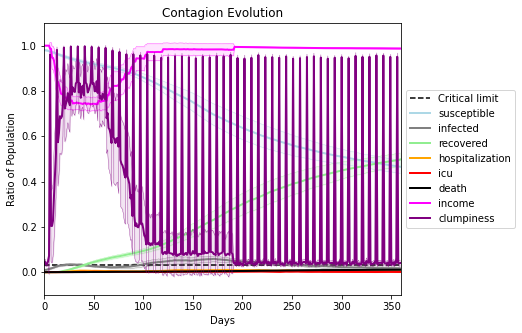

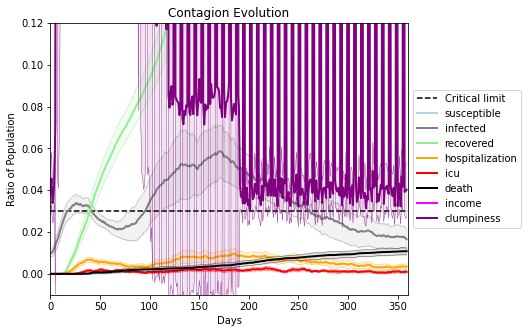

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4059, 17, 4667, 1543, 6718, 6053, 9637, 9100, 4891, 1601, 4405, 7168, 3071, 89, 5134, 6950, 3470, 5362, 7846, 6681]
Average similarity between family members is 0.93719888330748 at temperature -0.993
Average similarity between family and home is 0.9998452807802233 at temperature -1
Average similarity between students and their classroom is 0.5590297752951503 at temperature -0.993
Average classroom occupancy is 4.085714285714285 and number classrooms is 70
Average similarity between workers is 0.8784914643723202 at temperature -0.993
Average office occupancy is 3.4114583333333335 and number offices is 192
Average friend similarity for adults: 0.8558815957082542 for kids: 0.6816170515599055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5323521944038272
avg restaurant similarity 0.5719013550921147
avg restaurant similarity 0.5389893878434358
avg restaurant similarity 0.49373762115075853
avg restaurant similarity 0.544369775863344
avg restaurant similarity 0.592150456644184
avg restaurant similarity 0.49610403571803074
avg restaurant similarity 0.5853471456818254
avg restaurant similarity 0.5426107245287043
avg restaurant similarity 0.5938351562557722
avg restaurant similarity 0.5389995638872306
avg restaurant similarity 0.5459167861902454
avg restaurant similarity 0.5670856816522182
avg restaurant similarity 0.5214842981526996
avg restaurant similarity 0.5594136529024174
avg restaurant similarity 0.5428611508986908
avg restaurant similarity 0.5177633123608422
avg restaurant similarity 0.5459685976540278
avg restaurant similarity 0.5499736832998178
avg restaurant similarity 0.5430738853521114
avg restaurant similarity 0.5566332976701321
avg restaurant similarity 0.5451120585951275
avg restau

avg restaurant similarity 0.576659288931813
avg restaurant similarity 0.5773205719400339
avg restaurant similarity 0.5314268973586069
avg restaurant similarity 0.519586897349622
avg restaurant similarity 0.5425860692124288
avg restaurant similarity 0.5612643626524542
avg restaurant similarity 0.5654168012225167
avg restaurant similarity 0.49967733755415217
avg restaurant similarity 0.5423083759367746
avg restaurant similarity 0.5671173606773323
avg restaurant similarity 0.5719881635968788
avg restaurant similarity 0.551626417918645
avg restaurant similarity 0.5665593005968451
avg restaurant similarity 0.5455544324779826
avg restaurant similarity 0.5839844787975323
avg restaurant similarity 0.554023870374687
avg restaurant similarity 0.5355031120679188
avg restaurant similarity 0.5937895884291832
avg restaurant similarity 0.5234965919159043
avg restaurant similarity 0.5674290114383725
avg restaurant similarity 0.5065697752921082
avg restaurant similarity 0.5032872693951714
avg restauran

avg restaurant similarity 0.5716261764407491
avg restaurant similarity 0.5305672242446682
avg restaurant similarity 0.5078852245942896
avg restaurant similarity 0.6175441827494544
avg restaurant similarity 0.5290420635557385
avg restaurant similarity 0.6087725181912662
avg restaurant similarity 0.5841184997458958
avg restaurant similarity 0.501269197854071
avg restaurant similarity 0.647238021311481
avg restaurant similarity 0.5905122285212159
avg restaurant similarity 0.6493018888587184
avg restaurant similarity 0.583226607559431
avg restaurant similarity 0.6832197310040267
avg restaurant similarity 0.5689741137072981
avg restaurant similarity 0.62638971673414
avg restaurant similarity 0.5817798985841156
avg restaurant similarity 0.44615884596524963
avg restaurant similarity 0.5633980015625739
avg restaurant similarity 0.5577142680154239
avg restaurant similarity 0.5187954891589278
avg restaurant similarity 0.4930854884793134
avg restaurant similarity 0.5277670192403148
avg restaurant

avg restaurant similarity 0.6097466632110905
avg restaurant similarity 0.5401760086867309
avg restaurant similarity 0.5522700460688442
avg restaurant similarity 0.6373509206718583
avg restaurant similarity 0.625075358234852
avg restaurant similarity 0.5737021928604913
avg restaurant similarity 0.5267307104511589
avg restaurant similarity 0.5499043028823647
avg restaurant similarity 0.48176891619372647
avg restaurant similarity 0.52761793413194
avg restaurant similarity 0.5272525513644314
avg restaurant similarity 0.512574016872974
avg restaurant similarity 0.5877388267686763
avg restaurant similarity 0.5328732529712195
avg restaurant similarity 0.5899823763375742
avg restaurant similarity 0.5329978789331327
avg restaurant similarity 0.5732817371003173
avg restaurant similarity 0.6381490041632172
avg restaurant similarity 0.5586487585560475
avg restaurant similarity 0.5805341180890286
avg restaurant similarity 0.44972206767990985
avg restaurant similarity 0.5847923148520735
avg restaura

avg restaurant similarity 0.4843743871791068
avg restaurant similarity 0.5642007474743561
avg restaurant similarity 0.5176883784504396
avg restaurant similarity 0.4959745493752523
avg restaurant similarity 0.5572433899292283
avg restaurant similarity 0.5100812142647103
avg restaurant similarity 0.5872767193431827
avg restaurant similarity 0.5856759799359859
avg restaurant similarity 0.5249217824595153
avg restaurant similarity 0.5684119173908929
avg restaurant similarity 0.5482752271158409
avg restaurant similarity 0.5170201898997292
avg restaurant similarity 0.48379335084496367
avg restaurant similarity 0.5800246286314982
avg restaurant similarity 0.5571737064349647
avg restaurant similarity 0.551301509186695
avg restaurant similarity 0.49690341472973
avg restaurant similarity 0.5796103382294703
avg restaurant similarity 0.5119247162265242
avg restaurant similarity 0.5944047856463703
avg restaurant similarity 0.5854965506466212
avg restaurant similarity 0.5707725851994507
avg restaura

avg restaurant similarity 0.5917025979282189
avg restaurant similarity 0.49853056654807826
avg restaurant similarity 0.5666069249276632
avg restaurant similarity 0.5423464078791198
avg restaurant similarity 0.5442129609840637
avg restaurant similarity 0.5616223352788468
avg restaurant similarity 0.4785263477132294
avg restaurant similarity 0.48705238671810913
avg restaurant similarity 0.5537712293333173
avg restaurant similarity 0.5419475340590573
avg restaurant similarity 0.5988482303331937
avg restaurant similarity 0.5143466652127623
avg restaurant similarity 0.5486121689595673
avg restaurant similarity 0.56863137924936
avg restaurant similarity 0.49254768904766383
avg restaurant similarity 0.5216499008891922
avg restaurant similarity 0.5561442994961439
avg restaurant similarity 0.5051925254160864
avg restaurant similarity 0.5632880528578189
avg restaurant similarity 0.601325293273291
avg restaurant similarity 0.6031500499202478
avg restaurant similarity 0.5505900944641341
avg restau

avg restaurant similarity 0.45490878832544446
avg restaurant similarity 0.5752908053355421
avg restaurant similarity 0.6026758929896437
avg restaurant similarity 0.5348371334337281
avg restaurant similarity 0.5781998964306185
avg restaurant similarity 0.5838114826970652
avg restaurant similarity 0.5227121564681791
avg restaurant similarity 0.5132358923422029
avg restaurant similarity 0.5222513270765591
avg restaurant similarity 0.5973770077617769
avg restaurant similarity 0.5720906940818281
avg restaurant similarity 0.5880868781411731
avg restaurant similarity 0.5539507019679666
avg restaurant similarity 0.5626112987020664
avg restaurant similarity 0.614197768954857
avg restaurant similarity 0.5451222276538905
avg restaurant similarity 0.5475661657385245
avg restaurant similarity 0.5508499322022665
avg restaurant similarity 0.5518905569040566
avg restaurant similarity 0.5555307189503924
avg restaurant similarity 0.5738221933343607
avg restaurant similarity 0.5362766734742148
avg restau

avg restaurant similarity 0.48820666234281607
avg restaurant similarity 0.5820842088266721
avg restaurant similarity 0.6387312436255869
avg restaurant similarity 0.5451693400733323
avg restaurant similarity 0.597824499763284
avg restaurant similarity 0.5384915108883777
avg restaurant similarity 0.5556586464830847
avg restaurant similarity 0.5015103446700184
avg restaurant similarity 0.5051154831223901
avg restaurant similarity 0.5382304598464194
avg restaurant similarity 0.5491769223453719
avg restaurant similarity 0.5769486480811932
avg restaurant similarity 0.5971890442076585
avg restaurant similarity 0.5123245247358124
avg restaurant similarity 0.5479538222437457
avg restaurant similarity 0.5503817823798083
avg restaurant similarity 0.5397893368901282
avg restaurant similarity 0.561749126107233
avg restaurant similarity 0.5835650922907737
avg restaurant similarity 0.48563475072878964
avg restaurant similarity 0.573036652141044
avg restaurant similarity 0.5468102935640915
avg restaur

avg restaurant similarity 0.5613329140320023
avg restaurant similarity 0.5438708407713088
avg restaurant similarity 0.54648672471271
avg restaurant similarity 0.5733902847502778
avg restaurant similarity 0.5634561517143218
avg restaurant similarity 0.5998709389783758
avg restaurant similarity 0.568722718034512
avg restaurant similarity 0.5637686084456126
avg restaurant similarity 0.5932246168114415
avg restaurant similarity 0.5687155199776378
avg restaurant similarity 0.542183694965055
avg restaurant similarity 0.5975682137650906
avg restaurant similarity 0.5396096010323274
avg restaurant similarity 0.545062445871835
avg restaurant similarity 0.5683538448307413
avg restaurant similarity 0.5265184203843433
avg restaurant similarity 0.5391917616169721
avg restaurant similarity 0.5443769762025549
avg restaurant similarity 0.5644912790545358
avg restaurant similarity 0.5353568530477062
avg restaurant similarity 0.5537220274171086
avg restaurant similarity 0.5900716760640659
avg restaurant 

avg restaurant similarity 0.5816158384860541
avg restaurant similarity 0.513398181037912
avg restaurant similarity 0.5942429651865392
avg restaurant similarity 0.5336560961534906
avg restaurant similarity 0.578178026286648
avg restaurant similarity 0.5298702682972181
avg restaurant similarity 0.5503532905280079
avg restaurant similarity 0.5452711041225997
avg restaurant similarity 0.541827378464088
avg restaurant similarity 0.5592367615507021
avg restaurant similarity 0.6004360846140803
avg restaurant similarity 0.5276389669234058
avg restaurant similarity 0.6060412153812395
avg restaurant similarity 0.5484226463861892
avg restaurant similarity 0.5732549475437304
avg restaurant similarity 0.589442870779511
avg restaurant similarity 0.6441734095362506
avg restaurant similarity 0.5026882612297805
avg restaurant similarity 0.5956653225947273
avg restaurant similarity 0.6077482342693052
avg restaurant similarity 0.5807110964322272
avg restaurant similarity 0.5619098152550209
avg restaurant

avg restaurant similarity 0.5896588791477498
avg restaurant similarity 0.607126346175585
avg restaurant similarity 0.5915373649288349
avg restaurant similarity 0.5632608100305092
avg restaurant similarity 0.526165951771591
avg restaurant similarity 0.5970689035792651
avg restaurant similarity 0.5427613372029085
avg restaurant similarity 0.584962942604375
avg restaurant similarity 0.5353974780374673
avg restaurant similarity 0.5781418881821352
avg restaurant similarity 0.5903247916656909
avg restaurant similarity 0.5615366426625082
avg restaurant similarity 0.5770135036652565
avg restaurant similarity 0.5587908205820806
avg restaurant similarity 0.5754439486019319
avg restaurant similarity 0.5546803698373987
avg restaurant similarity 0.5580855994759822
avg restaurant similarity 0.5515351160362487
avg restaurant similarity 0.5293904671194847
avg restaurant similarity 0.5389027988962715
avg restaurant similarity 0.5187264475714657
avg restaurant similarity 0.5749433306569628
avg restauran

avg restaurant similarity 0.5225484480809872
avg restaurant similarity 0.5312942828149317
avg restaurant similarity 0.5340957397090292
avg restaurant similarity 0.5505432250211462
avg restaurant similarity 0.5557695049429554
avg restaurant similarity 0.5248545612917991
avg restaurant similarity 0.5571639400798728
avg restaurant similarity 0.602831573386039
avg restaurant similarity 0.5694967119708909
avg restaurant similarity 0.5868684298229332
avg restaurant similarity 0.5711987197585134
avg restaurant similarity 0.5565342458599494
avg restaurant similarity 0.5460615486457254
avg restaurant similarity 0.5935045041359498
avg restaurant similarity 0.5801260350745158
avg restaurant similarity 0.5261796904492586
avg restaurant similarity 0.5244514136924382
avg restaurant similarity 0.5649706648689692
avg restaurant similarity 0.5590551738470344
avg restaurant similarity 0.550799894057727
avg restaurant similarity 0.49509139005501346
avg restaurant similarity 0.6079171285901687
avg restaur

avg restaurant similarity 0.5671558374248233
avg restaurant similarity 0.5423331947550981
avg restaurant similarity 0.5347504934473913
avg restaurant similarity 0.5239817491468113
avg restaurant similarity 0.5735131307410051
avg restaurant similarity 0.5405292368768779
avg restaurant similarity 0.515823468990945
avg restaurant similarity 0.5504902933047116
avg restaurant similarity 0.5646874768681698
avg restaurant similarity 0.5835565658607641
avg restaurant similarity 0.5576970355298191
avg restaurant similarity 0.5068372726285085
avg restaurant similarity 0.5738520899410642
avg restaurant similarity 0.553654840215971
avg restaurant similarity 0.6233098358706511
avg restaurant similarity 0.5469805737382776
avg restaurant similarity 0.5506507577269127
avg restaurant similarity 0.5761032079043437
avg restaurant similarity 0.5487154672848528
avg restaurant similarity 0.5399122661500025
avg restaurant similarity 0.6020462564599468
avg restaurant similarity 0.5304484592741351
avg restaura

avg restaurant similarity 0.5836841344212187
avg restaurant similarity 0.5504015633518001
avg restaurant similarity 0.5510969382772462
avg restaurant similarity 0.5625116255862036
avg restaurant similarity 0.5040086747424473
avg restaurant similarity 0.5776006971267778
avg restaurant similarity 0.5825330936681816
avg restaurant similarity 0.5361169544883013
avg restaurant similarity 0.5312213165987397
avg restaurant similarity 0.5645974427749014
avg restaurant similarity 0.563899726111036
avg restaurant similarity 0.5823597593059731
avg restaurant similarity 0.5314011559578726
avg restaurant similarity 0.5899482944667125
avg restaurant similarity 0.5675003086463336
avg restaurant similarity 0.6164225698701722
avg restaurant similarity 0.6183381961914318
avg restaurant similarity 0.5885276574346299
avg restaurant similarity 0.5257972657655927
avg restaurant similarity 0.5031867686023832
avg restaurant similarity 0.5755057356099339
avg restaurant similarity 0.544181241353107
avg restaura

avg restaurant similarity 0.5443169723236359
avg restaurant similarity 0.5652543783584937
avg restaurant similarity 0.5619578925782988
avg restaurant similarity 0.561491488681722
avg restaurant similarity 0.5750921531781202
avg restaurant similarity 0.539028809309274
avg restaurant similarity 0.55258040491671
avg restaurant similarity 0.5553887805151887
avg restaurant similarity 0.5437209609131178
avg restaurant similarity 0.5437122248512384
avg restaurant similarity 0.5583190231511888
avg restaurant similarity 0.5524614842470335
avg restaurant similarity 0.5374447864686064
avg restaurant similarity 0.526992019404816
avg restaurant similarity 0.6157226297664034
avg restaurant similarity 0.5797719249620527
avg restaurant similarity 0.5719997279938497
avg restaurant similarity 0.5789007584403671
avg restaurant similarity 0.4958217122654048
avg restaurant similarity 0.6020255506812855
avg restaurant similarity 0.6144190791390001
avg restaurant similarity 0.5888811935795094
avg restaurant 

avg restaurant similarity 0.6033172888120589
avg restaurant similarity 0.5148958893251195
avg restaurant similarity 0.6186408791896101
avg restaurant similarity 0.6003719388169492
avg restaurant similarity 0.561129588852946
avg restaurant similarity 0.583021726754534
avg restaurant similarity 0.5415925805088161
avg restaurant similarity 0.5213380145808936
avg restaurant similarity 0.5662202559914999
avg restaurant similarity 0.54385026457853
avg restaurant similarity 0.5856851023655264
avg restaurant similarity 0.5687979108173719
avg restaurant similarity 0.5131991800894867
avg restaurant similarity 0.5535781906943016
avg restaurant similarity 0.635780640737605
avg restaurant similarity 0.4929122529258665
avg restaurant similarity 0.5642599540185694
avg restaurant similarity 0.4736130168547596
avg restaurant similarity 0.5332867634923191
avg restaurant similarity 0.5928650368126146
avg restaurant similarity 0.5440579259316064
avg restaurant similarity 0.5973701889522566
avg restaurant 

avg restaurant similarity 0.5569521838340943
avg restaurant similarity 0.5353325632154213
avg restaurant similarity 0.48076652493233657
avg restaurant similarity 0.5290403807562334
avg restaurant similarity 0.536485059657102
avg restaurant similarity 0.5434990877378764
avg restaurant similarity 0.587586694277374
avg restaurant similarity 0.5389402661394821
avg restaurant similarity 0.5272727936646254
avg restaurant similarity 0.5749029146729695
avg restaurant similarity 0.5828477754455258
avg restaurant similarity 0.5726682006750924
avg restaurant similarity 0.5402674205450154
avg restaurant similarity 0.6057505000398793
avg restaurant similarity 0.5833263705146244
avg restaurant similarity 0.5625192374547512
avg restaurant similarity 0.5029816851260908
avg restaurant similarity 0.5130388186752364
avg restaurant similarity 0.5439799815369569
avg restaurant similarity 0.5771757374256831
avg restaurant similarity 0.5465658120015771
avg restaurant similarity 0.5455598443685145
avg restaur

avg restaurant similarity 0.5525904319371352
avg restaurant similarity 0.5490127501716686
avg restaurant similarity 0.5652251227755208
avg restaurant similarity 0.5343982633057646
avg restaurant similarity 0.5548295453409186
avg restaurant similarity 0.5778828123299624
avg restaurant similarity 0.5347774627832971
avg restaurant similarity 0.5842220703108352
avg restaurant similarity 0.5940230973962726
avg restaurant similarity 0.5217918419284997
avg restaurant similarity 0.5991598379641
avg restaurant similarity 0.5080242872362731
avg restaurant similarity 0.5814766925257389
avg restaurant similarity 0.5301102442844672
avg restaurant similarity 0.5696570880655096
avg restaurant similarity 0.556068614520066
avg restaurant similarity 0.5215613703880774
avg restaurant similarity 0.513790749535089
avg restaurant similarity 0.5900657201225983
avg restaurant similarity 0.5587028335470248
avg restaurant similarity 0.5160218723018468
avg restaurant similarity 0.5595741008240178
avg restaurant 

avg restaurant similarity 0.47760979870746145
avg restaurant similarity 0.5167054002443475
avg restaurant similarity 0.5585520164630048
avg restaurant similarity 0.5535874217878047
avg restaurant similarity 0.5596710326764177
avg restaurant similarity 0.5064615190541044
avg restaurant similarity 0.5700044119367305
avg restaurant similarity 0.5410010655976506
avg restaurant similarity 0.5716685298766307
avg restaurant similarity 0.5817861507906328
avg restaurant similarity 0.5803351101516506
avg restaurant similarity 0.557419854246025
avg restaurant similarity 0.5831973741307676
avg restaurant similarity 0.5928748090682456
avg restaurant similarity 0.6233204732598212
avg restaurant similarity 0.5727866233594425
avg restaurant similarity 0.5419612011041984
avg restaurant similarity 0.5288829620378226
avg restaurant similarity 0.5696772846381604
avg restaurant similarity 0.5678127770083901
avg restaurant similarity 0.5522059069855914
avg restaurant similarity 0.5783476998228664
avg restau

avg restaurant similarity 0.6065955458383201
avg restaurant similarity 0.5529246766156106
avg restaurant similarity 0.555183976440505
avg restaurant similarity 0.5454180403687309
avg restaurant similarity 0.5621996443769093
avg restaurant similarity 0.511778115240731
avg restaurant similarity 0.5666300882489235
avg restaurant similarity 0.5081490201886788
avg restaurant similarity 0.5234180181869865
avg restaurant similarity 0.5252700052396065
avg restaurant similarity 0.5567622868644772
avg restaurant similarity 0.5482623389432159
avg restaurant similarity 0.5540685962488862
avg restaurant similarity 0.5194139514710376
avg restaurant similarity 0.5242870291620824
avg restaurant similarity 0.5670800911247886
avg restaurant similarity 0.5817002254323654
avg restaurant similarity 0.5634853815573293
avg restaurant similarity 0.5433750233530682
avg restaurant similarity 0.5595705352490956
avg restaurant similarity 0.5933953119965863
avg restaurant similarity 0.571436323556916
avg restauran

avg restaurant similarity 0.5160738789339795
avg restaurant similarity 0.5037722488865666
avg restaurant similarity 0.504052160027001
avg restaurant similarity 0.4709553867520327
avg restaurant similarity 0.5202400817472584
avg restaurant similarity 0.49069654473056257
avg restaurant similarity 0.48833627931384294
avg restaurant similarity 0.47813528298106533
avg restaurant similarity 0.49468877139222933
avg restaurant similarity 0.4685229453027214
avg restaurant similarity 0.4795658131879686
avg restaurant similarity 0.5105885127372989
avg restaurant similarity 0.48366464802573705
avg restaurant similarity 0.4669943974692098
avg restaurant similarity 0.4992003376835244
avg restaurant similarity 0.546144754475803
avg restaurant similarity 0.5294812293703275
avg restaurant similarity 0.5825440237311186
avg restaurant similarity 0.47859070047423213
avg restaurant similarity 0.5139093083694414
avg restaurant similarity 0.5050393223539794
avg restaurant similarity 0.49546641153543963
avg r

avg restaurant similarity 0.4755486588642873
avg restaurant similarity 0.5085953718989523
avg restaurant similarity 0.526099907056338
avg restaurant similarity 0.5128227855829803
avg restaurant similarity 0.514988826008803
avg restaurant similarity 0.49924161530475025
avg restaurant similarity 0.5021280414028502
avg restaurant similarity 0.5237362084780118
avg restaurant similarity 0.5297259285612232
avg restaurant similarity 0.49355983593378866
avg restaurant similarity 0.4865184464596133
avg restaurant similarity 0.44238454889563283
avg restaurant similarity 0.4954657644572778
avg restaurant similarity 0.5229150165328181
avg restaurant similarity 0.5234363771383836
avg restaurant similarity 0.46768682561702496
avg restaurant similarity 0.5050886195110028
avg restaurant similarity 0.5308157504408864
avg restaurant similarity 0.4597878636935586
avg restaurant similarity 0.5093372789146486
avg restaurant similarity 0.4985880885444674
avg restaurant similarity 0.4624598591933804
avg rest

avg restaurant similarity 0.5762348220075428
avg restaurant similarity 0.5779124974263838
avg restaurant similarity 0.5525703034241806
avg restaurant similarity 0.585086404739759
avg restaurant similarity 0.524141765028455
avg restaurant similarity 0.5655631517870334
avg restaurant similarity 0.6036252344135582
avg restaurant similarity 0.5244863962664267
avg restaurant similarity 0.5386166834681398
avg restaurant similarity 0.5707114830484403
avg restaurant similarity 0.5871300682559224
avg restaurant similarity 0.527893440157064
avg restaurant similarity 0.5320926961821809
avg restaurant similarity 0.5419923278794831
avg restaurant similarity 0.5951706584031895
avg restaurant similarity 0.5180730503108467
avg restaurant similarity 0.5909391260961891
avg restaurant similarity 0.5953804819028904
avg restaurant similarity 0.5703132841397047
avg restaurant similarity 0.5435915930336335
avg restaurant similarity 0.5442993763803713
avg restaurant similarity 0.5312286932279962
avg restauran

avg restaurant similarity 0.5686140895483598
avg restaurant similarity 0.5875169571471769
avg restaurant similarity 0.5244580558440878
avg restaurant similarity 0.5750527199272928
avg restaurant similarity 0.5653602276103996
avg restaurant similarity 0.549622539981615
avg restaurant similarity 0.5752965381629472
avg restaurant similarity 0.5448327838552649
avg restaurant similarity 0.5434457529416158
avg restaurant similarity 0.5088757008963007
avg restaurant similarity 0.5249200473781639
avg restaurant similarity 0.5480389173113147
avg restaurant similarity 0.5327481093935341
avg restaurant similarity 0.5312736198985712
avg restaurant similarity 0.6172413236404011
avg restaurant similarity 0.5045020638350699
avg restaurant similarity 0.5852298672822862
avg restaurant similarity 0.5025158090820963
avg restaurant similarity 0.5431871267363915
avg restaurant similarity 0.5888181053215458
avg restaurant similarity 0.5206065894562587
avg restaurant similarity 0.5348973788210022
avg restaur

avg restaurant similarity 0.502537651675775
avg restaurant similarity 0.5562002691753165
avg restaurant similarity 0.5313987170562394
avg restaurant similarity 0.675660910916787
avg restaurant similarity 0.5532481596469949
avg restaurant similarity 0.6151196033578911
avg restaurant similarity 0.559243346870006
avg restaurant similarity 0.5761288734456482
avg restaurant similarity 0.6016305596446326
avg restaurant similarity 0.5706628435605294
avg restaurant similarity 0.5618766696728708
avg restaurant similarity 0.6180732744176028
avg restaurant similarity 0.6315147446347272
avg restaurant similarity 0.590940992603524
avg restaurant similarity 0.5968390835208846
avg restaurant similarity 0.5830142134307273
avg restaurant similarity 0.5655440662302605
avg restaurant similarity 0.625898036474697
avg restaurant similarity 0.5726645883824402
avg restaurant similarity 0.5851165108657456
avg restaurant similarity 0.5965144160642083
avg restaurant similarity 0.6598951539258685
avg restaurant 

avg restaurant similarity 0.6070830123897406
avg restaurant similarity 0.5627909448184437
avg restaurant similarity 0.5571476091151499
avg restaurant similarity 0.6035183733149261
avg restaurant similarity 0.5942590749026089
avg restaurant similarity 0.5679247738928386
avg restaurant similarity 0.6290362143159862
avg restaurant similarity 0.670811721133824
avg restaurant similarity 0.6213998732300716
avg restaurant similarity 0.5997941443174241
avg restaurant similarity 0.5670007436443518
avg restaurant similarity 0.6117088970262127
avg restaurant similarity 0.6360846799284603
avg restaurant similarity 0.7011212196076141
avg restaurant similarity 0.5423907087768302
avg restaurant similarity 0.5854357336612745
avg restaurant similarity 0.5939034728466178
avg restaurant similarity 0.613434337695348
avg restaurant similarity 0.5817207164201614
avg restaurant similarity 0.6490550633501199
avg restaurant similarity 0.6418492174657967
avg restaurant similarity 0.5967966052887551
avg restaura

avg restaurant similarity 0.5228907856753927
avg restaurant similarity 0.5521051175650037
avg restaurant similarity 0.5518208040009395
avg restaurant similarity 0.6109384068945967
avg restaurant similarity 0.5795444857164654
avg restaurant similarity 0.5371367774803621
avg restaurant similarity 0.5508717775138311
avg restaurant similarity 0.5422580552711275
avg restaurant similarity 0.5610134503307764
avg restaurant similarity 0.5455830061158708
avg restaurant similarity 0.5781009447009395
avg restaurant similarity 0.5693743946792942
avg restaurant similarity 0.5764220049286082
avg restaurant similarity 0.5513982046902661
avg restaurant similarity 0.6067308670019532
avg restaurant similarity 0.5112498453665129
avg restaurant similarity 0.5338111572594468
avg restaurant similarity 0.5756968988060996
avg restaurant similarity 0.5764523446043379
avg restaurant similarity 0.5605880077606968
avg restaurant similarity 0.5710163055810551
avg restaurant similarity 0.5428103540371064
avg restau

avg restaurant similarity 0.5475182142106009
avg restaurant similarity 0.5514343043154682
avg restaurant similarity 0.5640879524748548
avg restaurant similarity 0.563882066736083
avg restaurant similarity 0.5983624055334897
avg restaurant similarity 0.5782181141208463
avg restaurant similarity 0.5457316078317906
avg restaurant similarity 0.5357203736283241
avg restaurant similarity 0.5735817195656284
avg restaurant similarity 0.6198770277723235
avg restaurant similarity 0.5303706926672881
avg restaurant similarity 0.5562796822226246
avg restaurant similarity 0.5824056894294583
avg restaurant similarity 0.5406822983001738
avg restaurant similarity 0.5768555417000768
avg restaurant similarity 0.5638946624392964
avg restaurant similarity 0.571084380323049
avg restaurant similarity 0.5496944468314189
avg restaurant similarity 0.5312814187723941
avg restaurant similarity 0.5736874467836302
avg restaurant similarity 0.5323390761760568
avg restaurant similarity 0.5532461452262419
avg restaura

avg restaurant similarity 0.5628370726111422
avg restaurant similarity 0.5223775117749663
avg restaurant similarity 0.5350107043238148
avg restaurant similarity 0.5281587124464449
avg restaurant similarity 0.5169613653320735
avg restaurant similarity 0.5497194268182864
avg restaurant similarity 0.5404129960354807
avg restaurant similarity 0.5302562532326986
avg restaurant similarity 0.5535342643287835
avg restaurant similarity 0.5470211416266099
avg restaurant similarity 0.5285185474007649
avg restaurant similarity 0.5311571089597167
avg restaurant similarity 0.4753699952169179
avg restaurant similarity 0.5518074801392889
avg restaurant similarity 0.5231930340993225
avg restaurant similarity 0.5335001170826327
avg restaurant similarity 0.5652550593633128
avg restaurant similarity 0.5066558717739778
avg restaurant similarity 0.5385071904974715
avg restaurant similarity 0.5217391686011107
avg restaurant similarity 0.49067715853688765
avg restaurant similarity 0.5565450682753958
avg resta

avg restaurant similarity 0.5513167935096175
avg restaurant similarity 0.5656855994384649
avg restaurant similarity 0.5446259534220009
avg restaurant similarity 0.5233922379749547
avg restaurant similarity 0.4820040245797076
avg restaurant similarity 0.5158132771245696
avg restaurant similarity 0.5014328951578858
avg restaurant similarity 0.5059239667745953
avg restaurant similarity 0.5004149204473388
avg restaurant similarity 0.5111875651158578
avg restaurant similarity 0.5100838276953326
avg restaurant similarity 0.5324568532448187
avg restaurant similarity 0.5349577011223992
avg restaurant similarity 0.5077465617212606
avg restaurant similarity 0.5797679483840981
avg restaurant similarity 0.5270803711222242
avg restaurant similarity 0.529040299509922
avg restaurant similarity 0.4960964097171832
avg restaurant similarity 0.5677724269168763
avg restaurant similarity 0.5369190458382852
avg restaurant similarity 0.5536535543417055
avg restaurant similarity 0.5169876432473414
avg restaur

avg restaurant similarity 0.566797636365842
avg restaurant similarity 0.5377911313341787
avg restaurant similarity 0.5065429817270748
avg restaurant similarity 0.5130504218348486
avg restaurant similarity 0.5858270522202171
avg restaurant similarity 0.5689064371236251
avg restaurant similarity 0.5589739113895396
avg restaurant similarity 0.5403769869154115
avg restaurant similarity 0.5604940606251959
avg restaurant similarity 0.5796900761632168
avg restaurant similarity 0.5517133651552683
avg restaurant similarity 0.5349325100687049
avg restaurant similarity 0.5027765004165101
avg restaurant similarity 0.5615171074239054
avg restaurant similarity 0.5375791136569027
avg restaurant similarity 0.5293802952638988
avg restaurant similarity 0.5256656103831391
avg restaurant similarity 0.5557692496753083
avg restaurant similarity 0.5234797912654583
avg restaurant similarity 0.5271747824822192
avg restaurant similarity 0.48706183181316987
avg restaurant similarity 0.5785457941156036
avg restau

avg restaurant similarity 0.5610179028394807
avg restaurant similarity 0.5242627339924378
avg restaurant similarity 0.5229273702712847
avg restaurant similarity 0.5321888479980574
avg restaurant similarity 0.5618405162020087
avg restaurant similarity 0.5468490103215807
avg restaurant similarity 0.5380379582757259
avg restaurant similarity 0.5774342839011314
avg restaurant similarity 0.510184621292256
avg restaurant similarity 0.5304775012325659
avg restaurant similarity 0.5522649051523053
avg restaurant similarity 0.565723751689924
avg restaurant similarity 0.5672035370570911
avg restaurant similarity 0.5240709247123001
avg restaurant similarity 0.5072024678050228
avg restaurant similarity 0.5130146434543792
avg restaurant similarity 0.6006527412228615
avg restaurant similarity 0.5398954152409787
avg restaurant similarity 0.5754053992886686
avg restaurant similarity 0.5464056917282962
avg restaurant similarity 0.6010375724953784
avg restaurant similarity 0.5398568695738921
avg restaura

avg restaurant similarity 0.5361199991033324
avg restaurant similarity 0.5401086811564976
avg restaurant similarity 0.5202110740480905
avg restaurant similarity 0.6420040822746146
avg restaurant similarity 0.5306248303566617
avg restaurant similarity 0.5678714141034354
avg restaurant similarity 0.5522975710800725
avg restaurant similarity 0.49936240675922655
avg restaurant similarity 0.5662282836211324
avg restaurant similarity 0.527775757596805
avg restaurant similarity 0.4996255100982886
avg restaurant similarity 0.5908030452529821
avg restaurant similarity 0.5015385136599259
avg restaurant similarity 0.46407572617312487
avg restaurant similarity 0.5432879738482047
avg restaurant similarity 0.532028131873686
avg restaurant similarity 0.5497661197646643
avg restaurant similarity 0.5413129893006697
avg restaurant similarity 0.4944922582883528
avg restaurant similarity 0.558408447976223
avg restaurant similarity 0.5644046827584628
avg restaurant similarity 0.5448332937621259
avg restaur

avg restaurant similarity 0.5102039368655552
avg restaurant similarity 0.4794979465677056
avg restaurant similarity 0.5536254039325256
avg restaurant similarity 0.48697586393473163
avg restaurant similarity 0.47333438610534495
avg restaurant similarity 0.5918827819644877
avg restaurant similarity 0.498123160965706
avg restaurant similarity 0.47587900915031184
avg restaurant similarity 0.5867286022969751
avg restaurant similarity 0.4966395234338997
avg restaurant similarity 0.5398398770702376
avg restaurant similarity 0.5373782415254902
avg restaurant similarity 0.4894241816726832
avg restaurant similarity 0.5199584140882945
avg restaurant similarity 0.5261908770543721
avg restaurant similarity 0.5718562526358928
avg restaurant similarity 0.5621844136523239
avg restaurant similarity 0.5771696895815664
avg restaurant similarity 0.5272409420561998
avg restaurant similarity 0.5411745156653418
avg restaurant similarity 0.5926992551797554
avg restaurant similarity 0.5093669458045385
avg rest

avg restaurant similarity 0.5619411100127363
avg restaurant similarity 0.6024079583170825
avg restaurant similarity 0.5704125332890857
avg restaurant similarity 0.5776017377251034
avg restaurant similarity 0.595514729027137
avg restaurant similarity 0.6108701633385892
avg restaurant similarity 0.6130122399765524
avg restaurant similarity 0.6432457107756606
avg restaurant similarity 0.5887599085060065
avg restaurant similarity 0.5359882385154232
avg restaurant similarity 0.6383855330970366
avg restaurant similarity 0.5807656777220488
avg restaurant similarity 0.5853848158753969
avg restaurant similarity 0.5936114099490342
avg restaurant similarity 0.5902052801261449
avg restaurant similarity 0.6333804883191385
avg restaurant similarity 0.5325475245991254
avg restaurant similarity 0.6403929355859644
avg restaurant similarity 0.527388461514135
avg restaurant similarity 0.6558197756964993
avg restaurant similarity 0.5695784451010479
avg restaurant similarity 0.5766730150934837
avg restaura

avg restaurant similarity 0.5859961207747474
avg restaurant similarity 0.564659757285576
avg restaurant similarity 0.5722474749051458
avg restaurant similarity 0.5885194366214622
avg restaurant similarity 0.6017671341854222
avg restaurant similarity 0.5814218516041029
avg restaurant similarity 0.6040379750823555
avg restaurant similarity 0.5832380123741677
avg restaurant similarity 0.5663326964382518
avg restaurant similarity 0.6164911023469147
avg restaurant similarity 0.6176358265324643
avg restaurant similarity 0.6067644100356717
avg restaurant similarity 0.5486301496441699
avg restaurant similarity 0.5613147478911846
avg restaurant similarity 0.5796589184895236
avg restaurant similarity 0.5784269919260857
avg restaurant similarity 0.5658712639490938
avg restaurant similarity 0.5564945534596197
avg restaurant similarity 0.5883208502878439
avg restaurant similarity 0.5594664404115502
avg restaurant similarity 0.5817488490532122
avg restaurant similarity 0.6039821745172932
avg restaur

avg restaurant similarity 0.590378768880695
avg restaurant similarity 0.5457112727235629
avg restaurant similarity 0.5575202996840761
avg restaurant similarity 0.5709826644179795
avg restaurant similarity 0.5506396213463588
avg restaurant similarity 0.5726512704810932
avg restaurant similarity 0.5455808951487716
avg restaurant similarity 0.625823877839637
avg restaurant similarity 0.544420289616694
avg restaurant similarity 0.588131004654588
avg restaurant similarity 0.6171735229510386
avg restaurant similarity 0.5343646409916615
avg restaurant similarity 0.5812969979984018
avg restaurant similarity 0.5592871424806833
avg restaurant similarity 0.5669940297421587
avg restaurant similarity 0.5785884859378237
avg restaurant similarity 0.570789352241194
avg restaurant similarity 0.6366050706790521
avg restaurant similarity 0.5154639659621705
avg restaurant similarity 0.5678461025728309
avg restaurant similarity 0.5656250366964516
avg restaurant similarity 0.6100417875810099
avg restaurant 

avg restaurant similarity 0.5508831586917702
avg restaurant similarity 0.530868038685005
avg restaurant similarity 0.580370886832129
avg restaurant similarity 0.584283459014367
avg restaurant similarity 0.5207456302650599
avg restaurant similarity 0.6138327022185819
avg restaurant similarity 0.5745842743357676
avg restaurant similarity 0.6081975522562681
avg restaurant similarity 0.5351937940254661
avg restaurant similarity 0.5142445906412814
avg restaurant similarity 0.5970830559145274
avg restaurant similarity 0.6039169951958989
avg restaurant similarity 0.5276871047995518
avg restaurant similarity 0.555301621372679
avg restaurant similarity 0.5657715301656112
avg restaurant similarity 0.5469900418224297
avg restaurant similarity 0.5509425535496478
avg restaurant similarity 0.5323571797784823
avg restaurant similarity 0.5411483898448876
avg restaurant similarity 0.5143474376118387
avg restaurant similarity 0.5534593035236358
avg restaurant similarity 0.5782322651364071
avg restaurant

avg restaurant similarity 0.6131050279758995
avg restaurant similarity 0.5855919243462969
avg restaurant similarity 0.5796399854743274
avg restaurant similarity 0.5609684138756871
avg restaurant similarity 0.611410832256588
avg restaurant similarity 0.5923221291620528
avg restaurant similarity 0.6344990000391338
avg restaurant similarity 0.542208224754284
avg restaurant similarity 0.5089655236359649
avg restaurant similarity 0.6371842480697886
avg restaurant similarity 0.6090036490868057
avg restaurant similarity 0.6123668703563803
avg restaurant similarity 0.6940759035959175
avg restaurant similarity 0.6395565886034067
avg restaurant similarity 0.5821179813059473
avg restaurant similarity 0.6015769717482101
avg restaurant similarity 0.4940215836109153
avg restaurant similarity 0.5956853002008979
avg restaurant similarity 0.5977253181222861
avg restaurant similarity 0.6723024483661353
avg restaurant similarity 0.5724001919364459
avg restaurant similarity 0.63722899067028
avg restaurant

avg restaurant similarity 0.6424562655805782
avg restaurant similarity 0.5817547865287622
avg restaurant similarity 0.6061315162144897
avg restaurant similarity 0.6170369799235094
avg restaurant similarity 0.5949217485658335
avg restaurant similarity 0.5578341238084
avg restaurant similarity 0.6130740472718066
avg restaurant similarity 0.5502198648715715
avg restaurant similarity 0.5951103994151236
avg restaurant similarity 0.5674165445305055
avg restaurant similarity 0.6106156376513326
avg restaurant similarity 0.5763565048387469
avg restaurant similarity 0.583717271661992
avg restaurant similarity 0.6140572088087967
avg restaurant similarity 0.5581506443002002
avg restaurant similarity 0.5772743578833739
avg restaurant similarity 0.5472345983949161
avg restaurant similarity 0.6246509100227475
avg restaurant similarity 0.5782643111182505
avg restaurant similarity 0.6077444252064536
avg restaurant similarity 0.6406615566808301
avg restaurant similarity 0.5448630406877707
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

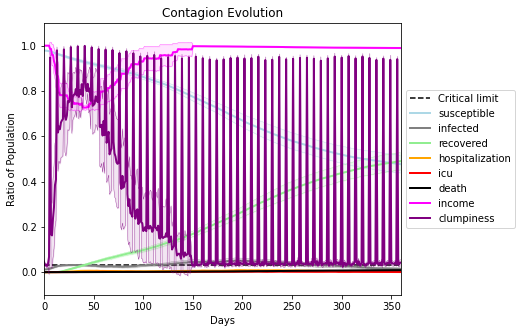

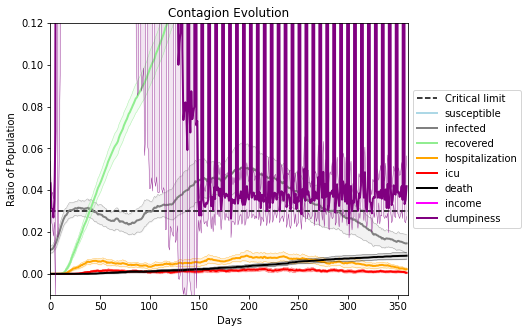

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5893, 8013, 3874, 1197, 4714, 4696, 1189, 3515, 6327, 4681, 2901, 3145, 3504, 6650, 403, 1935, 7202, 9362, 2516, 2740]
Average similarity between family members is 0.9269697739106975 at temperature -0.992
Average similarity between family and home is 0.9998588407456136 at temperature -1
Average similarity between students and their classroom is 0.5050188058007412 at temperature -0.992
Average classroom occupancy is 3.75 and number classrooms is 72
Average similarity between workers is 0.8515481865750545 at temperature -0.992
Average office occupancy is 3.436548223350254 and number offices is 197
Average friend similarity for adults: 0.8503981806673875 for kids: 0.6556258680852415
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneou

avg restaurant similarity 0.536334573279827
avg restaurant similarity 0.5461595253647276
avg restaurant similarity 0.4938090210489906
avg restaurant similarity 0.5023820301476047
avg restaurant similarity 0.4889609084688987
avg restaurant similarity 0.47601631100251973
avg restaurant similarity 0.5031354747614579
avg restaurant similarity 0.5486421921985537
avg restaurant similarity 0.5465044381393473
avg restaurant similarity 0.5259556087632384
avg restaurant similarity 0.4816012451627756
avg restaurant similarity 0.573252034407707
avg restaurant similarity 0.5124781729536588
avg restaurant similarity 0.5470448965756798
avg restaurant similarity 0.4590252147919864
avg restaurant similarity 0.4182623044599077
avg restaurant similarity 0.5107652679604827
avg restaurant similarity 0.5080751949059875
avg restaurant similarity 0.5321433401928541
avg restaurant similarity 0.5023512408095557
avg restaurant similarity 0.49271658949606767
avg restaurant similarity 0.5052714642760834
avg restau

avg restaurant similarity 0.45733666421263536
avg restaurant similarity 0.5353033342020658
avg restaurant similarity 0.4683256571712174
avg restaurant similarity 0.5065532290388303
avg restaurant similarity 0.473243581295009
avg restaurant similarity 0.5319763645989771
avg restaurant similarity 0.4505663126207503
avg restaurant similarity 0.5092732418061248
avg restaurant similarity 0.4939385934432746
avg restaurant similarity 0.5182181268538892
avg restaurant similarity 0.4455342551915584
avg restaurant similarity 0.525208292378995
avg restaurant similarity 0.5449285117202735
avg restaurant similarity 0.5104098048785917
avg restaurant similarity 0.49622403004736954
avg restaurant similarity 0.4700052015470522
avg restaurant similarity 0.4985334620974744
avg restaurant similarity 0.49629195372079077
avg restaurant similarity 0.49359064884488785
avg restaurant similarity 0.5497686380182243
avg restaurant similarity 0.4830776418871223
avg restaurant similarity 0.524623103176065
avg resta

avg restaurant similarity 0.5232696316160997
avg restaurant similarity 0.604220224169451
avg restaurant similarity 0.5381369251130663
avg restaurant similarity 0.5073188613081063
avg restaurant similarity 0.5377400381162133
avg restaurant similarity 0.5695784999860453
avg restaurant similarity 0.5103361337540153
avg restaurant similarity 0.5718390293755061
avg restaurant similarity 0.4982620888570305
avg restaurant similarity 0.5369661479074485
avg restaurant similarity 0.5999655704667469
avg restaurant similarity 0.5316021806302008
avg restaurant similarity 0.5105210667916856
avg restaurant similarity 0.5552925290379194
avg restaurant similarity 0.5606549827868087
avg restaurant similarity 0.5443272206856324
avg restaurant similarity 0.526565273318514
avg restaurant similarity 0.5118741828659191
avg restaurant similarity 0.5365895942249516
avg restaurant similarity 0.48744977037918547
avg restaurant similarity 0.5369865620881085
avg restaurant similarity 0.4805042695570719
avg restaur

avg restaurant similarity 0.5923489085261489
avg restaurant similarity 0.5357366237616815
avg restaurant similarity 0.5337326624358162
avg restaurant similarity 0.583642151161577
avg restaurant similarity 0.566344478593269
avg restaurant similarity 0.5969308209470184
avg restaurant similarity 0.6302368674533557
avg restaurant similarity 0.5114876819519197
avg restaurant similarity 0.5201673345379741
avg restaurant similarity 0.5642659212961605
avg restaurant similarity 0.5021596904451571
avg restaurant similarity 0.5533294827927676
avg restaurant similarity 0.5477346506863925
avg restaurant similarity 0.4990003188429604
avg restaurant similarity 0.5013740204114813
avg restaurant similarity 0.5533754387006771
avg restaurant similarity 0.5451925952962969
avg restaurant similarity 0.5810772128933586
avg restaurant similarity 0.5761051989024908
avg restaurant similarity 0.5450662473346172
avg restaurant similarity 0.5798142753889955
avg restaurant similarity 0.5367211299500717
avg restaura

avg restaurant similarity 0.4777486381591939
avg restaurant similarity 0.5117286761277695
avg restaurant similarity 0.5015762192404264
avg restaurant similarity 0.5076787472108036
avg restaurant similarity 0.5042761442054923
avg restaurant similarity 0.5548335447906918
avg restaurant similarity 0.4901516915675188
avg restaurant similarity 0.5693867543879367
avg restaurant similarity 0.5083983402934433
avg restaurant similarity 0.5229814744001507
avg restaurant similarity 0.49690183733027316
avg restaurant similarity 0.507945711996038
avg restaurant similarity 0.5286105760200622
avg restaurant similarity 0.5519027872708863
avg restaurant similarity 0.5403940042947746
avg restaurant similarity 0.5162203080446395
avg restaurant similarity 0.5104298831446947
avg restaurant similarity 0.4641680324804422
avg restaurant similarity 0.4858315924692105
avg restaurant similarity 0.5421605701018185
avg restaurant similarity 0.5085924402769404
avg restaurant similarity 0.5413693562502183
avg restau

avg restaurant similarity 0.52284036487131
avg restaurant similarity 0.5574460918901807
avg restaurant similarity 0.5086198294239486
avg restaurant similarity 0.5696892438306862
avg restaurant similarity 0.5407094396266039
avg restaurant similarity 0.5696067302329583
avg restaurant similarity 0.5418050633343852
avg restaurant similarity 0.49431685990184865
avg restaurant similarity 0.5130010250047644
avg restaurant similarity 0.5083349142597873
avg restaurant similarity 0.5554840306149033
avg restaurant similarity 0.4977364154328308
avg restaurant similarity 0.5396268252045928
avg restaurant similarity 0.5500292438564042
avg restaurant similarity 0.5281839504618847
avg restaurant similarity 0.5407612937056969
avg restaurant similarity 0.5016307874822458
avg restaurant similarity 0.5046309874701751
avg restaurant similarity 0.5070760219457975
avg restaurant similarity 0.48228780876563904
avg restaurant similarity 0.4861588501009295
avg restaurant similarity 0.4731199131951904
avg restau

avg restaurant similarity 0.5557542995149278
avg restaurant similarity 0.6148888181601848
avg restaurant similarity 0.6168625343244807
avg restaurant similarity 0.5316872206463699
avg restaurant similarity 0.5817577281606714
avg restaurant similarity 0.5541427489346213
avg restaurant similarity 0.6203854866684421
avg restaurant similarity 0.6155763283852903
avg restaurant similarity 0.5859856102190232
avg restaurant similarity 0.509676288629791
avg restaurant similarity 0.5379564810190635
avg restaurant similarity 0.5915372767376861
avg restaurant similarity 0.6093121758350188
avg restaurant similarity 0.5260867288796507
avg restaurant similarity 0.5536949204226516
avg restaurant similarity 0.5806516289640459
avg restaurant similarity 0.5702326612113
avg restaurant similarity 0.5247676516942213
avg restaurant similarity 0.612977808297132
avg restaurant similarity 0.5874301739525984
avg restaurant similarity 0.6101744687093824
avg restaurant similarity 0.5154406343641701
avg restaurant 

avg restaurant similarity 0.5948183594831022
avg restaurant similarity 0.5955811491020664
avg restaurant similarity 0.5598711272093868
avg restaurant similarity 0.5623784310595586
avg restaurant similarity 0.5277899378625343
avg restaurant similarity 0.5410007219617682
avg restaurant similarity 0.532762964354878
avg restaurant similarity 0.566830361790243
avg restaurant similarity 0.6165190776828401
avg restaurant similarity 0.4905875695444798
avg restaurant similarity 0.5196897421850114
avg restaurant similarity 0.5611233072848343
avg restaurant similarity 0.5447702258602497
avg restaurant similarity 0.5435661935735973
avg restaurant similarity 0.5319062663661213
avg restaurant similarity 0.5176967025407773
avg restaurant similarity 0.5530472350933152
avg restaurant similarity 0.5287903536989187
avg restaurant similarity 0.5862557573247845
avg restaurant similarity 0.5571507827908462
avg restaurant similarity 0.5951548661917382
avg restaurant similarity 0.5927404230434264
avg restaura

avg restaurant similarity 0.5255436966844227
avg restaurant similarity 0.5358976326579363
avg restaurant similarity 0.5171054476496835
avg restaurant similarity 0.5253196151857514
avg restaurant similarity 0.49697620562170675
avg restaurant similarity 0.515184978184517
avg restaurant similarity 0.5139839938204199
avg restaurant similarity 0.4892320428522967
avg restaurant similarity 0.525194953942866
avg restaurant similarity 0.4649076723226185
avg restaurant similarity 0.5188225982097608
avg restaurant similarity 0.49569805563034786
avg restaurant similarity 0.4937044496754962
avg restaurant similarity 0.49161599608003925
avg restaurant similarity 0.4741774565046732
avg restaurant similarity 0.5012621965198264
avg restaurant similarity 0.4975203150882903
avg restaurant similarity 0.4560943778662561
avg restaurant similarity 0.4747149796653443
avg restaurant similarity 0.4912800028045381
avg restaurant similarity 0.49866516358990043
avg restaurant similarity 0.4717857714618636
avg rest

avg restaurant similarity 0.48359272213752835
avg restaurant similarity 0.5139194779136645
avg restaurant similarity 0.4818472477894333
avg restaurant similarity 0.5166413478286048
avg restaurant similarity 0.5329752187809003
avg restaurant similarity 0.48159445477616225
avg restaurant similarity 0.4407524752646869
avg restaurant similarity 0.4689784584633939
avg restaurant similarity 0.5045144341815108
avg restaurant similarity 0.4674533457667681
avg restaurant similarity 0.5178299643761275
avg restaurant similarity 0.4984667369435227
avg restaurant similarity 0.49674758088038756
avg restaurant similarity 0.45336044429544375
avg restaurant similarity 0.49788261250785176
avg restaurant similarity 0.43600480944806014
avg restaurant similarity 0.5065746850739113
avg restaurant similarity 0.4699572163425913
avg restaurant similarity 0.5233834416917714
avg restaurant similarity 0.49507578614560216
avg restaurant similarity 0.507593749338585
avg restaurant similarity 0.45611459354895756
avg

avg restaurant similarity 0.48327421559278283
avg restaurant similarity 0.527234887529148
avg restaurant similarity 0.5073633758921431
avg restaurant similarity 0.4872748585294767
avg restaurant similarity 0.47976429975391693
avg restaurant similarity 0.49747466336226
avg restaurant similarity 0.514631892766613
avg restaurant similarity 0.5342134993375249
avg restaurant similarity 0.540815420947101
avg restaurant similarity 0.4829778132580939
avg restaurant similarity 0.5162556470168351
avg restaurant similarity 0.511956318059631
avg restaurant similarity 0.5095538700675777
avg restaurant similarity 0.5061218457041688
avg restaurant similarity 0.5422277373128707
avg restaurant similarity 0.4657666381342253
avg restaurant similarity 0.5471168305993761
avg restaurant similarity 0.5092087946177452
avg restaurant similarity 0.5537106141852727
avg restaurant similarity 0.488263532610029
avg restaurant similarity 0.5234451850613813
avg restaurant similarity 0.4758761388301427
avg restaurant 

avg restaurant similarity 0.5192041805482029
avg restaurant similarity 0.513302122300097
avg restaurant similarity 0.5553636694739283
avg restaurant similarity 0.5210710044632959
avg restaurant similarity 0.5189788718338325
avg restaurant similarity 0.5007732477337676
avg restaurant similarity 0.5243169586359967
avg restaurant similarity 0.5455604254561699
avg restaurant similarity 0.48046499682853533
avg restaurant similarity 0.5047564036267496
avg restaurant similarity 0.5311780904201837
avg restaurant similarity 0.5158427984480816
avg restaurant similarity 0.500883501732056
avg restaurant similarity 0.4930342428231791
avg restaurant similarity 0.5181212966632132
avg restaurant similarity 0.5006629882654474
avg restaurant similarity 0.5121696515062
avg restaurant similarity 0.502925951108177
avg restaurant similarity 0.49194725627845826
avg restaurant similarity 0.5733375748343563
avg restaurant similarity 0.5383946351856024
avg restaurant similarity 0.4816657889864762
avg restaurant

avg restaurant similarity 0.5874694361174811
avg restaurant similarity 0.5711444270543503
avg restaurant similarity 0.5863802718234975
avg restaurant similarity 0.5335601675690278
avg restaurant similarity 0.584752136969401
avg restaurant similarity 0.5834411552407426
avg restaurant similarity 0.5797481834137326
avg restaurant similarity 0.5639529981437627
avg restaurant similarity 0.5377459121927669
avg restaurant similarity 0.550181452617234
avg restaurant similarity 0.5580390205714746
avg restaurant similarity 0.5125057381944935
avg restaurant similarity 0.5365233062311527
avg restaurant similarity 0.5379446905952577
avg restaurant similarity 0.573171302120796
avg restaurant similarity 0.5503862152979114
avg restaurant similarity 0.5335692199978862
avg restaurant similarity 0.5581186341568597
avg restaurant similarity 0.5664296143369151
avg restaurant similarity 0.6203583845867466
avg restaurant similarity 0.5047230430937844
avg restaurant similarity 0.566950862437754
avg restaurant

avg restaurant similarity 0.5308107500769652
avg restaurant similarity 0.49925383918010746
avg restaurant similarity 0.6160470695853523
avg restaurant similarity 0.6041192861227581
avg restaurant similarity 0.5789281177898937
avg restaurant similarity 0.5776962061142376
avg restaurant similarity 0.5482790043838593
avg restaurant similarity 0.5423842552553115
avg restaurant similarity 0.49303013565773574
avg restaurant similarity 0.5754293592199222
avg restaurant similarity 0.563605349620727
avg restaurant similarity 0.5757884082663366
avg restaurant similarity 0.5366327652189063
avg restaurant similarity 0.5336135731552775
avg restaurant similarity 0.5527947927598258
avg restaurant similarity 0.5999874142810147
avg restaurant similarity 0.6281013007007986
avg restaurant similarity 0.5473155938302556
avg restaurant similarity 0.6007591434356516
avg restaurant similarity 0.5652184919295579
avg restaurant similarity 0.5690307510841087
avg restaurant similarity 0.5785532795463028
avg resta

avg restaurant similarity 0.5043050743007634
avg restaurant similarity 0.5477665560813703
avg restaurant similarity 0.5445876333567157
avg restaurant similarity 0.5426886289640942
avg restaurant similarity 0.5384349592848306
avg restaurant similarity 0.4890980056270521
avg restaurant similarity 0.5613112789736986
avg restaurant similarity 0.5411988230783051
avg restaurant similarity 0.5256478415356389
avg restaurant similarity 0.5633768637208063
avg restaurant similarity 0.5934143332403689
avg restaurant similarity 0.5632167761544234
avg restaurant similarity 0.5739883040414282
avg restaurant similarity 0.5554629387306143
avg restaurant similarity 0.5511632922042342
avg restaurant similarity 0.6038592746228855
avg restaurant similarity 0.5494155128097586
avg restaurant similarity 0.5898489410820221
avg restaurant similarity 0.5164233704771234
avg restaurant similarity 0.5475845943463822
avg restaurant similarity 0.548253976119788
avg restaurant similarity 0.5143819174120072
avg restaur

avg restaurant similarity 0.5748810069041583
avg restaurant similarity 0.5092666962874993
avg restaurant similarity 0.5546220485446334
avg restaurant similarity 0.5112906025130816
avg restaurant similarity 0.599135104954487
avg restaurant similarity 0.5410007351768341
avg restaurant similarity 0.4842401668528033
avg restaurant similarity 0.5173540507836225
avg restaurant similarity 0.5825792002251435
avg restaurant similarity 0.5268593207850513
avg restaurant similarity 0.5039418998281656
avg restaurant similarity 0.47640190223801
avg restaurant similarity 0.5568823810978225
avg restaurant similarity 0.521276956649144
avg restaurant similarity 0.5533159246583753
avg restaurant similarity 0.5560022631848967
avg restaurant similarity 0.5400098786333026
avg restaurant similarity 0.4988441031056038
avg restaurant similarity 0.4703544913852695
avg restaurant similarity 0.5785532310254353
avg restaurant similarity 0.5533860367305473
avg restaurant similarity 0.5808553189216562
avg restaurant

avg restaurant similarity 0.4978117539688294
avg restaurant similarity 0.5114274197435539
avg restaurant similarity 0.5214589509955401
avg restaurant similarity 0.4898509345891029
avg restaurant similarity 0.5012931355857724
avg restaurant similarity 0.553822832530357
avg restaurant similarity 0.5485198260592592
avg restaurant similarity 0.5066221464051452
avg restaurant similarity 0.48820189022879856
avg restaurant similarity 0.5157432691375494
avg restaurant similarity 0.48014071910923833
avg restaurant similarity 0.5095777273678127
avg restaurant similarity 0.5453667610452945
avg restaurant similarity 0.5363409456151067
avg restaurant similarity 0.47294626151732166
avg restaurant similarity 0.5358551565784927
avg restaurant similarity 0.47995044547947896
avg restaurant similarity 0.4858042111905148
avg restaurant similarity 0.5050681224573903
avg restaurant similarity 0.5079707767485296
avg restaurant similarity 0.5352251165030941
avg restaurant similarity 0.5086886333350886
avg res

avg restaurant similarity 0.49285098847983155
avg restaurant similarity 0.5375686825723351
avg restaurant similarity 0.48844630342828554
avg restaurant similarity 0.5143693802420704
avg restaurant similarity 0.5234614151309673
avg restaurant similarity 0.5256787057629289
avg restaurant similarity 0.4979336600709887
avg restaurant similarity 0.46051721003179025
avg restaurant similarity 0.5542140531002862
avg restaurant similarity 0.5410558900202491
avg restaurant similarity 0.45930201440027885
avg restaurant similarity 0.5223290585404975
avg restaurant similarity 0.5087847493124559
avg restaurant similarity 0.4908486938918811
avg restaurant similarity 0.49696285855343886
avg restaurant similarity 0.46954512116211217
avg restaurant similarity 0.511152587175719
avg restaurant similarity 0.48780089504512864
avg restaurant similarity 0.5006427195128326
avg restaurant similarity 0.5007377521274454
avg restaurant similarity 0.4808577229813018
avg restaurant similarity 0.5224816700844985
avg 

avg restaurant similarity 0.5262360090550177
avg restaurant similarity 0.5015412580984708
avg restaurant similarity 0.501966949524326
avg restaurant similarity 0.5676728626656417
avg restaurant similarity 0.4811051699184147
avg restaurant similarity 0.5323240829720406
avg restaurant similarity 0.5803782527845426
avg restaurant similarity 0.5011913934971285
avg restaurant similarity 0.5268920429941353
avg restaurant similarity 0.5800328171716941
avg restaurant similarity 0.5459708087916179
avg restaurant similarity 0.5286248859206814
avg restaurant similarity 0.4885179516354528
avg restaurant similarity 0.5538245214655988
avg restaurant similarity 0.5700825443607648
avg restaurant similarity 0.5619278900745934
avg restaurant similarity 0.47852596142496584
avg restaurant similarity 0.555328356727402
avg restaurant similarity 0.5110931230103445
avg restaurant similarity 0.5621864480785596
avg restaurant similarity 0.5944015818063625
avg restaurant similarity 0.5202457641598969
avg restaur

avg restaurant similarity 0.5551971998678896
avg restaurant similarity 0.5257153776903171
avg restaurant similarity 0.5333914192650369
avg restaurant similarity 0.5302274479019891
avg restaurant similarity 0.5544345476100508
avg restaurant similarity 0.538891413051708
avg restaurant similarity 0.5811851304132369
avg restaurant similarity 0.5593955625791176
avg restaurant similarity 0.5212115864205773
avg restaurant similarity 0.5911252661231187
avg restaurant similarity 0.5742890537948493
avg restaurant similarity 0.5259838385904959
avg restaurant similarity 0.5545802149552368
avg restaurant similarity 0.4912888613904643
avg restaurant similarity 0.4699837570323597
avg restaurant similarity 0.5410638275061976
avg restaurant similarity 0.5160402495078842
avg restaurant similarity 0.5530793051284085
avg restaurant similarity 0.5768674042037557
avg restaurant similarity 0.5308357955472447
avg restaurant similarity 0.5732483458958203
avg restaurant similarity 0.5715472017130602
avg restaur

avg restaurant similarity 0.5813926058237741
avg restaurant similarity 0.5056491041042712
avg restaurant similarity 0.5374900937908594
avg restaurant similarity 0.5462959723293039
avg restaurant similarity 0.5071205843395237
avg restaurant similarity 0.5506443872325416
avg restaurant similarity 0.5180987040229312
avg restaurant similarity 0.5145475914170646
avg restaurant similarity 0.5290036117586608
avg restaurant similarity 0.5338328295899821
avg restaurant similarity 0.5600732912961705
avg restaurant similarity 0.5008181268413013
avg restaurant similarity 0.5191957140607638
avg restaurant similarity 0.5350413264400389
avg restaurant similarity 0.5471554414474686
avg restaurant similarity 0.5451361171666035
avg restaurant similarity 0.4774801866676649
avg restaurant similarity 0.5515693362590464
avg restaurant similarity 0.5183216063820604
avg restaurant similarity 0.5190183780629625
avg restaurant similarity 0.506931068242711
avg restaurant similarity 0.5496671400213503
avg restaur

avg restaurant similarity 0.5169534411073199
avg restaurant similarity 0.5307391398206145
avg restaurant similarity 0.5277356705173314
avg restaurant similarity 0.5705609124082794
avg restaurant similarity 0.5015676097111069
avg restaurant similarity 0.5361671414960395
avg restaurant similarity 0.4884371793122816
avg restaurant similarity 0.5134944078433231
avg restaurant similarity 0.44066536097954867
avg restaurant similarity 0.5564497214592672
avg restaurant similarity 0.49451939028337366
avg restaurant similarity 0.5707945934999143
avg restaurant similarity 0.5268294400797505
avg restaurant similarity 0.5020235831834324
avg restaurant similarity 0.4795522232579475
avg restaurant similarity 0.5459752497849036
avg restaurant similarity 0.5342407936229305
avg restaurant similarity 0.5202152896589567
avg restaurant similarity 0.46514194741948933
avg restaurant similarity 0.45211679511648434
avg restaurant similarity 0.559279742538706
avg restaurant similarity 0.5123345242718959
avg res

avg restaurant similarity 0.560785630645062
avg restaurant similarity 0.5798312370827174
avg restaurant similarity 0.5204856571146633
avg restaurant similarity 0.5194459207693869
avg restaurant similarity 0.569955734283878
avg restaurant similarity 0.5163362773333867
avg restaurant similarity 0.539637975471147
avg restaurant similarity 0.5470141728150452
avg restaurant similarity 0.5435391971374085
avg restaurant similarity 0.533297788957769
avg restaurant similarity 0.5382104358057724
avg restaurant similarity 0.5894985196205947
avg restaurant similarity 0.5508083278155723
avg restaurant similarity 0.5638647994496048
avg restaurant similarity 0.5758492324740953
avg restaurant similarity 0.6387308535856552
avg restaurant similarity 0.5066429860334704
avg restaurant similarity 0.616733869151512
avg restaurant similarity 0.5276471430022822
avg restaurant similarity 0.5948631719816666
avg restaurant similarity 0.5222603473391829
avg restaurant similarity 0.5559881647274322
avg restaurant 

avg restaurant similarity 0.5562091941634598
avg restaurant similarity 0.5153563187185305
avg restaurant similarity 0.5493721558398509
avg restaurant similarity 0.5127885371484373
avg restaurant similarity 0.5504286105623301
avg restaurant similarity 0.5239085411073174
avg restaurant similarity 0.561058677567239
avg restaurant similarity 0.5457995916835153
avg restaurant similarity 0.5713508165963577
avg restaurant similarity 0.5726631210626653
avg restaurant similarity 0.5115256911621712
avg restaurant similarity 0.5674161391668548
avg restaurant similarity 0.611244589018455
avg restaurant similarity 0.5853101293151256
avg restaurant similarity 0.5153995717075638
avg restaurant similarity 0.5128287119642757
avg restaurant similarity 0.5798358370916646
avg restaurant similarity 0.5798964418589628
avg restaurant similarity 0.5514727404383589
avg restaurant similarity 0.576995367596816
avg restaurant similarity 0.6155204693845209
avg restaurant similarity 0.5214774901899397
avg restauran

avg restaurant similarity 0.5745888149193947
avg restaurant similarity 0.524167205840395
avg restaurant similarity 0.5311274269064863
avg restaurant similarity 0.5215879399479298
avg restaurant similarity 0.4807363960640398
avg restaurant similarity 0.4974118736789931
avg restaurant similarity 0.5139636396061252
avg restaurant similarity 0.47755336819016464
avg restaurant similarity 0.5747960580735417
avg restaurant similarity 0.5428105635691893
avg restaurant similarity 0.509814456571014
avg restaurant similarity 0.5403908364908157
avg restaurant similarity 0.4821423064469305
avg restaurant similarity 0.5557486707055558
avg restaurant similarity 0.5311705529088903
avg restaurant similarity 0.5185028044396476
avg restaurant similarity 0.4668893552770966
avg restaurant similarity 0.5721572732629585
avg restaurant similarity 0.5123286328562248
avg restaurant similarity 0.5148708941703429
avg restaurant similarity 0.5215629550361763
avg restaurant similarity 0.4639909453006927
avg restaur

avg restaurant similarity 0.5685652669903013
avg restaurant similarity 0.5297690699172887
avg restaurant similarity 0.5042954476808107
avg restaurant similarity 0.5319692312659828
avg restaurant similarity 0.5749596056193352
avg restaurant similarity 0.5371679031728613
avg restaurant similarity 0.5225989418711148
avg restaurant similarity 0.4878125403410851
avg restaurant similarity 0.4970693728895363
avg restaurant similarity 0.5779024913452919
avg restaurant similarity 0.5285804535591108
avg restaurant similarity 0.5383872215018706
avg restaurant similarity 0.511078768986369
avg restaurant similarity 0.5485143139171609
avg restaurant similarity 0.5197093772406619
avg restaurant similarity 0.51503233202251
avg restaurant similarity 0.5073839146680607
avg restaurant similarity 0.4885524286039401
avg restaurant similarity 0.5799163745307196
avg restaurant similarity 0.4996476418066389
avg restaurant similarity 0.46792433583700754
avg restaurant similarity 0.5119475410459668
avg restaura

avg restaurant similarity 0.5183386665106624
avg restaurant similarity 0.5249421381341929
avg restaurant similarity 0.5865816824977402
avg restaurant similarity 0.47572516144910976
avg restaurant similarity 0.5187326732226354
avg restaurant similarity 0.47172315323460784
avg restaurant similarity 0.5672281012673634
avg restaurant similarity 0.563589445153579
avg restaurant similarity 0.5671590447589053
avg restaurant similarity 0.5350438227144066
avg restaurant similarity 0.47437383193873556
avg restaurant similarity 0.564817282823522
avg restaurant similarity 0.4312238444785869
avg restaurant similarity 0.5201188122320809
avg restaurant similarity 0.4877951651319927
avg restaurant similarity 0.5412456462461627
avg restaurant similarity 0.5609344160923164
avg restaurant similarity 0.4982245768048659
avg restaurant similarity 0.5715952402258179
avg restaurant similarity 0.4615356530516401
avg restaurant similarity 0.5982702840384825
avg restaurant similarity 0.5436113224383823
avg resta

avg restaurant similarity 0.5662442914875044
avg restaurant similarity 0.4872213110373078
avg restaurant similarity 0.47778868062913254
avg restaurant similarity 0.5732125387582678
avg restaurant similarity 0.483354181752076
avg restaurant similarity 0.5105484318518231
avg restaurant similarity 0.5656232928960666
avg restaurant similarity 0.50246272487447
avg restaurant similarity 0.5344234614172017
avg restaurant similarity 0.5545041109486321
avg restaurant similarity 0.4653443724647941
avg restaurant similarity 0.4852677470208258
avg restaurant similarity 0.48944422766778467
avg restaurant similarity 0.5042769448206358
avg restaurant similarity 0.5165802131606395
avg restaurant similarity 0.5683367270537991
avg restaurant similarity 0.5681716090048341
avg restaurant similarity 0.542758193448363
avg restaurant similarity 0.5210316271643611
avg restaurant similarity 0.44736531078802566
avg restaurant similarity 0.585225942737838
avg restaurant similarity 0.4770553845427463
avg restaura

avg restaurant similarity 0.5034962920104878
avg restaurant similarity 0.4654208378278602
avg restaurant similarity 0.5050234921636858
avg restaurant similarity 0.49790128744179607
avg restaurant similarity 0.5218607619577413
avg restaurant similarity 0.5444016023420186
avg restaurant similarity 0.5562235624690028
avg restaurant similarity 0.5212445636418834
avg restaurant similarity 0.5172878220699002
avg restaurant similarity 0.5571158924750069
avg restaurant similarity 0.539996949458844
avg restaurant similarity 0.5228207513543776
avg restaurant similarity 0.55144802579633
avg restaurant similarity 0.5494470864711782
avg restaurant similarity 0.5471547171438057
avg restaurant similarity 0.5016948714819974
avg restaurant similarity 0.5203507109691397
avg restaurant similarity 0.5092279283180651
avg restaurant similarity 0.5721805242016534
avg restaurant similarity 0.5453182102534598
avg restaurant similarity 0.49954765698557024
avg restaurant similarity 0.5283275235701367
avg restaur

avg restaurant similarity 0.5209175558261662
avg restaurant similarity 0.5402971500833003
avg restaurant similarity 0.5172873857401218
avg restaurant similarity 0.5309944824651917
avg restaurant similarity 0.5029322566835268
avg restaurant similarity 0.5767334693375371
avg restaurant similarity 0.5363970170696903
avg restaurant similarity 0.5044674448793524
avg restaurant similarity 0.5276925791601492
avg restaurant similarity 0.5158168372117502
avg restaurant similarity 0.5027811981513487
avg restaurant similarity 0.5023229093460212
avg restaurant similarity 0.5256789583576895
avg restaurant similarity 0.5020686237224558
avg restaurant similarity 0.5178421329242469
avg restaurant similarity 0.5199573057297825
avg restaurant similarity 0.5497952007206187
avg restaurant similarity 0.5244511352892436
avg restaurant similarity 0.5226912240798641
avg restaurant similarity 0.49100625142624515
avg restaurant similarity 0.5520753708914924
avg restaurant similarity 0.5180478561882574
avg resta

avg restaurant similarity 0.5114467671326424
avg restaurant similarity 0.48783820125947264
avg restaurant similarity 0.5504439265972295
avg restaurant similarity 0.5784524039140735
avg restaurant similarity 0.5647334870245847
avg restaurant similarity 0.5571317333180833
avg restaurant similarity 0.5724424671953343
avg restaurant similarity 0.513290908149152
avg restaurant similarity 0.5700690086195415
avg restaurant similarity 0.5581933168261017
avg restaurant similarity 0.5324069791862514
avg restaurant similarity 0.5353102898707437
avg restaurant similarity 0.5446138980768734
avg restaurant similarity 0.5587139331938575
avg restaurant similarity 0.5588548456562873
avg restaurant similarity 0.5907979207282716
avg restaurant similarity 0.5019847077547479
avg restaurant similarity 0.5363735152646684
avg restaurant similarity 0.5134223107491792
avg restaurant similarity 0.5593805469961054
avg restaurant similarity 0.5085875150778809
avg restaurant similarity 0.5513304653588055
avg restau

avg restaurant similarity 0.4729909658276388
avg restaurant similarity 0.5544962878996966
avg restaurant similarity 0.5009598824830231
avg restaurant similarity 0.531447825481421
avg restaurant similarity 0.5390834134797416
avg restaurant similarity 0.4484469575125673
avg restaurant similarity 0.5499077740625598
avg restaurant similarity 0.5805010759474284
avg restaurant similarity 0.5475588473475309
avg restaurant similarity 0.5497204123906924
avg restaurant similarity 0.5064191797432857
avg restaurant similarity 0.5274038963821893
avg restaurant similarity 0.5280554735086956
avg restaurant similarity 0.5515701920702941
avg restaurant similarity 0.5219506625818828
avg restaurant similarity 0.4960326470915396
avg restaurant similarity 0.5404945341589441
avg restaurant similarity 0.5224791495363682
avg restaurant similarity 0.5301992630799446
avg restaurant similarity 0.4822043046446202
avg restaurant similarity 0.5968063989910732
avg restaurant similarity 0.5302553004265592
avg restaur

avg restaurant similarity 0.532963365014724
avg restaurant similarity 0.4162962155272004
avg restaurant similarity 0.5122483269656839
avg restaurant similarity 0.47399364221222406
avg restaurant similarity 0.5538823750465272
avg restaurant similarity 0.5138480594696955
avg restaurant similarity 0.49755902579651534
avg restaurant similarity 0.5359459522307028
avg restaurant similarity 0.5912588633763706
avg restaurant similarity 0.509919190939368
avg restaurant similarity 0.5068235721822342
avg restaurant similarity 0.49178231584558657
avg restaurant similarity 0.5434040859290691
avg restaurant similarity 0.5203407995615816
avg restaurant similarity 0.46680033205112575
avg restaurant similarity 0.49715405726712325
avg restaurant similarity 0.662326627628729
avg restaurant similarity 0.47933229142513645
avg restaurant similarity 0.4978418424977941
avg restaurant similarity 0.5615042276359841
avg restaurant similarity 0.495597471131737
avg restaurant similarity 0.48523506082697754
avg res

avg restaurant similarity 0.566631866482297
avg restaurant similarity 0.5224175648594289
avg restaurant similarity 0.5652402643696968
avg restaurant similarity 0.5627912885510459
avg restaurant similarity 0.5386576016528396
avg restaurant similarity 0.5524790724987889
avg restaurant similarity 0.4967485225841116
avg restaurant similarity 0.5417639572169565
avg restaurant similarity 0.4640024865151127
avg restaurant similarity 0.49236946550747324
avg restaurant similarity 0.5264890187958511
avg restaurant similarity 0.4883858797887739
avg restaurant similarity 0.5492275344073956
avg restaurant similarity 0.5303242267764591
avg restaurant similarity 0.49210819947070417
avg restaurant similarity 0.5763635161633652
avg restaurant similarity 0.4841646068649984
avg restaurant similarity 0.508252611068901
avg restaurant similarity 0.594782160459494
avg restaurant similarity 0.5125898487432143
avg restaurant similarity 0.5699800892255505
avg restaurant similarity 0.5355967867830038
avg restaur

avg restaurant similarity 0.4954515756701802
avg restaurant similarity 0.5187008864239625
avg restaurant similarity 0.4585077042451807
avg restaurant similarity 0.5173260149283441
avg restaurant similarity 0.5302198784602521
avg restaurant similarity 0.4709845950443231
avg restaurant similarity 0.47623648535698654
avg restaurant similarity 0.4758842454678918
avg restaurant similarity 0.5294772500809712
avg restaurant similarity 0.47019658462075975
avg restaurant similarity 0.4918346162647399
avg restaurant similarity 0.5016965884978393
avg restaurant similarity 0.47844766520999565
avg restaurant similarity 0.4404837936025978
avg restaurant similarity 0.5092312396872871
avg restaurant similarity 0.5076458854154894
avg restaurant similarity 0.491401373925819
avg restaurant similarity 0.5364495650262879
avg restaurant similarity 0.5066832644725717
avg restaurant similarity 0.47077773127101297
avg restaurant similarity 0.4872564053018281
avg restaurant similarity 0.47991107272838485
avg re

avg restaurant similarity 0.4631386966275996
avg restaurant similarity 0.48509872679872607
avg restaurant similarity 0.4849816411570573
avg restaurant similarity 0.49038974207054625
avg restaurant similarity 0.48791526354249315
avg restaurant similarity 0.48642906453927537
avg restaurant similarity 0.5044392516815346
avg restaurant similarity 0.4711089896169407
avg restaurant similarity 0.5209635926036457
avg restaurant similarity 0.48927540065860003
avg restaurant similarity 0.48962927670292217
avg restaurant similarity 0.4313398723289433
avg restaurant similarity 0.4238357850494772
avg restaurant similarity 0.43975705540873605
avg restaurant similarity 0.45039038323111547
avg restaurant similarity 0.5029232301547154
avg restaurant similarity 0.4652185421878733
avg restaurant similarity 0.5077139673294354
avg restaurant similarity 0.4896878063430054
avg restaurant similarity 0.4945501981486123
avg restaurant similarity 0.4783262033247318
avg restaurant similarity 0.46464557380976845
a

avg restaurant similarity 0.5582199409394972
avg restaurant similarity 0.505444458425179
avg restaurant similarity 0.5503914330426469
avg restaurant similarity 0.5467203732110139
avg restaurant similarity 0.5525097027296318
avg restaurant similarity 0.544555955463414
avg restaurant similarity 0.5326018913509099
avg restaurant similarity 0.5404166429795849
avg restaurant similarity 0.5647352839429252
avg restaurant similarity 0.6120091146216176
avg restaurant similarity 0.5734840510907322
avg restaurant similarity 0.5825256137744825
avg restaurant similarity 0.5987192842050639
avg restaurant similarity 0.6006645983968428
avg restaurant similarity 0.5569141210967046
avg restaurant similarity 0.5255635203679316
avg restaurant similarity 0.5529986552567777
avg restaurant similarity 0.5348553967328588
avg restaurant similarity 0.5551594919420915
avg restaurant similarity 0.49593997344419954
avg restaurant similarity 0.5812711819400637
avg restaurant similarity 0.5641586940182632
avg restaur

avg restaurant similarity 0.5579415400364426
avg restaurant similarity 0.5395585649495366
avg restaurant similarity 0.5540270789801608
avg restaurant similarity 0.5470663062279515
avg restaurant similarity 0.5286446061416793
avg restaurant similarity 0.5345285572510926
avg restaurant similarity 0.5604419743389526
avg restaurant similarity 0.5381591204803069
avg restaurant similarity 0.5378297739635255
avg restaurant similarity 0.5069188393837066
avg restaurant similarity 0.5242204113464329
avg restaurant similarity 0.580751398908516
avg restaurant similarity 0.5130217867973603
avg restaurant similarity 0.5208293206537856
avg restaurant similarity 0.5567565036372244
avg restaurant similarity 0.5355956961810043
avg restaurant similarity 0.554129415857726
avg restaurant similarity 0.5220863593912406
avg restaurant similarity 0.5466959804314536
avg restaurant similarity 0.556605790101382
avg restaurant similarity 0.5061906792971931
avg restaurant similarity 0.5473797239459158
avg restauran

avg restaurant similarity 0.5651548705702981
avg restaurant similarity 0.5222190993088311
avg restaurant similarity 0.4820052283227063
avg restaurant similarity 0.5024596576981676
avg restaurant similarity 0.5632535565733746
avg restaurant similarity 0.5114549824694973
avg restaurant similarity 0.526812131905833
avg restaurant similarity 0.5084581797444024
avg restaurant similarity 0.5710968604610601
avg restaurant similarity 0.5773123460090179
avg restaurant similarity 0.5337028803014151
avg restaurant similarity 0.49118226256885983
avg restaurant similarity 0.5397444045275207
avg restaurant similarity 0.5242147976969946
avg restaurant similarity 0.5196920835212644
avg restaurant similarity 0.4990707145190647
avg restaurant similarity 0.5073759597607571
avg restaurant similarity 0.5001520653977567
avg restaurant similarity 0.5167728136291703
avg restaurant similarity 0.5021608986666629
avg restaurant similarity 0.527012908343637
avg restaurant similarity 0.5233417482667827
avg restaur

avg restaurant similarity 0.5450680989865226
avg restaurant similarity 0.5139569685968206
avg restaurant similarity 0.5458292100777099
avg restaurant similarity 0.48324460998231294
avg restaurant similarity 0.4577623656039399
avg restaurant similarity 0.5384074408268497
avg restaurant similarity 0.5344024381312621
avg restaurant similarity 0.5288589662607557
avg restaurant similarity 0.5692172603902372
avg restaurant similarity 0.5202459852587441
avg restaurant similarity 0.5073601836493001
avg restaurant similarity 0.5422989036733724
avg restaurant similarity 0.5355464917391293
avg restaurant similarity 0.4755855087005121
avg restaurant similarity 0.5277477337527278
avg restaurant similarity 0.500186744745784
avg restaurant similarity 0.5222422651373543
avg restaurant similarity 0.5096662925887384
avg restaurant similarity 0.5250967129545485
avg restaurant similarity 0.559502147003876
avg restaurant similarity 0.49972238114277484
avg restaurant similarity 0.528829945387294
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

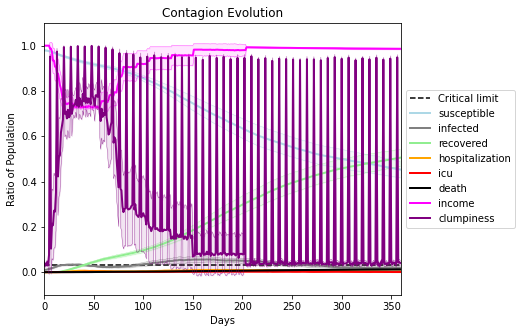

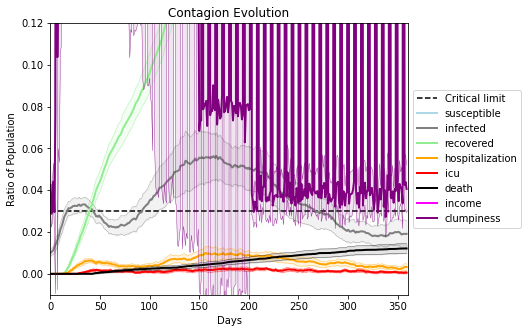

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9805, 4964, 6710, 1373, 4401, 100, 3916, 9743, 9367, 2924, 7002, 7195, 6238, 7395, 4075, 2646, 7812, 4778, 1920, 9562]
Average similarity between family members is 0.9177778242740112 at temperature -0.991
Average similarity between family and home is 0.9998396444256772 at temperature -1
Average similarity between students and their classroom is 0.5106714768834332 at temperature -0.991
Average classroom occupancy is 4.235294117647059 and number classrooms is 68
Average similarity between workers is 0.8432161022033465 at temperature -0.991
Average office occupancy is 3.4554973821989527 and number offices is 191
Average friend similarity for adults: 0.8386893782631059 for kids: 0.65852696707001
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.4677634153509151
avg restaurant similarity 0.5763037858297327
avg restaurant similarity 0.5029530517891004
avg restaurant similarity 0.5371898835860929
avg restaurant similarity 0.5049999024245805
avg restaurant similarity 0.4938051808459155
avg restaurant similarity 0.4969906067765121
avg restaurant similarity 0.5037338244198822
avg restaurant similarity 0.5921406377515838
avg restaurant similarity 0.5410977057932216
avg restaurant similarity 0.4983406436000749
avg restaurant similarity 0.5007320733714953
avg restaurant similarity 0.5683143826377997
avg restaurant similarity 0.4759767586463801
avg restaurant similarity 0.5429144509596965
avg restaurant similarity 0.5097802960382639
avg restaurant similarity 0.4896296689246074
avg restaurant similarity 0.46382284044141214
avg restaurant similarity 0.5028601638199346
avg restaurant similarity 0.5210454790805615
avg restaurant similarity 0.5444793926321237
avg restaurant similarity 0.5292937825659937
avg resta

avg restaurant similarity 0.5311220261336125
avg restaurant similarity 0.5227053821605038
avg restaurant similarity 0.5450281711766569
avg restaurant similarity 0.5247261325326349
avg restaurant similarity 0.4933003724471321
avg restaurant similarity 0.5784373751286292
avg restaurant similarity 0.5506377766489888
avg restaurant similarity 0.5230310320176287
avg restaurant similarity 0.5098749263153443
avg restaurant similarity 0.5377536772944603
avg restaurant similarity 0.4474088422954847
avg restaurant similarity 0.510337486105906
avg restaurant similarity 0.5244599752925746
avg restaurant similarity 0.5341748913917614
avg restaurant similarity 0.5101749771018677
avg restaurant similarity 0.5842232342473772
avg restaurant similarity 0.49365438413789764
avg restaurant similarity 0.4711601090696702
avg restaurant similarity 0.4389540746273766
avg restaurant similarity 0.5019243483700718
avg restaurant similarity 0.46607082708987635
avg restaurant similarity 0.5401529310353914
avg resta

avg restaurant similarity 0.5386507394078792
avg restaurant similarity 0.5530180916647518
avg restaurant similarity 0.5359557932732952
avg restaurant similarity 0.5284580977991769
avg restaurant similarity 0.5223398219557904
avg restaurant similarity 0.5684264261231876
avg restaurant similarity 0.5109666623753534
avg restaurant similarity 0.5320857326861748
avg restaurant similarity 0.49102329480863627
avg restaurant similarity 0.5269246758153955
avg restaurant similarity 0.5634488494183395
avg restaurant similarity 0.52241676315814
avg restaurant similarity 0.5386620687637328
avg restaurant similarity 0.5397308773222542
avg restaurant similarity 0.5194281278224063
avg restaurant similarity 0.5550613476305953
avg restaurant similarity 0.5930687139487169
avg restaurant similarity 0.4952256509707667
avg restaurant similarity 0.5652110508835451
avg restaurant similarity 0.49883527153665186
avg restaurant similarity 0.5242117480606266
avg restaurant similarity 0.5493548771641201
avg restau

avg restaurant similarity 0.5870454897862898
avg restaurant similarity 0.5416010669207232
avg restaurant similarity 0.5300631227287411
avg restaurant similarity 0.5183315160391444
avg restaurant similarity 0.530329339265886
avg restaurant similarity 0.557148286012848
avg restaurant similarity 0.5092217595296855
avg restaurant similarity 0.5573640012251011
avg restaurant similarity 0.6306062905659655
avg restaurant similarity 0.4404492333425276
avg restaurant similarity 0.5515923034906388
avg restaurant similarity 0.5121725422642555
avg restaurant similarity 0.511114170517465
avg restaurant similarity 0.4723363992250215
avg restaurant similarity 0.49358008610169857
avg restaurant similarity 0.5002884897711272
avg restaurant similarity 0.5062461173274105
avg restaurant similarity 0.5534676658291892
avg restaurant similarity 0.46631485233796083
avg restaurant similarity 0.5622265649022563
avg restaurant similarity 0.5390262504229675
avg restaurant similarity 0.5294485699788859
avg restaur

avg restaurant similarity 0.5266494020839753
avg restaurant similarity 0.48865890975152587
avg restaurant similarity 0.4913910945516389
avg restaurant similarity 0.5560277386624133
avg restaurant similarity 0.5420336056616674
avg restaurant similarity 0.5073715476643009
avg restaurant similarity 0.4986344027879286
avg restaurant similarity 0.4805378339654384
avg restaurant similarity 0.4815406112433484
avg restaurant similarity 0.419686289809932
avg restaurant similarity 0.5473993285461551
avg restaurant similarity 0.4800348189675339
avg restaurant similarity 0.5369747730194825
avg restaurant similarity 0.4927709483015578
avg restaurant similarity 0.5493395089769628
avg restaurant similarity 0.47593004162518904
avg restaurant similarity 0.49870193505952143
avg restaurant similarity 0.5093728076869339
avg restaurant similarity 0.513150327168344
avg restaurant similarity 0.5088044861164012
avg restaurant similarity 0.6026367601057572
avg restaurant similarity 0.4732769966832394
avg resta

avg restaurant similarity 0.49623532949656607
avg restaurant similarity 0.5397695066597555
avg restaurant similarity 0.48471774975996684
avg restaurant similarity 0.5494365171570236
avg restaurant similarity 0.5600086997250928
avg restaurant similarity 0.4484606370122846
avg restaurant similarity 0.5619656726880012
avg restaurant similarity 0.4959340130503392
avg restaurant similarity 0.48818073895214603
avg restaurant similarity 0.5523824559259192
avg restaurant similarity 0.5274707819866825
avg restaurant similarity 0.565557655234214
avg restaurant similarity 0.5249546331178087
avg restaurant similarity 0.5056015750678109
avg restaurant similarity 0.5118552959013537
avg restaurant similarity 0.49188502103357484
avg restaurant similarity 0.48089464809698346
avg restaurant similarity 0.49788157822308937
avg restaurant similarity 0.5596181688779149
avg restaurant similarity 0.5450725041284847
avg restaurant similarity 0.5347838768999358
avg restaurant similarity 0.5192976259303372
avg r

avg restaurant similarity 0.5285176138802323
avg restaurant similarity 0.5324226512695792
avg restaurant similarity 0.5614468712238583
avg restaurant similarity 0.5133533585145722
avg restaurant similarity 0.5151720885917627
avg restaurant similarity 0.5740503991178969
avg restaurant similarity 0.5096987626705672
avg restaurant similarity 0.5535772603944294
avg restaurant similarity 0.6027208011912604
avg restaurant similarity 0.49231744825314133
avg restaurant similarity 0.5211476131405293
avg restaurant similarity 0.5026984708766429
avg restaurant similarity 0.531395642932626
avg restaurant similarity 0.5127188048559539
avg restaurant similarity 0.5113527268111894
avg restaurant similarity 0.5013548335600458
avg restaurant similarity 0.5294720691033737
avg restaurant similarity 0.5036253514331795
avg restaurant similarity 0.4794886747165406
avg restaurant similarity 0.5038949483370669
avg restaurant similarity 0.5241177708958756
avg restaurant similarity 0.5554395789204122
avg restau

avg restaurant similarity 0.5253966346600548
avg restaurant similarity 0.5472557387392114
avg restaurant similarity 0.5612551647303656
avg restaurant similarity 0.5801105157178892
avg restaurant similarity 0.5284423585503678
avg restaurant similarity 0.5747803685845225
avg restaurant similarity 0.5253963638985155
avg restaurant similarity 0.5085877572106648
avg restaurant similarity 0.5373212681522598
avg restaurant similarity 0.5554823267035367
avg restaurant similarity 0.5332775570613096
avg restaurant similarity 0.5562934439424263
avg restaurant similarity 0.5078270891735606
avg restaurant similarity 0.5288690829997845
avg restaurant similarity 0.5638875868732219
avg restaurant similarity 0.5134073212070487
avg restaurant similarity 0.5514852336879819
avg restaurant similarity 0.5687910212285523
avg restaurant similarity 0.4796014287692454
avg restaurant similarity 0.5202703486440835
avg restaurant similarity 0.5122762976766025
avg restaurant similarity 0.526629908530965
avg restaur

avg restaurant similarity 0.5029873881234159
avg restaurant similarity 0.5202598632716795
avg restaurant similarity 0.4668923644056565
avg restaurant similarity 0.4554796693386652
avg restaurant similarity 0.4775982344763837
avg restaurant similarity 0.5842831876343523
avg restaurant similarity 0.5402917371473974
avg restaurant similarity 0.5249783049021917
avg restaurant similarity 0.5759178854397458
avg restaurant similarity 0.5128022287444644
avg restaurant similarity 0.47423519119144447
avg restaurant similarity 0.5201345744062349
avg restaurant similarity 0.5417183753333706
avg restaurant similarity 0.486650512828416
avg restaurant similarity 0.4799554401795249
avg restaurant similarity 0.5043815682959542
avg restaurant similarity 0.5031526034563422
avg restaurant similarity 0.5245130740619265
avg restaurant similarity 0.5517337703488591
avg restaurant similarity 0.5006214552224538
avg restaurant similarity 0.5193057715459335
avg restaurant similarity 0.47835660287120435
avg resta

avg restaurant similarity 0.5248154857176193
avg restaurant similarity 0.5079551201340475
avg restaurant similarity 0.49918240571833755
avg restaurant similarity 0.5166281369222757
avg restaurant similarity 0.504590553644838
avg restaurant similarity 0.5323820457080579
avg restaurant similarity 0.5278317657167994
avg restaurant similarity 0.5266516802530204
avg restaurant similarity 0.4804791055947969
avg restaurant similarity 0.4996214208347313
avg restaurant similarity 0.5151911157757083
avg restaurant similarity 0.4986678095551675
avg restaurant similarity 0.4706657968916744
avg restaurant similarity 0.4974211898470885
avg restaurant similarity 0.48089931384361717
avg restaurant similarity 0.5110799368242193
avg restaurant similarity 0.513961982096182
avg restaurant similarity 0.5701611333186841
avg restaurant similarity 0.5002292555676322
avg restaurant similarity 0.5117397209401161
avg restaurant similarity 0.49731407356810386
avg restaurant similarity 0.5265073035019002
avg resta

avg restaurant similarity 0.5476488607646843
avg restaurant similarity 0.5527273118339033
avg restaurant similarity 0.5365626323811415
avg restaurant similarity 0.5146955673909867
avg restaurant similarity 0.5324631843094578
avg restaurant similarity 0.5178613795745535
avg restaurant similarity 0.4747167002494409
avg restaurant similarity 0.4675014369497418
avg restaurant similarity 0.523412645353555
avg restaurant similarity 0.5102892438207722
avg restaurant similarity 0.5004159056176496
avg restaurant similarity 0.49152303349468585
avg restaurant similarity 0.5360182437067895
avg restaurant similarity 0.5215347225478678
avg restaurant similarity 0.5507834457853195
avg restaurant similarity 0.504512848947826
avg restaurant similarity 0.5471433672960943
avg restaurant similarity 0.5576377618435938
avg restaurant similarity 0.5311615529174329
avg restaurant similarity 0.5168458293423437
avg restaurant similarity 0.5086350885095162
avg restaurant similarity 0.504209397006968
avg restaura

avg restaurant similarity 0.5618225867395019
avg restaurant similarity 0.49989259108572287
avg restaurant similarity 0.5062116538101203
avg restaurant similarity 0.4864010409694178
avg restaurant similarity 0.5134877492005454
avg restaurant similarity 0.5184205695899494
avg restaurant similarity 0.5325068847408396
avg restaurant similarity 0.4939803567351714
avg restaurant similarity 0.4999772553017945
avg restaurant similarity 0.5118260396192168
avg restaurant similarity 0.6203023866785813
avg restaurant similarity 0.49935405734385385
avg restaurant similarity 0.5139760796224666
avg restaurant similarity 0.5911674004919457
avg restaurant similarity 0.4980607803125621
avg restaurant similarity 0.5077058210819758
avg restaurant similarity 0.5239577841299713
avg restaurant similarity 0.5298948793860291
avg restaurant similarity 0.5307469452138797
avg restaurant similarity 0.5269699821056973
avg restaurant similarity 0.4606305226392865
avg restaurant similarity 0.5104231715722511
avg rest

avg restaurant similarity 0.5332613129543563
avg restaurant similarity 0.5409631483821851
avg restaurant similarity 0.44512247975487
avg restaurant similarity 0.4850288208066271
avg restaurant similarity 0.5027399420200899
avg restaurant similarity 0.5307159830890513
avg restaurant similarity 0.5008964185696976
avg restaurant similarity 0.5002839562831051
avg restaurant similarity 0.5100112083774436
avg restaurant similarity 0.4752149625941928
avg restaurant similarity 0.5345162058713807
avg restaurant similarity 0.511790742669254
avg restaurant similarity 0.4892128436591752
avg restaurant similarity 0.430486276998526
avg restaurant similarity 0.4873424323946683
avg restaurant similarity 0.4909340798486376
avg restaurant similarity 0.5264631561772881
avg restaurant similarity 0.4686430039972701
avg restaurant similarity 0.5328474340968897
avg restaurant similarity 0.4972925837154468
avg restaurant similarity 0.5095868640362774
avg restaurant similarity 0.5391799870504671
avg restaurant

avg restaurant similarity 0.5793350587193634
avg restaurant similarity 0.49022490162219284
avg restaurant similarity 0.5000568416822928
avg restaurant similarity 0.5598999266021015
avg restaurant similarity 0.5499635719145843
avg restaurant similarity 0.5589105117785873
avg restaurant similarity 0.539121445939659
avg restaurant similarity 0.48311008754809015
avg restaurant similarity 0.5132867978430994
avg restaurant similarity 0.5482819902472602
avg restaurant similarity 0.4550058758098808
avg restaurant similarity 0.5301460789429665
avg restaurant similarity 0.5557466055030519
avg restaurant similarity 0.5302298066003276
avg restaurant similarity 0.5194853192661771
avg restaurant similarity 0.5013951069016851
avg restaurant similarity 0.4588633552610238
avg restaurant similarity 0.48554086560648
avg restaurant similarity 0.5335061458761651
avg restaurant similarity 0.503798523241722
avg restaurant similarity 0.5171773499586628
avg restaurant similarity 0.552772766369367
avg restauran

avg restaurant similarity 0.5036592748292539
avg restaurant similarity 0.47622239954597667
avg restaurant similarity 0.5449896519726143
avg restaurant similarity 0.5136426153522853
avg restaurant similarity 0.5945005561773721
avg restaurant similarity 0.5603797127410357
avg restaurant similarity 0.5010330996644207
avg restaurant similarity 0.45595993264753143
avg restaurant similarity 0.4695380178707699
avg restaurant similarity 0.5040312199377609
avg restaurant similarity 0.49645044741053
avg restaurant similarity 0.6052096657559457
avg restaurant similarity 0.5006639005879416
avg restaurant similarity 0.500332027718052
avg restaurant similarity 0.5152452707286592
avg restaurant similarity 0.5230298696317677
avg restaurant similarity 0.5081234470169543
avg restaurant similarity 0.45469527260676545
avg restaurant similarity 0.47651731245249807
avg restaurant similarity 0.5357940384245432
avg restaurant similarity 0.5667565533271548
avg restaurant similarity 0.587811893990211
avg restau

avg restaurant similarity 0.4411001111081225
avg restaurant similarity 0.5525104591678578
avg restaurant similarity 0.5131113015388147
avg restaurant similarity 0.568193682409385
avg restaurant similarity 0.5047268139636382
avg restaurant similarity 0.5049514351757431
avg restaurant similarity 0.5017567350047055
avg restaurant similarity 0.5375382595655829
avg restaurant similarity 0.520149942052076
avg restaurant similarity 0.5329237190870612
avg restaurant similarity 0.5582274014385629
avg restaurant similarity 0.5063274138113123
avg restaurant similarity 0.4593312492025373
avg restaurant similarity 0.5510090112076687
avg restaurant similarity 0.5660386472987591
avg restaurant similarity 0.4890071588176378
avg restaurant similarity 0.4960221375704211
avg restaurant similarity 0.5532832663529835
avg restaurant similarity 0.47639526107433816
avg restaurant similarity 0.5423081270398878
avg restaurant similarity 0.5561790567258452
avg restaurant similarity 0.5621271446252246
avg restaur

avg restaurant similarity 0.4989409703212341
avg restaurant similarity 0.5032359403017148
avg restaurant similarity 0.5113096661046287
avg restaurant similarity 0.6187614678883466
avg restaurant similarity 0.5236468174280227
avg restaurant similarity 0.516753606312214
avg restaurant similarity 0.479024725786818
avg restaurant similarity 0.5243233140918452
avg restaurant similarity 0.5331993328737177
avg restaurant similarity 0.566589194874557
avg restaurant similarity 0.563528984525969
avg restaurant similarity 0.4711202779898631
avg restaurant similarity 0.5110627647141537
avg restaurant similarity 0.5492362915193377
avg restaurant similarity 0.5832870231476058
avg restaurant similarity 0.5478484763293031
avg restaurant similarity 0.49071589553912415
avg restaurant similarity 0.5351849796617795
avg restaurant similarity 0.6198014354294449
avg restaurant similarity 0.5213878360950877
avg restaurant similarity 0.5371442228193255
avg restaurant similarity 0.4583219244112074
avg restauran

avg restaurant similarity 0.527600590413992
avg restaurant similarity 0.5040109858577018
avg restaurant similarity 0.5700873094275996
avg restaurant similarity 0.5236770400337898
avg restaurant similarity 0.5415870322180907
avg restaurant similarity 0.5328864656814688
avg restaurant similarity 0.5746912966042126
avg restaurant similarity 0.5832712673295806
avg restaurant similarity 0.5885613409873456
avg restaurant similarity 0.5394368390486816
avg restaurant similarity 0.5634393676708697
avg restaurant similarity 0.5491373537412221
avg restaurant similarity 0.5480476955382666
avg restaurant similarity 0.5073849635311724
avg restaurant similarity 0.5586704502497853
avg restaurant similarity 0.5170013874444559
avg restaurant similarity 0.5898252226047346
avg restaurant similarity 0.5393188064560163
avg restaurant similarity 0.5562546849879534
avg restaurant similarity 0.555767032152973
avg restaurant similarity 0.5402503272040413
avg restaurant similarity 0.5517650600826756
avg restaura

avg restaurant similarity 0.48122635957115073
avg restaurant similarity 0.47067192835265453
avg restaurant similarity 0.5213331185937259
avg restaurant similarity 0.46079826379945027
avg restaurant similarity 0.5023132442398447
avg restaurant similarity 0.48762384589550467
avg restaurant similarity 0.48211422716801383
avg restaurant similarity 0.49470211935811365
avg restaurant similarity 0.5028456140287808
avg restaurant similarity 0.4582902080747418
avg restaurant similarity 0.4971169090550386
avg restaurant similarity 0.44961135636424293
avg restaurant similarity 0.5461443028457708
avg restaurant similarity 0.42946878346835
avg restaurant similarity 0.5117256589482025
avg restaurant similarity 0.47669734637433947
avg restaurant similarity 0.5198198592741696
avg restaurant similarity 0.4464829723358597
avg restaurant similarity 0.4867626478733746
avg restaurant similarity 0.5036690585170255
avg restaurant similarity 0.48251710699667877
avg restaurant similarity 0.5160443757228516
avg

avg restaurant similarity 0.4811761345203115
avg restaurant similarity 0.4884880810773501
avg restaurant similarity 0.5574483840022492
avg restaurant similarity 0.41551043689729383
avg restaurant similarity 0.4552646464936159
avg restaurant similarity 0.49383324884229096
avg restaurant similarity 0.49257207965130023
avg restaurant similarity 0.4805494165129352
avg restaurant similarity 0.501872671097389
avg restaurant similarity 0.4929820217692544
avg restaurant similarity 0.44911935757084104
avg restaurant similarity 0.45019629079806306
avg restaurant similarity 0.4918130831011638
avg restaurant similarity 0.5031939206907163
avg restaurant similarity 0.53307350533977
avg restaurant similarity 0.5128210804844444
avg restaurant similarity 0.46792842999575557
avg restaurant similarity 0.5124954827603587
avg restaurant similarity 0.5135687016867684
avg restaurant similarity 0.4943766708816697
avg restaurant similarity 0.5491472610566296
avg restaurant similarity 0.47138351467178347
avg re

avg restaurant similarity 0.5158188957787533
avg restaurant similarity 0.5664523574426282
avg restaurant similarity 0.5156758936477644
avg restaurant similarity 0.5802120745887273
avg restaurant similarity 0.5858823299423258
avg restaurant similarity 0.5330635324231447
avg restaurant similarity 0.5407037674188861
avg restaurant similarity 0.5555647476604232
avg restaurant similarity 0.5212564072013712
avg restaurant similarity 0.5791545965112134
avg restaurant similarity 0.5656580635715566
avg restaurant similarity 0.5385698706425193
avg restaurant similarity 0.5431120186689501
avg restaurant similarity 0.5410813185555448
avg restaurant similarity 0.5094061404821615
avg restaurant similarity 0.527902835307717
avg restaurant similarity 0.5682506305426318
avg restaurant similarity 0.598359991641098
avg restaurant similarity 0.5213242057400591
avg restaurant similarity 0.5284321045158525
avg restaurant similarity 0.5744731785551531
avg restaurant similarity 0.5453484069641144
avg restaura

avg restaurant similarity 0.4996677075004121
avg restaurant similarity 0.5295540895925236
avg restaurant similarity 0.535065179429945
avg restaurant similarity 0.527484327114237
avg restaurant similarity 0.5385705499600925
avg restaurant similarity 0.5846526204079476
avg restaurant similarity 0.4971728940087933
avg restaurant similarity 0.5143700556959785
avg restaurant similarity 0.5900550548615344
avg restaurant similarity 0.5718672065294351
avg restaurant similarity 0.592292790441381
avg restaurant similarity 0.5341424289888052
avg restaurant similarity 0.5999206202236608
avg restaurant similarity 0.5240459730582445
avg restaurant similarity 0.5165181097619711
avg restaurant similarity 0.5989035632295738
avg restaurant similarity 0.5434208865227932
avg restaurant similarity 0.5445225760898854
avg restaurant similarity 0.5257443537727489
avg restaurant similarity 0.5706798328661187
avg restaurant similarity 0.5580424695461571
avg restaurant similarity 0.5301522125227831
avg restauran

avg restaurant similarity 0.526812266605259
avg restaurant similarity 0.5045011010987911
avg restaurant similarity 0.5283830748286055
avg restaurant similarity 0.537084882922371
avg restaurant similarity 0.5254260287616903
avg restaurant similarity 0.5322669679946309
avg restaurant similarity 0.5802632856636536
avg restaurant similarity 0.507750126933527
avg restaurant similarity 0.5642258026077747
avg restaurant similarity 0.5130146173406672
avg restaurant similarity 0.5346771853010929
avg restaurant similarity 0.5015193534695833
avg restaurant similarity 0.591837649211194
avg restaurant similarity 0.5530021864426797
avg restaurant similarity 0.5079037017322008
avg restaurant similarity 0.5449188119459357
avg restaurant similarity 0.5634285094093089
avg restaurant similarity 0.5404588222782873
avg restaurant similarity 0.6059228455568768
avg restaurant similarity 0.5087920428390001
avg restaurant similarity 0.5225496825875904
avg restaurant similarity 0.49481235370257226
avg restauran

avg restaurant similarity 0.517518951949245
avg restaurant similarity 0.5521934664348999
avg restaurant similarity 0.5293277242967069
avg restaurant similarity 0.5614475920515711
avg restaurant similarity 0.5298956187903915
avg restaurant similarity 0.5091359507238875
avg restaurant similarity 0.5645611172815498
avg restaurant similarity 0.5632157098948839
avg restaurant similarity 0.5369788140817964
avg restaurant similarity 0.5141716246441641
avg restaurant similarity 0.5287225255202184
avg restaurant similarity 0.5237514082550366
avg restaurant similarity 0.49484109883502275
avg restaurant similarity 0.5819498669172811
avg restaurant similarity 0.544026867920702
avg restaurant similarity 0.5684260026432782
avg restaurant similarity 0.5934067302514413
avg restaurant similarity 0.5059479705061681
avg restaurant similarity 0.5548802323120159
avg restaurant similarity 0.5397788338021969
avg restaurant similarity 0.5333111230741863
avg restaurant similarity 0.5223230314038623
avg restaur

avg restaurant similarity 0.5419941746210606
avg restaurant similarity 0.609557305042705
avg restaurant similarity 0.5959547306765453
avg restaurant similarity 0.5714387587309673
avg restaurant similarity 0.5751640149810658
avg restaurant similarity 0.534641449940612
avg restaurant similarity 0.5678690626876283
avg restaurant similarity 0.5400509395065898
avg restaurant similarity 0.5460606673755098
avg restaurant similarity 0.482685780340119
avg restaurant similarity 0.5779474634355815
avg restaurant similarity 0.5286037555766725
avg restaurant similarity 0.5590861727239199
avg restaurant similarity 0.5522763224068032
avg restaurant similarity 0.5947372832658808
avg restaurant similarity 0.5629636943191926
avg restaurant similarity 0.5294339621093554
avg restaurant similarity 0.5407436814576208
avg restaurant similarity 0.49637320135303337
avg restaurant similarity 0.5843699658356447
avg restaurant similarity 0.5718924023468056
avg restaurant similarity 0.5334337377959357
avg restaura

avg restaurant similarity 0.6025778984105724
avg restaurant similarity 0.5439789874306641
avg restaurant similarity 0.5381346912128395
avg restaurant similarity 0.5564737852033371
avg restaurant similarity 0.5889825826610368
avg restaurant similarity 0.5848363633926335
avg restaurant similarity 0.548015064681626
avg restaurant similarity 0.5783322191272215
avg restaurant similarity 0.6032486129254052
avg restaurant similarity 0.5340660403261236
avg restaurant similarity 0.6382446864287349
avg restaurant similarity 0.536383489041678
avg restaurant similarity 0.49745313254112494
avg restaurant similarity 0.6002739485137003
avg restaurant similarity 0.586081704038483
avg restaurant similarity 0.5902849977273644
avg restaurant similarity 0.5685305722460536
avg restaurant similarity 0.550162262361002
avg restaurant similarity 0.5914763878170564
avg restaurant similarity 0.5413469644746896
avg restaurant similarity 0.5455553217157711
avg restaurant similarity 0.5110142760422207
avg restauran

avg restaurant similarity 0.49453378541696785
avg restaurant similarity 0.4706000822092454
avg restaurant similarity 0.5458055985016483
avg restaurant similarity 0.5575903001065438
avg restaurant similarity 0.5203425680944084
avg restaurant similarity 0.5174097766768202
avg restaurant similarity 0.5362006390593186
avg restaurant similarity 0.5293720687579051
avg restaurant similarity 0.5089612003053134
avg restaurant similarity 0.4956437540652345
avg restaurant similarity 0.513895334235108
avg restaurant similarity 0.5100144540832839
avg restaurant similarity 0.5032797662780939
avg restaurant similarity 0.5110053753302076
avg restaurant similarity 0.5279643186754173
avg restaurant similarity 0.553008607488662
avg restaurant similarity 0.5952770773536478
avg restaurant similarity 0.5273997173199154
avg restaurant similarity 0.5904067045326226
avg restaurant similarity 0.5438023904085529
avg restaurant similarity 0.5387926065349424
avg restaurant similarity 0.5115915721668884
avg restaur

avg restaurant similarity 0.47361311189233757
avg restaurant similarity 0.502688529583915
avg restaurant similarity 0.4936033372056999
avg restaurant similarity 0.5603437755700603
avg restaurant similarity 0.5706765581769241
avg restaurant similarity 0.4119191994720448
avg restaurant similarity 0.589061130511173
avg restaurant similarity 0.5242902718541158
avg restaurant similarity 0.4649474973094981
avg restaurant similarity 0.47194096160697685
avg restaurant similarity 0.5012231767698172
avg restaurant similarity 0.4849357603613209
avg restaurant similarity 0.5377613375880974
avg restaurant similarity 0.48744868495724225
avg restaurant similarity 0.5175772516812956
avg restaurant similarity 0.5463053898400948
avg restaurant similarity 0.511128953864416
avg restaurant similarity 0.561241400181609
avg restaurant similarity 0.5158306792165359
avg restaurant similarity 0.5747326875943998
avg restaurant similarity 0.4682832895932592
avg restaurant similarity 0.44376477451352825
avg restau

avg restaurant similarity 0.4752976238623411
avg restaurant similarity 0.531155436065478
avg restaurant similarity 0.45654973095217855
avg restaurant similarity 0.4776340415794522
avg restaurant similarity 0.5019956070606767
avg restaurant similarity 0.5093315730273413
avg restaurant similarity 0.5096660983623962
avg restaurant similarity 0.5716305312457987
avg restaurant similarity 0.5391911969472929
avg restaurant similarity 0.5305495658700868
avg restaurant similarity 0.4832929741512212
avg restaurant similarity 0.5342428623495513
avg restaurant similarity 0.5212926543409211
avg restaurant similarity 0.5246472597608535
avg restaurant similarity 0.5055224914450004
avg restaurant similarity 0.46428682099778373
avg restaurant similarity 0.5054209907194238
avg restaurant similarity 0.5513116091964075
avg restaurant similarity 0.5111087375560779
avg restaurant similarity 0.4985193808908303
avg restaurant similarity 0.507587383421358
avg restaurant similarity 0.5509353336950664
avg restau

avg restaurant similarity 0.5128321192412968
avg restaurant similarity 0.4978734070784389
avg restaurant similarity 0.5340469883243539
avg restaurant similarity 0.5413375758138689
avg restaurant similarity 0.515139458419851
avg restaurant similarity 0.5619675508673007
avg restaurant similarity 0.5792811973028464
avg restaurant similarity 0.4743216667415066
avg restaurant similarity 0.5598762461847357
avg restaurant similarity 0.5310794892684522
avg restaurant similarity 0.5668158620226892
avg restaurant similarity 0.5340164851492994
avg restaurant similarity 0.4986389818606665
avg restaurant similarity 0.5791438762928283
avg restaurant similarity 0.5243751461003402
avg restaurant similarity 0.5272236049588674
avg restaurant similarity 0.5073045659739907
avg restaurant similarity 0.5648055491030385
avg restaurant similarity 0.6103146573496073
avg restaurant similarity 0.509699370010927
avg restaurant similarity 0.5307314000046062
avg restaurant similarity 0.5563483953483526
avg restaura

avg restaurant similarity 0.5773123134418511
avg restaurant similarity 0.5653162124264782
avg restaurant similarity 0.5696326903821147
avg restaurant similarity 0.5187499469680125
avg restaurant similarity 0.5114595337739424
avg restaurant similarity 0.552325750086331
avg restaurant similarity 0.5720164676204302
avg restaurant similarity 0.562658493568757
avg restaurant similarity 0.5415693816540106
avg restaurant similarity 0.5112652812473802
avg restaurant similarity 0.5739565528929036
avg restaurant similarity 0.5289868976246549
avg restaurant similarity 0.5532133485822226
avg restaurant similarity 0.5626354259738277
avg restaurant similarity 0.5806317552195923
avg restaurant similarity 0.6195934182440201
avg restaurant similarity 0.597431035793111
avg restaurant similarity 0.5496169397859861
avg restaurant similarity 0.5474921397243458
avg restaurant similarity 0.5704490363061554
avg restaurant similarity 0.5954855552884771
avg restaurant similarity 0.5598218201765934
avg restauran

avg restaurant similarity 0.5592537768546911
avg restaurant similarity 0.5539071093406243
avg restaurant similarity 0.5646662805333351
avg restaurant similarity 0.5827992303281174
avg restaurant similarity 0.5546108535414929
avg restaurant similarity 0.5063746000528676
avg restaurant similarity 0.557684532230261
avg restaurant similarity 0.5363196949749621
avg restaurant similarity 0.5351048384429214
avg restaurant similarity 0.5900770441936296
avg restaurant similarity 0.5337141678735932
avg restaurant similarity 0.5697914383257856
avg restaurant similarity 0.5798951739762074
avg restaurant similarity 0.5617094827272507
avg restaurant similarity 0.550976738789504
avg restaurant similarity 0.550824403185502
avg restaurant similarity 0.5560747719941523
avg restaurant similarity 0.522577811523319
avg restaurant similarity 0.5331610567773497
avg restaurant similarity 0.5343429913647342
avg restaurant similarity 0.5210787152481604
avg restaurant similarity 0.49295134496490767
avg restauran

avg restaurant similarity 0.4898006347458503
avg restaurant similarity 0.5322837441236674
avg restaurant similarity 0.4804712343891379
avg restaurant similarity 0.5055309550969942
avg restaurant similarity 0.49487152145376034
avg restaurant similarity 0.5152487607419936
avg restaurant similarity 0.48621377965063195
avg restaurant similarity 0.5127834388762337
avg restaurant similarity 0.5381409799043333
avg restaurant similarity 0.5092022128081665
avg restaurant similarity 0.5146057027126234
avg restaurant similarity 0.4977183705275796
avg restaurant similarity 0.48215831622364996
avg restaurant similarity 0.46475814015818717
avg restaurant similarity 0.5531979291134699
avg restaurant similarity 0.485849734545168
avg restaurant similarity 0.531923793360811
avg restaurant similarity 0.5283984509796785
avg restaurant similarity 0.5546165981694618
avg restaurant similarity 0.5198119571588887
avg restaurant similarity 0.4455064888712675
avg restaurant similarity 0.5088215756291886
avg rest

avg restaurant similarity 0.5412213972123598
avg restaurant similarity 0.4803210439683436
avg restaurant similarity 0.43880831312226504
avg restaurant similarity 0.5258945519359967
avg restaurant similarity 0.46327973449546417
avg restaurant similarity 0.4936869561464244
avg restaurant similarity 0.5463734852920027
avg restaurant similarity 0.5199431362927781
avg restaurant similarity 0.5672957637536937
avg restaurant similarity 0.5097515610227696
avg restaurant similarity 0.4968302811565307
avg restaurant similarity 0.5295267591419427
avg restaurant similarity 0.5234397985951582
avg restaurant similarity 0.5100258878252483
avg restaurant similarity 0.47140595626858456
avg restaurant similarity 0.4631205777660683
avg restaurant similarity 0.5402972577293664
avg restaurant similarity 0.4941082485913639
avg restaurant similarity 0.5721692020507158
avg restaurant similarity 0.5172579191075517
avg restaurant similarity 0.5047718032395303
avg restaurant similarity 0.5034071622049276
avg res

avg restaurant similarity 0.4936992936974415
avg restaurant similarity 0.5270092901334053
avg restaurant similarity 0.4940269464425299
avg restaurant similarity 0.5542999022017364
avg restaurant similarity 0.5232861202385558
avg restaurant similarity 0.5007798751520836
avg restaurant similarity 0.5587003085779975
avg restaurant similarity 0.4947067248639578
avg restaurant similarity 0.5327551257804949
avg restaurant similarity 0.5830351594546892
avg restaurant similarity 0.536702722799295
avg restaurant similarity 0.5733462174970767
avg restaurant similarity 0.5581367778667198
avg restaurant similarity 0.5416890730054855
avg restaurant similarity 0.5404467170079731
avg restaurant similarity 0.590359948959276
avg restaurant similarity 0.5832436826072197
avg restaurant similarity 0.5537117317340935
avg restaurant similarity 0.5232807925824097
avg restaurant similarity 0.5182975383232447
avg restaurant similarity 0.5450961046543263
avg restaurant similarity 0.5405560308682272
avg restaura

avg restaurant similarity 0.5153773106845957
avg restaurant similarity 0.5549035112390828
avg restaurant similarity 0.5130686949423112
avg restaurant similarity 0.5478018007418426
avg restaurant similarity 0.48334871441170896
avg restaurant similarity 0.5281117261994602
avg restaurant similarity 0.5046751094925574
avg restaurant similarity 0.5718388903866193
avg restaurant similarity 0.5389142440833763
avg restaurant similarity 0.5243971433621714
avg restaurant similarity 0.5505253402045872
avg restaurant similarity 0.5739497278084681
avg restaurant similarity 0.5925199509944021
avg restaurant similarity 0.5528587822575616
avg restaurant similarity 0.5493603682089867
avg restaurant similarity 0.5391720982603114
avg restaurant similarity 0.5391412620326526
avg restaurant similarity 0.5500762428007954
avg restaurant similarity 0.534770416983729
avg restaurant similarity 0.5816168131342622
avg restaurant similarity 0.5444317610035742
avg restaurant similarity 0.5898776941332466
avg restau

avg restaurant similarity 0.500418650541575
avg restaurant similarity 0.5092274417237395
avg restaurant similarity 0.5314782529546394
avg restaurant similarity 0.4974907807845663
avg restaurant similarity 0.47595723993583855
avg restaurant similarity 0.5415703894203067
avg restaurant similarity 0.5158979814073811
avg restaurant similarity 0.4892306599751784
avg restaurant similarity 0.5044960239056091
avg restaurant similarity 0.5140983558756986
avg restaurant similarity 0.5545358147393504
avg restaurant similarity 0.5012112268349235
avg restaurant similarity 0.5079427530965281
avg restaurant similarity 0.4840968051025151
avg restaurant similarity 0.5293706478853553
avg restaurant similarity 0.5201430776677083
avg restaurant similarity 0.5263705666657492
avg restaurant similarity 0.5165193588300598
avg restaurant similarity 0.4959303301339578
avg restaurant similarity 0.4947351144611836
avg restaurant similarity 0.507444629272744
avg restaurant similarity 0.49444532901874055
avg restau

avg restaurant similarity 0.5039582171251038
avg restaurant similarity 0.5151295682364548
avg restaurant similarity 0.5533814295605664
avg restaurant similarity 0.48372125952722667
avg restaurant similarity 0.456920944437634
avg restaurant similarity 0.512169518946732
avg restaurant similarity 0.553158535768631
avg restaurant similarity 0.5172148747380328
avg restaurant similarity 0.4984735775761301
avg restaurant similarity 0.532672763869758
avg restaurant similarity 0.5257180530117976
avg restaurant similarity 0.46837099399751114
avg restaurant similarity 0.5187933238137075
avg restaurant similarity 0.5170429066528874
avg restaurant similarity 0.46896809386662547
avg restaurant similarity 0.47395755635963205
avg restaurant similarity 0.5010018262267562
avg restaurant similarity 0.493482255188151
avg restaurant similarity 0.5234017642595945
avg restaurant similarity 0.4957963414616643
avg restaurant similarity 0.49556519460222287
avg restaurant similarity 0.44628335533014324
avg resta

avg restaurant similarity 0.5374797586557071
avg restaurant similarity 0.5533719965723665
avg restaurant similarity 0.566557506818917
avg restaurant similarity 0.6065829443185382
avg restaurant similarity 0.4774093753101763
avg restaurant similarity 0.5426378926495724
avg restaurant similarity 0.5073822019830236
avg restaurant similarity 0.5048205308838973
avg restaurant similarity 0.49049261977785624
avg restaurant similarity 0.5070041166311756
avg restaurant similarity 0.49480718475504215
avg restaurant similarity 0.4897725053905187
avg restaurant similarity 0.4934741857253952
avg restaurant similarity 0.5158624333769064
avg restaurant similarity 0.5117892714696581
avg restaurant similarity 0.48139780976893864
avg restaurant similarity 0.4792339875282836
avg restaurant similarity 0.5110507957661411
avg restaurant similarity 0.5584091438294254
avg restaurant similarity 0.5056830911177983
avg restaurant similarity 0.5505429960007019
avg restaurant similarity 0.5161332089239759
avg rest

avg restaurant similarity 0.5464202002878975
avg restaurant similarity 0.47643726132161274
avg restaurant similarity 0.5431905286786439
avg restaurant similarity 0.5293100600648112
avg restaurant similarity 0.5272048703155721
avg restaurant similarity 0.5001727265109775
avg restaurant similarity 0.4723566734326242
avg restaurant similarity 0.5454285655251752
avg restaurant similarity 0.6015256184900543
avg restaurant similarity 0.5408394234571468
avg restaurant similarity 0.5275378540068212
avg restaurant similarity 0.5370269932710104
avg restaurant similarity 0.5376873248352587
avg restaurant similarity 0.5316636934908295
avg restaurant similarity 0.5439426430842558
avg restaurant similarity 0.5267603314457802
avg restaurant similarity 0.5497321605570852
avg restaurant similarity 0.49452313017228816
avg restaurant similarity 0.5048954829010058
avg restaurant similarity 0.512273519074036
avg restaurant similarity 0.5297325600731387
avg restaurant similarity 0.5715412822654643
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

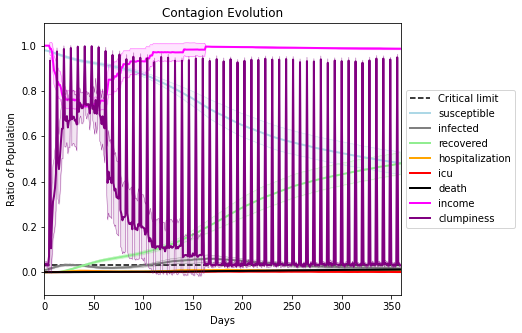

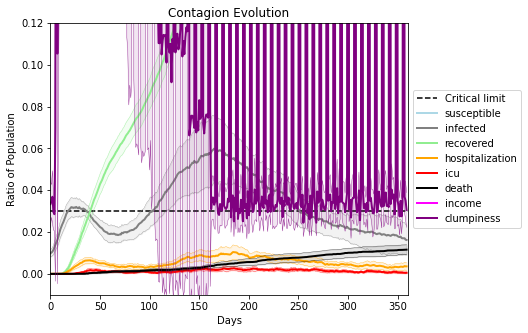

In [32]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8764, 2928, 8918, 1110, 1051, 3246, 1210, 7693, 9968, 6638, 3570, 8234, 3624, 5218, 7498, 244, 5939, 6367, 5742, 893]
Average similarity between family members is 0.9108522047006217 at temperature -0.99
Average similarity between family and home is 0.9998451233408312 at temperature -1
Average similarity between students and their classroom is 0.48461471057645167 at temperature -0.99
Average classroom occupancy is 4.197183098591549 and number classrooms is 71
Average similarity between workers is 0.8259311981601613 at temperature -0.99
Average office occupancy is 3.3214285714285716 and number offices is 196
Average friend similarity for adults: 0.8405830932626484 for kids: 0.6626192157949458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5158020380523297
avg restaurant similarity 0.4788112527318774
avg restaurant similarity 0.5214508328846178
avg restaurant similarity 0.5118627863733476
avg restaurant similarity 0.5487176089582384
avg restaurant similarity 0.4951530563577863
avg restaurant similarity 0.4872575613170673
avg restaurant similarity 0.5019090038370942
avg restaurant similarity 0.4798471545970747
avg restaurant similarity 0.5215825817525306
avg restaurant similarity 0.5461383492441483
avg restaurant similarity 0.49837537546395777
avg restaurant similarity 0.5171944453120153
avg restaurant similarity 0.5175511377715555
avg restaurant similarity 0.49125839150646833
avg restaurant similarity 0.5007492369980462
avg restaurant similarity 0.5267815313724457
avg restaurant similarity 0.518379960210223
avg restaurant similarity 0.5622842520647445
avg restaurant similarity 0.48957917445987764
avg restaurant similarity 0.4718721539226831
avg restaurant similarity 0.5211201163302362
avg rest

avg restaurant similarity 0.45625186250177757
avg restaurant similarity 0.4895050509066512
avg restaurant similarity 0.45777801676819896
avg restaurant similarity 0.5015508605271998
avg restaurant similarity 0.5433022580143964
avg restaurant similarity 0.5169484228562362
avg restaurant similarity 0.4774383284146245
avg restaurant similarity 0.49634167607680724
avg restaurant similarity 0.5168612338061029
avg restaurant similarity 0.5346114173636151
avg restaurant similarity 0.5445312737808902
avg restaurant similarity 0.49156108705517715
avg restaurant similarity 0.4670838172741674
avg restaurant similarity 0.48795712312355166
avg restaurant similarity 0.5281879402012375
avg restaurant similarity 0.49156352433951117
avg restaurant similarity 0.49889597035241057
avg restaurant similarity 0.48775379102112987
avg restaurant similarity 0.5090991332196092
avg restaurant similarity 0.4980850091319863
avg restaurant similarity 0.5096835352566336
avg restaurant similarity 0.5474302031283653
av

avg restaurant similarity 0.4298554256316566
avg restaurant similarity 0.4352098556249034
avg restaurant similarity 0.5998865922781108
avg restaurant similarity 0.42345864147908246
avg restaurant similarity 0.5017840900420871
avg restaurant similarity 0.4250181785696545
avg restaurant similarity 0.4610869057507812
avg restaurant similarity 0.4783561403460056
avg restaurant similarity 0.4920460666467084
avg restaurant similarity 0.4367772866601837
avg restaurant similarity 0.49234522896045374
avg restaurant similarity 0.44166510196051534
avg restaurant similarity 0.4504326299190547
avg restaurant similarity 0.47457849897400833
avg restaurant similarity 0.4927163484730846
avg restaurant similarity 0.39316293118646367
avg restaurant similarity 0.44067032006812157
avg restaurant similarity 0.4992347042534034
avg restaurant similarity 0.5084091474773931
avg restaurant similarity 0.46756757322370357
avg restaurant similarity 0.4992440814740981
avg restaurant similarity 0.5192079779449802
avg

avg restaurant similarity 0.481843992077938
avg restaurant similarity 0.46818468020221043
avg restaurant similarity 0.45055099491265027
avg restaurant similarity 0.4966271747222886
avg restaurant similarity 0.5137934523082976
avg restaurant similarity 0.45071836205254
avg restaurant similarity 0.48856082622020525
avg restaurant similarity 0.5195180768103743
avg restaurant similarity 0.4900989318706864
avg restaurant similarity 0.5061575948830879
avg restaurant similarity 0.4745683330925901
avg restaurant similarity 0.4812745526336575
avg restaurant similarity 0.47558047125470815
avg restaurant similarity 0.44954417349900694
avg restaurant similarity 0.4291715674952399
avg restaurant similarity 0.49808197708728946
avg restaurant similarity 0.46053099094423866
avg restaurant similarity 0.4968538461949524
avg restaurant similarity 0.4187602744260716
avg restaurant similarity 0.4789549373975002
avg restaurant similarity 0.4617567919807045
avg restaurant similarity 0.4582484670280464
avg re

avg restaurant similarity 0.5713954622008932
avg restaurant similarity 0.46996716418770473
avg restaurant similarity 0.47830265640395325
avg restaurant similarity 0.5003594392468752
avg restaurant similarity 0.4949673367885496
avg restaurant similarity 0.4440862797266649
avg restaurant similarity 0.5142666653375711
avg restaurant similarity 0.4814097424845489
avg restaurant similarity 0.468985115512489
avg restaurant similarity 0.4311042938428149
avg restaurant similarity 0.4557625215315155
avg restaurant similarity 0.4661749474705457
avg restaurant similarity 0.4696851377326423
avg restaurant similarity 0.48312507839692537
avg restaurant similarity 0.42128144032600484
avg restaurant similarity 0.4948117504923011
avg restaurant similarity 0.49444008848685583
avg restaurant similarity 0.5263846594200959
avg restaurant similarity 0.4668275157784946
avg restaurant similarity 0.5240577417778032
avg restaurant similarity 0.46764528616139245
avg restaurant similarity 0.4862429453393695
avg r

avg restaurant similarity 0.5179274275442568
avg restaurant similarity 0.5012128916989742
avg restaurant similarity 0.5526795881384604
avg restaurant similarity 0.44625100066963147
avg restaurant similarity 0.5818856309753522
avg restaurant similarity 0.4319256346434379
avg restaurant similarity 0.4839147717907293
avg restaurant similarity 0.4878705546591773
avg restaurant similarity 0.45074743807247225
avg restaurant similarity 0.5037599622441566
avg restaurant similarity 0.5471934434495112
avg restaurant similarity 0.513184062627239
avg restaurant similarity 0.5096677111910868
avg restaurant similarity 0.4795936958725443
avg restaurant similarity 0.4788760305592824
avg restaurant similarity 0.46883061876313115
avg restaurant similarity 0.490607705360974
avg restaurant similarity 0.43796184555385914
avg restaurant similarity 0.4621986424267532
avg restaurant similarity 0.5263707946865264
avg restaurant similarity 0.4891324903798664
avg restaurant similarity 0.46354978546601905
avg res

avg restaurant similarity 0.4782130188665632
avg restaurant similarity 0.45916404590220267
avg restaurant similarity 0.5180303958347637
avg restaurant similarity 0.5474882550894417
avg restaurant similarity 0.5221781780864831
avg restaurant similarity 0.5115768927764106
avg restaurant similarity 0.5007680409236501
avg restaurant similarity 0.48564543176191094
avg restaurant similarity 0.4881649774009921
avg restaurant similarity 0.4936533323698931
avg restaurant similarity 0.5146745910110321
avg restaurant similarity 0.5049002350237871
avg restaurant similarity 0.5673216763699266
avg restaurant similarity 0.49442324178040403
avg restaurant similarity 0.5350270959706152
avg restaurant similarity 0.5580474442198478
avg restaurant similarity 0.4811022072487265
avg restaurant similarity 0.5128991383452176
avg restaurant similarity 0.5013655653274938
avg restaurant similarity 0.5363361471383
avg restaurant similarity 0.5075242244721992
avg restaurant similarity 0.5022952209162227
avg restau

avg restaurant similarity 0.516836317112116
avg restaurant similarity 0.5084686207874785
avg restaurant similarity 0.5196018692808339
avg restaurant similarity 0.5070505949844522
avg restaurant similarity 0.5220311846024472
avg restaurant similarity 0.49841236357599106
avg restaurant similarity 0.5367688339243171
avg restaurant similarity 0.5657790633447726
avg restaurant similarity 0.5048540452551936
avg restaurant similarity 0.3981991666791158
avg restaurant similarity 0.48161817996898537
avg restaurant similarity 0.4865363114720957
avg restaurant similarity 0.5544450065948602
avg restaurant similarity 0.5581601073839709
avg restaurant similarity 0.5127367461750866
avg restaurant similarity 0.5035728896781475
avg restaurant similarity 0.5173998784847017
avg restaurant similarity 0.5080619644394627
avg restaurant similarity 0.4897531260321182
avg restaurant similarity 0.5150067565167534
avg restaurant similarity 0.5116183044780565
avg restaurant similarity 0.5252025423144141
avg resta

avg restaurant similarity 0.5149880838770181
avg restaurant similarity 0.5180382986139217
avg restaurant similarity 0.5058203358494877
avg restaurant similarity 0.4793799071286727
avg restaurant similarity 0.5244703211018366
avg restaurant similarity 0.541011662504196
avg restaurant similarity 0.5161779378570748
avg restaurant similarity 0.5187538230142682
avg restaurant similarity 0.5012608034019197
avg restaurant similarity 0.4999914201420629
avg restaurant similarity 0.5266893999165899
avg restaurant similarity 0.49856553057251685
avg restaurant similarity 0.47679627601771035
avg restaurant similarity 0.5326101485717496
avg restaurant similarity 0.43256912096344147
avg restaurant similarity 0.49803535293040635
avg restaurant similarity 0.46152523303638593
avg restaurant similarity 0.5224896765491348
avg restaurant similarity 0.4866448298830258
avg restaurant similarity 0.4841873223676521
avg restaurant similarity 0.4993428727904746
avg restaurant similarity 0.5623875107020883
avg re

avg restaurant similarity 0.4651569500522754
avg restaurant similarity 0.48120423079047503
avg restaurant similarity 0.47556398482406503
avg restaurant similarity 0.4461259683491794
avg restaurant similarity 0.5004817304592515
avg restaurant similarity 0.5388063566012365
avg restaurant similarity 0.43291322532965754
avg restaurant similarity 0.5429540163858132
avg restaurant similarity 0.47857427213722403
avg restaurant similarity 0.4971372742770284
avg restaurant similarity 0.526443822261506
avg restaurant similarity 0.5014012543773432
avg restaurant similarity 0.4856663964144146
avg restaurant similarity 0.5088368126550522
avg restaurant similarity 0.4711031307997045
avg restaurant similarity 0.46612370950291415
avg restaurant similarity 0.5102387722555376
avg restaurant similarity 0.5354442590061066
avg restaurant similarity 0.4467325381394579
avg restaurant similarity 0.5199273444880782
avg restaurant similarity 0.469224253321807
avg restaurant similarity 0.5128953503870252
avg res

avg restaurant similarity 0.4986660673437713
avg restaurant similarity 0.5793682321550131
avg restaurant similarity 0.47258093173368065
avg restaurant similarity 0.45872504399067415
avg restaurant similarity 0.5088387016497613
avg restaurant similarity 0.512341161849232
avg restaurant similarity 0.46197872555035474
avg restaurant similarity 0.47771702150185424
avg restaurant similarity 0.45295087502422976
avg restaurant similarity 0.4940035920307757
avg restaurant similarity 0.4779289135917583
avg restaurant similarity 0.4968759211463211
avg restaurant similarity 0.5037917612759911
avg restaurant similarity 0.5134735600609268
avg restaurant similarity 0.48289143317121663
avg restaurant similarity 0.4859864452831094
avg restaurant similarity 0.4876505136876737
avg restaurant similarity 0.5219254578173921
avg restaurant similarity 0.4804344287531766
avg restaurant similarity 0.53015184443465
avg restaurant similarity 0.5038557710584556
avg restaurant similarity 0.44141744741147526
avg re

avg restaurant similarity 0.4936788776426845
avg restaurant similarity 0.47954971580085226
avg restaurant similarity 0.5039387612578957
avg restaurant similarity 0.4509216408490667
avg restaurant similarity 0.4532409985084831
avg restaurant similarity 0.49051220541452367
avg restaurant similarity 0.5436984948842122
avg restaurant similarity 0.4963201404424007
avg restaurant similarity 0.41836263113980204
avg restaurant similarity 0.46832252424652715
avg restaurant similarity 0.4966723754323668
avg restaurant similarity 0.48365708266731205
avg restaurant similarity 0.490634892840654
avg restaurant similarity 0.4756657464199531
avg restaurant similarity 0.48630962846141423
avg restaurant similarity 0.46951645683949433
avg restaurant similarity 0.5409092208657605
avg restaurant similarity 0.500423241239341
avg restaurant similarity 0.46739314262239134
avg restaurant similarity 0.4878936483579218
avg restaurant similarity 0.5079533683559155
avg restaurant similarity 0.5408951965467029
avg 

avg restaurant similarity 0.4669585066936362
avg restaurant similarity 0.5164491334272185
avg restaurant similarity 0.5024532290946461
avg restaurant similarity 0.5154144218310643
avg restaurant similarity 0.46987757846489403
avg restaurant similarity 0.4968594319562536
avg restaurant similarity 0.5412413848931175
avg restaurant similarity 0.5060503113432057
avg restaurant similarity 0.5168227666020683
avg restaurant similarity 0.46747729376090796
avg restaurant similarity 0.5162073732461477
avg restaurant similarity 0.5350804160517756
avg restaurant similarity 0.446236687220343
avg restaurant similarity 0.49293829526778143
avg restaurant similarity 0.5234489220443538
avg restaurant similarity 0.4960823353732239
avg restaurant similarity 0.4447398536822877
avg restaurant similarity 0.4791098543418225
avg restaurant similarity 0.49015414736043256
avg restaurant similarity 0.5167653848894262
avg restaurant similarity 0.4634628131590521
avg restaurant similarity 0.5078301837848835
avg res

avg restaurant similarity 0.49226702474537093
avg restaurant similarity 0.5227841544359808
avg restaurant similarity 0.5133924969603444
avg restaurant similarity 0.5091993828017541
avg restaurant similarity 0.5294066324779406
avg restaurant similarity 0.48943386573321696
avg restaurant similarity 0.50835112129181
avg restaurant similarity 0.47222492194046056
avg restaurant similarity 0.5175873280246766
avg restaurant similarity 0.5240661637197634
avg restaurant similarity 0.43197525638570033
avg restaurant similarity 0.4960144597751268
avg restaurant similarity 0.5154107782175574
avg restaurant similarity 0.5211494039394592
avg restaurant similarity 0.4819593451709542
avg restaurant similarity 0.5102094665997342
avg restaurant similarity 0.522103231355775
avg restaurant similarity 0.5382898069066986
avg restaurant similarity 0.5092104828460909
avg restaurant similarity 0.5082493058226655
avg restaurant similarity 0.4561105444968912
avg restaurant similarity 0.5228483518132002
avg resta

avg restaurant similarity 0.49701823546728785
avg restaurant similarity 0.5600592559667948
avg restaurant similarity 0.48981064968121246
avg restaurant similarity 0.5697040574648897
avg restaurant similarity 0.5167954738006143
avg restaurant similarity 0.4585656896678613
avg restaurant similarity 0.5203513984730914
avg restaurant similarity 0.5562502917478525
avg restaurant similarity 0.5148949930928545
avg restaurant similarity 0.5604380948081846
avg restaurant similarity 0.5671872014436122
avg restaurant similarity 0.5431404251383408
avg restaurant similarity 0.595933831209878
avg restaurant similarity 0.5240747515981293
avg restaurant similarity 0.5748602980783708
avg restaurant similarity 0.5649307551835232
avg restaurant similarity 0.4463725226889567
avg restaurant similarity 0.43207759285842356
avg restaurant similarity 0.4678664926745944
avg restaurant similarity 0.5199058417589896
avg restaurant similarity 0.5492007215851232
avg restaurant similarity 0.5148870870723437
avg rest

avg restaurant similarity 0.5400699393719284
avg restaurant similarity 0.4656948156089476
avg restaurant similarity 0.4782039639444505
avg restaurant similarity 0.488728030189428
avg restaurant similarity 0.5044497984991132
avg restaurant similarity 0.4913361510162516
avg restaurant similarity 0.49232840512609827
avg restaurant similarity 0.5193010241616192
avg restaurant similarity 0.4719247043740295
avg restaurant similarity 0.4462037459406374
avg restaurant similarity 0.5612610778714104
avg restaurant similarity 0.5169631681910559
avg restaurant similarity 0.5950614597769099
avg restaurant similarity 0.5489285442293743
avg restaurant similarity 0.5098261444956629
avg restaurant similarity 0.5023340028374551
avg restaurant similarity 0.48087858710368686
avg restaurant similarity 0.47703417983418916
avg restaurant similarity 0.4840642984366699
avg restaurant similarity 0.46240559112410634
avg restaurant similarity 0.516342167695286
avg restaurant similarity 0.49666362569987116
avg res

avg restaurant similarity 0.49636510318373567
avg restaurant similarity 0.4947708575913378
avg restaurant similarity 0.4851705261666614
avg restaurant similarity 0.5306767201937719
avg restaurant similarity 0.5163236739534913
avg restaurant similarity 0.5200167312301985
avg restaurant similarity 0.4835650992517866
avg restaurant similarity 0.46010225406277067
avg restaurant similarity 0.4760063704152154
avg restaurant similarity 0.5154114127709516
avg restaurant similarity 0.491237656430804
avg restaurant similarity 0.48138923441468356
avg restaurant similarity 0.437090396749611
avg restaurant similarity 0.5048850765513795
avg restaurant similarity 0.47987671591182113
avg restaurant similarity 0.5217388426123901
avg restaurant similarity 0.4544791614317303
avg restaurant similarity 0.4986787980978259
avg restaurant similarity 0.5191138543704339
avg restaurant similarity 0.49516719336356724
avg restaurant similarity 0.508075480456615
avg restaurant similarity 0.47525282547943065
avg res

avg restaurant similarity 0.4733379858762059
avg restaurant similarity 0.4408751417250997
avg restaurant similarity 0.45162877436164406
avg restaurant similarity 0.5210876694005688
avg restaurant similarity 0.4629817620315855
avg restaurant similarity 0.4939579519770021
avg restaurant similarity 0.43489197516258254
avg restaurant similarity 0.4954321408770282
avg restaurant similarity 0.4898649326788929
avg restaurant similarity 0.4855521132748428
avg restaurant similarity 0.5085230554519732
avg restaurant similarity 0.4729480559243496
avg restaurant similarity 0.49354060911257663
avg restaurant similarity 0.4870775481360051
avg restaurant similarity 0.4406892820513029
avg restaurant similarity 0.47527399496225864
avg restaurant similarity 0.4748922890707617
avg restaurant similarity 0.45596150135943053
avg restaurant similarity 0.470912438752248
avg restaurant similarity 0.48938341888515635
avg restaurant similarity 0.5112403692524843
avg restaurant similarity 0.4757771742787364
avg r

avg restaurant similarity 0.5238490134886297
avg restaurant similarity 0.5354562105283551
avg restaurant similarity 0.552872136881752
avg restaurant similarity 0.49393945467299366
avg restaurant similarity 0.5288196969299915
avg restaurant similarity 0.4791334985181256
avg restaurant similarity 0.4886420103988737
avg restaurant similarity 0.5131626447753601
avg restaurant similarity 0.5004287789649453
avg restaurant similarity 0.49320603099610477
avg restaurant similarity 0.44112086283189034
avg restaurant similarity 0.5074867399009619
avg restaurant similarity 0.4905376846084753
avg restaurant similarity 0.46043668737663823
avg restaurant similarity 0.4671021726598323
avg restaurant similarity 0.5004151974012275
avg restaurant similarity 0.5356380114539573
avg restaurant similarity 0.4575624265919484
avg restaurant similarity 0.5206421141151459
avg restaurant similarity 0.5182632269986786
avg restaurant similarity 0.44183909870111515
avg restaurant similarity 0.5539924132063345
avg re

avg restaurant similarity 0.47605250050966774
avg restaurant similarity 0.5021893018416643
avg restaurant similarity 0.49067576761300746
avg restaurant similarity 0.4782399418569618
avg restaurant similarity 0.4735812809798037
avg restaurant similarity 0.4977201688140422
avg restaurant similarity 0.541872260951587
avg restaurant similarity 0.49247707942299246
avg restaurant similarity 0.4920492394611349
avg restaurant similarity 0.5191164505414321
avg restaurant similarity 0.4855176547434186
avg restaurant similarity 0.48176462645671353
avg restaurant similarity 0.4853999118856787
avg restaurant similarity 0.5042262321086715
avg restaurant similarity 0.4586638111260709
avg restaurant similarity 0.4939058624601235
avg restaurant similarity 0.46340564287112196
avg restaurant similarity 0.4744047466962863
avg restaurant similarity 0.5219542647737454
avg restaurant similarity 0.4900910795151801
avg restaurant similarity 0.46354460773510586
avg restaurant similarity 0.497703526330233
avg re

avg restaurant similarity 0.4668760417375455
avg restaurant similarity 0.5562335518001134
avg restaurant similarity 0.5020145614406714
avg restaurant similarity 0.4839179487997045
avg restaurant similarity 0.5322995016226666
avg restaurant similarity 0.5058102901524617
avg restaurant similarity 0.48771081656069054
avg restaurant similarity 0.4697449372452509
avg restaurant similarity 0.453989272948027
avg restaurant similarity 0.4931510491582098
avg restaurant similarity 0.512494426328697
avg restaurant similarity 0.505368905419852
avg restaurant similarity 0.5312159057318145
avg restaurant similarity 0.4949409264673615
avg restaurant similarity 0.5351341879654963
avg restaurant similarity 0.4622536497678499
avg restaurant similarity 0.4713416590897635
avg restaurant similarity 0.5383415068926705
avg restaurant similarity 0.4655496929090427
avg restaurant similarity 0.4486133937586618
avg restaurant similarity 0.44833175294272776
avg restaurant similarity 0.48918010813790375
avg restau

avg restaurant similarity 0.507280770237114
avg restaurant similarity 0.4656081715401013
avg restaurant similarity 0.5324518121231843
avg restaurant similarity 0.4709394175816121
avg restaurant similarity 0.4834432298834291
avg restaurant similarity 0.5190647005249175
avg restaurant similarity 0.5602954177527077
avg restaurant similarity 0.5130998668208787
avg restaurant similarity 0.4793686050943946
avg restaurant similarity 0.4801035120136976
avg restaurant similarity 0.5202847865715117
avg restaurant similarity 0.4905442544117007
avg restaurant similarity 0.5001089710718857
avg restaurant similarity 0.5023533157132618
avg restaurant similarity 0.49454123053932736
avg restaurant similarity 0.4612259485402747
avg restaurant similarity 0.5482321897008384
avg restaurant similarity 0.45846374238733345
avg restaurant similarity 0.44224060772832774
avg restaurant similarity 0.5194727158032832
avg restaurant similarity 0.4642526650145831
avg restaurant similarity 0.4933747629154266
avg rest

avg restaurant similarity 0.48485159240686765
avg restaurant similarity 0.4797822960683428
avg restaurant similarity 0.47966514469119775
avg restaurant similarity 0.5162279383629649
avg restaurant similarity 0.5144716326923671
avg restaurant similarity 0.5298456973539325
avg restaurant similarity 0.5001515975421652
avg restaurant similarity 0.4787161311770001
avg restaurant similarity 0.487512237781135
avg restaurant similarity 0.46913106019824324
avg restaurant similarity 0.489962271540245
avg restaurant similarity 0.4457112061184168
avg restaurant similarity 0.4418440171878511
avg restaurant similarity 0.4753728497781887
avg restaurant similarity 0.403362085934032
avg restaurant similarity 0.4790318297010854
avg restaurant similarity 0.5496911378459391
avg restaurant similarity 0.4581703627452196
avg restaurant similarity 0.4876549186776007
avg restaurant similarity 0.4749207003088435
avg restaurant similarity 0.4994532195644374
avg restaurant similarity 0.4706708708934601
avg restau

avg restaurant similarity 0.46138419984788187
avg restaurant similarity 0.5177646170972903
avg restaurant similarity 0.4818060634139326
avg restaurant similarity 0.5579035053128556
avg restaurant similarity 0.484181404489549
avg restaurant similarity 0.49082901566758164
avg restaurant similarity 0.5049669642169127
avg restaurant similarity 0.5295443662188943
avg restaurant similarity 0.5184017991413232
avg restaurant similarity 0.480252947421525
avg restaurant similarity 0.5127166249744828
avg restaurant similarity 0.4558138450837274
avg restaurant similarity 0.5081702776216009
avg restaurant similarity 0.4753253824425746
avg restaurant similarity 0.505510647802344
avg restaurant similarity 0.48284581143132393
avg restaurant similarity 0.46925896720932453
avg restaurant similarity 0.4935321470789652
avg restaurant similarity 0.48735057079096844
avg restaurant similarity 0.477166251034882
avg restaurant similarity 0.463705818847119
avg restaurant similarity 0.5042633996231891
avg restau

avg restaurant similarity 0.5179397833603624
avg restaurant similarity 0.5181756725993628
avg restaurant similarity 0.5208480949037412
avg restaurant similarity 0.5157511477468757
avg restaurant similarity 0.4867763645340338
avg restaurant similarity 0.4958580128612393
avg restaurant similarity 0.5618341997822808
avg restaurant similarity 0.5375835740120044
avg restaurant similarity 0.5040323579175298
avg restaurant similarity 0.5142477209223942
avg restaurant similarity 0.5251724911259058
avg restaurant similarity 0.4954470368203992
avg restaurant similarity 0.48431797362650536
avg restaurant similarity 0.5358160654864917
avg restaurant similarity 0.5050640978217628
avg restaurant similarity 0.48263090240048234
avg restaurant similarity 0.5358418341211816
avg restaurant similarity 0.5298503106765626
avg restaurant similarity 0.5658696974918885
avg restaurant similarity 0.4937645139504394
avg restaurant similarity 0.5212231216597332
avg restaurant similarity 0.5546507549815962
avg rest

avg restaurant similarity 0.5320160804328025
avg restaurant similarity 0.5104876974916069
avg restaurant similarity 0.5287601258293503
avg restaurant similarity 0.5196151554593016
avg restaurant similarity 0.47830411541661
avg restaurant similarity 0.5171725059549289
avg restaurant similarity 0.48768881412160714
avg restaurant similarity 0.5318237461122886
avg restaurant similarity 0.4640909238993108
avg restaurant similarity 0.5256106986872007
avg restaurant similarity 0.47879671354176645
avg restaurant similarity 0.5222335336810852
avg restaurant similarity 0.5297789545032168
avg restaurant similarity 0.5070890154225374
avg restaurant similarity 0.4815677889444893
avg restaurant similarity 0.5348005294889076
avg restaurant similarity 0.5782493766904762
avg restaurant similarity 0.47573445004541526
avg restaurant similarity 0.48280540578137926
avg restaurant similarity 0.43066099299498783
avg restaurant similarity 0.5383393559833023
avg restaurant similarity 0.5059502277185224
avg res

avg restaurant similarity 0.4864253903096054
avg restaurant similarity 0.519920613900122
avg restaurant similarity 0.4873640834799716
avg restaurant similarity 0.5165304260629817
avg restaurant similarity 0.5316368792434975
avg restaurant similarity 0.553059007505994
avg restaurant similarity 0.5261295822320813
avg restaurant similarity 0.5419155195686612
avg restaurant similarity 0.5658581489770919
avg restaurant similarity 0.4916847263928212
avg restaurant similarity 0.5283885028007101
avg restaurant similarity 0.4989091968218356
avg restaurant similarity 0.5577238176628299
avg restaurant similarity 0.5123673701532383
avg restaurant similarity 0.49738374879568104
avg restaurant similarity 0.4809676523393673
avg restaurant similarity 0.5922522250654585
avg restaurant similarity 0.5450005563429219
avg restaurant similarity 0.5224045894841519
avg restaurant similarity 0.5161032601827571
avg restaurant similarity 0.5558741592670624
avg restaurant similarity 0.5084438678072086
avg restaur

avg restaurant similarity 0.5465015298323835
avg restaurant similarity 0.47113643789785553
avg restaurant similarity 0.5225896770151449
avg restaurant similarity 0.4922899301581914
avg restaurant similarity 0.5231672060784869
avg restaurant similarity 0.5194996983107986
avg restaurant similarity 0.5404551042766141
avg restaurant similarity 0.5459482494207364
avg restaurant similarity 0.6261548284057862
avg restaurant similarity 0.569875138070017
avg restaurant similarity 0.5160899591087948
avg restaurant similarity 0.4656871715636934
avg restaurant similarity 0.6031177353425249
avg restaurant similarity 0.5188536711724304
avg restaurant similarity 0.5821521687292138
avg restaurant similarity 0.5303345936496064
avg restaurant similarity 0.6215195708059171
avg restaurant similarity 0.5041538319283023
avg restaurant similarity 0.5078859175114758
avg restaurant similarity 0.5885992377493015
avg restaurant similarity 0.5290788154373817
avg restaurant similarity 0.5940976280480346
avg restau

avg restaurant similarity 0.5296856915133764
avg restaurant similarity 0.5138903482813465
avg restaurant similarity 0.4428942543310133
avg restaurant similarity 0.5543931405108155
avg restaurant similarity 0.5029594604547838
avg restaurant similarity 0.5678550458316146
avg restaurant similarity 0.5413159325103143
avg restaurant similarity 0.5675687435298756
avg restaurant similarity 0.5462975783100293
avg restaurant similarity 0.5034935003384654
avg restaurant similarity 0.5150775925264219
avg restaurant similarity 0.5431326822391689
avg restaurant similarity 0.4903910410765084
avg restaurant similarity 0.5469182937157939
avg restaurant similarity 0.47951500402942937
avg restaurant similarity 0.5026287557473288
avg restaurant similarity 0.5498131947687669
avg restaurant similarity 0.5381946281937805
avg restaurant similarity 0.5747674826760089
avg restaurant similarity 0.49574199868551966
avg restaurant similarity 0.5563956819131948
avg restaurant similarity 0.5662525843176393
avg rest

avg restaurant similarity 0.487516291217773
avg restaurant similarity 0.5562566192600454
avg restaurant similarity 0.5987082197151387
avg restaurant similarity 0.5767809698486165
avg restaurant similarity 0.5276892405210718
avg restaurant similarity 0.5424575418766309
avg restaurant similarity 0.5468102136033954
avg restaurant similarity 0.5413287879567279
avg restaurant similarity 0.5204909704984928
avg restaurant similarity 0.5095010870568824
avg restaurant similarity 0.5494406672561218
avg restaurant similarity 0.5200128944684287
avg restaurant similarity 0.5986008444026771
avg restaurant similarity 0.5546560002901618
avg restaurant similarity 0.47974951321057985
avg restaurant similarity 0.5697019219240013
avg restaurant similarity 0.4625651017653835
avg restaurant similarity 0.5388492334150324
avg restaurant similarity 0.5241909327172105
avg restaurant similarity 0.5445211157620574
avg restaurant similarity 0.5246659631594407
avg restaurant similarity 0.5589294958648481
avg restau

avg restaurant similarity 0.5205025896086414
avg restaurant similarity 0.5160834788281881
avg restaurant similarity 0.5012253319065382
avg restaurant similarity 0.5249040491795641
avg restaurant similarity 0.49475990955234644
avg restaurant similarity 0.5071238146152749
avg restaurant similarity 0.5285126226904541
avg restaurant similarity 0.5145466186485307
avg restaurant similarity 0.5338040659522446
avg restaurant similarity 0.5653462997364512
avg restaurant similarity 0.49743166703576225
avg restaurant similarity 0.5337954994559776
avg restaurant similarity 0.5051175485748841
avg restaurant similarity 0.5243661408369227
avg restaurant similarity 0.4720469149737185
avg restaurant similarity 0.5665322586355602
avg restaurant similarity 0.5391899197658747
avg restaurant similarity 0.5383745460505726
avg restaurant similarity 0.5409788619277341
avg restaurant similarity 0.5228927809089741
avg restaurant similarity 0.5190915620962561
avg restaurant similarity 0.5284859564391056
avg rest

avg restaurant similarity 0.5447753037138621
avg restaurant similarity 0.49915914871903627
avg restaurant similarity 0.4943521428155094
avg restaurant similarity 0.48058914944236986
avg restaurant similarity 0.48644685513225594
avg restaurant similarity 0.5550957739017844
avg restaurant similarity 0.5056956132097408
avg restaurant similarity 0.4892790542989038
avg restaurant similarity 0.5219969781091012
avg restaurant similarity 0.5335362455616176
avg restaurant similarity 0.5387674239021785
avg restaurant similarity 0.5052610675104764
avg restaurant similarity 0.535714521716576
avg restaurant similarity 0.5183651707831639
avg restaurant similarity 0.5173158780845571
avg restaurant similarity 0.5604722019890469
avg restaurant similarity 0.5544714534202919
avg restaurant similarity 0.5573591392194667
avg restaurant similarity 0.46607807903103216
avg restaurant similarity 0.5039186473128057
avg restaurant similarity 0.49278626276413484
avg restaurant similarity 0.5529709306639574
avg re

avg restaurant similarity 0.50787706589816
avg restaurant similarity 0.5025765828539372
avg restaurant similarity 0.4544844813166956
avg restaurant similarity 0.47942645745099094
avg restaurant similarity 0.5222604433808115
avg restaurant similarity 0.5517530574997899
avg restaurant similarity 0.555671275167818
avg restaurant similarity 0.48156001053675035
avg restaurant similarity 0.5000199158613226
avg restaurant similarity 0.5436354754142667
avg restaurant similarity 0.5223034722335921
avg restaurant similarity 0.5193551560741901
avg restaurant similarity 0.49014696952537345
avg restaurant similarity 0.47342091031532746
avg restaurant similarity 0.5245266501617848
avg restaurant similarity 0.5103571377697335
avg restaurant similarity 0.5178319694810462
avg restaurant similarity 0.5390134878225491
avg restaurant similarity 0.47895485540222926
avg restaurant similarity 0.4536240903653449
avg restaurant similarity 0.4976245197081237
avg restaurant similarity 0.5197424998332987
avg rest

avg restaurant similarity 0.5346352080788103
avg restaurant similarity 0.4899614786796553
avg restaurant similarity 0.48675858631015656
avg restaurant similarity 0.5117265317012338
avg restaurant similarity 0.49751730055914717
avg restaurant similarity 0.5118640386245424
avg restaurant similarity 0.540876926034589
avg restaurant similarity 0.5108176526301462
avg restaurant similarity 0.45618985821921004
avg restaurant similarity 0.5299057479076716
avg restaurant similarity 0.512757657484368
avg restaurant similarity 0.5490333253740292
avg restaurant similarity 0.4973639624346862
avg restaurant similarity 0.501420995139941
avg restaurant similarity 0.5171527954854774
avg restaurant similarity 0.4478581688333088
avg restaurant similarity 0.44825045227750787
avg restaurant similarity 0.49141582909259746
avg restaurant similarity 0.4948705217517153
avg restaurant similarity 0.5428843173139178
avg restaurant similarity 0.539569212085391
avg restaurant similarity 0.4626761761947626
avg resta

avg restaurant similarity 0.4738922705710065
avg restaurant similarity 0.510810731222652
avg restaurant similarity 0.5014506527395429
avg restaurant similarity 0.564674955288083
avg restaurant similarity 0.4786796445912025
avg restaurant similarity 0.5122045739721471
avg restaurant similarity 0.5322291238388155
avg restaurant similarity 0.48356831665347116
avg restaurant similarity 0.48263538753204627
avg restaurant similarity 0.44258187708394126
avg restaurant similarity 0.5141531243175635
avg restaurant similarity 0.4608683300119518
avg restaurant similarity 0.4889016399850388
avg restaurant similarity 0.40905301552951573
avg restaurant similarity 0.5008841589377877
avg restaurant similarity 0.529812605982602
avg restaurant similarity 0.49242238870546895
avg restaurant similarity 0.4721227683423594
avg restaurant similarity 0.45311984318795073
avg restaurant similarity 0.4639412202230566
avg restaurant similarity 0.4908913998656264
avg restaurant similarity 0.5040420718813658
avg res

avg restaurant similarity 0.4287219679346956
avg restaurant similarity 0.4719000984350529
avg restaurant similarity 0.4965503974132855
avg restaurant similarity 0.4521667484453767
avg restaurant similarity 0.48112044509288604
avg restaurant similarity 0.46117476235932897
avg restaurant similarity 0.47069695401118894
avg restaurant similarity 0.45820680516990836
avg restaurant similarity 0.484983270262096
avg restaurant similarity 0.450862309462449
avg restaurant similarity 0.4759321465359898
avg restaurant similarity 0.4438249603821849
avg restaurant similarity 0.47244253964180677
avg restaurant similarity 0.49742252253578334
avg restaurant similarity 0.4396069166499964
avg restaurant similarity 0.4552564815040734
avg restaurant similarity 0.47076105385151257
avg restaurant similarity 0.49383886089929047
avg restaurant similarity 0.4228979483521855
avg restaurant similarity 0.5176928662012038
avg restaurant similarity 0.44341692600506183
avg restaurant similarity 0.5005458116416313
avg

avg restaurant similarity 0.5075059689289234
avg restaurant similarity 0.520966850838614
avg restaurant similarity 0.4694359963552388
avg restaurant similarity 0.4679106897164942
avg restaurant similarity 0.49596156145980136
avg restaurant similarity 0.5307574413651417
avg restaurant similarity 0.5033016353360888
avg restaurant similarity 0.5043207469924808
avg restaurant similarity 0.49137760301733274
avg restaurant similarity 0.4350579867532509
avg restaurant similarity 0.5060927085338802
avg restaurant similarity 0.46755623595271373
avg restaurant similarity 0.5149626340923783
avg restaurant similarity 0.45291289074495134
avg restaurant similarity 0.4982017387384731
avg restaurant similarity 0.47387169188044387
avg restaurant similarity 0.4933293734864779
avg restaurant similarity 0.4658887912251694
avg restaurant similarity 0.4702341267607956
avg restaurant similarity 0.5142814316892573
avg restaurant similarity 0.4871029257324577
avg restaurant similarity 0.46538249691376127
avg r

avg restaurant similarity 0.48027632854777813
avg restaurant similarity 0.49690739770242665
avg restaurant similarity 0.5433710929958167
avg restaurant similarity 0.4159009376836175
avg restaurant similarity 0.5302340760099554
avg restaurant similarity 0.5152721650408307
avg restaurant similarity 0.5112642058364947
avg restaurant similarity 0.4870050612145749
avg restaurant similarity 0.5209528910370602
avg restaurant similarity 0.5540347191405283
avg restaurant similarity 0.47812424977869783
avg restaurant similarity 0.5268695240399544
avg restaurant similarity 0.5171450311356458
avg restaurant similarity 0.5257567667552808
avg restaurant similarity 0.5009376331291024
avg restaurant similarity 0.5078956160537422
avg restaurant similarity 0.46280570401111265
avg restaurant similarity 0.53151476724182
avg restaurant similarity 0.4407039007316141
avg restaurant similarity 0.44881761116074814
avg restaurant similarity 0.4830093349619016
avg restaurant similarity 0.4310852921044439
avg res

avg restaurant similarity 0.4467737783199625
avg restaurant similarity 0.5293451747459555
avg restaurant similarity 0.4915654245901959
avg restaurant similarity 0.4893483122039831
avg restaurant similarity 0.44148065990239044
avg restaurant similarity 0.5060218326445239
avg restaurant similarity 0.4813725491754482
avg restaurant similarity 0.4683173637091796
avg restaurant similarity 0.47051830967596997
avg restaurant similarity 0.4398375966717574
avg restaurant similarity 0.504489776430192
avg restaurant similarity 0.49738378307925274
avg restaurant similarity 0.4860236420236531
avg restaurant similarity 0.5147570373202782
avg restaurant similarity 0.44286483686492684
avg restaurant similarity 0.4443191280932594
avg restaurant similarity 0.5047661613341309
avg restaurant similarity 0.4358366972412828
avg restaurant similarity 0.5062507521998917
avg restaurant similarity 0.44482056124597824
avg restaurant similarity 0.5107643556266421
avg restaurant similarity 0.45976801338912143
avg r

avg restaurant similarity 0.5113578724488479
avg restaurant similarity 0.4925939950938182
avg restaurant similarity 0.4766706859246402
avg restaurant similarity 0.482417401988497
avg restaurant similarity 0.4367912792827135
avg restaurant similarity 0.4902725659424466
avg restaurant similarity 0.4353072742299727
avg restaurant similarity 0.47992853529865276
avg restaurant similarity 0.5046769660365199
avg restaurant similarity 0.4747907055412018
avg restaurant similarity 0.4413906266123919
avg restaurant similarity 0.471718233218539
avg restaurant similarity 0.46867598955520107
avg restaurant similarity 0.49053388212026156
avg restaurant similarity 0.48424469757535077
avg restaurant similarity 0.46396602635439343
avg restaurant similarity 0.45332581555671364
avg restaurant similarity 0.4847133261868255
avg restaurant similarity 0.4602962993207129
avg restaurant similarity 0.44232764189486207
avg restaurant similarity 0.47488598191713627
avg restaurant similarity 0.45673201001100183
avg

(<function dict.items>, <function dict.items>, <function dict.items>)

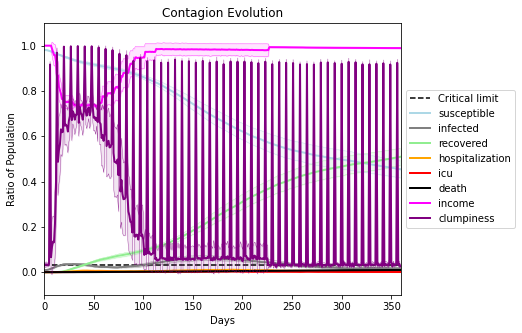

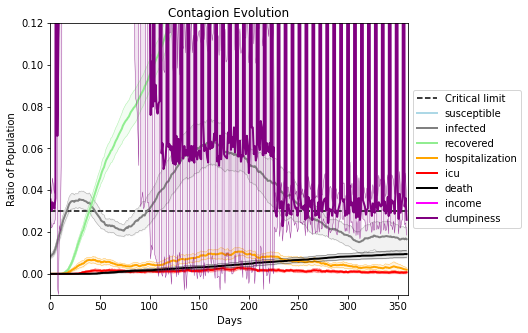

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[8945, 8782, 5610, 344, 5428, 6303, 5539, 7122, 319, 1251, 7579, 5318, 1471, 1924, 7290, 5568, 9850, 3746, 599, 1909]
Average similarity between family members is 0.5578431009530592 at temperature -0.9
Average similarity between family and home is 0.999847986535 at temperature -1
Average similarity between students and their classroom is 0.19095462763702564 at temperature -0.9
Average classroom occupancy is 4.171428571428572 and number classrooms is 70
Average similarity between workers is 0.45108239801295824 at temperature -0.9
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.602570812492068 for kids: 0.46477532172133984
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding:

avg restaurant similarity 0.04297203526976138
avg restaurant similarity 0.0824542828657354
avg restaurant similarity 0.08891194475833337
avg restaurant similarity 0.1302428796653991
avg restaurant similarity 0.10100517784605674
avg restaurant similarity 0.1502199204195157
avg restaurant similarity 0.05872256243081547
avg restaurant similarity 0.1284941270476405
avg restaurant similarity 0.06977922233834992
avg restaurant similarity 0.09910897608682137
avg restaurant similarity 0.09699269708376852
avg restaurant similarity 0.09505007349058889
avg restaurant similarity 0.18040547217555825
avg restaurant similarity 0.03040617276807588
avg restaurant similarity 0.12684204108811184
avg restaurant similarity 0.12930517939879593
avg restaurant similarity 0.1290912795975237
avg restaurant similarity 0.1639634144015736
avg restaurant similarity 0.05078497562921687
avg restaurant similarity 0.09073440258294845
avg restaurant similarity 0.052608632263753556
avg restaurant similarity 0.07081639004

avg restaurant similarity 0.11923335163462041
avg restaurant similarity 0.0806214332644834
avg restaurant similarity 0.14159433718419687
avg restaurant similarity 0.03699153091680089
avg restaurant similarity 0.10693755159806975
avg restaurant similarity 0.11735130875774108
avg restaurant similarity 0.06019671604176884
avg restaurant similarity 0.09613497761590346
avg restaurant similarity 0.1285984359018427
avg restaurant similarity 0.03813045657616438
avg restaurant similarity 0.1217773525897844
avg restaurant similarity 0.16581327743426383
avg restaurant similarity 0.12908345287848177
avg restaurant similarity 0.05681592382435374
avg restaurant similarity 0.09760103522999705
avg restaurant similarity 0.15110327858665146
avg restaurant similarity 0.08898750180347777
avg restaurant similarity 0.07659143396092871
avg restaurant similarity 0.1190041663062746
avg restaurant similarity 0.0835045904473056
avg restaurant similarity 0.04424629851867216
avg restaurant similarity 0.11302094861

avg restaurant similarity 0.12775921281758665
avg restaurant similarity 0.06583137569601676
avg restaurant similarity 0.01541547255116331
avg restaurant similarity 0.10626517906556439
avg restaurant similarity 0.0639667615166343
avg restaurant similarity 0.1074644146784082
avg restaurant similarity 0.04532369706230683
avg restaurant similarity 0.058504707541492555
avg restaurant similarity 0.07031485467839521
avg restaurant similarity 0.11308406989700212
avg restaurant similarity 0.10701334049580206
avg restaurant similarity 0.09810698811653168
avg restaurant similarity 0.14068867167012147
avg restaurant similarity 0.0887309536473816
avg restaurant similarity 0.07219482732427979
avg restaurant similarity 0.06454369308308949
avg restaurant similarity 0.06012739476049708
avg restaurant similarity 0.07876329207571972
avg restaurant similarity 0.1205514608829851
avg restaurant similarity 0.02119663099393729
avg restaurant similarity 0.06557657862520956
avg restaurant similarity 0.014669817

avg restaurant similarity 0.09955298493255045
avg restaurant similarity 0.08694565240930935
avg restaurant similarity 0.037306364245885605
avg restaurant similarity 0.08124189871678181
avg restaurant similarity 0.08588577101031251
avg restaurant similarity 0.05516459998082967
avg restaurant similarity 0.03628056338828212
avg restaurant similarity 0.04422960985311417
avg restaurant similarity 0.05735043618360992
avg restaurant similarity 0.04005059246595949
avg restaurant similarity 0.0800450753618065
avg restaurant similarity 0.10804312239062995
avg restaurant similarity 0.10505680685161523
avg restaurant similarity 0.04157423710793299
avg restaurant similarity 0.044151402087724306
avg restaurant similarity 0.03779735504011929
avg restaurant similarity 0.04183038680834693
avg restaurant similarity 0.044818773666055946
avg restaurant similarity 0.053776486637689566
avg restaurant similarity 0.08595505907249941
avg restaurant similarity 0.12403259244530679
avg restaurant similarity 0.028

avg restaurant similarity -0.012711945917263517
avg restaurant similarity 0.13809736017092883
avg restaurant similarity 0.07287771059010827
avg restaurant similarity 0.09293213684114747
avg restaurant similarity 0.10193250892769326
avg restaurant similarity 0.042222152079394226
avg restaurant similarity 0.05873611020904423
avg restaurant similarity 0.08612499276093223
avg restaurant similarity 0.05249282438445651
avg restaurant similarity 0.08716702802366239
avg restaurant similarity 0.10398508761488227
avg restaurant similarity 0.028428134269656728
avg restaurant similarity 0.07640204891770429
avg restaurant similarity 0.06660047268058628
avg restaurant similarity 0.1359693292718501
avg restaurant similarity 0.10845539557649389
avg restaurant similarity 0.046812478069661684
avg restaurant similarity 0.07833542748269665
avg restaurant similarity 0.11803142934482835
avg restaurant similarity 0.06382359686664295
avg restaurant similarity 0.05899605523358821
avg restaurant similarity 0.04

avg restaurant similarity 0.0923041044231116
avg restaurant similarity 0.06595754596801685
avg restaurant similarity 0.05959495524825852
avg restaurant similarity 0.08880801981292913
avg restaurant similarity 0.08546448815640839
avg restaurant similarity 0.09859142012721608
avg restaurant similarity 0.09049086098889615
avg restaurant similarity 0.09567246422998194
avg restaurant similarity 0.07816256433318564
avg restaurant similarity 0.07066321986303233
avg restaurant similarity 0.025872921004986428
avg restaurant similarity 0.08131285918996878
avg restaurant similarity 0.08601417431712766
avg restaurant similarity 0.06929944141404396
avg restaurant similarity 0.1374448787070471
avg restaurant similarity 0.13138838359359806
avg restaurant similarity 0.10682324872435985
avg restaurant similarity 0.1547612607842153
avg restaurant similarity 0.007016766678734634
avg restaurant similarity 0.12912635066765488
avg restaurant similarity 0.11743904055209364
avg restaurant similarity 0.0813899

avg restaurant similarity 0.10545008261290167
avg restaurant similarity 0.059686085315385065
avg restaurant similarity 0.09926093680899252
avg restaurant similarity 0.11526812372711512
avg restaurant similarity 0.11034278234757887
avg restaurant similarity 0.05364968184662739
avg restaurant similarity 0.08115290554759726
avg restaurant similarity 0.05990570170724135
avg restaurant similarity 0.09373822825810466
avg restaurant similarity 0.13316180679472087
avg restaurant similarity 0.05306700715467753
avg restaurant similarity 0.09880789748399034
avg restaurant similarity 0.09900443878552449
avg restaurant similarity 0.09725758677492702
avg restaurant similarity 0.09539022680912328
avg restaurant similarity 0.03881605550302483
avg restaurant similarity 0.04483592636447116
avg restaurant similarity 0.12672351764083972
avg restaurant similarity 0.16389998237451212
avg restaurant similarity 0.1415795020226683
avg restaurant similarity 0.10149789447258617
avg restaurant similarity 0.080896

avg restaurant similarity 0.09753764594856851
avg restaurant similarity 0.12444881084668881
avg restaurant similarity 0.17486861067226495
avg restaurant similarity 0.1099118235804258
avg restaurant similarity 0.02726083608719952
avg restaurant similarity 0.12513580258106205
avg restaurant similarity 0.1464237803250714
avg restaurant similarity 0.0708889243526481
avg restaurant similarity 0.03359470960481461
avg restaurant similarity 0.10073815141685241
avg restaurant similarity 0.03833038950289889
avg restaurant similarity 0.1084320202030858
avg restaurant similarity 0.08578639463598328
avg restaurant similarity 0.1119231255095334
avg restaurant similarity 0.09688200086946956
avg restaurant similarity 0.10569873755688794
avg restaurant similarity 0.090503604722613
avg restaurant similarity 0.12091804127138428
avg restaurant similarity 0.17000362059581708
avg restaurant similarity 0.08609195098138199
avg restaurant similarity 0.09082108596030986
avg restaurant similarity 0.1049212222203

avg restaurant similarity 0.06562839717925593
avg restaurant similarity 0.07752671225805559
avg restaurant similarity 0.08768977109166738
avg restaurant similarity 0.037795957385023386
avg restaurant similarity 0.026346512397702384
avg restaurant similarity 0.08123008334833261
avg restaurant similarity 0.09880025315876545
avg restaurant similarity 0.12085429583303559
avg restaurant similarity 0.16632805801752146
avg restaurant similarity 0.01807199418874672
avg restaurant similarity 0.012029086287524533
avg restaurant similarity 0.1450240186151347
avg restaurant similarity 0.12868869412930853
avg restaurant similarity 0.11444416598131152
avg restaurant similarity 0.11671926438192887
avg restaurant similarity 0.11780891963884609
avg restaurant similarity 0.07533970379655883
avg restaurant similarity 0.08310547733437632
avg restaurant similarity 0.21346933998847303
avg restaurant similarity 0.08374816666542725
avg restaurant similarity 0.130416229022134
avg restaurant similarity 0.119160

avg restaurant similarity 0.13712887056273912
avg restaurant similarity 0.09302234714405683
avg restaurant similarity 0.10965271816915743
avg restaurant similarity 0.08883771983400296
avg restaurant similarity 0.07440737581739804
avg restaurant similarity 0.032777507773577685
avg restaurant similarity 0.12688213457378741
avg restaurant similarity 0.10247078050892737
avg restaurant similarity 0.08936582703018242
avg restaurant similarity 0.10140922590940367
avg restaurant similarity 0.12182153915494451
avg restaurant similarity 0.04299888737676323
avg restaurant similarity 0.024887427416785977
avg restaurant similarity 0.08088594139752125
avg restaurant similarity 0.08566618485560394
avg restaurant similarity 0.05597093290201726
avg restaurant similarity 0.18531552958264066
avg restaurant similarity 0.07979617305252262
avg restaurant similarity 0.060098130192497566
avg restaurant similarity 0.03750928493870786
avg restaurant similarity 0.16343074894889922
avg restaurant similarity 0.092

avg restaurant similarity 0.11672053484871146
avg restaurant similarity 0.03928951571525404
avg restaurant similarity 0.04148487316098453
avg restaurant similarity 0.21095469134385716
avg restaurant similarity 0.10828612558883452
avg restaurant similarity 0.09700513227032108
avg restaurant similarity 0.0485554800198043
avg restaurant similarity -0.013560829502965286
avg restaurant similarity 0.1049227995987966
avg restaurant similarity 0.10267727017403415
avg restaurant similarity 0.06853452494219575
avg restaurant similarity 0.1299274434682127
avg restaurant similarity 0.03160513058481924
avg restaurant similarity 0.1442691191076821
avg restaurant similarity 0.09763945639338253
avg restaurant similarity 0.07984148522485032
avg restaurant similarity 0.06983250475233317
avg restaurant similarity 0.08015364579193736
avg restaurant similarity 0.005956055616880214
avg restaurant similarity 0.062304849664722065
avg restaurant similarity 0.1004604154218559
avg restaurant similarity 0.0071802

avg restaurant similarity 0.04502249711427094
avg restaurant similarity 0.06814239070213561
avg restaurant similarity 0.0903891877192644
avg restaurant similarity 0.17187271131499948
avg restaurant similarity 0.05906109452268198
avg restaurant similarity -0.006831256796535889
avg restaurant similarity 0.08183763928954134
avg restaurant similarity 0.10700491552683809
avg restaurant similarity 0.10191483723278125
avg restaurant similarity 0.005260871389031549
avg restaurant similarity 0.08575271842855384
avg restaurant similarity 0.13156563800616874
avg restaurant similarity 0.07199705221733223
avg restaurant similarity 0.04145797774716354
avg restaurant similarity 0.09960459500250653
avg restaurant similarity 0.03220092459881745
avg restaurant similarity 0.08748771114219295
avg restaurant similarity 0.08903597022011409
avg restaurant similarity 0.11576013231209728
avg restaurant similarity 0.13224362126365913
avg restaurant similarity 0.09187171535657071
avg restaurant similarity 0.2123

avg restaurant similarity 0.06766785446781544
avg restaurant similarity 0.09277261336906205
avg restaurant similarity 0.10752845057583738
avg restaurant similarity 0.05462087145047732
avg restaurant similarity 0.05378611489266807
avg restaurant similarity 0.04148501578228593
avg restaurant similarity 0.0335721177834247
avg restaurant similarity 0.11285626066586583
avg restaurant similarity 0.07179235471587697
avg restaurant similarity 0.11397448836564722
avg restaurant similarity 0.08661640030550372
avg restaurant similarity 0.06351709882283961
avg restaurant similarity 0.09457063681027417
avg restaurant similarity 0.08085326428631046
avg restaurant similarity 0.15192057438345669
avg restaurant similarity 0.09815645356787232
avg restaurant similarity 0.0569992356117018
avg restaurant similarity 0.09764119346409746
avg restaurant similarity 0.08402719132253716
avg restaurant similarity 0.11761927923444017
avg restaurant similarity 0.013100049043872304
avg restaurant similarity 0.0621643

avg restaurant similarity 0.01621848649645375
avg restaurant similarity 0.049291883501648405
avg restaurant similarity 0.09762540462938522
avg restaurant similarity 0.10525598211076904
avg restaurant similarity 0.08851076065432606
avg restaurant similarity 0.14046324937386626
avg restaurant similarity 0.09382130894601245
avg restaurant similarity 0.0991605348514077
avg restaurant similarity 0.053191814076941096
avg restaurant similarity 0.04589848855031829
avg restaurant similarity 0.029000497536329384
avg restaurant similarity 0.09748888550871457
avg restaurant similarity 0.1071963207693132
avg restaurant similarity 0.15536491909280833
avg restaurant similarity 0.09560357454876203
avg restaurant similarity 0.10564727633074499
avg restaurant similarity 0.13104397690063846
avg restaurant similarity 0.004992347498671963
avg restaurant similarity 0.11507849378063587
avg restaurant similarity 0.05827994053083591
avg restaurant similarity 0.07904689276287863
avg restaurant similarity -0.005

avg restaurant similarity 0.04827225675582551
avg restaurant similarity 0.10169325203786136
avg restaurant similarity 0.1104150442326973
avg restaurant similarity 0.1627261481919473
avg restaurant similarity 0.1281957350694163
avg restaurant similarity 0.11618823271719596
avg restaurant similarity 0.045595761459161284
avg restaurant similarity 0.13541399934696274
avg restaurant similarity 0.13985320786931774
avg restaurant similarity 0.109658391746905
avg restaurant similarity 0.0929531210433588
avg restaurant similarity 0.08414520094363549
avg restaurant similarity 0.18525093930594436
avg restaurant similarity 0.1142763593745833
avg restaurant similarity 0.11507217433864195
avg restaurant similarity 0.011425288684642251
avg restaurant similarity 0.11786907049933414
avg restaurant similarity 0.06665988565283759
avg restaurant similarity 0.11813487916854545
avg restaurant similarity 0.10520663778320989
avg restaurant similarity 0.16100301986720203
avg restaurant similarity 0.11341152264

avg restaurant similarity 0.11732426878559139
avg restaurant similarity 0.1295091301128885
avg restaurant similarity 0.034178277763189366
avg restaurant similarity 0.0977277901032057
avg restaurant similarity 0.02172172990820707
avg restaurant similarity 0.08527332900415717
avg restaurant similarity 0.23870181631443288
avg restaurant similarity 0.13444206809351372
avg restaurant similarity 0.06802192262119713
avg restaurant similarity 0.10255020074426531
avg restaurant similarity 0.11762748954237369
avg restaurant similarity 0.1285850005767523
avg restaurant similarity 0.02970156892129165
avg restaurant similarity 0.10893525838251676
avg restaurant similarity 0.10968292793959547
avg restaurant similarity 0.10589355578659126
avg restaurant similarity 0.03068015751853821
avg restaurant similarity 0.13132881469733332
avg restaurant similarity 0.12116753272972733
avg restaurant similarity 0.08178067233117718
avg restaurant similarity 0.10203664183334107
avg restaurant similarity 0.20951657

avg restaurant similarity 0.05626928211309173
avg restaurant similarity 0.11224303208449933
avg restaurant similarity 0.1282677920012817
avg restaurant similarity 0.057161338582017183
avg restaurant similarity 0.04564643885642611
avg restaurant similarity 0.06033940100335243
avg restaurant similarity 0.08713919032450285
avg restaurant similarity 0.09810814232957388
avg restaurant similarity 0.13518530604236517
avg restaurant similarity 0.08175185540227314
avg restaurant similarity 0.04647735448420679
avg restaurant similarity 0.06795469446484334
avg restaurant similarity 0.09737906944081058
avg restaurant similarity 0.09118156551972653
avg restaurant similarity 0.1012198407036997
avg restaurant similarity 0.04481604134877854
avg restaurant similarity 0.042759154715000997
avg restaurant similarity 0.16437655399671106
avg restaurant similarity 0.14717764531830696
avg restaurant similarity -0.002676791352955962
avg restaurant similarity 0.07309172599566507
avg restaurant similarity 0.0648

avg restaurant similarity 0.08971803711530943
avg restaurant similarity 0.06157355515756985
avg restaurant similarity 0.06616012540284866
avg restaurant similarity 0.11066998073785875
avg restaurant similarity 0.10564527939470764
avg restaurant similarity 0.09963241080110563
avg restaurant similarity 0.11193810236080799
avg restaurant similarity 0.07681008681264118
avg restaurant similarity 0.1629233234825022
avg restaurant similarity 0.08630727728062511
avg restaurant similarity 0.07687905317525114
avg restaurant similarity 0.09787430733989662
avg restaurant similarity 0.0908110778258868
avg restaurant similarity 0.10223693141297836
avg restaurant similarity 0.092153803895259
avg restaurant similarity 0.12108864133742803
avg restaurant similarity 0.10222632072296543
avg restaurant similarity 0.08562253348572958
avg restaurant similarity 0.10563720449262257
avg restaurant similarity 0.11708905265854123
avg restaurant similarity 0.013859283613714517
avg restaurant similarity 0.007731898

avg restaurant similarity 0.039577458144812484
avg restaurant similarity 0.07660830938946675
avg restaurant similarity 0.18825136208173476
avg restaurant similarity 0.0472494297789254
avg restaurant similarity 0.10564263372226021
avg restaurant similarity 0.09175189229423142
avg restaurant similarity 0.06579090875286958
avg restaurant similarity 0.08464891700917211
avg restaurant similarity 0.05795654773375283
avg restaurant similarity 0.16645943136698227
avg restaurant similarity 0.11565496189956145
avg restaurant similarity 0.08450202558700345
avg restaurant similarity 0.05635002517111082
avg restaurant similarity 0.1302196009578718
avg restaurant similarity 0.06877946918538894
avg restaurant similarity 0.07699969811132513
avg restaurant similarity 0.022932214112283845
avg restaurant similarity 0.05636068566837514
avg restaurant similarity 0.03207231591018358
avg restaurant similarity 0.12872427800663458
avg restaurant similarity 0.08122937549794874
avg restaurant similarity 0.057724

avg restaurant similarity 0.14801808458957527
avg restaurant similarity 0.07742706674781503
avg restaurant similarity 0.09665871141028638
avg restaurant similarity 0.07697907479707436
avg restaurant similarity 0.1199312040370903
avg restaurant similarity 0.037638102117137494
avg restaurant similarity 0.10225929731603522
avg restaurant similarity 0.03374282139904455
avg restaurant similarity 0.09693364885703983
avg restaurant similarity 0.12736830346851194
avg restaurant similarity 0.1277816680834539
avg restaurant similarity 0.012259682058452681
avg restaurant similarity 0.1520782547556317
avg restaurant similarity 0.10520230069762015
avg restaurant similarity 0.03896049495531692
avg restaurant similarity 0.020900025207831227
avg restaurant similarity 0.07306414303906889
avg restaurant similarity 0.049521769570597285
avg restaurant similarity 0.043634468679279954
avg restaurant similarity 0.03359398082010263
avg restaurant similarity 0.0416292627174374
avg restaurant similarity 0.10203

avg restaurant similarity 0.13336308127135096
avg restaurant similarity 0.15312166975403976
avg restaurant similarity 0.09892961379407411
avg restaurant similarity 0.1560307046938624
avg restaurant similarity 0.07496685917712226
avg restaurant similarity 0.08577793917234187
avg restaurant similarity 0.18371278357929213
avg restaurant similarity 0.04239197017635036
avg restaurant similarity 0.11123350817478693
avg restaurant similarity 0.1605937436301379
avg restaurant similarity 0.14169407961845112
avg restaurant similarity 0.11614327045125909
avg restaurant similarity 0.10307709052066981
avg restaurant similarity 0.1571155543008449
avg restaurant similarity 0.0750993547316889
avg restaurant similarity 0.20002422702949937
avg restaurant similarity 0.07028075805588528
avg restaurant similarity 0.07532952873014866
avg restaurant similarity 0.14394812336001533
avg restaurant similarity 0.09647546432219284
avg restaurant similarity 0.11256728963610999
avg restaurant similarity 0.1064103208

avg restaurant similarity 0.0563434931671976
avg restaurant similarity 0.07897286985863552
avg restaurant similarity 0.010551985274699164
avg restaurant similarity 0.11975263072732524
avg restaurant similarity 0.11237554965997971
avg restaurant similarity 0.07719879616392987
avg restaurant similarity 0.06538877829928554
avg restaurant similarity 0.08749743048400771
avg restaurant similarity 0.14741805426395124
avg restaurant similarity 0.14204152137714873
avg restaurant similarity 0.07923993676918262
avg restaurant similarity 0.13925406707005386
avg restaurant similarity 0.06490108270300611
avg restaurant similarity 0.09777711247822127
avg restaurant similarity 0.14469103425213128
avg restaurant similarity 0.14890865161715194
avg restaurant similarity 0.13515578351977417
avg restaurant similarity 0.0872094082249367
avg restaurant similarity 0.11779764874843511
avg restaurant similarity 0.10886650091784655
avg restaurant similarity 0.08410942424995489
avg restaurant similarity 0.1711688

avg restaurant similarity 0.12015854316691203
avg restaurant similarity 0.08121188141428376
avg restaurant similarity 0.1342199738574594
avg restaurant similarity 0.10706821360564858
avg restaurant similarity 0.15082120979289892
avg restaurant similarity 0.08698492743824057
avg restaurant similarity 0.059277837739853505
avg restaurant similarity 0.12669644794938503
avg restaurant similarity 0.10499331408697202
avg restaurant similarity 0.10680929298853326
avg restaurant similarity 0.18096188343530348
avg restaurant similarity 0.164664845654622
avg restaurant similarity 0.061401920888069755
avg restaurant similarity 0.09190767937820409
avg restaurant similarity 0.0753855156264192
avg restaurant similarity 0.1355114325912156
avg restaurant similarity 0.06218171866942818
avg restaurant similarity 0.08342236177507369
avg restaurant similarity 0.07020802699143264
avg restaurant similarity 0.1101361129000181
avg restaurant similarity 0.14178006299846402
avg restaurant similarity 0.1172450116

avg restaurant similarity 0.19982394662868436
avg restaurant similarity 0.12662783416066126
avg restaurant similarity 0.10302545012667239
avg restaurant similarity 0.08923316574814892
avg restaurant similarity 0.02666235018286856
avg restaurant similarity 0.0797089447505361
avg restaurant similarity 0.15024165526519093
avg restaurant similarity 0.16579926446278762
avg restaurant similarity 0.0826680203550217
avg restaurant similarity 0.16552610407438495
avg restaurant similarity 0.09220370936891654
avg restaurant similarity 0.16215593903973222
avg restaurant similarity 0.13721544449381606
avg restaurant similarity 0.1275505712417994
avg restaurant similarity 0.20572283126550975
avg restaurant similarity 0.14191712171561155
avg restaurant similarity 0.05570838587995232
avg restaurant similarity 0.06366751725666106
avg restaurant similarity 0.12422052257378434
avg restaurant similarity 0.09025243342690292
avg restaurant similarity 0.09816615685996014
avg restaurant similarity 0.095551647

avg restaurant similarity 0.09803399378261596
avg restaurant similarity 0.13642762429355917
avg restaurant similarity 0.09610583831911021
avg restaurant similarity 0.08986681689255065
avg restaurant similarity 0.08535458968471474
avg restaurant similarity 0.1001725559136575
avg restaurant similarity 0.12615040333988545
avg restaurant similarity 0.12633499307003948
avg restaurant similarity 0.07837785703906656
avg restaurant similarity 0.08717367459321938
avg restaurant similarity 0.10083174657067771
avg restaurant similarity 0.07841148406569978
avg restaurant similarity 0.08105222559285191
avg restaurant similarity 0.0825620394728252
avg restaurant similarity 0.08480718045445904
avg restaurant similarity 0.1391515598992119
avg restaurant similarity 0.11865911190565291
avg restaurant similarity 0.09944266246615621
avg restaurant similarity 0.0832324365071808
avg restaurant similarity 0.10262176894683611
avg restaurant similarity 0.1256767383430145
avg restaurant similarity 0.05948635331

avg restaurant similarity 0.11595987043584471
avg restaurant similarity 0.08446865159859207
avg restaurant similarity 0.06378680214457709
avg restaurant similarity 0.1006992417921426
avg restaurant similarity 0.05324385441137282
avg restaurant similarity 0.13412371865327335
avg restaurant similarity 0.08597943324170548
avg restaurant similarity 0.027571831178773872
avg restaurant similarity 0.11685175687993041
avg restaurant similarity 0.13756402093816839
avg restaurant similarity 0.08624184055726432
avg restaurant similarity 0.1444457024341189
avg restaurant similarity 0.07748442330494194
avg restaurant similarity 0.04769338636476884
avg restaurant similarity 0.11750831635752856
avg restaurant similarity 0.12462641240115135
avg restaurant similarity 0.10492766579278869
avg restaurant similarity 0.1288755123498865
avg restaurant similarity 0.10499953513882722
avg restaurant similarity 0.15072563840114556
avg restaurant similarity 0.08984505736014695
avg restaurant similarity 0.05382495

avg restaurant similarity 0.03950095502385907
avg restaurant similarity 0.08924308593656903
avg restaurant similarity 0.08006081161562151
avg restaurant similarity 0.13807736412283986
avg restaurant similarity 0.08853488192317581
avg restaurant similarity 0.08537665143964937
avg restaurant similarity 0.0372545888220645
avg restaurant similarity 0.08016175857417558
avg restaurant similarity 0.14479633813830015
avg restaurant similarity 0.14043795360926478
avg restaurant similarity 0.06294761885811716
avg restaurant similarity 0.06473357961015368
avg restaurant similarity 0.07537577068937346
avg restaurant similarity 0.08528562381379824
avg restaurant similarity 0.1267693313502135
avg restaurant similarity 0.07376257861864408
avg restaurant similarity 0.08977010525190854
avg restaurant similarity 0.07392096942171762
avg restaurant similarity 0.10658634029621697
avg restaurant similarity 0.14448833558915894
avg restaurant similarity 0.0381396507777824
avg restaurant similarity 0.072108086

avg restaurant similarity 0.025262836268706543
avg restaurant similarity 0.07385835085209108
avg restaurant similarity 0.11958711215539125
avg restaurant similarity 0.09742426976282334
avg restaurant similarity 0.1024975436555553
avg restaurant similarity 0.11686536540902336
avg restaurant similarity 0.11440548996077732
avg restaurant similarity 0.11953152493741487
avg restaurant similarity 0.11496835884231164
avg restaurant similarity 0.11616641481968656
avg restaurant similarity 0.157084333466615
avg restaurant similarity 0.13439420421647771
avg restaurant similarity 0.12406015994600438
avg restaurant similarity 0.1624963785125807
avg restaurant similarity 0.0833789527111161
avg restaurant similarity 0.14450950370391957
avg restaurant similarity 0.08088995786992521
avg restaurant similarity 0.10173625928748886
avg restaurant similarity 0.01848066296673604
avg restaurant similarity 0.07504698909874492
avg restaurant similarity 0.08492205757998934
avg restaurant similarity 0.1239813428

avg restaurant similarity 0.08203105709733047
avg restaurant similarity 0.14793060043261447
avg restaurant similarity 0.08179861042321214
avg restaurant similarity 0.1052872492512661
avg restaurant similarity 0.13054024656441227
avg restaurant similarity 0.07085286363391365
avg restaurant similarity 0.11362527033002896
avg restaurant similarity 0.14526518254158285
avg restaurant similarity 0.052063455667156276
avg restaurant similarity 0.04518771199918361
avg restaurant similarity 0.0659980601852369
avg restaurant similarity 0.1156933019601374
avg restaurant similarity 0.1364413000214359
avg restaurant similarity 0.12905993126648094
avg restaurant similarity 0.0222150003539057
avg restaurant similarity 0.05791950044378962
avg restaurant similarity 0.14112748482125476
avg restaurant similarity 0.13047277800278623
avg restaurant similarity 0.09782479537521409
avg restaurant similarity 0.10574537428408305
avg restaurant similarity 0.06276963303680157
avg restaurant similarity 0.1071992846

avg restaurant similarity 0.09306373899185058
avg restaurant similarity 0.09779848076765166
avg restaurant similarity 0.099079495765669
avg restaurant similarity 0.08927820387644793
avg restaurant similarity 0.08979377271006496
avg restaurant similarity 0.13981368615022818
avg restaurant similarity 0.09506416200442215
avg restaurant similarity 0.08268616112930871
avg restaurant similarity 0.043883909825273425
avg restaurant similarity 0.07936199803297017
avg restaurant similarity 0.04326756133719012
avg restaurant similarity 0.05246723582670416
avg restaurant similarity 0.05474766666138318
avg restaurant similarity 0.07588022681614313
avg restaurant similarity 0.06856509594350989
avg restaurant similarity 0.012039283572909959
avg restaurant similarity 0.07716622283802999
avg restaurant similarity 0.08668265957416603
avg restaurant similarity 0.11218137525775679
avg restaurant similarity 0.09607410035654651
avg restaurant similarity 0.11931008249152956
avg restaurant similarity 0.060119

avg restaurant similarity 0.10057797078056849
avg restaurant similarity 0.06497015583766932
avg restaurant similarity 0.15983904147745864
avg restaurant similarity 0.13545519207855655
avg restaurant similarity 0.13868621740768464
avg restaurant similarity 0.09045551686548446
avg restaurant similarity 0.046555220361568214
avg restaurant similarity 0.08859942714091394
avg restaurant similarity 0.14508613209489044
avg restaurant similarity 0.0983917630065255
avg restaurant similarity 0.09371342521509969
avg restaurant similarity 0.02813834803704766
avg restaurant similarity 0.08310309496050304
avg restaurant similarity 0.15247012979609903
avg restaurant similarity 0.11540816599742726
avg restaurant similarity 0.06214886896207174
avg restaurant similarity 0.14901024664731655
avg restaurant similarity 0.10269518711116389
avg restaurant similarity 0.12972462625216785
avg restaurant similarity 0.09529203030409765
avg restaurant similarity 0.16923516222749752
avg restaurant similarity 0.020061

avg restaurant similarity 0.11428937153435491
avg restaurant similarity 0.0936641875198636
avg restaurant similarity -0.012026531890915246
avg restaurant similarity 0.04689581627625298
avg restaurant similarity 0.07243159427625923
avg restaurant similarity 0.1530776849085946
avg restaurant similarity 0.21443419275866318
avg restaurant similarity 0.07391896142924169
avg restaurant similarity 0.09818823004991761
avg restaurant similarity 0.07138301620102475
avg restaurant similarity 0.02715769163073914
avg restaurant similarity 0.10316499860532857
avg restaurant similarity 0.06717738813597303
avg restaurant similarity 0.10154473698367744
avg restaurant similarity 0.05923432377528512
avg restaurant similarity 0.10889845299928558
avg restaurant similarity 0.13221041011041076
avg restaurant similarity 0.10967305353888655
avg restaurant similarity 0.06365953573374046
avg restaurant similarity 0.0844359248926615
avg restaurant similarity 0.08289117787471834
avg restaurant similarity 0.1479432

avg restaurant similarity 0.07554539724877436
avg restaurant similarity 0.1871635523973974
avg restaurant similarity 0.08920795678331304
avg restaurant similarity 0.08994700365727218
avg restaurant similarity 0.05230421462202934
avg restaurant similarity 0.06286399508721692
avg restaurant similarity 0.11384225036769545
avg restaurant similarity 0.08747033062219764
avg restaurant similarity 0.040665075542650156
avg restaurant similarity 0.1466956398559382
avg restaurant similarity 0.10426537013431082
avg restaurant similarity 0.13013537883753537
avg restaurant similarity 0.05955187937936455
avg restaurant similarity 0.14510738251317257
avg restaurant similarity 0.1452125406829969
avg restaurant similarity 0.08472647184278108
avg restaurant similarity 0.13033881101001932
avg restaurant similarity 0.09151642567642598
avg restaurant similarity 0.10491930948042635
avg restaurant similarity 0.08086820885165712
avg restaurant similarity 0.0740168928150325
avg restaurant similarity 0.073200247

avg restaurant similarity 0.10097693245491143
avg restaurant similarity 0.17030923472332696
avg restaurant similarity 0.050072363452335004
avg restaurant similarity 0.14656493031953677
avg restaurant similarity 0.0906744317562836
avg restaurant similarity -0.025101851360361235
avg restaurant similarity 0.09134090216925697
avg restaurant similarity 0.12677529616258706
avg restaurant similarity 0.03062863925438803
avg restaurant similarity 0.13637180502159904
avg restaurant similarity 0.12095745713358798
avg restaurant similarity 0.06580003613457402
avg restaurant similarity 0.05897564893349662
avg restaurant similarity 0.11112671414851018
avg restaurant similarity 0.10611642579237542
avg restaurant similarity 0.10612545669042922
avg restaurant similarity 0.06774186063403428
avg restaurant similarity 0.11390295536733806
avg restaurant similarity 0.1276501245987538
avg restaurant similarity 0.10500747130180406
avg restaurant similarity 0.0791833223619527
avg restaurant similarity 0.030365

avg restaurant similarity 0.08171484675970897
avg restaurant similarity 0.060590107725621616
avg restaurant similarity 0.11560161063537834
avg restaurant similarity 0.14161343838209528
avg restaurant similarity 0.14552833389169467
avg restaurant similarity 0.11911149201602327
avg restaurant similarity 0.10574053901754707
avg restaurant similarity 0.1625826789715741
avg restaurant similarity 0.08216916510027794
avg restaurant similarity 0.09372464633973808
avg restaurant similarity 0.13880680200768614
avg restaurant similarity 0.17641708867016936
avg restaurant similarity 0.12400506294373652
avg restaurant similarity 0.07845937514864976
avg restaurant similarity 0.049292576463060005
avg restaurant similarity 0.15549848317385725
avg restaurant similarity 0.1253072917953315
avg restaurant similarity 0.11999409297366663
avg restaurant similarity 0.17211692561577877
avg restaurant similarity 0.10780677461361875
avg restaurant similarity 0.06662143581786015
avg restaurant similarity 0.152103

avg restaurant similarity 0.11198947142308566
avg restaurant similarity 0.1373020993927943
avg restaurant similarity 0.17287207513110706
avg restaurant similarity 0.1373305839894792
avg restaurant similarity 0.13150086625355575
avg restaurant similarity 0.1243562344537877
avg restaurant similarity 0.15059635031217572
avg restaurant similarity 0.18083901376508432
avg restaurant similarity 0.07278091420912937
avg restaurant similarity 0.13130387668610133
avg restaurant similarity 0.0975920011921754
avg restaurant similarity 0.16620752540659126
avg restaurant similarity 0.058710957295886206
avg restaurant similarity 0.14315080922868936
avg restaurant similarity 0.0857138140899623
avg restaurant similarity 0.06309790067881306
avg restaurant similarity 0.1092306377923659
avg restaurant similarity 0.04007350843417713
avg restaurant similarity 0.027289254715148547
avg restaurant similarity 0.10721184281922108
avg restaurant similarity 0.13751801945254788
avg restaurant similarity 0.2082055885

avg restaurant similarity 0.14135139829209342
avg restaurant similarity 0.15581112460846205
avg restaurant similarity 0.15389366997235326
avg restaurant similarity 0.13058097998900098
avg restaurant similarity 0.07395626740388979
avg restaurant similarity 0.18578618779893036
avg restaurant similarity 0.14982386671636513
avg restaurant similarity 0.0957622843703673
avg restaurant similarity 0.14941662920657636
avg restaurant similarity 0.10435143339340744
avg restaurant similarity 0.17790387886839787
avg restaurant similarity 0.12895250113012702
avg restaurant similarity 0.10883329548628047
avg restaurant similarity 0.16546453789034443
avg restaurant similarity 0.15943267798442165
avg restaurant similarity 0.16008357433798498
avg restaurant similarity 0.12759057135732718
avg restaurant similarity 0.09983259046077261
avg restaurant similarity 0.15269260239809154
avg restaurant similarity 0.13232312418370476
avg restaurant similarity 0.10976254333416002
avg restaurant similarity 0.1243972

avg restaurant similarity 0.13881090824737932
avg restaurant similarity 0.1505764939599646
avg restaurant similarity 0.0916991103360503
avg restaurant similarity 0.14654655637263406
avg restaurant similarity 0.14884906995163943
avg restaurant similarity 0.14005364442713625
avg restaurant similarity 0.07938637019255795
avg restaurant similarity 0.1619469378586285
avg restaurant similarity 0.10178405698401319
avg restaurant similarity 0.15940720141309261
avg restaurant similarity 0.09042372089489588
avg restaurant similarity 0.1253227502285179
avg restaurant similarity 0.1182947379351718
avg restaurant similarity 0.07128100546391518
avg restaurant similarity 0.1334422614962896
avg restaurant similarity 0.11872287181234409
avg restaurant similarity 0.10378171752275879
avg restaurant similarity 0.12582935076324603
avg restaurant similarity 0.10630662336560973
avg restaurant similarity 0.103953973736535
avg restaurant similarity 0.161788706375382
avg restaurant similarity 0.130546470643761


avg restaurant similarity 0.07421068239942628
avg restaurant similarity 0.16298120353216705
avg restaurant similarity 0.09378433009313676
avg restaurant similarity 0.07036061377596978
avg restaurant similarity 0.11811484534938115
avg restaurant similarity 0.06184607342016982
avg restaurant similarity 0.09098606653031481
avg restaurant similarity 0.11531328971309847
avg restaurant similarity 0.10672203678844704
avg restaurant similarity 0.09671549579968784
avg restaurant similarity 0.15803645543459113
avg restaurant similarity 0.09852368585900098
avg restaurant similarity 0.06761072972393123
avg restaurant similarity 0.10296409481081319
avg restaurant similarity 0.11399488750076829
avg restaurant similarity 0.09912992567411871
avg restaurant similarity 0.13777884498794163
avg restaurant similarity 0.16579587803452903
avg restaurant similarity 0.09941776225538364
avg restaurant similarity 0.09081176211712479
avg restaurant similarity 0.0038945082235909904
avg restaurant similarity -0.004

avg restaurant similarity 0.10162407348241673
avg restaurant similarity 0.11859154838100934
avg restaurant similarity 0.09504891881053527
avg restaurant similarity 0.11678027567469232
avg restaurant similarity 0.1085757832809192
avg restaurant similarity 0.11498499115457013
avg restaurant similarity 0.0995428474648383
avg restaurant similarity 0.08314510187646025
avg restaurant similarity 0.0524695683682538
avg restaurant similarity 0.1318620408925826
avg restaurant similarity 0.0429537094397032
avg restaurant similarity 0.10595854372841534
avg restaurant similarity 0.09701703401143431
avg restaurant similarity 0.07206604682573768
avg restaurant similarity 0.06462941162845479
avg restaurant similarity 0.11171942978830701
avg restaurant similarity 0.15605828232809535
avg restaurant similarity 0.06838723961218982
avg restaurant similarity 0.02427018103820141
avg restaurant similarity 0.07853916019057292
avg restaurant similarity 0.09777134848980559
avg restaurant similarity 0.10902173075

(<function dict.items>, <function dict.items>, <function dict.items>)

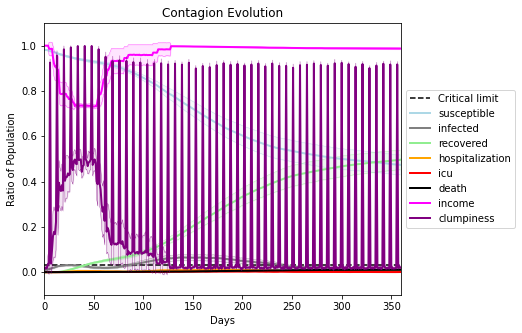

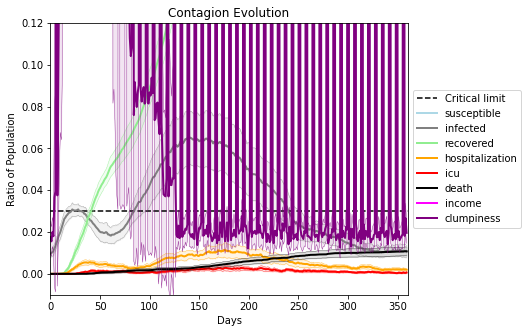

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6089, 1530, 4614, 2446, 1831, 7573, 8032, 2023, 2808, 5429, 8026, 7994, 4628, 2728, 1468, 8957, 738, 5713, 2306, 6254]
Average similarity between family members is 0.42471776885047896 at temperature -0.8
Average similarity between family and home is 0.9998489775491932 at temperature -1
Average similarity between students and their classroom is 0.18892945500869582 at temperature -0.8
Average classroom occupancy is 4.042253521126761 and number classrooms is 71
Average similarity between workers is 0.29075571508056586 at temperature -0.8
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.492723169295275 for kids: 0.35830568708641664
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBui

avg restaurant similarity 0.14432858903422707
avg restaurant similarity 0.1093446833748546
avg restaurant similarity 0.0676371946718808
avg restaurant similarity 0.08592769741705628
avg restaurant similarity 0.1020902439339471
avg restaurant similarity 0.1232856780407735
avg restaurant similarity 0.0764705275742903
avg restaurant similarity 0.1096078527455238
avg restaurant similarity 0.11155915893926159
avg restaurant similarity 0.10403184117945645
avg restaurant similarity 0.08996427223142714
avg restaurant similarity 0.07811289402446714
avg restaurant similarity 0.058482497055464856
avg restaurant similarity 0.08108004564432002
avg restaurant similarity 0.1193346353174131
avg restaurant similarity 0.12940863850120596
avg restaurant similarity 0.10626030091300688
avg restaurant similarity 0.09728213296198857
avg restaurant similarity 0.08738844089625558
avg restaurant similarity 0.05991500647192016
avg restaurant similarity 0.14862970674680176
avg restaurant similarity 0.144964719779

avg restaurant similarity 0.06690661096948063
avg restaurant similarity 0.06142312304042848
avg restaurant similarity 0.14381449570859095
avg restaurant similarity 0.07898097868113282
avg restaurant similarity 0.07496182212205
avg restaurant similarity 0.13429199381264198
avg restaurant similarity 0.05713385210482613
avg restaurant similarity 0.06874625888543483
avg restaurant similarity 0.1266437963885763
avg restaurant similarity 0.1476138565875673
avg restaurant similarity 0.078087707404391
avg restaurant similarity 0.09085940105873072
avg restaurant similarity 0.14621257449560865
avg restaurant similarity 0.07555288098258618
avg restaurant similarity 0.11597247466312911
avg restaurant similarity 0.11411502962901865
avg restaurant similarity 0.10850883651746243
avg restaurant similarity 0.08729173622875579
avg restaurant similarity 0.09054473789485941
avg restaurant similarity 0.11662940408120363
avg restaurant similarity 0.08391169872539969
avg restaurant similarity 0.1002845485975

avg restaurant similarity 0.14956333068071961
avg restaurant similarity 0.12557386636667095
avg restaurant similarity 0.07834863379050226
avg restaurant similarity 0.05412218630584262
avg restaurant similarity 0.12230974204518168
avg restaurant similarity 0.08883714111064735
avg restaurant similarity 0.13198059317237634
avg restaurant similarity 0.11566048146492866
avg restaurant similarity 0.11768569101518711
avg restaurant similarity 0.16927846883443215
avg restaurant similarity 0.12938395050851706
avg restaurant similarity 0.1161185676480506
avg restaurant similarity 0.14254526939254777
avg restaurant similarity 0.17439120640774547
avg restaurant similarity 0.09399409938341113
avg restaurant similarity 0.0973242332402191
avg restaurant similarity 0.12340473747317578
avg restaurant similarity 0.12485869609415258
avg restaurant similarity 0.10326917366884747
avg restaurant similarity 0.11781917603302444
avg restaurant similarity 0.11182886799008974
avg restaurant similarity 0.11616326

avg restaurant similarity 0.12871121627558824
avg restaurant similarity 0.08960327775647588
avg restaurant similarity 0.17541259720323538
avg restaurant similarity 0.0919710664756678
avg restaurant similarity 0.15901031866432339
avg restaurant similarity 0.08482067235428604
avg restaurant similarity 0.133590378133223
avg restaurant similarity 0.09602929385337071
avg restaurant similarity 0.154788242126303
avg restaurant similarity 0.12223431334919801
avg restaurant similarity 0.15507053198921844
avg restaurant similarity 0.1263317855561752
avg restaurant similarity 0.11584311866041953
avg restaurant similarity 0.09453198119801205
avg restaurant similarity 0.09150775160526653
avg restaurant similarity 0.13343942610230092
avg restaurant similarity 0.08261590278521076
avg restaurant similarity 0.11953365691809956
avg restaurant similarity 0.14181859322173684
avg restaurant similarity 0.07413694548512895
avg restaurant similarity 0.09791238262462543
avg restaurant similarity 0.070337511679

avg restaurant similarity 0.048902504593616225
avg restaurant similarity 0.1536470296220054
avg restaurant similarity 0.04371649871706089
avg restaurant similarity 0.13899190374180523
avg restaurant similarity 0.07038437598933688
avg restaurant similarity 0.07572537041835174
avg restaurant similarity 0.0673519863138537
avg restaurant similarity 0.12214050467932856
avg restaurant similarity 0.046289563354797815
avg restaurant similarity 0.007927216380870027
avg restaurant similarity 0.0963485807590306
avg restaurant similarity 0.11926143136065956
avg restaurant similarity 0.12061695685115231
avg restaurant similarity 0.08441528378172088
avg restaurant similarity 0.06378066927798172
avg restaurant similarity 0.10019627767849998
avg restaurant similarity 0.066022958840036
avg restaurant similarity 0.0873434258039065
avg restaurant similarity 0.13155687144398134
avg restaurant similarity 0.08115620190165307
avg restaurant similarity 0.10360760158349229
avg restaurant similarity 0.056569738

avg restaurant similarity 0.08062008991045476
avg restaurant similarity 0.07963684681784244
avg restaurant similarity 0.05183944302310692
avg restaurant similarity 0.13505274786621038
avg restaurant similarity 0.09084211430812049
avg restaurant similarity 0.08975489698644336
avg restaurant similarity 0.09434766261726701
avg restaurant similarity 0.05526138826832428
avg restaurant similarity 0.051267891240071584
avg restaurant similarity 0.0441077934361397
avg restaurant similarity 0.07163686355605635
avg restaurant similarity 0.12299453060311039
avg restaurant similarity 0.09651707552317539
avg restaurant similarity 0.11750459068482236
avg restaurant similarity 0.11952744536787084
avg restaurant similarity 0.09255633756633194
avg restaurant similarity 0.12202538932564899
avg restaurant similarity 0.10431926530663599
avg restaurant similarity 0.07283646489019967
avg restaurant similarity 0.15104123673048866
avg restaurant similarity 0.05493928934180877
avg restaurant similarity 0.088296

avg restaurant similarity 0.1261441523271783
avg restaurant similarity 0.12758155263890805
avg restaurant similarity 0.1114638125111718
avg restaurant similarity 0.07985756124949402
avg restaurant similarity 0.08092237256516689
avg restaurant similarity 0.1208825589983226
avg restaurant similarity 0.12435846038054033
avg restaurant similarity 0.06123049682074876
avg restaurant similarity 0.06578226104871003
avg restaurant similarity 0.18193371128146246
avg restaurant similarity 0.057064025769921874
avg restaurant similarity 0.09571749014842555
avg restaurant similarity 0.08520036486129455
avg restaurant similarity 0.025868199232998584
avg restaurant similarity 0.10223281742377072
avg restaurant similarity 0.03147882798311054
avg restaurant similarity 0.12283312816263947
avg restaurant similarity 0.08561634903549965
avg restaurant similarity -0.009589591120505139
avg restaurant similarity 0.10250682253645521
avg restaurant similarity 0.1160897842075497
avg restaurant similarity 0.148303

avg restaurant similarity 0.10324041780762631
avg restaurant similarity 0.05813244238996803
avg restaurant similarity 0.06753961508307062
avg restaurant similarity 0.06237633138210262
avg restaurant similarity 0.05270760152477841
avg restaurant similarity 0.15656232547824883
avg restaurant similarity 0.0026899801195050116
avg restaurant similarity 0.040846842236309626
avg restaurant similarity 0.042143327959588105
avg restaurant similarity 0.15375548077228435
avg restaurant similarity 0.07601627230308353
avg restaurant similarity 0.03705534742303257
avg restaurant similarity 0.06995516309773923
avg restaurant similarity 0.0950482911855191
avg restaurant similarity 0.04741139998161138
avg restaurant similarity 0.062308161373118266
avg restaurant similarity 0.028786854151573227
avg restaurant similarity 0.14285466548169357
avg restaurant similarity 0.06058352170284428
avg restaurant similarity 0.07046132097939152
avg restaurant similarity 0.07337958969507574
avg restaurant similarity 0.0

avg restaurant similarity 0.11078423431498192
avg restaurant similarity 0.1124487026127577
avg restaurant similarity 0.11233966589247646
avg restaurant similarity 0.13384803941728884
avg restaurant similarity 0.10214074614461288
avg restaurant similarity 0.1242804520613258
avg restaurant similarity 0.14440728447794515
avg restaurant similarity 0.12060210771756905
avg restaurant similarity 0.0849919063371302
avg restaurant similarity 0.13956419637348358
avg restaurant similarity 0.1371279679794173
avg restaurant similarity 0.06934482622761148
avg restaurant similarity 0.14989224328015877
avg restaurant similarity 0.09170578691256294
avg restaurant similarity 0.13335610879801613
avg restaurant similarity 0.12024589324727189
avg restaurant similarity 0.12196401213700038
avg restaurant similarity 0.14491729964006844
avg restaurant similarity 0.14351420715766539
avg restaurant similarity 0.13251493066527267
avg restaurant similarity 0.07528615022508131
avg restaurant similarity 0.0401267633

avg restaurant similarity 0.12883540979851804
avg restaurant similarity 0.08467403844097876
avg restaurant similarity 0.08438068619909644
avg restaurant similarity 0.09896768259806878
avg restaurant similarity 0.0879773419603051
avg restaurant similarity 0.18900339006421438
avg restaurant similarity 0.11615015293543805
avg restaurant similarity 0.13843551035572665
avg restaurant similarity 0.10743146437195485
avg restaurant similarity 0.06491101368169058
avg restaurant similarity 0.03422077315449575
avg restaurant similarity 0.13326699514954327
avg restaurant similarity 0.10673070750618315
avg restaurant similarity 0.1463309231245156
avg restaurant similarity 0.14211829001133652
avg restaurant similarity 0.1382936504246098
avg restaurant similarity 0.15766108111690413
avg restaurant similarity 0.1003657374622771
avg restaurant similarity 0.13530622248010304
avg restaurant similarity 0.12181980605325565
avg restaurant similarity 0.08978158467155782
avg restaurant similarity 0.0875039468

avg restaurant similarity -0.014843290957955795
avg restaurant similarity 0.03775693496599131
avg restaurant similarity 0.04822069419288754
avg restaurant similarity 0.07036235906591332
avg restaurant similarity -0.008130010629426953
avg restaurant similarity 0.05142058525451254
avg restaurant similarity 0.0645873926085488
avg restaurant similarity 0.07018855568939195
avg restaurant similarity 0.046760245282675174
avg restaurant similarity 0.058084861711993924
avg restaurant similarity 0.0557861286064829
avg restaurant similarity 0.01920366537705698
avg restaurant similarity 0.07368616791292307
avg restaurant similarity 0.08317900044758278
avg restaurant similarity 0.07305455315200854
avg restaurant similarity 0.13949536460555154
avg restaurant similarity 0.09171051993729888
avg restaurant similarity 0.06176774108579342
avg restaurant similarity 0.003922823426996044
avg restaurant similarity 0.07355730607127968
avg restaurant similarity 0.11720435524779785
avg restaurant similarity 0.0

avg restaurant similarity 0.0848626620984167
avg restaurant similarity 0.09317849519826103
avg restaurant similarity 0.07296786203570453
avg restaurant similarity 0.03935747781525572
avg restaurant similarity -0.012223619070077858
avg restaurant similarity 0.07147776317628889
avg restaurant similarity 0.04275326828027767
avg restaurant similarity 0.05853807109244071
avg restaurant similarity 0.07942828845575851
avg restaurant similarity 0.07496316668299387
avg restaurant similarity 0.05443369408663377
avg restaurant similarity 0.10122273130173207
avg restaurant similarity 0.07591398527288451
avg restaurant similarity 0.08166300117477454
avg restaurant similarity -0.0010475324631293403
avg restaurant similarity 0.06748025065358124
avg restaurant similarity 0.09341908634143087
avg restaurant similarity 0.11060348772022492
avg restaurant similarity -0.0010221573699033069
avg restaurant similarity 0.02784385758012415
avg restaurant similarity 0.11383724547706035
avg restaurant similarity 0

avg restaurant similarity 0.10279110046639298
avg restaurant similarity 0.05701561068419193
avg restaurant similarity 0.08528836808530264
avg restaurant similarity 0.040480574745171645
avg restaurant similarity 0.08616201725859148
avg restaurant similarity 0.06383789038465637
avg restaurant similarity 0.08295496053959943
avg restaurant similarity 0.03651429179561474
avg restaurant similarity 0.14667771747869077
avg restaurant similarity 0.015606618459974715
avg restaurant similarity 0.09281048135234844
avg restaurant similarity 0.10557469152183767
avg restaurant similarity 0.03633300621473392
avg restaurant similarity 0.06114404392564558
avg restaurant similarity 0.16195550658039737
avg restaurant similarity 0.05200729343180714
avg restaurant similarity 0.13553063089514458
avg restaurant similarity 0.10108112999988791
avg restaurant similarity 0.05822792858898824
avg restaurant similarity 0.04355299838568096
avg restaurant similarity 0.0492286458307838
avg restaurant similarity 0.10090

avg restaurant similarity 0.08710128069729316
avg restaurant similarity 0.027566586660331464
avg restaurant similarity 0.1453449768626234
avg restaurant similarity 0.12220952023463703
avg restaurant similarity 0.0924485641009044
avg restaurant similarity 0.03562145323479552
avg restaurant similarity 0.12613874845565087
avg restaurant similarity 0.022995197746737944
avg restaurant similarity 0.0845468944765979
avg restaurant similarity 0.11439204967992887
avg restaurant similarity 0.07016425810739431
avg restaurant similarity 0.02837498045191589
avg restaurant similarity 0.013702738722230462
avg restaurant similarity 0.09294724923424068
avg restaurant similarity 0.08841476047203413
avg restaurant similarity 0.05962334174490198
avg restaurant similarity 0.11367393828937361
avg restaurant similarity 0.038359234957761335
avg restaurant similarity 0.062317540243634784
avg restaurant similarity 0.09824588803555115
avg restaurant similarity 0.09662093180585049
avg restaurant similarity 0.1270

avg restaurant similarity 0.10497601800030344
avg restaurant similarity 0.057903599240718945
avg restaurant similarity 0.1018190481496452
avg restaurant similarity 0.10496628629222704
avg restaurant similarity 0.04850924465604099
avg restaurant similarity 0.11869688720057935
avg restaurant similarity 0.10013927951098726
avg restaurant similarity 0.09730618770506798
avg restaurant similarity 0.08591458908908102
avg restaurant similarity 0.03173131273828172
avg restaurant similarity 0.12823597302941198
avg restaurant similarity 0.010326041058322043
avg restaurant similarity 0.0703103723022839
avg restaurant similarity 0.15264406639014225
avg restaurant similarity 0.10255439893481712
avg restaurant similarity 0.03827554129111598
avg restaurant similarity 0.18163838406649208
avg restaurant similarity 0.0602770506243783
avg restaurant similarity 0.10027329306285716
avg restaurant similarity 0.07006457667468817
avg restaurant similarity 0.024215695275901065
avg restaurant similarity 0.171142

avg restaurant similarity 0.0647366725621826
avg restaurant similarity 0.09730793995441418
avg restaurant similarity 0.09684373834907282
avg restaurant similarity 0.08353178357492103
avg restaurant similarity 0.09502256455954179
avg restaurant similarity 0.04264882199781851
avg restaurant similarity 0.14077371645217948
avg restaurant similarity 0.16410406305015263
avg restaurant similarity 0.05888215752407855
avg restaurant similarity 0.04015478116240796
avg restaurant similarity 0.1320924392379216
avg restaurant similarity 0.12608373499762646
avg restaurant similarity 0.059697090740328314
avg restaurant similarity 0.09209522358930365
avg restaurant similarity 0.08903847926386124
avg restaurant similarity 0.05496381709812619
avg restaurant similarity 0.12017292982244963
avg restaurant similarity 0.06563710765208443
avg restaurant similarity 0.1248763008810535
avg restaurant similarity 0.037310876039495997
avg restaurant similarity 0.052352775417633154
avg restaurant similarity 0.104263

avg restaurant similarity 0.019360878347429618
avg restaurant similarity 0.09756866682563654
avg restaurant similarity 0.10777368127203579
avg restaurant similarity 0.06561834689948554
avg restaurant similarity 0.10307779483631258
avg restaurant similarity 0.05357991211676067
avg restaurant similarity 0.09732489777376135
avg restaurant similarity 0.07374200201167103
avg restaurant similarity 0.12122303173099647
avg restaurant similarity 0.10081760535124007
avg restaurant similarity 0.10971624247693591
avg restaurant similarity 0.14442461312781343
avg restaurant similarity 0.10204271903717184
avg restaurant similarity 0.10828964070506489
avg restaurant similarity 0.18438711445150396
avg restaurant similarity 0.0442560429334065
avg restaurant similarity 0.14592358688219847
avg restaurant similarity 0.12873230890307402
avg restaurant similarity 0.16108185382825635
avg restaurant similarity 0.15494075204768532
avg restaurant similarity 0.09937927893875256
avg restaurant similarity 0.114711

avg restaurant similarity 0.12574080779628355
avg restaurant similarity 0.12036367544382193
avg restaurant similarity 0.15706538278056675
avg restaurant similarity 0.14011918966682801
avg restaurant similarity 0.15229915656775386
avg restaurant similarity 0.1390733197979288
avg restaurant similarity 0.08492796263206535
avg restaurant similarity 0.07587305871756718
avg restaurant similarity 0.11706099853686246
avg restaurant similarity 0.16827814349046424
avg restaurant similarity 0.1361645469125307
avg restaurant similarity 0.11305535855369876
avg restaurant similarity 0.10947445978625814
avg restaurant similarity 0.1113388639817001
avg restaurant similarity 0.12314913566125824
avg restaurant similarity 0.17672886374415853
avg restaurant similarity 0.13650631270155453
avg restaurant similarity 0.14369045612036152
avg restaurant similarity 0.15958512505169947
avg restaurant similarity 0.09632834380997048
avg restaurant similarity 0.10949243135948322
avg restaurant similarity 0.150613310

avg restaurant similarity 0.056309868039973066
avg restaurant similarity 0.07407790391380659
avg restaurant similarity 0.047561770454404705
avg restaurant similarity 0.03609300111127177
avg restaurant similarity 0.08855368619280282
avg restaurant similarity 0.04615534429905838
avg restaurant similarity 0.0651031706382583
avg restaurant similarity 0.0456823401728671
avg restaurant similarity 0.10385742831641265
avg restaurant similarity 0.06636934111717584
avg restaurant similarity 0.06958431975542237
avg restaurant similarity 0.07703836678695657
avg restaurant similarity 0.021799803225636766
avg restaurant similarity 0.12052987750247833
avg restaurant similarity 0.14735435027846283
avg restaurant similarity 0.10361974414144595
avg restaurant similarity 0.07207467706428958
avg restaurant similarity 0.08355936177320337
avg restaurant similarity 0.06907412776900587
avg restaurant similarity 0.1000263653784096
avg restaurant similarity 0.08589057985117451
avg restaurant similarity 0.074368

avg restaurant similarity -0.004008170656522344
avg restaurant similarity 0.0839513395205338
avg restaurant similarity 0.048819006198839256
avg restaurant similarity 0.12745312705394032
avg restaurant similarity 0.09281818210795109
avg restaurant similarity 0.12085298289178839
avg restaurant similarity 0.07992451342659036
avg restaurant similarity 0.04946633431858892
avg restaurant similarity 0.043991804466763686
avg restaurant similarity 0.06965487916289792
avg restaurant similarity 0.04290884100128802
avg restaurant similarity 0.09556046126963232
avg restaurant similarity 0.057258679669493794
avg restaurant similarity 0.06975123365907455
avg restaurant similarity 0.11696049580018185
avg restaurant similarity 0.06198134412565892
avg restaurant similarity 0.036044709080127996
avg restaurant similarity 0.1485930554965806
avg restaurant similarity 0.055045118940123455
avg restaurant similarity 0.11417019539112752
avg restaurant similarity 0.03910332231794857
avg restaurant similarity 0.1

avg restaurant similarity 0.1441876281739441
avg restaurant similarity 0.06659880770509534
avg restaurant similarity 0.07784942747247027
avg restaurant similarity 0.098059216978244
avg restaurant similarity 0.052923197663772265
avg restaurant similarity 0.11775692125852322
avg restaurant similarity 0.14809277067424487
avg restaurant similarity 0.08665038620641967
avg restaurant similarity 0.09982852129701365
avg restaurant similarity 0.11948076969010916
avg restaurant similarity 0.08047304041884944
avg restaurant similarity 0.0844956836107084
avg restaurant similarity 0.09276749380340236
avg restaurant similarity 0.13582971984227862
avg restaurant similarity 0.06303990954964636
avg restaurant similarity 0.1557593199740675
avg restaurant similarity 0.09486649717260029
avg restaurant similarity 0.12563474624224938
avg restaurant similarity 0.06048893214136091
avg restaurant similarity 0.07477073197281218
avg restaurant similarity 0.04552203593385862
avg restaurant similarity 0.1063171136

avg restaurant similarity 0.11837602098607561
avg restaurant similarity 0.08145320020007024
avg restaurant similarity 0.08700107111956105
avg restaurant similarity 0.10370936581690249
avg restaurant similarity 0.13170374519844555
avg restaurant similarity 0.12514582079880468
avg restaurant similarity 0.17723443996927543
avg restaurant similarity 0.18688291324312115
avg restaurant similarity 0.16568575441945121
avg restaurant similarity 0.07201385176622231
avg restaurant similarity 0.07866600527771066
avg restaurant similarity 0.10113873479790496
avg restaurant similarity 0.14370617057209956
avg restaurant similarity 0.10526946089622448
avg restaurant similarity 0.12421486865048602
avg restaurant similarity 0.10945275766333822
avg restaurant similarity 0.061170121146606866
avg restaurant similarity 0.10465482358543145
avg restaurant similarity 0.09493164785482582
avg restaurant similarity 0.1541719795125207
avg restaurant similarity 0.08128457634498283
avg restaurant similarity 0.045653

avg restaurant similarity 0.07601031681062705
avg restaurant similarity 0.1316551837769452
avg restaurant similarity 0.09644638545223115
avg restaurant similarity 0.10906039662207623
avg restaurant similarity 0.06682876325536283
avg restaurant similarity 0.11021293273982884
avg restaurant similarity 0.058475068597539245
avg restaurant similarity 0.11095810110169704
avg restaurant similarity 0.09904562242273092
avg restaurant similarity 0.07018201569095585
avg restaurant similarity 0.04618074196293165
avg restaurant similarity 0.05898403590673294
avg restaurant similarity 0.084063029073207
avg restaurant similarity 0.13436814126210955
avg restaurant similarity 0.06932488770799569
avg restaurant similarity 0.10262445802446381
avg restaurant similarity 0.16471859544713865
avg restaurant similarity 0.10126249512103043
avg restaurant similarity 0.06502508578667819
avg restaurant similarity 0.052164959645269376
avg restaurant similarity 0.08393959729274576
avg restaurant similarity 0.0926780

avg restaurant similarity 0.0774268104070822
avg restaurant similarity 0.05292721705079365
avg restaurant similarity 0.0760971593672554
avg restaurant similarity 0.09073429414209645
avg restaurant similarity 0.030919021607174572
avg restaurant similarity 0.13935523035074082
avg restaurant similarity 0.08909009174230884
avg restaurant similarity 0.09637285736186767
avg restaurant similarity 0.07527344221630258
avg restaurant similarity 0.04660653628759783
avg restaurant similarity 0.1249194961996189
avg restaurant similarity 0.1325727861316676
avg restaurant similarity 0.06807761439884469
avg restaurant similarity 0.06157692961371047
avg restaurant similarity 0.1057463669937508
avg restaurant similarity 0.07067533940744865
avg restaurant similarity 0.08820991457776108
avg restaurant similarity 0.059431044167209984
avg restaurant similarity 0.05650227631745399
avg restaurant similarity 0.05869599041579893
avg restaurant similarity 0.1382368813323661
avg restaurant similarity 0.0617980808

avg restaurant similarity -0.010120107623022775
avg restaurant similarity -0.00598623556181948
avg restaurant similarity 0.0704178898677829
avg restaurant similarity 0.00574919160280515
avg restaurant similarity 0.0020158656009762986
avg restaurant similarity 0.09580008873242
avg restaurant similarity 0.041994740369935085
avg restaurant similarity 0.0977080005920472
avg restaurant similarity 0.07354769698157722
avg restaurant similarity 0.06876864857940201
avg restaurant similarity 0.10262343567539377
avg restaurant similarity 0.06537460486526447
avg restaurant similarity 0.08100982030066534
avg restaurant similarity 0.02335262038769609
avg restaurant similarity 0.13217999198731084
avg restaurant similarity 0.08348015015612922
avg restaurant similarity 0.02902483381387566
avg restaurant similarity 0.04801876751392728
avg restaurant similarity 0.1108023606803892
avg restaurant similarity 0.036811468286847164
avg restaurant similarity 0.047780962742064316
avg restaurant similarity 0.0590

avg restaurant similarity 0.04191937544884013
avg restaurant similarity 0.04683880949811269
avg restaurant similarity 0.16135117072214447
avg restaurant similarity 0.09747989541110882
avg restaurant similarity 0.05364202023371361
avg restaurant similarity 0.006189383706571059
avg restaurant similarity 0.04917589758554989
avg restaurant similarity 0.08682451294217494
avg restaurant similarity 0.07056512176648294
avg restaurant similarity 0.06207081801052628
avg restaurant similarity 0.06669527670961466
avg restaurant similarity 0.10268676029106515
avg restaurant similarity 0.00037907902232916515
avg restaurant similarity 0.1073804372864616
avg restaurant similarity 0.11511467410224459
avg restaurant similarity 0.10582364199262158
avg restaurant similarity 0.01902590976834261
avg restaurant similarity 0.06333846680507313
avg restaurant similarity 0.07612799023645035
avg restaurant similarity 0.09538586270835162
avg restaurant similarity 0.04661701062583675
avg restaurant similarity 0.091

avg restaurant similarity 0.08470150549253487
avg restaurant similarity 0.1086232690566638
avg restaurant similarity 0.1368799529340164
avg restaurant similarity 0.09251935960741943
avg restaurant similarity 0.113920187234955
avg restaurant similarity 0.1102481638535066
avg restaurant similarity 0.12366243962096901
avg restaurant similarity 0.05380724406897056
avg restaurant similarity 0.07660708579870866
avg restaurant similarity 0.0031202994762189345
avg restaurant similarity 0.08820671333475294
avg restaurant similarity 0.08763806513927364
avg restaurant similarity 0.06650337779201593
avg restaurant similarity 0.059482654483484644
avg restaurant similarity 0.1372587267730869
avg restaurant similarity 0.1164027655896921
avg restaurant similarity 0.08598562880229729
avg restaurant similarity 0.058897234013669815
avg restaurant similarity 0.09882771441431856
avg restaurant similarity 0.04678114265473764
avg restaurant similarity 0.0955006285605108
avg restaurant similarity 0.1101490254

avg restaurant similarity 0.0987806608759714
avg restaurant similarity 0.07409225431152992
avg restaurant similarity 0.09743019443491643
avg restaurant similarity 0.15242116095683825
avg restaurant similarity 0.11047283926967917
avg restaurant similarity 0.06634291511900478
avg restaurant similarity 0.15204045889941611
avg restaurant similarity 0.11296657011085542
avg restaurant similarity 0.06629284046874148
avg restaurant similarity 0.04081553577769979
avg restaurant similarity 0.0949393144236265
avg restaurant similarity 0.10410131457229019
avg restaurant similarity 0.08114853814339917
avg restaurant similarity 0.13380009706679033
avg restaurant similarity 0.13627715883263525
avg restaurant similarity 0.11338024390770017
avg restaurant similarity 0.0768079220764771
avg restaurant similarity 0.11876890648139089
avg restaurant similarity 0.085627170867814
avg restaurant similarity 0.030174981602875416
avg restaurant similarity 0.11991045105748435
avg restaurant similarity 0.1034381370

avg restaurant similarity 0.09760565121768326
avg restaurant similarity 0.1136681492580973
avg restaurant similarity 0.0943312389273534
avg restaurant similarity 0.0650355883971054
avg restaurant similarity 0.06487047160738091
avg restaurant similarity 0.08432557278384353
avg restaurant similarity 0.07878226510427154
avg restaurant similarity 0.08038998691860202
avg restaurant similarity 0.11725734395210594
avg restaurant similarity 0.05910862069798844
avg restaurant similarity 0.09303174989329635
avg restaurant similarity 0.06790657332550834
avg restaurant similarity 0.11377141388301751
avg restaurant similarity 0.10490689105112373
avg restaurant similarity 0.13019105808093476
avg restaurant similarity 0.059089390054858956
avg restaurant similarity 0.1070906349305411
avg restaurant similarity 0.11197794676497985
avg restaurant similarity 0.016138896244727422
avg restaurant similarity 0.09246492293336836
avg restaurant similarity 0.0956601305102174
avg restaurant similarity 0.075499193

avg restaurant similarity 0.07794997964684651
avg restaurant similarity 0.02946474841570763
avg restaurant similarity 0.11936484747637868
avg restaurant similarity 0.13053002100995112
avg restaurant similarity 0.14422328209155957
avg restaurant similarity 0.11044338773480505
avg restaurant similarity 0.0724374801862848
avg restaurant similarity 0.10189472320378244
avg restaurant similarity 0.13662132960949291
avg restaurant similarity 0.059170891896240065
avg restaurant similarity 0.11417847141846701
avg restaurant similarity 0.13178293208639824
avg restaurant similarity 0.10653874054365471
avg restaurant similarity 0.13875800556275433
avg restaurant similarity 0.13178541337762023
avg restaurant similarity 0.09629287684313732
avg restaurant similarity 0.13396608728465717
avg restaurant similarity 0.12058916397184205
avg restaurant similarity 0.09104673512838123
avg restaurant similarity 0.09453827140776612
avg restaurant similarity 0.11712985979309544
avg restaurant similarity 0.105387

avg restaurant similarity 0.10420895456102802
avg restaurant similarity 0.04667530492963055
avg restaurant similarity 0.0905642003853723
avg restaurant similarity 0.06259608908814848
avg restaurant similarity 0.09454194288166759
avg restaurant similarity 0.08982659774764688
avg restaurant similarity 0.10990362825369555
avg restaurant similarity 0.07989394327096425
avg restaurant similarity 0.08309484167053062
avg restaurant similarity 0.029493741031097084
avg restaurant similarity 0.06203947499745495
avg restaurant similarity 0.12333426146424872
avg restaurant similarity 0.08602735468096663
avg restaurant similarity -0.015929981223315855
avg restaurant similarity 0.06753790788959327
avg restaurant similarity 0.03711571481951196
avg restaurant similarity 0.09929352869030578
avg restaurant similarity 0.040525682536474664
avg restaurant similarity 0.038016794056330454
avg restaurant similarity 0.0335485159858657
avg restaurant similarity 0.08387564596167384
avg restaurant similarity 0.050

avg restaurant similarity 0.0545117099240391
avg restaurant similarity 0.07999839477733457
avg restaurant similarity 0.018900309400316593
avg restaurant similarity -0.006643570045116734
avg restaurant similarity 0.08590123654700067
avg restaurant similarity 0.04554528231227409
avg restaurant similarity 0.0961670377317554
avg restaurant similarity 0.14407241032808776
avg restaurant similarity 0.11568711696961186
avg restaurant similarity 0.08482971877441756
avg restaurant similarity 0.0458957691519583
avg restaurant similarity 0.06721026480899805
avg restaurant similarity 0.09797048265556359
avg restaurant similarity 0.08679099152973044
avg restaurant similarity 0.08547761289839986
avg restaurant similarity 0.11228522390456763
avg restaurant similarity 0.04553611630083415
avg restaurant similarity 0.08387412729453454
avg restaurant similarity 0.12209387532988997
avg restaurant similarity 0.1124818187570087
avg restaurant similarity 0.06600383539092743
avg restaurant similarity 0.1194302

avg restaurant similarity 0.02965437163265584
avg restaurant similarity 0.09839592993124713
avg restaurant similarity 0.082455699482145
avg restaurant similarity 0.0532556848004059
avg restaurant similarity 0.09373341082923278
avg restaurant similarity 0.0631716721848505
avg restaurant similarity 0.09133220414236821
avg restaurant similarity 0.07939598294780091
avg restaurant similarity 0.1161823349035646
avg restaurant similarity 0.08324498282802302
avg restaurant similarity 0.08764522816221665
avg restaurant similarity 0.11734723868244279
avg restaurant similarity 0.08940283052822563
avg restaurant similarity 0.055929640283331236
avg restaurant similarity 0.09484105662730544
avg restaurant similarity 0.048977802220194364
avg restaurant similarity 0.07333771475088642
avg restaurant similarity 0.0893567156291947
avg restaurant similarity 0.041066227438198814
avg restaurant similarity 0.06548288883132888
avg restaurant similarity 0.14997696205874997
avg restaurant similarity 0.041186868

avg restaurant similarity 0.07726709515013784
avg restaurant similarity 0.04280797504450772
avg restaurant similarity 0.09631970341825082
avg restaurant similarity 0.08693720668003857
avg restaurant similarity 0.11481080387001667
avg restaurant similarity 0.08636403120918396
avg restaurant similarity 0.07448865666997853
avg restaurant similarity 0.061327716094981874
avg restaurant similarity 0.06986328952906036
avg restaurant similarity 0.07368231270742567
avg restaurant similarity 0.03594481992690501
avg restaurant similarity 0.0722076520663463
avg restaurant similarity 0.08712037818850171
avg restaurant similarity 0.05756798773131355
avg restaurant similarity 0.06419875388521953
avg restaurant similarity 0.0739556079972501
avg restaurant similarity 0.07616032196348477
avg restaurant similarity 0.06222565517100829
avg restaurant similarity 0.05749678116691003
avg restaurant similarity 0.0875815212301646
avg restaurant similarity 0.09901680479652927
avg restaurant similarity 0.16378190

avg restaurant similarity 0.07255268449668942
avg restaurant similarity 0.11847210918377103
avg restaurant similarity 0.013967559504670705
avg restaurant similarity -0.003675211106442637
avg restaurant similarity 0.048954406588064776
avg restaurant similarity 0.10439253086028892
avg restaurant similarity 0.07331437759061561
avg restaurant similarity 0.058213189711203026
avg restaurant similarity 0.05389625883037678
avg restaurant similarity 0.10812466861751874
avg restaurant similarity 0.10765414879441516
avg restaurant similarity 0.05684594437217167
avg restaurant similarity 0.09701441647767207
avg restaurant similarity 0.05248659201264945
avg restaurant similarity 0.0929591420360838
avg restaurant similarity 0.10171473517050973
avg restaurant similarity 0.06558105750929308
avg restaurant similarity 0.06066207089423186
avg restaurant similarity 0.10956266601337157
avg restaurant similarity 0.0423272834660536
avg restaurant similarity 0.09712466658469379
avg restaurant similarity 0.066

avg restaurant similarity 0.035565114554129244
avg restaurant similarity 0.13670320671071776
avg restaurant similarity 0.08516112103345273
avg restaurant similarity 0.037545512849519375
avg restaurant similarity 0.096993901237149
avg restaurant similarity 0.06369025242511112
avg restaurant similarity 0.08324968237938567
avg restaurant similarity 0.1067277979579291
avg restaurant similarity 0.07035788779033009
avg restaurant similarity 0.1455031355589781
avg restaurant similarity 0.015143213463512504
avg restaurant similarity 0.05382979816670824
avg restaurant similarity 0.019356607081676053
avg restaurant similarity 0.12344084284565972
avg restaurant similarity 0.060374161684887205
avg restaurant similarity 0.0494566199895289
avg restaurant similarity 0.02465095859437332
avg restaurant similarity 0.07749531862029403
avg restaurant similarity 0.05331047814751194
avg restaurant similarity 0.13552853628690534
avg restaurant similarity 0.089154056484757
avg restaurant similarity 0.02742255

avg restaurant similarity 0.05258477472209019
avg restaurant similarity 0.06889483682538243
avg restaurant similarity 0.07240036262856112
avg restaurant similarity 0.10958014426073173
avg restaurant similarity 0.07277161582652492
avg restaurant similarity 0.0988681189268091
avg restaurant similarity 0.13933716274498475
avg restaurant similarity 0.0643856493317268
avg restaurant similarity 0.047225889324517205
avg restaurant similarity 0.07181950977046013
avg restaurant similarity 0.12356781110792685
avg restaurant similarity -0.0025851448450404414
avg restaurant similarity 0.05755894607527356
avg restaurant similarity -0.009773139245407961
avg restaurant similarity 0.15901059848785232
avg restaurant similarity 0.12765760988231636
avg restaurant similarity 0.022413113431590817
avg restaurant similarity 0.18661716541713308
avg restaurant similarity 0.10891983187995867
avg restaurant similarity 0.09610074897196043
avg restaurant similarity 0.06040571273056362
avg restaurant similarity 0.0

avg restaurant similarity 0.03883796062279323
avg restaurant similarity 0.027342489400058144
avg restaurant similarity 0.1807989909593145
avg restaurant similarity 0.06610268556127004
avg restaurant similarity -0.014807134487724307
avg restaurant similarity 0.1117580209629019
avg restaurant similarity 0.020005387249528387
avg restaurant similarity 0.10705519415431194
avg restaurant similarity 0.0789868872084841
avg restaurant similarity 0.10015938107651978
avg restaurant similarity 0.09820820066645694
avg restaurant similarity 0.11294571940357725
avg restaurant similarity 0.1440964025753549
avg restaurant similarity 0.1570329726690842
avg restaurant similarity 0.13074758337243508
avg restaurant similarity 0.09497455949020848
avg restaurant similarity 0.08256427892667052
avg restaurant similarity 0.1451031680880338
avg restaurant similarity 0.14065730306293245
avg restaurant similarity 0.13500145655578738
avg restaurant similarity 0.1471846401868423
avg restaurant similarity 0.112227077

avg restaurant similarity 0.10830012466496308
avg restaurant similarity 0.0539877100698479
avg restaurant similarity 0.04822162333389332
avg restaurant similarity 0.10419919441561863
avg restaurant similarity 0.14091705921862108
avg restaurant similarity 0.11561664875835038
avg restaurant similarity 0.12746266019538383
avg restaurant similarity 0.13352794706267002
avg restaurant similarity 0.1218620062149176
avg restaurant similarity 0.06690724803854592
avg restaurant similarity 0.0830779126175587
avg restaurant similarity 0.08618218409215536
avg restaurant similarity 0.10549284275677855
avg restaurant similarity 0.0802872391673396
avg restaurant similarity 0.10088217586585035
avg restaurant similarity 0.0986762167893322
avg restaurant similarity 0.06119170871844843
avg restaurant similarity 0.07082829650525865
avg restaurant similarity 0.07692058365481408
avg restaurant similarity 0.07196693838735081
avg restaurant similarity 0.11171211909892757
avg restaurant similarity 0.13774965806

avg restaurant similarity 0.10037034952328718
avg restaurant similarity 0.0489151764838748
avg restaurant similarity 0.02590656956974091
avg restaurant similarity 0.08177487668631869
avg restaurant similarity 0.14758736239385092
avg restaurant similarity 0.11254030154791922
avg restaurant similarity 0.11278876149930407
avg restaurant similarity 0.10567659780276177
avg restaurant similarity 0.09305551871409527
avg restaurant similarity 0.14764308583531138
avg restaurant similarity 0.12579135137310932
avg restaurant similarity 0.09099632874419061
avg restaurant similarity 0.17889325242740486
avg restaurant similarity 0.09533260344377205
avg restaurant similarity 0.03007042013060734
avg restaurant similarity 0.15514332607258682
avg restaurant similarity 0.14535882320824947
avg restaurant similarity 0.09784071850851347
avg restaurant similarity 0.0937159722362172
avg restaurant similarity 0.08714238780795573
avg restaurant similarity 0.09461095110170183
avg restaurant similarity 0.07694162

(<function dict.items>, <function dict.items>, <function dict.items>)

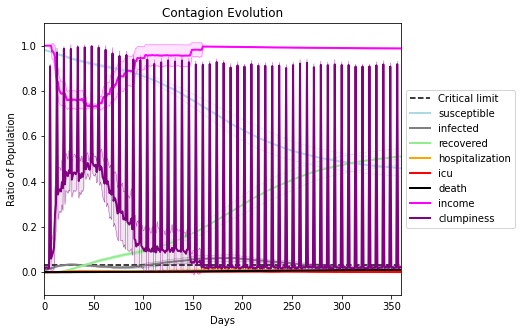

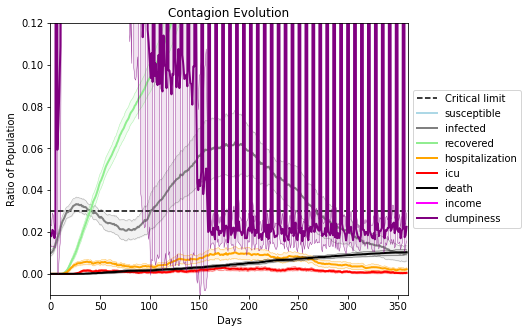

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[220, 7628, 3939, 2769, 8172, 7473, 192, 7294, 8904, 2342, 8556, 7611, 5531, 1617, 5840, 198, 9360, 5167, 2799, 5062]
Average similarity between family members is 0.33885153899892795 at temperature -0.7
Average similarity between family and home is 0.9998519809298833 at temperature -1
Average similarity between students and their classroom is 0.1392041832237085 at temperature -0.7
Average classroom occupancy is 4.144927536231884 and number classrooms is 69
Average similarity between workers is 0.19085114308769482 at temperature -0.7
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.42974930698801256 for kids: 0.2853322987827019
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.08145825885072451
avg restaurant similarity 0.12912364498614606
avg restaurant similarity 0.08063852077497619
avg restaurant similarity 0.07894914132948759
avg restaurant similarity 0.051607339509858255
avg restaurant similarity 0.13854990489148597
avg restaurant similarity 0.09872067605214467
avg restaurant similarity 0.08533972479633975
avg restaurant similarity 0.027594929325015078
avg restaurant similarity 0.08139518233837202
avg restaurant similarity 0.059386836912891136
avg restaurant similarity 0.08825256501863694
avg restaurant similarity 0.06621490636262863
avg restaurant similarity 0.08318073838883283
avg restaurant similarity 0.10335104714675483
avg restaurant similarity 0.11833205059506118
avg restaurant similarity 0.07866629095803253
avg restaurant similarity 0.07907671591807143
avg restaurant similarity 0.07317870807438687
avg restaurant similarity 0.09003985399267879
avg restaurant similarity 0.13545376926559513
avg restaurant similarity 0.106

avg restaurant similarity 0.1387956983828516
avg restaurant similarity 0.11150922373733782
avg restaurant similarity 0.06325879601052675
avg restaurant similarity 0.08704360035791756
avg restaurant similarity 0.0925034313836593
avg restaurant similarity 0.11090562497151417
avg restaurant similarity 0.12299157827192524
avg restaurant similarity 0.03931701675536647
avg restaurant similarity 0.044261167790154224
avg restaurant similarity 0.03729481310291701
avg restaurant similarity 0.11126990224666361
avg restaurant similarity 0.13373117075216484
avg restaurant similarity 0.09979257464984671
avg restaurant similarity 0.10334395754250354
avg restaurant similarity 0.046494697132473534
avg restaurant similarity 0.05813708193778976
avg restaurant similarity 0.1169213471133057
avg restaurant similarity 0.13356171323917446
avg restaurant similarity 0.08230564796405115
avg restaurant similarity 0.09603882604964387
avg restaurant similarity 0.07290425238866627
avg restaurant similarity 0.0509361

avg restaurant similarity 0.08625790355640824
avg restaurant similarity 0.06709382192302765
avg restaurant similarity 0.033136943231093695
avg restaurant similarity 0.0446375809762376
avg restaurant similarity 0.11594996133757485
avg restaurant similarity 0.08251529393218565
avg restaurant similarity 0.1239517677812098
avg restaurant similarity 0.12011839708561631
avg restaurant similarity 0.09995755310518532
avg restaurant similarity 0.03702173930663331
avg restaurant similarity 0.12275560562655233
avg restaurant similarity 0.143054943557416
avg restaurant similarity 0.07711930895726357
avg restaurant similarity 0.1512748858010396
avg restaurant similarity 0.11941843323670465
avg restaurant similarity 0.11752073539444897
avg restaurant similarity 0.1375141241691587
avg restaurant similarity 0.12801491068620846
avg restaurant similarity 0.09788251129684677
avg restaurant similarity 0.1657699092372517
avg restaurant similarity 0.13976722728228222
avg restaurant similarity 0.105427788599

avg restaurant similarity 0.10242555929704682
avg restaurant similarity 0.13344708689504728
avg restaurant similarity 0.1332883641655218
avg restaurant similarity 0.12040540404468901
avg restaurant similarity 0.15173546312457922
avg restaurant similarity 0.09464887337976062
avg restaurant similarity 0.11182527232277407
avg restaurant similarity 0.10492459476046527
avg restaurant similarity 0.18244633933090382
avg restaurant similarity 0.06456471727118603
avg restaurant similarity 0.1406212175429894
avg restaurant similarity 0.05132282850790508
avg restaurant similarity 0.11344153727888469
avg restaurant similarity 0.11301049361292115
avg restaurant similarity 0.11222230860537659
avg restaurant similarity 0.10301735822513203
avg restaurant similarity 0.08774837092855137
avg restaurant similarity 0.09148123733652429
avg restaurant similarity 0.12243802411800664
avg restaurant similarity 0.11592293067550982
avg restaurant similarity 0.10200420457155643
avg restaurant similarity 0.08048898

avg restaurant similarity 0.05942155653346323
avg restaurant similarity 0.09733777547302759
avg restaurant similarity 0.10950416510315682
avg restaurant similarity 0.1571944373254682
avg restaurant similarity 0.059496578034566816
avg restaurant similarity 0.1451178378242043
avg restaurant similarity 0.11303607456126546
avg restaurant similarity 0.09591490861008692
avg restaurant similarity 0.07370748454277093
avg restaurant similarity 0.09594513798775336
avg restaurant similarity 0.11426439117203557
avg restaurant similarity 0.06450182539231801
avg restaurant similarity 0.10453884150009832
avg restaurant similarity 0.07792396651768087
avg restaurant similarity 0.09764939757408986
avg restaurant similarity 0.0647442726456306
avg restaurant similarity 0.07954141753614996
avg restaurant similarity 0.08197661709568786
avg restaurant similarity 0.08816555203798658
avg restaurant similarity 0.09999544825802337
avg restaurant similarity 0.057127559368441654
avg restaurant similarity 0.1183509

avg restaurant similarity 0.15388427474379876
avg restaurant similarity 0.09030313168259033
avg restaurant similarity 0.10126819255159968
avg restaurant similarity 0.15561456346655766
avg restaurant similarity 0.011890345569744831
avg restaurant similarity 0.12561157386800723
avg restaurant similarity 0.09195140004271847
avg restaurant similarity 0.07858662278310219
avg restaurant similarity 0.07834855916456475
avg restaurant similarity 0.18522158269677866
avg restaurant similarity 0.07463691500539905
avg restaurant similarity 0.09694764786520008
avg restaurant similarity 0.06237855530108483
avg restaurant similarity 0.09284100888730915
avg restaurant similarity 0.13521487686933922
avg restaurant similarity 0.0826188399527741
avg restaurant similarity 0.11103528623740203
avg restaurant similarity 0.08766750494746317
avg restaurant similarity 0.09992949516019878
avg restaurant similarity 0.07634500793339966
avg restaurant similarity 0.10936135054566237
avg restaurant similarity 0.126331

avg restaurant similarity 0.08209966756375715
avg restaurant similarity 0.08332814846966839
avg restaurant similarity 0.08025140327479306
avg restaurant similarity 0.08381826094428235
avg restaurant similarity 0.12509006611542117
avg restaurant similarity 0.04333376461093733
avg restaurant similarity 0.0574843604318855
avg restaurant similarity 0.10215494367160277
avg restaurant similarity 0.09905960746753933
avg restaurant similarity 0.1201982863132697
avg restaurant similarity 0.10469573275540527
avg restaurant similarity 0.0528357121217407
avg restaurant similarity 0.04273499001022743
avg restaurant similarity 0.05312530692248345
avg restaurant similarity 0.09688119340218942
avg restaurant similarity 0.10245837178510811
avg restaurant similarity 0.06455944702052516
avg restaurant similarity 0.07088928795367248
avg restaurant similarity 0.03251992376845592
avg restaurant similarity 0.0781408334720005
avg restaurant similarity 0.0365840390797095
avg restaurant similarity 0.05766476179

avg restaurant similarity 0.06427845602340256
avg restaurant similarity 0.10994780004411743
avg restaurant similarity 0.02841993478488439
avg restaurant similarity 0.10339051598995651
avg restaurant similarity 0.09642102836585753
avg restaurant similarity 0.07678928815636211
avg restaurant similarity 0.11723141474429602
avg restaurant similarity 0.08450782799919493
avg restaurant similarity 0.028149428763644326
avg restaurant similarity 0.061076000180252915
avg restaurant similarity 0.09457134569871081
avg restaurant similarity 0.13376335095686112
avg restaurant similarity 0.13018052306269734
avg restaurant similarity 0.1008648384761114
avg restaurant similarity 0.07143007085462057
avg restaurant similarity 0.1404799718186776
avg restaurant similarity 0.023649394236864702
avg restaurant similarity 0.08223681774866583
avg restaurant similarity 0.030336998959434255
avg restaurant similarity 0.12956487114673604
avg restaurant similarity 0.08167440032845653
avg restaurant similarity 0.0473

avg restaurant similarity 0.04040238151634684
avg restaurant similarity 0.020448939442199353
avg restaurant similarity 0.05106188130406835
avg restaurant similarity 0.035109144971975446
avg restaurant similarity 0.08877420711165163
avg restaurant similarity -0.004114471037555927
avg restaurant similarity 0.13225092520819237
avg restaurant similarity 0.10288247710523155
avg restaurant similarity 0.03985879096048757
avg restaurant similarity 0.08568611808278848
avg restaurant similarity 0.018588184562032237
avg restaurant similarity 0.054556983976550344
avg restaurant similarity 0.11197049289606406
avg restaurant similarity 0.04410222113418872
avg restaurant similarity 0.022741895741481256
avg restaurant similarity 0.04249841033997697
avg restaurant similarity 0.07382488755383022
avg restaurant similarity 0.07743379933650948
avg restaurant similarity 0.08302974415543046
avg restaurant similarity 0.05850333042639284
avg restaurant similarity 0.042150855401222716
avg restaurant similarity 

avg restaurant similarity 0.07109885136923377
avg restaurant similarity 0.10231557499341647
avg restaurant similarity 0.06044816857580969
avg restaurant similarity 0.09756700035193235
avg restaurant similarity 0.07406266965607615
avg restaurant similarity 0.0982685349870322
avg restaurant similarity 0.025225970929562046
avg restaurant similarity 0.08340066743060252
avg restaurant similarity 0.12718443873182603
avg restaurant similarity 0.035693900616146114
avg restaurant similarity 0.06891611913073506
avg restaurant similarity 0.010939945865793166
avg restaurant similarity 0.06761810631889403
avg restaurant similarity 0.10334454572387919
avg restaurant similarity 0.05325258819363922
avg restaurant similarity 0.05260199077785427
avg restaurant similarity 0.1461152354318243
avg restaurant similarity 0.10703741396368528
avg restaurant similarity 0.10733217083214598
avg restaurant similarity 0.05927559545382444
avg restaurant similarity -0.010400593069172816
avg restaurant similarity 0.004

avg restaurant similarity 0.08287778726360824
avg restaurant similarity 0.128836691622336
avg restaurant similarity 0.06670113694562596
avg restaurant similarity 0.06590584247601483
avg restaurant similarity 0.08351319714752581
avg restaurant similarity 0.09855923722939326
avg restaurant similarity 0.04866968369712803
avg restaurant similarity 0.0707517376646885
avg restaurant similarity 0.05330921776996216
avg restaurant similarity 0.07093540604038592
avg restaurant similarity 0.0704866985781342
avg restaurant similarity 0.09651426837760681
avg restaurant similarity 0.09310021266774493
avg restaurant similarity 0.040279835369929046
avg restaurant similarity 0.14148375800161497
avg restaurant similarity 0.07896165228662168
avg restaurant similarity 0.06306260501475226
avg restaurant similarity 0.08095174489510462
avg restaurant similarity 0.07977218861696327
avg restaurant similarity 0.04822322284548941
avg restaurant similarity 0.04785877073210946
avg restaurant similarity 0.080291774

avg restaurant similarity 0.09479077712645093
avg restaurant similarity 0.01595402970182497
avg restaurant similarity 0.09710225345125433
avg restaurant similarity 0.07540650549173362
avg restaurant similarity 0.09630613629535852
avg restaurant similarity 0.11228639912010534
avg restaurant similarity 0.10778493582549618
avg restaurant similarity 0.1392410987328244
avg restaurant similarity 0.09063260507135959
avg restaurant similarity 0.1203827999233752
avg restaurant similarity 0.11413010989173042
avg restaurant similarity 0.034723859769240334
avg restaurant similarity 0.07610635718801528
avg restaurant similarity 0.07564665860646849
avg restaurant similarity 0.09366033858944449
avg restaurant similarity 0.07861881681290708
avg restaurant similarity 0.0377384550773195
avg restaurant similarity 0.08876491633802039
avg restaurant similarity 0.09900134872751272
avg restaurant similarity 0.0752476725157153
avg restaurant similarity 0.030504928490423227
avg restaurant similarity 0.06045682

avg restaurant similarity 0.05990893454779368
avg restaurant similarity 0.06248157124340006
avg restaurant similarity 0.058281410060884505
avg restaurant similarity 0.08728544847925981
avg restaurant similarity 0.07413207007725638
avg restaurant similarity 0.07598073145212156
avg restaurant similarity 0.08547295057846288
avg restaurant similarity 0.073457313167642
avg restaurant similarity 0.027580451029827334
avg restaurant similarity 0.02634496065327762
avg restaurant similarity 0.10380896163371943
avg restaurant similarity 0.04970398769147094
avg restaurant similarity 0.07359750050139194
avg restaurant similarity 0.03538972092069812
avg restaurant similarity 0.029855912714719022
avg restaurant similarity 0.08731084936367069
avg restaurant similarity 0.043724495113243424
avg restaurant similarity 0.07694785971281372
avg restaurant similarity 0.050792509249804135
avg restaurant similarity 0.05907881627735518
avg restaurant similarity 0.029391016861247
avg restaurant similarity 0.07773

avg restaurant similarity 0.04836215567911764
avg restaurant similarity 0.035420670912537276
avg restaurant similarity 0.03434295302590696
avg restaurant similarity 0.04306835347574856
avg restaurant similarity -0.004962077368150973
avg restaurant similarity 0.08611452911235681
avg restaurant similarity 0.11027936236036825
avg restaurant similarity 0.09403512286810162
avg restaurant similarity 0.01746959228082002
avg restaurant similarity 0.04774112857170998
avg restaurant similarity 0.0364005537569636
avg restaurant similarity 0.0180327099577491
avg restaurant similarity 0.05403178007070575
avg restaurant similarity 0.06234694709133774
avg restaurant similarity 0.10030049150732638
avg restaurant similarity 0.09460636401993724
avg restaurant similarity 0.04152485911483176
avg restaurant similarity 0.02266514443133279
avg restaurant similarity 0.01976094002416135
avg restaurant similarity 0.048073429885535646
avg restaurant similarity 0.055431254609012284
avg restaurant similarity 0.035

avg restaurant similarity 0.049355653760369635
avg restaurant similarity 0.04895445843466322
avg restaurant similarity 0.06425673112767716
avg restaurant similarity 0.09873108525444545
avg restaurant similarity 0.04741058732457626
avg restaurant similarity 0.05000559062747581
avg restaurant similarity 0.09552075143861498
avg restaurant similarity 0.054862638003587025
avg restaurant similarity 0.07658734839949649
avg restaurant similarity 0.005864142445438021
avg restaurant similarity 0.10956167854544432
avg restaurant similarity 0.07587997890717588
avg restaurant similarity 0.03997415443428696
avg restaurant similarity 0.04496810817607443
avg restaurant similarity 0.07613861052589077
avg restaurant similarity 0.06170211157822494
avg restaurant similarity 0.04337566771500859
avg restaurant similarity 0.019614412000957076
avg restaurant similarity 0.09954133802711083
avg restaurant similarity -0.019748877636865274
avg restaurant similarity 0.07048547212410994
avg restaurant similarity 0.

avg restaurant similarity 0.15052991510238636
avg restaurant similarity 0.04142404010310978
avg restaurant similarity 0.05931360701777953
avg restaurant similarity 0.05819246323914126
avg restaurant similarity 0.035127964897019595
avg restaurant similarity 0.0736768291419366
avg restaurant similarity 0.05769578598453878
avg restaurant similarity 0.08641960253346019
avg restaurant similarity 0.11385557701696532
avg restaurant similarity 0.06783069958540452
avg restaurant similarity 0.055039697038665625
avg restaurant similarity 0.08594555071374578
avg restaurant similarity 0.08914623517600923
avg restaurant similarity 0.060232991238298526
avg restaurant similarity -0.015487847798602598
avg restaurant similarity 0.07173284795915767
avg restaurant similarity 0.013189237669082872
avg restaurant similarity 0.13889042545418215
avg restaurant similarity 0.13892046891324572
avg restaurant similarity 0.09700034854444768
avg restaurant similarity 0.029133659557129273
avg restaurant similarity 0.

avg restaurant similarity 0.016942665700541915
avg restaurant similarity 0.13092907497471307
avg restaurant similarity 0.051539963458361135
avg restaurant similarity 0.08178640081974392
avg restaurant similarity 0.05342452972043168
avg restaurant similarity 0.059336526389951925
avg restaurant similarity 0.08144747898903196
avg restaurant similarity 0.01964250756297363
avg restaurant similarity 0.058584806279678756
avg restaurant similarity 0.07643684702228733
avg restaurant similarity 0.05621260434702713
avg restaurant similarity 0.03356784298923018
avg restaurant similarity 0.08172063553451864
avg restaurant similarity 0.06885117945657689
avg restaurant similarity 0.15641434914419536
avg restaurant similarity 0.11820062546061151
avg restaurant similarity 0.12950288973472807
avg restaurant similarity 0.07872873824734593
avg restaurant similarity 0.07441531098524831
avg restaurant similarity 0.08480903769989659
avg restaurant similarity 0.048908449664932054
avg restaurant similarity 0.0

avg restaurant similarity 0.0939486707012494
avg restaurant similarity 0.05815088161016899
avg restaurant similarity 0.08706929282278181
avg restaurant similarity 0.1535109894992182
avg restaurant similarity 0.05124778412300029
avg restaurant similarity 0.09660733292330076
avg restaurant similarity 0.02475088607892918
avg restaurant similarity 0.0953039705010013
avg restaurant similarity 0.062543595915219
avg restaurant similarity 0.0783243804398579
avg restaurant similarity 0.13560433190895432
avg restaurant similarity 0.08865927661703264
avg restaurant similarity 0.14654142461233116
avg restaurant similarity 0.0818864932452092
avg restaurant similarity 0.09435232260556053
avg restaurant similarity 0.06611215390376017
avg restaurant similarity 0.07717821868587746
avg restaurant similarity 0.10925070331805076
avg restaurant similarity 0.07965583135885468
avg restaurant similarity 0.08368320771355375
avg restaurant similarity 0.11654863527742959
avg restaurant similarity 0.1209748428424

avg restaurant similarity 0.06042120097722532
avg restaurant similarity 0.06602734487679542
avg restaurant similarity 0.10335216369013968
avg restaurant similarity 0.1313798802654268
avg restaurant similarity 0.08800517718435862
avg restaurant similarity 0.14095777588510128
avg restaurant similarity 0.08037661706477939
avg restaurant similarity 0.12487796833748813
avg restaurant similarity 0.06726815455974962
avg restaurant similarity 0.10501569025502794
avg restaurant similarity 0.06977547459890585
avg restaurant similarity 0.0386037263568615
avg restaurant similarity 0.08152209680949754
avg restaurant similarity 0.06657864992114154
avg restaurant similarity 0.05751114040191385
avg restaurant similarity 0.09894029824891032
avg restaurant similarity 0.11309396273428111
avg restaurant similarity 0.030245170215648695
avg restaurant similarity 0.03375815453622071
avg restaurant similarity 0.10684097612343663
avg restaurant similarity 0.10126301347383591
avg restaurant similarity 0.0770584

avg restaurant similarity 0.08488152384768688
avg restaurant similarity 0.11119765734866513
avg restaurant similarity 0.0666563857955347
avg restaurant similarity 0.09123407324473275
avg restaurant similarity 0.06524377672922681
avg restaurant similarity 0.12100417199746744
avg restaurant similarity 0.05048571058566541
avg restaurant similarity 0.10100605306842037
avg restaurant similarity 0.12866021656661428
avg restaurant similarity 0.024794234961774537
avg restaurant similarity 0.12287452255602763
avg restaurant similarity 0.155679107003741
avg restaurant similarity 0.12742646389851497
avg restaurant similarity 0.07694968664872658
avg restaurant similarity 0.04545477103304098
avg restaurant similarity 0.05408593942684491
avg restaurant similarity 0.1256682234998381
avg restaurant similarity 0.11975404214475534
avg restaurant similarity 0.043408075502959866
avg restaurant similarity 0.11602471612879522
avg restaurant similarity 0.08538469043926826
avg restaurant similarity 0.06386367

avg restaurant similarity 0.14016746698619237
avg restaurant similarity 0.11915681376913029
avg restaurant similarity 0.0900702577997145
avg restaurant similarity 0.1100152861751077
avg restaurant similarity 0.05500573163913782
avg restaurant similarity 0.1216646123688496
avg restaurant similarity 0.11300709572267649
avg restaurant similarity 0.0701969208214853
avg restaurant similarity 0.08638367299398186
avg restaurant similarity 0.15423246854222988
avg restaurant similarity 0.08096307444118384
avg restaurant similarity 0.08924931619653981
avg restaurant similarity 0.12481016307149605
avg restaurant similarity 0.10842258684013209
avg restaurant similarity 0.0006620101109544457
avg restaurant similarity 0.11394314888339464
avg restaurant similarity 0.14525152712863384
avg restaurant similarity 0.052770356136499365
avg restaurant similarity 0.11971393795404064
avg restaurant similarity 0.13249891314942977
avg restaurant similarity 0.13929073565171476
avg restaurant similarity 0.1296732

avg restaurant similarity 0.1375900158835625
avg restaurant similarity 0.12973047753122047
avg restaurant similarity 0.09774644982294314
avg restaurant similarity 0.07861607324684217
avg restaurant similarity 0.1356959603571305
avg restaurant similarity 0.15433048477230069
avg restaurant similarity 0.18469391595633652
avg restaurant similarity 0.07449766022437929
avg restaurant similarity 0.11461448146961804
avg restaurant similarity 0.09851849408397283
avg restaurant similarity 0.11426851118432445
avg restaurant similarity 0.17439935419137273
avg restaurant similarity 0.11018397268898487
avg restaurant similarity 0.14979218067281996
avg restaurant similarity 0.1454887758952522
avg restaurant similarity 0.15582206472586055
avg restaurant similarity 0.15877410103024367
avg restaurant similarity 0.14161807290257902
avg restaurant similarity 0.12432738635979412
avg restaurant similarity 0.12757883187866303
avg restaurant similarity 0.13322806095656334
avg restaurant similarity 0.153189691

avg restaurant similarity 0.05033593519533582
avg restaurant similarity 0.06389276660520227
avg restaurant similarity 0.1338484046141117
avg restaurant similarity 0.12029723605121796
avg restaurant similarity 0.06737464829698489
avg restaurant similarity 0.12442899457526921
avg restaurant similarity 0.09930133306432486
avg restaurant similarity 0.07249399523511114
avg restaurant similarity 0.10147969669865457
avg restaurant similarity 0.11391690269849383
avg restaurant similarity 0.11479630841188647
avg restaurant similarity 0.10342465896320421
avg restaurant similarity 0.08869184522061355
avg restaurant similarity 0.10139267713047308
avg restaurant similarity 0.12416569407858433
avg restaurant similarity 0.07763550967666745
avg restaurant similarity 0.0812356709747846
avg restaurant similarity 0.10817056927131742
avg restaurant similarity 0.1363804038289765
avg restaurant similarity 0.12409668596849056
avg restaurant similarity 0.04680110816474174
avg restaurant similarity 0.101118651

avg restaurant similarity 0.12398196805597957
avg restaurant similarity 0.10757290319245746
avg restaurant similarity 0.1401123347049153
avg restaurant similarity 0.055955496044926126
avg restaurant similarity 0.11602156923865108
avg restaurant similarity 0.11565398780281151
avg restaurant similarity 0.10491650996328049
avg restaurant similarity 0.11947818828045698
avg restaurant similarity 0.11323546622644917
avg restaurant similarity 0.05108708573646002
avg restaurant similarity 0.12315316705067288
avg restaurant similarity 0.12087520698810583
avg restaurant similarity 0.1214585287033818
avg restaurant similarity 0.11493589228454511
avg restaurant similarity 0.13723087836481612
avg restaurant similarity 0.13887472274410353
avg restaurant similarity 0.12485026937059122
avg restaurant similarity 0.14700976384795694
avg restaurant similarity 0.11288895146534808
avg restaurant similarity 0.12745223536439246
avg restaurant similarity 0.1193124815890379
avg restaurant similarity 0.09726037

avg restaurant similarity 0.1317940428995416
avg restaurant similarity 0.11566932499608329
avg restaurant similarity 0.09474761369996454
avg restaurant similarity 0.10509445045336883
avg restaurant similarity 0.1497562730046889
avg restaurant similarity 0.05464637297220874
avg restaurant similarity 0.14063159574415296
avg restaurant similarity 0.14158379501652785
avg restaurant similarity 0.12338196115848442
avg restaurant similarity 0.10461277528676263
avg restaurant similarity 0.04962081532398934
avg restaurant similarity 0.07756743312247323
avg restaurant similarity 0.14670088753715782
avg restaurant similarity 0.0847688246251897
avg restaurant similarity 0.17540215061570877
avg restaurant similarity 0.06007050335316134
avg restaurant similarity 0.15288331437204433
avg restaurant similarity 0.06530439743501339
avg restaurant similarity 0.08391096786811776
avg restaurant similarity 0.05800650808825167
avg restaurant similarity 0.10878054703004748
avg restaurant similarity 0.136804796

avg restaurant similarity 0.09118724595775872
avg restaurant similarity 0.11452668846388321
avg restaurant similarity 0.1139055386352417
avg restaurant similarity 0.07110513169831781
avg restaurant similarity 0.14087590206458575
avg restaurant similarity 0.06443184792713356
avg restaurant similarity 0.1257359317824445
avg restaurant similarity 0.06017664869703253
avg restaurant similarity 0.13961907773397894
avg restaurant similarity 0.11309042675134942
avg restaurant similarity 0.1508170198429199
avg restaurant similarity 0.12107924177016262
avg restaurant similarity 0.09611851917669735
avg restaurant similarity 0.12769364397838967
avg restaurant similarity 0.08455032792613501
avg restaurant similarity 0.18041366648306215
avg restaurant similarity 0.1235818011133078
avg restaurant similarity 0.17423187194753864
avg restaurant similarity 0.1393237865803998
avg restaurant similarity 0.1274395907950714
avg restaurant similarity 0.11654678619651243
avg restaurant similarity 0.206295859827

avg restaurant similarity 0.11200324550979016
avg restaurant similarity 0.011402920840730267
avg restaurant similarity 0.07485496914515238
avg restaurant similarity 0.04166729982907661
avg restaurant similarity 0.04049897402251278
avg restaurant similarity 0.03258833713076904
avg restaurant similarity 0.08088682063561267
avg restaurant similarity 0.08925452657715197
avg restaurant similarity 0.11259957074475335
avg restaurant similarity 0.04464613121095933
avg restaurant similarity 0.034576323934606454
avg restaurant similarity 0.08439132962117424
avg restaurant similarity 0.09761931672526708
avg restaurant similarity 0.07664869072731569
avg restaurant similarity 0.06939147935164816
avg restaurant similarity 0.0864544577456898
avg restaurant similarity 0.04712798006970565
avg restaurant similarity 0.04941349766938592
avg restaurant similarity 0.1375993020504348
avg restaurant similarity 0.05010867779249636
avg restaurant similarity 0.13864854738001955
avg restaurant similarity 0.047320

avg restaurant similarity 0.06326419443104052
avg restaurant similarity 0.04493607808999148
avg restaurant similarity 0.14844925111483948
avg restaurant similarity 0.06934908426476181
avg restaurant similarity 0.08230175625452774
avg restaurant similarity 0.05621490927883297
avg restaurant similarity 0.11476102346563237
avg restaurant similarity 0.08813131008741983
avg restaurant similarity 0.050860018859458775
avg restaurant similarity 0.06587397639191575
avg restaurant similarity 0.035001134404610786
avg restaurant similarity 0.08858775008279654
avg restaurant similarity 0.12256848813878654
avg restaurant similarity 0.09520118717459225
avg restaurant similarity 0.05205802936520606
avg restaurant similarity 9.354994579197113e-05
avg restaurant similarity 0.04665350869988687
avg restaurant similarity 0.013941886756393096
avg restaurant similarity 0.039457653946018544
avg restaurant similarity 0.10255931659147352
avg restaurant similarity 0.10199900530592278
avg restaurant similarity 0.

avg restaurant similarity 0.0296314606116007
avg restaurant similarity 0.08513607068025708
avg restaurant similarity 0.07810102447202752
avg restaurant similarity 0.10460759704607575
avg restaurant similarity 0.07449408590204887
avg restaurant similarity 0.07418353806478006
avg restaurant similarity 0.06774808063139601
avg restaurant similarity 0.08126791657013548
avg restaurant similarity 0.12126771846645173
avg restaurant similarity 0.044363638267088265
avg restaurant similarity 0.05591146546227149
avg restaurant similarity 0.06816422765645201
avg restaurant similarity 0.09297914728034594
avg restaurant similarity 0.060741382228283715
avg restaurant similarity 0.14599354561985725
avg restaurant similarity 0.04796932746053014
avg restaurant similarity 0.11101247991442162
avg restaurant similarity 0.08063606907126118
avg restaurant similarity 0.07247627603570805
avg restaurant similarity 0.05866227530971904
avg restaurant similarity 0.04028145001968153
avg restaurant similarity 0.06706

avg restaurant similarity 0.01850958276679054
avg restaurant similarity 0.06662169237850489
avg restaurant similarity 0.014849269458156098
avg restaurant similarity 0.014738177809291934
avg restaurant similarity 0.037835154048151305
avg restaurant similarity 0.0725336512528472
avg restaurant similarity 0.0935736997837974
avg restaurant similarity 0.056750831018153564
avg restaurant similarity 0.03236826542937115
avg restaurant similarity 0.07480685647329174
avg restaurant similarity 0.051866836758884274
avg restaurant similarity 0.07327381919545957
avg restaurant similarity 0.03541794696610909
avg restaurant similarity 0.10281238222946049
avg restaurant similarity 0.10653674266887979
avg restaurant similarity 0.07892110634695444
avg restaurant similarity 0.05023238491447381
avg restaurant similarity 0.1117162463986625
avg restaurant similarity 0.06359426487468159
avg restaurant similarity 0.025004152302941018
avg restaurant similarity 0.06730920985114233
avg restaurant similarity 0.075

avg restaurant similarity 0.06721720311263786
avg restaurant similarity 0.12281465495083249
avg restaurant similarity 0.070896400468919
avg restaurant similarity 0.07346674295716815
avg restaurant similarity 0.08769045489120425
avg restaurant similarity 0.06004244694218187
avg restaurant similarity 0.10197041996242673
avg restaurant similarity 0.04827362602050018
avg restaurant similarity 0.10904294896794352
avg restaurant similarity 0.05211109135635877
avg restaurant similarity 0.10126288347239604
avg restaurant similarity 0.16957937909714635
avg restaurant similarity 0.08147861345398408
avg restaurant similarity 0.05107758879581424
avg restaurant similarity 0.09882022922993165
avg restaurant similarity 0.136484465024216
avg restaurant similarity 0.06780360351905435
avg restaurant similarity 0.06718039416885208
avg restaurant similarity 0.11671461411752548
avg restaurant similarity 0.10428978768962929
avg restaurant similarity 0.11100881224071285
avg restaurant similarity 0.0922623097

avg restaurant similarity 0.11072445076080832
avg restaurant similarity 0.11306283570788817
avg restaurant similarity 0.08547386292372883
avg restaurant similarity 0.14475314275758883
avg restaurant similarity 0.08522917737186844
avg restaurant similarity 0.08062188308318506
avg restaurant similarity 0.1547640737779582
avg restaurant similarity 0.135779924205051
avg restaurant similarity 0.0937465380211619
avg restaurant similarity 0.13797996400986834
avg restaurant similarity 0.038672713305521404
avg restaurant similarity 0.07054224077658611
avg restaurant similarity 0.12753748391081932
avg restaurant similarity 0.054458395537872996
avg restaurant similarity 0.05406148706226012
avg restaurant similarity 0.10572258705572225
avg restaurant similarity 0.06924964419811522
avg restaurant similarity 0.059424061264117554
avg restaurant similarity 0.02304695860029565
avg restaurant similarity 0.11808606547830303
avg restaurant similarity 0.11101148650309632
avg restaurant similarity 0.1233014

avg restaurant similarity 0.0942240436707221
avg restaurant similarity 0.05410670265861025
avg restaurant similarity 0.06425946113458404
avg restaurant similarity 0.07470121512676778
avg restaurant similarity 0.10388753733625952
avg restaurant similarity -0.006900338710915742
avg restaurant similarity 0.04526957644992734
avg restaurant similarity 0.026988769407150944
avg restaurant similarity 0.042473791993792524
avg restaurant similarity 0.03313529903163293
avg restaurant similarity 0.0684826590544001
avg restaurant similarity 0.014639819268241023
avg restaurant similarity 0.04277093358451628
avg restaurant similarity 0.031204598913973963
avg restaurant similarity 0.011810982081805666
avg restaurant similarity 0.046056664049659024
avg restaurant similarity 0.10420247066251928
avg restaurant similarity 0.024269281889049508
avg restaurant similarity 0.053617100710719554
avg restaurant similarity 0.0574735475077561
avg restaurant similarity 0.06393654881577537
avg restaurant similarity 0

avg restaurant similarity 0.052943313770391506
avg restaurant similarity 0.04582745943489353
avg restaurant similarity 0.07568774181612045
avg restaurant similarity 0.06522543823304085
avg restaurant similarity 0.08602667156986431
avg restaurant similarity 0.057373459256377164
avg restaurant similarity 0.07308573842706984
avg restaurant similarity 0.07335411085775193
avg restaurant similarity 0.044967238492711975
avg restaurant similarity 0.06652542372684882
avg restaurant similarity 0.01316756246419337
avg restaurant similarity 0.08703545266484977
avg restaurant similarity 0.04981571563001354
avg restaurant similarity 0.1097213692118716
avg restaurant similarity 0.013882764694511317
avg restaurant similarity 0.01514445640753262
avg restaurant similarity 0.036761384238679015
avg restaurant similarity 0.026565698176890678
avg restaurant similarity 0.12383141489298376
avg restaurant similarity 0.07227414924983938
avg restaurant similarity 0.10305233828507837
avg restaurant similarity 0.0

avg restaurant similarity 0.12148458404546572
avg restaurant similarity 0.1318291187534313
avg restaurant similarity 0.07710360713317949
avg restaurant similarity 0.09574949051509689
avg restaurant similarity 0.060043287525303565
avg restaurant similarity 0.09221814083653801
avg restaurant similarity 0.06997296246067417
avg restaurant similarity 0.08510943946886132
avg restaurant similarity 0.0966767729189972
avg restaurant similarity 0.1083587726256463
avg restaurant similarity 0.11404478359323215
avg restaurant similarity 0.08348509570684948
avg restaurant similarity 0.010030220238006015
avg restaurant similarity 0.03914904434441571
avg restaurant similarity 0.07353917309303291
avg restaurant similarity 0.07941967407691844
avg restaurant similarity 0.06592473597965529
avg restaurant similarity 0.11976656050814355
avg restaurant similarity 0.08022864976760617
avg restaurant similarity 0.09142407962204732
avg restaurant similarity 0.06231238881455383
avg restaurant similarity 0.0969214

avg restaurant similarity 0.0761152035416858
avg restaurant similarity 0.08140213111922333
avg restaurant similarity 0.06008600823486782
avg restaurant similarity 0.15398704514526057
avg restaurant similarity 0.11501217985092692
avg restaurant similarity 0.11452192631152112
avg restaurant similarity 0.08321092806887126
avg restaurant similarity 0.07492143398138938
avg restaurant similarity 0.06767432939831206
avg restaurant similarity 0.11139116671297135
avg restaurant similarity 0.12350849602497625
avg restaurant similarity 0.08182948133560025
avg restaurant similarity 0.127093953201857
avg restaurant similarity 0.07063735825405576
avg restaurant similarity 0.10033307131796629
avg restaurant similarity 0.03366465878360041
avg restaurant similarity 0.015893606194237592
avg restaurant similarity 0.045879195835259214
avg restaurant similarity 0.042176003639709414
avg restaurant similarity 0.09304560925241082
avg restaurant similarity 0.18378104440486984
avg restaurant similarity 0.057458

avg restaurant similarity 0.1042796356057941
avg restaurant similarity 0.09198224947458615
avg restaurant similarity 0.07404677645341587
avg restaurant similarity 0.11794495862040792
avg restaurant similarity 0.10629680302341869
avg restaurant similarity 0.12744842981427051
avg restaurant similarity 0.13065672061544045
avg restaurant similarity 0.08174533487251345
avg restaurant similarity 0.08893172266822075
avg restaurant similarity 0.06938672816000419
avg restaurant similarity 0.13346639346865025
avg restaurant similarity 0.06152548078977506
avg restaurant similarity 0.12042238071500347
avg restaurant similarity 0.1294251293339161
avg restaurant similarity 0.11734469593412589
avg restaurant similarity 0.10365574659696705
avg restaurant similarity 0.06106466226810745
avg restaurant similarity 0.08491876056101126
avg restaurant similarity 0.07991103858604141
avg restaurant similarity 0.10489547401872593
avg restaurant similarity 0.1294311012102181
avg restaurant similarity 0.067547750

avg restaurant similarity 0.06450972061267118
avg restaurant similarity 0.09731453832309414
avg restaurant similarity 0.13055029725618308
avg restaurant similarity 0.09312403749305062
avg restaurant similarity 0.11697050300240106
avg restaurant similarity 0.15863985795918187
avg restaurant similarity 0.049457696463252154
avg restaurant similarity 0.05168041134589426
avg restaurant similarity 0.034161822758647646
avg restaurant similarity 0.09423060276962249
avg restaurant similarity 0.05344165698215505
avg restaurant similarity 0.11001744549060223
avg restaurant similarity 0.08871251816713463
avg restaurant similarity 0.09152860729584142
avg restaurant similarity 0.0944539058247297
avg restaurant similarity 0.12581236152183511
avg restaurant similarity 0.0517013330148448
avg restaurant similarity 0.06658982895872101
avg restaurant similarity 0.13004190818930234
avg restaurant similarity 0.12369575061736596
avg restaurant similarity 0.11731138854045361
avg restaurant similarity 0.068110

avg restaurant similarity 0.11407448992793849
avg restaurant similarity 0.09277276536958685
avg restaurant similarity 0.03367569052268479
avg restaurant similarity 0.11620798385107844
avg restaurant similarity 0.09236398603345593
avg restaurant similarity 0.07952324718304422
avg restaurant similarity 0.09472024961166699
avg restaurant similarity 0.07565758272501878
avg restaurant similarity 0.06514506619397553
avg restaurant similarity 0.1030885872049528
avg restaurant similarity 0.10443248106768066
avg restaurant similarity 0.12526642769225477
avg restaurant similarity 0.05627052509364528
avg restaurant similarity 0.10887931191031056
avg restaurant similarity 0.06094467022915597
avg restaurant similarity 0.057017798967795796
avg restaurant similarity 0.10924556536325253
avg restaurant similarity 0.061013053460343726
avg restaurant similarity 0.07189480498698383
avg restaurant similarity 0.08520235915786607
avg restaurant similarity 0.10534098591336986
avg restaurant similarity 0.11283

avg restaurant similarity 0.11218840295200377
avg restaurant similarity 0.04601755562511195
avg restaurant similarity 0.1127363858228885
avg restaurant similarity 0.12378967574185333
avg restaurant similarity 0.09542878970662151
avg restaurant similarity 0.10915127995354598
avg restaurant similarity 0.17461269631514503
avg restaurant similarity 0.12650453683449314
avg restaurant similarity 0.07214903625451323
avg restaurant similarity 0.0810940591464383
avg restaurant similarity 0.045322924341872746
avg restaurant similarity 0.0405182925773428
avg restaurant similarity 0.10450087577161667
avg restaurant similarity 0.10436143239569752
avg restaurant similarity 0.05652427046801844
avg restaurant similarity 0.12629437473728833
avg restaurant similarity 0.08310516730133775
avg restaurant similarity 0.08372604423760704
avg restaurant similarity 0.04859967161856174
avg restaurant similarity 0.1165184771130355
avg restaurant similarity 0.08420697741649465
avg restaurant similarity 0.046322290

(<function dict.items>, <function dict.items>, <function dict.items>)

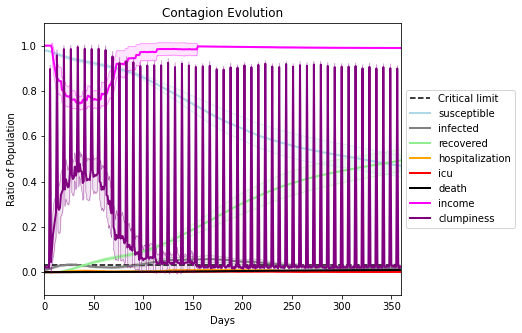

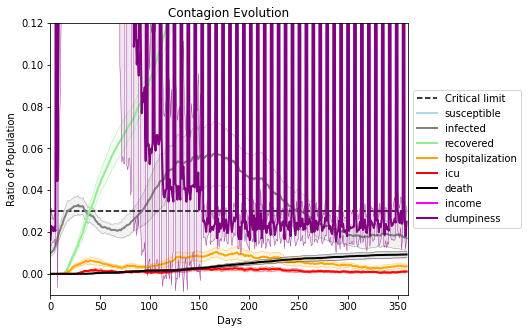

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[6729, 2512, 1319, 1136, 8698, 8789, 4131, 5721, 3860, 4604, 4336, 1768, 5416, 8393, 4394, 4302, 1956, 6108, 7069, 7351]
Average similarity between family members is 0.2680155992796229 at temperature -0.6
Average similarity between family and home is 0.9998566875760957 at temperature -1
Average similarity between students and their classroom is 0.1580255717420516 at temperature -0.6
Average classroom occupancy is 4.126760563380282 and number classrooms is 71
Average similarity between workers is 0.13321762567703968 at temperature -0.6
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.36241775863361914 for kids: 0.21087198222093456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.1475702116604623
avg restaurant similarity 0.0968854483918075
avg restaurant similarity 0.02097092808291813
avg restaurant similarity 0.11275292686219085
avg restaurant similarity 0.0990631059940711
avg restaurant similarity 0.06641776293780538
avg restaurant similarity 0.0827907726690367
avg restaurant similarity 0.09327378242345981
avg restaurant similarity 0.07541571597879479
avg restaurant similarity 0.08022981787744528
avg restaurant similarity 0.053474056857060345
avg restaurant similarity 0.09847131734353824
avg restaurant similarity 0.06592550506979272
avg restaurant similarity 0.10498727713685788
avg restaurant similarity 0.06150627833854447
avg restaurant similarity 0.1292939319200905
avg restaurant similarity 0.11036509635035052
avg restaurant similarity 0.04304056081489972
avg restaurant similarity 0.05146947485449528
avg restaurant similarity 0.1580470458923942
avg restaurant similarity 0.123356166130758
avg restaurant similarity 0.0768172897639

avg restaurant similarity 0.06880338171386562
avg restaurant similarity 0.10443570438975762
avg restaurant similarity 0.04677257439504898
avg restaurant similarity 0.11483195426981625
avg restaurant similarity 0.1239975426851839
avg restaurant similarity 0.046547167811895405
avg restaurant similarity 0.08606546607835207
avg restaurant similarity 0.16174219534957412
avg restaurant similarity 0.10141371242955467
avg restaurant similarity 0.09505645983673264
avg restaurant similarity 0.11499688517413291
avg restaurant similarity 0.10256523584052603
avg restaurant similarity 0.06801830423970977
avg restaurant similarity 0.1133735024051783
avg restaurant similarity 0.058621714832391675
avg restaurant similarity 0.061628202483775464
avg restaurant similarity 0.11448715582168516
avg restaurant similarity 0.07465188821262972
avg restaurant similarity 0.09336872088219102
avg restaurant similarity 0.10708791052640548
avg restaurant similarity 0.16043303236192202
avg restaurant similarity 0.05328

avg restaurant similarity 0.12333135859816749
avg restaurant similarity 0.066095203726644
avg restaurant similarity 0.08262782035752013
avg restaurant similarity 0.10179609535480147
avg restaurant similarity 0.04772489763843004
avg restaurant similarity 0.052355741381133594
avg restaurant similarity 0.08701911537090314
avg restaurant similarity 0.11106906613045105
avg restaurant similarity 0.025220205917771826
avg restaurant similarity 0.05366302974608638
avg restaurant similarity 0.0947135602728805
avg restaurant similarity 0.036107107800198664
avg restaurant similarity 0.059962871201252446
avg restaurant similarity 0.045957948029532694
avg restaurant similarity 0.05426099125147256
avg restaurant similarity 0.12555296552224654
avg restaurant similarity 0.10579937970104183
avg restaurant similarity 0.08564368954577231
avg restaurant similarity 0.1287678498397405
avg restaurant similarity 0.08686568854196827
avg restaurant similarity 0.12116424146491914
avg restaurant similarity 0.13009

avg restaurant similarity 0.026202804364034295
avg restaurant similarity 0.07885420166362891
avg restaurant similarity 0.10799943018900288
avg restaurant similarity 0.13585777742647956
avg restaurant similarity 0.1055056206265111
avg restaurant similarity 0.06691370215534351
avg restaurant similarity 0.1355477576211993
avg restaurant similarity 0.10079948943465579
avg restaurant similarity 0.021272137589482886
avg restaurant similarity 0.062480643394088535
avg restaurant similarity 0.035871187969350724
avg restaurant similarity 0.07489249031337952
avg restaurant similarity 0.05640517646106958
avg restaurant similarity 0.11331970131574265
avg restaurant similarity 0.024891551026043884
avg restaurant similarity 0.0562684067682843
avg restaurant similarity 0.15869849560892121
avg restaurant similarity 0.05862704599031235
avg restaurant similarity 0.1091384912632927
avg restaurant similarity 0.09965381307364266
avg restaurant similarity 0.07892043373887786
avg restaurant similarity 0.09125

avg restaurant similarity 0.0351630519842002
avg restaurant similarity 0.09465939255678874
avg restaurant similarity 0.05436891694460258
avg restaurant similarity 0.0682594001337556
avg restaurant similarity 0.06288169655770236
avg restaurant similarity 0.08087612623170062
avg restaurant similarity 0.040111917748507545
avg restaurant similarity 0.11280290165104916
avg restaurant similarity 0.10607131577284122
avg restaurant similarity 0.10163229580194733
avg restaurant similarity 0.05375760778780957
avg restaurant similarity 0.0862385321921199
avg restaurant similarity 0.09473185365165297
avg restaurant similarity 0.09125182428953031
avg restaurant similarity 0.057079640868515996
avg restaurant similarity 0.0555272857167589
avg restaurant similarity 0.056829721959362055
avg restaurant similarity 0.1094978504314336
avg restaurant similarity 0.1269904171395398
avg restaurant similarity 0.09762235775227028
avg restaurant similarity 0.06442896901967571
avg restaurant similarity 0.097581657

avg restaurant similarity 0.10526610015945288
avg restaurant similarity 0.06634357070967671
avg restaurant similarity 0.06693427882984179
avg restaurant similarity 0.08247488765237489
avg restaurant similarity 0.08551947204816962
avg restaurant similarity 0.08185050027764126
avg restaurant similarity 0.10461449539088404
avg restaurant similarity 0.08833384080768773
avg restaurant similarity 0.0759761412266878
avg restaurant similarity 0.05695694580522308
avg restaurant similarity 0.04527931464027738
avg restaurant similarity 0.063264528024297
avg restaurant similarity 0.07296979474790023
avg restaurant similarity 0.05478553839455303
avg restaurant similarity 0.10484884571346004
avg restaurant similarity 0.09315963147853809
avg restaurant similarity 0.061516514349283506
avg restaurant similarity 0.11976212257389197
avg restaurant similarity 0.008619886473027591
avg restaurant similarity 0.05133782598564602
avg restaurant similarity 0.09893671155870355
avg restaurant similarity 0.1049990

avg restaurant similarity 0.09927418644786694
avg restaurant similarity 0.04687054149634526
avg restaurant similarity 0.12121801751011545
avg restaurant similarity 0.08464858404095915
avg restaurant similarity 0.0555578259710972
avg restaurant similarity 0.10851388916368353
avg restaurant similarity 0.09096055984675577
avg restaurant similarity 0.08097156209173503
avg restaurant similarity 0.11455149314723516
avg restaurant similarity 0.07259858077917973
avg restaurant similarity 0.05344059140526207
avg restaurant similarity 0.06608486184859952
avg restaurant similarity 0.14043448772577566
avg restaurant similarity 0.039903807228273115
avg restaurant similarity 0.07562565736646495
avg restaurant similarity 0.09345900160090392
avg restaurant similarity 0.04437263632366518
avg restaurant similarity 0.0463318792915264
avg restaurant similarity 0.11571371699289837
avg restaurant similarity 0.028257383961083626
avg restaurant similarity 0.04979609333025727
avg restaurant similarity 0.020856

avg restaurant similarity 0.08700482463137844
avg restaurant similarity 0.08049569260081772
avg restaurant similarity 0.06934171025266699
avg restaurant similarity -0.022623229650942985
avg restaurant similarity 0.08368101068369889
avg restaurant similarity 0.093759527599342
avg restaurant similarity 0.13016660629713386
avg restaurant similarity 0.07905655918984485
avg restaurant similarity 0.10570903113587218
avg restaurant similarity 0.08050212519622012
avg restaurant similarity 0.125610524294356
avg restaurant similarity 0.08742885027717545
avg restaurant similarity 0.1028095585557281
avg restaurant similarity 0.1193893682106647
avg restaurant similarity 0.02542109828862433
avg restaurant similarity 0.024095059115362725
avg restaurant similarity 0.0638564541464516
avg restaurant similarity 0.10298353255432216
avg restaurant similarity -0.025021301534488123
avg restaurant similarity 0.09112613297504413
avg restaurant similarity 0.10469352152524306
avg restaurant similarity 0.07601670

avg restaurant similarity 0.12649709985731616
avg restaurant similarity 0.06065298921782646
avg restaurant similarity 0.16866755683206247
avg restaurant similarity 0.08319216722667358
avg restaurant similarity 0.075249284845523
avg restaurant similarity 0.12086431552325311
avg restaurant similarity 0.059738825659405914
avg restaurant similarity 0.08872657032587511
avg restaurant similarity 0.08882653455311754
avg restaurant similarity 0.04496645255466343
avg restaurant similarity 0.1360494316738836
avg restaurant similarity 0.12183871474386522
avg restaurant similarity 0.04794427359544145
avg restaurant similarity 0.061969988792024526
avg restaurant similarity 0.07221924894613281
avg restaurant similarity 0.06636271895841653
avg restaurant similarity 0.027560802282648192
avg restaurant similarity 0.05382190796624115
avg restaurant similarity 0.07215703126481444
avg restaurant similarity 0.0667774533071846
avg restaurant similarity 0.10269086826402327
avg restaurant similarity 0.0638781

avg restaurant similarity 0.014515687298709045
avg restaurant similarity 0.0076409528694805565
avg restaurant similarity 0.1180303225532865
avg restaurant similarity 0.07942245874838819
avg restaurant similarity 0.13079768703694275
avg restaurant similarity -0.03536682805499359
avg restaurant similarity 0.09170259053860527
avg restaurant similarity 0.06983523744266742
avg restaurant similarity 0.09673251753181156
avg restaurant similarity 0.08534890060086672
avg restaurant similarity 0.06002105500210862
avg restaurant similarity 0.14960768992955187
avg restaurant similarity 0.06363949152837385
avg restaurant similarity 0.07653374698133746
avg restaurant similarity 0.048548660656234886
avg restaurant similarity 0.044224744626386835
avg restaurant similarity 0.04650754889127861
avg restaurant similarity 0.08040320767378457
avg restaurant similarity 0.06252629917408632
avg restaurant similarity 0.1070109018613441
avg restaurant similarity 0.1133097717777043
avg restaurant similarity 0.026

avg restaurant similarity 0.1063197590550857
avg restaurant similarity 0.0459107933849608
avg restaurant similarity 0.07016754701115821
avg restaurant similarity 0.11970014703455975
avg restaurant similarity 0.10346315814536082
avg restaurant similarity 0.045952798741036284
avg restaurant similarity 0.1219057652162355
avg restaurant similarity 0.054297252779050564
avg restaurant similarity 0.09174221132839042
avg restaurant similarity 0.11456457332224222
avg restaurant similarity 0.07244595386368655
avg restaurant similarity 0.0971295888311162
avg restaurant similarity 0.007922187555794973
avg restaurant similarity 0.11769791005387097
avg restaurant similarity 0.05600850696849072
avg restaurant similarity 0.09629787515626781
avg restaurant similarity 0.09728867798542701
avg restaurant similarity 0.09233771698603331
avg restaurant similarity 0.029187220810767266
avg restaurant similarity 0.07515022230706715
avg restaurant similarity 0.11218647167507777
avg restaurant similarity 0.081059

avg restaurant similarity 0.08200596775931815
avg restaurant similarity 0.062443795359816597
avg restaurant similarity 0.093202203184339
avg restaurant similarity 0.05401090669374268
avg restaurant similarity 0.06832044018827577
avg restaurant similarity 0.06379589648206971
avg restaurant similarity 0.05053133124984498
avg restaurant similarity 0.03915045698664726
avg restaurant similarity 0.03761179453456581
avg restaurant similarity 0.08282600558879633
avg restaurant similarity 0.10026145301824965
avg restaurant similarity 0.07735079644928491
avg restaurant similarity 0.07951561441248857
avg restaurant similarity 0.08409672458759711
avg restaurant similarity 0.09282907309240855
avg restaurant similarity 0.10202178218373904
avg restaurant similarity 0.048389704420072
avg restaurant similarity 0.09622860967199488
avg restaurant similarity 0.08063304841468989
avg restaurant similarity 0.07315823669188255
avg restaurant similarity 0.11281945725971368
avg restaurant similarity 0.076074047

avg restaurant similarity 0.0586051251719372
avg restaurant similarity 0.11068321931839682
avg restaurant similarity 0.09317949795620206
avg restaurant similarity 0.10856547518591908
avg restaurant similarity 0.09268467013133476
avg restaurant similarity 0.06090144491163502
avg restaurant similarity 0.08723559185962745
avg restaurant similarity 0.06590889173493325
avg restaurant similarity 0.08667203388969612
avg restaurant similarity 0.1037356392106694
avg restaurant similarity 0.1007918096882826
avg restaurant similarity 0.0735319944512336
avg restaurant similarity 0.0576205158886971
avg restaurant similarity 0.07095379988814288
avg restaurant similarity 0.12519436731226427
avg restaurant similarity 0.03889808676717355
avg restaurant similarity 0.03354539689579366
avg restaurant similarity 0.10380077150777563
avg restaurant similarity 0.07172492859934222
avg restaurant similarity 0.030651364181350265
avg restaurant similarity 0.037169568995248224
avg restaurant similarity 0.099166307

avg restaurant similarity 0.04492732300834642
avg restaurant similarity 0.12122308078570941
avg restaurant similarity 0.10651929502762553
avg restaurant similarity 0.0913259200681559
avg restaurant similarity 0.13445098747508405
avg restaurant similarity 0.09954476593693534
avg restaurant similarity 0.047118743963041214
avg restaurant similarity 0.09816886246055434
avg restaurant similarity 0.06973711254785717
avg restaurant similarity 0.1086160140448953
avg restaurant similarity 0.11565601406831177
avg restaurant similarity 0.09361957078449455
avg restaurant similarity 0.04015423153656401
avg restaurant similarity 0.09984432873402235
avg restaurant similarity 0.05579823292731957
avg restaurant similarity 0.08629147125688758
avg restaurant similarity 0.034119645816335815
avg restaurant similarity 0.1274659613120232
avg restaurant similarity 0.11807989137420695
avg restaurant similarity 0.003838603820631759
avg restaurant similarity 0.0767743266532214
avg restaurant similarity 0.0780761

avg restaurant similarity 0.06636383052192948
avg restaurant similarity 0.05163599831470241
avg restaurant similarity 0.01937766868221591
avg restaurant similarity 0.06429009624166795
avg restaurant similarity 0.042211432672168585
avg restaurant similarity 0.09933449410472212
avg restaurant similarity 0.01484975462467006
avg restaurant similarity 0.0013223243408968799
avg restaurant similarity 0.015108910044291147
avg restaurant similarity 0.02353200084644127
avg restaurant similarity 0.0006940574824240643
avg restaurant similarity 0.0669039232413941
avg restaurant similarity 0.0842468631276546
avg restaurant similarity 0.03607323238966056
avg restaurant similarity 0.08463982754877719
avg restaurant similarity 0.01686936062110042
avg restaurant similarity 0.013724435424488217
avg restaurant similarity 0.009572166194914997
avg restaurant similarity 0.03182154215947267
avg restaurant similarity 0.05066798993996919
avg restaurant similarity 0.09995021056691888
avg restaurant similarity 0.

avg restaurant similarity 0.058282042773466186
avg restaurant similarity 0.05577338079944919
avg restaurant similarity 0.06083229594265238
avg restaurant similarity 0.13183575120909177
avg restaurant similarity 0.005955254500109664
avg restaurant similarity -0.013393184069924508
avg restaurant similarity 0.03172677472900152
avg restaurant similarity 0.031909585372984356
avg restaurant similarity 0.15705633604243047
avg restaurant similarity 0.04705608124038141
avg restaurant similarity 0.026764327940903682
avg restaurant similarity 0.062368677541273586
avg restaurant similarity 0.0707235249675
avg restaurant similarity 0.04341641767828257
avg restaurant similarity 0.0022060219743178762
avg restaurant similarity 0.06877948165410998
avg restaurant similarity 0.0756685384710966
avg restaurant similarity 0.06123170328098466
avg restaurant similarity 0.08003496141755333
avg restaurant similarity 0.09554542690975397
avg restaurant similarity 0.11149463561592964
avg restaurant similarity 0.04

avg restaurant similarity 0.03505390882118714
avg restaurant similarity 0.12231593308249024
avg restaurant similarity 0.018470118372255432
avg restaurant similarity 0.07109483546928895
avg restaurant similarity 0.03450371669041382
avg restaurant similarity 0.08162036881753665
avg restaurant similarity 0.09592330452726121
avg restaurant similarity 0.04791281302661739
avg restaurant similarity 0.056291745182469516
avg restaurant similarity 0.049618251494565696
avg restaurant similarity 0.13118164272644223
avg restaurant similarity 0.04468519297748835
avg restaurant similarity 0.07693676387524813
avg restaurant similarity 0.057999892061996114
avg restaurant similarity 0.09615600305266409
avg restaurant similarity 0.06921205779641844
avg restaurant similarity 0.047331566423332846
avg restaurant similarity 0.1002059831003951
avg restaurant similarity 0.044242153849164835
avg restaurant similarity 0.067863235013799
avg restaurant similarity 0.0447143478191501
avg restaurant similarity 0.0533

avg restaurant similarity 0.05542072735814678
avg restaurant similarity 0.1036986449998902
avg restaurant similarity 0.1487934947032321
avg restaurant similarity 0.055332725504743115
avg restaurant similarity 0.08450996457592727
avg restaurant similarity 0.03683673947483427
avg restaurant similarity 0.06718753531121145
avg restaurant similarity 0.11598560557704189
avg restaurant similarity 0.08587261656545944
avg restaurant similarity 0.08176015603863689
avg restaurant similarity 0.06337035416622423
avg restaurant similarity 0.12972461318021855
avg restaurant similarity 0.08124235957370932
avg restaurant similarity 0.13631816722583975
avg restaurant similarity 0.01633513284502521
avg restaurant similarity 0.0935594992036535
avg restaurant similarity 0.04526412270029518
avg restaurant similarity 0.04795663096879557
avg restaurant similarity 0.1330814789726147
avg restaurant similarity 0.07872762781262663
avg restaurant similarity 0.05157533667728954
avg restaurant similarity 0.077143809

avg restaurant similarity 0.09571762118160396
avg restaurant similarity 0.10580965997895928
avg restaurant similarity 0.10446676209752838
avg restaurant similarity 0.07514899610092013
avg restaurant similarity 0.09401045769303494
avg restaurant similarity 0.09531578101346598
avg restaurant similarity 0.020937274975589955
avg restaurant similarity 0.05103348803577584
avg restaurant similarity 0.10313606869004617
avg restaurant similarity 0.07739802698897802
avg restaurant similarity 0.060145676957529405
avg restaurant similarity 0.11585787331726066
avg restaurant similarity -0.04066049060636203
avg restaurant similarity 0.13901704830379627
avg restaurant similarity 0.04878234428673173
avg restaurant similarity 0.0628484594700566
avg restaurant similarity 0.043979639620091264
avg restaurant similarity 0.13221748002013012
avg restaurant similarity 0.08111239205089975
avg restaurant similarity 0.012590551461328526
avg restaurant similarity 0.12434924147642051
avg restaurant similarity 0.07

avg restaurant similarity 0.07402114590306703
avg restaurant similarity 0.026710517586004043
avg restaurant similarity 0.10165077574118822
avg restaurant similarity 0.06664648091285882
avg restaurant similarity 0.11861300497800706
avg restaurant similarity 0.10956829384164295
avg restaurant similarity 0.07680944627528731
avg restaurant similarity 0.08972544426703766
avg restaurant similarity 0.061769563093203764
avg restaurant similarity 0.05301750265892944
avg restaurant similarity 0.10279918051033837
avg restaurant similarity 0.08439926228938832
avg restaurant similarity 0.08530714231026072
avg restaurant similarity 0.04268662384971029
avg restaurant similarity 0.06277078704360806
avg restaurant similarity 0.06276896565359062
avg restaurant similarity 0.10797341373411681
avg restaurant similarity 0.10227256363832793
avg restaurant similarity 0.12480440830366347
avg restaurant similarity 0.11323710191251311
avg restaurant similarity 0.1122076507485886
avg restaurant similarity 0.03133

avg restaurant similarity 0.08435060242797185
avg restaurant similarity 0.05240272318007783
avg restaurant similarity 0.15650335017413508
avg restaurant similarity 0.0724184035413722
avg restaurant similarity 0.05887067358075239
avg restaurant similarity 0.12591065335379778
avg restaurant similarity 0.08787755067280077
avg restaurant similarity 0.11938433166116778
avg restaurant similarity 0.10682339349350096
avg restaurant similarity 0.13443363625657467
avg restaurant similarity 0.12229019012979846
avg restaurant similarity 0.11094763249763777
avg restaurant similarity 0.0962685648356627
avg restaurant similarity 0.11155119437073072
avg restaurant similarity 0.1045693406827226
avg restaurant similarity 0.1186531861148858
avg restaurant similarity 0.10013012398134293
avg restaurant similarity 0.05603982310374387
avg restaurant similarity 0.07503220488489899
avg restaurant similarity 0.09080924421850453
avg restaurant similarity 0.06236251191367281
avg restaurant similarity 0.1159399562

avg restaurant similarity 0.06395382813253694
avg restaurant similarity 0.040833853777537905
avg restaurant similarity 0.07664832335965893
avg restaurant similarity 0.059929221244337465
avg restaurant similarity 0.08425760831720125
avg restaurant similarity 0.11840933608666618
avg restaurant similarity 0.09607781816056218
avg restaurant similarity 0.05101584312398691
avg restaurant similarity 0.06056076461002358
avg restaurant similarity 0.10896360786324252
avg restaurant similarity 0.061815307526105014
avg restaurant similarity 0.0800172911443897
avg restaurant similarity 0.10835678428302217
avg restaurant similarity 0.10289507327457002
avg restaurant similarity 0.12117465377899092
avg restaurant similarity 0.08314641311094291
avg restaurant similarity 0.06433176926299787
avg restaurant similarity 0.09608593357751997
avg restaurant similarity 0.13249949746535938
avg restaurant similarity 0.12376696774476062
avg restaurant similarity 0.09593135044273429
avg restaurant similarity 0.0730

avg restaurant similarity 0.11657678799310445
avg restaurant similarity 0.07258210193300811
avg restaurant similarity 0.04961372043896795
avg restaurant similarity 0.06979345840453013
avg restaurant similarity 0.03640736974119112
avg restaurant similarity 0.05071033918243911
avg restaurant similarity 0.06925490418114263
avg restaurant similarity 0.08106929158542052
avg restaurant similarity 0.1326652524735501
avg restaurant similarity 0.08521702270288696
avg restaurant similarity 0.05663308499759211
avg restaurant similarity 0.10829292605477162
avg restaurant similarity 0.07586256400649945
avg restaurant similarity 0.034960667860221825
avg restaurant similarity 0.13940703737773139
avg restaurant similarity 0.05017028130096929
avg restaurant similarity 0.09875749004716163
avg restaurant similarity 0.08824652971750471
avg restaurant similarity 0.07754294445027861
avg restaurant similarity 0.07066891123662142
avg restaurant similarity 0.10833999015419205
avg restaurant similarity 0.044863

avg restaurant similarity 0.06419588669452879
avg restaurant similarity 0.1219372459268972
avg restaurant similarity 0.08171874838793318
avg restaurant similarity 0.038143016994743546
avg restaurant similarity 0.04301797330937773
avg restaurant similarity 0.10261073149406423
avg restaurant similarity 0.06478485438584733
avg restaurant similarity 0.0321615644039253
avg restaurant similarity 0.06701164278848741
avg restaurant similarity 0.056672168641278275
avg restaurant similarity 0.047436249321593245
avg restaurant similarity 0.004070783391512141
avg restaurant similarity 0.07816653860662491
avg restaurant similarity 0.07143874687517346
avg restaurant similarity 0.06513419036171231
avg restaurant similarity 0.07053008639660323
avg restaurant similarity 0.09138261470366352
avg restaurant similarity 0.07864747830684976
avg restaurant similarity 0.15430238724917295
avg restaurant similarity 0.029641285215896283
avg restaurant similarity 0.029356852493551758
avg restaurant similarity 0.09

avg restaurant similarity 0.11253863032117875
avg restaurant similarity 0.11827742077116553
avg restaurant similarity 0.11728719892457062
avg restaurant similarity 0.0518149981919291
avg restaurant similarity 0.12488534166153277
avg restaurant similarity 0.07728516145010665
avg restaurant similarity 0.08000235130431681
avg restaurant similarity 0.06504603919356411
avg restaurant similarity 0.10471155383094789
avg restaurant similarity 0.09663018919880904
avg restaurant similarity 0.11133537313108018
avg restaurant similarity 0.0600765872802697
avg restaurant similarity 0.1440840143437523
avg restaurant similarity 0.05542435949203705
avg restaurant similarity 0.05272869891863815
avg restaurant similarity 0.1450512234872625
avg restaurant similarity 0.05692046151448746
avg restaurant similarity 0.1242317527060025
avg restaurant similarity 0.12258151762439375
avg restaurant similarity 0.11850930169253032
avg restaurant similarity 0.06863552484568564
avg restaurant similarity 0.11404017359

avg restaurant similarity 0.08840444433157417
avg restaurant similarity 0.09252676294422238
avg restaurant similarity 0.08566786250347183
avg restaurant similarity 0.10393849207050815
avg restaurant similarity 0.09006967626927848
avg restaurant similarity 0.07459989387412697
avg restaurant similarity 0.033395836733851825
avg restaurant similarity 0.06155282354118438
avg restaurant similarity 0.11876675294313893
avg restaurant similarity 0.10467957505312496
avg restaurant similarity 0.05985806490330395
avg restaurant similarity 0.12326752731311189
avg restaurant similarity 0.07728299914853426
avg restaurant similarity 0.14446346285190187
avg restaurant similarity 0.03937374520732519
avg restaurant similarity 0.09217605459810359
avg restaurant similarity 0.056973899448679005
avg restaurant similarity 0.0412183139730205
avg restaurant similarity 0.1008582915104692
avg restaurant similarity 0.10836129749429313
avg restaurant similarity 0.09335789361875205
avg restaurant similarity 0.061711

avg restaurant similarity -0.007035831937868558
avg restaurant similarity 0.052869695774355324
avg restaurant similarity 0.0750875366090773
avg restaurant similarity 0.07321300491917046
avg restaurant similarity 0.04504483300708283
avg restaurant similarity 0.08786488129974682
avg restaurant similarity 0.0717899886081563
avg restaurant similarity 0.06700311166966115
avg restaurant similarity 0.07923390926523866
avg restaurant similarity 0.041921390042268046
avg restaurant similarity 0.07758251941216716
avg restaurant similarity 0.11376479095377791
avg restaurant similarity 0.1020106137956039
avg restaurant similarity 0.083880794977216
avg restaurant similarity 0.02301433105070063
avg restaurant similarity 0.07073256171157512
avg restaurant similarity 0.09590869981063577
avg restaurant similarity 0.009844193479978978
avg restaurant similarity 0.07111296860450794
avg restaurant similarity 0.05784866127054679
avg restaurant similarity 0.07232081547760237
avg restaurant similarity 0.051340

avg restaurant similarity 0.06653868907785912
avg restaurant similarity 0.056844767029798744
avg restaurant similarity 0.08872020395985378
avg restaurant similarity 0.07632648094345623
avg restaurant similarity 0.09581962506177166
avg restaurant similarity 0.013995983565253656
avg restaurant similarity 0.10568857704578684
avg restaurant similarity 0.027968187917531022
avg restaurant similarity 0.055405577186194384
avg restaurant similarity 0.09297893672530107
avg restaurant similarity 0.049387332132865905
avg restaurant similarity 0.04500610936212513
avg restaurant similarity 0.02757790016735057
avg restaurant similarity 0.04189948836008678
avg restaurant similarity 0.07721343552242592
avg restaurant similarity 0.10272310194800328
avg restaurant similarity 0.06323964143196494
avg restaurant similarity 0.0315629679289215
avg restaurant similarity 0.07711678542953604
avg restaurant similarity 0.08447141276232945
avg restaurant similarity 0.14028465916813807
avg restaurant similarity 0.10

avg restaurant similarity 0.08785175528758069
avg restaurant similarity 0.009047671859254054
avg restaurant similarity 0.01444114960096227
avg restaurant similarity 0.10138267800349725
avg restaurant similarity 0.04746274194854813
avg restaurant similarity 0.13592849881766975
avg restaurant similarity 0.041568412998232385
avg restaurant similarity 0.07140904741861827
avg restaurant similarity 0.013726617148658653
avg restaurant similarity 0.09045048151586325
avg restaurant similarity -0.01091429035060228
avg restaurant similarity -0.008114312746541787
avg restaurant similarity 0.10293234430758434
avg restaurant similarity -0.00047640836658915866
avg restaurant similarity 0.08624266612211422
avg restaurant similarity 0.12779511806241695
avg restaurant similarity 0.04423617360822572
avg restaurant similarity 0.03903412182138486
avg restaurant similarity 0.08176660275603184
avg restaurant similarity 0.0691089092255226
avg restaurant similarity 0.041683871422665386
avg restaurant similarit

avg restaurant similarity 0.0655842776167461
avg restaurant similarity 0.1111677995759979
avg restaurant similarity 0.1148112703171499
avg restaurant similarity 0.013059646602154468
avg restaurant similarity 0.041959491334835626
avg restaurant similarity 0.08161567907102599
avg restaurant similarity 0.012169553536716754
avg restaurant similarity 0.006344170567495344
avg restaurant similarity 0.06380821395069683
avg restaurant similarity 0.07614603328740671
avg restaurant similarity 0.08453818580684933
avg restaurant similarity 0.020664556238948955
avg restaurant similarity 0.04803489385932818
avg restaurant similarity 0.05289651954009618
avg restaurant similarity 0.08587914248826882
avg restaurant similarity 0.12434999659069496
avg restaurant similarity 0.04206110049910619
avg restaurant similarity 0.04502375273716248
avg restaurant similarity 0.09919345530993381
avg restaurant similarity 0.1309696201934926
avg restaurant similarity 0.08967245970160567
avg restaurant similarity 0.12134

avg restaurant similarity 0.10605126628833839
avg restaurant similarity 0.02863624956443829
avg restaurant similarity 0.06859833953246677
avg restaurant similarity 0.10400669223886594
avg restaurant similarity 0.05988620796563012
avg restaurant similarity 0.08989271097966663
avg restaurant similarity 0.0794694500791331
avg restaurant similarity 0.07570560500271684
avg restaurant similarity 0.05163260554172414
avg restaurant similarity 0.086910111178392
avg restaurant similarity 0.07033798791082334
avg restaurant similarity 0.05079290277055443
avg restaurant similarity 0.11193590907683203
avg restaurant similarity 0.13247197705377176
avg restaurant similarity 0.14779592488726429
avg restaurant similarity 0.0409235444916311
avg restaurant similarity 0.061622073710492026
avg restaurant similarity 0.037430500094739236
avg restaurant similarity 0.10120681097196124
avg restaurant similarity 0.11078473238041348
avg restaurant similarity 0.036882609890064866
avg restaurant similarity 0.0859767

avg restaurant similarity 0.041000984334606506
avg restaurant similarity 0.08078890717649582
avg restaurant similarity 0.09730200605373568
avg restaurant similarity 0.10069669810622674
avg restaurant similarity 0.12804950993127057
avg restaurant similarity 0.13537438146834033
avg restaurant similarity 0.12486682343919833
avg restaurant similarity 0.11707888925296918
avg restaurant similarity 0.0371384864357119
avg restaurant similarity 0.09412309769462837
avg restaurant similarity 0.08009465617663682
avg restaurant similarity 0.12259928367292261
avg restaurant similarity 0.07238882051925702
avg restaurant similarity 0.07168226056727123
avg restaurant similarity 0.042303209266867516
avg restaurant similarity 0.06408783113908158
avg restaurant similarity 0.07178776400016736
avg restaurant similarity 0.08148911055474446
avg restaurant similarity 0.1236492691506392
avg restaurant similarity 0.08618703708514618
avg restaurant similarity 0.05818325281283084
avg restaurant similarity 0.087231

avg restaurant similarity 0.05846051759316452
avg restaurant similarity 0.08814237892025378
avg restaurant similarity 0.08446660779680364
avg restaurant similarity 0.11398293525087477
avg restaurant similarity 0.0683146967611518
avg restaurant similarity 0.029876668568568306
avg restaurant similarity 0.009230762978956893
avg restaurant similarity 0.11579243152759165
avg restaurant similarity 0.07158097606216673
avg restaurant similarity 0.06808996589472213
avg restaurant similarity 0.039261559217722515
avg restaurant similarity 0.05511901639860087
avg restaurant similarity 0.06249541083708425
avg restaurant similarity 0.05904775366810305
avg restaurant similarity 0.06606569727131237
avg restaurant similarity 0.017135232502546352
avg restaurant similarity 0.058237173664178125
avg restaurant similarity 0.06880006427772695
avg restaurant similarity 0.08174388831347973
avg restaurant similarity 0.09948026122634568
avg restaurant similarity 0.07546085596707515
avg restaurant similarity 0.13

avg restaurant similarity 0.08480614765654342
avg restaurant similarity 0.07668216150435286
avg restaurant similarity 0.10190818164571946
avg restaurant similarity -0.0011535576006027678
avg restaurant similarity 0.03807244412469759
avg restaurant similarity 0.026557681615459475
avg restaurant similarity 0.09346454867052045
avg restaurant similarity 0.05330480284389873
avg restaurant similarity 0.15132666487625968
avg restaurant similarity 0.0758267876661771
avg restaurant similarity 0.010692070046147176
avg restaurant similarity 0.06448676573457682
avg restaurant similarity 0.026482724794066225
avg restaurant similarity 0.054820311282449734
avg restaurant similarity 0.10553342901733288
avg restaurant similarity 0.06057339284836651
avg restaurant similarity 0.017554241427474204
avg restaurant similarity 0.14876129384707393
avg restaurant similarity 0.056062452137109114
avg restaurant similarity 0.02852528038612393
avg restaurant similarity 0.06440078716293425
avg restaurant similarity 

avg restaurant similarity 0.07951944843107653
avg restaurant similarity 0.08518006759966897
avg restaurant similarity 0.09465823153294935
avg restaurant similarity 0.04715348292802224
avg restaurant similarity 0.1433773854366101
avg restaurant similarity 0.06436116925470961
avg restaurant similarity 0.08538901010105376
avg restaurant similarity 0.09479145766088054
avg restaurant similarity 0.1539582213660604
avg restaurant similarity 0.017894833831295476
avg restaurant similarity 0.0924599229913358
avg restaurant similarity 0.07146122274471718
avg restaurant similarity 0.10605986809659969
avg restaurant similarity 0.12111432443774878
avg restaurant similarity 0.0346760970472502
avg restaurant similarity 0.08047740395799487
avg restaurant similarity 0.13559253738412974
avg restaurant similarity 0.04581690990961884
avg restaurant similarity 0.10568813076651275
avg restaurant similarity 0.05195583865035235
avg restaurant similarity 0.034831330691159394
avg restaurant similarity 0.02406310

avg restaurant similarity 0.06306184677120785
avg restaurant similarity 0.08380659995785111
avg restaurant similarity 0.10052966119830434
avg restaurant similarity 0.11954937546452346
avg restaurant similarity 0.07197609227571852
avg restaurant similarity 0.05293618022908662
avg restaurant similarity 0.027040356708155047
avg restaurant similarity 0.08046644443305342
avg restaurant similarity 0.037714889611932305
avg restaurant similarity 0.06447954751643455
avg restaurant similarity 0.13716312690803306
avg restaurant similarity 0.021613409335799336
avg restaurant similarity 0.058715606576446935
avg restaurant similarity 0.1141057076470027
avg restaurant similarity 0.1036473350339716
avg restaurant similarity -0.016629433815937983
avg restaurant similarity 0.06301085240392919
avg restaurant similarity 0.06114044665340981
avg restaurant similarity 0.06172717886124704
avg restaurant similarity 0.11627624189263236
avg restaurant similarity 0.05790713038454845
avg restaurant similarity 0.04

avg restaurant similarity 0.10665449610544475
avg restaurant similarity 0.05907719482767551
avg restaurant similarity 0.07515807761147024
avg restaurant similarity 0.0493821978250594
avg restaurant similarity 0.12609806064261742
avg restaurant similarity 0.047748231115565976
avg restaurant similarity 0.0719000964835931
avg restaurant similarity 0.07811890821991203
avg restaurant similarity 0.0826034796607581
avg restaurant similarity 0.04567925070864673
avg restaurant similarity 0.019387849012544284
avg restaurant similarity 0.05924674338519669
avg restaurant similarity 0.08224774096178535
avg restaurant similarity 0.08970470001830973
avg restaurant similarity 0.09725168214411384
avg restaurant similarity 0.044724352369293646
avg restaurant similarity 0.033261359887490245
avg restaurant similarity 0.061936757693013426
avg restaurant similarity 0.05054897356284291
avg restaurant similarity 0.060400960228013945
avg restaurant similarity 0.05266243291179512
avg restaurant similarity 0.037

avg restaurant similarity 0.08035055172090379
avg restaurant similarity 0.05502098876583806
avg restaurant similarity 0.06587015671023583
avg restaurant similarity 0.05723882633371208
avg restaurant similarity 0.06479450351213244
avg restaurant similarity 0.06784303872062486
avg restaurant similarity 0.12226217257894971
avg restaurant similarity 0.1361178222587135
avg restaurant similarity 0.11278629291675993
avg restaurant similarity 0.0702016481518358
avg restaurant similarity 0.05931470543041352
avg restaurant similarity 0.05154733699759344
avg restaurant similarity 0.06869047342378926
avg restaurant similarity 0.0260092072581266
avg restaurant similarity 0.06629815811485522
avg restaurant similarity 0.04223595762758392
avg restaurant similarity 0.047411905282008365
avg restaurant similarity 0.12972304346170815
avg restaurant similarity 0.04814754954121551
avg restaurant similarity 0.09243599745663358
avg restaurant similarity 0.07525139212444384
avg restaurant similarity 0.13195710

avg restaurant similarity 0.11766961282230111
avg restaurant similarity 0.07369353493591319
avg restaurant similarity 0.08492938654944948
avg restaurant similarity 0.08793939742073371
avg restaurant similarity 0.07382542052020066
avg restaurant similarity 0.0803135632037967
avg restaurant similarity 0.06709703060675955
avg restaurant similarity 0.1410915443582185
avg restaurant similarity 0.016535493208040403
avg restaurant similarity 0.092618342526988
avg restaurant similarity 0.034624376243618415
avg restaurant similarity 0.12782717855617487
avg restaurant similarity 0.09156979503546223
avg restaurant similarity 0.04957634299662352
avg restaurant similarity 0.04438111890768036
avg restaurant similarity 0.08494385551471512
avg restaurant similarity 0.06095677024731839
avg restaurant similarity 0.07542213008729023
avg restaurant similarity 0.08906912770273157
avg restaurant similarity 0.07873887477812007
avg restaurant similarity 0.09539110592225847
avg restaurant similarity 0.05547868

avg restaurant similarity 0.07293199062777464
avg restaurant similarity 0.12360529324247478
avg restaurant similarity 0.07712620165774811
avg restaurant similarity 0.1519711797220438
avg restaurant similarity 0.11136060752503171
avg restaurant similarity 0.060242001085206304
avg restaurant similarity 0.027349948621037404
avg restaurant similarity 0.08793755551920619
avg restaurant similarity 0.04304891207645546
avg restaurant similarity 0.10691311092289292
avg restaurant similarity 0.10237797633725014
avg restaurant similarity 0.05035117072161061
avg restaurant similarity 0.09782393481221285
avg restaurant similarity 0.08644850885117661
avg restaurant similarity 0.05465326583252706
avg restaurant similarity 0.04138485197267323
avg restaurant similarity 0.10625938395473382
avg restaurant similarity 0.04459581617173833
avg restaurant similarity 0.10171682654506904
avg restaurant similarity 0.07662175987537705
avg restaurant similarity 0.012632164718457996
avg restaurant similarity 0.0873

(<function dict.items>, <function dict.items>, <function dict.items>)

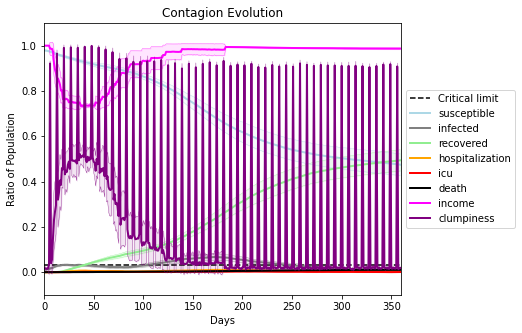

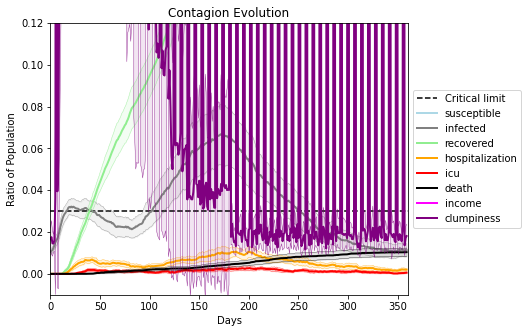

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7873, 603, 8917, 2867, 2724, 8229, 4824, 7814, 7893, 2920, 107, 3000, 4131, 7112, 6186, 2784, 7935, 9895, 7081, 8530]
Average similarity between family members is 0.2520054189640159 at temperature -0.5
Average similarity between family and home is 0.9998477662287569 at temperature -1
Average similarity between students and their classroom is 0.15183456952586505 at temperature -0.5
Average classroom occupancy is 4.222222222222222 and number classrooms is 72
Average similarity between workers is 0.14575715932802713 at temperature -0.5
Average office occupancy is 3.313131313131313 and number offices is 198
Average friend similarity for adults: 0.32692405463932406 for kids: 0.19681235250864115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.09724269401518171
avg restaurant similarity 0.09587746811740197
avg restaurant similarity 0.0702938594362692
avg restaurant similarity 0.0966564439527134
avg restaurant similarity 0.11251863914477275
avg restaurant similarity 0.04207201817119059
avg restaurant similarity 0.046790888296724356
avg restaurant similarity 0.1225555258477596
avg restaurant similarity 0.09293143950232041
avg restaurant similarity 0.09072552883808772
avg restaurant similarity 0.09442693143958375
avg restaurant similarity 0.10555580270084579
avg restaurant similarity 0.09154240471274093
avg restaurant similarity 0.08240044795119399
avg restaurant similarity 0.0916045843798112
avg restaurant similarity 0.03656739197397601
avg restaurant similarity 0.03117266815287405
avg restaurant similarity 0.08289850399706994
avg restaurant similarity 0.13187603881115836
avg restaurant similarity 0.09975084953285336
avg restaurant similarity 0.06329084261677105
avg restaurant similarity 0.085002203

avg restaurant similarity 0.02177942509231793
avg restaurant similarity 0.05274579913904907
avg restaurant similarity 0.10879025034554304
avg restaurant similarity 0.07870744329202523
avg restaurant similarity 0.04012401199615631
avg restaurant similarity 0.06056414586838198
avg restaurant similarity 0.1064285818070593
avg restaurant similarity 0.05171691661881965
avg restaurant similarity 0.03932560244707518
avg restaurant similarity 0.10130157765236042
avg restaurant similarity 0.05431012153448216
avg restaurant similarity 0.09721231285389043
avg restaurant similarity 0.10876439326785907
avg restaurant similarity 0.11532639239003771
avg restaurant similarity 0.08117131855455731
avg restaurant similarity 0.099857930736068
avg restaurant similarity 0.04382907858510234
avg restaurant similarity 0.06826132306633256
avg restaurant similarity 0.06984434598398587
avg restaurant similarity 0.026672603774796466
avg restaurant similarity 0.09395564824426277
avg restaurant similarity 0.07123658

avg restaurant similarity 0.08759573581166316
avg restaurant similarity 0.06960223434437593
avg restaurant similarity 0.06269110167697624
avg restaurant similarity 0.08475819575522499
avg restaurant similarity 0.02897783921660829
avg restaurant similarity 0.042298501195947504
avg restaurant similarity 0.044459417728258455
avg restaurant similarity 0.02974724162199038
avg restaurant similarity 0.09058952754448342
avg restaurant similarity 0.1130125346025374
avg restaurant similarity 0.09462909253860773
avg restaurant similarity 0.1248557824583694
avg restaurant similarity 0.08203023744812026
avg restaurant similarity 0.10687848583112483
avg restaurant similarity 0.11992429060250084
avg restaurant similarity 0.04733717046804624
avg restaurant similarity 0.027020498950156277
avg restaurant similarity 0.09627335785257622
avg restaurant similarity 0.10169350219341997
avg restaurant similarity 0.06866801555625178
avg restaurant similarity 0.13955430962648516
avg restaurant similarity 0.07272

avg restaurant similarity 0.04455373114270661
avg restaurant similarity 0.03819473245555964
avg restaurant similarity 0.06284555190525325
avg restaurant similarity 0.11077443211951073
avg restaurant similarity 0.0717659425408949
avg restaurant similarity 0.0531485657387193
avg restaurant similarity 0.04830087214682939
avg restaurant similarity 0.03506299248829812
avg restaurant similarity 0.058996479941955816
avg restaurant similarity 0.10541607133666822
avg restaurant similarity 0.05383079888436396
avg restaurant similarity 0.028824204232440177
avg restaurant similarity 0.004500240012198976
avg restaurant similarity 0.02098422008875875
avg restaurant similarity 0.05658605452824758
avg restaurant similarity 0.038169463258342154
avg restaurant similarity 0.05638324539084083
avg restaurant similarity 0.11188810136805133
avg restaurant similarity 0.061563674681834074
avg restaurant similarity 0.07005089602101759
avg restaurant similarity 0.07540966949282563
avg restaurant similarity 0.038

avg restaurant similarity 0.06857951339924274
avg restaurant similarity 0.055207138450364936
avg restaurant similarity 0.06011455744148159
avg restaurant similarity 0.06434973894687321
avg restaurant similarity 0.03068069189009939
avg restaurant similarity 0.06820842519091765
avg restaurant similarity 0.04273142038537097
avg restaurant similarity 0.08145506101032984
avg restaurant similarity 0.044918627564463916
avg restaurant similarity 0.09461827005509282
avg restaurant similarity 0.07826442449499674
avg restaurant similarity 0.05734322260755316
avg restaurant similarity 0.07581746220237913
avg restaurant similarity 0.04753474035856954
avg restaurant similarity 0.05589040949658168
avg restaurant similarity 0.06859752601448707
avg restaurant similarity 0.04394547758355113
avg restaurant similarity 0.08494589180738824
avg restaurant similarity 0.08142337181444229
avg restaurant similarity 0.10939092603343516
avg restaurant similarity 0.08406301910385006
avg restaurant similarity 0.0454

avg restaurant similarity 0.11561157860847536
avg restaurant similarity 0.0919483629320373
avg restaurant similarity 0.0866789876039921
avg restaurant similarity 0.09729471531346978
avg restaurant similarity 0.08883442183021054
avg restaurant similarity 0.09817822917731873
avg restaurant similarity 0.08657723606837323
avg restaurant similarity 0.12606304045300074
avg restaurant similarity 0.09857095366236124
avg restaurant similarity 0.027482480278611204
avg restaurant similarity 0.1015118424824555
avg restaurant similarity 0.04455424550551054
avg restaurant similarity 0.04277207581140161
avg restaurant similarity 0.10157185970496176
avg restaurant similarity 0.09347177810488755
avg restaurant similarity 0.07024502136181573
avg restaurant similarity 0.04771540553901108
avg restaurant similarity 0.07357357981693452
avg restaurant similarity 0.06286873665262088
avg restaurant similarity 0.08831914308860848
avg restaurant similarity 0.09043300039409898
avg restaurant similarity 0.12108499

avg restaurant similarity 0.09733756292506368
avg restaurant similarity 0.07769043360399272
avg restaurant similarity 0.05985113120118318
avg restaurant similarity 0.10981589194472623
avg restaurant similarity 0.14834506692390356
avg restaurant similarity 0.05433252894850159
avg restaurant similarity 0.07993029540079956
avg restaurant similarity 0.1058723305795682
avg restaurant similarity 0.08621437150766444
avg restaurant similarity 0.12713773496055672
avg restaurant similarity 0.16025513695900437
avg restaurant similarity 0.03420939694502202
avg restaurant similarity 0.06812281092944562
avg restaurant similarity 0.034359401115787565
avg restaurant similarity 0.02619950059552049
avg restaurant similarity 0.0735477669701224
avg restaurant similarity 0.08746465155177333
avg restaurant similarity 0.07298417549893642
avg restaurant similarity 0.10600989902321331
avg restaurant similarity 0.0828216301768801
avg restaurant similarity 0.036012572142264644
avg restaurant similarity 0.0664324

avg restaurant similarity 0.1362822208865532
avg restaurant similarity 0.1526487448489616
avg restaurant similarity 0.0543691717579877
avg restaurant similarity 0.03929391710684461
avg restaurant similarity 0.054114792951867684
avg restaurant similarity 0.11378986169931236
avg restaurant similarity 0.14164087600548791
avg restaurant similarity 0.06576753657348008
avg restaurant similarity 0.07529911701429354
avg restaurant similarity 0.09707241096366696
avg restaurant similarity 0.06727832208566283
avg restaurant similarity 0.12197277786728639
avg restaurant similarity 0.07158736986367913
avg restaurant similarity 0.11769703006590311
avg restaurant similarity 0.10719547566655095
avg restaurant similarity 0.07902364038197976
avg restaurant similarity 0.10139224160112596
avg restaurant similarity 0.08251370183508192
avg restaurant similarity 0.06881691614808148
avg restaurant similarity 0.12834925760632346
avg restaurant similarity 0.08668867063219277
avg restaurant similarity 0.07317695

avg restaurant similarity 0.05221353641497616
avg restaurant similarity 0.0724852286284543
avg restaurant similarity 0.10659333176746176
avg restaurant similarity 0.07435164433001054
avg restaurant similarity 0.08496804579112882
avg restaurant similarity 0.06824138546816798
avg restaurant similarity 0.09985343529864144
avg restaurant similarity 0.0934682740768043
avg restaurant similarity 0.0790081247531505
avg restaurant similarity 0.05921333788683357
avg restaurant similarity 0.09447499449266934
avg restaurant similarity 0.10060810855240826
avg restaurant similarity 0.09378339427683006
avg restaurant similarity 0.08104072469131483
avg restaurant similarity 0.11941402356980438
avg restaurant similarity 0.04141333036464355
avg restaurant similarity 0.07552128344380458
avg restaurant similarity 0.059781859679491366
avg restaurant similarity 0.08908146268359005
avg restaurant similarity 0.11774771355941682
avg restaurant similarity 0.09935300169621313
avg restaurant similarity 0.10402648

avg restaurant similarity 0.0643606217829984
avg restaurant similarity 0.10578442364749266
avg restaurant similarity 0.08042291598748408
avg restaurant similarity 0.03446647926685876
avg restaurant similarity 0.13095834227574057
avg restaurant similarity 0.05259753653016946
avg restaurant similarity 0.061071198311844335
avg restaurant similarity 0.08950544304148389
avg restaurant similarity 0.0632081963797388
avg restaurant similarity 0.09745746952765684
avg restaurant similarity 0.08875997139456937
avg restaurant similarity 0.12821910540623727
avg restaurant similarity 0.10729909062648546
avg restaurant similarity 0.11723174035106614
avg restaurant similarity 0.06958494051540037
avg restaurant similarity 0.12446180284476943
avg restaurant similarity 0.05475759745494109
avg restaurant similarity 0.08280188066873685
avg restaurant similarity 0.05849706240695363
avg restaurant similarity 0.042590926960834864
avg restaurant similarity 0.08853811006591515
avg restaurant similarity 0.090936

avg restaurant similarity 0.07009110441648805
avg restaurant similarity 0.035298586825423764
avg restaurant similarity 0.0351542016913387
avg restaurant similarity 0.09640923258608224
avg restaurant similarity 0.0921688427281439
avg restaurant similarity 0.0604617697355503
avg restaurant similarity 0.08768434708745071
avg restaurant similarity 0.16378195783615515
avg restaurant similarity 0.05404144052019746
avg restaurant similarity 0.09951941261679494
avg restaurant similarity 0.11347111615567353
avg restaurant similarity 0.10654912004454845
avg restaurant similarity 0.10962780063009164
avg restaurant similarity 0.08828006603218158
avg restaurant similarity 0.04046743684739985
avg restaurant similarity 0.06472018638087516
avg restaurant similarity 0.12961991456660957
avg restaurant similarity 0.09024273132974206
avg restaurant similarity 0.10463277990603065
avg restaurant similarity 0.09697132274512056
avg restaurant similarity 0.056380441112273534
avg restaurant similarity 0.1205080

avg restaurant similarity 0.11729056414502755
avg restaurant similarity 0.09118390279082081
avg restaurant similarity 0.060435905478951855
avg restaurant similarity 0.08868426150507373
avg restaurant similarity 0.04367797980163295
avg restaurant similarity 0.0786946916506443
avg restaurant similarity 0.06499912247917908
avg restaurant similarity 0.07563202525947631
avg restaurant similarity 0.1196367565953078
avg restaurant similarity 0.09543995221621908
avg restaurant similarity 0.00725566925459667
avg restaurant similarity 0.07597419190601526
avg restaurant similarity 0.059146873472683284
avg restaurant similarity 0.07837138068268965
avg restaurant similarity 0.04688754218009636
avg restaurant similarity 0.07527522290567007
avg restaurant similarity 0.09460650866549192
avg restaurant similarity 0.1490746290843649
avg restaurant similarity 0.06036095178300657
avg restaurant similarity 0.11181410348736984
avg restaurant similarity 0.12694706328930647
avg restaurant similarity 0.0822078

avg restaurant similarity 0.09977983906256552
avg restaurant similarity 0.07447581106357469
avg restaurant similarity 0.15041242189478365
avg restaurant similarity 0.07307829078784943
avg restaurant similarity 0.05410035633339274
avg restaurant similarity 0.047259341111435996
avg restaurant similarity 0.08690018590387721
avg restaurant similarity 0.07060870754679749
avg restaurant similarity 0.052371787042314065
avg restaurant similarity 0.06622825350330297
avg restaurant similarity 0.07858082621236306
avg restaurant similarity 0.06066706376146745
avg restaurant similarity 0.11558095844245823
avg restaurant similarity 0.09201880973147582
avg restaurant similarity 0.06949848549170894
avg restaurant similarity 0.125711240962676
avg restaurant similarity 0.1334789013950053
avg restaurant similarity 0.08629424554575085
avg restaurant similarity 0.05011906048379593
avg restaurant similarity 0.06694954350748453
avg restaurant similarity 0.08160579816168165
avg restaurant similarity 0.0872517

avg restaurant similarity -0.0019498347803705465
avg restaurant similarity 0.05464124590242107
avg restaurant similarity 0.10422444963457224
avg restaurant similarity 0.049023470284269156
avg restaurant similarity 0.059716242802453065
avg restaurant similarity 0.09864814748412427
avg restaurant similarity 0.03136642260700847
avg restaurant similarity 0.09568992886516345
avg restaurant similarity 0.05813948507696879
avg restaurant similarity 0.09569659893972039
avg restaurant similarity 0.0574259758031362
avg restaurant similarity 0.07300558194568132
avg restaurant similarity 0.04933235140784724
avg restaurant similarity 0.1527330169192128
avg restaurant similarity 0.048121150635977994
avg restaurant similarity 0.08750577866883989
avg restaurant similarity 0.059935036538095066
avg restaurant similarity 0.03397467660304219
avg restaurant similarity 0.12794932383976762
avg restaurant similarity 0.07982011969007391
avg restaurant similarity 0.14145051083994456
avg restaurant similarity 0.0

avg restaurant similarity 0.08115422684697564
avg restaurant similarity 0.05152072081358061
avg restaurant similarity 0.005558544024035354
avg restaurant similarity 0.027784960831733718
avg restaurant similarity 0.07047590575953896
avg restaurant similarity 0.09165045087875348
avg restaurant similarity 0.02853387963088927
avg restaurant similarity 0.08953303996696985
avg restaurant similarity 0.0657643624772327
avg restaurant similarity -0.008807206998771243
avg restaurant similarity 0.030450747329676474
avg restaurant similarity 0.058098294654497736
avg restaurant similarity 0.11003420121121707
avg restaurant similarity 0.11952753995309133
avg restaurant similarity 0.05667135819817901
avg restaurant similarity 0.06066117447702576
avg restaurant similarity 0.04550193723967405
avg restaurant similarity 0.10162239650335818
avg restaurant similarity 0.02975682836207509
avg restaurant similarity 0.03595178354134366
avg restaurant similarity 0.043457476704777155
avg restaurant similarity -0

avg restaurant similarity 0.03414928539685069
avg restaurant similarity 0.03106042165450536
avg restaurant similarity 0.009815940020854494
avg restaurant similarity 0.03553740840715375
avg restaurant similarity 0.0901836249806606
avg restaurant similarity 0.028852851118993245
avg restaurant similarity 0.05115722223898406
avg restaurant similarity 0.016199586256895278
avg restaurant similarity 0.03415847350590206
avg restaurant similarity 0.05302091605395648
avg restaurant similarity 0.06270022580888385
avg restaurant similarity 0.015656582794280994
avg restaurant similarity 0.020071019668352803
avg restaurant similarity 0.018050483896561116
avg restaurant similarity 0.0843986792755338
avg restaurant similarity 0.07287636442877847
avg restaurant similarity 0.08909887897464552
avg restaurant similarity 0.03524362206287511
avg restaurant similarity 0.030711272861587136
avg restaurant similarity 0.05241385828201439
avg restaurant similarity 0.05433215012217206
avg restaurant similarity 0.0

avg restaurant similarity 0.027232212306036386
avg restaurant similarity 0.001801249891999304
avg restaurant similarity 0.10500579972375607
avg restaurant similarity 0.09332250174189004
avg restaurant similarity 0.09148011377895472
avg restaurant similarity 0.07681451265836445
avg restaurant similarity 0.06334118416172375
avg restaurant similarity 0.06789056317988407
avg restaurant similarity 0.11501925819287066
avg restaurant similarity 0.061537193104543815
avg restaurant similarity 0.015492738939811658
avg restaurant similarity 0.07790217349847817
avg restaurant similarity 0.04817863940946356
avg restaurant similarity 0.044981129567841366
avg restaurant similarity 0.0653194420397295
avg restaurant similarity 0.08182116554379136
avg restaurant similarity 0.04573337973956967
avg restaurant similarity 0.07862370857853189
avg restaurant similarity 0.07622000928273776
avg restaurant similarity 0.07205779308610905
avg restaurant similarity 0.07268289712577888
avg restaurant similarity 0.03

avg restaurant similarity 0.03673589293974556
avg restaurant similarity 0.06566114351589239
avg restaurant similarity 0.05280724651562877
avg restaurant similarity 0.09065000814618754
avg restaurant similarity 0.036238817322674796
avg restaurant similarity 0.04658533983749065
avg restaurant similarity 0.08977678204415818
avg restaurant similarity 0.01059186570833931
avg restaurant similarity 0.07529285328036131
avg restaurant similarity 0.08973857434018986
avg restaurant similarity 0.06777452392710284
avg restaurant similarity 0.06636630305183462
avg restaurant similarity 0.07628614576511933
avg restaurant similarity 0.04890520274502757
avg restaurant similarity 0.026163436979588128
avg restaurant similarity 0.026476421399384033
avg restaurant similarity 0.08643066147741937
avg restaurant similarity 0.014171652535224639
avg restaurant similarity 0.039879286587192204
avg restaurant similarity 0.13001962693537236
avg restaurant similarity 0.031944609121143365
avg restaurant similarity 0.

avg restaurant similarity 0.03818927982233389
avg restaurant similarity 0.04452910853643079
avg restaurant similarity 0.06451307900988586
avg restaurant similarity 0.050283610245338735
avg restaurant similarity 0.025106595985184447
avg restaurant similarity 0.07060780064775317
avg restaurant similarity 0.08390216770515234
avg restaurant similarity 0.050142894718090095
avg restaurant similarity 0.07040831834654614
avg restaurant similarity 0.09527272150404173
avg restaurant similarity 0.07179548378076454
avg restaurant similarity 0.07293847045112306
avg restaurant similarity 0.05016418646098978
avg restaurant similarity 0.09594011178877057
avg restaurant similarity -0.006273985000466869
avg restaurant similarity 0.04068500344889554
avg restaurant similarity 0.09277643861222226
avg restaurant similarity 0.051017017180766254
avg restaurant similarity 0.05464679567664188
avg restaurant similarity 0.043839484527255744
avg restaurant similarity 0.06389208349990137
avg restaurant similarity 0

avg restaurant similarity 0.11675893831853117
avg restaurant similarity 0.10110015264424149
avg restaurant similarity 0.056344150414511684
avg restaurant similarity 0.09248134176896175
avg restaurant similarity 0.025819437810473883
avg restaurant similarity 0.08022512780330077
avg restaurant similarity 0.08957700653014362
avg restaurant similarity 0.02829348419215149
avg restaurant similarity 0.07545322662142866
avg restaurant similarity 0.11978745339705155
avg restaurant similarity 0.035980547979013004
avg restaurant similarity 0.06044309108165636
avg restaurant similarity 0.05812405004295619
avg restaurant similarity 0.03400279648613152
avg restaurant similarity 0.03939754976858902
avg restaurant similarity 0.0893077929706569
avg restaurant similarity 0.13591507871026284
avg restaurant similarity 0.02084524353030458
avg restaurant similarity 0.06369343361602815
avg restaurant similarity 0.11314198762737915
avg restaurant similarity 0.060134346087635085
avg restaurant similarity 0.086

avg restaurant similarity 0.09305323769447393
avg restaurant similarity 0.08359670229021984
avg restaurant similarity 0.06724246061962597
avg restaurant similarity 0.07235255905964182
avg restaurant similarity 0.13046614839306486
avg restaurant similarity 0.0871366747455084
avg restaurant similarity 0.0685350641916198
avg restaurant similarity 0.058626986365346016
avg restaurant similarity 0.09758471229519733
avg restaurant similarity 0.08484114562014973
avg restaurant similarity 0.07534916511036492
avg restaurant similarity 0.07641442638798054
avg restaurant similarity 0.03848163349996307
avg restaurant similarity 0.09117465160756584
avg restaurant similarity 0.07720506156084946
avg restaurant similarity 0.04911814028132803
avg restaurant similarity 0.0816350468537488
avg restaurant similarity 0.051309415907145633
avg restaurant similarity 0.08597444247797245
avg restaurant similarity -0.009562650464127975
avg restaurant similarity 0.04598047487595927
avg restaurant similarity 0.08224

avg restaurant similarity 0.04357807913426988
avg restaurant similarity 0.12317930671170012
avg restaurant similarity 0.02461761472393356
avg restaurant similarity 0.06226244386872351
avg restaurant similarity 0.04218955098771015
avg restaurant similarity 0.03891281813271659
avg restaurant similarity 0.067912324029843
avg restaurant similarity 0.09877663537118687
avg restaurant similarity 0.03495184672891326
avg restaurant similarity 0.0396956412956937
avg restaurant similarity 0.06631923970040621
avg restaurant similarity 0.0625166446730826
avg restaurant similarity 0.0929988590489407
avg restaurant similarity 0.0468794969959306
avg restaurant similarity 0.07254773206097598
avg restaurant similarity 0.10762001550650649
avg restaurant similarity 0.07668609986287556
avg restaurant similarity 0.0645066190060164
avg restaurant similarity 0.07258298525697962
avg restaurant similarity 0.08685818149751119
avg restaurant similarity 0.06726052080276232
avg restaurant similarity 0.0768545436618

avg restaurant similarity 0.0948030601876755
avg restaurant similarity 0.11515987060598425
avg restaurant similarity 0.06382903165421781
avg restaurant similarity 0.10638227444875374
avg restaurant similarity 0.07478431114713394
avg restaurant similarity 0.06068444953706102
avg restaurant similarity 0.008640393834225168
avg restaurant similarity 0.06694080091280442
avg restaurant similarity 0.09495991026351214
avg restaurant similarity 0.11349561665963508
avg restaurant similarity 0.0880390299460629
avg restaurant similarity 0.016017590702670424
avg restaurant similarity 0.09530703825122105
avg restaurant similarity 0.06328826365121948
avg restaurant similarity 0.07210944536962428
avg restaurant similarity 0.009102311146991216
avg restaurant similarity 0.06733371022526863
avg restaurant similarity 0.09066739233131915
avg restaurant similarity 0.036429371080374334
avg restaurant similarity 0.10910031430420102
avg restaurant similarity 0.06003449423009869
avg restaurant similarity 0.0730

avg restaurant similarity 0.04233766709976656
avg restaurant similarity 0.11459247494543758
avg restaurant similarity 0.044259218601993416
avg restaurant similarity 0.06859413827200436
avg restaurant similarity 0.02789617527448607
avg restaurant similarity 0.10468091169390689
avg restaurant similarity 0.1296098650210346
avg restaurant similarity 0.07530903991467153
avg restaurant similarity 0.04000434899748044
avg restaurant similarity 0.053554030860237134
avg restaurant similarity 0.053023138323890565
avg restaurant similarity 0.08036436680106822
avg restaurant similarity 0.11364402841295496
avg restaurant similarity 0.07277125998498363
avg restaurant similarity 0.06738845755118004
avg restaurant similarity 0.09891857892178717
avg restaurant similarity 0.06394449299933581
avg restaurant similarity -0.012044091366859785
avg restaurant similarity 0.0541318730347105
avg restaurant similarity 0.03746730990651549
avg restaurant similarity 0.08863873535017425
avg restaurant similarity 0.101

avg restaurant similarity 0.056763100928163036
avg restaurant similarity 0.06633209675778058
avg restaurant similarity 0.05255969180009067
avg restaurant similarity 0.07768836390208624
avg restaurant similarity 0.09325896235437438
avg restaurant similarity 0.0745390147082351
avg restaurant similarity 0.051458055479437305
avg restaurant similarity 0.10653284636914022
avg restaurant similarity 0.10012638434584283
avg restaurant similarity 0.10921032173421087
avg restaurant similarity 0.029929294499677656
avg restaurant similarity 0.08704472553192641
avg restaurant similarity 0.05045000971368041
avg restaurant similarity 0.06829140720779023
avg restaurant similarity 0.03197980265771031
avg restaurant similarity 0.08566383027197783
avg restaurant similarity 0.055517560100416426
avg restaurant similarity 0.035158074264907385
avg restaurant similarity 0.06133806121137113
avg restaurant similarity 0.09315762102365145
avg restaurant similarity 0.039157866592259026
avg restaurant similarity 0.0

avg restaurant similarity 0.014236255719266486
avg restaurant similarity 0.08176224680779348
avg restaurant similarity 0.10032074552431415
avg restaurant similarity 0.07779516155521005
avg restaurant similarity 0.0979098102477138
avg restaurant similarity 0.04747789574740796
avg restaurant similarity 0.028090193399097033
avg restaurant similarity 0.052354656911707494
avg restaurant similarity 0.06426862214732859
avg restaurant similarity 0.09705203939720024
avg restaurant similarity 0.05173837127258986
avg restaurant similarity 0.07586154405103404
avg restaurant similarity 0.04366309929424895
avg restaurant similarity 0.05735652917706567
avg restaurant similarity 0.057049067294548936
avg restaurant similarity 0.05898056302201087
avg restaurant similarity 0.0754524998261449
avg restaurant similarity 0.07517930660417771
avg restaurant similarity 0.09080480802218933
avg restaurant similarity 0.06181255610957171
avg restaurant similarity 0.09688702773514198
avg restaurant similarity 0.0445

avg restaurant similarity 0.04653966642429625
avg restaurant similarity 0.10611369692371742
avg restaurant similarity 0.1199777607598122
avg restaurant similarity 0.029063987945031414
avg restaurant similarity 0.05905803810257859
avg restaurant similarity 0.10574054313557801
avg restaurant similarity 0.09206222202760894
avg restaurant similarity 0.05445904781243796
avg restaurant similarity 0.06542474868134343
avg restaurant similarity 0.1178720196242181
avg restaurant similarity 0.10422712991646754
avg restaurant similarity 0.03923592773072278
avg restaurant similarity 0.08771782774606793
avg restaurant similarity 0.14746180465008782
avg restaurant similarity 0.08370496685324341
avg restaurant similarity 0.09565214407254283
avg restaurant similarity 0.01230827375215996
avg restaurant similarity 0.08543623410764355
avg restaurant similarity 0.14322950954465896
avg restaurant similarity 0.11732987642849095
avg restaurant similarity 0.04222191520169536
avg restaurant similarity 0.0669345

avg restaurant similarity 0.08379855077883926
avg restaurant similarity 0.06201775879689947
avg restaurant similarity 0.09381351754286706
avg restaurant similarity 0.09894124400646057
avg restaurant similarity 0.11904013007656788
avg restaurant similarity 0.019835423781747366
avg restaurant similarity 0.032326354963079965
avg restaurant similarity 0.0927926625308405
avg restaurant similarity 0.050552106420260375
avg restaurant similarity 0.06600443353858478
avg restaurant similarity 0.1249532323714253
avg restaurant similarity 0.05843191418801748
avg restaurant similarity 0.06274726954548096
avg restaurant similarity 0.10506441914514872
avg restaurant similarity 0.05659994116750631
avg restaurant similarity 0.09255573901736384
avg restaurant similarity 0.1284377490312748
avg restaurant similarity 0.153256330333901
avg restaurant similarity 0.09739863572639108
avg restaurant similarity 0.08720859200799722
avg restaurant similarity 0.025169017799515137
avg restaurant similarity 0.0609319

avg restaurant similarity 0.06911335147545053
avg restaurant similarity 0.09731893427512012
avg restaurant similarity 0.08568757195343395
avg restaurant similarity 0.011756730382557905
avg restaurant similarity 0.0830438758931914
avg restaurant similarity 0.04455819558803383
avg restaurant similarity 0.061710965179929016
avg restaurant similarity 0.07444318121939454
avg restaurant similarity 0.08523582241441909
avg restaurant similarity 0.03668367055867822
avg restaurant similarity 0.15839386669340602
avg restaurant similarity 0.028151371722607496
avg restaurant similarity 0.0857153344998596
avg restaurant similarity 0.10158586931244137
avg restaurant similarity 0.05513902831428124
avg restaurant similarity 0.07612652700755282
avg restaurant similarity 0.06253969735670407
avg restaurant similarity 0.0792515997721767
avg restaurant similarity 0.050313841295122015
avg restaurant similarity 0.08449042579279771
avg restaurant similarity 0.09910883066778581
avg restaurant similarity 0.04481

avg restaurant similarity 0.050924481626428715
avg restaurant similarity 0.08713112661969286
avg restaurant similarity 0.03273675847214755
avg restaurant similarity 0.03839679387893911
avg restaurant similarity 0.01994812260439221
avg restaurant similarity 0.10841280258546919
avg restaurant similarity 0.09629550637403533
avg restaurant similarity 0.03029012414366336
avg restaurant similarity 0.12954083510530134
avg restaurant similarity 0.04725310153640185
avg restaurant similarity 0.06815839951759109
avg restaurant similarity 0.04521797587810778
avg restaurant similarity 0.04003485020729319
avg restaurant similarity 0.06621024093474948
avg restaurant similarity 0.037935566101121636
avg restaurant similarity 0.06109251440429907
avg restaurant similarity 0.09238940201724911
avg restaurant similarity 0.075389768566807
avg restaurant similarity 0.07015729626032607
avg restaurant similarity 0.03144051513567698
avg restaurant similarity 0.07281606560213949
avg restaurant similarity 0.009851

avg restaurant similarity 0.07962776692681235
avg restaurant similarity 0.07744968267157433
avg restaurant similarity 0.12149704755116131
avg restaurant similarity 0.06835546703740814
avg restaurant similarity 0.06004807407536314
avg restaurant similarity 0.050539785076402596
avg restaurant similarity 0.04210850282077973
avg restaurant similarity 0.06616040629535351
avg restaurant similarity 0.04293551152943668
avg restaurant similarity 0.05428011120868098
avg restaurant similarity 0.08620174366503824
avg restaurant similarity 0.09578659516049
avg restaurant similarity 0.07901849284543166
avg restaurant similarity 0.09262682270772381
avg restaurant similarity 0.030735541625373956
avg restaurant similarity 0.12984052607042457
avg restaurant similarity 0.04084430730255668
avg restaurant similarity 0.09960016446878468
avg restaurant similarity 0.036303685943089296
avg restaurant similarity 0.047949916916937105
avg restaurant similarity 0.014510487205420242
avg restaurant similarity 0.0869

avg restaurant similarity 0.13199839402186536
avg restaurant similarity 0.0522428419839557
avg restaurant similarity 0.07814935853498356
avg restaurant similarity 0.08248041261878322
avg restaurant similarity 0.1129333068816952
avg restaurant similarity 0.11767509617519363
avg restaurant similarity 0.0848453332231586
avg restaurant similarity 0.09625436207909768
avg restaurant similarity 0.07068014973224229
avg restaurant similarity 0.033335934762914
avg restaurant similarity 0.05969640588781604
avg restaurant similarity 0.03766371744898305
avg restaurant similarity 0.08707748830567602
avg restaurant similarity 0.04978795577628108
avg restaurant similarity 0.0367930203215845
avg restaurant similarity 0.07075212884871304
avg restaurant similarity 0.06386694890886549
avg restaurant similarity 0.11226883827183191
avg restaurant similarity 0.03084162034857532
avg restaurant similarity 0.021805223248255942
avg restaurant similarity 0.057646762532160084
avg restaurant similarity 0.0681165508

avg restaurant similarity 0.13094531864436418
avg restaurant similarity 0.021464138515086054
avg restaurant similarity 0.06956474104116986
avg restaurant similarity 0.04482594970962806
avg restaurant similarity 0.041103859008207656
avg restaurant similarity 0.018982048195914498
avg restaurant similarity 0.06041993272832027
avg restaurant similarity 0.044305839233167235
avg restaurant similarity 0.0868369073878844
avg restaurant similarity 0.07181696618216309
avg restaurant similarity 0.01175920473212925
avg restaurant similarity 0.0914019670932172
avg restaurant similarity 0.024749052885519752
avg restaurant similarity 0.09485293850814323
avg restaurant similarity 0.05697715196468109
avg restaurant similarity 0.04330105230433799
avg restaurant similarity 0.025575084760111378
avg restaurant similarity 0.04260145486864028
avg restaurant similarity 0.07571539153706931
avg restaurant similarity 0.05605875923709819
avg restaurant similarity 0.05852362672929
avg restaurant similarity 0.10327

avg restaurant similarity 0.05613662498824562
avg restaurant similarity -0.00743054107730636
avg restaurant similarity 0.026480442451387042
avg restaurant similarity 0.04061231258973878
avg restaurant similarity 0.08064658360706811
avg restaurant similarity 0.06749390445401947
avg restaurant similarity 0.09813109625817229
avg restaurant similarity 0.046883567156496296
avg restaurant similarity 0.07058561669814788
avg restaurant similarity -0.015079390849228299
avg restaurant similarity 0.05268093942870747
avg restaurant similarity 0.05965666270067586
avg restaurant similarity 0.05966512984375588
avg restaurant similarity 0.12110338951424839
avg restaurant similarity -0.004125880422370402
avg restaurant similarity 0.06840834462556335
avg restaurant similarity -0.02760574004884635
avg restaurant similarity 0.07565539126148513
avg restaurant similarity 0.05225429521818261
avg restaurant similarity 0.03170961096905884
avg restaurant similarity 0.058434052551156704
avg restaurant similarity

avg restaurant similarity 0.02231087499407171
avg restaurant similarity 0.022582941831885937
avg restaurant similarity 0.10023903641007013
avg restaurant similarity 0.07168083328205878
avg restaurant similarity 0.036695058045776316
avg restaurant similarity 0.0729138660924981
avg restaurant similarity 0.027852568624057814
avg restaurant similarity 0.03844602498962569
avg restaurant similarity 0.056815574252282154
avg restaurant similarity 0.042450380903864125
avg restaurant similarity 0.029764659546170035
avg restaurant similarity 0.08155390665239048
avg restaurant similarity 0.02632802011696886
avg restaurant similarity 0.006935828242645312
avg restaurant similarity 0.08888805556814636
avg restaurant similarity 0.03497059703652752
avg restaurant similarity 0.03961301671911679
avg restaurant similarity 0.03501280355518711
avg restaurant similarity 0.05663406741907947
avg restaurant similarity 0.017889975055638115
avg restaurant similarity 0.10536109833407953
avg restaurant similarity -

avg restaurant similarity 0.024815291034761395
avg restaurant similarity 0.033769052037920924
avg restaurant similarity 0.0014366326413044457
avg restaurant similarity 0.0644169477778744
avg restaurant similarity 0.02401151023524411
avg restaurant similarity 0.033495255970695
avg restaurant similarity 0.13227042126552252
avg restaurant similarity 0.052647875721463816
avg restaurant similarity 0.0250637347059527
avg restaurant similarity 0.031067851924182086
avg restaurant similarity 0.039942454057024485
avg restaurant similarity -0.026221689758100283
avg restaurant similarity 0.028132075614062856
avg restaurant similarity 0.0035817036044323474
avg restaurant similarity 0.09488013658324504
avg restaurant similarity 0.08676257012522481
avg restaurant similarity 0.10421559350026799
avg restaurant similarity 0.07697988311408752
avg restaurant similarity 0.02978936818477678
avg restaurant similarity 0.03942907390694437
avg restaurant similarity 0.05895115832241374
avg restaurant similarity 

avg restaurant similarity 0.05994966520880662
avg restaurant similarity 0.07022201163724184
avg restaurant similarity 0.05878661004208733
avg restaurant similarity 0.057413494392860774
avg restaurant similarity 0.1552268566826996
avg restaurant similarity 0.014820126534431464
avg restaurant similarity 0.1300039136695619
avg restaurant similarity 0.114394399569139
avg restaurant similarity 0.06758320363183627
avg restaurant similarity 0.0777984759204823
avg restaurant similarity 0.11026937992902744
avg restaurant similarity 0.06693082487032136
avg restaurant similarity 0.08270542473005744
avg restaurant similarity 0.06364005155730287
avg restaurant similarity 0.00022513118390131686
avg restaurant similarity 0.041585612803329404
avg restaurant similarity 0.0996930986083867
avg restaurant similarity 0.08097083798802174
avg restaurant similarity 0.0934947070849948
avg restaurant similarity 0.05320666941236671
avg restaurant similarity 0.06769612396773445
avg restaurant similarity 0.1149376

avg restaurant similarity 0.04679599189124045
avg restaurant similarity 0.06748645981203423
avg restaurant similarity 0.06668703760338617
avg restaurant similarity 0.05383505665859508
avg restaurant similarity 0.09974657245485319
avg restaurant similarity 0.15423894446897035
avg restaurant similarity 0.07158795193260661
avg restaurant similarity 0.10778518605923676
avg restaurant similarity 0.15386902646311593
avg restaurant similarity 0.015861518682041047
avg restaurant similarity 0.06021495420076716
avg restaurant similarity 0.06953022038196834
avg restaurant similarity 0.06693881994502585
avg restaurant similarity 0.07567958384696631
avg restaurant similarity 0.034304705532017574
avg restaurant similarity 0.07543526983208657
avg restaurant similarity 0.07621374024172194
avg restaurant similarity 0.07279946826414728
avg restaurant similarity 0.15533036346227827
avg restaurant similarity 0.052545320059183796
avg restaurant similarity 0.027482362575413574
avg restaurant similarity 0.08

avg restaurant similarity 0.08498338513297847
avg restaurant similarity 0.07506795296993499
avg restaurant similarity 0.08396815679424185
avg restaurant similarity 0.056169315162583576
avg restaurant similarity 0.13169491888412888
avg restaurant similarity 0.15427380092617027
avg restaurant similarity 0.09503439741708992
avg restaurant similarity 0.08758919231961543
avg restaurant similarity 0.07413636783420938
avg restaurant similarity 0.0994069694741876
avg restaurant similarity 0.08046251001539463
avg restaurant similarity 0.06898708437560655
avg restaurant similarity 0.12498638852079139
avg restaurant similarity 0.07229484494985261
avg restaurant similarity 0.10613763032487918
avg restaurant similarity 0.06862981172883247
avg restaurant similarity 0.08849180718299249
avg restaurant similarity 0.049775488695879014
avg restaurant similarity 0.10011820526298315
avg restaurant similarity 0.13012506914405267
avg restaurant similarity 0.10001334126845046
avg restaurant similarity 0.07269

avg restaurant similarity 0.08187321367079431
avg restaurant similarity 0.09015721480353865
avg restaurant similarity 0.08677833614449447
avg restaurant similarity 0.13489596985146451
avg restaurant similarity 0.06259357598897292
avg restaurant similarity 0.1004311151056221
avg restaurant similarity 0.08498561049060899
avg restaurant similarity 0.08004690441003721
avg restaurant similarity 0.1146507355581449
avg restaurant similarity 0.08897475722041322
avg restaurant similarity 0.1026716028455082
avg restaurant similarity 0.06350164185305716
avg restaurant similarity 0.07578891796195952
avg restaurant similarity 0.11377256363430031
avg restaurant similarity 0.08422789255370207
avg restaurant similarity 0.07336312059963111
avg restaurant similarity 0.09728960309940805
avg restaurant similarity 0.10160292368721006
avg restaurant similarity 0.10979798444809237
avg restaurant similarity 0.09136963644976888
avg restaurant similarity 0.06999120242223701
avg restaurant similarity 0.028042770

(<function dict.items>, <function dict.items>, <function dict.items>)

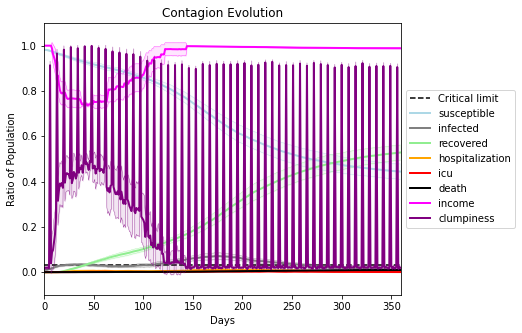

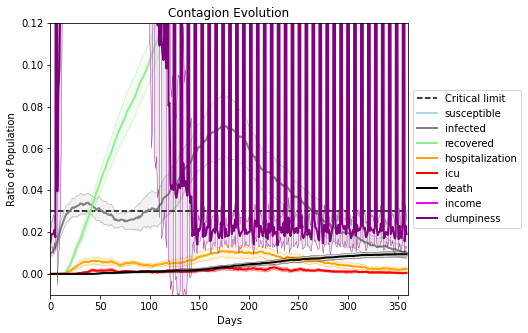

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9079, 2022, 373, 2142, 8434, 425, 4873, 6492, 6858, 7126, 1563, 9659, 4693, 5520, 9436, 8798, 9833, 108, 5787, 4103]
Average similarity between family members is 0.23387947896530797 at temperature -0.4
Average similarity between family and home is 0.9998568077201296 at temperature -1
Average similarity between students and their classroom is 0.2025284869865262 at temperature -0.4
Average classroom occupancy is 4.225352112676056 and number classrooms is 71
Average similarity between workers is 0.1583840377291672 at temperature -0.4
Average office occupancy is 3.232673267326733 and number offices is 202
Average friend similarity for adults: 0.2842287728527889 for kids: 0.1932864202351769
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.06044903076714263
avg restaurant similarity 0.04676325761179606
avg restaurant similarity 0.040157452961746096
avg restaurant similarity 0.0495166777979234
avg restaurant similarity 0.0978852174073634
avg restaurant similarity 0.028873637029866703
avg restaurant similarity 0.09319141695023658
avg restaurant similarity 7.358378875599754e-05
avg restaurant similarity 0.0874350252422075
avg restaurant similarity 0.04649966355350893
avg restaurant similarity 0.06222354714382902
avg restaurant similarity 0.10098144591394538
avg restaurant similarity 0.015596648030855456
avg restaurant similarity 0.04443742791012142
avg restaurant similarity 0.06090610706824298
avg restaurant similarity 0.08215606647512495
avg restaurant similarity 0.04655050950258418
avg restaurant similarity 0.08925453572600453
avg restaurant similarity 0.10524737299254287
avg restaurant similarity 0.09145413694232855
avg restaurant similarity 0.05019733677119464
avg restaurant similarity 0.0907

avg restaurant similarity 0.06241206286187092
avg restaurant similarity 0.03790290260454199
avg restaurant similarity 0.07570477820876724
avg restaurant similarity 0.08009826170714264
avg restaurant similarity 0.028055347820519973
avg restaurant similarity 0.05929311899262384
avg restaurant similarity 0.0993575717884714
avg restaurant similarity 0.14135367055492293
avg restaurant similarity 0.0859619297476932
avg restaurant similarity 0.08108762184622952
avg restaurant similarity 0.09205204092537864
avg restaurant similarity 0.03856301856280237
avg restaurant similarity 0.07262735324262569
avg restaurant similarity 0.06116609760615184
avg restaurant similarity 0.04425426882985051
avg restaurant similarity 0.06886142465716347
avg restaurant similarity 0.10384476129692621
avg restaurant similarity 0.03553601422253369
avg restaurant similarity -0.006190603380659567
avg restaurant similarity 0.09769922132996599
avg restaurant similarity 0.12516708599184595
avg restaurant similarity 0.05846

avg restaurant similarity 0.06940001449279401
avg restaurant similarity 0.04160395947417893
avg restaurant similarity 0.01882870166112672
avg restaurant similarity 0.09762718470092553
avg restaurant similarity 0.02485040495549742
avg restaurant similarity 0.02884492454357375
avg restaurant similarity 0.058690368479513026
avg restaurant similarity 0.09408073474912174
avg restaurant similarity 0.0025757288731098524
avg restaurant similarity -0.017810059827684657
avg restaurant similarity 0.03208815986721068
avg restaurant similarity 0.05459870908855382
avg restaurant similarity 0.011087227935317752
avg restaurant similarity 0.08119506699613477
avg restaurant similarity 0.08615284802854056
avg restaurant similarity 0.051316170080963286
avg restaurant similarity 0.037761032262000345
avg restaurant similarity 0.05946682675148079
avg restaurant similarity 0.10203435606320672
avg restaurant similarity 0.06403684159483428
avg restaurant similarity 0.08051064613948827
avg restaurant similarity 

avg restaurant similarity 0.07353136537407172
avg restaurant similarity 0.05224579296695442
avg restaurant similarity 0.09956907933274926
avg restaurant similarity 0.09022056837348043
avg restaurant similarity 0.053196354698741184
avg restaurant similarity 0.04795587054035642
avg restaurant similarity 0.0656558209321628
avg restaurant similarity 0.007419375381536205
avg restaurant similarity 0.03957427009580403
avg restaurant similarity 0.03533256248940244
avg restaurant similarity 0.0662647303525588
avg restaurant similarity 0.0570748221616493
avg restaurant similarity 0.13972560412138035
avg restaurant similarity 0.0714545964134866
avg restaurant similarity 0.03808833117352797
avg restaurant similarity 0.08879927731934216
avg restaurant similarity 0.02533184744543633
avg restaurant similarity 0.09261868961329252
avg restaurant similarity 0.08323996406902134
avg restaurant similarity 0.05093022573026935
avg restaurant similarity 0.09483432227872299
avg restaurant similarity 0.06246275

avg restaurant similarity 0.06713650945252125
avg restaurant similarity 0.025852120900947476
avg restaurant similarity 0.027574510176881437
avg restaurant similarity 0.02669790301667395
avg restaurant similarity 0.08204869556633003
avg restaurant similarity 0.0038487087046718974
avg restaurant similarity 0.12406993036947442
avg restaurant similarity 0.08602180220233113
avg restaurant similarity 0.06297341512100606
avg restaurant similarity 0.0602578446655664
avg restaurant similarity 0.08209394918402275
avg restaurant similarity 0.02890761763922929
avg restaurant similarity 0.023257581221000165
avg restaurant similarity 0.061639156564802094
avg restaurant similarity 0.10259183705278482
avg restaurant similarity 0.051629797285045055
avg restaurant similarity 0.042902905859025973
avg restaurant similarity 0.08427476216456158
avg restaurant similarity 0.12396831086614114
avg restaurant similarity 0.037397271396452735
avg restaurant similarity 0.055243703972542045
avg restaurant similarity

avg restaurant similarity 0.08299266006405713
avg restaurant similarity 0.04791746260269432
avg restaurant similarity 0.03206455876393528
avg restaurant similarity 0.10805107962317251
avg restaurant similarity 0.055986529234588515
avg restaurant similarity 0.0777822180085569
avg restaurant similarity 0.09636558776139907
avg restaurant similarity 0.06348744071125226
avg restaurant similarity 0.024255932997497266
avg restaurant similarity 0.047433220666670425
avg restaurant similarity 0.1025762718286566
avg restaurant similarity 0.0341405711339196
avg restaurant similarity 0.02741757696999096
avg restaurant similarity 0.05593001604374923
avg restaurant similarity 0.05744526083511438
avg restaurant similarity 0.046527756897635456
avg restaurant similarity 0.03723781379069113
avg restaurant similarity 0.038029611620683176
avg restaurant similarity 0.020380415169167033
avg restaurant similarity 0.07379577804851963
avg restaurant similarity 0.009809141156118532
avg restaurant similarity 0.05

avg restaurant similarity 0.11322013081017544
avg restaurant similarity 0.1349671129534877
avg restaurant similarity 0.0903061003358526
avg restaurant similarity 0.04964619023631994
avg restaurant similarity 0.11055822842025691
avg restaurant similarity 0.05353273014352093
avg restaurant similarity 0.09578194526091187
avg restaurant similarity 0.07672141641214297
avg restaurant similarity 0.0787861608856243
avg restaurant similarity 0.09507155258135815
avg restaurant similarity 0.05238663201447915
avg restaurant similarity 0.0695554302204256
avg restaurant similarity 0.093877543428951
avg restaurant similarity 0.05774968942557796
avg restaurant similarity 0.05997235899849389
avg restaurant similarity 0.038629323189443676
avg restaurant similarity 0.08602153961281625
avg restaurant similarity 0.05631782539937907
avg restaurant similarity 0.08218020125090077
avg restaurant similarity 0.09173208800594285
avg restaurant similarity 0.058584940044258536
avg restaurant similarity 0.0522205048

avg restaurant similarity 0.11038382734916227
avg restaurant similarity 0.1427944669761412
avg restaurant similarity 0.0793560448251396
avg restaurant similarity 0.10023698252404188
avg restaurant similarity 0.06034753186865456
avg restaurant similarity 0.07212259643145605
avg restaurant similarity 0.07772629892618022
avg restaurant similarity 0.08598162891772922
avg restaurant similarity 0.046188861005569355
avg restaurant similarity 0.05052940107981514
avg restaurant similarity 0.06772728782718948
avg restaurant similarity 0.10082075133968507
avg restaurant similarity 0.06320725077560135
avg restaurant similarity 0.09159924697121855
avg restaurant similarity 0.0922027781831307
avg restaurant similarity 0.14554705608025048
avg restaurant similarity 0.09043164490414306
avg restaurant similarity 0.0567204273472521
avg restaurant similarity 0.06422192597944902
avg restaurant similarity 0.05230695764117712
avg restaurant similarity 0.03409965940789981
avg restaurant similarity 0.098296797

avg restaurant similarity 0.006577641656383282
avg restaurant similarity 0.04366829531531739
avg restaurant similarity 0.07899850222731791
avg restaurant similarity 0.060668330574133955
avg restaurant similarity 0.08839360136945264
avg restaurant similarity 0.04684553750521446
avg restaurant similarity 0.062084997644438124
avg restaurant similarity 0.09237729853953283
avg restaurant similarity 0.022247705620243738
avg restaurant similarity 0.06864843635145529
avg restaurant similarity 0.07256851704017404
avg restaurant similarity 0.09450907974884581
avg restaurant similarity 0.05674741067406516
avg restaurant similarity 0.0438793954606909
avg restaurant similarity 0.06764375521956892
avg restaurant similarity 0.04552243835873141
avg restaurant similarity 0.10275537917537776
avg restaurant similarity 0.07897605970444023
avg restaurant similarity 0.06602541424878908
avg restaurant similarity 0.048195230390775605
avg restaurant similarity 0.061000405312076046
avg restaurant similarity 0.0

avg restaurant similarity 0.025999720899061145
avg restaurant similarity 0.041866320144502894
avg restaurant similarity 0.06790514799766294
avg restaurant similarity 0.05669323187541969
avg restaurant similarity 0.08528198242689748
avg restaurant similarity 0.06623293342187205
avg restaurant similarity 0.10960386171819808
avg restaurant similarity 0.05716177146333543
avg restaurant similarity 0.07713563979114058
avg restaurant similarity 0.1079585326086314
avg restaurant similarity 0.08628137973726069
avg restaurant similarity 0.03505906943122308
avg restaurant similarity 0.028197902161535966
avg restaurant similarity 0.04782010655954987
avg restaurant similarity 0.029295512309071497
avg restaurant similarity 0.07703334048089058
avg restaurant similarity 0.07038142168447921
avg restaurant similarity 0.08193836786847397
avg restaurant similarity 0.10946733357705721
avg restaurant similarity 0.056109067541180904
avg restaurant similarity 0.07328962448288409
avg restaurant similarity 0.06

avg restaurant similarity 0.041907175552853726
avg restaurant similarity 0.06580922224592523
avg restaurant similarity 0.08433617196578608
avg restaurant similarity 0.046357194961862296
avg restaurant similarity 0.06155478901961818
avg restaurant similarity 0.10622093686731293
avg restaurant similarity 0.09135982037152775
avg restaurant similarity 0.0771620501969105
avg restaurant similarity 0.07335608355229416
avg restaurant similarity 0.052841319111610476
avg restaurant similarity 0.0589261440799715
avg restaurant similarity 0.06843910786847636
avg restaurant similarity 0.039110199542295256
avg restaurant similarity 0.056698773615236855
avg restaurant similarity 0.05419129862191715
avg restaurant similarity 0.05483479651021468
avg restaurant similarity 0.16504232538915634
avg restaurant similarity 0.043397946356531984
avg restaurant similarity 0.013989438026835745
avg restaurant similarity 0.14422860339322316
avg restaurant similarity 0.11121445593935933
avg restaurant similarity 0.0

avg restaurant similarity 0.09852509649633079
avg restaurant similarity 0.003597332399848179
avg restaurant similarity 0.04910422400081089
avg restaurant similarity 0.058163097788365106
avg restaurant similarity 0.049390429749532096
avg restaurant similarity 0.041241788638786844
avg restaurant similarity 0.09589826822239865
avg restaurant similarity 0.13609358184627615
avg restaurant similarity 0.04916032334581887
avg restaurant similarity 0.09305597329307351
avg restaurant similarity 0.126974461439965
avg restaurant similarity 0.08273852068472834
avg restaurant similarity 0.07418738399626522
avg restaurant similarity 0.04154323354049974
avg restaurant similarity 0.11232276579187668
avg restaurant similarity 0.07882831305253334
avg restaurant similarity 0.02912667504377526
avg restaurant similarity 0.061998481521189724
avg restaurant similarity 0.06591419020009627
avg restaurant similarity 0.13143564886936204
avg restaurant similarity 0.06052498866744193
avg restaurant similarity 0.055

avg restaurant similarity 0.08435140270617299
avg restaurant similarity 0.11638797951368786
avg restaurant similarity 0.0884750380581489
avg restaurant similarity 0.09793088248312112
avg restaurant similarity 0.06282180325327805
avg restaurant similarity 0.0492098754043799
avg restaurant similarity 0.07680182033088771
avg restaurant similarity 0.13314454733875009
avg restaurant similarity 0.07893650891228922
avg restaurant similarity 0.05400122816940732
avg restaurant similarity 0.03871481157001709
avg restaurant similarity 0.0687567274300672
avg restaurant similarity 0.04713078002810604
avg restaurant similarity 0.09658679054600017
avg restaurant similarity 0.04845864727717048
avg restaurant similarity 0.07148209376026421
avg restaurant similarity 0.029870777584356713
avg restaurant similarity 0.01545837903281555
avg restaurant similarity 0.015307953019935058
avg restaurant similarity 0.03991585891651386
avg restaurant similarity 0.05435303848109261
avg restaurant similarity 0.0772774

avg restaurant similarity 0.06819440042864747
avg restaurant similarity 0.010100370209645356
avg restaurant similarity 0.08469830210238834
avg restaurant similarity 0.16339120526924258
avg restaurant similarity 0.06111968970767595
avg restaurant similarity 0.12915376379059987
avg restaurant similarity 0.0826187749931979
avg restaurant similarity 0.062291589359104865
avg restaurant similarity 0.050909584583084734
avg restaurant similarity 0.06100668305805079
avg restaurant similarity 0.07399183464472724
avg restaurant similarity 0.0718698838516734
avg restaurant similarity 0.08027735625528323
avg restaurant similarity 0.1208449345691543
avg restaurant similarity 0.03690214007201098
avg restaurant similarity 0.014664765970166792
avg restaurant similarity 0.059811573359677433
avg restaurant similarity 0.1088194658316946
avg restaurant similarity 0.06286200072760294
avg restaurant similarity 0.06776623119924587
avg restaurant similarity 0.11774980320398702
avg restaurant similarity 0.11500

avg restaurant similarity 0.003763998060891541
avg restaurant similarity 0.0785041067753915
avg restaurant similarity 0.056086715969589564
avg restaurant similarity 0.02466369730422863
avg restaurant similarity 0.02362484512442668
avg restaurant similarity 0.04406742283864392
avg restaurant similarity 0.059071201291927805
avg restaurant similarity 0.10346530971261717
avg restaurant similarity 0.08534325117748433
avg restaurant similarity 0.06556681344174442
avg restaurant similarity 0.09369247777376626
avg restaurant similarity 0.09003169074287927
avg restaurant similarity 0.03654213272018582
avg restaurant similarity 0.0358188636291551
avg restaurant similarity 0.08633793056220422
avg restaurant similarity 0.029452582632669186
avg restaurant similarity 0.061875703143926854
avg restaurant similarity 0.04560510243309122
avg restaurant similarity 0.12566669790629464
avg restaurant similarity 0.04008509355679105
avg restaurant similarity 0.06867652605336619
avg restaurant similarity 0.037

avg restaurant similarity 0.11047741335997259
avg restaurant similarity 0.07858351956037023
avg restaurant similarity 0.010531833891928168
avg restaurant similarity 0.06537963943030971
avg restaurant similarity 0.06898984865778354
avg restaurant similarity 0.06331099726156802
avg restaurant similarity 0.07125061853900445
avg restaurant similarity 0.039829766010131336
avg restaurant similarity 0.09749390726550683
avg restaurant similarity 0.06487298512250168
avg restaurant similarity 0.07764405760138693
avg restaurant similarity 0.08893373122890083
avg restaurant similarity 0.025906666079690072
avg restaurant similarity 0.10814928411886188
avg restaurant similarity 0.038725731714513635
avg restaurant similarity 0.04028901361030044
avg restaurant similarity 0.05719019519694931
avg restaurant similarity 0.08769349894513216
avg restaurant similarity 0.09491710020074766
avg restaurant similarity 0.05265388546225853
avg restaurant similarity 0.0746392279179593
avg restaurant similarity 0.149

avg restaurant similarity 0.07885284088378017
avg restaurant similarity 0.07676529699078272
avg restaurant similarity 0.06883683377143077
avg restaurant similarity 0.05637719583206566
avg restaurant similarity 0.06197787717074851
avg restaurant similarity 0.07399119890893532
avg restaurant similarity 0.0516170910150478
avg restaurant similarity 0.08879852098306583
avg restaurant similarity 0.10228652933322721
avg restaurant similarity 0.03519923812168439
avg restaurant similarity 0.07599252225164962
avg restaurant similarity 0.09375294848268578
avg restaurant similarity 0.11040760380429832
avg restaurant similarity 0.08040100889071197
avg restaurant similarity 0.06289142816759478
avg restaurant similarity 0.09502136764450678
avg restaurant similarity 0.10758062055638681
avg restaurant similarity 0.07258066212632978
avg restaurant similarity 0.07368755701348248
avg restaurant similarity 0.034652218775556805
avg restaurant similarity 0.08768143727830571
avg restaurant similarity 0.072503

avg restaurant similarity 0.08383671754603708
avg restaurant similarity 0.06268565238577796
avg restaurant similarity 0.06446139449230882
avg restaurant similarity 0.05374056059723195
avg restaurant similarity 0.06793314071996621
avg restaurant similarity 0.07221399453070998
avg restaurant similarity 0.021579479658825628
avg restaurant similarity 0.013686056423397406
avg restaurant similarity 0.03016085022423727
avg restaurant similarity 0.10350224783154974
avg restaurant similarity 0.09556136674862878
avg restaurant similarity 0.03923311381079093
avg restaurant similarity 0.0347532248669939
avg restaurant similarity 0.08064200719053174
avg restaurant similarity 0.07378769222359789
avg restaurant similarity 0.08133360220769391
avg restaurant similarity 0.09253378484015938
avg restaurant similarity 0.03261635809123208
avg restaurant similarity 0.08115842784326358
avg restaurant similarity 0.045926772201943494
avg restaurant similarity 0.04898742867687245
avg restaurant similarity 0.0577

avg restaurant similarity 0.0545268530710353
avg restaurant similarity 0.0788826312433453
avg restaurant similarity 0.05698237530035836
avg restaurant similarity 0.06833653032062707
avg restaurant similarity 0.09933857570453554
avg restaurant similarity 0.04054078488289314
avg restaurant similarity 0.08597408834719322
avg restaurant similarity 0.054652277435261
avg restaurant similarity 0.08231845161453161
avg restaurant similarity 0.07068050918381186
avg restaurant similarity 0.04944054106186534
avg restaurant similarity 0.0661598977581815
avg restaurant similarity 0.029882383161094345
avg restaurant similarity 0.12008693319636564
avg restaurant similarity 0.057821364697625145
avg restaurant similarity 0.05361542581201484
avg restaurant similarity 0.03189197920524564
avg restaurant similarity 0.08502221638375297
avg restaurant similarity 0.02501112869906466
avg restaurant similarity 0.0628158464336251
avg restaurant similarity 0.07423396145844775
avg restaurant similarity 0.0455783350

avg restaurant similarity 0.048111015125260635
avg restaurant similarity 0.08774327890226047
avg restaurant similarity 0.06920478487743324
avg restaurant similarity 0.060841652699165444
avg restaurant similarity 0.08798727766759154
avg restaurant similarity 0.06073644697930912
avg restaurant similarity 0.07505393561942081
avg restaurant similarity 0.10914640834455677
avg restaurant similarity 0.10992770963354549
avg restaurant similarity 0.03799164374030531
avg restaurant similarity 0.05824425492651146
avg restaurant similarity 0.04816488253760154
avg restaurant similarity 0.14215903224536444
avg restaurant similarity 0.036220607947133686
avg restaurant similarity 0.091485058864104
avg restaurant similarity 0.11394746768832824
avg restaurant similarity 0.0553001041756322
avg restaurant similarity 0.06363942569725425
avg restaurant similarity 0.06251181508382633
avg restaurant similarity 0.06327370048652402
avg restaurant similarity 0.07573248079768853
avg restaurant similarity 0.034029

avg restaurant similarity 0.026850368315813555
avg restaurant similarity 0.07871255799268524
avg restaurant similarity 0.09390948172383777
avg restaurant similarity 0.023680917121995746
avg restaurant similarity 0.0525781455299438
avg restaurant similarity -0.01658296216955207
avg restaurant similarity 0.13893639138388378
avg restaurant similarity 0.05532508362947347
avg restaurant similarity 0.01803193157062591
avg restaurant similarity 0.1010877663744561
avg restaurant similarity 0.1080814714265501
avg restaurant similarity 0.03871184501667193
avg restaurant similarity 0.04618385285280184
avg restaurant similarity 0.061929777400638625
avg restaurant similarity 0.05509402771719376
avg restaurant similarity 0.04644328134129662
avg restaurant similarity 0.014841769666674803
avg restaurant similarity 0.10799454102248016
avg restaurant similarity 0.02696389434863239
avg restaurant similarity 0.02432554814702048
avg restaurant similarity 0.0953265834667049
avg restaurant similarity 0.07871

avg restaurant similarity 0.02921943579376924
avg restaurant similarity 0.019354913755964803
avg restaurant similarity 0.09440181345438922
avg restaurant similarity 0.012811589414589255
avg restaurant similarity 0.045854017400829596
avg restaurant similarity 0.08911703362796199
avg restaurant similarity 0.05918954089755362
avg restaurant similarity 0.034089939642366215
avg restaurant similarity 0.1148207285406728
avg restaurant similarity 0.0375622851460799
avg restaurant similarity 0.1022951104403158
avg restaurant similarity 0.022294790177639228
avg restaurant similarity 0.06881555656846272
avg restaurant similarity 0.07232434674275663
avg restaurant similarity 0.04161226906983587
avg restaurant similarity 0.06702194398720786
avg restaurant similarity 0.05186203224619361
avg restaurant similarity -0.001778384171074919
avg restaurant similarity 0.03955589852846267
avg restaurant similarity 0.06476567854835379
avg restaurant similarity 0.07668533105078734
avg restaurant similarity 0.02

avg restaurant similarity 0.08005325156195522
avg restaurant similarity 0.04782076954769033
avg restaurant similarity 0.059560793763767036
avg restaurant similarity 0.0944936868555893
avg restaurant similarity 0.11778548507845614
avg restaurant similarity 0.09610713825945222
avg restaurant similarity 0.08530107168135367
avg restaurant similarity 0.08835309629023685
avg restaurant similarity 0.12778665194922698
avg restaurant similarity 0.0403016924395003
avg restaurant similarity 0.07410568273787473
avg restaurant similarity 0.156489109152063
avg restaurant similarity 0.008061766994520048
avg restaurant similarity 0.09241703005767316
avg restaurant similarity 0.11115255331124597
avg restaurant similarity 0.05254345059143355
avg restaurant similarity 0.06273033810431067
avg restaurant similarity 0.09853756286777207
avg restaurant similarity 0.12950226365127623
avg restaurant similarity 0.08893383055832657
avg restaurant similarity 0.07217596930043864
avg restaurant similarity 0.12677106

avg restaurant similarity 0.039969125279361646
avg restaurant similarity 0.06822894949560351
avg restaurant similarity 0.11378237244960795
avg restaurant similarity 0.06699102903262831
avg restaurant similarity 0.020430139967555955
avg restaurant similarity 0.05123950895852225
avg restaurant similarity 0.11462792982076063
avg restaurant similarity 0.08941127813898031
avg restaurant similarity 0.10498405398549902
avg restaurant similarity 0.08014755197687574
avg restaurant similarity 0.10789513646481069
avg restaurant similarity 0.12033736962663487
avg restaurant similarity 0.020783904404555485
avg restaurant similarity 0.05408045807756699
avg restaurant similarity 0.1359536048727598
avg restaurant similarity 0.06580151349798029
avg restaurant similarity 0.07816712538681098
avg restaurant similarity 0.09849032918994269
avg restaurant similarity 0.06540574149664173
avg restaurant similarity 0.07806101109371132
avg restaurant similarity 0.13208968045310662
avg restaurant similarity 0.0566

avg restaurant similarity 0.05986592553980184
avg restaurant similarity 0.06411322857035477
avg restaurant similarity 0.056660666942545165
avg restaurant similarity 0.047663763536336765
avg restaurant similarity 0.02600269920956988
avg restaurant similarity 0.018607327635437387
avg restaurant similarity 0.10958012487790286
avg restaurant similarity 0.06824173655911389
avg restaurant similarity 0.04477265199779037
avg restaurant similarity 0.07491220191016312
avg restaurant similarity 0.08391230147581674
avg restaurant similarity 0.06989701070639873
avg restaurant similarity 0.058800452766150244
avg restaurant similarity 0.08220351766424727
avg restaurant similarity 0.022848767940094494
avg restaurant similarity 0.04226997264372196
avg restaurant similarity 0.10893963428051062
avg restaurant similarity 0.05357404273691113
avg restaurant similarity 0.011393229868822827
avg restaurant similarity 0.07342059623710222
avg restaurant similarity 0.07977207236474315
avg restaurant similarity 0.

avg restaurant similarity 0.0846821491940631
avg restaurant similarity 0.08038139771272017
avg restaurant similarity 0.013048124632089542
avg restaurant similarity 0.03856286709395359
avg restaurant similarity 0.03317620399077961
avg restaurant similarity 0.15521345234599446
avg restaurant similarity 0.008719949193645389
avg restaurant similarity 0.02265038782306611
avg restaurant similarity 0.07521636142563225
avg restaurant similarity 0.05630273848627731
avg restaurant similarity 0.09662419736934119
avg restaurant similarity 0.06859511881662195
avg restaurant similarity 0.10637963412646465
avg restaurant similarity 0.037651093536841075
avg restaurant similarity 0.04970958291789476
avg restaurant similarity 0.056901071347765474
avg restaurant similarity 0.083604958857018
avg restaurant similarity 0.06320299833148986
avg restaurant similarity 0.09372152153575852
avg restaurant similarity 0.043996493415012904
avg restaurant similarity 0.10598445733752009
avg restaurant similarity 0.0819

avg restaurant similarity 0.0615751320797986
avg restaurant similarity 0.09448880797611485
avg restaurant similarity 0.05638232069003929
avg restaurant similarity 0.08939273681679327
avg restaurant similarity 0.06785789743236728
avg restaurant similarity 0.11204669664496923
avg restaurant similarity 0.06265930869510396
avg restaurant similarity -0.0014254063718972475
avg restaurant similarity 0.07325917432681389
avg restaurant similarity 0.06578631166122896
avg restaurant similarity 0.09198322398285436
avg restaurant similarity 0.06972578956116326
avg restaurant similarity 0.10507557753280505
avg restaurant similarity 0.05717686876782427
avg restaurant similarity 0.06624430102595773
avg restaurant similarity 0.04358982442147887
avg restaurant similarity 0.10348121009726456
avg restaurant similarity 0.05961799371950921
avg restaurant similarity 0.0633776410542458
avg restaurant similarity 0.08515681004991203
avg restaurant similarity 0.08195791839173627
avg restaurant similarity 0.06512

avg restaurant similarity 0.10699002389533074
avg restaurant similarity -0.009652820090347479
avg restaurant similarity 0.04471374805668379
avg restaurant similarity 0.13415750583890496
avg restaurant similarity 0.07656959952023619
avg restaurant similarity 0.05202673116117278
avg restaurant similarity 0.11614576800981256
avg restaurant similarity 0.10211290842898793
avg restaurant similarity 0.0401772440484373
avg restaurant similarity 0.11286395563424619
avg restaurant similarity 0.14170820163585798
avg restaurant similarity 0.12757524508462328
avg restaurant similarity 0.06712151211199782
avg restaurant similarity 0.05558673652037609
avg restaurant similarity 0.09817495626154675
avg restaurant similarity 0.015117497293135674
avg restaurant similarity 0.04384782290086111
avg restaurant similarity 0.0823042976508783
avg restaurant similarity 0.04093627377630603
avg restaurant similarity 0.09604708445191985
avg restaurant similarity 0.0716065238764134
avg restaurant similarity 0.087900

avg restaurant similarity 0.12428799049689285
avg restaurant similarity 0.07650380954275049
avg restaurant similarity 0.11154853557893357
avg restaurant similarity 0.040389949201058664
avg restaurant similarity 0.03604747334028318
avg restaurant similarity 0.010024187399892215
avg restaurant similarity 0.07626269483364126
avg restaurant similarity 0.14238313594239332
avg restaurant similarity 0.07637103891067934
avg restaurant similarity 0.03675800003319054
avg restaurant similarity 0.06526938097561509
avg restaurant similarity 0.08146277785816045
avg restaurant similarity 0.057292247826563766
avg restaurant similarity 0.060788170635076036
avg restaurant similarity 0.07023514076645153
avg restaurant similarity 0.0725184388278873
avg restaurant similarity 0.03001774691000161
avg restaurant similarity 0.07169675350199732
avg restaurant similarity 0.06734696196042426
avg restaurant similarity 0.08545122312572895
avg restaurant similarity 0.06390680259214922
avg restaurant similarity 0.048

avg restaurant similarity 0.026026104656341646
avg restaurant similarity 0.04855173468289034
avg restaurant similarity 0.03031223789932113
avg restaurant similarity 0.03283929195632599
avg restaurant similarity 0.02570473682993581
avg restaurant similarity 0.07796993670308948
avg restaurant similarity 0.09251510687841209
avg restaurant similarity 0.061625833929070006
avg restaurant similarity 0.05291212301435176
avg restaurant similarity 0.030019610378769535
avg restaurant similarity 0.0075013610444129
avg restaurant similarity 0.12200413767741261
avg restaurant similarity 0.06265247939967775
avg restaurant similarity 0.036198743503469424
avg restaurant similarity 0.07361320501632755
avg restaurant similarity 0.07874648984571167
avg restaurant similarity 0.04070526393341983
avg restaurant similarity 0.18656319574340646
avg restaurant similarity 0.07319591543437087
avg restaurant similarity 0.1256382515081042
avg restaurant similarity 0.08311586083008528
avg restaurant similarity 0.0369

avg restaurant similarity 0.05767481176563874
avg restaurant similarity 0.07159223650574423
avg restaurant similarity 0.07413748010714678
avg restaurant similarity 0.09402392220943522
avg restaurant similarity 0.06158759545883569
avg restaurant similarity 0.057418027769670074
avg restaurant similarity 0.0711721999702816
avg restaurant similarity 0.042966954499471535
avg restaurant similarity 0.04485226750105603
avg restaurant similarity 0.002782101351246816
avg restaurant similarity 0.04500183673160151
avg restaurant similarity 0.02734816929420801
avg restaurant similarity 0.05150772230450312
avg restaurant similarity 0.05860975272514374
avg restaurant similarity 0.04677044819513861
avg restaurant similarity 0.044403754961975864
avg restaurant similarity 0.02359311354385565
avg restaurant similarity 0.06086590373721977
avg restaurant similarity 0.04017114830247377
avg restaurant similarity 0.026339239063850158
avg restaurant similarity 0.08305698121631389
avg restaurant similarity 0.07

avg restaurant similarity 0.06684795562897942
avg restaurant similarity 0.011974144148378257
avg restaurant similarity 0.08681458480625241
avg restaurant similarity 0.031176538844648955
avg restaurant similarity -0.0014484057583159643
avg restaurant similarity 0.025960448019837608
avg restaurant similarity 0.050500944968876124
avg restaurant similarity 0.032430305657022956
avg restaurant similarity 0.056781540672672916
avg restaurant similarity 0.022236773213619263
avg restaurant similarity 0.062107010381009166
avg restaurant similarity 0.08398172344001999
avg restaurant similarity 0.050653442003653
avg restaurant similarity 0.010162729031883026
avg restaurant similarity 0.03280309716391046
avg restaurant similarity 0.040634654507106086
avg restaurant similarity 0.0747055563793069
avg restaurant similarity 0.048946729857947145
avg restaurant similarity 0.06580705087009861
avg restaurant similarity 0.06959501056468087
avg restaurant similarity 0.057750427368396515
avg restaurant similar

avg restaurant similarity 0.11059406304816974
avg restaurant similarity 0.017385633861677373
avg restaurant similarity 0.09581285775543659
avg restaurant similarity 0.06221887406289674
avg restaurant similarity 0.028852451864502103
avg restaurant similarity 0.07980109458871813
avg restaurant similarity 0.14593585620510002
avg restaurant similarity 0.0916873432016744
avg restaurant similarity 0.11922476815967052
avg restaurant similarity 0.11836321118106381
avg restaurant similarity 0.036412225120179546
avg restaurant similarity 0.033592945191605855
avg restaurant similarity 0.03915567614565596
avg restaurant similarity 0.07171024129353613
avg restaurant similarity 0.09391252105819643
avg restaurant similarity 0.1244321044237036
avg restaurant similarity 0.050076119988828646
avg restaurant similarity 0.10443026128997372
avg restaurant similarity 0.10881503538806185
avg restaurant similarity 0.0603316391195612
avg restaurant similarity 0.0875662490919851
avg restaurant similarity 0.08455

avg restaurant similarity 0.12082851047805358
avg restaurant similarity 0.10273941506140802
avg restaurant similarity 0.06371543346020148
avg restaurant similarity 0.07702796341359754
avg restaurant similarity 0.04212229682442176
avg restaurant similarity 0.1061756552603653
avg restaurant similarity 0.1415640638300195
avg restaurant similarity 0.09049651327566609
avg restaurant similarity 0.09936237707757366
avg restaurant similarity 0.035707846267755104
avg restaurant similarity 0.04010960977392795
avg restaurant similarity 0.04952353997110322
avg restaurant similarity 0.08172760213020483
avg restaurant similarity 0.09423630716190473
avg restaurant similarity 0.09697837696320805
avg restaurant similarity 0.08867022918699687
avg restaurant similarity 0.07030874984065717
avg restaurant similarity 0.10345855736264349
avg restaurant similarity 0.08094403131032177
avg restaurant similarity 0.08583684718022687
avg restaurant similarity 0.0899662055562263
avg restaurant similarity 0.11441612

avg restaurant similarity 0.07392877797911068
avg restaurant similarity 0.06508462490937734
avg restaurant similarity 0.03451675188807607
avg restaurant similarity -0.015836502677339086
avg restaurant similarity 0.11535016967509897
avg restaurant similarity 0.14397706484729278
avg restaurant similarity 0.06967753465272156
avg restaurant similarity 0.05443022984481688
avg restaurant similarity 0.010656649746145537
avg restaurant similarity 0.11263437173580808
avg restaurant similarity 0.05833604441872405
avg restaurant similarity 0.05599798464448937
avg restaurant similarity 0.07950819108576614
avg restaurant similarity 0.12499640356588756
avg restaurant similarity 0.062064931255104545
avg restaurant similarity 0.10611657152390844
avg restaurant similarity 0.07970050862699941
avg restaurant similarity 0.05909207598584969
avg restaurant similarity 0.05697051739587363
avg restaurant similarity 0.06571132758048952
avg restaurant similarity 0.021392840263141935
avg restaurant similarity 0.1

avg restaurant similarity 0.0015975567788552671
avg restaurant similarity 0.07277069185552791
avg restaurant similarity 0.08920812877016397
avg restaurant similarity 0.037081476493680064
avg restaurant similarity 0.06165063237036452
avg restaurant similarity 0.09763907935894635
avg restaurant similarity 0.1119181896303968
avg restaurant similarity 0.04754314846680604
avg restaurant similarity 0.07925211300601383
avg restaurant similarity 0.10785069680734323
avg restaurant similarity 0.031764597402392465
avg restaurant similarity 0.09674629265582442
avg restaurant similarity 0.10460933885395651
avg restaurant similarity 0.08550927516865278
avg restaurant similarity 0.04922848718888587
avg restaurant similarity 0.08769668228360464
avg restaurant similarity 0.03344908722468344
avg restaurant similarity 0.11419794358603141
avg restaurant similarity -0.00024238126162019397
avg restaurant similarity 0.1080294252099626
avg restaurant similarity 0.01067988797883225
avg restaurant similarity 0.

avg restaurant similarity 0.07516079327399122
avg restaurant similarity 0.09864838202396763
avg restaurant similarity 0.05934293618891691
avg restaurant similarity 0.023655790173794305
avg restaurant similarity 0.10576211723539032
avg restaurant similarity 0.10667951110549405
avg restaurant similarity 0.10715013187236021
avg restaurant similarity 0.11215155554372547
avg restaurant similarity 0.06874075235276292
avg restaurant similarity 0.07874559558957192
avg restaurant similarity 0.11052577449665857
avg restaurant similarity 0.047017301740339086
avg restaurant similarity 0.04497312300907346
avg restaurant similarity 0.06791991748021607
avg restaurant similarity 0.06893030140059735
avg restaurant similarity 0.053641655028128024
avg restaurant similarity 0.08394802406153515
avg restaurant similarity 0.01674583997528463
avg restaurant similarity 0.06256917352374639
avg restaurant similarity 0.06629935186746708
avg restaurant similarity 0.07938842889857374
avg restaurant similarity 0.057

avg restaurant similarity 0.05691444817940127
avg restaurant similarity 0.09197472101358865
avg restaurant similarity -0.0015186629847826183
avg restaurant similarity 0.06885382699302045
avg restaurant similarity 0.08640185343166001
avg restaurant similarity 0.0955812986079935
avg restaurant similarity 0.07444451599866353
avg restaurant similarity 0.13373884453419557
avg restaurant similarity 0.07244531750400683
avg restaurant similarity 0.07445835488369486
avg restaurant similarity 0.05424719431083578
avg restaurant similarity 0.12302112546294872
avg restaurant similarity 0.08782346116437233
avg restaurant similarity 0.02872961915054477
avg restaurant similarity 0.07062319024989215
avg restaurant similarity 0.10532996463000933
avg restaurant similarity 0.12044184881075358
avg restaurant similarity 0.13174464018781135
avg restaurant similarity 0.09063425656335107
avg restaurant similarity 0.1187624614765215
avg restaurant similarity 0.0749769776332478
avg restaurant similarity 0.096911

avg restaurant similarity 0.06877048578070066
avg restaurant similarity 0.02482004584575101
avg restaurant similarity 0.08750850495794145
avg restaurant similarity 0.09078362252963805
avg restaurant similarity 0.03720521786359208
avg restaurant similarity 0.05320260968197968
avg restaurant similarity 0.0661396804013335
avg restaurant similarity 0.09568070283782605
avg restaurant similarity 0.09776182234167016
avg restaurant similarity 0.06651737920782598
avg restaurant similarity 0.08565341389848159
avg restaurant similarity 0.08705818412267506
avg restaurant similarity 0.08447398324455913
avg restaurant similarity 0.08757954590172677
avg restaurant similarity 0.0936689666653413
avg restaurant similarity 0.04452667550372933
avg restaurant similarity 0.07091325772069483
avg restaurant similarity 0.05734963436277465
avg restaurant similarity 0.07673862101809709
avg restaurant similarity 0.06485819989032549
avg restaurant similarity 0.09276313758558914
avg restaurant similarity 0.05192354

avg restaurant similarity 0.06798517063510093
avg restaurant similarity 0.06989910770540614
avg restaurant similarity 0.08973339944033423
avg restaurant similarity 0.04683487681275566
avg restaurant similarity 0.07058546033139386
avg restaurant similarity 0.07114089076361464
avg restaurant similarity 0.10446544134911559
avg restaurant similarity 0.07691637671550344
avg restaurant similarity 0.09685831000839668
avg restaurant similarity 0.10528467656127222
avg restaurant similarity 0.17068004002948697
avg restaurant similarity 0.09846351724010156
avg restaurant similarity 0.10609736442032976
avg restaurant similarity 0.08235119319929303
avg restaurant similarity 0.0969203649775364
avg restaurant similarity 0.10664841072086133
avg restaurant similarity 0.08612881338003413
avg restaurant similarity 0.13383241602333612
avg restaurant similarity 0.08849353677470412
avg restaurant similarity 0.03698293148301346
avg restaurant similarity 0.07154399169394832
avg restaurant similarity 0.0944506

(<function dict.items>, <function dict.items>, <function dict.items>)

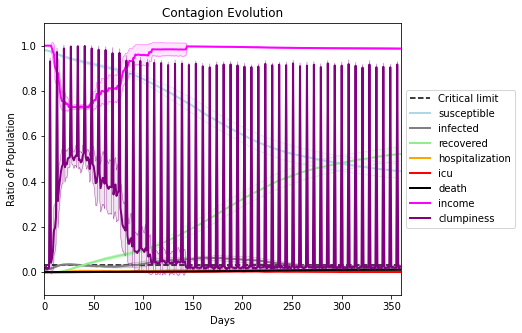

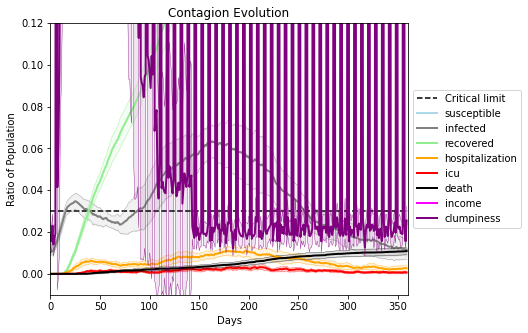

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4388, 5893, 3538, 871, 5655, 741, 7599, 6478, 421, 5269, 4061, 5138, 6469, 3088, 1801, 7686, 717, 4817, 762, 1981]
Average similarity between family members is 0.19195472671076336 at temperature -0.3
Average similarity between family and home is 0.9998719000781049 at temperature -1
Average similarity between students and their classroom is 0.16316399179259916 at temperature -0.3
Average classroom occupancy is 3.9130434782608696 and number classrooms is 69
Average similarity between workers is 0.16799081677004576 at temperature -0.3
Average office occupancy is 3.4771573604060912 and number offices is 197
Average friend similarity for adults: 0.24831175747820075 for kids: 0.21596193172129693
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.07303564911455541
avg restaurant similarity 0.04791457714354336
avg restaurant similarity 0.056813313914191116
avg restaurant similarity 0.051212448797690574
avg restaurant similarity 0.05278570467711013
avg restaurant similarity 0.06912879469667611
avg restaurant similarity 0.0569775732611831
avg restaurant similarity 0.05911841520416298
avg restaurant similarity 0.04909267922535877
avg restaurant similarity 0.085198009846698
avg restaurant similarity 0.025904915997009597
avg restaurant similarity 0.08955108021201251
avg restaurant similarity 0.06465002851130744
avg restaurant similarity 0.0922810433463869
avg restaurant similarity 0.08418431103922266
avg restaurant similarity 0.05835826532780409
avg restaurant similarity 0.10208019749452822
avg restaurant similarity 0.04509389917305319
avg restaurant similarity 0.11937887178497002
avg restaurant similarity 0.07323561713865294
avg restaurant similarity 0.09829180886033763
avg restaurant similarity 0.0879657

avg restaurant similarity 0.06106511428094342
avg restaurant similarity 0.02177526214595667
avg restaurant similarity 0.045080196566206966
avg restaurant similarity 0.06551432318905596
avg restaurant similarity 0.07738802634203579
avg restaurant similarity 0.008802724559154882
avg restaurant similarity 0.07455468107620727
avg restaurant similarity 0.03328397885938361
avg restaurant similarity 0.09458253005625851
avg restaurant similarity 0.06255592179606687
avg restaurant similarity 0.08774458969882336
avg restaurant similarity 0.04219373541433292
avg restaurant similarity 0.06899181130428197
avg restaurant similarity 0.09306722952182374
avg restaurant similarity 0.07858726806379611
avg restaurant similarity 0.07758864499697574
avg restaurant similarity 0.039051705765236804
avg restaurant similarity 0.07062054844612009
avg restaurant similarity 0.038781573793779237
avg restaurant similarity 0.10021933480275536
avg restaurant similarity 0.08718127883248658
avg restaurant similarity 0.04

avg restaurant similarity 0.07073895729130095
avg restaurant similarity 0.04713367137822129
avg restaurant similarity 0.058533541116148564
avg restaurant similarity 0.07600500146500419
avg restaurant similarity 0.040410991743421255
avg restaurant similarity 0.060899493706829774
avg restaurant similarity 0.008298491275045245
avg restaurant similarity 0.04016293544253829
avg restaurant similarity 0.05991989817424767
avg restaurant similarity 0.03591446580923364
avg restaurant similarity 0.0996150254944024
avg restaurant similarity 0.07421756073261108
avg restaurant similarity 0.05593189113161677
avg restaurant similarity 0.04744900464898826
avg restaurant similarity 0.04131945511521945
avg restaurant similarity 0.08236659428638282
avg restaurant similarity 0.12023844821436543
avg restaurant similarity 0.05377321351452155
avg restaurant similarity 0.05917424971570897
avg restaurant similarity 0.06765514937706998
avg restaurant similarity 0.056100430968210345
avg restaurant similarity 0.02

avg restaurant similarity 0.07869618822028922
avg restaurant similarity 0.03560606834745848
avg restaurant similarity 0.12949451529362788
avg restaurant similarity 0.03850166790441533
avg restaurant similarity 0.07726296886553066
avg restaurant similarity 0.10343035148390657
avg restaurant similarity 0.08515321336243133
avg restaurant similarity 0.09472329175291118
avg restaurant similarity 0.08758301919056836
avg restaurant similarity 0.10340926913080332
avg restaurant similarity 0.07620536116279236
avg restaurant similarity 0.0678953729082971
avg restaurant similarity 0.05028760473480081
avg restaurant similarity 0.02806019256466009
avg restaurant similarity 0.0229977824792465
avg restaurant similarity 0.058105745768542064
avg restaurant similarity 0.037393252748698536
avg restaurant similarity 0.0988997650926094
avg restaurant similarity 0.04524694218380655
avg restaurant similarity 0.05976403654508636
avg restaurant similarity 0.0331084353746224
avg restaurant similarity 0.06082063

avg restaurant similarity 0.1287620343153775
avg restaurant similarity 0.07392273695309143
avg restaurant similarity 0.10520238207645372
avg restaurant similarity 0.10380502627548835
avg restaurant similarity 0.11956523687626128
avg restaurant similarity 0.01727786782394236
avg restaurant similarity 0.1097864636872689
avg restaurant similarity 0.03529869705384127
avg restaurant similarity 0.03756671376558011
avg restaurant similarity 0.048124152804096605
avg restaurant similarity 0.0242136120565136
avg restaurant similarity 0.09753673820508178
avg restaurant similarity 0.07587384921437179
avg restaurant similarity 0.01886892523628659
avg restaurant similarity -0.02814381980854003
avg restaurant similarity 0.07037797808355714
avg restaurant similarity 0.045604514457748296
avg restaurant similarity 0.03934624854669687
avg restaurant similarity 0.046861765972415946
avg restaurant similarity 0.06913099892697971
avg restaurant similarity 0.07687846507083004
avg restaurant similarity 0.07802

avg restaurant similarity 0.1247260020466893
avg restaurant similarity 0.11410959299806861
avg restaurant similarity 0.12461967506513869
avg restaurant similarity 0.04199430629257313
avg restaurant similarity 0.05655957688622163
avg restaurant similarity 0.0660858832293289
avg restaurant similarity 0.08377499458504911
avg restaurant similarity 0.07012924514228312
avg restaurant similarity 0.029411252385703458
avg restaurant similarity 0.1474158666265974
avg restaurant similarity 0.097785733168846
avg restaurant similarity 0.07803452003826919
avg restaurant similarity 0.015598975483280684
avg restaurant similarity 0.10097160438129021
avg restaurant similarity 0.05953897657090124
avg restaurant similarity 0.15210722831333873
avg restaurant similarity 0.05939470296808214
avg restaurant similarity 0.11090377330156778
avg restaurant similarity 0.033285885213605065
avg restaurant similarity 0.08520377557376432
avg restaurant similarity 0.0688292630258521
avg restaurant similarity 0.036443917

avg restaurant similarity 0.08932369767793208
avg restaurant similarity 0.037300211211931285
avg restaurant similarity 0.06912490785869276
avg restaurant similarity 0.07131247475923579
avg restaurant similarity 0.0922112287706719
avg restaurant similarity 0.01245645694562326
avg restaurant similarity 0.05000732662714905
avg restaurant similarity 0.06496428025973151
avg restaurant similarity 0.0628611188169081
avg restaurant similarity 0.06693758065812426
avg restaurant similarity 0.015084491460045273
avg restaurant similarity 0.07259282486831474
avg restaurant similarity 0.07970113668837889
avg restaurant similarity 0.04015034957647081
avg restaurant similarity 0.09932130603366734
avg restaurant similarity 0.07093332760670698
avg restaurant similarity 0.052853292941853
avg restaurant similarity 0.04056080731368974
avg restaurant similarity 0.019942369221291913
avg restaurant similarity 0.04604175022514875
avg restaurant similarity 0.04538831005820646
avg restaurant similarity 0.0542038

avg restaurant similarity 0.03671436220745186
avg restaurant similarity 0.005609081454768736
avg restaurant similarity 0.0480731938859749
avg restaurant similarity 0.03633632908785148
avg restaurant similarity 0.03110561764855714
avg restaurant similarity 0.07851201853608734
avg restaurant similarity 0.043526822845161364
avg restaurant similarity 0.045824530313889104
avg restaurant similarity 0.03888270600837514
avg restaurant similarity 0.07262743733315315
avg restaurant similarity 0.06952840532528567
avg restaurant similarity 0.08520531946900031
avg restaurant similarity 0.029238005769842288
avg restaurant similarity 0.06375236398533742
avg restaurant similarity 0.010085666207958793
avg restaurant similarity 0.04825894750148399
avg restaurant similarity 0.043739533239024304
avg restaurant similarity 0.10289246693669829
avg restaurant similarity 0.09782457426753977
avg restaurant similarity 0.0911023764884439
avg restaurant similarity 0.04328407143851743
avg restaurant similarity 0.10

avg restaurant similarity 0.1369385602849358
avg restaurant similarity 0.07595553830871238
avg restaurant similarity 0.10432397772138516
avg restaurant similarity 0.04589926873977959
avg restaurant similarity 0.08823080712969118
avg restaurant similarity 0.08369206032608247
avg restaurant similarity 0.07701284127731951
avg restaurant similarity 0.11019671258848675
avg restaurant similarity 0.08058340065839045
avg restaurant similarity 0.08325168906489994
avg restaurant similarity 0.14282214312091576
avg restaurant similarity 0.03917888442097606
avg restaurant similarity 0.10447731107744457
avg restaurant similarity 0.11936975414245349
avg restaurant similarity 0.05566812312049727
avg restaurant similarity 0.16833286807300257
avg restaurant similarity 0.06117421323915087
avg restaurant similarity 0.023026850814927367
avg restaurant similarity 0.03297042454180696
avg restaurant similarity 0.09729658621667306
avg restaurant similarity 0.11240620708462397
avg restaurant similarity 0.070647

avg restaurant similarity 0.15061913709552016
avg restaurant similarity 0.09064606002775943
avg restaurant similarity 0.07734607590274309
avg restaurant similarity 0.07666201011945166
avg restaurant similarity 0.11111059499789425
avg restaurant similarity 0.06479370968969085
avg restaurant similarity 0.13238553261301853
avg restaurant similarity 0.1020754282567426
avg restaurant similarity 0.07030300171147626
avg restaurant similarity 0.09802708551618926
avg restaurant similarity 0.11101548954040412
avg restaurant similarity 0.07208030596609974
avg restaurant similarity 0.08284367611543267
avg restaurant similarity 0.05756820744467676
avg restaurant similarity 0.05118709752189118
avg restaurant similarity 0.07095416882367474
avg restaurant similarity 0.08205478255901558
avg restaurant similarity 0.10297204519023145
avg restaurant similarity 0.0530688563681782
avg restaurant similarity 0.06295578159873148
avg restaurant similarity 0.025635988308159486
avg restaurant similarity 0.0455560

avg restaurant similarity 0.11496654431047802
avg restaurant similarity 0.09857437248459952
avg restaurant similarity 0.05512611581303357
avg restaurant similarity 0.056659115490516276
avg restaurant similarity 0.0669721872695264
avg restaurant similarity 0.11568366732608425
avg restaurant similarity 0.09973834372210975
avg restaurant similarity 0.06596756526259245
avg restaurant similarity 0.07544916123824165
avg restaurant similarity 0.10571974835494001
avg restaurant similarity 0.05393292645413374
avg restaurant similarity 0.04308354312101316
avg restaurant similarity 0.09870653700183937
avg restaurant similarity 0.08768591107247901
avg restaurant similarity 0.07623020075664465
avg restaurant similarity 0.05406952412604265
avg restaurant similarity 0.1126106776080463
avg restaurant similarity 0.11005400010062144
avg restaurant similarity 0.08674604781964981
avg restaurant similarity 0.04655048259550137
avg restaurant similarity 0.07744124925868874
avg restaurant similarity 0.0798001

avg restaurant similarity 0.07328448260696045
avg restaurant similarity 0.04215930393966436
avg restaurant similarity 0.15021250237827388
avg restaurant similarity 0.08559822299684026
avg restaurant similarity 0.07174575913323179
avg restaurant similarity 0.05333417393722797
avg restaurant similarity 0.10424870945126322
avg restaurant similarity 0.17794241060361018
avg restaurant similarity 0.07079035002016741
avg restaurant similarity 0.04545052784618663
avg restaurant similarity 0.06771400261280322
avg restaurant similarity 0.11655612019060958
avg restaurant similarity 0.0682214129007629
avg restaurant similarity 0.11065415818055217
avg restaurant similarity 0.0750019336697134
avg restaurant similarity 0.09384014200698748
avg restaurant similarity 0.1200190973858722
avg restaurant similarity 0.10640552758402153
avg restaurant similarity 0.07451897475307914
avg restaurant similarity 0.08117839106413566
avg restaurant similarity 0.02247616574169447
avg restaurant similarity 0.048227330

avg restaurant similarity 0.026196427995116758
avg restaurant similarity 0.05652828140458699
avg restaurant similarity 0.12631578973446678
avg restaurant similarity 0.014328696041143302
avg restaurant similarity 0.03017633127023006
avg restaurant similarity 0.05807035851211534
avg restaurant similarity 0.05272861929184779
avg restaurant similarity 0.08122127854572019
avg restaurant similarity 0.07864951122849341
avg restaurant similarity 0.041330986235445136
avg restaurant similarity 0.02851696695718308
avg restaurant similarity 0.08527865295384467
avg restaurant similarity 0.05984779136513389
avg restaurant similarity -0.00014813266265785346
avg restaurant similarity 0.02021156184915508
avg restaurant similarity 0.07293307026242173
avg restaurant similarity 0.07473768267287514
avg restaurant similarity 0.07730190960975475
avg restaurant similarity 0.07547291992254683
avg restaurant similarity 0.06868074493783546
avg restaurant similarity 0.1009190912229119
avg restaurant similarity 0.

avg restaurant similarity 0.07494771991311629
avg restaurant similarity 0.11403141136023678
avg restaurant similarity 0.09529130032835395
avg restaurant similarity 0.09570297426563351
avg restaurant similarity 0.061131722716172954
avg restaurant similarity 0.02008419179054689
avg restaurant similarity 0.015059301288033497
avg restaurant similarity 0.06292936205403954
avg restaurant similarity 0.03350611889845267
avg restaurant similarity 0.057729183015027344
avg restaurant similarity 0.031482556961864465
avg restaurant similarity 0.06420438344325669
avg restaurant similarity 0.06421343666336077
avg restaurant similarity 0.057146095487441435
avg restaurant similarity 0.07270856297988748
avg restaurant similarity 0.11977001555187188
avg restaurant similarity 0.09047181036600231
avg restaurant similarity 0.010602213308092023
avg restaurant similarity 0.09263411074996991
avg restaurant similarity 0.039998718046578126
avg restaurant similarity 0.017644309036973435
avg restaurant similarity 

avg restaurant similarity 0.06680458123811167
avg restaurant similarity 0.04365376339951837
avg restaurant similarity 0.0912726147453233
avg restaurant similarity 0.05627117076698803
avg restaurant similarity 0.07899518323298049
avg restaurant similarity 0.062454339446141365
avg restaurant similarity 0.07324673681379512
avg restaurant similarity 0.022540667987360576
avg restaurant similarity 0.12073096078872951
avg restaurant similarity 0.08668171628080452
avg restaurant similarity 0.000483849648690917
avg restaurant similarity 0.09737644828548829
avg restaurant similarity 0.06122053630156893
avg restaurant similarity 0.023922149370362102
avg restaurant similarity 0.07421188683397312
avg restaurant similarity 0.018358710411955134
avg restaurant similarity 0.07280233101263392
avg restaurant similarity 0.026199559004185694
avg restaurant similarity 0.11822758402754273
avg restaurant similarity 0.07143283679966073
avg restaurant similarity 0.07639530176328715
avg restaurant similarity 0.0

avg restaurant similarity 0.05841619786592717
avg restaurant similarity 0.0777375558152332
avg restaurant similarity 0.05428794160949925
avg restaurant similarity 0.09076970702764822
avg restaurant similarity 0.0662517151490047
avg restaurant similarity 0.0649673305788543
avg restaurant similarity 0.05777280146206996
avg restaurant similarity 0.04503570637976698
avg restaurant similarity 0.0614010293936036
avg restaurant similarity 0.04103060436472264
avg restaurant similarity 0.06931755781680536
avg restaurant similarity 0.06358808709541867
avg restaurant similarity 0.10241820577930778
avg restaurant similarity 0.06551425426696227
avg restaurant similarity -0.007422413097068213
avg restaurant similarity 0.07545312471770932
avg restaurant similarity 0.04987347374449118
avg restaurant similarity 0.11801112734806934
avg restaurant similarity 0.04328045830072106
avg restaurant similarity 0.030665069429199117
avg restaurant similarity -0.03963418391905642
avg restaurant similarity -0.00384

avg restaurant similarity 0.061894223460344094
avg restaurant similarity 0.033933192508298876
avg restaurant similarity 0.04437624099159845
avg restaurant similarity 0.060858175710396596
avg restaurant similarity 0.02422585841365667
avg restaurant similarity 0.09600308984980425
avg restaurant similarity 0.027397265342217664
avg restaurant similarity 0.09109069030404128
avg restaurant similarity 0.06704841704002967
avg restaurant similarity 0.02723824406865759
avg restaurant similarity 0.0963089207441952
avg restaurant similarity 0.13596733478081735
avg restaurant similarity 0.06906699460500543
avg restaurant similarity 0.09457573953589672
avg restaurant similarity 0.08648249530210944
avg restaurant similarity 0.05204080473786675
avg restaurant similarity 0.020755712353030593
avg restaurant similarity 0.0370369040159603
avg restaurant similarity 0.10282825031321513
avg restaurant similarity 0.011542690787596626
avg restaurant similarity 0.058840915224394705
avg restaurant similarity 0.0

avg restaurant similarity 0.041531336419370554
avg restaurant similarity 0.03205151903781967
avg restaurant similarity 0.09384839382312873
avg restaurant similarity 0.08247620246747214
avg restaurant similarity 0.05711915865181558
avg restaurant similarity 0.06717352230148892
avg restaurant similarity 0.07210804281733718
avg restaurant similarity 0.08512751546710648
avg restaurant similarity 0.04055630304524902
avg restaurant similarity 0.07918817180114747
avg restaurant similarity 0.06647002196101992
avg restaurant similarity 0.07504980538357686
avg restaurant similarity 0.07218682961353103
avg restaurant similarity 0.05065209648632261
avg restaurant similarity 0.0671059971508159
avg restaurant similarity 0.01886130788876006
avg restaurant similarity 0.01947236294936441
avg restaurant similarity 0.07944153552631297
avg restaurant similarity 0.0694472899258064
avg restaurant similarity 0.09410741860223348
avg restaurant similarity 0.03786118575161885
avg restaurant similarity 0.0610183

avg restaurant similarity 0.0722881314426995
avg restaurant similarity 0.10001788588614746
avg restaurant similarity 0.005252423563453637
avg restaurant similarity 0.06319355790738018
avg restaurant similarity 0.07476184056614066
avg restaurant similarity 0.0460520001329376
avg restaurant similarity 0.05174043975403539
avg restaurant similarity -0.02319380371420225
avg restaurant similarity -0.011703352919283868
avg restaurant similarity 0.08545525929582418
avg restaurant similarity 0.06591479248800361
avg restaurant similarity 0.0288919891417038
avg restaurant similarity 0.0585569673100602
avg restaurant similarity 0.02915652699987766
avg restaurant similarity 0.09242966824797708
avg restaurant similarity 0.04982658408538486
avg restaurant similarity 0.06946606285355016
avg restaurant similarity 0.08501728733802492
avg restaurant similarity 0.07797814896626692
avg restaurant similarity 0.10486892048829154
avg restaurant similarity 0.03433012735404001
avg restaurant similarity 0.074845

avg restaurant similarity 0.03178909258179773
avg restaurant similarity 0.024759242901288416
avg restaurant similarity 0.03986546921967485
avg restaurant similarity 0.02933055924139786
avg restaurant similarity 0.033408459015823455
avg restaurant similarity 0.012916242404211492
avg restaurant similarity 0.026434666441176483
avg restaurant similarity 0.08914342915613407
avg restaurant similarity 0.04514442003092691
avg restaurant similarity 0.0630978758699412
avg restaurant similarity 0.008717246550902785
avg restaurant similarity 0.025107268469709048
avg restaurant similarity 0.06692543855357072
avg restaurant similarity 0.03383832374354257
avg restaurant similarity 0.024747424403732007
avg restaurant similarity 0.10027189318814227
avg restaurant similarity 0.02598022056739281
avg restaurant similarity 0.0764359822564986
avg restaurant similarity 0.051726397257894116
avg restaurant similarity 0.03800804953639703
avg restaurant similarity 0.06683958541853392
avg restaurant similarity 0.

avg restaurant similarity 0.07495218986433848
avg restaurant similarity 0.05265118347422987
avg restaurant similarity 0.07727846344420804
avg restaurant similarity 0.08662015169961597
avg restaurant similarity 0.05281424788322282
avg restaurant similarity 0.02970427098366138
avg restaurant similarity 0.028084145477845088
avg restaurant similarity 0.02358353142651936
avg restaurant similarity 0.13237004477188613
avg restaurant similarity 0.08938357327330843
avg restaurant similarity 0.07204671117767632
avg restaurant similarity 0.06341004279909505
avg restaurant similarity 0.06718106057602434
avg restaurant similarity 0.0652651913777385
avg restaurant similarity 0.07496381368802117
avg restaurant similarity 0.0652018695504171
avg restaurant similarity 0.08652571037123954
avg restaurant similarity 0.0771941640203351
avg restaurant similarity 0.06994273914845181
avg restaurant similarity 0.018338474568209515
avg restaurant similarity 0.08184154250170408
avg restaurant similarity 0.0592616

avg restaurant similarity 0.10065680436206519
avg restaurant similarity 0.022770147250819963
avg restaurant similarity 0.04893530502114608
avg restaurant similarity 0.06554089863847151
avg restaurant similarity 0.053079493575909964
avg restaurant similarity 0.049979450552808675
avg restaurant similarity 0.047437849250237064
avg restaurant similarity 0.031215088005014862
avg restaurant similarity 0.024825348767996386
avg restaurant similarity 0.07968983109560931
avg restaurant similarity 0.048215353223894065
avg restaurant similarity 0.041901691889693844
avg restaurant similarity 0.06451956416123515
avg restaurant similarity 0.05694583182138389
avg restaurant similarity 0.030179242866582866
avg restaurant similarity 0.08646122827530418
avg restaurant similarity 0.08369569852262634
avg restaurant similarity 0.09426542789794101
avg restaurant similarity 0.08540290234515735
avg restaurant similarity 0.09812284256806632
avg restaurant similarity 0.05636703476272605
avg restaurant similarity

avg restaurant similarity 0.06429144946656944
avg restaurant similarity 0.062360313338085
avg restaurant similarity 0.043565182903481776
avg restaurant similarity 0.012134763175299141
avg restaurant similarity 0.0404402363457133
avg restaurant similarity 0.07077141734875227
avg restaurant similarity 0.07196670881884194
avg restaurant similarity 0.07305066206507115
avg restaurant similarity 0.042735011288010695
avg restaurant similarity 0.07964029894875738
avg restaurant similarity 0.07419883283392797
avg restaurant similarity 0.10012697243925632
avg restaurant similarity 0.053865025829201635
avg restaurant similarity 0.039664119065660496
avg restaurant similarity 0.042381783533358204
avg restaurant similarity 0.06798850783705039
avg restaurant similarity 0.01631867908114023
avg restaurant similarity 0.06123786146020046
avg restaurant similarity 0.07738685276630788
avg restaurant similarity 0.08017646747118598
avg restaurant similarity 0.08521791236498084
avg restaurant similarity 0.060

avg restaurant similarity 0.05954327964452251
avg restaurant similarity 0.020086252598002407
avg restaurant similarity -0.012768875214697694
avg restaurant similarity 0.007455010425826145
avg restaurant similarity 0.06455604184784211
avg restaurant similarity 0.002657508045093878
avg restaurant similarity 0.012644648931087098
avg restaurant similarity 0.06992500990842075
avg restaurant similarity 0.06801161429460588
avg restaurant similarity 0.08975484839848538
avg restaurant similarity 0.01687034283107156
avg restaurant similarity 0.05334874652234197
avg restaurant similarity 0.035874752961280634
avg restaurant similarity 0.08410372525829668
avg restaurant similarity 0.025985052248919817
avg restaurant similarity 0.043069971956399854
avg restaurant similarity -0.009572963448883564
avg restaurant similarity 0.03564845138485875
avg restaurant similarity 0.032056074866535146
avg restaurant similarity 0.041740492451789485
avg restaurant similarity 0.05022794285314854
avg restaurant simila

avg restaurant similarity 0.06031948073939525
avg restaurant similarity 0.07353344329767898
avg restaurant similarity 0.08009796442571199
avg restaurant similarity 0.04744897366916736
avg restaurant similarity 0.06381250347168879
avg restaurant similarity 0.07020479108885824
avg restaurant similarity 0.07383897960769711
avg restaurant similarity 0.03659344998991466
avg restaurant similarity 0.03627768596854709
avg restaurant similarity 0.03215038434228867
avg restaurant similarity 0.05269075112045639
avg restaurant similarity 0.01986736970393971
avg restaurant similarity 0.04430042086945655
avg restaurant similarity 0.08358180247480004
avg restaurant similarity 0.07198640701999978
avg restaurant similarity 0.03816457192086171
avg restaurant similarity 0.059785302371918786
avg restaurant similarity 0.02866079486347706
avg restaurant similarity 0.04905273676219336
avg restaurant similarity 0.01471007864824126
avg restaurant similarity 0.03520798876493567
avg restaurant similarity -0.0253

avg restaurant similarity 0.05468058618079353
avg restaurant similarity 0.051339162880077796
avg restaurant similarity 0.029006992872724752
avg restaurant similarity 0.020322493053479627
avg restaurant similarity 0.0430245968715829
avg restaurant similarity 0.07312778681418182
avg restaurant similarity 0.08257634033200952
avg restaurant similarity 0.04380984919432282
avg restaurant similarity -0.010202884301240557
avg restaurant similarity 0.057642171199161006
avg restaurant similarity 0.046642002684763005
avg restaurant similarity 0.06587330134824201
avg restaurant similarity 0.057518125061213114
avg restaurant similarity 0.04856965700872433
avg restaurant similarity 0.01479883938646379
avg restaurant similarity 0.04679816961561483
avg restaurant similarity 0.0468822282551406
avg restaurant similarity 0.07271388177051336
avg restaurant similarity 0.08062674574685674
avg restaurant similarity 0.03283784930545279
avg restaurant similarity 0.09629056720313964
avg restaurant similarity 0.

avg restaurant similarity 0.08554735168657135
avg restaurant similarity 0.06810711452558112
avg restaurant similarity 0.04625949246210927
avg restaurant similarity 0.06409103741279941
avg restaurant similarity 0.03872054670270489
avg restaurant similarity 0.07753287732474425
avg restaurant similarity 0.03582788465947009
avg restaurant similarity 0.04681767793194935
avg restaurant similarity 0.04024788115479558
avg restaurant similarity 0.020293384131701557
avg restaurant similarity 0.041001208125286494
avg restaurant similarity 0.09823979044570581
avg restaurant similarity 0.029172001168500276
avg restaurant similarity 0.06829635587219166
avg restaurant similarity 0.05426877396778367
avg restaurant similarity 0.050885561842924934
avg restaurant similarity 0.08385462127210938
avg restaurant similarity 0.07666946830916586
avg restaurant similarity 0.0198088561243845
avg restaurant similarity 0.07588553362005822
avg restaurant similarity 0.05495694905560612
avg restaurant similarity 0.051

avg restaurant similarity 0.03528993851488692
avg restaurant similarity 0.0796107301239904
avg restaurant similarity 0.03966882187929343
avg restaurant similarity 0.05667532481709057
avg restaurant similarity 0.0591366967910098
avg restaurant similarity 0.12261936146325143
avg restaurant similarity 0.022719584124940028
avg restaurant similarity 0.10141800654654011
avg restaurant similarity 0.0841998648584168
avg restaurant similarity 0.09094512152758978
avg restaurant similarity 0.0547810269582484
avg restaurant similarity 0.044931913677451744
avg restaurant similarity 0.04880762551086175
avg restaurant similarity 0.06847612746471503
avg restaurant similarity 0.05648819797968224
avg restaurant similarity 0.05978111880082878
avg restaurant similarity 0.09120343717964954
avg restaurant similarity 0.08626920269102337
avg restaurant similarity 0.04393417079549513
avg restaurant similarity 0.08970581692585516
avg restaurant similarity 0.045595559215087726
avg restaurant similarity 0.0721417

avg restaurant similarity 0.06977098136550593
avg restaurant similarity 0.04961455065049077
avg restaurant similarity 0.059497597608458054
avg restaurant similarity 0.08206729899607486
avg restaurant similarity 0.05672279794625366
avg restaurant similarity 0.045370226642422955
avg restaurant similarity 0.022082461520145594
avg restaurant similarity 0.06300195213971978
avg restaurant similarity 0.045289903420736244
avg restaurant similarity 0.053168991559317424
avg restaurant similarity 0.0730166749986928
avg restaurant similarity 0.04635011912310797
avg restaurant similarity 0.040683028973199996
avg restaurant similarity 0.057557228535835524
avg restaurant similarity 0.052061732656147684
avg restaurant similarity 0.026416551987667108
avg restaurant similarity 0.06259062454182626
avg restaurant similarity 0.030086888845596935
avg restaurant similarity 0.07439531224869061
avg restaurant similarity 0.03704989787840446
avg restaurant similarity 0.04519348770415593
avg restaurant similarity

avg restaurant similarity 0.043164631526290166
avg restaurant similarity 0.010934086120146697
avg restaurant similarity 0.04255073006597336
avg restaurant similarity 0.036242428059652436
avg restaurant similarity 0.07917989745289641
avg restaurant similarity 0.04533291508582834
avg restaurant similarity 0.032454698316475655
avg restaurant similarity 0.01915648310688225
avg restaurant similarity -0.011108888291648043
avg restaurant similarity 0.07427900148727481
avg restaurant similarity 0.025888700102459812
avg restaurant similarity 0.059101755747799314
avg restaurant similarity 0.01630396860259843
avg restaurant similarity 0.09144109535494503
avg restaurant similarity 0.028239459486054823
avg restaurant similarity 0.06370848612080078
avg restaurant similarity 0.07744338252484884
avg restaurant similarity 0.03760845048686031
avg restaurant similarity 0.0633442940337318
avg restaurant similarity -0.008295688781994144
avg restaurant similarity 0.04001680283247669
avg restaurant similarit

avg restaurant similarity 0.030643666997494278
avg restaurant similarity 0.0431148142862213
avg restaurant similarity 0.05264440456528319
avg restaurant similarity 0.003240213644204985
avg restaurant similarity 0.05385803875996647
avg restaurant similarity -0.02307933140392078
avg restaurant similarity 0.06039111071587615
avg restaurant similarity 0.03079193752393458
avg restaurant similarity -0.016118076396884878
avg restaurant similarity 0.02768992285731158
avg restaurant similarity 0.04279469468938027
avg restaurant similarity 0.0014097980334206082
avg restaurant similarity 0.03392175742454917
avg restaurant similarity 0.02989377212418752
avg restaurant similarity 0.0364089275894749
avg restaurant similarity 0.015074269105361516
avg restaurant similarity 0.060218033920815484
avg restaurant similarity 0.10614756467170237
avg restaurant similarity 0.08464433578634942
avg restaurant similarity -0.03877728702517212
avg restaurant similarity 0.06509216616008082
avg restaurant similarity 

avg restaurant similarity 0.039363027552516645
avg restaurant similarity 0.020890650888374378
avg restaurant similarity -0.0031025419124423416
avg restaurant similarity 0.0984370501809757
avg restaurant similarity 0.03617761162248371
avg restaurant similarity 0.03531446768884624
avg restaurant similarity 0.06764024799698147
avg restaurant similarity 0.05530235597301165
avg restaurant similarity 0.11102400384877162
avg restaurant similarity 0.024679435946881385
avg restaurant similarity 0.025218031573420806
avg restaurant similarity -0.0006283965456478288
avg restaurant similarity 0.04317787189026763
avg restaurant similarity 0.08738905370624064
avg restaurant similarity 0.06312467176608252
avg restaurant similarity 0.03545856744326391
avg restaurant similarity 0.0413316530485294
avg restaurant similarity 0.01556894455196019
avg restaurant similarity 0.025183351442269745
avg restaurant similarity 0.04529444143062659
avg restaurant similarity 0.016915983632977534
avg restaurant similarit

avg restaurant similarity 0.06838117473771607
avg restaurant similarity 0.11883446327219352
avg restaurant similarity 0.04916099807884196
avg restaurant similarity 0.10066187895592435
avg restaurant similarity 0.08747236599176694
avg restaurant similarity 0.0768314454391461
avg restaurant similarity 0.030002155585827656
avg restaurant similarity 0.11803149237934796
avg restaurant similarity 0.10848475649636949
avg restaurant similarity 0.08765866097283836
avg restaurant similarity 0.03993677915943968
avg restaurant similarity 0.029710522542858577
avg restaurant similarity 0.04170131135336837
avg restaurant similarity 0.030238275616160232
avg restaurant similarity 0.07632435164670695
avg restaurant similarity 0.061217711321538935
avg restaurant similarity 0.04115488983227691
avg restaurant similarity 0.07534153482010432
avg restaurant similarity 0.07639139860806235
avg restaurant similarity 0.06414551448029093
avg restaurant similarity 0.09646565602512727
avg restaurant similarity 0.066

avg restaurant similarity 0.09049334791819322
avg restaurant similarity 0.045347808627977784
avg restaurant similarity 0.07025134068943006
avg restaurant similarity 0.09344753555559743
avg restaurant similarity 0.07562009064264331
avg restaurant similarity 0.11513871644139785
avg restaurant similarity 0.1097526194190267
avg restaurant similarity 0.10686515178939622
avg restaurant similarity 0.09510493603470399
avg restaurant similarity 0.10076822148029291
avg restaurant similarity 0.09228677442322039
avg restaurant similarity 0.09378401764357795
avg restaurant similarity 0.08999380699850745
avg restaurant similarity 0.08093791040881695
avg restaurant similarity 0.05587244396435041
avg restaurant similarity 0.10902764997799178
avg restaurant similarity 0.04605851753989472
avg restaurant similarity 0.058033117603468104
avg restaurant similarity 0.061411198363655
avg restaurant similarity 0.08819453347171331
avg restaurant similarity 0.04318538884241775
avg restaurant similarity 0.0166981

avg restaurant similarity 0.07684839731520854
avg restaurant similarity 0.043509635629422845
avg restaurant similarity 0.10783945129964562
avg restaurant similarity 0.0678846663430513
avg restaurant similarity 0.0664460239152904
avg restaurant similarity 0.10007199426076957
avg restaurant similarity 0.019266430342173964
avg restaurant similarity 0.06219453755820281
avg restaurant similarity 0.09158467449484005
avg restaurant similarity 0.05389642141314467
avg restaurant similarity 0.09773130340812193
avg restaurant similarity 0.039722444245295696
avg restaurant similarity 0.045899718209547746
avg restaurant similarity 0.019467527804133234
avg restaurant similarity 0.02529381597304263
avg restaurant similarity 0.08446249919561642
avg restaurant similarity 0.06112234188994675
avg restaurant similarity 0.09085733211865278
avg restaurant similarity 0.07469307159031477
avg restaurant similarity 0.08022025426661279
avg restaurant similarity 0.06532507995767792
avg restaurant similarity 0.095

avg restaurant similarity 0.13049937158431407
avg restaurant similarity 0.09511214085451246
avg restaurant similarity 0.09118623651990782
avg restaurant similarity 0.08746397845365368
avg restaurant similarity 0.039912189647490326
avg restaurant similarity 0.0901858112500162
avg restaurant similarity 0.06957739472088577
avg restaurant similarity 0.08810123756141867
avg restaurant similarity 0.07200729092186554
avg restaurant similarity 0.09743061742953453
avg restaurant similarity 0.07231586295679561
avg restaurant similarity 0.1281873747206846
avg restaurant similarity 0.04826641543486783
avg restaurant similarity 0.10744267431247415
avg restaurant similarity 0.05684443333844585
avg restaurant similarity 0.10365451379178214
avg restaurant similarity 0.04974274777236558
avg restaurant similarity 0.02933032857538577
avg restaurant similarity 0.062418154870715115
avg restaurant similarity 0.0481635755326496
avg restaurant similarity 0.04714474806499478
avg restaurant similarity 0.0668177

avg restaurant similarity 0.05472707854226535
avg restaurant similarity 0.05591837314894183
avg restaurant similarity 0.0734743725570055
avg restaurant similarity 0.06156650462344862
avg restaurant similarity 0.02025180733472985
avg restaurant similarity 0.04075629671709123
avg restaurant similarity 0.03743495412975012
avg restaurant similarity 0.028249683191084615
avg restaurant similarity 0.046489978920412456
avg restaurant similarity 0.08147188681011448
avg restaurant similarity 0.05780379349549278
avg restaurant similarity 0.057118234948200286
avg restaurant similarity 0.06645171364374909
avg restaurant similarity 0.09187496795563248
avg restaurant similarity 0.018506078849945106
avg restaurant similarity 0.05473113684495452
avg restaurant similarity 0.028312024069920488
avg restaurant similarity 0.013037083754676226
avg restaurant similarity 0.06217832763508269
avg restaurant similarity 0.030151416495689882
avg restaurant similarity 0.07519467372233869
avg restaurant similarity 0.

avg restaurant similarity 0.033267584071696714
avg restaurant similarity 0.04171664615147594
avg restaurant similarity 0.052160103902869515
avg restaurant similarity 0.06206976335734829
avg restaurant similarity 0.026703700085844325
avg restaurant similarity 0.08274064464169124
avg restaurant similarity 0.05959391313400953
avg restaurant similarity 0.052217705538183515
avg restaurant similarity 0.06324826954058226
avg restaurant similarity 0.05883534850265449
avg restaurant similarity 0.10010944514371338
avg restaurant similarity 0.07068735083733035
avg restaurant similarity 0.053380475292726416
avg restaurant similarity 0.0926472349549986
avg restaurant similarity 0.042240839940318
avg restaurant similarity 0.06815577134771658
avg restaurant similarity 0.05779947922576052
avg restaurant similarity 0.07522658480077372
avg restaurant similarity 0.024421351160549342
avg restaurant similarity 0.048586719530435266
avg restaurant similarity 0.03794721673929238
avg restaurant similarity 0.12

avg restaurant similarity 0.04010766857899408
avg restaurant similarity 0.08741058899416518
avg restaurant similarity 0.08240814291167683
avg restaurant similarity 0.13614541459582383
avg restaurant similarity 0.031096656430843764
avg restaurant similarity 0.058110028173015825
avg restaurant similarity 0.028449782784722738
avg restaurant similarity 0.10369677258778424
avg restaurant similarity 0.03522989017251883
avg restaurant similarity 0.06402308011097878
avg restaurant similarity 0.06199439702656061
avg restaurant similarity 0.057731684275066975
avg restaurant similarity 0.08029116338317674
avg restaurant similarity 0.10711228404834156
avg restaurant similarity 0.06300534185499163
avg restaurant similarity 0.12052786820347414
avg restaurant similarity 0.06000806856319172
avg restaurant similarity 0.05957176979109178
avg restaurant similarity 0.06461239376304105
avg restaurant similarity 0.05439045061514639
avg restaurant similarity 0.0801246836666144
avg restaurant similarity 0.090

avg restaurant similarity 0.04193551698504035
avg restaurant similarity 0.07012958419061859
avg restaurant similarity 0.05604534083196423
avg restaurant similarity 0.055566942395556894
avg restaurant similarity 0.08598864810337094
avg restaurant similarity 0.04611715767703984
avg restaurant similarity 0.019199837406008013
avg restaurant similarity 0.021449256977386404
avg restaurant similarity 0.05545478069046859
avg restaurant similarity 0.029463033516525634
avg restaurant similarity 0.0538550137652423
avg restaurant similarity 0.04663272326041614
avg restaurant similarity 0.04141436025688153
avg restaurant similarity 0.054575523536879104
avg restaurant similarity 0.07905055637612401
avg restaurant similarity 0.04837472528179397
avg restaurant similarity -0.00999404275869455
avg restaurant similarity 0.03524270802757881
avg restaurant similarity 0.06716011236717524
avg restaurant similarity 0.08585997379158819
avg restaurant similarity 0.09679129620854791
avg restaurant similarity 0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

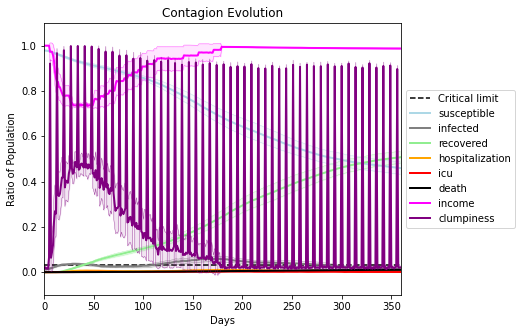

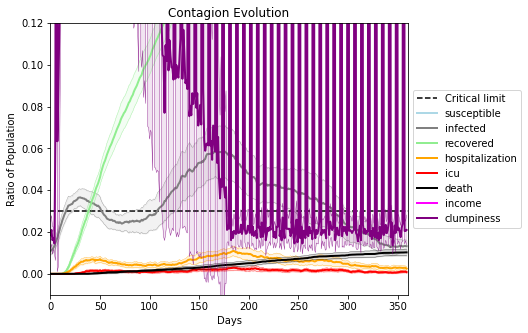

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7008, 5000, 4102, 2134, 7966, 2421, 318, 1242, 7054, 4387, 2969, 2676, 3525, 9709, 7609, 162, 6662, 6102, 8106, 4642]
Average similarity between family members is 0.15926854822391517 at temperature -0.2
Average similarity between family and home is 0.9998572985473405 at temperature -1
Average similarity between students and their classroom is 0.15631627744699855 at temperature -0.2
Average classroom occupancy is 3.9285714285714284 and number classrooms is 70
Average similarity between workers is 0.17220880170602662 at temperature -0.2
Average office occupancy is 3.303921568627451 and number offices is 204
Average friend similarity for adults: 0.20855559666358298 for kids: 0.19885038065846547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.10853080527119459
avg restaurant similarity 0.08838301304924819
avg restaurant similarity 0.07721895057964413
avg restaurant similarity 0.07808293850646361
avg restaurant similarity 0.09343692542941505
avg restaurant similarity 0.023772160783486884
avg restaurant similarity 0.06260108363588777
avg restaurant similarity 0.07012694125471129
avg restaurant similarity 0.05809372775223952
avg restaurant similarity 0.1124833531423639
avg restaurant similarity 0.08949966172617277
avg restaurant similarity 0.07047906676966219
avg restaurant similarity 0.13518926599717895
avg restaurant similarity 0.13163182802244022
avg restaurant similarity 0.07874393353074038
avg restaurant similarity 0.07330061938095266
avg restaurant similarity 0.035752857439015566
avg restaurant similarity 0.07125517045034815
avg restaurant similarity 0.10547146802424667
avg restaurant similarity 0.10956257624869951
avg restaurant similarity 0.06949868952554811
avg restaurant similarity 0.05072

avg restaurant similarity 0.10096603408788267
avg restaurant similarity 0.07019969865581145
avg restaurant similarity 0.10093645242155652
avg restaurant similarity 0.06967605906104231
avg restaurant similarity 0.10325588680191412
avg restaurant similarity 0.12305242903658932
avg restaurant similarity 0.12105483028648822
avg restaurant similarity 0.10305374847278112
avg restaurant similarity 0.03649216766803407
avg restaurant similarity 0.04636897432038267
avg restaurant similarity 0.05239349699017801
avg restaurant similarity 0.10175136931853787
avg restaurant similarity 0.05024344854558359
avg restaurant similarity 0.12895122607747725
avg restaurant similarity 0.07475188708985663
avg restaurant similarity 0.08779700569550089
avg restaurant similarity 0.1340888289745653
avg restaurant similarity 0.07059457930280899
avg restaurant similarity 0.08163927135722368
avg restaurant similarity 0.06240874244747947
avg restaurant similarity 0.12964234847864894
avg restaurant similarity 0.0795318

avg restaurant similarity 0.061373567999277186
avg restaurant similarity 0.055073120582213454
avg restaurant similarity 0.0985301077880322
avg restaurant similarity 0.0688630920699977
avg restaurant similarity 0.07129506130789658
avg restaurant similarity 0.014288405082421924
avg restaurant similarity 0.01256894258642814
avg restaurant similarity 0.024871244192198206
avg restaurant similarity 0.019748914323133016
avg restaurant similarity 0.09726490929357573
avg restaurant similarity 0.03884670289792948
avg restaurant similarity 0.03798566046169805
avg restaurant similarity 0.03638849298144568
avg restaurant similarity 0.061748650251134365
avg restaurant similarity 0.0591244838783788
avg restaurant similarity 0.04575704759500184
avg restaurant similarity 0.018165699621416533
avg restaurant similarity -0.013969631268758961
avg restaurant similarity 0.07852632998991105
avg restaurant similarity 0.04433357949957465
avg restaurant similarity 0.05395719946412533
avg restaurant similarity 0.

avg restaurant similarity 0.06456721187379952
avg restaurant similarity 0.02023633800611478
avg restaurant similarity 0.08953858732606206
avg restaurant similarity 0.0815054988083967
avg restaurant similarity 0.02958352676260874
avg restaurant similarity 0.05258318217801973
avg restaurant similarity 0.01891242838361573
avg restaurant similarity 0.03224412158989128
avg restaurant similarity 0.034560378689507454
avg restaurant similarity 0.05728616443872369
avg restaurant similarity 0.027475975810422732
avg restaurant similarity 0.03367920641681351
avg restaurant similarity 0.05900974570852039
avg restaurant similarity 0.03250651466589932
avg restaurant similarity 0.013773240484143731
avg restaurant similarity 0.0431060127270353
avg restaurant similarity 0.0795952428014363
avg restaurant similarity 0.022340214525321936
avg restaurant similarity 0.0741665072209307
avg restaurant similarity 0.04622310195311734
avg restaurant similarity -0.0021395620895553347
avg restaurant similarity 0.065

avg restaurant similarity 0.03862796524029403
avg restaurant similarity 0.04016083039646182
avg restaurant similarity 0.042305519632314804
avg restaurant similarity 0.0009891518219351395
avg restaurant similarity 0.03488352508398278
avg restaurant similarity 0.0203558042265992
avg restaurant similarity 0.008741844430843684
avg restaurant similarity 0.04583833046991404
avg restaurant similarity 0.023091961000424942
avg restaurant similarity 0.050881163108555234
avg restaurant similarity 0.05994604675692714
avg restaurant similarity 0.03722391114431914
avg restaurant similarity 0.038252891357715625
avg restaurant similarity 0.040492156094072085
avg restaurant similarity 0.06959497067434388
avg restaurant similarity 0.046313211358021744
avg restaurant similarity -0.00024709516451463175
avg restaurant similarity 0.04883341322260671
avg restaurant similarity 0.047872520836543864
avg restaurant similarity 0.03289169499835314
avg restaurant similarity 0.00010380907387230382
avg restaurant sim

avg restaurant similarity 0.06883656342222855
avg restaurant similarity 0.03714300731890166
avg restaurant similarity 0.06852755649904646
avg restaurant similarity 0.0421081861889361
avg restaurant similarity 0.03586934680422925
avg restaurant similarity 0.01669848641197136
avg restaurant similarity 0.0190292625740299
avg restaurant similarity 0.027304213587323392
avg restaurant similarity 0.039306494119379365
avg restaurant similarity 0.06874769470884438
avg restaurant similarity 0.022795783810277796
avg restaurant similarity 0.016039719055187543
avg restaurant similarity 0.010305229406531934
avg restaurant similarity 0.012565489032325428
avg restaurant similarity 0.012837032884845707
avg restaurant similarity 0.03041042991343986
avg restaurant similarity 0.04576798985704565
avg restaurant similarity 0.02713308108688613
avg restaurant similarity 0.06024362549073064
avg restaurant similarity 0.04199580300165461
avg restaurant similarity 0.016491974937346394
avg restaurant similarity 0.

avg restaurant similarity 0.08210718901304781
avg restaurant similarity 0.042139011513592596
avg restaurant similarity -0.006066848925293565
avg restaurant similarity 0.0696999017512684
avg restaurant similarity 0.00640344885587316
avg restaurant similarity 0.041651350715552274
avg restaurant similarity 0.030504626307557833
avg restaurant similarity 0.060366331575826895
avg restaurant similarity 0.05139201027692861
avg restaurant similarity 0.08614505022628283
avg restaurant similarity 0.07661998898939547
avg restaurant similarity 0.009307000437204421
avg restaurant similarity 0.036173115067613074
avg restaurant similarity 0.07268283621640238
avg restaurant similarity 0.014863108014193467
avg restaurant similarity 0.062134168739045904
avg restaurant similarity 0.020100620997763923
avg restaurant similarity 0.1098605561684417
avg restaurant similarity 0.08129216238003882
avg restaurant similarity 0.0841213656419173
avg restaurant similarity 0.03584508077384337
avg restaurant similarity 

avg restaurant similarity 0.031043954900185175
avg restaurant similarity 0.04326487091448812
avg restaurant similarity 0.009282795456971488
avg restaurant similarity 0.023257773979983885
avg restaurant similarity 0.07701444286479271
avg restaurant similarity 0.03165483615769513
avg restaurant similarity 0.05778489102519577
avg restaurant similarity 0.02596087917017867
avg restaurant similarity 0.05390770564883976
avg restaurant similarity 0.05406475594251508
avg restaurant similarity 0.07145393835416568
avg restaurant similarity 0.07430367361569486
avg restaurant similarity 0.04451476926463549
avg restaurant similarity 0.06087491036273573
avg restaurant similarity 0.03817767202045708
avg restaurant similarity 0.10002217772082432
avg restaurant similarity 0.024742092179859978
avg restaurant similarity 0.05769525793354545
avg restaurant similarity 0.13402196032652341
avg restaurant similarity 0.08295293489769415
avg restaurant similarity 0.10173140845317533
avg restaurant similarity 0.04

avg restaurant similarity 0.12155851068618419
avg restaurant similarity 0.04737682367233293
avg restaurant similarity 0.04603840697196181
avg restaurant similarity 0.05215283274934925
avg restaurant similarity 0.044994216183035486
avg restaurant similarity 0.04465862989708268
avg restaurant similarity 0.08562901057002999
avg restaurant similarity 0.06467306141610145
avg restaurant similarity 0.09250466562765579
avg restaurant similarity 0.07751138128884723
avg restaurant similarity 0.00578510825864467
avg restaurant similarity 0.054500786567340274
avg restaurant similarity 0.003939823627711157
avg restaurant similarity 0.07034603515377162
avg restaurant similarity 0.07833094860834945
avg restaurant similarity 0.027041610251185694
avg restaurant similarity 0.007432735991298287
avg restaurant similarity 0.08578793915181265
avg restaurant similarity 0.08856343456218373
avg restaurant similarity 0.06497870290418245
avg restaurant similarity 0.07989937751640866
avg restaurant similarity 0.0

avg restaurant similarity 0.06205209425356384
avg restaurant similarity 0.02410682745452397
avg restaurant similarity 0.062394414133965806
avg restaurant similarity 0.06963339682115156
avg restaurant similarity 0.05786180951783329
avg restaurant similarity 0.07029100814365229
avg restaurant similarity 0.10166351122034069
avg restaurant similarity 0.09456583202835359
avg restaurant similarity 0.06834592198633124
avg restaurant similarity 0.037272601357285794
avg restaurant similarity 0.06285306560345824
avg restaurant similarity 0.1026633502471181
avg restaurant similarity 0.041531608617838806
avg restaurant similarity 0.03450779748482858
avg restaurant similarity 0.06326251354482335
avg restaurant similarity 0.06827783173748798
avg restaurant similarity 0.09695616265730374
avg restaurant similarity 0.0852832272075466
avg restaurant similarity 0.043915365971479395
avg restaurant similarity 0.0746042028944036
avg restaurant similarity 0.037878357156339526
avg restaurant similarity 0.0785

avg restaurant similarity 0.09677851131385826
avg restaurant similarity 0.04540385073288702
avg restaurant similarity 0.025915024137893004
avg restaurant similarity 0.034096255747102705
avg restaurant similarity 0.028007958403889265
avg restaurant similarity 0.059086726119068705
avg restaurant similarity 0.018230068071414723
avg restaurant similarity 0.021618361898198348
avg restaurant similarity 0.002354098388993777
avg restaurant similarity 0.013923846818955192
avg restaurant similarity 0.029777698458933854
avg restaurant similarity 0.022133436483418947
avg restaurant similarity 0.037094224916335725
avg restaurant similarity 0.0492108278918451
avg restaurant similarity 0.016104577605988154
avg restaurant similarity 0.09395022711134063
avg restaurant similarity 0.039686724736164886
avg restaurant similarity 0.14780260496157183
avg restaurant similarity 0.0840809208333615
avg restaurant similarity 0.06954077680775789
avg restaurant similarity 0.028367666732706447
avg restaurant similar

avg restaurant similarity 0.015214728722239973
avg restaurant similarity 0.025396573448399098
avg restaurant similarity 0.029408130974437598
avg restaurant similarity 0.006411220601838788
avg restaurant similarity 0.1097276663589333
avg restaurant similarity 0.027188932912974164
avg restaurant similarity 0.02397110299028128
avg restaurant similarity 0.03860013480238679
avg restaurant similarity 0.03760894294173495
avg restaurant similarity 0.0310360429682793
avg restaurant similarity 0.016687178239187816
avg restaurant similarity 0.03560111641788457
avg restaurant similarity 0.05887254434830031
avg restaurant similarity 0.013867639683310765
avg restaurant similarity 0.05979368544446086
avg restaurant similarity 0.05986853252706821
avg restaurant similarity 0.0465088137173338
avg restaurant similarity 0.040042866371515544
avg restaurant similarity 0.02183435191976871
avg restaurant similarity 0.019842011716892528
avg restaurant similarity 0.058949173877572696
avg restaurant similarity 0

avg restaurant similarity 0.12246538489586824
avg restaurant similarity 0.043100517593652944
avg restaurant similarity 0.006112223778642814
avg restaurant similarity 0.0525334801643937
avg restaurant similarity 0.08158078942666201
avg restaurant similarity 0.09970281599916829
avg restaurant similarity -0.01159296186926702
avg restaurant similarity 0.06560745410716759
avg restaurant similarity 0.04385610053360841
avg restaurant similarity 0.01761235904232374
avg restaurant similarity 0.06210315851353416
avg restaurant similarity 0.057600785435803895
avg restaurant similarity -0.007228305471123372
avg restaurant similarity 0.0779992729332982
avg restaurant similarity 0.004474156743465598
avg restaurant similarity 0.12435608124173858
avg restaurant similarity 0.048178064673771524
avg restaurant similarity 0.034250756102080095
avg restaurant similarity 0.029166743581869634
avg restaurant similarity 0.03883512423940368
avg restaurant similarity 0.10475751134977442
avg restaurant similarity 

avg restaurant similarity 0.05655422656064163
avg restaurant similarity 0.08156226240349398
avg restaurant similarity -0.01655946120937003
avg restaurant similarity 0.015632958175298837
avg restaurant similarity 0.01789838000926836
avg restaurant similarity 0.029844253255078154
avg restaurant similarity 0.004964109525141665
avg restaurant similarity 0.0644491431546076
avg restaurant similarity 0.04922180241499045
avg restaurant similarity 0.058301551117106644
avg restaurant similarity 0.01541498494121258
avg restaurant similarity -0.013462799358228198
avg restaurant similarity 0.06002053927731765
avg restaurant similarity 0.06454631190247632
avg restaurant similarity 0.09986870262639641
avg restaurant similarity 0.10581301516792192
avg restaurant similarity 0.04960684248013397
avg restaurant similarity 0.03143443453991673
avg restaurant similarity 0.01662341623148774
avg restaurant similarity 0.06467666976918268
avg restaurant similarity 0.07931205284022563
avg restaurant similarity 0.

avg restaurant similarity 0.08077345378026154
avg restaurant similarity 0.0442473355985241
avg restaurant similarity 0.12558036600816994
avg restaurant similarity 0.062194623239507654
avg restaurant similarity 0.07304443450958642
avg restaurant similarity 0.04676954290082268
avg restaurant similarity 0.08556821756694374
avg restaurant similarity 0.03779028639153725
avg restaurant similarity 0.10811980541323782
avg restaurant similarity 0.0801715985210492
avg restaurant similarity 0.07035138746733623
avg restaurant similarity 0.11989218610297185
avg restaurant similarity 0.0930863621033416
avg restaurant similarity 0.11310951858199357
avg restaurant similarity 0.06514546713285625
avg restaurant similarity 0.04872733196210742
avg restaurant similarity 0.0758206232866278
avg restaurant similarity 0.004392052558787484
avg restaurant similarity 0.046838081101976126
avg restaurant similarity 0.11280831241576883
avg restaurant similarity 0.08916001981910177
avg restaurant similarity 0.0795454

avg restaurant similarity 0.0800476004382516
avg restaurant similarity 0.0991024741333194
avg restaurant similarity 0.06505611574359456
avg restaurant similarity 0.03491063449666976
avg restaurant similarity 0.04195363277686612
avg restaurant similarity 0.146736590313764
avg restaurant similarity -0.018352859881628086
avg restaurant similarity 0.04779008864894495
avg restaurant similarity 0.014498421724487395
avg restaurant similarity 0.07919052056924983
avg restaurant similarity 0.09720388759619748
avg restaurant similarity 0.08287035231021501
avg restaurant similarity 0.07972943352972602
avg restaurant similarity 0.08002994342224927
avg restaurant similarity 0.10992586499470695
avg restaurant similarity 0.05802426610780508
avg restaurant similarity 0.07314397835339966
avg restaurant similarity 0.06687994865478157
avg restaurant similarity 0.0759181922652381
avg restaurant similarity 0.06445657416033652
avg restaurant similarity 0.0747784213722483
avg restaurant similarity 0.048317261

avg restaurant similarity 0.029897443301694675
avg restaurant similarity 0.03951445204302086
avg restaurant similarity 0.08010917238065332
avg restaurant similarity 0.11160569945419428
avg restaurant similarity 0.0806108252957038
avg restaurant similarity 0.0715463864727667
avg restaurant similarity 0.06531281778877625
avg restaurant similarity 0.09795105751348473
avg restaurant similarity 0.06243887705466004
avg restaurant similarity 0.04103586832918663
avg restaurant similarity 0.0759447330151512
avg restaurant similarity 0.08556706305576832
avg restaurant similarity 0.04619994297265301
avg restaurant similarity 0.06418293480836645
avg restaurant similarity 0.0912413353821423
avg restaurant similarity 0.06818894693553476
avg restaurant similarity 0.060286094351691896
avg restaurant similarity 0.08756116888214409
avg restaurant similarity 0.06638777252599976
avg restaurant similarity 0.09135477174589904
avg restaurant similarity 0.07667206149982791
avg restaurant similarity 0.11473090

avg restaurant similarity 0.08836979386390272
avg restaurant similarity 0.026705482965600717
avg restaurant similarity 0.10478122864519648
avg restaurant similarity 0.04925366563389195
avg restaurant similarity 0.04864260194568277
avg restaurant similarity 0.08181779474259092
avg restaurant similarity 0.1131473523722458
avg restaurant similarity 0.025716806475535654
avg restaurant similarity 0.06525225185423483
avg restaurant similarity 0.070237104056645
avg restaurant similarity 0.008521297095427309
avg restaurant similarity 0.06354349804499729
avg restaurant similarity 0.046525856887510174
avg restaurant similarity 0.060464771393354357
avg restaurant similarity 0.09391872395164641
avg restaurant similarity 0.07490192477034639
avg restaurant similarity 0.03982496544945208
avg restaurant similarity 0.042935635580396855
avg restaurant similarity 0.06534404936852109
avg restaurant similarity 0.022184900300462652
avg restaurant similarity 0.0970247403481421
avg restaurant similarity 0.079

avg restaurant similarity -0.010888345763414414
avg restaurant similarity 0.03950159654102844
avg restaurant similarity 0.03840767021695188
avg restaurant similarity 0.013582434129556401
avg restaurant similarity 0.0008938531927326606
avg restaurant similarity 0.07521464827972482
avg restaurant similarity 0.028260198451128746
avg restaurant similarity 0.06821167689466753
avg restaurant similarity 0.07765989450209436
avg restaurant similarity 0.03278332919094023
avg restaurant similarity 0.05746935756228013
avg restaurant similarity 0.04328919724663248
avg restaurant similarity 0.02417087455786822
avg restaurant similarity 0.04255198276106055
avg restaurant similarity 0.04079419416901591
avg restaurant similarity 0.03214889002494898
avg restaurant similarity 0.020733725005018737
avg restaurant similarity 0.05252094309048471
avg restaurant similarity 0.03550129951491271
avg restaurant similarity 0.0883457722360107
avg restaurant similarity 0.04229467298141876
avg restaurant similarity 0.

avg restaurant similarity 0.09375450771133392
avg restaurant similarity 0.029943035710951627
avg restaurant similarity 0.011144526800586986
avg restaurant similarity 0.08827468395231437
avg restaurant similarity 0.07235796271843113
avg restaurant similarity 0.04476778632338739
avg restaurant similarity 0.09270507127719976
avg restaurant similarity 0.048327760131526655
avg restaurant similarity 0.09213936988930158
avg restaurant similarity 0.049386499192788584
avg restaurant similarity 0.04426601895668427
avg restaurant similarity 0.042036723770681066
avg restaurant similarity 0.04676794393334372
avg restaurant similarity 0.07042147084615405
avg restaurant similarity 0.03788819103864405
avg restaurant similarity 0.08578687556140331
avg restaurant similarity 0.05816778466442237
avg restaurant similarity 0.01801977785281881
avg restaurant similarity 0.05607243545489389
avg restaurant similarity 0.05213790414901632
avg restaurant similarity 0.08088116317109414
avg restaurant similarity 0.0

avg restaurant similarity 0.02453090959986279
avg restaurant similarity 0.09437386798621726
avg restaurant similarity 0.06784671792118513
avg restaurant similarity 0.015942077535201292
avg restaurant similarity 0.06740355551804547
avg restaurant similarity 0.07104143731783477
avg restaurant similarity 0.03377267216390581
avg restaurant similarity 0.09574396260969907
avg restaurant similarity 0.043492652608243844
avg restaurant similarity 0.09854618792963203
avg restaurant similarity 0.08284632725879251
avg restaurant similarity 0.04131736775764876
avg restaurant similarity 0.058544938995868365
avg restaurant similarity 0.044730853472593486
avg restaurant similarity 0.07943168636782115
avg restaurant similarity 0.08555402499646955
avg restaurant similarity 0.10989919233415006
avg restaurant similarity 0.035321783524533905
avg restaurant similarity 0.14883935062717804
avg restaurant similarity 0.043036080565220645
avg restaurant similarity 0.054888553076479996
avg restaurant similarity 0

avg restaurant similarity 0.09629295800923429
avg restaurant similarity 0.0573446739604529
avg restaurant similarity 0.09765994938198688
avg restaurant similarity 0.1271231435763772
avg restaurant similarity 0.01865980553066012
avg restaurant similarity 0.044719496494722
avg restaurant similarity 0.04356207149414517
avg restaurant similarity 0.08317375858022398
avg restaurant similarity 0.09463940079992104
avg restaurant similarity 0.05550380809072911
avg restaurant similarity 0.024198590249932043
avg restaurant similarity 0.056762716941129686
avg restaurant similarity 0.04992231496255249
avg restaurant similarity 0.1073803111314731
avg restaurant similarity 0.08613241269156394
avg restaurant similarity 0.01769740472425708
avg restaurant similarity 0.07897900564240516
avg restaurant similarity 0.07800053283950743
avg restaurant similarity 0.06294983277765942
avg restaurant similarity 0.06010593791173129
avg restaurant similarity 0.03780330752701952
avg restaurant similarity 0.114141972

avg restaurant similarity 0.07559894554482122
avg restaurant similarity 0.03709013717580107
avg restaurant similarity 0.042596868043299
avg restaurant similarity 0.05938871345775885
avg restaurant similarity 0.08949981519413741
avg restaurant similarity 0.07180703394953529
avg restaurant similarity 0.041208260440100244
avg restaurant similarity 0.04486307252145254
avg restaurant similarity 0.0893208577911816
avg restaurant similarity 0.07145092758664333
avg restaurant similarity 0.1083459335616596
avg restaurant similarity 0.0760380994755362
avg restaurant similarity 0.05679058567325699
avg restaurant similarity 0.056805343671808686
avg restaurant similarity 0.05588648039468065
avg restaurant similarity 0.06232837544467199
avg restaurant similarity 0.06835516637183642
avg restaurant similarity 0.05960408687721566
avg restaurant similarity 0.07040669781688702
avg restaurant similarity 0.09999878566192498
avg restaurant similarity 0.005765725042189298
avg restaurant similarity 0.09889129

avg restaurant similarity 0.09983668530209601
avg restaurant similarity 0.08522093208967897
avg restaurant similarity 0.079676034051277
avg restaurant similarity 0.07692696374469091
avg restaurant similarity 0.04580424559534913
avg restaurant similarity 0.10899676507690041
avg restaurant similarity 0.052128684864032604
avg restaurant similarity 0.11824637229439464
avg restaurant similarity 0.0367125601627693
avg restaurant similarity 0.041449097697143576
avg restaurant similarity 0.039234259661457035
avg restaurant similarity 0.027327306789758293
avg restaurant similarity 0.033843681544624755
avg restaurant similarity 0.06404931975748981
avg restaurant similarity 0.017257616415504246
avg restaurant similarity 0.030242997390444323
avg restaurant similarity 0.05075077730802381
avg restaurant similarity 0.014607951894725168
avg restaurant similarity 0.07075957700142359
avg restaurant similarity 0.05776070223256388
avg restaurant similarity 0.03786120188294959
avg restaurant similarity 0.0

avg restaurant similarity 0.0308029055969227
avg restaurant similarity 0.028696374526174115
avg restaurant similarity 0.07880886415496158
avg restaurant similarity 0.08010956858823252
avg restaurant similarity 0.05834789439566323
avg restaurant similarity 0.015890256945102075
avg restaurant similarity 0.08139385785766427
avg restaurant similarity 0.013696503472370785
avg restaurant similarity 0.037387219694121454
avg restaurant similarity 0.039245619264696906
avg restaurant similarity 0.04530759193424963
avg restaurant similarity 0.04788920016584628
avg restaurant similarity 0.0808807481302941
avg restaurant similarity 0.07615077782115239
avg restaurant similarity 0.05364207814797677
avg restaurant similarity 0.04104274053710398
avg restaurant similarity 0.040806388585941454
avg restaurant similarity 0.0055675240103035305
avg restaurant similarity 0.021501664881463812
avg restaurant similarity -0.001319532368994797
avg restaurant similarity 0.014951388124823772
avg restaurant similarit

avg restaurant similarity 0.014022304253273965
avg restaurant similarity 0.0564802706770496
avg restaurant similarity 0.05459849507435697
avg restaurant similarity 0.0709924652572032
avg restaurant similarity 0.07063924888573471
avg restaurant similarity 0.03689725993288134
avg restaurant similarity 0.06360063831754117
avg restaurant similarity 0.09156462767115736
avg restaurant similarity 0.05218031339441855
avg restaurant similarity 0.045394613880216886
avg restaurant similarity 0.06839365336519555
avg restaurant similarity 0.02525712231052821
avg restaurant similarity 0.11893730122794673
avg restaurant similarity 0.06073333391042567
avg restaurant similarity 0.03028419297170871
avg restaurant similarity 0.04190585131144067
avg restaurant similarity 0.04372408488149721
avg restaurant similarity 0.0405912732147983
avg restaurant similarity 0.04100734829893712
avg restaurant similarity 0.028303015620558085
avg restaurant similarity 0.0023298221733369256
avg restaurant similarity 0.0410

avg restaurant similarity 0.05896250058889765
avg restaurant similarity 0.08280419036154278
avg restaurant similarity 0.09005461530278415
avg restaurant similarity 0.04972659432915764
avg restaurant similarity 0.03858919659197661
avg restaurant similarity 0.09520369071836467
avg restaurant similarity 0.059041123313284344
avg restaurant similarity 0.06307436280229871
avg restaurant similarity 0.06516676088278152
avg restaurant similarity 0.08738567781004752
avg restaurant similarity 0.04509997544079687
avg restaurant similarity 0.05521369626268109
avg restaurant similarity 0.050153425643413144
avg restaurant similarity 0.06674406482278908
avg restaurant similarity 0.04965843660344643
avg restaurant similarity 0.071740102324996
avg restaurant similarity 0.05649486873938225
avg restaurant similarity 0.12639923794385516
avg restaurant similarity 0.034919787745947686
avg restaurant similarity 0.10287080321945981
avg restaurant similarity 0.03575510419924789
avg restaurant similarity 0.05561

avg restaurant similarity 0.05374102148011219
avg restaurant similarity 0.08252342434138774
avg restaurant similarity 0.06614012149705832
avg restaurant similarity 0.032797951372139374
avg restaurant similarity 0.07344656382269846
avg restaurant similarity 0.007816639243433076
avg restaurant similarity 0.0532164754091049
avg restaurant similarity 0.08398698916191102
avg restaurant similarity 0.11143730452783518
avg restaurant similarity 0.07546880891955404
avg restaurant similarity 0.07516535790788458
avg restaurant similarity 0.07648966429769699
avg restaurant similarity 0.0906723033341578
avg restaurant similarity 0.10305362210068772
avg restaurant similarity 0.0075939814990504985
avg restaurant similarity 0.034884168336590526
avg restaurant similarity 0.0845864504215028
avg restaurant similarity 0.057547724934335465
avg restaurant similarity 0.12041640216552175
avg restaurant similarity 0.09348265289130235
avg restaurant similarity 0.0714883012172945
avg restaurant similarity 0.0437

avg restaurant similarity 0.0676720574241047
avg restaurant similarity 0.0705364833452577
avg restaurant similarity 0.06242188708408411
avg restaurant similarity 0.09165569106685348
avg restaurant similarity 0.042216047010337356
avg restaurant similarity 0.07237845060447544
avg restaurant similarity 0.11063880111921265
avg restaurant similarity 0.08330366889534901
avg restaurant similarity 0.07850353141219057
avg restaurant similarity 0.044088100557567615
avg restaurant similarity 0.06854611488663911
avg restaurant similarity 0.05092610081896227
avg restaurant similarity 0.06463903461537715
avg restaurant similarity 0.06398954230136362
avg restaurant similarity 0.06254556932935222
avg restaurant similarity 0.08412564902976666
avg restaurant similarity 0.04190282362628335
avg restaurant similarity 0.03565947999342248
avg restaurant similarity 0.06467006958446526
avg restaurant similarity 0.046361412788997206
avg restaurant similarity 0.049150516214318755
avg restaurant similarity 0.0681

avg restaurant similarity 0.06540739595181763
avg restaurant similarity 0.09365327835173876
avg restaurant similarity 0.010062852811567897
avg restaurant similarity 0.0494225439079333
avg restaurant similarity 0.05550497403973493
avg restaurant similarity 0.035018757212290905
avg restaurant similarity 0.08313790860353285
avg restaurant similarity 0.07040680628452278
avg restaurant similarity 0.07817512206011273
avg restaurant similarity 0.053266509823676214
avg restaurant similarity 0.0651579644374589
avg restaurant similarity 0.0662691944954203
avg restaurant similarity 0.01981772544677651
avg restaurant similarity 0.08694291226836848
avg restaurant similarity 0.008792331325487785
avg restaurant similarity 0.06236209804317561
avg restaurant similarity 0.09158752628444944
avg restaurant similarity 0.09158493133229614
avg restaurant similarity 0.059912044034412616
avg restaurant similarity 0.06755560781342387
avg restaurant similarity 0.05045928608837201
avg restaurant similarity 0.0533

avg restaurant similarity 0.07297566165264387
avg restaurant similarity 0.03336257630993433
avg restaurant similarity 0.050199997441926554
avg restaurant similarity 0.05769483093472848
avg restaurant similarity 0.08770555818569495
avg restaurant similarity 0.07073501167492718
avg restaurant similarity 0.055055120686458306
avg restaurant similarity 0.07020364888795327
avg restaurant similarity 0.06194264571815561
avg restaurant similarity 0.05697841385302094
avg restaurant similarity 0.0023580007471626775
avg restaurant similarity 0.05284530180431318
avg restaurant similarity 0.09459087772768247
avg restaurant similarity 0.0544986672612582
avg restaurant similarity 0.07811534599861238
avg restaurant similarity 0.07965064850277166
avg restaurant similarity 0.08460710122594045
avg restaurant similarity 0.06286328801808834
avg restaurant similarity 0.06875093123032834
avg restaurant similarity 0.03577551944862307
avg restaurant similarity 0.050906153505629076
avg restaurant similarity 0.11

avg restaurant similarity 0.08847974431108777
avg restaurant similarity 0.08296350661937989
avg restaurant similarity 0.06809776701985272
avg restaurant similarity 0.04931833682864308
avg restaurant similarity 0.028030354184637785
avg restaurant similarity 0.07300597866244203
avg restaurant similarity 0.06881003504321857
avg restaurant similarity 0.06504216618383488
avg restaurant similarity 0.06892999881814975
avg restaurant similarity 0.08357848097142188
avg restaurant similarity 0.0178805265436355
avg restaurant similarity 0.03480604366340848
avg restaurant similarity 0.0650991221064585
avg restaurant similarity 0.03413551911826367
avg restaurant similarity 0.05995868962263108
avg restaurant similarity 0.058512103058968395
avg restaurant similarity 0.08134220242022609
avg restaurant similarity 0.050473646663399103
avg restaurant similarity 0.06779437806568084
avg restaurant similarity 0.047779757617589125
avg restaurant similarity 0.07730748557445866
avg restaurant similarity 0.0574

avg restaurant similarity 0.06297755930005243
avg restaurant similarity 0.04217231264810673
avg restaurant similarity 0.054227163853119376
avg restaurant similarity 0.043914868911674086
avg restaurant similarity 0.05491968052576296
avg restaurant similarity -0.011299715443150043
avg restaurant similarity 0.002956947043861411
avg restaurant similarity 0.039463244247353986
avg restaurant similarity 0.053403950245378556
avg restaurant similarity 0.05634039053372787
avg restaurant similarity 0.03402361703253838
avg restaurant similarity 0.06265090850229836
avg restaurant similarity 0.04087039895497249
avg restaurant similarity 0.005978918935761581
avg restaurant similarity 0.06095283201315558
avg restaurant similarity 0.06436453435700179
avg restaurant similarity 0.05657284857048074
avg restaurant similarity 0.07699785291692321
avg restaurant similarity 0.042365741989704594
avg restaurant similarity 0.045887737433141514
avg restaurant similarity 0.0032504190888016675
avg restaurant similar

avg restaurant similarity 0.005360624728687725
avg restaurant similarity 0.03390121191333719
avg restaurant similarity 0.07783277862841644
avg restaurant similarity 0.0742362497168123
avg restaurant similarity 0.04373894997105947
avg restaurant similarity 0.036207211018748596
avg restaurant similarity 0.05643576055650642
avg restaurant similarity 0.018797582826888544
avg restaurant similarity 0.03747658086196054
avg restaurant similarity 0.05816985249928285
avg restaurant similarity 3.0093960414495906e-05
avg restaurant similarity 0.004165341666713733
avg restaurant similarity 0.03964868873006901
avg restaurant similarity -0.008000328026879439
avg restaurant similarity 0.009792238682909547
avg restaurant similarity 0.05936755372943959
avg restaurant similarity 0.07996388677209512
avg restaurant similarity 0.04621420015571913
avg restaurant similarity 0.06502856952374796
avg restaurant similarity 0.0015682847962472334
avg restaurant similarity -0.022957108827416542
avg restaurant simila

avg restaurant similarity 0.10671635586883058
avg restaurant similarity 0.05871626254065999
avg restaurant similarity 0.02618721498290761
avg restaurant similarity 0.06251427210601326
avg restaurant similarity 0.052087271811817534
avg restaurant similarity 0.04507809398902436
avg restaurant similarity 0.006308992566822052
avg restaurant similarity 0.027999387454151228
avg restaurant similarity 0.045154299514893664
avg restaurant similarity 0.05583283449296
avg restaurant similarity 0.06705301269983793
avg restaurant similarity 0.09103587315038227
avg restaurant similarity 0.06930382394525529
avg restaurant similarity 0.10875270862491565
avg restaurant similarity 0.07593069987213326
avg restaurant similarity 0.05627416075071099
avg restaurant similarity 0.014949204949139856
avg restaurant similarity 0.07691014103473637
avg restaurant similarity 0.061536145594835404
avg restaurant similarity 0.09759987819402025
avg restaurant similarity 0.05103030169033121
avg restaurant similarity 0.020

avg restaurant similarity 0.05068781151342952
avg restaurant similarity 0.04938107397600783
avg restaurant similarity 0.07420809399148423
avg restaurant similarity 0.06287655644706075
avg restaurant similarity 0.039334706952532085
avg restaurant similarity 0.10127415633557402
avg restaurant similarity 0.02775852444269148
avg restaurant similarity 0.0731437840065805
avg restaurant similarity -0.007853488754217736
avg restaurant similarity 0.0164768895119024
avg restaurant similarity 0.0723614580752892
avg restaurant similarity 0.07317482376260281
avg restaurant similarity 0.0943865749282258
avg restaurant similarity 0.04678431450411161
avg restaurant similarity 0.06735008110854243
avg restaurant similarity 0.02165320908840469
avg restaurant similarity 0.07503776058804584
avg restaurant similarity 0.04301401186625802
avg restaurant similarity 0.05567748124533251
avg restaurant similarity 0.07932259790945216
avg restaurant similarity 0.03197963972951285
avg restaurant similarity 0.0587855

avg restaurant similarity 0.03780624216128198
avg restaurant similarity 0.04553152121978607
avg restaurant similarity 0.10339583462300539
avg restaurant similarity 0.0755073613855168
avg restaurant similarity 0.05366685558426397
avg restaurant similarity 0.028138816171393206
avg restaurant similarity 0.056592774277596375
avg restaurant similarity 0.12190579838851162
avg restaurant similarity 0.08337068467310053
avg restaurant similarity 0.0447712163200263
avg restaurant similarity 0.08619727478647596
avg restaurant similarity 0.09624777056913394
avg restaurant similarity 0.11632259984613544
avg restaurant similarity 0.10374994944179444
avg restaurant similarity 0.058178733786049104
avg restaurant similarity 0.024699707765752192
avg restaurant similarity 0.02698925836708743
avg restaurant similarity 0.1078433367305794
avg restaurant similarity 0.11389785088740252
avg restaurant similarity 0.09158279148402508
avg restaurant similarity 0.06818209695101705
avg restaurant similarity 0.08641

avg restaurant similarity 0.10532556171067796
avg restaurant similarity 0.030803425026524462
avg restaurant similarity 0.08786210412252886
avg restaurant similarity 0.04626555706245874
avg restaurant similarity 0.060488950431878435
avg restaurant similarity 0.13533908196945166
avg restaurant similarity 0.09158215538186512
avg restaurant similarity 0.05429344236541124
avg restaurant similarity 0.06902628769857574
avg restaurant similarity 0.06585807512765955
avg restaurant similarity 0.014969233542783617
avg restaurant similarity 0.09121703065522078
avg restaurant similarity 0.07728865913251554
avg restaurant similarity 0.03395905551494242
avg restaurant similarity 0.0436311865595913
avg restaurant similarity 0.06274922972396217
avg restaurant similarity 0.08610757104613355
avg restaurant similarity 0.11660743902223417
avg restaurant similarity 0.07518348567145425
avg restaurant similarity 0.08943016208164507
avg restaurant similarity -0.014248603619206626
avg restaurant similarity 0.07

avg restaurant similarity 0.02029317462842651
avg restaurant similarity 0.023243933501448086
avg restaurant similarity 0.0591416548336293
avg restaurant similarity 0.014674195603898202
avg restaurant similarity 0.08868682325904566
avg restaurant similarity 0.05638526234091197
avg restaurant similarity 0.09102579718661458
avg restaurant similarity 0.05866665891870001
avg restaurant similarity 0.07362507918767885
avg restaurant similarity 0.06982485430132863
avg restaurant similarity 0.07211899551247772
avg restaurant similarity 0.06868466511993906
avg restaurant similarity 0.097104157105643
avg restaurant similarity 0.08064876053792777
avg restaurant similarity 0.086086067881527
avg restaurant similarity 0.08858960574395472
avg restaurant similarity 0.07044584354344828
avg restaurant similarity 0.07327878989252573
avg restaurant similarity 0.05904147110421358
avg restaurant similarity 0.08058578182222877
avg restaurant similarity 0.03915608263978845
avg restaurant similarity 0.050259230

avg restaurant similarity 0.04726106394608253
avg restaurant similarity 0.06713914678365032
avg restaurant similarity 0.05222813979451472
avg restaurant similarity 0.0835535214051668
avg restaurant similarity 0.02586975760454722
avg restaurant similarity 0.05230869273289201
avg restaurant similarity 0.09230031020690543
avg restaurant similarity 0.07849903367618355
avg restaurant similarity 0.07491963159797065
avg restaurant similarity 0.11198927952910415
avg restaurant similarity 0.05081723498877021
avg restaurant similarity 0.06553078867169296
avg restaurant similarity 0.0793256326943008
avg restaurant similarity 0.08111917391095791
avg restaurant similarity 0.09359522734640947
avg restaurant similarity 0.11178802286344623
avg restaurant similarity 0.08793012638196121
avg restaurant similarity 0.11249272989650323
avg restaurant similarity 0.048161236871350134
avg restaurant similarity 0.052772758437637415
avg restaurant similarity 0.06344599604557451
avg restaurant similarity 0.064283

(<function dict.items>, <function dict.items>, <function dict.items>)

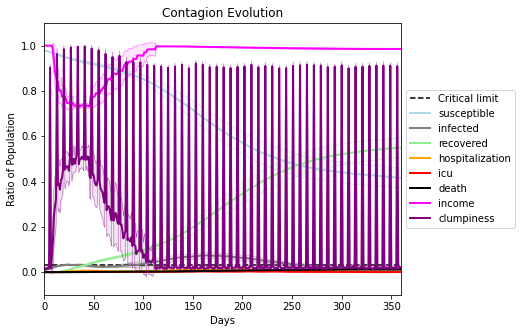

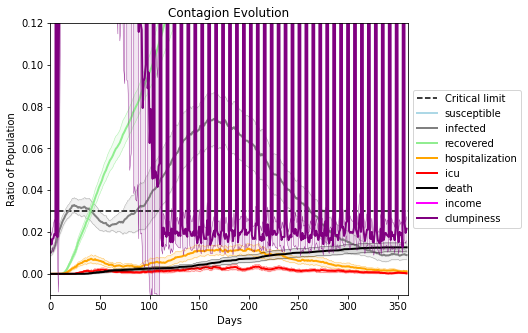

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2841, 1647, 5353, 2787, 1308, 1582, 7622, 8720, 5385, 234, 5448, 974, 1807, 1475, 4231, 8852, 2950, 9221, 6831, 4710]
Average similarity between family members is 0.16722880008979543 at temperature -0.1
Average similarity between family and home is 0.9998565455551763 at temperature -1
Average similarity between students and their classroom is 0.18692837865608394 at temperature -0.1
Average classroom occupancy is 4.214285714285714 and number classrooms is 70
Average similarity between workers is 0.16920647157884006 at temperature -0.1
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.21920721190021644 for kids: 0.21605556567650228
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.05677616562975283
avg restaurant similarity 0.075707331686234
avg restaurant similarity 0.07751493314900058
avg restaurant similarity 0.02761021184086038
avg restaurant similarity 0.03580993804282863
avg restaurant similarity 0.06343983470276043
avg restaurant similarity 0.0656869585988873
avg restaurant similarity 0.05825106246681634
avg restaurant similarity 0.09580321405146734
avg restaurant similarity 0.10006969525545681
avg restaurant similarity 0.07635806202865968
avg restaurant similarity 0.08721922552881409
avg restaurant similarity 0.04881932923729802
avg restaurant similarity 0.12385219988866272
avg restaurant similarity 0.09565498145423733
avg restaurant similarity 0.0917340438001408
avg restaurant similarity 0.10868355588737674
avg restaurant similarity 0.06836752743231869
avg restaurant similarity 0.039162578432743435
avg restaurant similarity 0.03729157670422244
avg restaurant similarity 0.0787524037975743
avg restaurant similarity 0.1352912884

avg restaurant similarity 0.0828349642957816
avg restaurant similarity 0.07739272044045081
avg restaurant similarity 0.09313541271090685
avg restaurant similarity 0.10931028869579988
avg restaurant similarity 0.06068784253728499
avg restaurant similarity 0.05684785435257606
avg restaurant similarity 0.08784661878204915
avg restaurant similarity 0.15353466994365672
avg restaurant similarity 0.09021345084049427
avg restaurant similarity 0.09445837191261301
avg restaurant similarity 0.06905687437363686
avg restaurant similarity 0.05569139286949609
avg restaurant similarity 0.05901327185129298
avg restaurant similarity 0.055476840708657854
avg restaurant similarity 0.0669625988796044
avg restaurant similarity 0.04936837088823459
avg restaurant similarity 0.07176738318339419
avg restaurant similarity 0.06784940301090465
avg restaurant similarity 0.04473323666315917
avg restaurant similarity 0.09146331470248374
avg restaurant similarity 0.02975544994362309
avg restaurant similarity 0.0237067

avg restaurant similarity 0.044483351002626306
avg restaurant similarity 0.0031326539964218474
avg restaurant similarity 0.04178440983730724
avg restaurant similarity 0.04894468063011206
avg restaurant similarity 0.05345607800582067
avg restaurant similarity 0.0984235722582081
avg restaurant similarity 0.053891036296852775
avg restaurant similarity 0.07305115182868964
avg restaurant similarity 0.02508942292285529
avg restaurant similarity 0.05523302744266546
avg restaurant similarity 0.08896319496832521
avg restaurant similarity 0.05792213525636034
avg restaurant similarity 0.05690390767315919
avg restaurant similarity 0.014955418336740793
avg restaurant similarity 0.053994812679501555
avg restaurant similarity 0.08965221057659903
avg restaurant similarity 0.03939198926881577
avg restaurant similarity 0.047532060264719005
avg restaurant similarity 0.07061680664368382
avg restaurant similarity 0.06130317023906455
avg restaurant similarity 0.03623256895608207
avg restaurant similarity 0.

avg restaurant similarity 0.05183447270244436
avg restaurant similarity 0.07637474628852726
avg restaurant similarity 0.04409797589871827
avg restaurant similarity 0.07896159811915585
avg restaurant similarity 0.04286680527741486
avg restaurant similarity 0.045867517521341765
avg restaurant similarity 0.0626473615856727
avg restaurant similarity 0.023786833913281923
avg restaurant similarity 0.033396279110012986
avg restaurant similarity 0.039896409234528016
avg restaurant similarity 0.06628096061219432
avg restaurant similarity 0.09038809331029259
avg restaurant similarity 0.026736987266628317
avg restaurant similarity -0.007224350381685996
avg restaurant similarity 0.06044023676879432
avg restaurant similarity 0.058350190437011375
avg restaurant similarity 0.04319000170012837
avg restaurant similarity 0.038037559672624253
avg restaurant similarity 0.021739206872718676
avg restaurant similarity 0.049606939513334766
avg restaurant similarity 0.04795196035784754
avg restaurant similarit

avg restaurant similarity 0.04847370690003099
avg restaurant similarity 0.04494224010425416
avg restaurant similarity 0.0415905359589884
avg restaurant similarity 0.10836172659630251
avg restaurant similarity 0.08051312515047626
avg restaurant similarity 0.07812494321522255
avg restaurant similarity 0.08762082035626823
avg restaurant similarity 0.05808159484313188
avg restaurant similarity 0.10446271745055498
avg restaurant similarity 0.0821408309021078
avg restaurant similarity 0.04781460937640641
avg restaurant similarity 0.006714250556598564
avg restaurant similarity 0.10373141771646381
avg restaurant similarity 0.02459293621106208
avg restaurant similarity 0.07790543086188356
avg restaurant similarity 0.05831020227662872
avg restaurant similarity 0.05714602258842444
avg restaurant similarity 0.08472516594745974
avg restaurant similarity 0.061388235485802044
avg restaurant similarity 0.0482373799378505
avg restaurant similarity 0.08566401380331552
avg restaurant similarity 0.1087781

avg restaurant similarity 0.0771949405251409
avg restaurant similarity 0.10014109864833252
avg restaurant similarity 0.052304191764797885
avg restaurant similarity 0.11126023378409575
avg restaurant similarity 0.14263198121125314
avg restaurant similarity 0.03743848784045936
avg restaurant similarity 0.06549669149527367
avg restaurant similarity 0.1273198476484887
avg restaurant similarity 0.10735029843948025
avg restaurant similarity 0.1356044443794251
avg restaurant similarity 0.07300287149443813
avg restaurant similarity 0.06950375943479249
avg restaurant similarity 0.09957362977424376
avg restaurant similarity 0.03667423961033661
avg restaurant similarity 0.13545082960982244
avg restaurant similarity 0.04518123355925467
avg restaurant similarity 0.06703898346374633
avg restaurant similarity 0.040622934611680234
avg restaurant similarity 0.055233263486683164
avg restaurant similarity 0.07184882073430506
avg restaurant similarity 0.14452331350195993
avg restaurant similarity 0.119158

avg restaurant similarity 0.05375670478967562
avg restaurant similarity 0.00639145659470329
avg restaurant similarity 0.037710975734682364
avg restaurant similarity 0.0822222693569569
avg restaurant similarity 0.03163621491046656
avg restaurant similarity 0.022500961548184397
avg restaurant similarity 0.06090595671100628
avg restaurant similarity 0.035665291823463965
avg restaurant similarity 0.03345579393465941
avg restaurant similarity 0.05090279502759134
avg restaurant similarity 0.02816492698588149
avg restaurant similarity 0.051798072100795164
avg restaurant similarity 0.02527260080643389
avg restaurant similarity 0.005366782797820774
avg restaurant similarity 0.0370828823964422
avg restaurant similarity 0.03173908280030883
avg restaurant similarity 0.009978314785104572
avg restaurant similarity 0.08889151590615199
avg restaurant similarity 0.06040278625742636
avg restaurant similarity 0.050282914231050246
avg restaurant similarity 0.06400554231934634
avg restaurant similarity 0.0

avg restaurant similarity 0.0685751483870359
avg restaurant similarity 0.027906153585357602
avg restaurant similarity 0.04246785075996909
avg restaurant similarity 0.04825714397143835
avg restaurant similarity 0.11814807973859132
avg restaurant similarity 0.04758130408703264
avg restaurant similarity 0.0856094243944068
avg restaurant similarity 0.07783766291330826
avg restaurant similarity 0.04180687971584075
avg restaurant similarity 0.050591753214772855
avg restaurant similarity 0.030792631080757405
avg restaurant similarity 0.0007810610722580239
avg restaurant similarity 0.024456900768314888
avg restaurant similarity 0.05379391417555521
avg restaurant similarity 0.016098279925302043
avg restaurant similarity 0.013491991945817036
avg restaurant similarity 0.036322172093574905
avg restaurant similarity 0.06264974859491051
avg restaurant similarity -0.00034457561860458055
avg restaurant similarity 0.08455221610575563
avg restaurant similarity 0.01708488423482
avg restaurant similarity 

avg restaurant similarity 0.045723360237770995
avg restaurant similarity 0.04909805763756311
avg restaurant similarity 0.05581795076800434
avg restaurant similarity 0.07902505553014355
avg restaurant similarity 0.07789609145405987
avg restaurant similarity 0.027040347293391945
avg restaurant similarity 0.06395985248194541
avg restaurant similarity 0.0504973528249262
avg restaurant similarity 0.09291879960705336
avg restaurant similarity 0.05567822624387397
avg restaurant similarity 0.09859696255825169
avg restaurant similarity 0.07721423178313305
avg restaurant similarity 0.05249255535107263
avg restaurant similarity 0.07038062423517677
avg restaurant similarity 0.04759147862607608
avg restaurant similarity 0.013449604689683385
avg restaurant similarity 0.09378606228223019
avg restaurant similarity 0.11780382048483291
avg restaurant similarity 0.04942503291780771
avg restaurant similarity 0.09530951355618505
avg restaurant similarity 0.09446566793324136
avg restaurant similarity 0.0798

avg restaurant similarity 0.09734421353591141
avg restaurant similarity 0.055060614387446916
avg restaurant similarity 0.06079386692956341
avg restaurant similarity 0.0821529036806771
avg restaurant similarity 0.09000715685639435
avg restaurant similarity 0.036233608994306665
avg restaurant similarity 0.04963629156189774
avg restaurant similarity 0.07118181845344924
avg restaurant similarity 0.13056029706588354
avg restaurant similarity 0.07143875750839583
avg restaurant similarity 0.11940763469310921
avg restaurant similarity 0.05479360796744726
avg restaurant similarity 0.06191009995783508
avg restaurant similarity 0.04067567688990198
avg restaurant similarity 0.055245895984504995
avg restaurant similarity 0.07824595813623246
avg restaurant similarity 0.057228281743816604
avg restaurant similarity 0.08567161054775001
avg restaurant similarity 0.09872240292723826
avg restaurant similarity 0.054986124165934264
avg restaurant similarity 0.05963422325047636
avg restaurant similarity 0.03

avg restaurant similarity 0.04353421516560958
avg restaurant similarity 0.07458479504614647
avg restaurant similarity 0.03937555473069441
avg restaurant similarity 0.09103609423951677
avg restaurant similarity 0.08283993782156036
avg restaurant similarity 0.07019766412580371
avg restaurant similarity 0.05099099083133782
avg restaurant similarity 0.14904681234653694
avg restaurant similarity 0.07517892398179937
avg restaurant similarity 0.0656867456175685
avg restaurant similarity 0.0349535268964366
avg restaurant similarity -0.013720433955076581
avg restaurant similarity 0.059100875485225635
avg restaurant similarity 0.041133306537710565
avg restaurant similarity 0.049578863323996726
avg restaurant similarity 0.05388850463334727
avg restaurant similarity 0.09790821480904256
avg restaurant similarity 0.08944288747473554
avg restaurant similarity 0.08507102577391486
avg restaurant similarity 0.05000385348720968
avg restaurant similarity 0.06690782949990448
avg restaurant similarity 0.053

avg restaurant similarity 0.06353210345842968
avg restaurant similarity 0.03129350646423145
avg restaurant similarity 0.08554766419917517
avg restaurant similarity 0.026462761139814855
avg restaurant similarity 0.07174759740332022
avg restaurant similarity 0.09223760563783136
avg restaurant similarity 0.1309055160408567
avg restaurant similarity 0.07403849227736817
avg restaurant similarity 0.05852457524148423
avg restaurant similarity 0.08013699769409419
avg restaurant similarity 0.07369130750870087
avg restaurant similarity 0.05780815697385781
avg restaurant similarity 0.0850558382360869
avg restaurant similarity 0.05549710433398914
avg restaurant similarity 0.06684360925613671
avg restaurant similarity 0.0556014928468061
avg restaurant similarity 0.04267731725219911
avg restaurant similarity 0.042241030921244316
avg restaurant similarity -0.022373467347013832
avg restaurant similarity 0.04141820089245078
avg restaurant similarity 0.04235294859528652
avg restaurant similarity 0.03622

avg restaurant similarity 0.04222869337792002
avg restaurant similarity 0.10457774114918283
avg restaurant similarity 0.09901318786581288
avg restaurant similarity 0.030595846043398232
avg restaurant similarity 0.06372901026958759
avg restaurant similarity 0.035153619923855337
avg restaurant similarity 0.0712037768857026
avg restaurant similarity 0.00974126655871372
avg restaurant similarity 0.05496452316009565
avg restaurant similarity 0.05813105236138026
avg restaurant similarity 0.07770890821391137
avg restaurant similarity 0.041204240977152494
avg restaurant similarity 0.08502160260478704
avg restaurant similarity 0.09720351498051098
avg restaurant similarity 0.024750143749991474
avg restaurant similarity 0.05558834649242791
avg restaurant similarity 0.04211103600425697
avg restaurant similarity 0.08711245405518665
avg restaurant similarity 0.0358008340506207
avg restaurant similarity 0.0709822405064774
avg restaurant similarity 0.07875415313355114
avg restaurant similarity 0.03286

avg restaurant similarity 0.08408691255393824
avg restaurant similarity 0.06326200269622717
avg restaurant similarity 0.05990917671531465
avg restaurant similarity 0.0721992207568514
avg restaurant similarity 0.03779820280857692
avg restaurant similarity 0.06415267864955589
avg restaurant similarity 0.13842275589760286
avg restaurant similarity 0.07223395435026318
avg restaurant similarity 0.0525740825062848
avg restaurant similarity 0.05579794276419483
avg restaurant similarity 0.08508194990083906
avg restaurant similarity -0.0033155120563304464
avg restaurant similarity 0.040424182002585296
avg restaurant similarity 0.08045251654515732
avg restaurant similarity 0.06569709686368894
avg restaurant similarity 0.0694695243437905
avg restaurant similarity 0.0874067628454847
avg restaurant similarity 0.043726396362879304
avg restaurant similarity 0.027007098815665962
avg restaurant similarity 0.032161164670653705
avg restaurant similarity 0.03565051892116081
avg restaurant similarity 0.046

avg restaurant similarity 0.11965305265459271
avg restaurant similarity 0.13113089589081872
avg restaurant similarity 0.06437772205125956
avg restaurant similarity 0.11856603675988696
avg restaurant similarity 0.10238944767755047
avg restaurant similarity 0.13274989471468324
avg restaurant similarity 0.1267431670699494
avg restaurant similarity 0.09588504274393932
avg restaurant similarity 0.07441517961612766
avg restaurant similarity 0.08550409929424976
avg restaurant similarity 0.12948950964081588
avg restaurant similarity 0.10564947484349513
avg restaurant similarity 0.10291196202879523
avg restaurant similarity 0.08885470633845965
avg restaurant similarity 0.06840746348991801
avg restaurant similarity 0.05783356995224621
avg restaurant similarity 0.10254669230451145
avg restaurant similarity 0.09049295955898304
avg restaurant similarity 0.1194036160176446
avg restaurant similarity 0.1459083242999349
avg restaurant similarity 0.11589594832944239
avg restaurant similarity 0.109855988

avg restaurant similarity 0.09629333588797212
avg restaurant similarity 0.10983060605943147
avg restaurant similarity 0.07139056483253878
avg restaurant similarity 0.0975923054199176
avg restaurant similarity 0.10664898210700875
avg restaurant similarity 0.08443695557184291
avg restaurant similarity 0.12114266273475638
avg restaurant similarity 0.07183718625344888
avg restaurant similarity 0.1594552532272613
avg restaurant similarity 0.09436204209869176
avg restaurant similarity 0.0962753726865957
avg restaurant similarity 0.10691256751852797
avg restaurant similarity 0.12282783085316308
avg restaurant similarity 0.10474641101051575
avg restaurant similarity 0.09845696867958491
avg restaurant similarity 0.049399980274400304
avg restaurant similarity 0.11135933212602614
avg restaurant similarity 0.05144018715146557
avg restaurant similarity 0.09158002683303205
avg restaurant similarity 0.08873249914308638
avg restaurant similarity 0.12240084773941537
avg restaurant similarity 0.13662481

avg restaurant similarity 0.057595412293133245
avg restaurant similarity 0.08744939455539799
avg restaurant similarity 0.05401232215790126
avg restaurant similarity 0.035942187713280616
avg restaurant similarity 0.06254809455276379
avg restaurant similarity 0.08336217863674814
avg restaurant similarity 0.08085742493966568
avg restaurant similarity 0.06052735849093667
avg restaurant similarity 0.04443549771442848
avg restaurant similarity 0.09234812071346554
avg restaurant similarity 0.040116772633706846
avg restaurant similarity 0.037362661821654514
avg restaurant similarity 0.045483091106198525
avg restaurant similarity 0.07757836557033015
avg restaurant similarity 0.05548105997646059
avg restaurant similarity 0.09694184872705587
avg restaurant similarity 0.034559018729330544
avg restaurant similarity 0.08316753761082595
avg restaurant similarity 0.06533304389072032
avg restaurant similarity 0.061298704995245396
avg restaurant similarity 0.02723461217208136
avg restaurant similarity 0

avg restaurant similarity 0.10186632559006523
avg restaurant similarity 0.08571986596138918
avg restaurant similarity 0.06844913740175572
avg restaurant similarity 0.07040808962858491
avg restaurant similarity 0.08397793499239138
avg restaurant similarity 0.07942319695705222
avg restaurant similarity 0.05182401974669624
avg restaurant similarity 0.08409822072537321
avg restaurant similarity 0.09008354943113973
avg restaurant similarity 0.1469274599523883
avg restaurant similarity 0.06831952122574428
avg restaurant similarity 0.043969818088729934
avg restaurant similarity 0.07930763364023596
avg restaurant similarity 0.04074590315162228
avg restaurant similarity 0.08622847027779769
avg restaurant similarity 0.023943370929184426
avg restaurant similarity 0.10512892957183216
avg restaurant similarity 0.04069041548414371
avg restaurant similarity 0.06545267459852624
avg restaurant similarity 0.043359327323176974
avg restaurant similarity 0.016824998729239014
avg restaurant similarity 0.087

avg restaurant similarity 0.07538729588555969
avg restaurant similarity 0.06930036264377211
avg restaurant similarity 0.17372363132393093
avg restaurant similarity 0.06809941633683991
avg restaurant similarity 0.10460063518192099
avg restaurant similarity 0.06348773159066547
avg restaurant similarity 0.04811556930114132
avg restaurant similarity 0.1457079258701511
avg restaurant similarity 0.01566899894428833
avg restaurant similarity 0.05707513736887259
avg restaurant similarity 0.05905406628009601
avg restaurant similarity 0.10117004167254606
avg restaurant similarity 0.0454167313466864
avg restaurant similarity 0.0703037432986837
avg restaurant similarity 0.04039085908588465
avg restaurant similarity 0.08843301238402719
avg restaurant similarity 0.09542667378148592
avg restaurant similarity 0.05081576465235125
avg restaurant similarity 0.07791426890068803
avg restaurant similarity 0.062131743647952535
avg restaurant similarity 0.06063876433874227
avg restaurant similarity 0.06964131

avg restaurant similarity 0.09258505037483204
avg restaurant similarity 0.0817414851117092
avg restaurant similarity 0.10858774217828401
avg restaurant similarity 0.10785040482696466
avg restaurant similarity 0.10736491676920236
avg restaurant similarity 0.0006944731759104752
avg restaurant similarity 0.10214632506391164
avg restaurant similarity 0.057225530015747046
avg restaurant similarity 0.08723514382204113
avg restaurant similarity 0.12107306036274977
avg restaurant similarity 0.05114600597215602
avg restaurant similarity 0.12292752456315377
avg restaurant similarity 0.11432376322473131
avg restaurant similarity 0.08187437989375779
avg restaurant similarity 0.07438124595629375
avg restaurant similarity 0.05825264149614313
avg restaurant similarity 0.05070811239198206
avg restaurant similarity 0.07381518206977809
avg restaurant similarity -0.02614507002889478
avg restaurant similarity 0.09445354177726285
avg restaurant similarity 0.06115469259137728
avg restaurant similarity 0.053

avg restaurant similarity 0.050951211810247955
avg restaurant similarity 0.05187720934467513
avg restaurant similarity 0.06518583529949742
avg restaurant similarity 0.07650004651887671
avg restaurant similarity 0.0809096452962103
avg restaurant similarity 0.02946924147764345
avg restaurant similarity 0.024154780700551808
avg restaurant similarity 0.020501685931872238
avg restaurant similarity 0.07697125879193892
avg restaurant similarity 0.07261172552370802
avg restaurant similarity 0.0664615726511932
avg restaurant similarity 0.04936171045305257
avg restaurant similarity 0.06585241974113998
avg restaurant similarity 0.06346179182412792
avg restaurant similarity 0.04686843018349312
avg restaurant similarity -0.004159601614791712
avg restaurant similarity 0.026223531641643236
avg restaurant similarity 0.044222431975088454
avg restaurant similarity 0.05311786979570992
avg restaurant similarity 0.03790984988308933
avg restaurant similarity 0.06432265384084011
avg restaurant similarity 0.0

avg restaurant similarity 0.05409604814335094
avg restaurant similarity 0.046061832982796515
avg restaurant similarity 0.0809583597146522
avg restaurant similarity 0.007485271126953992
avg restaurant similarity 0.05895854069996576
avg restaurant similarity 0.051188345086102476
avg restaurant similarity 0.09395349574506895
avg restaurant similarity 0.061179893342001385
avg restaurant similarity -0.0059454184603283606
avg restaurant similarity 0.07755580517689543
avg restaurant similarity 0.08410772511171276
avg restaurant similarity -0.010103508112617916
avg restaurant similarity 0.032189125954941986
avg restaurant similarity 0.06847156576639658
avg restaurant similarity 0.0378807019153446
avg restaurant similarity 0.08509695233253588
avg restaurant similarity 0.06837649801796962
avg restaurant similarity 0.05203743563863222
avg restaurant similarity 0.0742548661330107
avg restaurant similarity -0.005028787964380067
avg restaurant similarity 0.04998720374245018
avg restaurant similarity

avg restaurant similarity 0.07155836815368202
avg restaurant similarity 0.030986067096744615
avg restaurant similarity 0.021712786292580066
avg restaurant similarity 0.05168362278611289
avg restaurant similarity 0.06925281007207283
avg restaurant similarity 0.06325098670826387
avg restaurant similarity 0.03824589006299681
avg restaurant similarity 0.059616633888120815
avg restaurant similarity 0.07163532571055588
avg restaurant similarity 0.04707119127157822
avg restaurant similarity 0.046761098580756714
avg restaurant similarity 0.062165167937172104
avg restaurant similarity 0.004538887367378385
avg restaurant similarity 0.05394166661360777
avg restaurant similarity 0.018220113483446657
avg restaurant similarity 0.11058947755435193
avg restaurant similarity 0.056575792493200126
avg restaurant similarity 0.004268671720234723
avg restaurant similarity 0.028822618594697157
avg restaurant similarity 0.025023888705173872
avg restaurant similarity 0.10714833465241787
avg restaurant similari

avg restaurant similarity 0.0421073014034828
avg restaurant similarity 0.06247237043344038
avg restaurant similarity 0.0864379881059896
avg restaurant similarity 0.06394363561710086
avg restaurant similarity 0.07752641761695321
avg restaurant similarity 0.05170525053844
avg restaurant similarity 0.030953957421500887
avg restaurant similarity 0.04790132132186848
avg restaurant similarity 0.06001511066513921
avg restaurant similarity 0.06788461622079137
avg restaurant similarity 0.05703398415981531
avg restaurant similarity 0.027872900406701553
avg restaurant similarity 0.0364163448315574
avg restaurant similarity 0.028284874159515905
avg restaurant similarity 0.06471517548005931
avg restaurant similarity 0.09046604169636097
avg restaurant similarity 0.06094872287794688
avg restaurant similarity 0.014441744163653512
avg restaurant similarity 0.05780137733690574
avg restaurant similarity 0.0928210593876858
avg restaurant similarity 0.05793083443525996
avg restaurant similarity 0.047378320

avg restaurant similarity 0.0744288288345944
avg restaurant similarity 0.06222453328579172
avg restaurant similarity 0.06093312551891984
avg restaurant similarity 0.0063768204133068515
avg restaurant similarity 0.039682569522615396
avg restaurant similarity 0.000584366133478713
avg restaurant similarity 0.03893588558568144
avg restaurant similarity 0.13370743931442408
avg restaurant similarity 0.053872361218222954
avg restaurant similarity 0.08927052098229245
avg restaurant similarity 0.10064906667965762
avg restaurant similarity 0.08401258498158085
avg restaurant similarity -0.02394280740477053
avg restaurant similarity 0.07708250473933421
avg restaurant similarity 0.05038925550512704
avg restaurant similarity 0.06799278165504903
avg restaurant similarity -0.007352954103120953
avg restaurant similarity 0.0330545234460477
avg restaurant similarity 0.05298171534635764
avg restaurant similarity 0.06034577828111131
avg restaurant similarity 0.03275373782774235
avg restaurant similarity 0.

avg restaurant similarity 0.029877951892893894
avg restaurant similarity 0.02923745286689852
avg restaurant similarity -0.02439856818706375
avg restaurant similarity 0.15367528200580158
avg restaurant similarity 0.07947126818220346
avg restaurant similarity 0.09634710234085538
avg restaurant similarity 0.12922914140079247
avg restaurant similarity 0.086017053779497
avg restaurant similarity 0.04985303383403981
avg restaurant similarity 0.07124342305462446
avg restaurant similarity 0.03985145877383305
avg restaurant similarity 0.0023497423808563032
avg restaurant similarity 0.12370178352921901
avg restaurant similarity 0.09849974999569797
avg restaurant similarity 0.04830179905220914
avg restaurant similarity 0.02941507773450562
avg restaurant similarity 0.04090235313520349
avg restaurant similarity 0.04339092290699078
avg restaurant similarity 0.04376977071884056
avg restaurant similarity 0.07242039351847553
avg restaurant similarity 0.07064230420484907
avg restaurant similarity 0.0857

avg restaurant similarity 0.04962320352281952
avg restaurant similarity 0.041712647852784356
avg restaurant similarity 0.05168648561140774
avg restaurant similarity 0.07676921476287647
avg restaurant similarity 0.06633128470496687
avg restaurant similarity -0.027469751112587665
avg restaurant similarity 0.0432179265661363
avg restaurant similarity 0.027229924202160236
avg restaurant similarity 0.029745603112366025
avg restaurant similarity 0.056288860858440155
avg restaurant similarity 0.08305249771238622
avg restaurant similarity 0.079745889206415
avg restaurant similarity 0.002425109332658323
avg restaurant similarity 0.04785360235862803
avg restaurant similarity 0.04503471137961061
avg restaurant similarity 0.0675582203827286
avg restaurant similarity 0.06878234901686858
avg restaurant similarity 0.07009297009241997
avg restaurant similarity 0.008429309394808562
avg restaurant similarity 0.06038900968613217
avg restaurant similarity 0.10786529429682724
avg restaurant similarity 0.03

avg restaurant similarity 0.07085615937320035
avg restaurant similarity 0.08815220181860396
avg restaurant similarity 0.03089567633253909
avg restaurant similarity 0.0049466391723234065
avg restaurant similarity 0.0272265850915135
avg restaurant similarity 0.03767845006482783
avg restaurant similarity 0.010001798018199334
avg restaurant similarity 0.06170825224986525
avg restaurant similarity 0.07237814941366592
avg restaurant similarity 0.017217977556250007
avg restaurant similarity 0.11747510282959803
avg restaurant similarity 0.06093194133490684
avg restaurant similarity 0.059383413725401
avg restaurant similarity 0.042665554756132186
avg restaurant similarity 0.05149670684452793
avg restaurant similarity 0.04274744070010939
avg restaurant similarity 0.02416500679909886
avg restaurant similarity 0.018108606353310814
avg restaurant similarity 0.05310756497437641
avg restaurant similarity 0.02314537585816058
avg restaurant similarity 0.11101742012831681
avg restaurant similarity 0.070

avg restaurant similarity 0.08272442760949615
avg restaurant similarity 0.13296988540449106
avg restaurant similarity 0.100646935138352
avg restaurant similarity 0.11668661311292607
avg restaurant similarity 0.08777064360281994
avg restaurant similarity 0.05070684448753739
avg restaurant similarity 0.09185291735034792
avg restaurant similarity 0.10081190889098868
avg restaurant similarity 0.10566036765293656
avg restaurant similarity 0.06292861654707668
avg restaurant similarity 0.04355459825135489
avg restaurant similarity 0.0766281389598741
avg restaurant similarity 0.09571391290938326
avg restaurant similarity 0.0671182898574763
avg restaurant similarity 0.06397349347147083
avg restaurant similarity 0.11681703794265083
avg restaurant similarity 0.05502259376505761
avg restaurant similarity 0.05411341753847573
avg restaurant similarity 0.11152624066708174
avg restaurant similarity 0.06797593295037328
avg restaurant similarity 0.08232719537656535
avg restaurant similarity 0.0729029814

avg restaurant similarity 0.050386099051683654
avg restaurant similarity 0.062428262853927496
avg restaurant similarity 0.10172235878418595
avg restaurant similarity 0.12676233288410887
avg restaurant similarity 0.12650382252218692
avg restaurant similarity 0.08594752207577508
avg restaurant similarity 0.09617764125841817
avg restaurant similarity 0.0727791122402291
avg restaurant similarity 0.032169749560361394
avg restaurant similarity 0.09023642476157119
avg restaurant similarity 0.05807951454249401
avg restaurant similarity 0.06472648568974033
avg restaurant similarity 0.11186051597686608
avg restaurant similarity 0.09372129596609136
avg restaurant similarity 0.13754349024222554
avg restaurant similarity 0.08606090067663413
avg restaurant similarity 0.05706385635763459
avg restaurant similarity 0.08870904884905834
avg restaurant similarity 0.14774987598633718
avg restaurant similarity 0.0939323174265281
avg restaurant similarity 0.07284414177198413
avg restaurant similarity 0.10292

avg restaurant similarity 0.06441402967673085
avg restaurant similarity 0.06704023272722559
avg restaurant similarity 0.09012992853580919
avg restaurant similarity 0.046628039702173434
avg restaurant similarity 0.05873054719242411
avg restaurant similarity 0.020860762944037464
avg restaurant similarity 0.04534985491289534
avg restaurant similarity 0.08984083010262095
avg restaurant similarity 0.06139898959382881
avg restaurant similarity 0.10809725706038643
avg restaurant similarity 0.05912112542534262
avg restaurant similarity 0.07321481808936811
avg restaurant similarity 0.07716373848370069
avg restaurant similarity 0.056661854595658784
avg restaurant similarity 0.06518372361171575
avg restaurant similarity 0.04054162242194496
avg restaurant similarity 0.055608315605958546
avg restaurant similarity 0.10320627523281702
avg restaurant similarity 0.016229838011023203
avg restaurant similarity 0.08926916541185903
avg restaurant similarity 0.0761628632712565
avg restaurant similarity 0.04

avg restaurant similarity 0.10785344296878854
avg restaurant similarity 0.04878996142655942
avg restaurant similarity 0.04970225524380479
avg restaurant similarity 0.05957803277739539
avg restaurant similarity 0.06823487648345311
avg restaurant similarity 0.061201497097775566
avg restaurant similarity 0.07421195853169525
avg restaurant similarity 0.06304852910597411
avg restaurant similarity 0.11001417781774141
avg restaurant similarity 0.11749295146488807
avg restaurant similarity 0.03358469654900361
avg restaurant similarity 0.0036141030115709144
avg restaurant similarity 0.11450671528911045
avg restaurant similarity 0.024725609930595915
avg restaurant similarity 0.062160235557876344
avg restaurant similarity 0.09034853247336434
avg restaurant similarity 0.10132142407871458
avg restaurant similarity 0.06634108095239828
avg restaurant similarity 0.0857178220916743
avg restaurant similarity 0.07349551020282605
avg restaurant similarity 0.0730301978872694
avg restaurant similarity 0.070

avg restaurant similarity 0.011643431691396212
avg restaurant similarity 0.06819706589292214
avg restaurant similarity 0.05893582497923322
avg restaurant similarity 0.032920786482296995
avg restaurant similarity 0.006682759719662197
avg restaurant similarity 0.018066544185150787
avg restaurant similarity 0.004668211587476247
avg restaurant similarity 0.04945449547407826
avg restaurant similarity 0.056986958703509095
avg restaurant similarity 0.01502062369208613
avg restaurant similarity -0.0025101961049721335
avg restaurant similarity 0.030338015058954924
avg restaurant similarity 0.02601499634616662
avg restaurant similarity 0.05881718821523836
avg restaurant similarity 0.05647772535506915
avg restaurant similarity 0.054348495285268604
avg restaurant similarity 0.08756158773128264
avg restaurant similarity 0.022625458843272498
avg restaurant similarity 0.03588930928243384
avg restaurant similarity 0.05767833027741403
avg restaurant similarity 0.057678499303776845
avg restaurant simila

avg restaurant similarity 0.04855782381310508
avg restaurant similarity 0.0447984946081652
avg restaurant similarity 0.021001205441389687
avg restaurant similarity 0.05843102327296607
avg restaurant similarity 0.020546704834347444
avg restaurant similarity 0.023162825526813573
avg restaurant similarity 0.024142959829502885
avg restaurant similarity 0.02182929009161918
avg restaurant similarity 0.05265782721308287
avg restaurant similarity 0.06491790417963579
avg restaurant similarity 0.06554857108198413
avg restaurant similarity 0.0264735421899688
avg restaurant similarity 0.014882988162468897
avg restaurant similarity 0.08593235085490923
avg restaurant similarity 0.00867007409844249
avg restaurant similarity 0.03738507869495004
avg restaurant similarity 0.04353485857462726
avg restaurant similarity 0.02140941031924624
avg restaurant similarity 0.08310481919154789
avg restaurant similarity 0.06319489963174398
avg restaurant similarity 0.08295792034028752
avg restaurant similarity 0.065

avg restaurant similarity 0.020792558616903833
avg restaurant similarity 0.03218291967392223
avg restaurant similarity 0.08630468795961001
avg restaurant similarity 0.006474901365125209
avg restaurant similarity 0.02285528735757296
avg restaurant similarity 0.05776802202925043
avg restaurant similarity 0.07158727610658763
avg restaurant similarity 0.04486417004776142
avg restaurant similarity 0.056425200901669526
avg restaurant similarity 0.09661419622073435
avg restaurant similarity 0.017500180452641425
avg restaurant similarity 0.03589919554235757
avg restaurant similarity 0.06569181078274491
avg restaurant similarity 0.0011327743486276198
avg restaurant similarity 0.048761728753720146
avg restaurant similarity -0.003930147904382793
avg restaurant similarity -0.008862873365782927
avg restaurant similarity 0.0697229559603769
avg restaurant similarity 0.015267599310303297
avg restaurant similarity 0.005464693288376724
avg restaurant similarity 0.017022781945360527
avg restaurant simila

avg restaurant similarity 0.11833591502126184
avg restaurant similarity 0.04213280439308759
avg restaurant similarity 0.04319248827339538
avg restaurant similarity 0.013970752676032388
avg restaurant similarity 0.0763894669279406
avg restaurant similarity 0.058277518835631995
avg restaurant similarity 0.03249906047869571
avg restaurant similarity -0.005691933282793684
avg restaurant similarity 0.05138406695567577
avg restaurant similarity 0.07161913556963567
avg restaurant similarity 0.09766870712521836
avg restaurant similarity 0.018176869717962688
avg restaurant similarity -0.01846036705866926
avg restaurant similarity 0.05830163509275444
avg restaurant similarity 0.041501811174353385
avg restaurant similarity 0.028954587959654703
avg restaurant similarity 0.04844182727045402
avg restaurant similarity 0.042708440438174705
avg restaurant similarity 0.06438330044897604
avg restaurant similarity 0.08951645848887323
avg restaurant similarity 0.05774911517349769
avg restaurant similarity 

avg restaurant similarity 0.07045086293701495
avg restaurant similarity 0.03651661195938928
avg restaurant similarity 0.07950411044288255
avg restaurant similarity 0.05158621851683904
avg restaurant similarity 0.0326913419921827
avg restaurant similarity 0.07968542824372712
avg restaurant similarity 0.09466291884193449
avg restaurant similarity 0.06286945247913643
avg restaurant similarity 0.032119309372029635
avg restaurant similarity 0.060049530840408774
avg restaurant similarity 0.043126581370261464
avg restaurant similarity 0.010086194898780418
avg restaurant similarity 0.027428820643958587
avg restaurant similarity 0.11257812995401166
avg restaurant similarity 0.056869189850202645
avg restaurant similarity 0.04784118473050631
avg restaurant similarity 0.03283257755899323
avg restaurant similarity 0.07049330136642243
avg restaurant similarity 0.06550234905371674
avg restaurant similarity 0.07294790108529679
avg restaurant similarity 0.03813991384906736
avg restaurant similarity 0.0

avg restaurant similarity 0.06120873396899699
avg restaurant similarity 0.059837023023337335
avg restaurant similarity 0.09302431193774194
avg restaurant similarity 0.08148424120164943
avg restaurant similarity 0.0455888724674923
avg restaurant similarity 0.01470878073480916
avg restaurant similarity 0.0607398904217382
avg restaurant similarity 0.03841517644844721
avg restaurant similarity 0.06973823050643016
avg restaurant similarity 0.13065304366413003
avg restaurant similarity 0.05383393840606255
avg restaurant similarity 0.021394394546789743
avg restaurant similarity 0.05669724316241692
avg restaurant similarity 0.030451485049607974
avg restaurant similarity 0.053253998710491454
avg restaurant similarity 0.05942960596350595
avg restaurant similarity 0.049744127971538134
avg restaurant similarity 0.09018829584897521
avg restaurant similarity 0.11547659905937865
avg restaurant similarity 0.05531661140207709
avg restaurant similarity 0.07358881203693353
avg restaurant similarity 0.030

avg restaurant similarity 0.06867267476640472
avg restaurant similarity 0.031205136044012868
avg restaurant similarity 0.10749987505457091
avg restaurant similarity 0.07116363826909682
avg restaurant similarity 0.05227769214738743
avg restaurant similarity 0.08364705689263362
avg restaurant similarity 0.07808137210328524
avg restaurant similarity 0.05698910492079276
avg restaurant similarity 0.0653985466777568
avg restaurant similarity 0.12196542094052565
avg restaurant similarity 0.06412764881401507
avg restaurant similarity 0.07536326882447028
avg restaurant similarity 0.10607180954498607
avg restaurant similarity 0.05039463203816452
avg restaurant similarity 0.07601132566674666
avg restaurant similarity 0.07593936600090005
avg restaurant similarity 0.11528993370884746
avg restaurant similarity 0.04884197522454779
avg restaurant similarity 0.08021471085852419
avg restaurant similarity 0.06569461591030655
avg restaurant similarity 0.06461480682630945
avg restaurant similarity 0.064484

avg restaurant similarity 0.053400474835326554
avg restaurant similarity 0.042832931144877635
avg restaurant similarity 0.08414484051044412
avg restaurant similarity 0.058139648220027804
avg restaurant similarity 0.07782327201209914
avg restaurant similarity 0.06571445402407856
avg restaurant similarity 0.04265871907855332
avg restaurant similarity 0.059297942806228715
avg restaurant similarity 0.02678587636186724
avg restaurant similarity 0.04737447347560094
avg restaurant similarity 0.08723748501238765
avg restaurant similarity 0.07066262305530241
avg restaurant similarity 0.06411529648171933
avg restaurant similarity 0.08351185710906472
avg restaurant similarity 0.10992602534725766
avg restaurant similarity 0.09797028848581549
avg restaurant similarity 0.07758309818942258
avg restaurant similarity 0.02953515733381134
avg restaurant similarity 0.08266156649934954
avg restaurant similarity 0.03711489591575549
avg restaurant similarity 0.09623739300727302
avg restaurant similarity 0.10

(<function dict.items>, <function dict.items>, <function dict.items>)

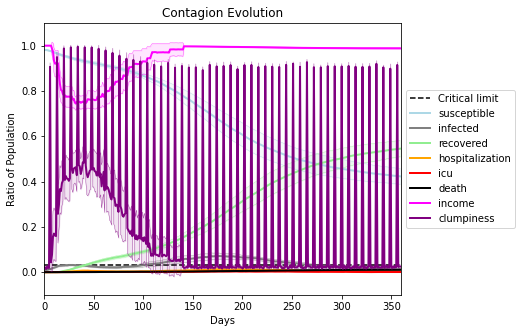

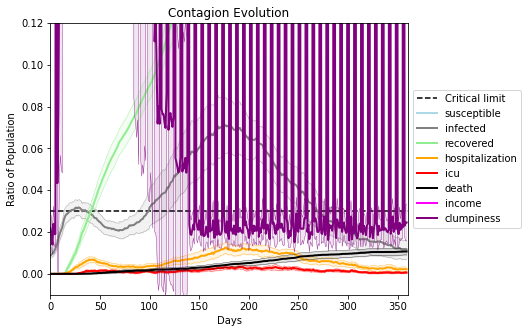

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9552, 8883, 7741, 6526, 7795, 847, 3794, 2272, 3119, 1308, 1555, 4286, 9172, 4848, 347, 1029, 2273, 772, 546, 2056]
Average similarity between family members is 0.13237696811719765 at temperature 0
Average similarity between family and home is 0.9998533977686579 at temperature -1
Average similarity between students and their classroom is 0.1406837157311785 at temperature 0
Average classroom occupancy is 4.422535211267606 and number classrooms is 71
Average similarity between workers is 0.16009916968755736 at temperature 0
Average office occupancy is 3.0738916256157633 and number offices is 203
Average friend similarity for adults: 0.2013758347121371 for kids: 0.1876927326995524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.039371993652007484
avg restaurant similarity 0.06777955587748925
avg restaurant similarity 0.09932142758856494
avg restaurant similarity 0.06836509947056849
avg restaurant similarity 0.07021734695555512
avg restaurant similarity 0.08002208186792764
avg restaurant similarity 0.07772577047281101
avg restaurant similarity 0.03720436638587846
avg restaurant similarity 0.07025698131170505
avg restaurant similarity 0.028287833423725987
avg restaurant similarity 0.021579118139170708
avg restaurant similarity 0.05660058171377636
avg restaurant similarity 0.04582270149109442
avg restaurant similarity -0.0020017404184328623
avg restaurant similarity 0.04777853970881716
avg restaurant similarity -0.006375177074928731
avg restaurant similarity 0.06868655251318646
avg restaurant similarity 0.05979112278870816
avg restaurant similarity 0.02733428686197441
avg restaurant similarity 0.07300381466273716
avg restaurant similarity 0.04686917039834499
avg restaurant similarity 

avg restaurant similarity 0.03008719784382579
avg restaurant similarity 0.07880031455714412
avg restaurant similarity 0.08254940062110068
avg restaurant similarity 0.01120219436122535
avg restaurant similarity 0.06107781887898724
avg restaurant similarity 0.046970208660554666
avg restaurant similarity 0.06020240423964667
avg restaurant similarity 0.0884347553069024
avg restaurant similarity 0.012873006522976056
avg restaurant similarity 0.015053465887667155
avg restaurant similarity 0.025251552967839326
avg restaurant similarity 0.052707628669525976
avg restaurant similarity 0.019566539346696558
avg restaurant similarity 0.03208824843052641
avg restaurant similarity 0.04007308489262812
avg restaurant similarity 0.06226682131431256
avg restaurant similarity -0.015241856366072323
avg restaurant similarity 0.10622874141301827
avg restaurant similarity 0.004818660155176435
avg restaurant similarity 0.04885258792252599
avg restaurant similarity 0.049886613401410276
avg restaurant similarity

avg restaurant similarity 0.09292452704634711
avg restaurant similarity 0.09607994559398365
avg restaurant similarity 0.09909777789503396
avg restaurant similarity 0.060389742344676534
avg restaurant similarity 0.04555863222531211
avg restaurant similarity 0.052949426967397836
avg restaurant similarity 0.04122543374289501
avg restaurant similarity 0.08171819798534036
avg restaurant similarity 0.07681323253520947
avg restaurant similarity 0.04371308963098444
avg restaurant similarity 0.10550154183794182
avg restaurant similarity 0.056215851832756875
avg restaurant similarity 0.05690756910730077
avg restaurant similarity 0.09052754362591907
avg restaurant similarity 0.06245569942301849
avg restaurant similarity 0.10615105078057635
avg restaurant similarity 0.08823111647731731
avg restaurant similarity 0.05978349969833049
avg restaurant similarity 0.03128262318356122
avg restaurant similarity 0.05351591447357823
avg restaurant similarity 0.046356400476243745
avg restaurant similarity 0.08

avg restaurant similarity 0.08183732185736711
avg restaurant similarity 0.06060792764755491
avg restaurant similarity 0.03632730664219776
avg restaurant similarity 0.05346877975410826
avg restaurant similarity 0.1699842830116717
avg restaurant similarity 0.07083854805309038
avg restaurant similarity 0.0811758353320946
avg restaurant similarity 0.04654338896680955
avg restaurant similarity 0.09157420248953
avg restaurant similarity 0.07802654177644322
avg restaurant similarity 0.08018792224706378
avg restaurant similarity 0.037801328673882195
avg restaurant similarity 0.059470797830568176
avg restaurant similarity 0.0940257734684886
avg restaurant similarity 0.05830269816552086
avg restaurant similarity 0.0564705773335538
avg restaurant similarity 0.10061485040307165
avg restaurant similarity 0.09379306870600902
avg restaurant similarity 0.07092453340897406
avg restaurant similarity 0.06791712935548432
avg restaurant similarity 0.03394862667257238
avg restaurant similarity 0.05795880874

avg restaurant similarity 0.07337636256077369
avg restaurant similarity 0.08194356350598735
avg restaurant similarity 0.05624398110899029
avg restaurant similarity 0.07391834360291921
avg restaurant similarity 0.06635281914697831
avg restaurant similarity 0.08624555420082658
avg restaurant similarity 0.06487511435864672
avg restaurant similarity 0.07277561619094505
avg restaurant similarity 0.06827104039371144
avg restaurant similarity 0.0534436242242132
avg restaurant similarity 0.06754968430352225
avg restaurant similarity 0.06278877405543833
avg restaurant similarity 0.09748230086458441
avg restaurant similarity 0.06047237370902906
avg restaurant similarity 0.04005117782251034
avg restaurant similarity 0.044405454195345244
avg restaurant similarity 0.09241201908989959
avg restaurant similarity 0.10734790350144265
avg restaurant similarity 0.048595954746984076
avg restaurant similarity 0.05057453784776097
avg restaurant similarity 0.07777425068095607
avg restaurant similarity 0.10394

avg restaurant similarity 0.04295966590448928
avg restaurant similarity 0.06815253241963157
avg restaurant similarity 0.05470258805120862
avg restaurant similarity 0.10966360558335825
avg restaurant similarity 0.05917788035393422
avg restaurant similarity 0.04742758779283344
avg restaurant similarity 0.14459053967056523
avg restaurant similarity 0.08594394042523179
avg restaurant similarity 0.06559856137794703
avg restaurant similarity 0.060876675602403174
avg restaurant similarity 0.09059297987453284
avg restaurant similarity 0.06960344458063428
avg restaurant similarity 0.0980115157062702
avg restaurant similarity 0.09530247929068404
avg restaurant similarity 0.11164001537455741
avg restaurant similarity 0.044512243618950904
avg restaurant similarity 0.07846430985343364
avg restaurant similarity 0.05629859046868333
avg restaurant similarity 0.03489086969462575
avg restaurant similarity 0.044869231543389496
avg restaurant similarity 0.07123089812681617
avg restaurant similarity 0.0631

avg restaurant similarity 0.06291325776982365
avg restaurant similarity 0.018701649780752512
avg restaurant similarity 0.0707477098585785
avg restaurant similarity 0.08296470032477732
avg restaurant similarity 0.0829913581424294
avg restaurant similarity 0.09714090991137883
avg restaurant similarity 0.13246523472198007
avg restaurant similarity 0.03079689557927344
avg restaurant similarity 0.04403778410679944
avg restaurant similarity 0.029712492722436198
avg restaurant similarity 0.07068160208754017
avg restaurant similarity 0.11403613167377571
avg restaurant similarity 0.07280441627857855
avg restaurant similarity 0.03361220925707087
avg restaurant similarity 0.04967700192626062
avg restaurant similarity 0.07449729317465249
avg restaurant similarity 0.05378180262485851
avg restaurant similarity 0.0388798512377333
avg restaurant similarity 0.05118899114021122
avg restaurant similarity 0.0898684407882292
avg restaurant similarity 0.053270707238555
avg restaurant similarity 0.0755095997

avg restaurant similarity 0.06756421886872876
avg restaurant similarity 0.07994760970863425
avg restaurant similarity 0.058637810519268176
avg restaurant similarity 0.01293357699688742
avg restaurant similarity 0.03715824471799711
avg restaurant similarity 0.006388271645259541
avg restaurant similarity 0.0425680306428318
avg restaurant similarity 0.020955773160484865
avg restaurant similarity 0.016791044704497226
avg restaurant similarity 0.07247512054295943
avg restaurant similarity -0.02631630458288016
avg restaurant similarity 0.06036736908487499
avg restaurant similarity 0.08300150220448355
avg restaurant similarity 0.06368650175282123
avg restaurant similarity 0.07084275181723278
avg restaurant similarity 0.0010191636877006683
avg restaurant similarity 0.09210178050676941
avg restaurant similarity 0.05511190019488049
avg restaurant similarity 0.05124220687539581
avg restaurant similarity 0.08856974475230643
avg restaurant similarity 0.07238073105590082
avg restaurant similarity 0.

avg restaurant similarity 0.05616677868965779
avg restaurant similarity 0.053932426422489285
avg restaurant similarity 0.09315599781735384
avg restaurant similarity 0.09704059292458087
avg restaurant similarity 0.08308782976053304
avg restaurant similarity 0.022920679551675434
avg restaurant similarity 0.040266643416712856
avg restaurant similarity 0.1066086130251568
avg restaurant similarity 0.10411697066323294
avg restaurant similarity 0.05266141228711122
avg restaurant similarity 0.09062773442384328
avg restaurant similarity 0.11114219146806398
avg restaurant similarity 0.08125902526053524
avg restaurant similarity 0.06739455921826554
avg restaurant similarity 0.06157271931119231
avg restaurant similarity 0.06257230602817462
avg restaurant similarity 0.04732481236269625
avg restaurant similarity 0.09516143664927676
avg restaurant similarity 0.09183181820265515
avg restaurant similarity 0.10329408349262921
avg restaurant similarity 0.09642459871422603
avg restaurant similarity 0.0458

avg restaurant similarity 0.043918957503758224
avg restaurant similarity 0.015250702289358752
avg restaurant similarity 0.0804595674944616
avg restaurant similarity 0.03411097666660899
avg restaurant similarity 0.04474754180737694
avg restaurant similarity 0.07479018338428389
avg restaurant similarity 0.08958251906049515
avg restaurant similarity 0.10298307768693483
avg restaurant similarity 0.09132399848596393
avg restaurant similarity 0.02489724909808845
avg restaurant similarity 0.07209829530321156
avg restaurant similarity 0.09275703785725722
avg restaurant similarity 0.06895274955083956
avg restaurant similarity 0.0334415093175502
avg restaurant similarity 0.09079382880175083
avg restaurant similarity 0.054367405120811535
avg restaurant similarity 0.037515595589546265
avg restaurant similarity 0.0821303709441471
avg restaurant similarity 0.0323852649499521
avg restaurant similarity 0.09118593519279809
avg restaurant similarity 0.07029757065323934
avg restaurant similarity 0.038372

avg restaurant similarity 0.02457379774541198
avg restaurant similarity 0.056033468073880294
avg restaurant similarity 0.08664241029550714
avg restaurant similarity 0.05399404938396739
avg restaurant similarity 0.04699766106386014
avg restaurant similarity 0.04733392484232553
avg restaurant similarity 0.06184171859989014
avg restaurant similarity 0.0522080114534754
avg restaurant similarity 0.05153864270116119
avg restaurant similarity 0.051851631078288336
avg restaurant similarity 0.03554409754301296
avg restaurant similarity 0.01441415516952818
avg restaurant similarity 0.06245722755622915
avg restaurant similarity 0.08306563088589579
avg restaurant similarity 0.06107801752507031
avg restaurant similarity 0.0892274701934483
avg restaurant similarity 0.10919594356881798
avg restaurant similarity 0.09457379864686112
avg restaurant similarity 0.07868428576366651
avg restaurant similarity 0.06693140883175519
avg restaurant similarity 0.06922846829244163
avg restaurant similarity 0.047398

avg restaurant similarity 0.005049754894252833
avg restaurant similarity 0.08866018567607811
avg restaurant similarity 0.0774778098711989
avg restaurant similarity 0.044675005227722955
avg restaurant similarity 0.08884308514953293
avg restaurant similarity 0.06512267194520334
avg restaurant similarity 0.029306376750230477
avg restaurant similarity 0.04241547239172078
avg restaurant similarity 0.1514646255009436
avg restaurant similarity 0.026094102501041556
avg restaurant similarity 0.03202264812745443
avg restaurant similarity 0.0532329976104885
avg restaurant similarity 0.05127097760809452
avg restaurant similarity 0.08702460987228199
avg restaurant similarity 0.04992558071587971
avg restaurant similarity 0.05081334319071123
avg restaurant similarity 0.07960226552973818
avg restaurant similarity 0.05554987587055132
avg restaurant similarity 0.0764564474315029
avg restaurant similarity 0.05970324435293963
avg restaurant similarity 0.04950496230158812
avg restaurant similarity 0.039308

avg restaurant similarity 0.07910145935298214
avg restaurant similarity 0.08589563237855055
avg restaurant similarity 0.025047665667615366
avg restaurant similarity 0.10023706127016986
avg restaurant similarity 0.023212426773385954
avg restaurant similarity 0.06420895110672202
avg restaurant similarity 0.10463154867406277
avg restaurant similarity 0.071699983120044
avg restaurant similarity 0.11124264312553327
avg restaurant similarity 0.0313832877213337
avg restaurant similarity 0.058628403562774586
avg restaurant similarity 0.03509570238084514
avg restaurant similarity 0.09257540211216315
avg restaurant similarity 0.04159283229619972
avg restaurant similarity 0.05909542542155792
avg restaurant similarity 0.07516182969316615
avg restaurant similarity 0.05250255531770611
avg restaurant similarity 0.06523123108775937
avg restaurant similarity 0.017152349417668473
avg restaurant similarity 0.07961066884163225
avg restaurant similarity 0.07820435891256383
avg restaurant similarity 0.08494

avg restaurant similarity 0.10688528434181248
avg restaurant similarity 0.060364056885984944
avg restaurant similarity 0.0859001962889155
avg restaurant similarity 0.06523218407607713
avg restaurant similarity 0.05481283828089753
avg restaurant similarity 0.06431306633564046
avg restaurant similarity 0.07511338014522365
avg restaurant similarity 0.05399838001297957
avg restaurant similarity 0.0332625308815657
avg restaurant similarity 0.043932281282946885
avg restaurant similarity 0.08511228489514311
avg restaurant similarity 0.046055250207522
avg restaurant similarity 0.03598292685222052
avg restaurant similarity 0.07784253477332141
avg restaurant similarity 0.05070304483435355
avg restaurant similarity 0.05509948532807343
avg restaurant similarity 0.06268993664278258
avg restaurant similarity 0.033164252042461956
avg restaurant similarity 0.09142170937886422
avg restaurant similarity 0.08371146918313987
avg restaurant similarity 0.031158972652228747
avg restaurant similarity 0.072097

avg restaurant similarity 0.0510270988990443
avg restaurant similarity 0.04462430405196621
avg restaurant similarity 0.08897621932531279
avg restaurant similarity 0.04288741100872669
avg restaurant similarity 0.14187850270187433
avg restaurant similarity 0.03811514140720955
avg restaurant similarity 0.05548731459296118
avg restaurant similarity 0.09413462669535812
avg restaurant similarity -0.0009967781984401413
avg restaurant similarity 0.021558787822699255
avg restaurant similarity 0.03875691507350671
avg restaurant similarity 0.038742661173600576
avg restaurant similarity 0.07124244222144256
avg restaurant similarity 0.09131281821962492
avg restaurant similarity 0.10364517677714448
avg restaurant similarity 0.09294466495699578
avg restaurant similarity -0.011910438020769206
avg restaurant similarity 0.08046057604333534
avg restaurant similarity 0.04428353889149454
avg restaurant similarity 0.06799194659886616
avg restaurant similarity 0.09607837704711439
avg restaurant similarity 0.

avg restaurant similarity 0.05095616083076262
avg restaurant similarity 0.04428095695579228
avg restaurant similarity 0.0430362325298152
avg restaurant similarity 0.03949515747030652
avg restaurant similarity 0.09253468231989544
avg restaurant similarity 0.01992197935365902
avg restaurant similarity 0.09183508493454588
avg restaurant similarity 0.10995052183216607
avg restaurant similarity 0.13233171272492128
avg restaurant similarity 0.06933459540386866
avg restaurant similarity 0.1326390312798946
avg restaurant similarity 0.07258872334622767
avg restaurant similarity 0.02966992538682684
avg restaurant similarity 0.08890645276670693
avg restaurant similarity 0.015318263085021105
avg restaurant similarity 0.07541795418238602
avg restaurant similarity 0.08359304461674245
avg restaurant similarity 0.05986891383093049
avg restaurant similarity 0.04568225812618881
avg restaurant similarity 0.08299084129806504
avg restaurant similarity 0.08943778931979245
avg restaurant similarity 0.0523574

avg restaurant similarity 0.0852752528416144
avg restaurant similarity 0.05407237309753363
avg restaurant similarity 0.08267574551907984
avg restaurant similarity 0.10183211544137201
avg restaurant similarity 0.008992423202219732
avg restaurant similarity 0.04311536339143214
avg restaurant similarity 0.04620100248934444
avg restaurant similarity 0.09773574467459825
avg restaurant similarity 0.0646522918207203
avg restaurant similarity 0.05316968274149981
avg restaurant similarity 0.061384319775685516
avg restaurant similarity 0.05961049176918921
avg restaurant similarity 0.046296937918290634
avg restaurant similarity 0.04452796326127782
avg restaurant similarity 0.08675059391840471
avg restaurant similarity 0.07829868957184903
avg restaurant similarity 0.06596656833694203
avg restaurant similarity 0.07749924932642678
avg restaurant similarity 0.11205713388712324
avg restaurant similarity 0.11355235529575605
avg restaurant similarity 0.053988545879125195
avg restaurant similarity 0.0695

avg restaurant similarity 0.06417987109948572
avg restaurant similarity 0.06131183359394461
avg restaurant similarity 0.07670078214905753
avg restaurant similarity 0.050211451411227966
avg restaurant similarity 0.06953052798891901
avg restaurant similarity 0.04605682721464366
avg restaurant similarity 0.009160682766269466
avg restaurant similarity 0.08639154783661362
avg restaurant similarity 0.028253925265184464
avg restaurant similarity 0.08687911721908652
avg restaurant similarity 0.04775530838404068
avg restaurant similarity 0.07335577902748114
avg restaurant similarity 0.11780719492426424
avg restaurant similarity 0.01674689857262128
avg restaurant similarity 0.06922008935488914
avg restaurant similarity 0.030585838338759577
avg restaurant similarity 0.07509474345503492
avg restaurant similarity 0.046951063143441406
avg restaurant similarity 0.05808404922420207
avg restaurant similarity 0.06495897146426027
avg restaurant similarity 0.09286598110247775
avg restaurant similarity 0.0

avg restaurant similarity 0.06260350802172082
avg restaurant similarity 0.08447747037160093
avg restaurant similarity 0.01681704608294681
avg restaurant similarity 0.05340383829090461
avg restaurant similarity 0.08083837006981905
avg restaurant similarity 0.05761364473558116
avg restaurant similarity 0.05864047742687604
avg restaurant similarity 0.05046980643999205
avg restaurant similarity 0.08590082954436404
avg restaurant similarity 0.06108719181219735
avg restaurant similarity 0.011328279746065357
avg restaurant similarity 0.03599394914415431
avg restaurant similarity 0.0698207548577463
avg restaurant similarity 0.016843555830381683
avg restaurant similarity 0.03489531285831812
avg restaurant similarity 0.0656872979793674
avg restaurant similarity 0.05372773589716376
avg restaurant similarity 0.050503470613866425
avg restaurant similarity 0.028886533310472848
avg restaurant similarity 0.03007528768237536
avg restaurant similarity 0.0966528458916728
avg restaurant similarity 0.02975

avg restaurant similarity 0.059465278631990706
avg restaurant similarity 0.056221695267097964
avg restaurant similarity 0.04814615065503809
avg restaurant similarity 0.08979968525590262
avg restaurant similarity 0.038114836525298346
avg restaurant similarity 0.09724028287020553
avg restaurant similarity 0.029698444681212865
avg restaurant similarity 0.07461062212435722
avg restaurant similarity 0.07414177656470296
avg restaurant similarity 0.031861275035873535
avg restaurant similarity 0.03438529163739253
avg restaurant similarity 0.04214097667556241
avg restaurant similarity 0.03655060855302572
avg restaurant similarity 0.11089040888069118
avg restaurant similarity 0.054913801522367106
avg restaurant similarity 0.0037624192738811924
avg restaurant similarity 0.01144559184490686
avg restaurant similarity 0.028861089039361226
avg restaurant similarity 0.07901348262315008
avg restaurant similarity 0.07280723607925023
avg restaurant similarity 0.07326275450132941
avg restaurant similarity

avg restaurant similarity 0.04217027334784752
avg restaurant similarity 0.08794791643845701
avg restaurant similarity 0.05947741602611897
avg restaurant similarity 0.02808552945152598
avg restaurant similarity 0.06366480164393375
avg restaurant similarity 0.04501748976535637
avg restaurant similarity 0.04152976007544731
avg restaurant similarity 0.02533598293290055
avg restaurant similarity -0.025763671371476282
avg restaurant similarity 0.0509588443734706
avg restaurant similarity 0.03699379358540407
avg restaurant similarity 0.05701865111218233
avg restaurant similarity 0.07878858836656653
avg restaurant similarity 0.0486273464513488
avg restaurant similarity 0.12216922282385406
avg restaurant similarity 0.08998918138895542
avg restaurant similarity 0.032043548374247346
avg restaurant similarity 0.047457021337401185
avg restaurant similarity 0.08017149040239638
avg restaurant similarity 0.044502854082491806
avg restaurant similarity 0.06259624933736208
avg restaurant similarity 0.090

avg restaurant similarity 0.03782455844058765
avg restaurant similarity 0.03597641596539695
avg restaurant similarity 0.0790826331913731
avg restaurant similarity 0.10105117395627591
avg restaurant similarity -0.0024616024548326848
avg restaurant similarity 0.0728507171229223
avg restaurant similarity 0.05997570079806893
avg restaurant similarity 0.09633274966841182
avg restaurant similarity 0.08289687485665648
avg restaurant similarity 0.13286147823390843
avg restaurant similarity 0.0588790814760209
avg restaurant similarity 0.06713669680276925
avg restaurant similarity 0.08972654312778017
avg restaurant similarity 0.0945418612332797
avg restaurant similarity 0.054843607330082
avg restaurant similarity 0.02188057781973129
avg restaurant similarity 0.07861747783902294
avg restaurant similarity 0.043961136653483876
avg restaurant similarity 0.09308805322612099
avg restaurant similarity 0.08424201401546834
avg restaurant similarity 0.04478609707215832
avg restaurant similarity 0.02258731

avg restaurant similarity 0.061350399594293
avg restaurant similarity 0.036743630478147014
avg restaurant similarity 0.043750403933148156
avg restaurant similarity 0.07189672055797752
avg restaurant similarity 0.04343254037315406
avg restaurant similarity 0.06743161602040221
avg restaurant similarity 0.03913733962914682
avg restaurant similarity 0.07702382608714663
avg restaurant similarity -0.0010736727942546583
avg restaurant similarity 0.0062560995601875545
avg restaurant similarity 0.015631790956405316
avg restaurant similarity 0.08829577111143687
avg restaurant similarity 0.03205689932138881
avg restaurant similarity 0.06347114585752758
avg restaurant similarity 0.007025354256369548
avg restaurant similarity 0.09344669879487585
avg restaurant similarity 0.0684453870592349
avg restaurant similarity 0.04616599566113361
avg restaurant similarity 0.07347199566757287
avg restaurant similarity 0.049064339899468595
avg restaurant similarity 0.024846066968438444
avg restaurant similarity 

avg restaurant similarity 0.046748111059453486
avg restaurant similarity -0.015751442091402824
avg restaurant similarity 0.025160660449796864
avg restaurant similarity 0.018312373778953835
avg restaurant similarity 0.002396384684922621
avg restaurant similarity 0.057893153717092756
avg restaurant similarity 0.034624080496875195
avg restaurant similarity 0.022434977469466277
avg restaurant similarity 0.04304588484847557
avg restaurant similarity 0.04973107577261084
avg restaurant similarity 0.10391128027711824
avg restaurant similarity 0.0033908043343633884
avg restaurant similarity 0.016200968303976663
avg restaurant similarity 0.0626095450695889
avg restaurant similarity 0.07026445391579783
avg restaurant similarity 0.059530879894853984
avg restaurant similarity 0.0634128518815517
avg restaurant similarity 0.10255375512989162
avg restaurant similarity 0.0080323760862999
avg restaurant similarity 0.0798162027746457
avg restaurant similarity 0.0061802769778267165
avg restaurant similari

avg restaurant similarity 0.08377628036195707
avg restaurant similarity 0.08334688220767685
avg restaurant similarity 0.04651686613621006
avg restaurant similarity 0.07708614945296513
avg restaurant similarity 0.01334186058237085
avg restaurant similarity 0.10864595665932977
avg restaurant similarity 0.046135961612785104
avg restaurant similarity 0.08820810237979321
avg restaurant similarity 0.09456987905561959
avg restaurant similarity 0.06332065350971411
avg restaurant similarity 0.035645641852390754
avg restaurant similarity 0.09823158342996116
avg restaurant similarity 0.018044195742518313
avg restaurant similarity 0.04536982027350381
avg restaurant similarity 0.039806322380065116
avg restaurant similarity 0.06914334125816844
avg restaurant similarity 0.07680159441786347
avg restaurant similarity 0.09096188470777708
avg restaurant similarity 0.08536142412341247
avg restaurant similarity 0.04546253258412279
avg restaurant similarity 0.05075790165151253
avg restaurant similarity 0.10

avg restaurant similarity 0.05046779346611389
avg restaurant similarity 0.09444363309985808
avg restaurant similarity 0.033798691385396214
avg restaurant similarity 0.09751410225542312
avg restaurant similarity 0.11035443175684796
avg restaurant similarity 0.08677143774137179
avg restaurant similarity 0.11443857801281665
avg restaurant similarity -0.0010957711933245828
avg restaurant similarity 0.08968234204437446
avg restaurant similarity 0.09311338863831237
avg restaurant similarity 0.1373337666359808
avg restaurant similarity 0.0983829004933217
avg restaurant similarity 0.07928906465253381
avg restaurant similarity 0.0652474899271251
avg restaurant similarity 0.05587462403955766
avg restaurant similarity 0.04653126839482405
avg restaurant similarity 0.14866098149325666
avg restaurant similarity 0.04918116182018301
avg restaurant similarity 0.03830622284240396
avg restaurant similarity 0.07251274001173193
avg restaurant similarity 0.006305377911455859
avg restaurant similarity 0.0716

avg restaurant similarity 0.028765446766529833
avg restaurant similarity 0.06637395139923039
avg restaurant similarity 0.031407023439785346
avg restaurant similarity 0.04000362205315465
avg restaurant similarity 0.039631265923285836
avg restaurant similarity -0.013696966630820434
avg restaurant similarity 0.035320498779716505
avg restaurant similarity 0.08305725351877283
avg restaurant similarity 0.022235098879095274
avg restaurant similarity 0.07138591373502814
avg restaurant similarity 0.051907720627146874
avg restaurant similarity 0.06221340558859107
avg restaurant similarity 0.041932920698773184
avg restaurant similarity 0.09656493103116442
avg restaurant similarity 0.056514278677675105
avg restaurant similarity -0.044191701327705266
avg restaurant similarity -0.011765363334406455
avg restaurant similarity 0.03186842661937712
avg restaurant similarity 0.008108399061759015
avg restaurant similarity 0.010534880982942071
avg restaurant similarity 0.07763903938917466
avg restaurant sim

avg restaurant similarity 0.007940495565909344
avg restaurant similarity -0.008787491118586895
avg restaurant similarity 0.11830308251013968
avg restaurant similarity 0.01363897008735584
avg restaurant similarity 0.0733468756073193
avg restaurant similarity 0.07038634221722705
avg restaurant similarity -0.0124162248592197
avg restaurant similarity 0.10571446109257854
avg restaurant similarity 0.07689342671778505
avg restaurant similarity 0.06292117739290996
avg restaurant similarity 0.04413945455495655
avg restaurant similarity -0.00445484054756692
avg restaurant similarity 0.0027211362372402625
avg restaurant similarity 0.06592039792654124
avg restaurant similarity 0.03544101729691464
avg restaurant similarity 0.02256391491867548
avg restaurant similarity 0.04755165787725212
avg restaurant similarity 0.027964686926761545
avg restaurant similarity 0.030266538825643285
avg restaurant similarity 0.008134725024327941
avg restaurant similarity 0.07016430499922031
avg restaurant similarity 

avg restaurant similarity 0.05575565569043672
avg restaurant similarity -0.005027811270764476
avg restaurant similarity 0.05937746133026299
avg restaurant similarity 0.09095829222458958
avg restaurant similarity 0.05486267704734029
avg restaurant similarity 0.04882510153688641
avg restaurant similarity -0.050755094144296097
avg restaurant similarity 0.08452545270984449
avg restaurant similarity 0.07440154072677489
avg restaurant similarity 0.0963950675779607
avg restaurant similarity 0.05998083841077553
avg restaurant similarity 0.026234544254949515
avg restaurant similarity 0.01796219687090375
avg restaurant similarity 0.06414455470198789
avg restaurant similarity 0.08159751876299447
avg restaurant similarity 0.05604500289104612
avg restaurant similarity 0.07867031660067722
avg restaurant similarity -0.007391767761971647
avg restaurant similarity 0.01275729246519233
avg restaurant similarity 0.010573802345548106
avg restaurant similarity 0.005889580075758473
avg restaurant similarity 

avg restaurant similarity 0.0321591246305438
avg restaurant similarity 0.06917490704042246
avg restaurant similarity 0.0715157512330031
avg restaurant similarity 0.07019087791116349
avg restaurant similarity -0.01376156216004605
avg restaurant similarity 0.05156870180062473
avg restaurant similarity 0.032473894098941275
avg restaurant similarity -0.039562600290990686
avg restaurant similarity 0.06790968657050768
avg restaurant similarity 0.042556129023266207
avg restaurant similarity 0.014216887880255089
avg restaurant similarity 0.02245217765116183
avg restaurant similarity -0.004494509704347477
avg restaurant similarity 0.030137891920289223
avg restaurant similarity 0.035256705420403586
avg restaurant similarity 0.003304086354787903
avg restaurant similarity 0.056231456471693
avg restaurant similarity 0.04204036631273124
avg restaurant similarity 0.06410385603360877
avg restaurant similarity 0.06836344885971392
avg restaurant similarity 0.046091920822254245
avg restaurant similarity 

avg restaurant similarity 0.040987900147322016
avg restaurant similarity 0.0604973275427418
avg restaurant similarity 0.09304799456077524
avg restaurant similarity 0.009130208082039959
avg restaurant similarity 0.02923365591345288
avg restaurant similarity 0.06995601863269597
avg restaurant similarity 0.05935391859911049
avg restaurant similarity 0.06083520180051212
avg restaurant similarity 0.10096849893871777
avg restaurant similarity 0.07452509998275411
avg restaurant similarity 0.060841095975251745
avg restaurant similarity 0.07297770246862142
avg restaurant similarity 0.03808003762290206
avg restaurant similarity 0.0877648830655865
avg restaurant similarity 0.039546030862799876
avg restaurant similarity 0.05748510679301466
avg restaurant similarity 0.07766413572639758
avg restaurant similarity 0.05399979351956518
avg restaurant similarity 0.06190190324103009
avg restaurant similarity 0.05527789165204837
avg restaurant similarity 0.08013689502740946
avg restaurant similarity 0.0791

avg restaurant similarity 0.04488626236539226
avg restaurant similarity 0.08857098881614392
avg restaurant similarity 0.0756790545110342
avg restaurant similarity 0.07816648547016963
avg restaurant similarity 0.057931529035514816
avg restaurant similarity 0.11067072137048098
avg restaurant similarity 0.0066772391208601975
avg restaurant similarity 0.09927564955345558
avg restaurant similarity 0.06565193095851804
avg restaurant similarity 0.07843885641130019
avg restaurant similarity 0.042477084955587815
avg restaurant similarity 0.050017328318945904
avg restaurant similarity 0.04501791500171227
avg restaurant similarity 0.09419409694687639
avg restaurant similarity 0.061126278107359794
avg restaurant similarity 0.08680245512436463
avg restaurant similarity 0.02621068615161944
avg restaurant similarity 0.049208567482570374
avg restaurant similarity 0.0266455849163936
avg restaurant similarity 0.12059212443687296
avg restaurant similarity 0.011004081357575645
avg restaurant similarity 0.

avg restaurant similarity 0.0268299642927098
avg restaurant similarity 0.09059767525470189
avg restaurant similarity -0.009117044716349084
avg restaurant similarity -0.019192058564235205
avg restaurant similarity 0.08874383328019936
avg restaurant similarity 0.05537050788421329
avg restaurant similarity 0.006844617062371892
avg restaurant similarity 0.033323186769833354
avg restaurant similarity 0.06576220555974899
avg restaurant similarity 0.05328433533308754
avg restaurant similarity 0.05869489605311328
avg restaurant similarity 0.07842975246276612
avg restaurant similarity 0.007749289910992415
avg restaurant similarity 0.08640867029964575
avg restaurant similarity 0.09174730021447056
avg restaurant similarity 0.04995538225914462
avg restaurant similarity 0.0593051587302577
avg restaurant similarity -0.006160285122716257
avg restaurant similarity 0.06751075045671626
avg restaurant similarity 0.04347555208084185
avg restaurant similarity 0.06152278003302836
avg restaurant similarity 0

avg restaurant similarity 0.0358682805916629
avg restaurant similarity 0.04122368562777323
avg restaurant similarity 0.12902519793625114
avg restaurant similarity 0.03817353712506761
avg restaurant similarity 0.07414730673867213
avg restaurant similarity 0.037789497308444574
avg restaurant similarity 0.03548525327903764
avg restaurant similarity 0.02211261075525739
avg restaurant similarity 0.06429017468185884
avg restaurant similarity 0.048399483179931244
avg restaurant similarity 0.029076399371362634
avg restaurant similarity 0.019241299947283026
avg restaurant similarity 0.0931283979843807
avg restaurant similarity 0.04343153797416815
avg restaurant similarity 0.06710821497327617
avg restaurant similarity 0.010617314367929022
avg restaurant similarity 0.009655821577549984
avg restaurant similarity 0.0588352132207347
avg restaurant similarity 0.05198001854540908
avg restaurant similarity 0.032514661740559156
avg restaurant similarity 0.024182920256771743
avg restaurant similarity 0.0

avg restaurant similarity 0.05510260715922253
avg restaurant similarity 0.06553318969555245
avg restaurant similarity 0.03914169626172332
avg restaurant similarity 0.033021508504894125
avg restaurant similarity 0.057485161903632155
avg restaurant similarity 0.06022250711585083
avg restaurant similarity 0.0685483469763259
avg restaurant similarity 0.06809464870776884
avg restaurant similarity 0.05879187874784009
avg restaurant similarity 0.10718146448773774
avg restaurant similarity 0.026383915954851806
avg restaurant similarity 0.08296669756786926
avg restaurant similarity 0.08131937442607716
avg restaurant similarity 0.0483607708695163
avg restaurant similarity 0.06970265193896077
avg restaurant similarity 0.014278808004866085
avg restaurant similarity 0.1251366232792829
avg restaurant similarity 0.06689165958834402
avg restaurant similarity 0.05043579100066444
avg restaurant similarity 0.09253588767730253
avg restaurant similarity 0.07617238910656586
avg restaurant similarity 0.07294

avg restaurant similarity 0.044298034899899724
avg restaurant similarity 0.07081590847061156
avg restaurant similarity 0.04470451818955705
avg restaurant similarity 0.021125146051537733
avg restaurant similarity 0.035207720043400836
avg restaurant similarity 0.008122572902364912
avg restaurant similarity 0.10084152615939784
avg restaurant similarity 0.11140156392317271
avg restaurant similarity 0.07252662446421267
avg restaurant similarity 0.056956392240462214
avg restaurant similarity 0.05506753018230386
avg restaurant similarity 0.06268009283390745
avg restaurant similarity 0.06799805421739129
avg restaurant similarity 0.01407092885524031
avg restaurant similarity 0.0565567948998102
avg restaurant similarity 0.017761047767421007
avg restaurant similarity 0.08579546227439785
avg restaurant similarity 0.09115650225775476
avg restaurant similarity 0.13442835540594236
avg restaurant similarity 0.06588583629466573
avg restaurant similarity 0.09898255284661171
avg restaurant similarity 0.0

avg restaurant similarity 0.04222499283245882
avg restaurant similarity 0.038025981464024
avg restaurant similarity 0.11785530398792281
avg restaurant similarity 0.006932352236249753
avg restaurant similarity 0.061597297161324865
avg restaurant similarity 0.09462447495778492
avg restaurant similarity 0.05736710320982361
avg restaurant similarity 0.03891692595785944
avg restaurant similarity 0.05511226386552853
avg restaurant similarity 0.06712636118201641
avg restaurant similarity 0.10644749609676256
avg restaurant similarity 0.045429275209430325
avg restaurant similarity 0.08247512678965684
avg restaurant similarity 0.042604989898701956
avg restaurant similarity 0.029052981042022294
avg restaurant similarity 0.06347714256816034
avg restaurant similarity 0.026226022704215687
avg restaurant similarity 0.05160808804558851
avg restaurant similarity 0.033751799995909666
avg restaurant similarity 0.05972632205584079
avg restaurant similarity 0.02536329790187219
avg restaurant similarity 0.0

avg restaurant similarity 0.07615544884116604
avg restaurant similarity 0.059855793232907455
avg restaurant similarity 0.03154297801883288
avg restaurant similarity 0.036964085083699104
avg restaurant similarity 0.039953080189892576
avg restaurant similarity 0.059092761469414834
avg restaurant similarity 0.043974227315925096
avg restaurant similarity 0.050371081551271006
avg restaurant similarity 0.03454605855057676
avg restaurant similarity 0.06946656317079021
avg restaurant similarity 0.038248165935067
avg restaurant similarity 0.034554209947208286
avg restaurant similarity 0.06789804961642457
avg restaurant similarity 0.047045772918004006
avg restaurant similarity 0.054000431973973397
avg restaurant similarity 0.05112939520389753
avg restaurant similarity 0.016987059250170005
avg restaurant similarity 0.012052024101061876
avg restaurant similarity 0.054455954145853344
avg restaurant similarity 0.037944935474137825
avg restaurant similarity 0.08598516211538401
avg restaurant similari

avg restaurant similarity 0.041453422619070174
avg restaurant similarity 0.04282470552846983
avg restaurant similarity 0.057719072609162585
avg restaurant similarity -0.005843914955307685
avg restaurant similarity 0.05821129374817664
avg restaurant similarity 0.0350496182219711
avg restaurant similarity 0.0524800428170087
avg restaurant similarity 0.028598496483987677
avg restaurant similarity 0.021292409707432954
avg restaurant similarity 0.03371781823400051
avg restaurant similarity 0.05529623122228443
avg restaurant similarity 0.048762380658717526
avg restaurant similarity 0.02637071117791569
avg restaurant similarity 0.06566328600039432
avg restaurant similarity 0.07414718358186892
avg restaurant similarity 0.03525887115070547
avg restaurant similarity 0.0499926153750213
avg restaurant similarity 0.04916396593111726
avg restaurant similarity 0.022674540449749186
avg restaurant similarity 0.03956159697906768
avg restaurant similarity 0.06014323738749373
avg restaurant similarity -0.

avg restaurant similarity 0.014160085957813227
avg restaurant similarity 0.03654395558336985
avg restaurant similarity -0.003801135090990511
avg restaurant similarity 0.04710779842949441
avg restaurant similarity 0.092569581445852
avg restaurant similarity 0.06482647754901688
avg restaurant similarity 0.010389120701124365
avg restaurant similarity 0.0630128242465228
avg restaurant similarity 0.06843291162631969
avg restaurant similarity 0.060250721885000524
avg restaurant similarity 0.06050407269007922
avg restaurant similarity 0.07336622629280219
avg restaurant similarity 0.04807241930165988
avg restaurant similarity 0.04240710158732975
avg restaurant similarity 0.03191674975111693
avg restaurant similarity 0.0727574093478705
avg restaurant similarity 0.002350998155430636
avg restaurant similarity 0.07639976062709952
avg restaurant similarity 0.08606477093984617
avg restaurant similarity 0.03597104947719915
avg restaurant similarity 0.0917882790383335
avg restaurant similarity 0.05747

(<function dict.items>, <function dict.items>, <function dict.items>)

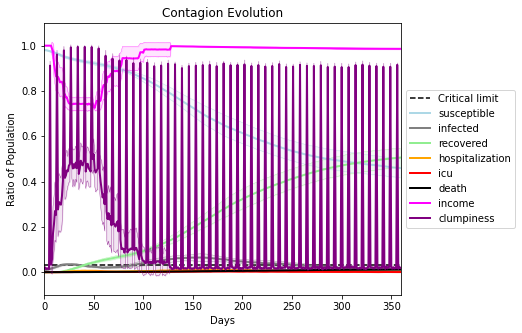

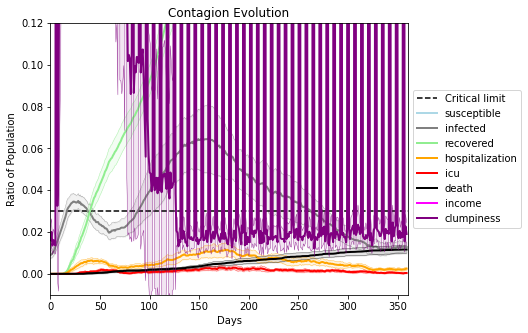

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1102, 7455, 1932, 9413, 3968, 989, 9035, 5415, 983, 7950, 4189, 1875, 7930, 7362, 9867, 7989, 5, 2859, 8468, 6015]
Average similarity between family members is 0.09537121153734411 at temperature 0.33
Average similarity between family and home is 0.9998610674741863 at temperature -1
Average similarity between students and their classroom is 0.11076690846834206 at temperature 0.33
Average classroom occupancy is 4 and number classrooms is 70
Average similarity between workers is 0.08848161104461316 at temperature 0.33
Average office occupancy is 3.291457286432161 and number offices is 199
Average friend similarity for adults: 0.15918400404865993 for kids: 0.15568644584713157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuildin

avg restaurant similarity 0.03412254458361223
avg restaurant similarity 0.09787395562136196
avg restaurant similarity 0.06589463385661039
avg restaurant similarity 0.07022348371573812
avg restaurant similarity 0.06870390949467589
avg restaurant similarity 0.08139248950306456
avg restaurant similarity 0.0014146328532777556
avg restaurant similarity 0.10686381201037655
avg restaurant similarity 0.07894694664923427
avg restaurant similarity 0.0348446342169988
avg restaurant similarity 0.019651177652502693
avg restaurant similarity 0.07486439548529931
avg restaurant similarity 0.04733831498755588
avg restaurant similarity 0.09255804144553563
avg restaurant similarity 0.04604950425433834
avg restaurant similarity 0.07139333617726062
avg restaurant similarity 0.05987398658278763
avg restaurant similarity 0.03390236052328113
avg restaurant similarity 0.061355269727839425
avg restaurant similarity 0.03754846432271907
avg restaurant similarity 0.06426854334704177
avg restaurant similarity 0.059

avg restaurant similarity 0.10850561927837019
avg restaurant similarity 0.040700905130451166
avg restaurant similarity 0.03232758990776694
avg restaurant similarity 0.052385039785029786
avg restaurant similarity 0.08175596175646459
avg restaurant similarity 0.02855542654312931
avg restaurant similarity 0.00377745818585944
avg restaurant similarity -0.02356894845496427
avg restaurant similarity 0.0015590603722743805
avg restaurant similarity 0.08355709404608
avg restaurant similarity 0.05181613482245894
avg restaurant similarity 0.0927040042534594
avg restaurant similarity 0.06138882217151184
avg restaurant similarity 0.058924972930812336
avg restaurant similarity 0.09701038262654356
avg restaurant similarity 0.014022865777285523
avg restaurant similarity 0.01580563496362732
avg restaurant similarity 0.03602065906233563
avg restaurant similarity 0.05492166099213878
avg restaurant similarity 0.03504624015573582
avg restaurant similarity 0.01411044483274836
avg restaurant similarity 0.033

avg restaurant similarity 0.04470693742283612
avg restaurant similarity 0.05044207181080175
avg restaurant similarity 0.007977155420446342
avg restaurant similarity 0.14534312754963308
avg restaurant similarity 0.04970895970666567
avg restaurant similarity 0.025755457197110605
avg restaurant similarity 0.08159465788676226
avg restaurant similarity 0.05634005536473047
avg restaurant similarity 0.04199285626960447
avg restaurant similarity -0.004660195828112352
avg restaurant similarity 0.05061820342061565
avg restaurant similarity 0.018018372457977584
avg restaurant similarity 0.08637692049992392
avg restaurant similarity 0.02473211951529733
avg restaurant similarity 0.03547581870083607
avg restaurant similarity 0.06051453872814952
avg restaurant similarity -0.013912882810631567
avg restaurant similarity 0.0115731814069516
avg restaurant similarity 0.03737464628421707
avg restaurant similarity 0.007450204030576397
avg restaurant similarity 0.034796390760639784
avg restaurant similarity 

avg restaurant similarity -0.024851343927552567
avg restaurant similarity 0.05477124092693382
avg restaurant similarity 0.04384997319438225
avg restaurant similarity 0.01627148181460076
avg restaurant similarity 0.052087386290459
avg restaurant similarity 0.0298168009862314
avg restaurant similarity 0.02755367546585063
avg restaurant similarity 0.038134516942708675
avg restaurant similarity 0.01313682463623475
avg restaurant similarity -0.01228815570385992
avg restaurant similarity 0.05526985377969775
avg restaurant similarity -0.01576512960778322
avg restaurant similarity 0.08272519306932687
avg restaurant similarity 0.02775740174530832
avg restaurant similarity 0.03374617534294911
avg restaurant similarity -0.03788330197023552
avg restaurant similarity 0.04518433295082567
avg restaurant similarity 0.027587699370941004
avg restaurant similarity -0.01898266273317252
avg restaurant similarity 0.059048309086965726
avg restaurant similarity 0.1311193261451461
avg restaurant similarity 0.0

avg restaurant similarity 0.017497131788302474
avg restaurant similarity 0.02250363540887739
avg restaurant similarity 0.07071577398599019
avg restaurant similarity 0.06599358769448263
avg restaurant similarity 0.061548541191250195
avg restaurant similarity -0.015565221847685651
avg restaurant similarity 0.054976861576142955
avg restaurant similarity 0.02702102133674921
avg restaurant similarity 0.050484707953438165
avg restaurant similarity 0.06204163938114392
avg restaurant similarity 0.024604429386893157
avg restaurant similarity -0.0016692888520475186
avg restaurant similarity 0.0633326314873118
avg restaurant similarity 0.09981894286841526
avg restaurant similarity -0.014137181876734678
avg restaurant similarity 0.06667267600198286
avg restaurant similarity 0.07205934698895178
avg restaurant similarity 0.04429085912229566
avg restaurant similarity 0.059520019131261925
avg restaurant similarity 0.06559100218692812
avg restaurant similarity 0.03732758636116318
avg restaurant similar

avg restaurant similarity 0.05775273632525758
avg restaurant similarity -0.02176961411302745
avg restaurant similarity 0.0545776861036014
avg restaurant similarity 0.08843744119733674
avg restaurant similarity 0.025604752231682546
avg restaurant similarity 0.0559508978465963
avg restaurant similarity 0.05520999697848965
avg restaurant similarity 0.016781078672437135
avg restaurant similarity 0.08927799437764025
avg restaurant similarity 0.0983235609647758
avg restaurant similarity 0.053283970180217195
avg restaurant similarity 0.04067544883218981
avg restaurant similarity 0.10137925248533342
avg restaurant similarity 0.04132418498122795
avg restaurant similarity 0.08662722513965838
avg restaurant similarity 0.09599761224331856
avg restaurant similarity 0.09980380073102632
avg restaurant similarity 0.045737285629077175
avg restaurant similarity -0.033042852379436036
avg restaurant similarity 0.03818791659310674
avg restaurant similarity 0.030472790145322216
avg restaurant similarity 0.0

avg restaurant similarity 0.040516686568074625
avg restaurant similarity 0.07025867058621764
avg restaurant similarity 0.0306761879080255
avg restaurant similarity 0.03425107414500359
avg restaurant similarity 0.04223703018703357
avg restaurant similarity 0.038683866897293
avg restaurant similarity 0.03807323109755195
avg restaurant similarity 0.07150436911054006
avg restaurant similarity 0.044706822510598085
avg restaurant similarity 0.013014593406272484
avg restaurant similarity 0.013993918588244442
avg restaurant similarity 0.010041014375095381
avg restaurant similarity 0.05473161049214642
avg restaurant similarity 0.03517288467194254
avg restaurant similarity 0.014773791932553057
avg restaurant similarity 0.03341519572560184
avg restaurant similarity 0.04710882936927824
avg restaurant similarity 0.03192695827221558
avg restaurant similarity 0.029958396209857834
avg restaurant similarity 0.05161497579179414
avg restaurant similarity 0.02932295354115608
avg restaurant similarity 0.07

avg restaurant similarity -0.01802578774677378
avg restaurant similarity 0.014859603754826407
avg restaurant similarity 0.011116654473456031
avg restaurant similarity 0.08608649084976444
avg restaurant similarity -0.003342824455353292
avg restaurant similarity -0.0005574614168530479
avg restaurant similarity -0.008995403345363237
avg restaurant similarity 0.02523139025931585
avg restaurant similarity 0.012088311235180496
avg restaurant similarity 0.03939846832092859
avg restaurant similarity 0.03630665434067807
avg restaurant similarity 0.02850308725119867
avg restaurant similarity 0.012125920488759398
avg restaurant similarity 0.02115114040581573
avg restaurant similarity 0.05267562597131251
avg restaurant similarity 0.06351350789009291
avg restaurant similarity 0.04946517684508702
avg restaurant similarity 0.04165671790200879
avg restaurant similarity 0.00795492076096946
avg restaurant similarity 0.028942579637137516
avg restaurant similarity 0.004360326886874135
avg restaurant simil

avg restaurant similarity 0.06503684938096946
avg restaurant similarity 0.07561969614296028
avg restaurant similarity 0.06175817493513617
avg restaurant similarity 0.0738416641718951
avg restaurant similarity 0.09215437398174316
avg restaurant similarity 0.04105597118655112
avg restaurant similarity 0.032732158101536075
avg restaurant similarity 0.04214230751933735
avg restaurant similarity 0.07824331045470917
avg restaurant similarity 0.05601530866628346
avg restaurant similarity 0.06315840005913768
avg restaurant similarity -0.0023503361884678635
avg restaurant similarity 0.06751006408677364
avg restaurant similarity 0.1093865165599314
avg restaurant similarity 0.0772387942048514
avg restaurant similarity 0.08112945994683135
avg restaurant similarity 0.015776580050337406
avg restaurant similarity 0.07930436777181805
avg restaurant similarity -0.00024634079351245323
avg restaurant similarity 0.03950347210851082
avg restaurant similarity 0.05767462375271357
avg restaurant similarity 0.

avg restaurant similarity 0.027754105617590178
avg restaurant similarity 0.08589809918289172
avg restaurant similarity 0.050258518889322354
avg restaurant similarity 0.0960668639544174
avg restaurant similarity 0.0334664795297536
avg restaurant similarity 0.050709756299689206
avg restaurant similarity 0.09736713951847198
avg restaurant similarity 0.06311141711926165
avg restaurant similarity 0.0637329245294342
avg restaurant similarity 0.07336492382629892
avg restaurant similarity 0.08936894654888583
avg restaurant similarity 0.05858821264188674
avg restaurant similarity 0.006490725796126243
avg restaurant similarity 0.046803214339776925
avg restaurant similarity 0.08392635292278955
avg restaurant similarity 0.03239785155771608
avg restaurant similarity 0.097532699655684
avg restaurant similarity 0.07346546045682392
avg restaurant similarity 0.05846866413755408
avg restaurant similarity 0.06831101223948889
avg restaurant similarity 0.026773211474582587
avg restaurant similarity 0.06773

avg restaurant similarity 0.0221161253745382
avg restaurant similarity 0.030472586533078973
avg restaurant similarity -0.009123194499091877
avg restaurant similarity 0.033062092182002054
avg restaurant similarity 0.04522762571041328
avg restaurant similarity 0.028876973400189507
avg restaurant similarity 0.007347381617114942
avg restaurant similarity 0.025066217157368956
avg restaurant similarity 0.04430318682839942
avg restaurant similarity 0.046236096387844546
avg restaurant similarity 0.03356902243998714
avg restaurant similarity 0.00645561751125787
avg restaurant similarity 0.04841196996870274
avg restaurant similarity 0.00621175114297332
avg restaurant similarity 0.008544957932882192
avg restaurant similarity 0.04088946037747878
avg restaurant similarity 0.06315736368869329
avg restaurant similarity 0.0406745838489284
avg restaurant similarity -0.024302144893501045
avg restaurant similarity 0.05226267871724492
avg restaurant similarity 0.05078657213899465
avg restaurant similarity

avg restaurant similarity 0.018862865997983175
avg restaurant similarity -0.003096943499793649
avg restaurant similarity 0.027298650401567075
avg restaurant similarity 0.07353947898994243
avg restaurant similarity 0.022737883120157697
avg restaurant similarity 0.035242502493255834
avg restaurant similarity 0.004352648327164838
avg restaurant similarity 0.03876193284527565
avg restaurant similarity 0.04483625121603319
avg restaurant similarity 0.02884928216046706
avg restaurant similarity 0.05950784257739442
avg restaurant similarity -0.010498394609402927
avg restaurant similarity 0.036147706816319305
avg restaurant similarity 0.0567642781564081
avg restaurant similarity 0.021504406617209263
avg restaurant similarity 0.014067819771454807
avg restaurant similarity -0.007787474728936628
avg restaurant similarity -0.017235313963002662
avg restaurant similarity 0.029336977038987522
avg restaurant similarity 0.029536378307461603
avg restaurant similarity 0.07707834049911562
avg restaurant si

avg restaurant similarity 0.0610671434525265
avg restaurant similarity 0.06367311563123303
avg restaurant similarity 0.06201704860690471
avg restaurant similarity 0.04311745509153581
avg restaurant similarity 0.07907744774965382
avg restaurant similarity 0.06756068245649553
avg restaurant similarity -0.001754111812845318
avg restaurant similarity 0.04155548802705809
avg restaurant similarity 0.079517559250865
avg restaurant similarity 0.03211668692756812
avg restaurant similarity 0.05252446104096217
avg restaurant similarity 0.03391348961360799
avg restaurant similarity 0.08518164808556963
avg restaurant similarity 0.06798884146104385
avg restaurant similarity 0.04468534971139228
avg restaurant similarity 0.09960937107806175
avg restaurant similarity 0.07011743519649058
avg restaurant similarity 0.08663758738761355
avg restaurant similarity 0.07074867551269852
avg restaurant similarity 0.03002621098910622
avg restaurant similarity 0.04368385501358378
avg restaurant similarity 0.0414951

avg restaurant similarity 0.055820470611730955
avg restaurant similarity 0.05294317095498769
avg restaurant similarity 0.03375255948869798
avg restaurant similarity 0.04818969502655738
avg restaurant similarity 0.056817994635934656
avg restaurant similarity 0.03562699472140828
avg restaurant similarity 0.0381182148607207
avg restaurant similarity 0.06439118801804034
avg restaurant similarity 0.06803444707299024
avg restaurant similarity 0.031068171624188155
avg restaurant similarity 0.06494815141526288
avg restaurant similarity 0.0856313274248295
avg restaurant similarity 0.06741684872255856
avg restaurant similarity 0.06460674290076417
avg restaurant similarity 0.04768901233695112
avg restaurant similarity 0.06064034927625815
avg restaurant similarity 0.014825235846841272
avg restaurant similarity 0.06253933983843964
avg restaurant similarity 0.025784418556851808
avg restaurant similarity 0.0560043890963311
avg restaurant similarity 0.08900915621044204
avg restaurant similarity -0.033

avg restaurant similarity 0.04097153733927997
avg restaurant similarity 0.05741349292281714
avg restaurant similarity -0.0008723040693704787
avg restaurant similarity 0.04741763879593056
avg restaurant similarity 0.02640678780333214
avg restaurant similarity 0.04264358122136198
avg restaurant similarity 0.019852288740398363
avg restaurant similarity 0.0640931329179501
avg restaurant similarity 0.02674400062906504
avg restaurant similarity -0.001716780676690138
avg restaurant similarity 0.02618246117722604
avg restaurant similarity 0.0776543778321749
avg restaurant similarity 0.06898498593959278
avg restaurant similarity 0.05223846464620026
avg restaurant similarity 0.026854912017143677
avg restaurant similarity 0.039970235352417366
avg restaurant similarity 0.02319126250201568
avg restaurant similarity 0.03860957482673352
avg restaurant similarity 0.0036390040195469417
avg restaurant similarity 0.03776445875225782
avg restaurant similarity 0.044378335881271366
avg restaurant similarity

avg restaurant similarity 0.05099372009108072
avg restaurant similarity 0.05275576203010072
avg restaurant similarity 0.04043916038621516
avg restaurant similarity 0.008962025576687337
avg restaurant similarity 0.04921816734545351
avg restaurant similarity 0.009108433525968736
avg restaurant similarity 0.07328512400085302
avg restaurant similarity 0.0004482048640468504
avg restaurant similarity -0.017728544532063864
avg restaurant similarity 0.050500078599838766
avg restaurant similarity 0.01816389541962551
avg restaurant similarity 0.003357709959804125
avg restaurant similarity 0.06220850832635217
avg restaurant similarity 0.03495747579881874
avg restaurant similarity -0.01895433418608262
avg restaurant similarity 0.038781226506026605
avg restaurant similarity -0.03276474057995999
avg restaurant similarity 0.030988885142498295
avg restaurant similarity 0.01769480265003502
avg restaurant similarity 0.0345737780577945
avg restaurant similarity 0.05841702424960232
avg restaurant similari

avg restaurant similarity 0.015787480323980786
avg restaurant similarity -0.015482046840527421
avg restaurant similarity 0.013811447338237434
avg restaurant similarity 0.05689032271669584
avg restaurant similarity 0.03790401060005865
avg restaurant similarity 0.04090723069387961
avg restaurant similarity 0.02543989512092349
avg restaurant similarity 0.021035912868698395
avg restaurant similarity 0.053150921326803977
avg restaurant similarity -0.010176319576602935
avg restaurant similarity -0.02298223914900256
avg restaurant similarity 0.028821866589689726
avg restaurant similarity 0.030674226441317717
avg restaurant similarity 0.03430138824914711
avg restaurant similarity -0.0077569108514545715
avg restaurant similarity -0.0033247978463797376
avg restaurant similarity 0.027504855893827874
avg restaurant similarity 0.09596606132471261
avg restaurant similarity 0.0073927601932722315
avg restaurant similarity 0.03748334317037967
avg restaurant similarity 0.008119854912072294
avg restauran

avg restaurant similarity -0.0027059191317984196
avg restaurant similarity -0.0071865362374772665
avg restaurant similarity 0.012929688610122796
avg restaurant similarity 0.03221441539548046
avg restaurant similarity 0.05628144779312349
avg restaurant similarity 0.04461556603857317
avg restaurant similarity -0.013936391561018394
avg restaurant similarity 0.021876434703223643
avg restaurant similarity 0.036626384869836874
avg restaurant similarity -0.05710784148506463
avg restaurant similarity -0.013233158035781983
avg restaurant similarity -0.03366746469614477
avg restaurant similarity -0.048006934761074434
avg restaurant similarity -0.03661458655727878
avg restaurant similarity 0.04984622957845574
avg restaurant similarity -0.004076985211967802
avg restaurant similarity 0.00233560105943593
avg restaurant similarity -0.010452346286556636
avg restaurant similarity 0.0411726211805411
avg restaurant similarity -0.05077754694628951
avg restaurant similarity 0.03245936121811382
avg restaura

avg restaurant similarity 0.018754872816470633
avg restaurant similarity 0.05927016238389974
avg restaurant similarity 0.06558037262146059
avg restaurant similarity 0.035161782805027
avg restaurant similarity 0.06829319696490423
avg restaurant similarity 0.08565405988937758
avg restaurant similarity -0.01755177230764883
avg restaurant similarity -0.011805092349079494
avg restaurant similarity -0.02944034062968721
avg restaurant similarity 0.06118238661707658
avg restaurant similarity 0.05661259015750913
avg restaurant similarity 0.05967149318284312
avg restaurant similarity 0.04094428880079693
avg restaurant similarity 0.0350578418979676
avg restaurant similarity 0.06607272520597676
avg restaurant similarity 0.05317418264416565
avg restaurant similarity 0.024291191175889425
avg restaurant similarity 0.020618643679250818
avg restaurant similarity 0.031296544062322386
avg restaurant similarity 0.03611960636582068
avg restaurant similarity 0.007121700445570928
avg restaurant similarity -0

avg restaurant similarity 0.005173914720174994
avg restaurant similarity 0.08280267027167486
avg restaurant similarity 0.051489789560773574
avg restaurant similarity 0.021441876265740834
avg restaurant similarity 0.0318472540177036
avg restaurant similarity 0.022504165106465794
avg restaurant similarity -0.010310989638723815
avg restaurant similarity 0.03350037688256678
avg restaurant similarity 0.056521777292310386
avg restaurant similarity -0.004988377509132324
avg restaurant similarity 0.005546640056053546
avg restaurant similarity 0.027417925409379176
avg restaurant similarity 0.042955548263216396
avg restaurant similarity 0.030385852000261053
avg restaurant similarity -0.004650944060004403
avg restaurant similarity 0.040613514521295364
avg restaurant similarity 0.0501161401832516
avg restaurant similarity 0.03967606372423028
avg restaurant similarity 0.030248932479865112
avg restaurant similarity -0.02474698748475565
avg restaurant similarity 0.03139485631017113
avg restaurant sim

avg restaurant similarity 0.03590543987597013
avg restaurant similarity 0.0630219712374323
avg restaurant similarity 0.03858895590882626
avg restaurant similarity 0.05785662536237568
avg restaurant similarity -0.00026094847697293006
avg restaurant similarity 0.041980424915305355
avg restaurant similarity 0.052430407868431
avg restaurant similarity 0.0780584018736094
avg restaurant similarity 0.057239102101957075
avg restaurant similarity 0.0668598992633514
avg restaurant similarity 0.05671374826108367
avg restaurant similarity 0.05654035169423982
avg restaurant similarity -0.0035170305457443082
avg restaurant similarity 0.05245593525211638
avg restaurant similarity 0.020514646904616584
avg restaurant similarity 0.03649994677238583
avg restaurant similarity 0.03981710572250939
avg restaurant similarity 0.06949312861210265
avg restaurant similarity -0.020013313805415867
avg restaurant similarity 0.039960812800294426
avg restaurant similarity 0.05807317014150027
avg restaurant similarity 

avg restaurant similarity 0.033556442681561736
avg restaurant similarity 0.04352924919235481
avg restaurant similarity 0.03080711044409134
avg restaurant similarity 0.021430308942046294
avg restaurant similarity -0.006981690336145418
avg restaurant similarity 0.07018713078766946
avg restaurant similarity -0.009504516746957856
avg restaurant similarity 0.017498859625624738
avg restaurant similarity -0.0022591886047925456
avg restaurant similarity 0.0017356734691538432
avg restaurant similarity 0.015351521171021853
avg restaurant similarity -0.054060580166342714
avg restaurant similarity 0.031234048776262183
avg restaurant similarity 0.020599041492386325
avg restaurant similarity 0.043590903141037515
avg restaurant similarity 0.06514232740631076
avg restaurant similarity 0.05366775487723821
avg restaurant similarity 0.041554649813296936
avg restaurant similarity 0.017918958349197715
avg restaurant similarity 0.035002342601049674
avg restaurant similarity 0.017343581453104176
avg restaura

avg restaurant similarity 0.03739713251335005
avg restaurant similarity -0.004253127910054144
avg restaurant similarity 0.08323821670863264
avg restaurant similarity 0.028943611972417113
avg restaurant similarity 0.08435060178024265
avg restaurant similarity 0.029382903303805843
avg restaurant similarity 0.03217142261584737
avg restaurant similarity 0.03570120032237685
avg restaurant similarity 0.03502059107600671
avg restaurant similarity 0.03719039401162872
avg restaurant similarity 0.00839587096571481
avg restaurant similarity 0.07803853178595614
avg restaurant similarity 0.06726738789981837
avg restaurant similarity 0.03292246420279021
avg restaurant similarity 0.005553502954714227
avg restaurant similarity 0.06903720247568676
avg restaurant similarity -8.880935083221282e-05
avg restaurant similarity 0.09511992893048771
avg restaurant similarity 0.025845104641130087
avg restaurant similarity 0.04639106803978327
avg restaurant similarity 0.041765805882324966
avg restaurant similarit

avg restaurant similarity 0.046273889886536995
avg restaurant similarity 0.015376686273196044
avg restaurant similarity 0.05378691933650375
avg restaurant similarity 0.018358616795617705
avg restaurant similarity 0.06742968998819955
avg restaurant similarity 0.0457118846467282
avg restaurant similarity 0.049298886380134084
avg restaurant similarity 0.05440328792942067
avg restaurant similarity 0.034379495578100994
avg restaurant similarity 0.026026222711636803
avg restaurant similarity 0.01541533808965301
avg restaurant similarity 0.04158766937765495
avg restaurant similarity 0.018493303041501773
avg restaurant similarity 0.05476327201652672
avg restaurant similarity 0.05961276583206649
avg restaurant similarity 0.05630800863744856
avg restaurant similarity -0.008310295359080774
avg restaurant similarity 0.038062123602481866
avg restaurant similarity 0.0503869281163601
avg restaurant similarity 0.06638357869434783
avg restaurant similarity 0.0829192192713068
avg restaurant similarity 0

avg restaurant similarity 0.02611337307210725
avg restaurant similarity 0.030133722992212866
avg restaurant similarity 0.035473975358957154
avg restaurant similarity -0.012868673303613899
avg restaurant similarity 0.03907731178382397
avg restaurant similarity 0.06183198949351039
avg restaurant similarity 0.05475256771532511
avg restaurant similarity 0.0033483443734138927
avg restaurant similarity 0.07361773426646936
avg restaurant similarity 0.046166452463566286
avg restaurant similarity 0.028941855313034892
avg restaurant similarity 0.05929941899688267
avg restaurant similarity 0.04377602038841885
avg restaurant similarity 0.07439195844734119
avg restaurant similarity 0.026281923194533457
avg restaurant similarity 0.05774844400643708
avg restaurant similarity 0.060342843193622035
avg restaurant similarity 0.013848724225335025
avg restaurant similarity 0.06152694989282108
avg restaurant similarity 0.04777032462095008
avg restaurant similarity -0.004275559817243686
avg restaurant simila

avg restaurant similarity 0.014520034903829172
avg restaurant similarity -0.013485719899805671
avg restaurant similarity 0.017175208790164223
avg restaurant similarity 0.03126889477517413
avg restaurant similarity 0.026106084976343577
avg restaurant similarity 0.021170334398829285
avg restaurant similarity -0.0032733696379149057
avg restaurant similarity 0.012838058068306946
avg restaurant similarity 0.04699532602544172
avg restaurant similarity 0.02353188022472316
avg restaurant similarity 0.02251079874458358
avg restaurant similarity 0.0012171603685434728
avg restaurant similarity 0.06478335314017163
avg restaurant similarity -0.03185751592429438
avg restaurant similarity 0.04089907220300435
avg restaurant similarity 0.03889432526600048
avg restaurant similarity 0.03698836585548456
avg restaurant similarity 0.07872966464263506
avg restaurant similarity 0.035791508108180894
avg restaurant similarity 0.03931687428458229
avg restaurant similarity 0.03649072414045996
avg restaurant simil

avg restaurant similarity 0.042197128234404135
avg restaurant similarity 0.050953618805454994
avg restaurant similarity 0.009866269523775645
avg restaurant similarity 0.05143808692449119
avg restaurant similarity -0.025773460018786495
avg restaurant similarity 0.027092076712885525
avg restaurant similarity 0.002558355535442717
avg restaurant similarity -0.010892613312104477
avg restaurant similarity 0.010385730297089875
avg restaurant similarity 0.019725585555493683
avg restaurant similarity 0.04977333258612945
avg restaurant similarity 0.030286345062162698
avg restaurant similarity 0.07555388870150631
avg restaurant similarity 0.04905146546141815
avg restaurant similarity 0.031282907667426335
avg restaurant similarity 0.046796271263979825
avg restaurant similarity 0.039275573970220475
avg restaurant similarity 0.012054086087294615
avg restaurant similarity 0.04519456796768532
avg restaurant similarity 0.05479592188266112
avg restaurant similarity 0.05215321111756618
avg restaurant sim

avg restaurant similarity 0.0511937969584672
avg restaurant similarity 0.04603560970954396
avg restaurant similarity -0.008865736186457362
avg restaurant similarity 0.03412928611848494
avg restaurant similarity 0.005377936741107188
avg restaurant similarity 0.05174670275461681
avg restaurant similarity 0.003090740977638373
avg restaurant similarity 0.0547522638085073
avg restaurant similarity 0.05890894636643895
avg restaurant similarity 0.04784955712402331
avg restaurant similarity 0.024071990408379308
avg restaurant similarity 0.04452874902357419
avg restaurant similarity 0.03864318126972643
avg restaurant similarity 0.014378830482148958
avg restaurant similarity 0.058841123988719046
avg restaurant similarity 0.059111991017092906
avg restaurant similarity 0.07269500360880804
avg restaurant similarity 0.03263257681128001
avg restaurant similarity -0.017777459881951653
avg restaurant similarity 0.03023996899954811
avg restaurant similarity 0.017247689491300646
avg restaurant similarity

avg restaurant similarity 0.0738108909668056
avg restaurant similarity 0.05431762730970454
avg restaurant similarity 0.07536810602916696
avg restaurant similarity 0.037938572124704105
avg restaurant similarity 0.11661425559547668
avg restaurant similarity 0.04626018478002127
avg restaurant similarity 0.09171534652790052
avg restaurant similarity 0.021709926898372867
avg restaurant similarity 0.026208264181000574
avg restaurant similarity 0.027883839046279436
avg restaurant similarity 0.043706503243867344
avg restaurant similarity 0.08598498446475275
avg restaurant similarity 0.048773995129495144
avg restaurant similarity 0.038441010620866405
avg restaurant similarity 0.045509200855279756
avg restaurant similarity 0.026684609796408906
avg restaurant similarity 0.060380295393157715
avg restaurant similarity 0.009699155162035487
avg restaurant similarity 0.03558990102910743
avg restaurant similarity 0.0823468629369025
avg restaurant similarity 0.04927992428343706
avg restaurant similarity

avg restaurant similarity 0.04089982176074247
avg restaurant similarity 0.06440212700836156
avg restaurant similarity 0.0565238205177548
avg restaurant similarity 0.06995175355136447
avg restaurant similarity 0.04383445647352046
avg restaurant similarity 0.0404923186537801
avg restaurant similarity 0.060256282407349766
avg restaurant similarity 0.06485806303803308
avg restaurant similarity 0.06458572873317965
avg restaurant similarity 0.06388423889580155
avg restaurant similarity 0.037908117742434924
avg restaurant similarity 0.07406582700940201
avg restaurant similarity 0.06563539306490951
avg restaurant similarity 0.061619666646588536
avg restaurant similarity 0.08553131736998826
avg restaurant similarity 0.08829991908716239
avg restaurant similarity 0.05729435401956579
avg restaurant similarity 0.06674349271584605
avg restaurant similarity 0.06568041787712545
avg restaurant similarity 0.09823423364849782
avg restaurant similarity 0.0739379585010803
avg restaurant similarity 0.043243

avg restaurant similarity 0.027009691597706654
avg restaurant similarity 0.03918869183248707
avg restaurant similarity 0.02511092363954114
avg restaurant similarity 0.0784043970342427
avg restaurant similarity 0.033092916112708703
avg restaurant similarity 0.061166045386431715
avg restaurant similarity 0.0075666506317507674
avg restaurant similarity 0.014244946270612529
avg restaurant similarity 0.044720288129517956
avg restaurant similarity 0.04796570608162313
avg restaurant similarity 0.04990458068967278
avg restaurant similarity 0.09337063696390611
avg restaurant similarity 0.056486998122181005
avg restaurant similarity 0.04676578098503099
avg restaurant similarity 0.06476283599705436
avg restaurant similarity 0.062434900703381854
avg restaurant similarity 0.05370481386326531
avg restaurant similarity 0.041028156109577926
avg restaurant similarity 0.05432367636663646
avg restaurant similarity 0.03328296584187049
avg restaurant similarity 0.03488837512411277
avg restaurant similarity

avg restaurant similarity 0.06737553662975856
avg restaurant similarity 0.042579471486170015
avg restaurant similarity 0.0009893033381162088
avg restaurant similarity 0.06134591692520721
avg restaurant similarity 0.04698010517903817
avg restaurant similarity 0.028110327877131126
avg restaurant similarity 0.04478999249510514
avg restaurant similarity 0.03965358389868167
avg restaurant similarity 0.019368062321496106
avg restaurant similarity 0.04649362814178312
avg restaurant similarity 0.038430636613933034
avg restaurant similarity 0.061760029405244485
avg restaurant similarity -0.004507840460475835
avg restaurant similarity 0.10930684967645198
avg restaurant similarity -0.0056483922606884686
avg restaurant similarity 0.05838402475297804
avg restaurant similarity 0.0638446055327951
avg restaurant similarity 0.05306318089976002
avg restaurant similarity 0.04549557035552426
avg restaurant similarity 0.023689738669311032
avg restaurant similarity 0.06417578249198526
avg restaurant similar

avg restaurant similarity 0.025767014704646693
avg restaurant similarity 0.01179235820769828
avg restaurant similarity 0.01881034502111474
avg restaurant similarity 0.034290973337267175
avg restaurant similarity 0.0622162504247825
avg restaurant similarity 0.06897908453097454
avg restaurant similarity 0.061067703144428435
avg restaurant similarity 0.03724131644933427
avg restaurant similarity 0.024429453618321096
avg restaurant similarity -0.011310283891602995
avg restaurant similarity 0.08500588330076624
avg restaurant similarity -0.004403283877091284
avg restaurant similarity 0.03800375897271879
avg restaurant similarity 0.027574488046358193
avg restaurant similarity -0.001122969955340048
avg restaurant similarity 0.030071182094908507
avg restaurant similarity 0.005252687610886243
avg restaurant similarity 0.00020156670785488557
avg restaurant similarity -0.005857034034644479
avg restaurant similarity -0.010614318000477968
avg restaurant similarity 0.038375196640544285
avg restaurant

avg restaurant similarity 0.021612011128275127
avg restaurant similarity -0.0004890216418396154
avg restaurant similarity 0.06779889436226268
avg restaurant similarity 0.07078406827433896
avg restaurant similarity 0.025371460859605743
avg restaurant similarity 0.015993339692310184
avg restaurant similarity 0.023861079291449153
avg restaurant similarity 0.05443214309028373
avg restaurant similarity 0.051232091155580375
avg restaurant similarity 0.07782248269830934
avg restaurant similarity 0.012973024490747944
avg restaurant similarity 0.05445851616411097
avg restaurant similarity 0.07953335468556824
avg restaurant similarity -5.679045702153681e-05
avg restaurant similarity 0.049884056818190955
avg restaurant similarity -0.00022404296222051307
avg restaurant similarity 0.051490081360066234
avg restaurant similarity 0.045016396450211923
avg restaurant similarity 0.061222131996302026
avg restaurant similarity 0.004200367903787711
avg restaurant similarity 0.05734534024865905
avg restauran

avg restaurant similarity 0.07794244286598595
avg restaurant similarity 0.021926340843988985
avg restaurant similarity 0.018616952847755604
avg restaurant similarity 0.02032202780534939
avg restaurant similarity 0.056632115433728286
avg restaurant similarity 0.03850361604801584
avg restaurant similarity 0.016867472610964787
avg restaurant similarity 0.10194480299126833
avg restaurant similarity 0.02826199526366736
avg restaurant similarity 0.0935329166635549
avg restaurant similarity 0.041317593477559304
avg restaurant similarity 0.05205276673696452
avg restaurant similarity 0.03946503717013019
avg restaurant similarity 0.04766652152004629
avg restaurant similarity 0.031648501596321967
avg restaurant similarity -0.0038817618615961543
avg restaurant similarity 0.05244112217325178
avg restaurant similarity 0.07367848573837796
avg restaurant similarity 0.009280713887685544
avg restaurant similarity -0.03473164241815856
avg restaurant similarity 0.027384404453339138
avg restaurant similari

avg restaurant similarity 0.055435811863210824
avg restaurant similarity 0.0430681384744155
avg restaurant similarity 0.06529376451498006
avg restaurant similarity 0.02861450106790779
avg restaurant similarity 0.0325133328667642
avg restaurant similarity 0.09548047750697655
avg restaurant similarity -0.013626762571330846
avg restaurant similarity -0.0014185700942548837
avg restaurant similarity 0.003289780226164334
avg restaurant similarity 0.06243445390640944
avg restaurant similarity 0.010781772620492878
avg restaurant similarity 0.03970503268654053
avg restaurant similarity 0.04174849090170547
avg restaurant similarity 0.012101559521336186
avg restaurant similarity 0.025986666871397935
avg restaurant similarity 0.042152329977510505
avg restaurant similarity 0.004065364658887926
avg restaurant similarity 0.048193770973523405
avg restaurant similarity 0.06610578271024188
avg restaurant similarity 0.016084198153977533
avg restaurant similarity 0.06457389992340476
avg restaurant similar

avg restaurant similarity 0.053825246427541315
avg restaurant similarity 0.052525597148733796
avg restaurant similarity 0.007595262688597309
avg restaurant similarity 0.026189847918369025
avg restaurant similarity 0.04446681985825879
avg restaurant similarity -0.004510679344761799
avg restaurant similarity -0.030574731481109972
avg restaurant similarity 0.007375263126657726
avg restaurant similarity 0.05460616599003984
avg restaurant similarity -0.008942794675949689
avg restaurant similarity -0.016279604629162
avg restaurant similarity 0.007342414390951615
avg restaurant similarity 0.006251248417069495
avg restaurant similarity 0.017652313840622436
avg restaurant similarity 0.03226957543104413
avg restaurant similarity 0.08279677894820918
avg restaurant similarity 0.008371101260170209
avg restaurant similarity -0.018190148686260992
avg restaurant similarity 0.029690289337654455
avg restaurant similarity 0.022808626590900823
avg restaurant similarity 0.024097383927822118
avg restaurant 

avg restaurant similarity 0.012765589211388019
avg restaurant similarity 0.06149389300480163
avg restaurant similarity 0.03929010082555918
avg restaurant similarity 0.04167020301475139
avg restaurant similarity -0.002654893731680888
avg restaurant similarity 0.003840136663603934
avg restaurant similarity 0.0393045249498749
avg restaurant similarity 0.013179232572226703
avg restaurant similarity 0.056863666326895816
avg restaurant similarity 0.046626042437804965
avg restaurant similarity 0.04534950313507912
avg restaurant similarity 0.019805755169414966
avg restaurant similarity 0.016521699591604336
avg restaurant similarity 0.04730620598094984
avg restaurant similarity -0.028928252133115413
avg restaurant similarity 0.017427666829701167
avg restaurant similarity 0.04990443083501326
avg restaurant similarity 0.01716491801658028
avg restaurant similarity -0.0071452954003709225
avg restaurant similarity 0.028560922728626148
avg restaurant similarity 0.016135923291452584
avg restaurant sim

avg restaurant similarity 0.013056622322512942
avg restaurant similarity -0.009489948960055615
avg restaurant similarity 0.05255195190028495
avg restaurant similarity 0.06650991496076598
avg restaurant similarity 0.09051404034695078
avg restaurant similarity 0.043953480011147066
avg restaurant similarity 0.059678605163715676
avg restaurant similarity 0.09419002000149923
avg restaurant similarity 0.06888563888221204
avg restaurant similarity 0.018543193849150617
avg restaurant similarity 0.03783679088559986
avg restaurant similarity 0.05347495856099425
avg restaurant similarity 0.08897927526851448
avg restaurant similarity 0.03690935167505005
avg restaurant similarity 0.018981387688825256
avg restaurant similarity 0.09877688099456894
avg restaurant similarity -0.03605272629137016
avg restaurant similarity 0.029581748586465124
avg restaurant similarity 0.04634787696694781
avg restaurant similarity 0.09783459930123405
avg restaurant similarity 0.011809410243185388
avg restaurant similarit

avg restaurant similarity 0.04647679902722073
avg restaurant similarity 0.08359979086212216
avg restaurant similarity 0.053026262288873194
avg restaurant similarity 0.01759844954617411
avg restaurant similarity 0.05434411558278209
avg restaurant similarity 0.04941449494143565
avg restaurant similarity 0.11807471737260129
avg restaurant similarity 0.07997185348849106
avg restaurant similarity 0.023186505555566048
avg restaurant similarity -0.005964661772118787
avg restaurant similarity 0.03999038527612377
avg restaurant similarity 0.014891700409223175
avg restaurant similarity -0.0023255626808650646
avg restaurant similarity 0.023801641007682898
avg restaurant similarity 0.008615825334366053
avg restaurant similarity 0.07314448949790028
avg restaurant similarity 0.05257319137065498
avg restaurant similarity 0.072116255837294
avg restaurant similarity 0.02557090796234156
avg restaurant similarity 0.02948948301950342
avg restaurant similarity 0.033353884643555695
avg restaurant similarity

(<function dict.items>, <function dict.items>, <function dict.items>)

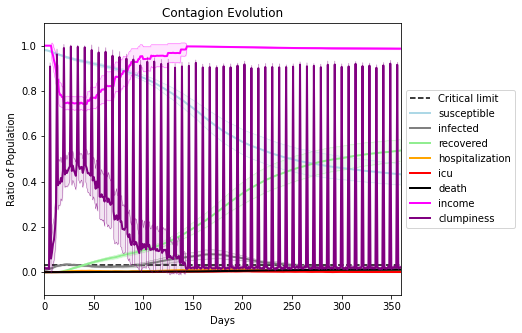

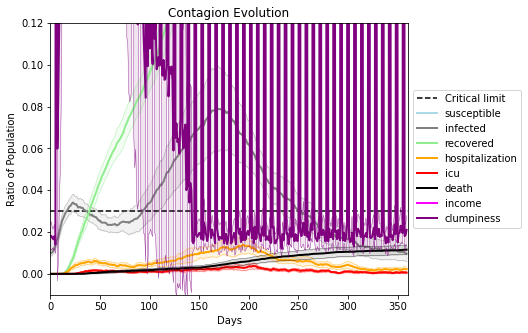

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7241, 5414, 8911, 9789, 2475, 1806, 9528, 1057, 3365, 4940, 9956, 8816, 1683, 2685, 464, 8280, 6891, 28, 9728, 9845]
Average similarity between family members is 0.04602716873747732 at temperature 0.66
Average similarity between family and home is 0.9998535015361872 at temperature -1
Average similarity between students and their classroom is 0.07756331092654975 at temperature 0.66
Average classroom occupancy is 3.9571428571428573 and number classrooms is 70
Average similarity between workers is 0.06433587589731125 at temperature 0.66
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.13319992277838932 for kids: 0.1286361034142061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.01937749536480476
avg restaurant similarity 0.016152266519842917
avg restaurant similarity -0.011939838666644196
avg restaurant similarity 0.024835793543335587
avg restaurant similarity 0.06391187697853618
avg restaurant similarity 0.04919150448455601
avg restaurant similarity 0.04019287415496335
avg restaurant similarity 0.06721347110243074
avg restaurant similarity 0.033593699346704246
avg restaurant similarity 0.03940487775044314
avg restaurant similarity 0.042633704222748495
avg restaurant similarity -0.015734757055336654
avg restaurant similarity 0.03374178863169533
avg restaurant similarity -0.026161586740654667
avg restaurant similarity 0.02453542386391428
avg restaurant similarity -0.04221700107989734
avg restaurant similarity 0.025570619157925623
avg restaurant similarity 0.00938589070610698
avg restaurant similarity 0.0037203694396998974
avg restaurant similarity 0.024758683422904094
avg restaurant similarity 0.0836734540507484
avg restaurant simil

avg restaurant similarity 0.032551484174697734
avg restaurant similarity 0.010450769121173152
avg restaurant similarity 0.007998658344863272
avg restaurant similarity -0.009043704059477228
avg restaurant similarity 0.05514679962853634
avg restaurant similarity 0.02736212970299822
avg restaurant similarity 0.017420519893805705
avg restaurant similarity 0.0036860233210731985
avg restaurant similarity 0.06834286784829488
avg restaurant similarity 0.07927649325502438
avg restaurant similarity -0.0038657531257897874
avg restaurant similarity 0.03611590690874326
avg restaurant similarity -0.012717907095519279
avg restaurant similarity 0.07786597156461496
avg restaurant similarity 0.01245278942085172
avg restaurant similarity 0.025448897703558567
avg restaurant similarity 0.027797489511074965
avg restaurant similarity 0.02618880465287967
avg restaurant similarity 0.054249408333144275
avg restaurant similarity 0.07705918169458685
avg restaurant similarity 0.019886001017475154
avg restaurant si

avg restaurant similarity 0.002518414987575889
avg restaurant similarity 0.005614460933901488
avg restaurant similarity 0.010710392470041352
avg restaurant similarity 0.002243022999787481
avg restaurant similarity 0.07257303644662194
avg restaurant similarity 0.04189717774177131
avg restaurant similarity 0.052216527606279754
avg restaurant similarity -0.0012016678671573407
avg restaurant similarity 0.02747809944590324
avg restaurant similarity -0.002191248935231111
avg restaurant similarity 0.021180304933731606
avg restaurant similarity -0.020638031295956576
avg restaurant similarity -0.04604756516573692
avg restaurant similarity 0.05145591664211986
avg restaurant similarity 0.029973297141696418
avg restaurant similarity -0.06662319196945161
avg restaurant similarity 0.029368574356925383
avg restaurant similarity -0.0013702233848226473
avg restaurant similarity 1.9377392333476207e-05
avg restaurant similarity 0.01911852397565106
avg restaurant similarity 0.00626714196195094
avg restaur

avg restaurant similarity 0.03519656995575628
avg restaurant similarity 0.029493923197834983
avg restaurant similarity 0.0045559448335484405
avg restaurant similarity -0.03048984716846789
avg restaurant similarity -0.03490208839090472
avg restaurant similarity -0.006242331716195681
avg restaurant similarity -0.013799325806064482
avg restaurant similarity 0.03070983861326013
avg restaurant similarity 0.04246123447819159
avg restaurant similarity 0.017479612795086173
avg restaurant similarity 0.01903344112523115
avg restaurant similarity 0.056579534678846265
avg restaurant similarity 0.041890720911152965
avg restaurant similarity 0.05471082903453176
avg restaurant similarity -0.03291119452863137
avg restaurant similarity 0.03587810984960772
avg restaurant similarity 0.03332171957687037
avg restaurant similarity 0.020623549377022016
avg restaurant similarity 0.0686956208528291
avg restaurant similarity 0.06970140281508566
avg restaurant similarity 0.00025968740709059705
avg restaurant sim

avg restaurant similarity 0.02693961313356588
avg restaurant similarity 0.0027004099827258807
avg restaurant similarity -0.008050337118605207
avg restaurant similarity 0.016335457980407465
avg restaurant similarity -0.05192497845211375
avg restaurant similarity 0.009039525105867844
avg restaurant similarity 0.01791809050237811
avg restaurant similarity -0.017179095156359996
avg restaurant similarity 0.019224617311921172
avg restaurant similarity -0.014569795970414353
avg restaurant similarity 0.015843374614773736
avg restaurant similarity 0.0026326705213544914
avg restaurant similarity 0.010323195494501048
avg restaurant similarity 0.009234901431117583
avg restaurant similarity 0.0035809541885896126
avg restaurant similarity 0.01691580194688446
avg restaurant similarity 0.007648057092207505
avg restaurant similarity 0.005305078438789854
avg restaurant similarity 0.003848646354014999
avg restaurant similarity 0.01947383750883155
avg restaurant similarity 0.03577951288781063
avg restaura

avg restaurant similarity 0.016794619544670614
avg restaurant similarity -0.017747894523598144
avg restaurant similarity 0.06397268140699854
avg restaurant similarity 0.01588939614468074
avg restaurant similarity 0.02329569794342422
avg restaurant similarity 0.01612667956880497
avg restaurant similarity -0.010028919324137048
avg restaurant similarity 0.034009150033664566
avg restaurant similarity -0.006093326456168808
avg restaurant similarity 0.06019017926237823
avg restaurant similarity 0.056037155689071576
avg restaurant similarity 0.037191271714673464
avg restaurant similarity 0.0009725545851305398
avg restaurant similarity 0.02817984366847823
avg restaurant similarity -0.015292680222452934
avg restaurant similarity -0.009119270211622519
avg restaurant similarity 0.07864878404408913
avg restaurant similarity 0.07637836794909772
avg restaurant similarity 0.020230599035303966
avg restaurant similarity -0.018362697971277975
avg restaurant similarity 0.036669035869038955
avg restaurant

avg restaurant similarity 0.04565893704516512
avg restaurant similarity 0.055484315503738224
avg restaurant similarity 0.024719908475039895
avg restaurant similarity 0.06608757798926562
avg restaurant similarity 0.061765525236704366
avg restaurant similarity 0.03226397502503166
avg restaurant similarity 0.04317168781208044
avg restaurant similarity 0.008905776907033374
avg restaurant similarity 0.004512827984664495
avg restaurant similarity 0.04838348264529963
avg restaurant similarity 0.06408623064437718
avg restaurant similarity 0.05165084507149881
avg restaurant similarity 0.03684282668765725
avg restaurant similarity 0.05362705814171857
avg restaurant similarity 0.04165254891364356
avg restaurant similarity 0.012545474396066892
avg restaurant similarity 0.06725175557085036
avg restaurant similarity 0.03516051728630487
avg restaurant similarity 0.0665912816562245
avg restaurant similarity 0.06737962078984942
avg restaurant similarity 0.03357476892441308
avg restaurant similarity 0.0

avg restaurant similarity 0.02671443625530758
avg restaurant similarity 0.08318541402026208
avg restaurant similarity 0.03104230859302155
avg restaurant similarity 0.01687953793689472
avg restaurant similarity 0.04470113543254738
avg restaurant similarity 0.03282405682344838
avg restaurant similarity 0.03619603031089543
avg restaurant similarity 0.04314364586939061
avg restaurant similarity 0.06905330974738243
avg restaurant similarity 0.015896681873838366
avg restaurant similarity 0.03732051347421324
avg restaurant similarity 0.022281384275837233
avg restaurant similarity 0.02058992497447517
avg restaurant similarity 0.01871174647568208
avg restaurant similarity 0.04737871471282422
avg restaurant similarity 0.032866918266183695
avg restaurant similarity 0.013311374217653237
avg restaurant similarity 0.048113492333357884
avg restaurant similarity 0.05174837952181701
avg restaurant similarity -0.02095224513164986
avg restaurant similarity 0.04937680922313019
avg restaurant similarity 0.

avg restaurant similarity -0.03214348294661543
avg restaurant similarity 0.05336784424189836
avg restaurant similarity -0.0005613991572686
avg restaurant similarity -0.00879958222002941
avg restaurant similarity 0.046301722670428154
avg restaurant similarity 0.01172326210187745
avg restaurant similarity 0.0230976700321844
avg restaurant similarity 0.01944290820821002
avg restaurant similarity -0.018956011566869716
avg restaurant similarity -0.019621633595645782
avg restaurant similarity 0.06183318332054102
avg restaurant similarity -0.021285451565448168
avg restaurant similarity 0.059227374336722864
avg restaurant similarity -0.022855435748299683
avg restaurant similarity -0.008815653256300945
avg restaurant similarity 0.008385080094606437
avg restaurant similarity -0.024485241976710887
avg restaurant similarity 0.02134439016357333
avg restaurant similarity -0.005147420864043093
avg restaurant similarity -0.013000991237511486
avg restaurant similarity -0.009329693746066632
avg restaura

avg restaurant similarity 0.006761845906433056
avg restaurant similarity 0.05312973379821346
avg restaurant similarity 0.02533804722636084
avg restaurant similarity 0.0034142029885865714
avg restaurant similarity 0.005970988241269853
avg restaurant similarity 0.00090974058264133
avg restaurant similarity 0.031526034043328724
avg restaurant similarity -0.016788746397679126
avg restaurant similarity 0.022863837905655396
avg restaurant similarity 0.00556363083690002
avg restaurant similarity 0.028470782930004115
avg restaurant similarity 0.0066163761731536045
avg restaurant similarity 0.014597999965455622
avg restaurant similarity 0.01847495369644891
avg restaurant similarity 0.006362845840498297
avg restaurant similarity -0.0002678719440174753
avg restaurant similarity -0.02269626074208816
avg restaurant similarity 0.012146292109523359
avg restaurant similarity 0.009823357688977154
avg restaurant similarity 0.0003089962022146219
avg restaurant similarity -0.02770317121988982
avg restaura

avg restaurant similarity 0.047818364377018314
avg restaurant similarity 0.012101358390338286
avg restaurant similarity 0.011915036601556604
avg restaurant similarity 0.0032840773960472972
avg restaurant similarity 0.043962791412764046
avg restaurant similarity 0.006945368334968826
avg restaurant similarity 0.04386581852695751
avg restaurant similarity 0.06601314788275248
avg restaurant similarity 0.023658449676097516
avg restaurant similarity 0.02549858445377399
avg restaurant similarity 0.029536067044736092
avg restaurant similarity 0.027602459353965315
avg restaurant similarity 0.027032723585774486
avg restaurant similarity 0.04876900539241998
avg restaurant similarity 0.0443276401795854
avg restaurant similarity -0.01404219755842217
avg restaurant similarity -0.0069502380416646544
avg restaurant similarity 0.011465841664479759
avg restaurant similarity 0.026250459479434083
avg restaurant similarity 0.07671855822974788
avg restaurant similarity -0.0018512721889377538
avg restaurant 

avg restaurant similarity 0.01681813534936896
avg restaurant similarity 0.05106639330126441
avg restaurant similarity 0.03605691299959251
avg restaurant similarity 0.03788622501955914
avg restaurant similarity 0.029561088451548475
avg restaurant similarity 0.04192358205299329
avg restaurant similarity 0.04669468589614196
avg restaurant similarity 0.012784785842614565
avg restaurant similarity 0.05786603315113997
avg restaurant similarity -0.0018737453536916665
avg restaurant similarity 0.03797381545445954
avg restaurant similarity -0.03112680238614709
avg restaurant similarity 0.019196532957419285
avg restaurant similarity 0.038882495036021744
avg restaurant similarity 0.05938555327125835
avg restaurant similarity 0.09178800896808094
avg restaurant similarity 0.01250227639445956
avg restaurant similarity 0.029502725209384094
avg restaurant similarity 0.028121145056222943
avg restaurant similarity 0.04043732699680595
avg restaurant similarity 0.019125356777331824
avg restaurant similari

avg restaurant similarity -0.013534103348193093
avg restaurant similarity 0.05463097860562785
avg restaurant similarity 0.009657588740992483
avg restaurant similarity 0.011475635721568171
avg restaurant similarity 0.0431527370870312
avg restaurant similarity 0.02605988545756703
avg restaurant similarity 0.05670143568565545
avg restaurant similarity 0.027058237755754846
avg restaurant similarity 0.00279725285731623
avg restaurant similarity 0.04520964436345234
avg restaurant similarity -0.013108024202391827
avg restaurant similarity -0.011537030933433582
avg restaurant similarity -0.01572761558029328
avg restaurant similarity -0.0037957960082718087
avg restaurant similarity 0.00764198436114948
avg restaurant similarity -0.010276582047840347
avg restaurant similarity 0.005300984641495597
avg restaurant similarity 0.05295588314285587
avg restaurant similarity 0.022255917014057783
avg restaurant similarity 0.0499994692075107
avg restaurant similarity -0.0273242777270653
avg restaurant simi

avg restaurant similarity 0.04495348044494366
avg restaurant similarity 0.05210283588820756
avg restaurant similarity 0.034812325781810434
avg restaurant similarity 0.030830038748660152
avg restaurant similarity -0.025921977603878373
avg restaurant similarity 0.02983396161405748
avg restaurant similarity -0.00103165826743731
avg restaurant similarity 0.05991235726635682
avg restaurant similarity 8.784273619774067e-05
avg restaurant similarity 0.00587310329159598
avg restaurant similarity 0.023640593080942376
avg restaurant similarity 0.05311823412761518
avg restaurant similarity 0.026178597277575013
avg restaurant similarity 0.036375554404051616
avg restaurant similarity 0.03172956262556652
avg restaurant similarity 0.028784247808967864
avg restaurant similarity 0.001129684783339142
avg restaurant similarity 0.03174471039313239
avg restaurant similarity 0.05258705733204451
avg restaurant similarity 0.02582703212462114
avg restaurant similarity 0.030841090962741107
avg restaurant simila

avg restaurant similarity 0.017758147805204287
avg restaurant similarity 0.027584849562373864
avg restaurant similarity 0.040302146614049184
avg restaurant similarity 0.06425464617945383
avg restaurant similarity 0.04049148897307146
avg restaurant similarity 0.037351586192743085
avg restaurant similarity 0.0037872195209949847
avg restaurant similarity 0.005323692580322861
avg restaurant similarity 0.007031371301151809
avg restaurant similarity 0.05169773795807594
avg restaurant similarity 0.04630454266878253
avg restaurant similarity 0.01099030325741345
avg restaurant similarity 0.04362108833488645
avg restaurant similarity 0.06574271435123462
avg restaurant similarity 0.028406503119139184
avg restaurant similarity -0.014128117782966543
avg restaurant similarity 0.02350865392487938
avg restaurant similarity 0.03354782573579001
avg restaurant similarity 0.04914903404192748
avg restaurant similarity 0.07291492229491207
avg restaurant similarity -0.0055521102036092135
avg restaurant simil

avg restaurant similarity 0.04375892939848368
avg restaurant similarity 0.07002623478583957
avg restaurant similarity 0.04943114197684033
avg restaurant similarity 0.07618768258656228
avg restaurant similarity 0.05935601867201812
avg restaurant similarity 0.06776283995008535
avg restaurant similarity 0.05731441221351122
avg restaurant similarity 0.03627685573643629
avg restaurant similarity 0.03507991589833911
avg restaurant similarity 0.041616727581972254
avg restaurant similarity 0.05211800780237927
avg restaurant similarity 0.044167685284694926
avg restaurant similarity 0.06879301361973003
avg restaurant similarity 0.03680222833277521
avg restaurant similarity 0.054414664526430255
avg restaurant similarity 0.026638262955838418
avg restaurant similarity 0.0352869207604098
avg restaurant similarity 0.05749180417611807
avg restaurant similarity 0.06425195021777332
avg restaurant similarity 0.019482752780628585
avg restaurant similarity 0.020018656855314777
avg restaurant similarity 0.0

avg restaurant similarity 0.07426707472696785
avg restaurant similarity 0.09207825539617505
avg restaurant similarity 0.014146066770171075
avg restaurant similarity -0.012852409572214982
avg restaurant similarity -0.012716772393726285
avg restaurant similarity 0.036284537246451885
avg restaurant similarity 0.03464045832764012
avg restaurant similarity 0.013906920515363724
avg restaurant similarity 0.06141425634559827
avg restaurant similarity 0.04345917416851231
avg restaurant similarity 0.05063662432244808
avg restaurant similarity 0.011401027867292869
avg restaurant similarity 0.016915115687819848
avg restaurant similarity 0.008724948912375057
avg restaurant similarity 0.10780154126630677
avg restaurant similarity 0.005708295253000002
avg restaurant similarity 0.05576658509072985
avg restaurant similarity 0.024737846985166432
avg restaurant similarity 0.026462950279480656
avg restaurant similarity 0.08638115940662577
avg restaurant similarity 0.001909944219643211
avg restaurant simil

avg restaurant similarity 0.026020268162982956
avg restaurant similarity 0.045345357433899953
avg restaurant similarity 0.03982957100822489
avg restaurant similarity 0.014932462006883003
avg restaurant similarity 0.049277527521261785
avg restaurant similarity 0.015320514682917587
avg restaurant similarity 0.013314538703215268
avg restaurant similarity 0.056963440932454125
avg restaurant similarity -0.004127314118771507
avg restaurant similarity 0.04639292101803691
avg restaurant similarity -0.010948391923302865
avg restaurant similarity -0.013542286484729852
avg restaurant similarity 0.04491156273130434
avg restaurant similarity -0.004119993639895467
avg restaurant similarity 0.04145540450847232
avg restaurant similarity 0.0165488624238613
avg restaurant similarity -0.018199013687113987
avg restaurant similarity 0.02434095889530864
avg restaurant similarity 0.025334655130360602
avg restaurant similarity 0.014095921261332866
avg restaurant similarity 0.03811271332285408
avg restaurant s

avg restaurant similarity 0.02535815095873469
avg restaurant similarity 0.01782495098397674
avg restaurant similarity -0.005382820371917263
avg restaurant similarity 0.034148086219004004
avg restaurant similarity -0.0016741120132881438
avg restaurant similarity -0.000981339235895028
avg restaurant similarity 0.018769157762909976
avg restaurant similarity 0.004414676350332416
avg restaurant similarity 0.008506189153013002
avg restaurant similarity 0.02500706221901472
avg restaurant similarity 0.0014667969524642228
avg restaurant similarity 0.034651593617137995
avg restaurant similarity 0.039249727333908295
avg restaurant similarity 0.01592324701238014
avg restaurant similarity 0.004428282864064533
avg restaurant similarity 0.05231887237327549
avg restaurant similarity 0.04934014634988856
avg restaurant similarity 0.01926169040203833
avg restaurant similarity -0.015064206310024052
avg restaurant similarity 0.0018135711744256453
avg restaurant similarity 0.02225118047412498
avg restaurant

avg restaurant similarity 0.0457730433253087
avg restaurant similarity 0.021084210520486115
avg restaurant similarity 0.032655094934671065
avg restaurant similarity 0.02036987022387267
avg restaurant similarity 0.009446915978468105
avg restaurant similarity 0.03196506313374581
avg restaurant similarity -0.034709087854991695
avg restaurant similarity 0.029717938540775337
avg restaurant similarity 0.012668692505928884
avg restaurant similarity 0.029893238707593212
avg restaurant similarity 0.003504126398012855
avg restaurant similarity 0.02805291809086395
avg restaurant similarity 0.024403882363604287
avg restaurant similarity 0.016810271917721668
avg restaurant similarity -0.014605627701519193
avg restaurant similarity -0.0053143832424850344
avg restaurant similarity 0.034333203560979776
avg restaurant similarity 0.037995732507627014
avg restaurant similarity -0.04154350418470835
avg restaurant similarity 0.043402962073510035
avg restaurant similarity -0.0070147623432603575
avg restaura

avg restaurant similarity 0.022540836749983216
avg restaurant similarity 0.0394831794499701
avg restaurant similarity 0.04831688412239214
avg restaurant similarity 0.030078951050992193
avg restaurant similarity 0.02233172469054282
avg restaurant similarity 0.011406804771328582
avg restaurant similarity 0.00430693202911503
avg restaurant similarity -0.020547247925118594
avg restaurant similarity 0.0051948915592568085
avg restaurant similarity 0.017825537846510815
avg restaurant similarity 0.006047393437690968
avg restaurant similarity 0.0468455777516243
avg restaurant similarity 0.05979841149164399
avg restaurant similarity -0.003141671289675816
avg restaurant similarity 0.032280347498221694
avg restaurant similarity 0.017823207959696698
avg restaurant similarity 0.07354982378357923
avg restaurant similarity 0.05953981061474688
avg restaurant similarity 0.032133927312349625
avg restaurant similarity -0.021588702408677468
avg restaurant similarity -0.007128232940431961
avg restaurant sim

avg restaurant similarity -0.020377528960006455
avg restaurant similarity 0.07326624946521414
avg restaurant similarity 0.07518651269307007
avg restaurant similarity -0.054833883137368845
avg restaurant similarity 0.05943445388261394
avg restaurant similarity 0.021238206838322327
avg restaurant similarity 0.03896757391006088
avg restaurant similarity 0.008069529802113822
avg restaurant similarity 0.032664694498865054
avg restaurant similarity 0.04048604945403337
avg restaurant similarity 0.016835172421752566
avg restaurant similarity 0.05010377924002426
avg restaurant similarity 0.009102492775695355
avg restaurant similarity -0.019692319598692592
avg restaurant similarity -0.0019882665216545336
avg restaurant similarity 0.006970801716157019
avg restaurant similarity -0.019425494373669496
avg restaurant similarity 0.02926624004281863
avg restaurant similarity 0.03639515887563378
avg restaurant similarity -0.014047788479784669
avg restaurant similarity 0.05236313035360394
avg restaurant 

avg restaurant similarity -0.005146522116316452
avg restaurant similarity -0.009711674007586659
avg restaurant similarity 0.044810445722461324
avg restaurant similarity -0.0057452782654209235
avg restaurant similarity -0.02182807752727788
avg restaurant similarity 0.028404121008320255
avg restaurant similarity 0.027513892235819445
avg restaurant similarity -0.006639936273250005
avg restaurant similarity 0.025638687071337863
avg restaurant similarity 0.004809514452914637
avg restaurant similarity -0.018100817747654672
avg restaurant similarity 0.02753143106231127
avg restaurant similarity -0.03069065160678153
avg restaurant similarity 0.08935758563060163
avg restaurant similarity -0.007311208237185863
avg restaurant similarity 0.011231918594006686
avg restaurant similarity 0.03373725399663744
avg restaurant similarity -0.007617877623935068
avg restaurant similarity -0.02213918475493695
avg restaurant similarity -0.0072239248388172835
avg restaurant similarity 0.01521568756006456
avg res

avg restaurant similarity 0.04784563490630941
avg restaurant similarity 0.020292301220949157
avg restaurant similarity -0.0184897293599685
avg restaurant similarity 0.031947463623201375
avg restaurant similarity 0.0009754291139906443
avg restaurant similarity 0.01699127415539292
avg restaurant similarity 0.01932297150030822
avg restaurant similarity 0.0249739720268929
avg restaurant similarity 0.01980147056765742
avg restaurant similarity 0.023960946674785426
avg restaurant similarity 0.12524739642312246
avg restaurant similarity 0.018254418131356826
avg restaurant similarity 0.011689134445727105
avg restaurant similarity -0.0037000122124463317
avg restaurant similarity -0.008522319139706372
avg restaurant similarity -0.005150113288644287
avg restaurant similarity -0.01743663889413253
avg restaurant similarity -0.008895359632015914
avg restaurant similarity 0.08499949466839747
avg restaurant similarity 0.059784650202535324
avg restaurant similarity 0.03448221189217942
avg restaurant si

avg restaurant similarity 0.015097149696228681
avg restaurant similarity 0.032506438607171166
avg restaurant similarity 0.03440618711156558
avg restaurant similarity 0.05682538445604723
avg restaurant similarity 0.020257679364110468
avg restaurant similarity 0.0529766480199948
avg restaurant similarity 0.016521031336592402
avg restaurant similarity 0.00025806314677903
avg restaurant similarity 0.03409582357181463
avg restaurant similarity 0.03771032943820899
avg restaurant similarity 0.021174642144950493
avg restaurant similarity 0.032363651693627905
avg restaurant similarity 0.0443521144805384
avg restaurant similarity 0.053327857606973
avg restaurant similarity 0.07685649493810484
avg restaurant similarity 0.04049395222225035
avg restaurant similarity 0.04793222445460327
avg restaurant similarity 0.07421538750069055
avg restaurant similarity 0.02791198829398764
avg restaurant similarity 0.04864134945186797
avg restaurant similarity 0.035417349040810384
avg restaurant similarity 0.033

avg restaurant similarity 0.028721940135037986
avg restaurant similarity 0.05261574136275234
avg restaurant similarity 0.021251473885329525
avg restaurant similarity 0.06402835705320875
avg restaurant similarity 0.05623578775238837
avg restaurant similarity 0.043804615304187375
avg restaurant similarity 0.008356236614861451
avg restaurant similarity 0.03729174216586635
avg restaurant similarity 0.05796510309814518
avg restaurant similarity 0.06887470927868673
avg restaurant similarity -0.007745541396775228
avg restaurant similarity 0.033098971449396615
avg restaurant similarity 0.025113914645633437
avg restaurant similarity 0.04683640656769627
avg restaurant similarity 0.05398390065451044
avg restaurant similarity 0.07249087859211235
avg restaurant similarity 0.0270219795398751
avg restaurant similarity 0.039085826510274216
avg restaurant similarity 0.04594815829367259
avg restaurant similarity 0.05405309165075275
avg restaurant similarity 0.029598501798715572
avg restaurant similarity

avg restaurant similarity 0.02238722899431651
avg restaurant similarity 0.029675611633316216
avg restaurant similarity 0.022094922152596442
avg restaurant similarity -0.03576169860583959
avg restaurant similarity 0.013467308953599303
avg restaurant similarity -0.017641730713511904
avg restaurant similarity 0.0143889325543267
avg restaurant similarity -0.02353331690140086
avg restaurant similarity -0.0026070235645573193
avg restaurant similarity -0.021898517174799147
avg restaurant similarity 0.020337601636453883
avg restaurant similarity 0.0019780582412869813
avg restaurant similarity 0.020730099631796874
avg restaurant similarity 0.002957070720260672
avg restaurant similarity 0.040464896766872975
avg restaurant similarity 0.008333977816616368
avg restaurant similarity -0.0006402515345449041
avg restaurant similarity 0.011614320896286015
avg restaurant similarity 0.023016878952204427
avg restaurant similarity -0.015402207995235234
avg restaurant similarity 0.0022207339385579704
avg res

avg restaurant similarity 0.019381262387670246
avg restaurant similarity 0.031689212703318516
avg restaurant similarity 0.008841377037679697
avg restaurant similarity 0.049252735692269234
avg restaurant similarity -0.022934139017769757
avg restaurant similarity -0.015899005163505744
avg restaurant similarity 0.0025609336129347837
avg restaurant similarity 0.04197746474534718
avg restaurant similarity -0.02668653731542639
avg restaurant similarity 0.004148247217647132
avg restaurant similarity -0.000580076515743331
avg restaurant similarity -0.01644729827859104
avg restaurant similarity -0.008210934124042727
avg restaurant similarity 0.00935997464965474
avg restaurant similarity 0.033396920778111225
avg restaurant similarity -0.05819904924129574
avg restaurant similarity 0.0007577576606661126
avg restaurant similarity -0.00789620849688599
avg restaurant similarity -0.00038907491973217214
avg restaurant similarity 0.009282971637002847
avg restaurant similarity -0.018112741087251288
avg r

avg restaurant similarity 0.011182778337005988
avg restaurant similarity -0.028494182430857252
avg restaurant similarity 0.02999588846619151
avg restaurant similarity 0.0025850205789136765
avg restaurant similarity 0.0029586556458951812
avg restaurant similarity -0.00044924650772029543
avg restaurant similarity -0.0039981867485619155
avg restaurant similarity 0.06099071671441488
avg restaurant similarity 0.03585059413374026
avg restaurant similarity 0.01488394976201329
avg restaurant similarity 0.03075890577092273
avg restaurant similarity 0.000972484124033861
avg restaurant similarity 0.027852017518333872
avg restaurant similarity 0.037554129205836555
avg restaurant similarity -0.022024395490404376
avg restaurant similarity -0.001898252936237371
avg restaurant similarity 0.02857979189076609
avg restaurant similarity 0.010070980056696655
avg restaurant similarity 0.01630055999663142
avg restaurant similarity -0.05225167935761613
avg restaurant similarity 0.006565757983364329
avg restau

avg restaurant similarity -0.038352045814432634
avg restaurant similarity 0.012282708627040093
avg restaurant similarity 0.008113696840134904
avg restaurant similarity 0.015219491475431337
avg restaurant similarity 0.020570601788582298
avg restaurant similarity 0.039126085647420795
avg restaurant similarity -0.04094847672227108
avg restaurant similarity -0.005777374442928908
avg restaurant similarity 0.017626367187656283
avg restaurant similarity 0.020605986968324413
avg restaurant similarity -0.000730642537741868
avg restaurant similarity -0.026160465437920256
avg restaurant similarity 0.027541398127512808
avg restaurant similarity 0.012802238569740316
avg restaurant similarity 0.03902039604290039
avg restaurant similarity -0.01265260427102609
avg restaurant similarity 0.050136916843536626
avg restaurant similarity 0.03547337588581927
avg restaurant similarity 0.03839507238819617
avg restaurant similarity 0.015808749690428135
avg restaurant similarity 0.0329873358865617
avg restaurant

avg restaurant similarity -0.005686163177014317
avg restaurant similarity 0.01979232109546092
avg restaurant similarity 0.03128227668080726
avg restaurant similarity 0.025293851963186106
avg restaurant similarity -0.049403169082381695
avg restaurant similarity 0.011188554138341099
avg restaurant similarity 0.00610325902502162
avg restaurant similarity 0.020787706114942038
avg restaurant similarity 0.014944585658505706
avg restaurant similarity 0.059260083551639774
avg restaurant similarity 0.049366890275936125
avg restaurant similarity 0.0022279507798703313
avg restaurant similarity -0.004010659511736907
avg restaurant similarity -0.016901540889753368
avg restaurant similarity 0.04462357392272087
avg restaurant similarity 0.041851636520431584
avg restaurant similarity 0.03573892138871631
avg restaurant similarity 0.006014058956519809
avg restaurant similarity 0.013024799714069902
avg restaurant similarity 0.013937859591804491
avg restaurant similarity 0.05746372033551184
avg restaurant

avg restaurant similarity 0.001561053666270818
avg restaurant similarity 0.029127115924771508
avg restaurant similarity -0.0011536631767931134
avg restaurant similarity 0.005860715970542023
avg restaurant similarity 0.028376206494697177
avg restaurant similarity 0.010127358348398762
avg restaurant similarity 0.015898279885129818
avg restaurant similarity 0.018927053038825213
avg restaurant similarity 0.06616467838952085
avg restaurant similarity 0.01460239798565544
avg restaurant similarity 0.07767021110091721
avg restaurant similarity 0.03910837444086389
avg restaurant similarity 0.00864514456091864
avg restaurant similarity 0.06817798459829708
avg restaurant similarity 0.07238037528106697
avg restaurant similarity 0.029969634691681523
avg restaurant similarity 0.020554740748012074
avg restaurant similarity 0.05072038381038092
avg restaurant similarity 0.03712943525100022
avg restaurant similarity 0.03526355900303994
avg restaurant similarity 0.028349299857044225
avg restaurant simila

avg restaurant similarity 0.009683875643341616
avg restaurant similarity -0.016339074090458882
avg restaurant similarity 0.04344725212311844
avg restaurant similarity 0.0253110071575188
avg restaurant similarity 0.02102830151175802
avg restaurant similarity -0.015881614646338537
avg restaurant similarity 0.02427803916681343
avg restaurant similarity 0.02850175767883794
avg restaurant similarity 0.014761440809080206
avg restaurant similarity 0.05829196597510139
avg restaurant similarity 0.016650659346164456
avg restaurant similarity 0.022702842991052574
avg restaurant similarity 0.009225793069200053
avg restaurant similarity 0.007228551742672809
avg restaurant similarity 0.05506769777990562
avg restaurant similarity -0.027186575972730463
avg restaurant similarity 0.028175114330811574
avg restaurant similarity -0.00856239565722121
avg restaurant similarity 0.0006059765686273046
avg restaurant similarity -0.01121747732883285
avg restaurant similarity -0.030568670379716688
avg restaurant s

avg restaurant similarity -0.011439503541783956
avg restaurant similarity 0.021407692545013422
avg restaurant similarity -0.06278630505248343
avg restaurant similarity 0.051216179175897575
avg restaurant similarity 0.012424881424068477
avg restaurant similarity 0.003998382405415848
avg restaurant similarity -0.013955067628743904
avg restaurant similarity 0.017828016157793995
avg restaurant similarity 0.07339121554048536
avg restaurant similarity 0.07215573176609295
avg restaurant similarity 0.004269925649369766
avg restaurant similarity 0.044088881450835386
avg restaurant similarity 0.05321802168792136
avg restaurant similarity 0.02862388724719069
avg restaurant similarity 0.015307903535586868
avg restaurant similarity 0.021568430478151684
avg restaurant similarity 0.05274193861085544
avg restaurant similarity -0.006922187593157926
avg restaurant similarity 0.013692584807567559
avg restaurant similarity 0.00944500347127675
avg restaurant similarity -0.0282469381561877
avg restaurant si

avg restaurant similarity 0.04284992814682197
avg restaurant similarity 0.013850747704428104
avg restaurant similarity 0.0058928684862575515
avg restaurant similarity 0.04071580193075044
avg restaurant similarity 0.06342639236782176
avg restaurant similarity -0.02690425591257452
avg restaurant similarity 0.00999704360850427
avg restaurant similarity 0.03728194007660664
avg restaurant similarity 0.020677486710285152
avg restaurant similarity -0.018341973618030447
avg restaurant similarity -0.014606462829320162
avg restaurant similarity 0.007654908221139047
avg restaurant similarity -0.03356012958849084
avg restaurant similarity 0.11614184437814865
avg restaurant similarity 0.02457081139414767
avg restaurant similarity 0.024798547864063283
avg restaurant similarity 0.033070496287661504
avg restaurant similarity -0.023390803861932225
avg restaurant similarity 0.07243278633591232
avg restaurant similarity 0.05003642885178274
avg restaurant similarity -0.012629583765957072
avg restaurant si

avg restaurant similarity 0.014744341071209794
avg restaurant similarity -0.00832126644071141
avg restaurant similarity 0.008686302780439878
avg restaurant similarity 0.028037102746458514
avg restaurant similarity -0.03255072791096685
avg restaurant similarity 0.07951335079721165
avg restaurant similarity 0.02756711155119854
avg restaurant similarity 0.08444640034430424
avg restaurant similarity -0.0282395561788059
avg restaurant similarity -0.042137157691050545
avg restaurant similarity 0.044307989446201186
avg restaurant similarity 0.015456537640985842
avg restaurant similarity 0.00643813332268022
avg restaurant similarity -0.05085709326112533
avg restaurant similarity 0.042870642843602376
avg restaurant similarity 0.0694642912960859
avg restaurant similarity 0.007263104602266135
avg restaurant similarity 0.0017582810993649566
avg restaurant similarity 0.02917272091555638
avg restaurant similarity 0.037005397131505455
avg restaurant similarity 0.03593663621060449
avg restaurant simil

avg restaurant similarity 0.05091180033933627
avg restaurant similarity 0.07028259424824353
avg restaurant similarity -0.0010353956281492142
avg restaurant similarity 0.06619753136496953
avg restaurant similarity 0.07917193358592295
avg restaurant similarity 0.029081221228425203
avg restaurant similarity 0.028415617927776242
avg restaurant similarity 0.0274799493838135
avg restaurant similarity 0.08079788005981638
avg restaurant similarity 0.00044055601102074523
avg restaurant similarity 0.030260056225318025
avg restaurant similarity 0.08065356555300555
avg restaurant similarity 0.03544242402365104
avg restaurant similarity 0.06725739301099283
avg restaurant similarity 0.0435572443271603
avg restaurant similarity 0.01886366281176
avg restaurant similarity 0.02573994895269118
avg restaurant similarity 0.06847786217186803
avg restaurant similarity 0.030290018859518087
avg restaurant similarity 0.03958125559510341
avg restaurant similarity 0.03723351430512763
avg restaurant similarity 0.0

avg restaurant similarity 0.043569784883753834
avg restaurant similarity 0.06941719447004638
avg restaurant similarity 0.0684746315959443
avg restaurant similarity 0.05497442248132243
avg restaurant similarity 0.06443742034906859
avg restaurant similarity 0.058082500063797275
avg restaurant similarity 0.04400817913223975
avg restaurant similarity 0.0543994420303096
avg restaurant similarity 0.03096696964827421
avg restaurant similarity 0.044290039605060116
avg restaurant similarity 0.022376036361552453
avg restaurant similarity 0.012440724498497549
avg restaurant similarity 0.0690014082450681
avg restaurant similarity 0.02124523676068808
avg restaurant similarity 0.06304355480180782
avg restaurant similarity 0.022273969296299146
avg restaurant similarity 0.036284374465260415
avg restaurant similarity 0.05468995980168989
avg restaurant similarity 0.03224582286249883
avg restaurant similarity 0.020048498522907108
avg restaurant similarity 0.040551964312058174
avg restaurant similarity 0.

avg restaurant similarity -0.006076481451539167
avg restaurant similarity -0.010656602123935953
avg restaurant similarity 0.051854026522902795
avg restaurant similarity -0.030873822029724857
avg restaurant similarity 0.0013908204746365302
avg restaurant similarity -0.024897366380986958
avg restaurant similarity 0.036366251181225606
avg restaurant similarity 0.06524637318971814
avg restaurant similarity 0.048539117573762135
avg restaurant similarity 0.025414658528337367
avg restaurant similarity 0.0348272970278387
avg restaurant similarity 0.02888809044421125
avg restaurant similarity -0.02343492579100484
avg restaurant similarity 0.013609415423667545
avg restaurant similarity 0.06963676335990056
avg restaurant similarity 0.0018788663507306117
avg restaurant similarity 0.017956863450480465
avg restaurant similarity 0.02782359883693986
avg restaurant similarity 0.0232677370421406
avg restaurant similarity 0.029417067624931
avg restaurant similarity 0.029052098691473363
avg restaurant sim

avg restaurant similarity -0.020964113281504757
avg restaurant similarity 0.02244840274610306
avg restaurant similarity 0.010424688136615566
avg restaurant similarity -0.009605852752572572
avg restaurant similarity 0.02327808564268739
avg restaurant similarity 0.034819641409965726
avg restaurant similarity -0.008011481677690495
avg restaurant similarity -0.0029690711947960987
avg restaurant similarity 0.014757170659984626
avg restaurant similarity 0.007879779927774411
avg restaurant similarity 0.03875736274356523
avg restaurant similarity 0.00598242882819996
avg restaurant similarity 0.011287461040969983
avg restaurant similarity -0.007158161751826697
avg restaurant similarity -0.02473579449299002
avg restaurant similarity 0.050392265257883526
avg restaurant similarity 0.005548541318162365
avg restaurant similarity -0.004292827261164029
avg restaurant similarity -0.0010971387557796876
avg restaurant similarity -0.027114816945204442
avg restaurant similarity -0.0012663887426084155
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

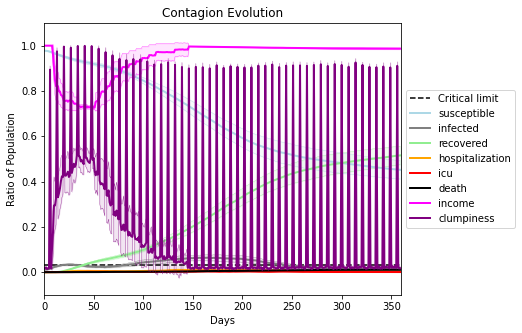

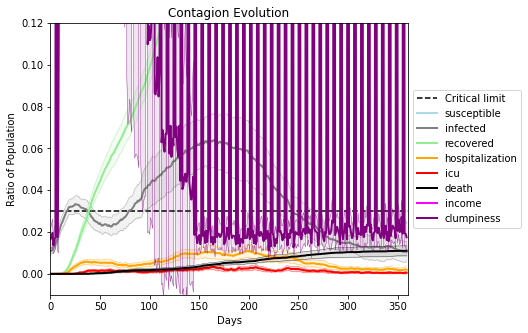

In [45]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6087, 5370, 6484, 5042, 1061, 2041, 8227, 7680, 3672, 9211, 2329, 4388, 63, 2554, 4078, 7071, 6033, 485, 2380, 6805]
Average similarity between family members is -0.01706259828974981 at temperature 1
Average similarity between family and home is 0.9998489578887474 at temperature -1
Average similarity between students and their classroom is 0.02980878625482522 at temperature 1
Average classroom occupancy is 4.194444444444445 and number classrooms is 72
Average similarity between workers is 0.015487618769434415 at temperature 1
Average office occupancy is 3.2346938775510203 and number offices is 196
Average friend similarity for adults: 0.08711834950848846 for kids: 0.0898012575952726
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneo

avg restaurant similarity 0.031719666068695
avg restaurant similarity 0.021023488480458485
avg restaurant similarity 0.009501148698092382
avg restaurant similarity 0.027146436325460162
avg restaurant similarity 0.06794738565354004
avg restaurant similarity 0.016337358574386642
avg restaurant similarity 0.06770933613578367
avg restaurant similarity -0.00025861411562522196
avg restaurant similarity 0.015265315442038399
avg restaurant similarity 0.1281520900359592
avg restaurant similarity 0.03759557762269063
avg restaurant similarity 0.01974371275601871
avg restaurant similarity 0.015432684023559625
avg restaurant similarity 0.028809116904363385
avg restaurant similarity 0.031087518506801227
avg restaurant similarity 0.02701388742176683
avg restaurant similarity 0.004892566551433054
avg restaurant similarity 0.04583863132123817
avg restaurant similarity 0.026124464274700124
avg restaurant similarity 0.0032712575432681844
avg restaurant similarity 0.021539188859494445
avg restaurant simil

avg restaurant similarity 0.03784905440307473
avg restaurant similarity 0.01808816047155258
avg restaurant similarity 0.025538283309792454
avg restaurant similarity 0.01731733107347062
avg restaurant similarity 0.045070306233470685
avg restaurant similarity 0.07299861539727052
avg restaurant similarity 0.03929837232965891
avg restaurant similarity 0.047573586028774775
avg restaurant similarity 0.04931585409850231
avg restaurant similarity 0.051137358891939835
avg restaurant similarity 0.013907497958065672
avg restaurant similarity 0.02539095472469426
avg restaurant similarity 0.05948131241731648
avg restaurant similarity 0.015566124164166749
avg restaurant similarity 0.007952574810669258
avg restaurant similarity 0.010329508781104939
avg restaurant similarity 0.03415876213999221
avg restaurant similarity 0.01661399500790864
avg restaurant similarity 0.010960815546989012
avg restaurant similarity -0.009228459811860407
avg restaurant similarity 0.02115100801980389
avg restaurant similari

avg restaurant similarity 0.024978664313368298
avg restaurant similarity 0.007385555687745959
avg restaurant similarity 0.003986767775532663
avg restaurant similarity -0.0249543700619188
avg restaurant similarity 0.012850163759032928
avg restaurant similarity 0.00861115950678405
avg restaurant similarity 0.023657203593276024
avg restaurant similarity 0.0029360277655706645
avg restaurant similarity 0.020551293327962197
avg restaurant similarity 0.03226464162214442
avg restaurant similarity 0.04881076563438906
avg restaurant similarity -0.007713792974812882
avg restaurant similarity 0.013247920799178806
avg restaurant similarity -0.006911379679266634
avg restaurant similarity 0.048705739817131104
avg restaurant similarity 0.0478829151603377
avg restaurant similarity 0.0023772440330410206
avg restaurant similarity 0.026234270861619998
avg restaurant similarity 0.04817744210577442
avg restaurant similarity -0.010223590260277778
avg restaurant similarity 0.0013659504146157873
avg restaurant

avg restaurant similarity 0.022391181629261434
avg restaurant similarity -0.0141138053615246
avg restaurant similarity 0.02735318759108437
avg restaurant similarity -0.026015785131951415
avg restaurant similarity -0.007698971258347188
avg restaurant similarity 0.0032566899497364046
avg restaurant similarity -0.015874937372618674
avg restaurant similarity -0.008255660541461624
avg restaurant similarity -0.020689868904369257
avg restaurant similarity -0.021368200070351655
avg restaurant similarity 0.01725884166860345
avg restaurant similarity -0.02260862390614183
avg restaurant similarity 0.00711011751131656
avg restaurant similarity -0.010980110171264193
avg restaurant similarity 0.005725422670793873
avg restaurant similarity 0.04103480296623555
avg restaurant similarity 0.011226953896003327
avg restaurant similarity -0.032217553592635687
avg restaurant similarity 0.03682998619604646
avg restaurant similarity -0.0015307647392085203
avg restaurant similarity 0.05894249297772633
avg resta

avg restaurant similarity 0.01823478502757664
avg restaurant similarity 0.009863141719193088
avg restaurant similarity 0.01342006880185755
avg restaurant similarity 0.013753410549997718
avg restaurant similarity 0.040928107049872306
avg restaurant similarity -0.060561104554986825
avg restaurant similarity -0.015928126290842046
avg restaurant similarity -0.027059702763048626
avg restaurant similarity 0.017451536451057924
avg restaurant similarity -0.02351619836315936
avg restaurant similarity -0.00365903190058874
avg restaurant similarity -0.02676610629738625
avg restaurant similarity -0.012716712551135769
avg restaurant similarity -0.059801985664115896
avg restaurant similarity 0.01983392725802572
avg restaurant similarity -0.026197375881046037
avg restaurant similarity -0.011183107195581219
avg restaurant similarity 0.023692579164871864
avg restaurant similarity -0.046644214251095745
avg restaurant similarity -0.03614823783130408
avg restaurant similarity -0.006934848212744618
avg res

avg restaurant similarity -0.018926926280218914
avg restaurant similarity 0.030134476191313334
avg restaurant similarity 0.035771095598166124
avg restaurant similarity -0.046185365661969575
avg restaurant similarity 0.009495074119003912
avg restaurant similarity -0.010070580361871903
avg restaurant similarity -0.0043234757790592965
avg restaurant similarity -0.014010935340254138
avg restaurant similarity 0.005309392734636434
avg restaurant similarity 0.008305496865857118
avg restaurant similarity 0.013170292607638152
avg restaurant similarity -0.008832730910324639
avg restaurant similarity -0.02067813006308321
avg restaurant similarity 0.003971948768705132
avg restaurant similarity 0.013357303590497189
avg restaurant similarity -0.015589027653675307
avg restaurant similarity -0.00369254610643492
avg restaurant similarity -0.013534824212987611
avg restaurant similarity -0.013689365307187088
avg restaurant similarity -0.002466917921853948
avg restaurant similarity 0.006010680819493914
av

avg restaurant similarity 0.021134262901727638
avg restaurant similarity 0.02853266986465215
avg restaurant similarity -0.018898927723560357
avg restaurant similarity 0.005845905637387009
avg restaurant similarity -0.007158718593136827
avg restaurant similarity -0.007074407276266922
avg restaurant similarity -0.008868134665411587
avg restaurant similarity -0.010708353556217708
avg restaurant similarity 0.01774605967447149
avg restaurant similarity -0.017010931430973653
avg restaurant similarity 0.006131692258809738
avg restaurant similarity 0.017441975691938803
avg restaurant similarity 0.031408683078205386
avg restaurant similarity 0.017180074746163072
avg restaurant similarity 0.02182197242203238
avg restaurant similarity -0.0019125366185238396
avg restaurant similarity 0.022584274710606294
avg restaurant similarity -0.02834661243043384
avg restaurant similarity 0.03484422413065451
avg restaurant similarity -0.02220058594980579
avg restaurant similarity -0.00835251354293702
avg resta

avg restaurant similarity 0.019478417056698075
avg restaurant similarity 0.02462236631309856
avg restaurant similarity -0.035764102909860984
avg restaurant similarity 0.006650919329331071
avg restaurant similarity -0.006169904336196906
avg restaurant similarity -0.02069373623249147
avg restaurant similarity 0.008437274633867104
avg restaurant similarity 0.015214836570375576
avg restaurant similarity 0.026665862057385116
avg restaurant similarity 0.04979732008160048
avg restaurant similarity -0.03913105481114034
avg restaurant similarity 0.007133489125234141
avg restaurant similarity 0.002594579449222223
avg restaurant similarity 0.003414634438827204
avg restaurant similarity 0.05056989835001072
avg restaurant similarity 0.017819257247961323
avg restaurant similarity 0.006740188836214196
avg restaurant similarity 0.04216920654235431
avg restaurant similarity -0.00529704614235001
avg restaurant similarity 0.02780412965320167
avg restaurant similarity 0.02547751216164866
avg restaurant si

avg restaurant similarity -0.022398337561582535
avg restaurant similarity -0.049196706015129696
avg restaurant similarity -0.009547236849334041
avg restaurant similarity 0.01510373739763599
avg restaurant similarity -0.04134777800264558
avg restaurant similarity -0.03592093568516706
avg restaurant similarity 0.022581598039786863
avg restaurant similarity 0.0011073876645772622
avg restaurant similarity -0.04490839097550784
avg restaurant similarity 0.0041281513484710975
avg restaurant similarity -0.008809166252931494
avg restaurant similarity 0.03424459413230677
avg restaurant similarity 0.015790460579521447
avg restaurant similarity -0.003788201785089632
avg restaurant similarity 0.04646782625289679
avg restaurant similarity -0.005324474441233359
avg restaurant similarity -0.02683295428596153
avg restaurant similarity 0.03451130393328388
avg restaurant similarity 0.0527081262434507
avg restaurant similarity -0.007597413085012046
avg restaurant similarity -0.007086089651199866
avg resta

avg restaurant similarity 0.0005333476550020752
avg restaurant similarity 0.05738567130222726
avg restaurant similarity 0.0051398254322814535
avg restaurant similarity 0.0028835170613344097
avg restaurant similarity 0.017561202295851158
avg restaurant similarity 0.005489910712500278
avg restaurant similarity -0.06575592218246575
avg restaurant similarity -0.05852369607047473
avg restaurant similarity -0.01784692638302768
avg restaurant similarity -0.001678130954023665
avg restaurant similarity -0.0039049407712927753
avg restaurant similarity 0.007035984991623697
avg restaurant similarity 0.029787202703409184
avg restaurant similarity -0.029083805513567637
avg restaurant similarity -0.0067515439619531496
avg restaurant similarity 0.054233339642661096
avg restaurant similarity -0.01771876670051445
avg restaurant similarity -0.039243636014303536
avg restaurant similarity 0.010107224593314246
avg restaurant similarity -0.05432153565783502
avg restaurant similarity -0.011852195425172402
avg

avg restaurant similarity 0.011428070806637231
avg restaurant similarity 0.06002051399993818
avg restaurant similarity -0.024848193044881353
avg restaurant similarity 0.04931406379441756
avg restaurant similarity 0.03639500087401092
avg restaurant similarity -0.010523738575538929
avg restaurant similarity 0.0041475446349463095
avg restaurant similarity 0.06544531643854604
avg restaurant similarity 0.02580994660270347
avg restaurant similarity 0.03718844062359782
avg restaurant similarity 0.017623875064624622
avg restaurant similarity -0.032883716008497293
avg restaurant similarity 0.03872093912331798
avg restaurant similarity 0.05108791462247889
avg restaurant similarity 0.001961029732297533
avg restaurant similarity 0.057020791810776926
avg restaurant similarity -0.010148157107138596
avg restaurant similarity 0.009639936606245915
avg restaurant similarity 0.008195484096794096
avg restaurant similarity 0.010516813365718027
avg restaurant similarity -0.006920151038083045
avg restaurant 

avg restaurant similarity -0.035336631395286845
avg restaurant similarity 0.013195748956274636
avg restaurant similarity 0.0005732650652741334
avg restaurant similarity 0.022794695072966036
avg restaurant similarity 0.054457382542325926
avg restaurant similarity 0.014960661213696585
avg restaurant similarity 0.0014777238633962933
avg restaurant similarity 0.010357687160061189
avg restaurant similarity 0.05747750295238337
avg restaurant similarity 0.05464559262647822
avg restaurant similarity -0.042127214337112064
avg restaurant similarity -0.038803826118434914
avg restaurant similarity 0.03986064206871983
avg restaurant similarity 0.008484872205848462
avg restaurant similarity 0.0249581385050914
avg restaurant similarity 0.04322839232861402
avg restaurant similarity 0.0145137559414727
avg restaurant similarity 0.016196554002020455
avg restaurant similarity 0.001554339203258133
avg restaurant similarity -0.019471670094440795
avg restaurant similarity -0.029574749853013824
avg restaurant

avg restaurant similarity 0.01826148118316507
avg restaurant similarity -0.027708642811941252
avg restaurant similarity -0.014989060910046531
avg restaurant similarity 0.05004650422726712
avg restaurant similarity -0.0019511800917335232
avg restaurant similarity 0.06798886819244315
avg restaurant similarity 0.03532408734627744
avg restaurant similarity 0.06721367823751885
avg restaurant similarity 0.05731753310369273
avg restaurant similarity 0.03326766727086549
avg restaurant similarity 0.06358985535226133
avg restaurant similarity -0.01381649855475914
avg restaurant similarity 0.02684067396781308
avg restaurant similarity -0.025433064091949252
avg restaurant similarity 0.00016536611896540335
avg restaurant similarity 0.04003176801372505
avg restaurant similarity -0.006121709404401119
avg restaurant similarity -0.0008306955211799834
avg restaurant similarity 0.01939792825324662
avg restaurant similarity 0.03253930152122719
avg restaurant similarity -0.017991457106326953
avg restaurant

avg restaurant similarity 0.03798302742972327
avg restaurant similarity 0.017265208686319977
avg restaurant similarity -0.03217574634200023
avg restaurant similarity -0.009168637384389952
avg restaurant similarity -0.009744937618566795
avg restaurant similarity 0.03778301980388805
avg restaurant similarity 0.06611084710587857
avg restaurant similarity 0.0040399819531578155
avg restaurant similarity 0.0012937813278281278
avg restaurant similarity 0.06511138465541397
avg restaurant similarity 0.05936504923655743
avg restaurant similarity 0.045924067812060175
avg restaurant similarity 0.03656239652628387
avg restaurant similarity 0.010801969976446524
avg restaurant similarity 0.017814473489301354
avg restaurant similarity 0.0014712477260411404
avg restaurant similarity -0.015830080295519137
avg restaurant similarity 0.0037706348652277455
avg restaurant similarity 0.0008745742648656509
avg restaurant similarity -0.029838590309695177
avg restaurant similarity 0.06305073662209199
avg restaur

avg restaurant similarity 0.004050902762779625
avg restaurant similarity 0.0051850591857440865
avg restaurant similarity 0.012255323796443089
avg restaurant similarity -0.02294453559203788
avg restaurant similarity 0.01128233759215051
avg restaurant similarity 0.016222758640584062
avg restaurant similarity 0.01672502720022081
avg restaurant similarity 0.021114055375646087
avg restaurant similarity -0.005769277838115228
avg restaurant similarity -0.013591807140131475
avg restaurant similarity -0.02181483501669376
avg restaurant similarity 0.014217531602015951
avg restaurant similarity 0.051207103239322836
avg restaurant similarity 0.031664055546476104
avg restaurant similarity -0.02835852026138139
avg restaurant similarity 0.029199956510739516
avg restaurant similarity 0.021752705562683782
avg restaurant similarity -0.0012619711223230301
avg restaurant similarity 0.03493528501831832
avg restaurant similarity 0.030945790716522637
avg restaurant similarity 0.03759445484985333
avg restaura

avg restaurant similarity 0.004223295737688449
avg restaurant similarity 0.06423199451640355
avg restaurant similarity 0.019278470522402637
avg restaurant similarity 0.020604810832809423
avg restaurant similarity -0.02077099897357119
avg restaurant similarity 0.04264680045830801
avg restaurant similarity 0.03764071031894897
avg restaurant similarity -0.005290542973706571
avg restaurant similarity 0.015038185943124206
avg restaurant similarity -0.05422319395187691
avg restaurant similarity 0.07360946482860456
avg restaurant similarity 0.012166653999388937
avg restaurant similarity -0.025214402293506872
avg restaurant similarity 0.03965709850076117
avg restaurant similarity 0.016156440819034185
avg restaurant similarity 0.06475561086155261
avg restaurant similarity 0.021409064495485776
avg restaurant similarity 0.048771779247362514
avg restaurant similarity -0.024013253437720736
avg restaurant similarity 0.03994209184813166
avg restaurant similarity 0.024132755463306725
avg restaurant si

avg restaurant similarity 0.015823919292886325
avg restaurant similarity -0.020794417280938296
avg restaurant similarity 0.015698820791387506
avg restaurant similarity 0.02961700626260153
avg restaurant similarity 0.00024784176333283515
avg restaurant similarity 0.01194443794531405
avg restaurant similarity 0.011061054931876809
avg restaurant similarity 0.019491327795032327
avg restaurant similarity -0.013928427631727998
avg restaurant similarity 0.009646437510004434
avg restaurant similarity -0.02660175949980062
avg restaurant similarity 0.024238384898325187
avg restaurant similarity 0.046285099573503324
avg restaurant similarity -6.42789757459956e-05
avg restaurant similarity 0.003130019541846117
avg restaurant similarity -0.009619660281967677
avg restaurant similarity 0.026632373791332258
avg restaurant similarity 0.013843159043906544
avg restaurant similarity -0.01076091347804832
avg restaurant similarity 0.004045583491322073
avg restaurant similarity 0.0007769039521380889
avg rest

avg restaurant similarity 0.022751137548522503
avg restaurant similarity 0.018891060650481427
avg restaurant similarity 0.0068082404256611054
avg restaurant similarity 0.003702933975608531
avg restaurant similarity -0.017658672915077785
avg restaurant similarity 0.0009406066159910745
avg restaurant similarity -0.03534263637539225
avg restaurant similarity 0.016964308922099644
avg restaurant similarity -0.01276715240035069
avg restaurant similarity -0.0001588740670394475
avg restaurant similarity -0.0027076041867860347
avg restaurant similarity -0.0024633899289849912
avg restaurant similarity -0.0014458307815555578
avg restaurant similarity 0.017109689693415257
avg restaurant similarity 0.025209812727005464
avg restaurant similarity -0.01381724059037502
avg restaurant similarity -0.023665561186903897
avg restaurant similarity 0.05324983489280746
avg restaurant similarity -0.0038903368100032
avg restaurant similarity -0.0020297240012517484
avg restaurant similarity 0.019150929975310673
a

avg restaurant similarity -0.014843752131165589
avg restaurant similarity -0.004160938915109251
avg restaurant similarity 0.0091178934096711
avg restaurant similarity 0.02349001473562007
avg restaurant similarity -0.026529249442218038
avg restaurant similarity 0.006841202243119889
avg restaurant similarity 0.0017604101675558186
avg restaurant similarity -0.0035846900892713834
avg restaurant similarity 0.015702609961210656
avg restaurant similarity 0.009781482115253122
avg restaurant similarity 0.0005875761234534784
avg restaurant similarity 0.031057951694999704
avg restaurant similarity -0.017156719375461975
avg restaurant similarity 0.006632970691362545
avg restaurant similarity -0.01327843148288375
avg restaurant similarity 0.010213597034815357
avg restaurant similarity -0.012092617193671547
avg restaurant similarity 0.017074537267685472
avg restaurant similarity 0.005654557588505911
avg restaurant similarity -0.006244364188575516
avg restaurant similarity 0.021585865134374348
avg re

avg restaurant similarity 0.014599003150698885
avg restaurant similarity 0.02711645120659631
avg restaurant similarity 0.010999458476375512
avg restaurant similarity 0.03124714876141006
avg restaurant similarity 0.007174470730993355
avg restaurant similarity 0.020558919107727707
avg restaurant similarity 0.01929647864739451
avg restaurant similarity 0.06384379221039142
avg restaurant similarity -0.008411869418723671
avg restaurant similarity 0.009694125845637466
avg restaurant similarity 0.03807785230117244
avg restaurant similarity -0.0006649197032913175
avg restaurant similarity -0.0012709731234974474
avg restaurant similarity -0.010488080515535044
avg restaurant similarity 0.037025616112521566
avg restaurant similarity 0.02269213817508432
avg restaurant similarity 0.023987685682672226
avg restaurant similarity 0.03576986487929031
avg restaurant similarity -0.032967796464862385
avg restaurant similarity 0.011842103762922492
avg restaurant similarity 0.018073845084014543
avg restauran

avg restaurant similarity -0.0041445413815380085
avg restaurant similarity -0.02944933657127163
avg restaurant similarity -0.0230755256461776
avg restaurant similarity 0.004467851928589785
avg restaurant similarity 0.025322596800730207
avg restaurant similarity 0.009298665782749307
avg restaurant similarity -0.0011737484914221255
avg restaurant similarity -0.06401824148942203
avg restaurant similarity 0.0051174104288819145
avg restaurant similarity -0.0209064357033534
avg restaurant similarity -0.004527802209749086
avg restaurant similarity 0.03459941862972239
avg restaurant similarity -0.008348163638301858
avg restaurant similarity 0.010543460710938831
avg restaurant similarity -0.015154466018352864
avg restaurant similarity 0.012122061805806413
avg restaurant similarity -0.022299592058609593
avg restaurant similarity 0.023012742150937193
avg restaurant similarity -0.0040146767294038065
avg restaurant similarity 0.0044308876537827
avg restaurant similarity -0.04561025949928889
avg res

avg restaurant similarity -0.07029112435021669
avg restaurant similarity 0.017210017021508456
avg restaurant similarity -0.024038901943645337
avg restaurant similarity 0.0025077069598956492
avg restaurant similarity 0.008516058497372853
avg restaurant similarity 0.06618735859489455
avg restaurant similarity 0.03313193523883391
avg restaurant similarity -0.007333018531139639
avg restaurant similarity 0.03283062899410456
avg restaurant similarity 0.028914618363329796
avg restaurant similarity 0.03585756963862152
avg restaurant similarity 0.013127098947957981
avg restaurant similarity 0.04580694315655524
avg restaurant similarity 0.039848243764114846
avg restaurant similarity 0.037254478128215196
avg restaurant similarity 0.024559010745633124
avg restaurant similarity 0.008636210174031456
avg restaurant similarity -0.02224366745967953
avg restaurant similarity -0.03479500274659675
avg restaurant similarity 0.03096996477897789
avg restaurant similarity 0.025751076121528788
avg restaurant s

avg restaurant similarity 0.0035215160794394573
avg restaurant similarity 0.0007976036474577707
avg restaurant similarity -0.013543003160649629
avg restaurant similarity -0.021413462499562448
avg restaurant similarity 0.013587681623755534
avg restaurant similarity 0.009874984200914122
avg restaurant similarity -0.010806761593458765
avg restaurant similarity 0.0046320870461286105
avg restaurant similarity 0.004724586854760498
avg restaurant similarity 0.06357709095275367
avg restaurant similarity 0.06250178194689213
avg restaurant similarity -0.0026355172701846186
avg restaurant similarity 0.03717204645362867
avg restaurant similarity -0.003346370639992502
avg restaurant similarity 0.017756282583688603
avg restaurant similarity -0.009128348587409565
avg restaurant similarity -0.017211766875608745
avg restaurant similarity 0.046424910965695745
avg restaurant similarity 0.03225822366342436
avg restaurant similarity -0.013425136876955818
avg restaurant similarity 0.020791237182684635
avg r

avg restaurant similarity 0.00028605827945137806
avg restaurant similarity 0.000984678922957066
avg restaurant similarity 0.06266766488863226
avg restaurant similarity 0.00440328999437959
avg restaurant similarity -0.02756539057731838
avg restaurant similarity -0.0015591440088101073
avg restaurant similarity 0.023883748479631834
avg restaurant similarity 0.00392681136818786
avg restaurant similarity 0.0300204720081932
avg restaurant similarity 0.034662875886699966
avg restaurant similarity 0.010595605023447124
avg restaurant similarity -0.011340933183953709
avg restaurant similarity 0.05365209920224563
avg restaurant similarity 0.0239430946943816
avg restaurant similarity 0.02256257033965019
avg restaurant similarity 0.04608846602424121
avg restaurant similarity 0.018670541188864822
avg restaurant similarity -0.030046729988261925
avg restaurant similarity 0.04885313226980372
avg restaurant similarity -0.007934808362364359
avg restaurant similarity -0.010471746584753106
avg restaurant s

avg restaurant similarity 0.04669742720946402
avg restaurant similarity 0.02108647479093105
avg restaurant similarity 0.01815334450290348
avg restaurant similarity 0.012672166275216787
avg restaurant similarity 0.028942848379328843
avg restaurant similarity 0.021829166102251725
avg restaurant similarity 0.03334546193354907
avg restaurant similarity 0.03987137192139065
avg restaurant similarity 0.027500195987412435
avg restaurant similarity 0.04343398697103166
avg restaurant similarity -0.0007293957978016008
avg restaurant similarity 0.05216165644684004
avg restaurant similarity -0.005615031956907428
avg restaurant similarity 0.014397671814370407
avg restaurant similarity 0.05986575849962962
avg restaurant similarity 0.0513592002198746
avg restaurant similarity 0.06468483309355337
avg restaurant similarity 0.02345976560331523
avg restaurant similarity 0.04015729966299737
avg restaurant similarity 0.06863339744233528
avg restaurant similarity 0.01519795312889165
avg restaurant similarity

avg restaurant similarity 0.013477372126812312
avg restaurant similarity 0.0367956633414627
avg restaurant similarity 0.0644516159140325
avg restaurant similarity 0.013248796103727513
avg restaurant similarity -0.00220988657942864
avg restaurant similarity 0.05032315237613535
avg restaurant similarity 0.03382886413382696
avg restaurant similarity 0.048865584491954765
avg restaurant similarity -0.007472830169227075
avg restaurant similarity 0.026089268797835862
avg restaurant similarity 0.0076521557143212305
avg restaurant similarity 0.06224196232647596
avg restaurant similarity -0.00023651478369217228
avg restaurant similarity 0.04569791948621011
avg restaurant similarity 0.0006727143122966127
avg restaurant similarity 0.05413381453156414
avg restaurant similarity 0.045370695902546866
avg restaurant similarity 0.039732939027679263
avg restaurant similarity -0.016423394259894235
avg restaurant similarity 0.0689548116798994
avg restaurant similarity 0.015089298157486409
avg restaurant si

avg restaurant similarity -0.0014936316551945562
avg restaurant similarity -0.018473066769874542
avg restaurant similarity 0.01956557866611334
avg restaurant similarity -0.00782919001496409
avg restaurant similarity 0.013355587741530318
avg restaurant similarity 0.010948790229173735
avg restaurant similarity 0.04408805178772914
avg restaurant similarity 0.04231717812496176
avg restaurant similarity 0.01866947445490377
avg restaurant similarity 0.045191479647050975
avg restaurant similarity 0.011428176572779534
avg restaurant similarity 0.013450619465106164
avg restaurant similarity -0.0610230191344296
avg restaurant similarity 0.02236899436494569
avg restaurant similarity 0.030348084473732363
avg restaurant similarity 0.005739519267383348
avg restaurant similarity -0.029956962148466566
avg restaurant similarity 0.03023983301816387
avg restaurant similarity -0.024368209913342473
avg restaurant similarity 0.04311621855602882
avg restaurant similarity 0.06452458996356407
avg restaurant si

avg restaurant similarity -0.019291735529664265
avg restaurant similarity 0.0009856850025193149
avg restaurant similarity 0.014104546176742165
avg restaurant similarity 0.06555063856781292
avg restaurant similarity 0.028537435814437316
avg restaurant similarity 0.040634202481632534
avg restaurant similarity 0.03392362048721343
avg restaurant similarity 0.04205789453509864
avg restaurant similarity 0.06320246922829154
avg restaurant similarity 0.0005718886542470411
avg restaurant similarity 0.001525159813988419
avg restaurant similarity -0.025175394575696383
avg restaurant similarity 0.03325680301355703
avg restaurant similarity 0.035428280800641636
avg restaurant similarity 0.047489909994779214
avg restaurant similarity -0.0030059381243368365
avg restaurant similarity 0.03278758508654894
avg restaurant similarity 0.008958211070157545
avg restaurant similarity 0.017643613463706322
avg restaurant similarity 0.03972422751092845
avg restaurant similarity -0.025540594897817844
avg restauran

avg restaurant similarity 0.030404552837988118
avg restaurant similarity -0.016373902355756715
avg restaurant similarity -0.014235685371281764
avg restaurant similarity 0.01099816473513634
avg restaurant similarity 0.011785350227247401
avg restaurant similarity 0.01764591375898097
avg restaurant similarity 0.020049967610986347
avg restaurant similarity -0.02293262234565432
avg restaurant similarity -0.020205319272899428
avg restaurant similarity -0.003710260204837355
avg restaurant similarity 0.010726737580127807
avg restaurant similarity 0.0022654091540554927
avg restaurant similarity -0.008092789577053571
avg restaurant similarity -0.03871417276797521
avg restaurant similarity -0.0076052902149615536
avg restaurant similarity -0.015072121426538358
avg restaurant similarity -0.032759890204895566
avg restaurant similarity -0.04375102335791724
avg restaurant similarity 0.004480764151982745
avg restaurant similarity -0.0031210593970330933
avg restaurant similarity -0.027320042563391315
av

avg restaurant similarity -0.008540360929858739
avg restaurant similarity -0.07407446061970248
avg restaurant similarity -0.02569520255993383
avg restaurant similarity 0.015488828450835854
avg restaurant similarity -0.0009764606299082327
avg restaurant similarity 0.0016560074005730061
avg restaurant similarity -0.02826464406222951
avg restaurant similarity -0.03450042535446728
avg restaurant similarity 0.006072418585610011
avg restaurant similarity -0.004093884618963936
avg restaurant similarity -0.015834053160888543
avg restaurant similarity -0.0010271246788090924
avg restaurant similarity 0.008904059556592629
avg restaurant similarity -0.019748127400501792
avg restaurant similarity -0.0020556310102592787
avg restaurant similarity -0.002834057146939933
avg restaurant similarity 0.023877965216309225
avg restaurant similarity -0.021176309134706996
avg restaurant similarity 0.0027837808444083163
avg restaurant similarity 0.00023559838096734987
avg restaurant similarity 0.0059201675926628

avg restaurant similarity 0.014353468531142907
avg restaurant similarity -0.030924970167482507
avg restaurant similarity -0.029638062506467746
avg restaurant similarity 0.011568857362937581
avg restaurant similarity -0.0038871406899722407
avg restaurant similarity 0.03974023031730334
avg restaurant similarity -0.01784255122152092
avg restaurant similarity -0.017104166489901516
avg restaurant similarity -0.014955266975795637
avg restaurant similarity -0.029835883635296472
avg restaurant similarity 0.02261012326928746
avg restaurant similarity 0.0011406982871002998
avg restaurant similarity 0.022925461200283874
avg restaurant similarity 0.017962495457946166
avg restaurant similarity -0.0008734045985430941
avg restaurant similarity -0.0027575625548570573
avg restaurant similarity -0.018360808401974207
avg restaurant similarity -0.0018814486121382851
avg restaurant similarity -0.027783803959981784
avg restaurant similarity -0.04026808302267086
avg restaurant similarity -0.02670122873897515

avg restaurant similarity 0.009214795091626206
avg restaurant similarity 0.04400919397628107
avg restaurant similarity 0.027753823287813863
avg restaurant similarity 0.033562266773247564
avg restaurant similarity 0.0007652667965746243
avg restaurant similarity -0.020902686444887915
avg restaurant similarity -0.019830421408829145
avg restaurant similarity 0.022032914031826004
avg restaurant similarity -0.002432175221791368
avg restaurant similarity -0.0030904247443060678
avg restaurant similarity -0.060042039924113604
avg restaurant similarity 0.008378232099541354
avg restaurant similarity 0.009566988824373582
avg restaurant similarity 0.03656482504405462
avg restaurant similarity 0.0038609144658446853
avg restaurant similarity -0.005492830211638756
avg restaurant similarity 0.006925477670608724
avg restaurant similarity 0.027816252823773268
avg restaurant similarity 0.004704167008887298
avg restaurant similarity -0.02226194389606696
avg restaurant similarity 0.0002717681112373443
avg r

avg restaurant similarity 0.04566461543919028
avg restaurant similarity 0.007775642397966875
avg restaurant similarity 0.028173166180797116
avg restaurant similarity 0.028272883590739886
avg restaurant similarity 0.029145778213366717
avg restaurant similarity -0.011289214786951498
avg restaurant similarity 0.049113573187301474
avg restaurant similarity 0.051550597873648664
avg restaurant similarity 0.033243750984296286
avg restaurant similarity 0.022396387922450578
avg restaurant similarity 0.017014270490197447
avg restaurant similarity 0.038825745676534025
avg restaurant similarity 0.019908494507748464
avg restaurant similarity 0.0009948419324511356
avg restaurant similarity 0.03993933267794229
avg restaurant similarity 0.03852260860193618
avg restaurant similarity 0.02403370512686356
avg restaurant similarity -0.012570433727110805
avg restaurant similarity 0.007131522475752736
avg restaurant similarity 0.01881578746880532
avg restaurant similarity 0.006940435910696765
avg restaurant 

avg restaurant similarity 0.05466525898691671
avg restaurant similarity 0.03328047412264041
avg restaurant similarity -0.01868941324348535
avg restaurant similarity 0.006028992312234576
avg restaurant similarity -0.0022484897004273114
avg restaurant similarity 0.03853939865408331
avg restaurant similarity -0.00674142480286094
avg restaurant similarity -0.006504226873253191
avg restaurant similarity -0.014623788942936129
avg restaurant similarity 0.05579597273445961
avg restaurant similarity 0.04566375964955935
avg restaurant similarity 0.033398132380973465
avg restaurant similarity 0.04513984553417519
avg restaurant similarity 0.021974044426694875
avg restaurant similarity 0.017297453850652043
avg restaurant similarity 0.030274783720417423
avg restaurant similarity 0.03596255559832766
avg restaurant similarity 0.01571135001971632
avg restaurant similarity 0.022800932440959765
avg restaurant similarity 0.045243200252726226
avg restaurant similarity 0.05207954043501981
avg restaurant sim

avg restaurant similarity 0.008353876730831168
avg restaurant similarity 0.019572618363528714
avg restaurant similarity 0.024075389762346584
avg restaurant similarity 0.04189396296154905
avg restaurant similarity 0.004936430137059298
avg restaurant similarity 0.03609635254151678
avg restaurant similarity 0.013830541898868473
avg restaurant similarity -0.024233075589535844
avg restaurant similarity 0.04251891245867094
avg restaurant similarity -0.017219992105644753
avg restaurant similarity 0.013343567545921111
avg restaurant similarity 0.02637593677371076
avg restaurant similarity -0.001041533309837047
avg restaurant similarity 0.015732460866143057
avg restaurant similarity -0.0024531159687449376
avg restaurant similarity 0.02506089509327165
avg restaurant similarity 0.020256440603642397
avg restaurant similarity -0.007977781607681722
avg restaurant similarity 0.02035477629473533
avg restaurant similarity -0.006832463942860053
avg restaurant similarity 0.027373613662169536
avg restaura

avg restaurant similarity -0.03650764167003984
avg restaurant similarity -0.02556776680665336
avg restaurant similarity 0.03562205264758103
avg restaurant similarity 0.015168802987760886
avg restaurant similarity 0.016724047782233718
avg restaurant similarity 0.0005361751033506639
avg restaurant similarity 0.0035347091506662694
avg restaurant similarity -0.009762778786855813
avg restaurant similarity 0.02792843804633568
avg restaurant similarity 0.010851937639209962
avg restaurant similarity 0.057050202553381675
avg restaurant similarity 0.0430050105306184
avg restaurant similarity 0.005958408732867465
avg restaurant similarity 0.011334110391134125
avg restaurant similarity 0.034670439522074395
avg restaurant similarity -0.014615536687765513
avg restaurant similarity -0.07175905769553635
avg restaurant similarity -0.03683362730055215
avg restaurant similarity -0.02615465628791176
avg restaurant similarity 0.042883973722724816
avg restaurant similarity 0.04134709182097101
avg restaurant

avg restaurant similarity 0.010005106093886796
avg restaurant similarity 0.010700523508727326
avg restaurant similarity -0.039681921360062225
avg restaurant similarity 0.019347214137279804
avg restaurant similarity -0.017141307203805294
avg restaurant similarity 0.032606550930978556
avg restaurant similarity -0.002986337218717509
avg restaurant similarity -0.0036633223092543293
avg restaurant similarity -0.005704454903932484
avg restaurant similarity -0.030850739626165274
avg restaurant similarity 0.003041745932358851
avg restaurant similarity 0.023116587463308882
avg restaurant similarity -0.050985321910718376
avg restaurant similarity -0.0027144652036928054
avg restaurant similarity -0.007515969019427368
avg restaurant similarity 0.025425060217392867
avg restaurant similarity -0.013954743623034078
avg restaurant similarity 0.04408313946196492
avg restaurant similarity -0.0011991400026211286
avg restaurant similarity 0.03774685405056598
avg restaurant similarity 0.03542366877650933
av

avg restaurant similarity 0.03205403223379273
avg restaurant similarity 0.06796992030790179
avg restaurant similarity 0.010016992076027263
avg restaurant similarity 0.023889161725893823
avg restaurant similarity 0.04408880117594658
avg restaurant similarity 0.08066372068438248
avg restaurant similarity 0.03766025422219761
avg restaurant similarity -0.0016727086841041895
avg restaurant similarity 0.058060084888615256
avg restaurant similarity -0.027310219103659727
avg restaurant similarity 0.041157284719026486
avg restaurant similarity -0.0014386685020076344
avg restaurant similarity 0.01910646806756275
avg restaurant similarity -0.03297445650963066
avg restaurant similarity 0.012077969952594586
avg restaurant similarity -0.006652740077317821
avg restaurant similarity -0.01946056738125238
avg restaurant similarity 0.02245282102301486
avg restaurant similarity 0.05827298672582451
avg restaurant similarity 0.0021162785026751117
avg restaurant similarity 0.014193083846922154
avg restaurant

avg restaurant similarity -0.041117487164055416
avg restaurant similarity -0.032185412000762144
avg restaurant similarity -0.0038808044298335185
avg restaurant similarity 0.007305434340184151
avg restaurant similarity 0.009375750786218835
avg restaurant similarity 0.0029333264185305375
avg restaurant similarity -0.024356001954294097
avg restaurant similarity -0.021866960214076556
avg restaurant similarity -0.030630879593166214
avg restaurant similarity 0.026968022089682624
avg restaurant similarity -0.0012562735366710963
avg restaurant similarity 0.037990892185017555
avg restaurant similarity 0.037754344852624175
avg restaurant similarity -0.0068045423741393656
avg restaurant similarity -0.03912942719707272
avg restaurant similarity 0.0204981689864707
avg restaurant similarity -0.0330939747203964
avg restaurant similarity -0.013833309881197913
avg restaurant similarity 0.053001786474929716
avg restaurant similarity -0.043925924467547325
avg restaurant similarity -0.009112361580266286
a

avg restaurant similarity 0.03374559755851337
avg restaurant similarity -0.00560132225414284
avg restaurant similarity -0.004785288083153812
avg restaurant similarity -0.033671552013038696
avg restaurant similarity -0.03034582422138074
avg restaurant similarity -0.008800608132892903
avg restaurant similarity -0.01849829524901226
avg restaurant similarity 0.023648790176684965
avg restaurant similarity 0.028032872712496236
avg restaurant similarity -0.02559215894247022
avg restaurant similarity -0.013550605904843317
avg restaurant similarity 0.01644745510217881
avg restaurant similarity -0.029054258709106343
avg restaurant similarity 0.019732131078209772
avg restaurant similarity 0.002979337529754079
avg restaurant similarity 0.029135330242993373
avg restaurant similarity -0.028473405904275696
avg restaurant similarity -0.013296751035769919
avg restaurant similarity 0.055645853352410714
avg restaurant similarity -0.01613431693157834
avg restaurant similarity 0.019071462006463296
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

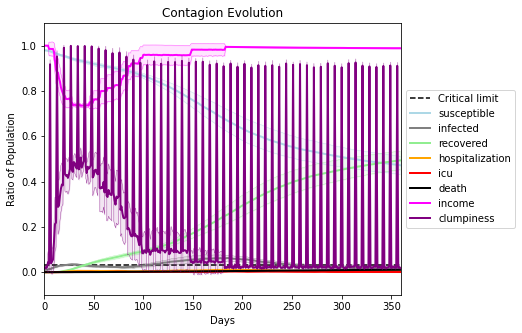

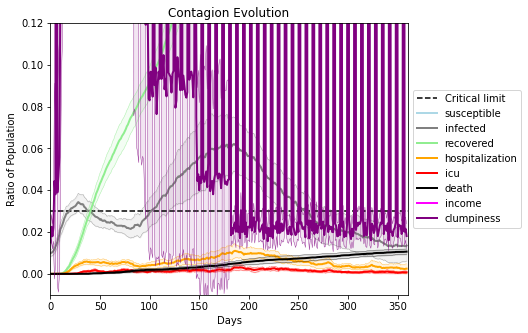

In [46]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)